# LAB 1

In [1]:
# Import PyDrive and associated libraries.
# This only needs to be done once per notebook.
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Authenticate and create the PyDrive client.
# This only needs to be done once per notebook.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

# List .txt files in the root.
#
# Search query reference:
# https://developers.google.com/drive/v2/web/search-parameters
listed = drive.ListFile({'q': "title contains '.csv' and 'root' in parents"}).GetList()
for file in listed:
  print('title {}, id {}'.format(file['title'], file['id']))

title train.csv, id 1Jwzj9lneJfyHnmDgw75FpN8WFVwlgrQG
title test.csv, id 1GblmLmA4sm5bi1X3NmaPqNpDgnT3M3bZ
title cyberlab.csv, id 1TSw0JJGfrlzrgvlgFK21QBjAzcL_bzRD
title dataset_lab_1.csv, id 14rHwK3VAyCyVaSaz3ng2f8uitgFWr__9


In [ ]:
# Download a file based on its file ID.
#
# siome hd
file_id = '14rHwK3VAyCyVaSaz3ng2f8uitgFWr__9'
# ale hd
#file_id = '1KLGXUxWYPTLA5HDtaEpKhVIXOkiSNV4I'
downloaded = drive.CreateFile({'id': file_id})
print('Downloaded content "{}"'.format(downloaded.GetContentString()))

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
from torch.nn.utils.rnn import pad_sequence, pack_padded_sequence, pad_packed_sequence
from torch.utils.data import DataLoader, Dataset, TensorDataset, random_split
import torch.optim as optim
import torch.nn as nn
import torch

from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from scipy.io.arff import loadarff
from tqdm import tqdm
import pandas as pd
import numpy as np
import time
from sklearn.model_selection import train_test_split


import matplotlib.pyplot as plt
import seaborn as sns

In [5]:
from pydrive.drive import GoogleDrive
from pydrive.auth import GoogleAuth
from google.colab import auth
from oauth2client.client import GoogleCredentials
# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive_pydrive = GoogleDrive(gauth) # use a different variable name here

downloaded = drive_pydrive.CreateFile({'id': file_id}) #call CreateFile on the pydrive object
downloaded.GetContentFile('data_set_lab_1.csv')  # Download to a local file
df = pd.read_csv('data_set_lab_1.csv')


The CICIDS2017 dataset, developed by the Canadian Institute for Cybersecurity (CIC)
 at the University of New Brunswick, serves as a comprehensive benchmark for the evaluation
 of intrusion detection systems (IDS) and intrusion prevention systems (IPS). This dataset
 addresses the limitations of previous datasets by providing a realistic representation of modern
 network traffic that includes both benign activity and a variety of common cyberattacks.

*Key Features*

 • Flow Duration: Total duration of the network flow.

 • Flow IAT Mean: Mean inter-arrival time between packets in the flow.

 • Fwd PSH Flags: Count of PUSH (PSH) flags in forward direction.

 • Bwd Packet Length Mean: Average packet length in the backward direction.

 • Bwd Packet Length Max: Maximum packet length in the backward direction.

 • Flow Bytes/s: Number of bytes per second in the flow.

 • Down/Up Ratio: Ratio between the number of packets in the backward direction and the number of packets in the forward direction.

 • SYN Flag Count: Count of packets for which the SYN flag is set.

 • Fwd Packet Length Mean: Average length of the packets in the forward direction.

 • Fwd IAT Std: Standard deviation of inter-arrival times between the forward packets.

 • Packet Length Mean: Mean packet length over the entire flow.

 • Fwd Packet Length Max: Maximum length of the packets in the forward direction.

 • Subflow Fwd Packets: Number of packets in forward direction within a detected subflow.

 • Flow Packets/s: Number of packets per second in the flow.

 • Label: Classification label indicating the type of traffic (e.g., Benign, PortScan, etc.).

 • Total Fwd Packets: Total number of packets sent in the forward direction.

 • Destination Port: Port number of the destination host.




**DATA PROCESSING**

 The first task in developing a Machine Learning pipelines starts with a good preprocessing
 step. Start by preprocessing the dataset. Report the most important steps and interme
diate results:
 - Remove missing values (NaN) and duplicate entries.
 - Ensure data consistency and correct formatting.
 - Split the dataset to extract a training, validation and test sets (60%, 20%, 20%).
 - Focus on the training and validation partitions. Check for the presence of outliers
 and decide on the correct normalization. -> (after the split see how each dataset behaves and take decision on it)
 - Now, focus on the test partition. How do you preprocess the data? Is the preprocess
ing the same as for the training partition?

## Data-preprocessing

In [6]:
df.head()

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
0,303376,30337.600000,0,749.4,1448,12743.263,0,0,19.833334,98776.15,322.16666,119,6,36.258636,6,443,Benign
1,117,117.000000,0,0.0,0,0.000,1,0,0.000000,0.00,0.00000,0,1,17094.018000,1,52631,Benign
2,142,142.000000,0,0.0,0,84507.040,0,0,6.000000,0.00,6.00000,6,2,14084.507000,2,80,Benign
3,191,63.666668,0,52.0,52,921465.940,1,0,36.000000,0.00,42.40000,36,2,20942.408000,2,53,Benign
4,4,4.000000,0,0.0,0,3000000.000,0,0,6.000000,0.00,6.00000,6,2,500000.000000,2,49467,Benign


In [7]:
df.describe()

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port
count,3.150700e+04,3.150700e+04,31507.000000,31507.000000,31507.000000,3.148700e+04,31507.000000,31507.000000,31507.000000,3.150700e+04,31507.000000,31507.000000,31507.000000,3.150700e+04,31507.000000,31507.000000
mean,1.647581e+07,1.438258e+06,0.038277,310.232250,896.532040,inf,0.639382,0.038277,44.150959,4.653801e+06,163.155706,170.496652,6.181293,inf,6.181293,7367.544292
std,3.526316e+07,4.122202e+06,0.191868,605.892466,1945.454241,NaN,0.531334,0.191868,115.215481,1.185644e+07,290.189858,501.331438,109.450416,NaN,109.450416,17104.518207
min,-1.000000e+00,-1.000000e+00,0.000000,0.000000,0.000000,-1.200000e+07,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,1.000000,-2.000000e+06,1.000000,0.000000
25%,6.500000e+01,5.500000e+01,0.000000,5.500000,6.000000,1.199456e+02,0.000000,0.000000,2.000000,0.000000e+00,3.333333,2.000000,1.000000,2.032897e+00,1.000000,53.000000
50%,2.427100e+04,8.096333e+03,0.000000,51.000000,56.000000,4.830598e+03,1.000000,0.000000,32.000000,0.000000e+00,47.800000,35.000000,2.000000,1.581044e+02,2.000000,80.000000
75%,5.216842e+06,5.558727e+05,0.000000,176.000000,271.000000,1.538462e+05,1.000000,0.000000,50.000000,7.627202e+05,112.000000,198.000000,5.000000,3.174603e+04,5.000000,1066.000000
max,1.199985e+08,1.140000e+08,1.000000,3865.000000,11595.000000,inf,10.000000,1.000000,3431.806400,8.280000e+07,1903.272700,23360.000000,18605.000000,inf,18605.000000,65533.000000


In [8]:
grouped_df = df.groupby('Label')
grouped_df.mean()

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port
Label,,,,,,,,,,,,,,,,
Benign,1.131130e+07,9.482337e+05,0.0603,165.798787,411.053000,inf,0.650750,0.0603,57.110944,1.220772e+06,107.074714,206.50040,7.244800,inf,7.244800,9408.6374
Brute Force,6.506182e+06,1.546228e+06,0.0000,41.622306,91.857332,1.792807e+02,0.142668,0.0000,16.869312,3.264638e+06,24.509333,54.50564,12.371599,3684.902275,12.371599,80.0000
DoS Hulk,5.653013e+07,4.776383e+06,0.0000,1272.397426,3969.474000,3.213723e+04,0.388800,0.0000,43.682147,2.345695e+07,589.297444,230.89800,5.229000,inf,5.229000,80.0000
PortScan,8.436853e+04,2.768802e+04,0.0000,6.759967,8.035200,inf,0.994200,0.0000,1.002520,1.465057e+03,3.125954,1.04000,1.013800,inf,1.013800,8687.1820


In [9]:
grouped_df.describe()

Flow Duration                                               \
                    count          mean           std   min        25%   
Label                                                                    
Benign            20000.0  1.131130e+07  3.030644e+07  -1.0      182.0   
Brute Force        1507.0  6.506182e+06  6.415511e+06  20.0  5180548.0   
DoS Hulk           5000.0  5.653013e+07  4.621738e+07   0.0      986.0   
PortScan           5000.0  8.436853e+04  2.014134e+06   0.0       42.0   

                                                  Flow IAT Mean                \
                    50%          75%          max         count          mean   
Label                                                                           
Benign          31112.5    429108.00  119998546.0       20000.0  9.482337e+05   
Brute Force   5552319.0   5838340.00   35451960.0        1507.0  1.546228e+06   
DoS Hulk     84904369.0  98619498.25  119165532.0        5000.0  4.776383e+06   
PortScan           47.0        61.00   77038552.0        5000.0  2.768802e+04   

             ... Total Fwd Packets          Destination Port             \
             ...               75%      max            count       mean   
Label        ...                                                          
Benign       ...               4.0  18605.0          20000.0  9408.6374   
Brute Force  ...               3.0    204.0           1507.0    80.0000   
DoS Hulk     ...               7.0     13.0           5000.0    80.0000   
PortScan     ...               1.0      6.0           5000.0  8687.1820   

                                                                   
                      std   min      25%     50%     75%      max  
Label                                                              
Benign       19840.517250   0.0    53.00    80.0   443.0  65533.0  
Brute Force      0.000000  80.0    80.00    80.0    80.0     80.0  
DoS Hulk         0.000000  80.0    80.00    80.0    80.0     80.0  
PortScan     13472.839374   1.0  1123.75  3690.0  8291.0  65389.0  

[4 rows x 128 columns]

In [10]:
cat_cols = df.select_dtypes(include=['object', 'category']).columns.tolist()
print("Categoriche (object/category):", cat_cols)

Categoriche (object/category): ['Label']


In [11]:
from pandas.api.types import is_categorical_dtype

explicit_cats = [col for col in df.columns if is_categorical_dtype(df[col])]
print(explicit_cats)

categorical_features = list(set(explicit_cats))
print(categorical_features)

[]
[]


/tmp/ipython-input-11-3843240968.py:3: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  explicit_cats = [col for col in df.columns if is_categorical_dtype(df[col])]


### infinite values analysis

In [12]:
#Now let's search for the rows whose features contain infinite values.
row_with_inf = df[df.isin([np.inf, -np.inf]).any(axis=1)]
print(row_with_inf.index)
print(row_with_inf)

Index([ 2130,  6683,  9265, 10138, 11793, 14833, 15627, 16361, 20043, 20524,
       20650, 20779, 20839, 21003, 21449, 21700, 22152, 22955, 23687, 24006,
       24045, 24404, 24452, 24454, 24598, 24608, 29324],
      dtype='int64')
       Flow Duration  Flow IAT Mean  Fwd PSH Flags  Bwd Packet Length Mean  \
2130               0            0.0              0                     0.0   
6683               0            0.0              0                     2.0   
9265               0            0.0              1                     0.0   
10138              0            0.0              0                     0.0   
11793              0            0.0              0                     0.0   
14833              0            0.0              0                     2.0   
15627              0            0.0              0                     6.0   
16361              0            0.0              0                     0.0   
20043              0            0.0              0                

### null values

In [13]:
# Checking null values
print(df.isnull().sum() , "\n---------------- \n"  )

Flow Duration              0
Flow IAT Mean              0
Fwd PSH Flags              0
Bwd Packet Length Mean     0
Bwd Packet Length Max      0
Flow Bytes/s              20
Down/Up Ratio              0
SYN Flag Count             0
Fwd Packet Length Mean     0
Fwd IAT Std                0
Packet Length Mean         0
Fwd Packet Length Max      0
Subflow Fwd Packets        0
Flow Packets/s             0
Total Fwd Packets          0
Destination Port           0
Label                      0
dtype: int64 
---------------- 



### label counts

In [14]:


label_counts = df['Label'].value_counts()
print(label_counts)

# The dataset exhibits class imbalance, which may bias the model toward the majority class.
# We can handle it with resampling (e.g., SMOTE, ADASYN, undersampling) or algorithm-level techniques
# (e.g., class weight adjustments, focal loss). Also, we can use appropriate metrics to evaluate performance correctly.


Label
Benign         20000
DoS Hulk        5000
PortScan        5000
Brute Force     1507
Name: count, dtype: int64


### Label Encoder

In [15]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df['Label'] = label_encoder.fit_transform(df['Label'])
# we can also encode the port (we don't do that )
#df['Destination Port'] = label_encoder.fit_transform(df['Destination Port'])
df

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
0,303376,3.033760e+04,0,749.4,1448,12743.263,0,0,19.833334,98776.15,322.16666,119,6,36.258636,6,443,0
1,117,1.170000e+02,0,0.0,0,0.000,1,0,0.000000,0.00,0.00000,0,1,17094.018000,1,52631,0
2,142,1.420000e+02,0,0.0,0,84507.040,0,0,6.000000,0.00,6.00000,6,2,14084.507000,2,80,0
3,191,6.366667e+01,0,52.0,52,921465.940,1,0,36.000000,0.00,42.40000,36,2,20942.408000,2,53,0
4,4,4.000000e+00,0,0.0,0,3000000.000,0,0,6.000000,0.00,6.00000,6,2,500000.000000,2,49467,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31502,5710955,1.903652e+06,0,0.0,0,0.000,0,0,0.000000,4037277.80,0.00000,0,3,0.700408,3,80,1
31503,5862561,1.954187e+06,0,0.0,0,0.000,0,0,0.000000,4144374.80,0.00000,0,3,0.682296,3,80,1
31504,5854872,1.951624e+06,0,0.0,0,0.000,0,0,0.000000,4139029.80,0.00000,0,3,0.683192,3,80,1
31505,5555547,1.851849e+06,0,0.0,0,0.000,0,0,0.000000,3927356.50,0.00000,0,3,0.720001,3,80,1


In [16]:
# Regarding the features that should be " cleaned", from drescribe we see that we shoould look at "Flow bytes/s", "Flow Packets/s" and maybe "Fwd PSH Flags" and the ohters printed in the skewness anlysis

df.describe()

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
count,3.150700e+04,3.150700e+04,31507.000000,31507.000000,31507.000000,3.148700e+04,31507.000000,31507.000000,31507.000000,3.150700e+04,31507.000000,31507.000000,31507.000000,3.150700e+04,31507.000000,31507.000000,31507.000000
mean,1.647581e+07,1.438258e+06,0.038277,310.232250,896.532040,inf,0.639382,0.038277,44.150959,4.653801e+06,163.155706,170.496652,6.181293,inf,6.181293,7367.544292,0.841305
std,3.526316e+07,4.122202e+06,0.191868,605.892466,1945.454241,NaN,0.531334,0.191868,115.215481,1.185644e+07,290.189858,501.331438,109.450416,NaN,109.450416,17104.518207,1.184531
min,-1.000000e+00,-1.000000e+00,0.000000,0.000000,0.000000,-1.200000e+07,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,1.000000,-2.000000e+06,1.000000,0.000000,0.000000
25%,6.500000e+01,5.500000e+01,0.000000,5.500000,6.000000,1.199456e+02,0.000000,0.000000,2.000000,0.000000e+00,3.333333,2.000000,1.000000,2.032897e+00,1.000000,53.000000,0.000000
50%,2.427100e+04,8.096333e+03,0.000000,51.000000,56.000000,4.830598e+03,1.000000,0.000000,32.000000,0.000000e+00,47.800000,35.000000,2.000000,1.581044e+02,2.000000,80.000000,0.000000
75%,5.216842e+06,5.558727e+05,0.000000,176.000000,271.000000,1.538462e+05,1.000000,0.000000,50.000000,7.627202e+05,112.000000,198.000000,5.000000,3.174603e+04,5.000000,1066.000000,2.000000
max,1.199985e+08,1.140000e+08,1.000000,3865.000000,11595.000000,inf,10.000000,1.000000,3431.806400,8.280000e+07,1903.272700,23360.000000,18605.000000,inf,18605.000000,65533.000000,3.000000


In [17]:
# Checking null values and then removing it
print(df.isnull().sum() , "\n---------------- \n"  )


Flow Duration              0
Flow IAT Mean              0
Fwd PSH Flags              0
Bwd Packet Length Mean     0
Bwd Packet Length Max      0
Flow Bytes/s              20
Down/Up Ratio              0
SYN Flag Count             0
Fwd Packet Length Mean     0
Fwd IAT Std                0
Packet Length Mean         0
Fwd Packet Length Max      0
Subflow Fwd Packets        0
Flow Packets/s             0
Total Fwd Packets          0
Destination Port           0
Label                      0
dtype: int64 
---------------- 



### drop phase

In [18]:
#Now let's search for the rows whose features contain NaN values.
rows_with_null = df[df.isnull().any(axis=1)]
rows_with_null


,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
2130,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,52606,0
16361,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,19152,0
20043,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
20524,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
20650,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
20779,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
20839,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
21003,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
21449,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
21700,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2


In [19]:
# Checking for all the rows with inf as fall
inf_val = df[df.isin([np.inf, -np.inf]).any(axis=1)]
inf_val

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
2130,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.000000,0,2,inf,2,52606,0
6683,0,0.0,0,2.0,2,inf,1,0,6.0,0.0,4.666666,6,1,inf,1,64231,0
9265,0,0.0,1,0.0,0,inf,0,1,7.0,0.0,9.333333,14,2,inf,2,47542,0
10138,0,0.0,0,0.0,0,inf,0,0,6.0,0.0,6.000000,6,2,inf,2,17774,0
11793,0,0.0,0,0.0,0,inf,0,0,6.0,0.0,6.000000,6,2,inf,2,21,0
14833,0,0.0,0,2.0,2,inf,1,0,6.0,0.0,4.666666,6,1,inf,1,64299,0
15627,0,0.0,0,6.0,6,inf,1,0,6.0,0.0,6.000000,6,1,inf,1,443,0
16361,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.000000,0,2,inf,2,19152,0
20043,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.000000,0,2,inf,2,80,2
20524,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.000000,0,2,inf,2,80,2


In [20]:
# 1. How many rows contain 'inf' values?
rows_with_inf = df[df.isin([np.inf, -np.inf]).any(axis=1)]
num_rows_with_inf = len(rows_with_inf)
print(f"Number of rows with infinite values: {num_rows_with_inf}")

# 2. rows with 'inf' values
print("\nRows with infinite values:")
print(rows_with_inf)

# 3. Which features contain 'inf' values?
columns_with_inf = df.columns[df.isin([np.inf, -np.inf]).any()]
print("\nFeatures with infinite values:")
print(columns_with_inf.tolist())



Number of rows with infinite values: 27

Rows with infinite values:
       Flow Duration  Flow IAT Mean  Fwd PSH Flags  Bwd Packet Length Mean  \
2130               0            0.0              0                     0.0   
6683               0            0.0              0                     2.0   
9265               0            0.0              1                     0.0   
10138              0            0.0              0                     0.0   
11793              0            0.0              0                     0.0   
14833              0            0.0              0                     2.0   
15627              0            0.0              0                     6.0   
16361              0            0.0              0                     0.0   
20043              0            0.0              0                     0.0   
20524              0            0.0              0                     0.0   
20650              0            0.0              0                     0.0

In [21]:
# Since there are not many rows that have inf as value we can simply decide to drop them (even if they are form a class that is not really present in the dataset)
df.replace([np.inf, -np.inf], np.nan, inplace=True)
df.dropna(inplace=True)

In [22]:
import sklearn
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df['Label'] = label_encoder.fit_transform(df['Label'])
#df['Destination Port'] = label_encoder.fit_transform(df['Destination Port'])
label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))


print(label_mapping)

df.head()

{np.int64(0): np.int64(0), np.int64(1): np.int64(1), np.int64(2): np.int64(2), np.int64(3): np.int64(3)}


,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
0,303376,30337.600000,0,749.4,1448,12743.263,0,0,19.833334,98776.15,322.16666,119,6,36.258636,6,443,0
1,117,117.000000,0,0.0,0,0.000,1,0,0.000000,0.00,0.00000,0,1,17094.018000,1,52631,0
2,142,142.000000,0,0.0,0,84507.040,0,0,6.000000,0.00,6.00000,6,2,14084.507000,2,80,0
3,191,63.666668,0,52.0,52,921465.940,1,0,36.000000,0.00,42.40000,36,2,20942.408000,2,53,0
4,4,4.000000,0,0.0,0,3000000.000,0,0,6.000000,0.00,6.00000,6,2,500000.000000,2,49467,0


### check for negative values

In [23]:
df[df['Flow Packets/s'] <0]

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
12379,-1,-1.0,0,6.0,6,-12000000.0,1,0,6.0,0.0,6.0,6,1,-2000000.0,1,443,0
15783,-1,-1.0,0,6.0,6,-12000000.0,1,0,6.0,0.0,6.0,6,1,-2000000.0,1,80,0


In [24]:
import pandas as pd



rows_with_negative_values = df[(df < 0).any(axis=1)]


num_rows_with_negative_values = len(rows_with_negative_values)


print(f"Number of rows with negative values: {num_rows_with_negative_values}")


print("\nRows with negative values:")
print(rows_with_negative_values)

Number of rows with negative values: 2

Rows with negative values:
       Flow Duration  Flow IAT Mean  Fwd PSH Flags  Bwd Packet Length Mean  \
12379             -1           -1.0              0                     6.0   
15783             -1           -1.0              0                     6.0   

       Bwd Packet Length Max  Flow Bytes/s  Down/Up Ratio  SYN Flag Count  \
12379                      6   -12000000.0              1               0   
15783                      6   -12000000.0              1               0   

       Fwd Packet Length Mean  Fwd IAT Std  Packet Length Mean  \
12379                     6.0          0.0                 6.0   
15783                     6.0          0.0                 6.0   

       Fwd Packet Length Max  Subflow Fwd Packets  Flow Packets/s  \
12379                      6                    1      -2000000.0   
15783                      6                    1      -2000000.0   

       Total Fwd Packets  Destination Port  Label  
12379  

In [25]:
# Drop rows with at least one negative value in any column
df = df[(df >= 0).all(axis=1)]


df = df.reset_index(drop=True)

In [26]:


duplicate_rows = df[df.duplicated()]

print("Duplicate Rows:")
duplicate_rows.groupby('Label').count()
#2094 rows (majority DoS Hulk )



Duplicate Rows:


,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port
Label,,,,,,,,,,,,,,,,
0,750,750,750,750,750,750,750,750,750,750,750,750,750,750,750,750
1,80,80,80,80,80,80,80,80,80,80,80,80,80,80,80,80
2,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114
3,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150


### drop duplicates

In [27]:
df.drop_duplicates(inplace=True)


In [28]:
# From here all the columns have decents stats, the only thing that could be done is to look for outliers in certain colums

df.describe()

# other thing to take into consideration is that we did not change the port into a numerical feature
#but like we said it does not matter the port is a bias for certain classes

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
count,2.938400e+04,2.938400e+04,29384.000000,29384.000000,29384.000000,2.938400e+04,29384.000000,29384.000000,29384.000000,2.938400e+04,29384.000000,29384.000000,29384.000000,2.938400e+04,29384.000000,29384.000000,29384.000000
mean,1.766618e+07,1.542164e+06,0.039375,331.783641,960.443711,1.441052e+06,0.665498,0.039375,46.791664,4.990040e+06,174.207776,182.240199,6.487748,4.897875e+04,6.487748,7834.983903,0.806902
std,3.622577e+07,4.249715e+06,0.194489,621.821967,1999.389155,2.553726e+07,0.527022,0.194489,118.808422,1.220878e+07,297.407429,517.136534,113.329113,1.942472e+05,113.329113,17570.738668,1.187124
min,1.000000e+00,5.000000e-01,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,1.000000,1.748631e-02,1.000000,0.000000,0.000000
25%,8.400000e+01,6.133333e+01,0.000000,6.000000,6.000000,1.212895e+02,0.000000,0.000000,2.000000,0.000000e+00,3.333333,2.000000,1.000000,1.279737e+00,1.000000,53.000000,0.000000
50%,3.111750e+04,1.113595e+04,0.000000,63.000000,69.000000,5.130109e+03,1.000000,0.000000,34.000000,0.000000e+00,52.333332,37.000000,2.000000,1.146816e+02,2.000000,80.000000,0.000000
75%,5.490093e+06,9.073129e+05,0.000000,202.593750,429.000000,1.481481e+05,1.000000,0.000000,51.000000,1.959710e+06,128.333330,265.250000,5.000000,2.666667e+04,5.000000,1216.250000,2.000000
max,1.199985e+08,1.140000e+08,1.000000,3865.000000,11595.000000,2.070000e+09,10.000000,1.000000,3431.806400,8.280000e+07,1903.272700,23360.000000,18605.000000,3.000000e+06,18605.000000,65533.000000,3.000000


In [ ]:
#{'Benign': np.int64(0), 'Brute Force': np.int64(1), 'DoS Hulk': np.int64(2), 'PortScan': np.int64(3)}

In [29]:
filtered_df = df[df['Label'] == 3]
filtered_df


,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
24972,44,44.0,0,6.0,6,136363.640,1,0,0.0,0.0,2.000000,0,1,45454.547,1,84,3
24973,54,54.0,0,6.0,6,111111.110,1,0,0.0,0.0,2.000000,0,1,37037.035,1,4449,3
24974,27,27.0,0,6.0,6,222222.220,1,0,0.0,0.0,2.000000,0,1,74074.070,1,12345,3
24975,52,52.0,0,6.0,6,153846.160,1,0,2.0,0.0,3.333333,2,1,38461.540,1,4125,3
24976,32,32.0,0,6.0,6,187500.000,1,0,0.0,0.0,2.000000,0,1,62500.000,1,1984,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29966,44,44.0,0,6.0,6,136363.640,1,0,0.0,0.0,2.000000,0,1,45454.547,1,32,3
29967,61,61.0,0,6.0,6,131147.550,1,0,2.0,0.0,3.333333,2,1,32786.887,1,1028,3
29968,42,42.0,0,6.0,6,190476.190,1,0,2.0,0.0,3.333333,2,1,47619.047,1,28201,3
29969,91,91.0,0,6.0,6,87912.086,1,0,2.0,0.0,3.333333,2,1,21978.021,1,7937,3


Now that we have cleaned the dataset we can decide :
- Which normalization to use
- Which split to use in the training validation and test

In [30]:
# unbalanced dataset
label_counts = df['Label'].value_counts()
print(label_counts)

Label
0    19240
3     4849
2     3868
1     1427
Name: count, dtype: int64


### Plots analysis

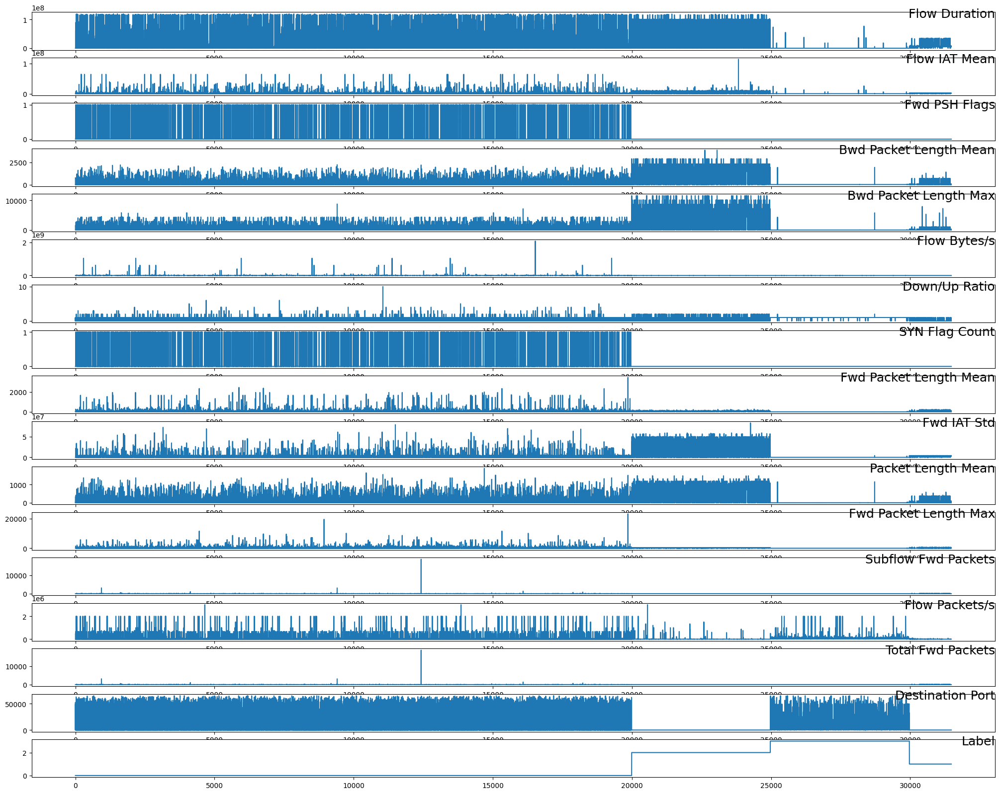

In [31]:
i = 1
# plot each column
plt.figure(figsize=(25,20))
for c in df.columns:
    plt.subplot(len(df.columns), 1, i)
    plt.plot(df[c])
    plt.title(c, y=0.75, loc='right', fontsize = 18)
    i += 1
plt.show()
plt.close()

<Figure size 1200x800 with 0 Axes>

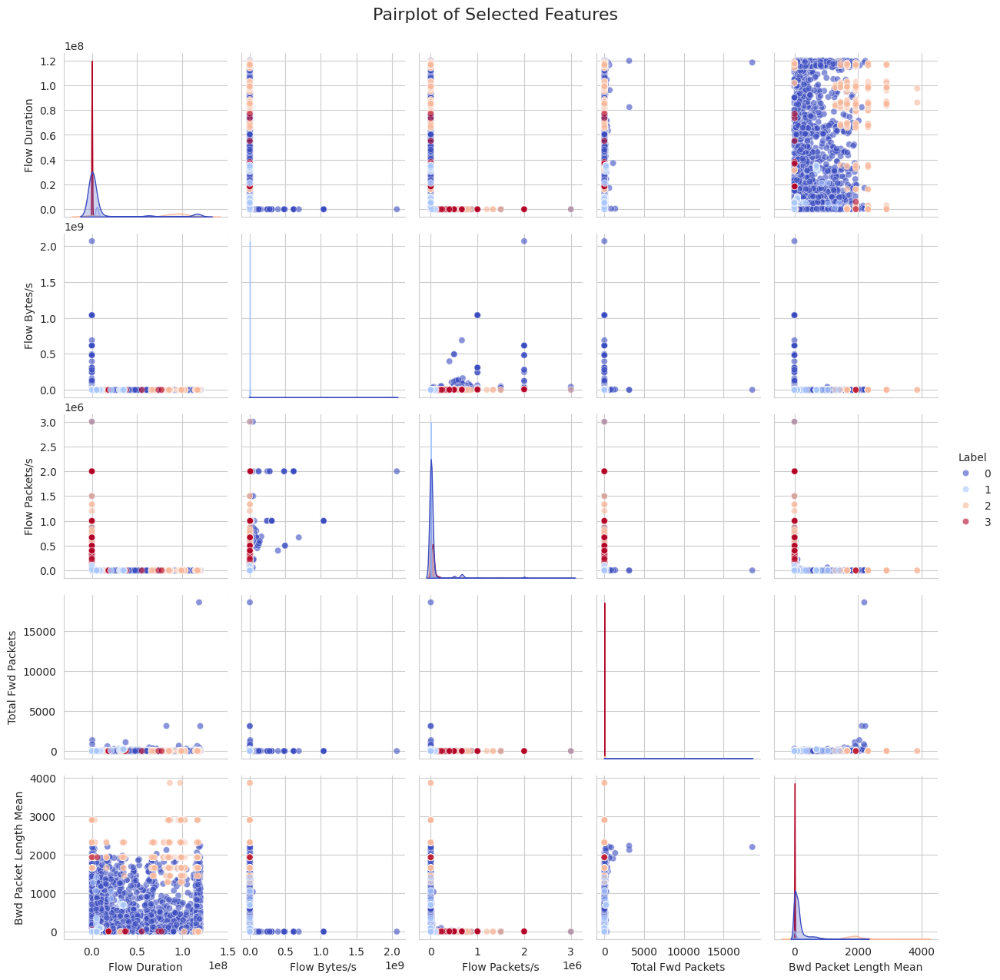

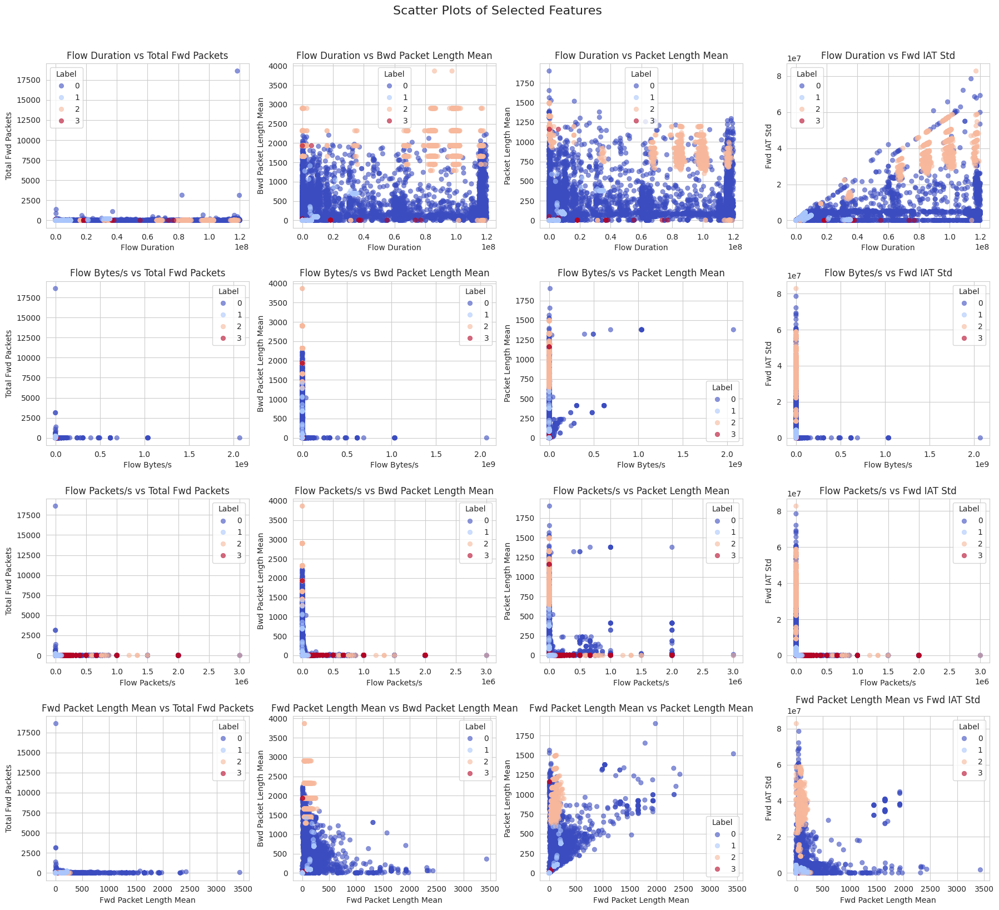

In [32]:
import matplotlib.pyplot as plt
import seaborn as sns



sns.set_style("whitegrid")

# 1. Scatter Plot Matrix (Pairplot)
features_to_plot = ['Flow Duration', 'Flow Bytes/s', 'Flow Packets/s', 'Total Fwd Packets', 'Bwd Packet Length Mean']
plt.figure(figsize=(12, 8))
sns.pairplot(df[features_to_plot + ['Label']], hue='Label', diag_kind='kde', palette='coolwarm', plot_kws={'alpha': 0.6})
plt.suptitle("Pairplot of Selected Features", fontsize=16, y=1.02)
plt.show()


features_x = ['Flow Duration', 'Flow Bytes/s', 'Flow Packets/s', 'Fwd Packet Length Mean']
features_y = ['Total Fwd Packets', 'Bwd Packet Length Mean', 'Packet Length Mean', 'Fwd IAT Std']

plt.figure(figsize=(18, 16))
plot_index = 1
for feature1 in features_x:
    for feature2 in features_y:
        plt.subplot(len(features_x), len(features_y), plot_index)
        sns.scatterplot(x=df[feature1], y=df[feature2], hue=df['Label'], alpha=0.6, palette='coolwarm', edgecolor=None)
        plt.xlabel(feature1, fontsize=10)
        plt.ylabel(feature2, fontsize=10)
        plt.title(f'{feature1} vs {feature2}', fontsize=12)
        plot_index += 1

plt.suptitle("Scatter Plots of Selected Features", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()



### Correlation Matrix

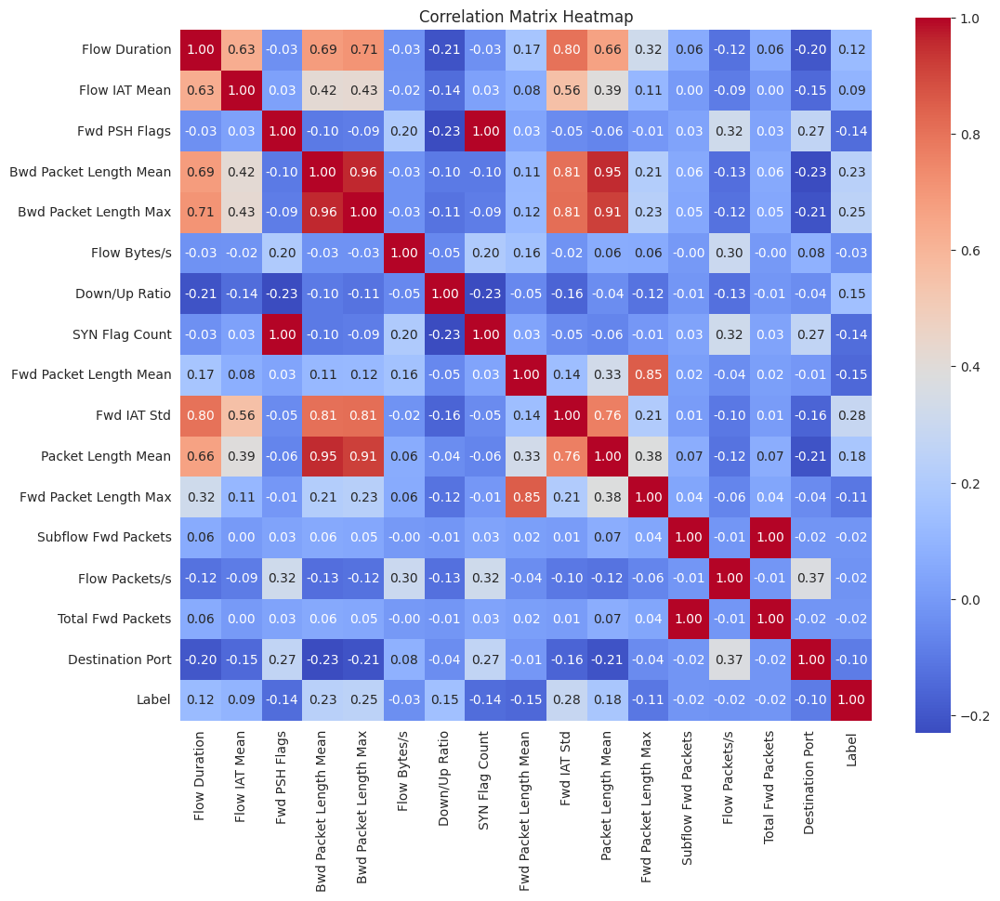

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns

# Correlation Matrix
corr_matrix = df.corr()


plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title("Correlation Matrix Heatmap")
plt.show()


In [34]:
import numpy as np


THRESHOLD = 0.99

corr = df.corr().abs()
upper = corr.where(np.triu(np.ones(corr.shape), k=1).astype(bool))

to_drop = [col for col in upper.columns if any(upper[col] > THRESHOLD)]
print(to_drop)


['SYN Flag Count', 'Total Fwd Packets']


In [35]:
(df['Fwd PSH Flags'] == df['SYN Flag Count']).all()

np.True_

In [36]:
df[['Fwd PSH Flags', 'SYN Flag Count']].drop_duplicates()



,Fwd PSH Flags,SYN Flag Count
0,0,0
13,1,1


In [37]:
cols_to_drop = [
    'Fwd PSH Flags',
    'Subflow Fwd Packets'
]

df = df.drop(columns=cols_to_drop)



Class counts:
Label
0    19240
1     1427
2     3868
3     4849
Name: count, dtype: int64


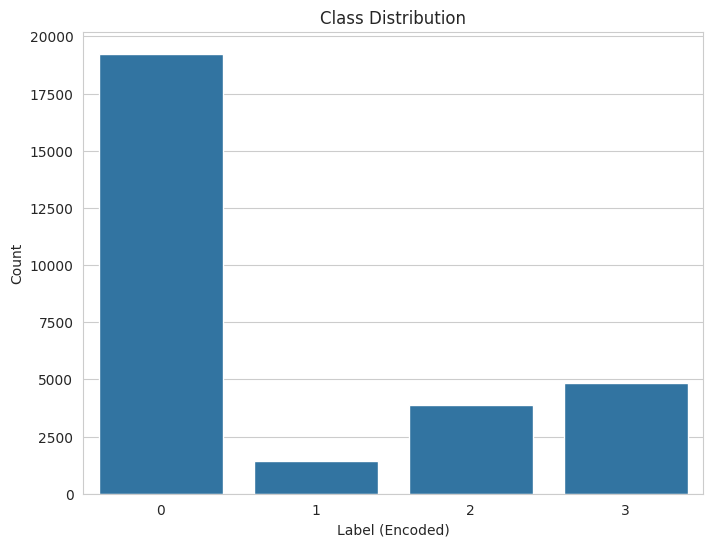

In [38]:
import matplotlib.pyplot as plt
import seaborn as sns

# Number of occurrences for each class
class_counts = df['Label'].value_counts().sort_index()
print("Class counts:")
print(class_counts)


plt.figure(figsize=(8, 6))
sns.countplot(x='Label', data=df, legend=False)
plt.title("Class Distribution")
plt.xlabel("Label (Encoded)")
plt.ylabel("Count")
plt.show()
#{'Benign': np.int64(0), 'Brute Force': np.int64(1), 'DoS Hulk': np.int64(2), 'PortScan': np.int64(3)}

/tmp/ipython-input-39-4198350486.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Label', y=feature, data=df, palette='Set2')
/tmp/ipython-input-39-4198350486.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Label', y=feature, data=df, palette='Set2')
/tmp/ipython-input-39-4198350486.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Label', y=feature, data=df, palette='Set2')
/tmp/ipython-input-39-4198350486.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Ass

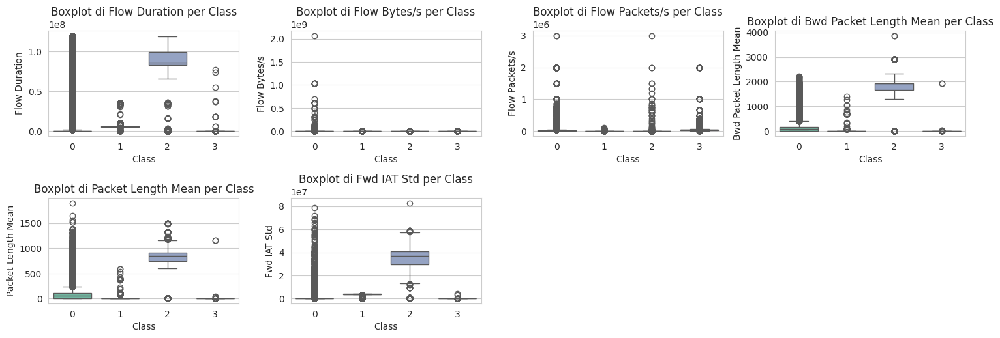

In [39]:
import matplotlib.pyplot as plt
import seaborn as sns


features = ['Flow Duration', 'Flow Bytes/s', 'Flow Packets/s', 'Bwd Packet Length Mean', 'Packet Length Mean', 'Fwd IAT Std']


plt.figure(figsize=(15, 10))
for i, feature in enumerate(features, 1):
    plt.subplot(4, 4, i)
    sns.boxplot(x='Label', y=feature, data=df, palette='Set2')
    plt.title(f'Boxplot di {feature} per Class')
    plt.xlabel('Class')
    plt.ylabel(feature)

plt.tight_layout()
plt.show()


/tmp/ipython-input-40-3136383551.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Label', y=feature, data=df, palette='Set2', inner='quartile')
/tmp/ipython-input-40-3136383551.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Label', y=feature, data=df, palette='Set2', inner='quartile')
/tmp/ipython-input-40-3136383551.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Label', y=feature, data=df, palette='Set2', inner='quartile')
/tmp/ipython-input-40-3136383551.py:4: FutureWarning: 

Passing `palette` without assign

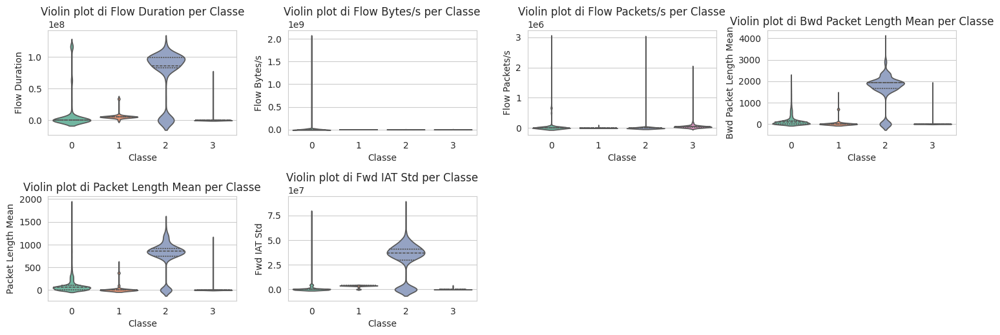

In [40]:
plt.figure(figsize=(15, 10))
for i, feature in enumerate(features, 1):
    plt.subplot(4, 4, i)
    sns.violinplot(x='Label', y=feature, data=df, palette='Set2', inner='quartile')
    plt.title(f'Violin plot di {feature} per Classe')
    plt.xlabel('Classe')
    plt.ylabel(feature)

plt.tight_layout()
plt.show()


### skewness analysis

In [ ]:
numeric_feats = df.select_dtypes(include=['int64','float64']).columns
skewness = df[numeric_feats].skew().sort_values(ascending=False)
print(skewness)


Total Fwd Packets         152.007747
Flow Bytes/s               41.798570
Fwd Packet Length Max      12.173963
Fwd Packet Length Mean     11.139485
Flow Packets/s              7.280535
Flow IAT Mean               7.197015
SYN Flag Count              4.737087
Fwd IAT Std                 2.526223
Bwd Packet Length Max       2.465285
Destination Port            2.154604
Bwd Packet Length Mean      2.105616
Packet Length Mean          1.980722
Flow Duration               1.810170
Label                       0.968786
Down/Up Ratio               0.347508
dtype: float64


### Dataset split

In [42]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import FunctionTransformer, RobustScaler
import matplotlib.pyplot as plt
import seaborn as sns


X = df.drop(columns=['Label'])
y = df['Label']

# 1.  training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train, y_temp = train_test_split(
    X, y, test_size=0.4, random_state=42, stratify=y
)
X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp
)


print("Class distribution - Train:\n", y_train.value_counts())
print("Class distribution - Val:\n", y_val.value_counts())
print("Class distribution - Test:\n", y_test.value_counts())

Class distribution - Train:
 Label
0    11544
3     2909
2     2321
1      856
Name: count, dtype: int64
Class distribution - Val:
 Label
0    3848
3     970
2     774
1     285
Name: count, dtype: int64
Class distribution - Test:
 Label
0    3848
3     970
2     773
1     286
Name: count, dtype: int64


### Analysis for features (raw data - not scaled)

Train Set Class Distribution:
Class 0: 65.48%
Class 1: 4.86%
Class 2: 13.17%
Class 3: 16.50%

Test Set Class Distribution:
Class 0: 65.48%
Class 1: 4.87%
Class 2: 13.15%
Class 3: 16.51%

Validation Set Class Distribution:
Class 0: 65.48%
Class 1: 4.85%
Class 2: 13.17%
Class 3: 16.51%
({np.int64(0): np.float64(65.47929665343165), np.int64(1): np.float64(4.855360181508791), np.int64(2): np.float64(13.16505955757232), np.int64(3): np.float64(16.500283607487237)}, {np.int64(0): np.float64(65.4755827803301), np.int64(1): np.float64(4.8664284498893995), np.int64(2): np.float64(13.152969201973796), np.int64(3): np.float64(16.505019567806702)}, {np.int64(0): np.float64(65.4755827803301), np.int64(1): np.float64(4.849412965798877), np.int64(2): np.float64(13.169984686064318), np.int64(3): np.float64(16.505019567806702)})

--- Analysis for Feature: Flow Duration ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


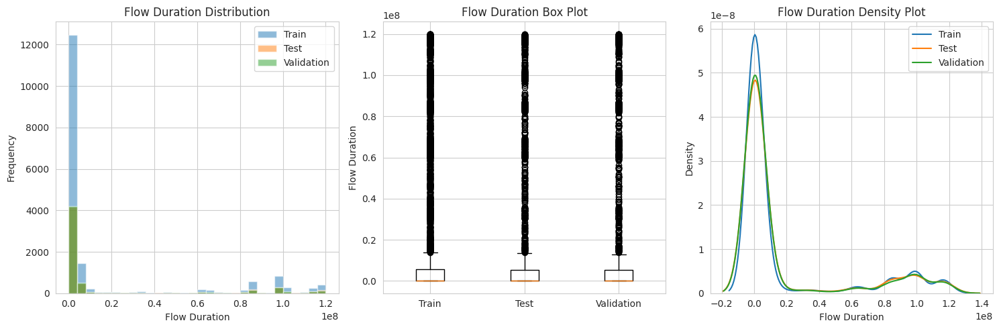

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0075
  P-value: 0.9632
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0136
  P-value: 0.3831
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0133
  P-value: 0.6787
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0010
train_vs_val_js_div: 0.0008
test_vs_val_js_div: 0.0008

--- Analysis for Feature: Flow IAT Mean ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


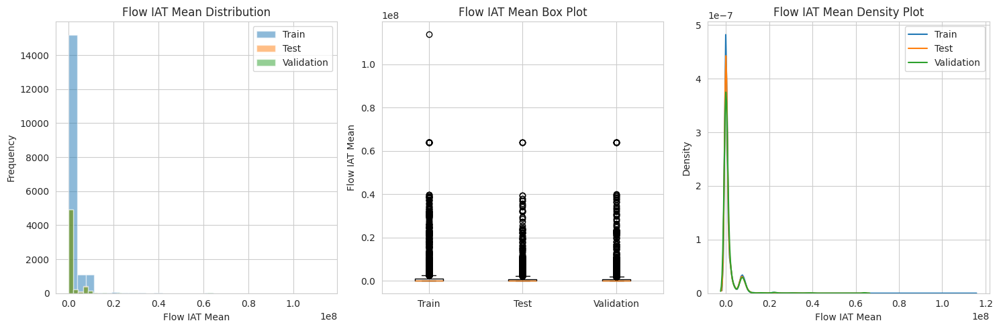

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0108
  P-value: 0.6738
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0121
  P-value: 0.5356
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0131
  P-value: 0.6942
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0370
train_vs_val_js_div: 0.0391
test_vs_val_js_div: 0.0008

--- Analysis for Feature: Bwd Packet Length Mean ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


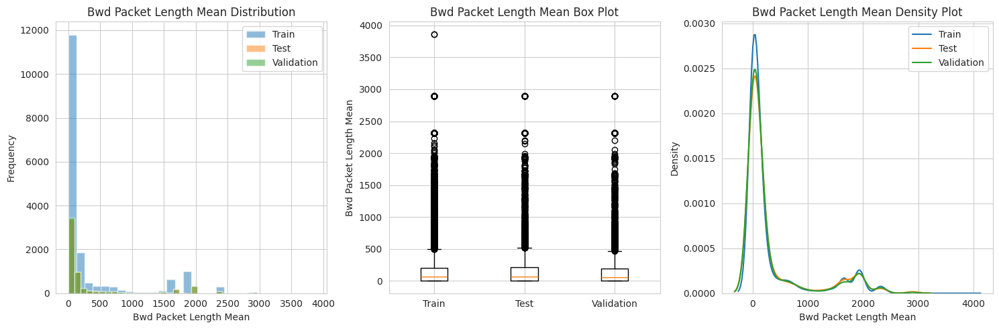

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0085
  P-value: 0.9050
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0142
  P-value: 0.3313
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0143
  P-value: 0.5857
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0774
train_vs_val_js_div: 0.0780
test_vs_val_js_div: 0.0010

--- Analysis for Feature: Bwd Packet Length Max ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


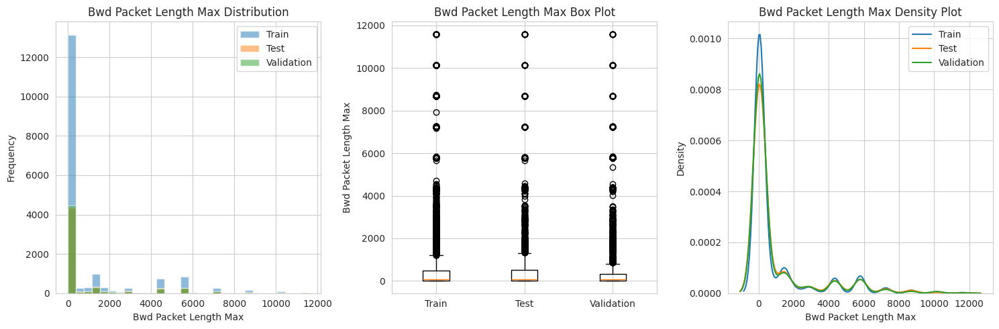

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0090
  P-value: 0.8634
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0149
  P-value: 0.2757
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0160
  P-value: 0.4399
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0005
train_vs_val_js_div: 0.0013
test_vs_val_js_div: 0.0015

--- Analysis for Feature: Flow Bytes/s ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


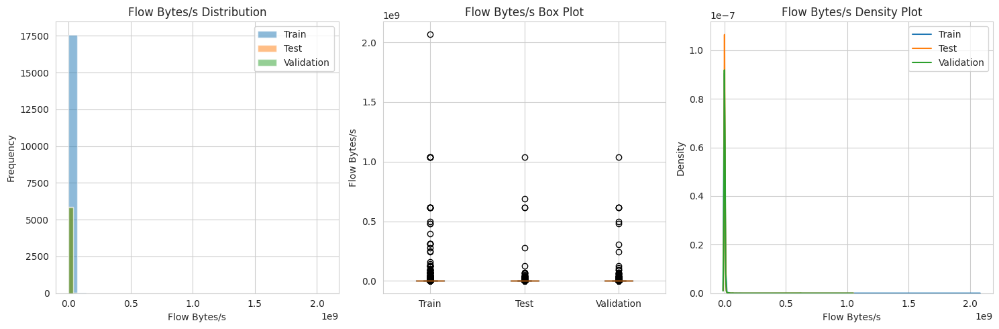

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0091
  P-value: 0.8564
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0160
  P-value: 0.2044
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0153
  P-value: 0.4960
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0007
train_vs_val_js_div: 0.0008
test_vs_val_js_div: 0.0003

--- Analysis for Feature: Down/Up Ratio ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


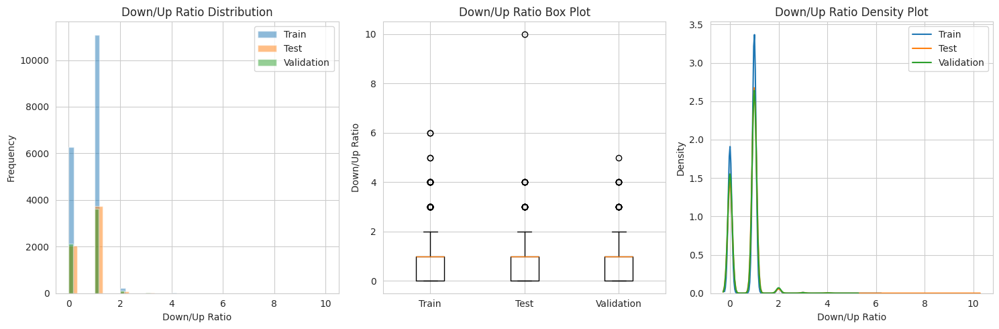

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0072
  P-value: 0.9743
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0078
  P-value: 0.9520
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0150
  P-value: 0.5253
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.4703
train_vs_val_js_div: 0.4468
test_vs_val_js_div: 0.4489

--- Analysis for Feature: SYN Flag Count ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


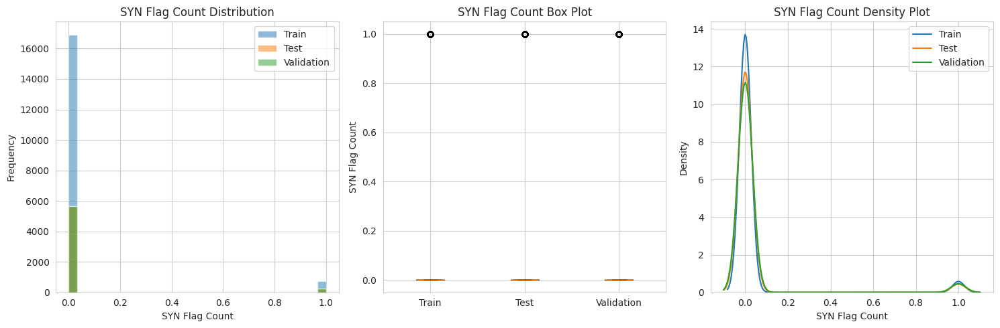

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0046
  P-value: 1.0000
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0010
  P-value: 1.0000
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0036
  P-value: 1.0000
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0001
train_vs_val_js_div: 0.0000
test_vs_val_js_div: 0.0000

--- Analysis for Feature: Fwd Packet Length Mean ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


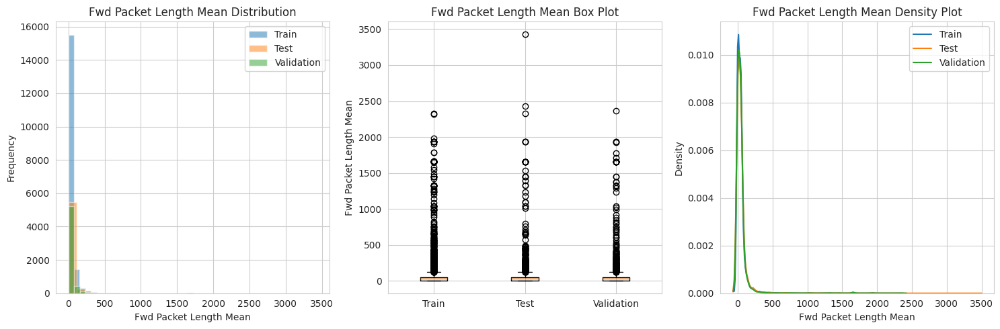

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0076
  P-value: 0.9574
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0130
  P-value: 0.4420
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0160
  P-value: 0.4399
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0055
train_vs_val_js_div: 0.0006
test_vs_val_js_div: 0.0039

--- Analysis for Feature: Fwd IAT Std ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


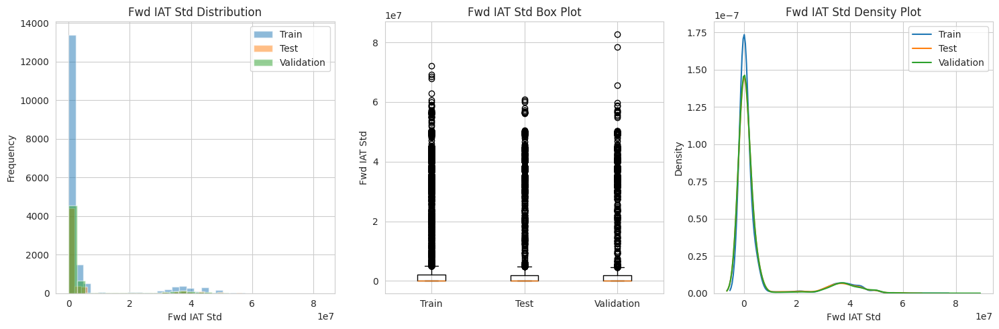

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0058
  P-value: 0.9983
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0153
  P-value: 0.2524
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0180
  P-value: 0.2947
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0237
train_vs_val_js_div: 0.0195
test_vs_val_js_div: 0.0501

--- Analysis for Feature: Packet Length Mean ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


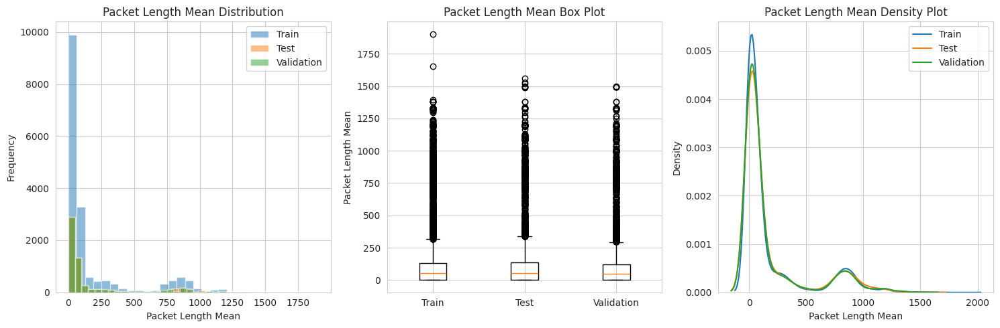

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0094
  P-value: 0.8320
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0142
  P-value: 0.3360
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0157
  P-value: 0.4675
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0375
train_vs_val_js_div: 0.0393
test_vs_val_js_div: 0.0149

--- Analysis for Feature: Fwd Packet Length Max ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


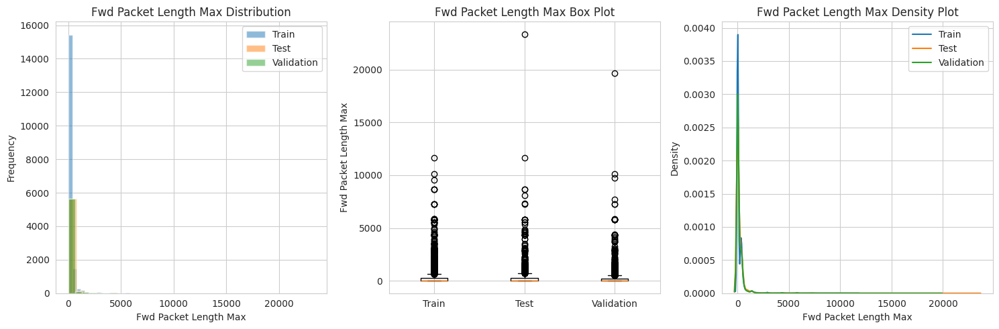

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0087
  P-value: 0.8876
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0157
  P-value: 0.2269
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0208
  P-value: 0.1588
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0139
train_vs_val_js_div: 0.0161
test_vs_val_js_div: 0.0027

--- Analysis for Feature: Flow Packets/s ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


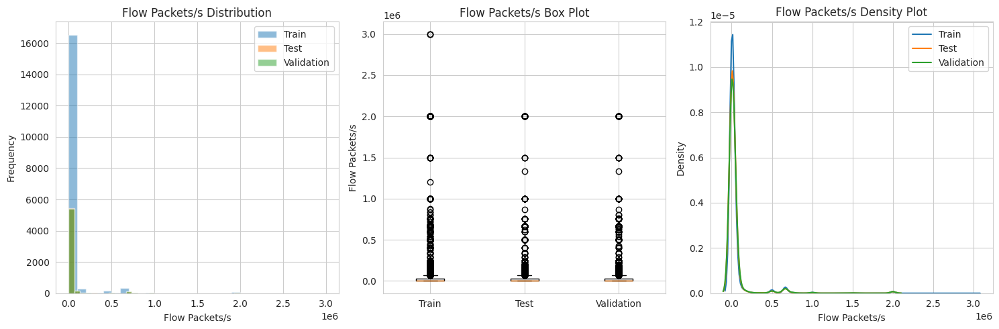

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0102
  P-value: 0.7488
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0121
  P-value: 0.5351
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0126
  P-value: 0.7401
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0218
train_vs_val_js_div: 0.0225
test_vs_val_js_div: 0.0006

--- Analysis for Feature: Total Fwd Packets ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


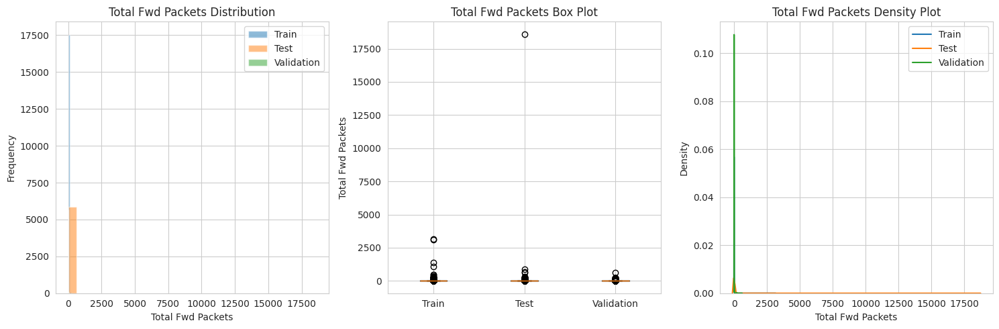

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0137
  P-value: 0.3756
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0160
  P-value: 0.2097
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0140
  P-value: 0.6165
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0014
train_vs_val_js_div: 0.0075
test_vs_val_js_div: 0.0140

--- Analysis for Feature: Destination Port ---


/tmp/ipython-input-363-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


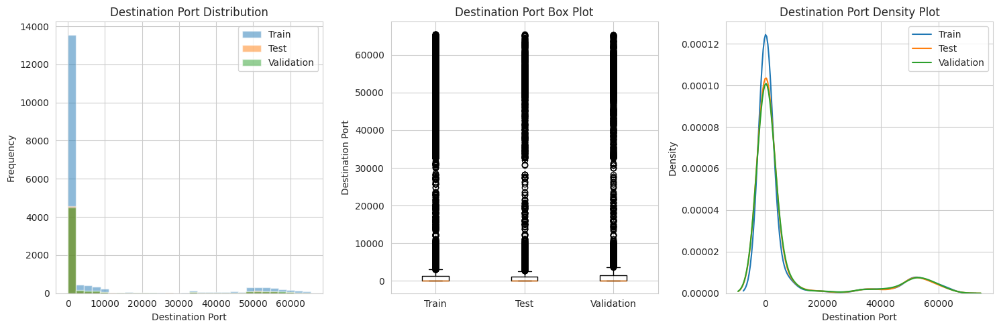

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0098
  P-value: 0.7846
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0071
  P-value: 0.9790
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0148
  P-value: 0.5402
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0007
train_vs_val_js_div: 0.0006
test_vs_val_js_div: 0.0014


{'Flow Duration': {'ks_tests': {'train_vs_test': {'statistic': np.float64(0.007511202182074184),
    'p_value': np.float64(0.9631919797937922),
    'sets_compared': 'Train vs Test',
    'significant_difference': np.False_},
   'train_vs_val': {'statistic': np.float64(0.013623959345829384),
    'p_value': np.float64(0.3830925418010922),
    'sets_compared': 'Train vs Validation',
    'significant_difference': np.False_},
   'test_vs_val': {'statistic': np.float64(0.013272077590607452),
    'p_value': np.float64(0.6787021676381784),
    'sets_compared': 'Test vs Validation',
    'significant_difference': np.False_}},
  'distribution_metrics': {'train_vs_test_js_div': np.float64(0.0010247426752211387),
   'train_vs_val_js_div': np.float64(0.0007967441166627167),
   'test_vs_val_js_div': np.float64(0.00079702588512927)}},
 'Flow IAT Mean': {'ks_tests': {'train_vs_test': {'statistic': np.float64(0.010842473003240705),
    'p_value': np.float64(0.673771808992577),
    'sets_compared': 'Train

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import scipy.stats as stats_scipy

def analyze_class_distribution(y_train, y_test, y_val):
    """
    Analyze class distribution across train, test, and validation sets.

    Args:
        y_train (np.ndarray): Training labels.
        y_test (np.ndarray): Test labels.
        y_val (np.ndarray): Validation labels.
    """
    def get_class_distribution(labels):
        unique, counts = np.unique(labels, return_counts=True)
        total = len(labels)
        percentages = (counts / total) * 100
        return dict(zip(unique, percentages))

    print("Train Set Class Distribution:")
    train_dist = get_class_distribution(y_train)
    for cls, percentage in train_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nTest Set Class Distribution:")
    test_dist = get_class_distribution(y_test)
    for cls, percentage in test_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nValidation Set Class Distribution:")
    val_dist = get_class_distribution(y_val)
    for cls, percentage in val_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    return train_dist, test_dist, val_dist

distributions = analyze_class_distribution(y_train, y_test, y_val)
print(distributions)

def compare_distributions(train_data, test_data, val_data, feature_name):
    """
    Compare distributions of a specific feature across train, test, and validation sets.

    Parameters:
        train_data: Training dataset feature column.
        test_data: Test dataset feature column.
        val_data: Validation dataset feature column.
        feature_name: Name of the feature being analyzed.

    Returns:
        Dictionary of statistical test results and visualization.
    """
    results = {}

    # 1. Statistical Tests (Kolmogorov-Smirnov Test)
    def ks_test_between_sets(set1, set2, set_names):
        statistic, p_value = stats.ks_2samp(set1, set2)
        return {
            'statistic': statistic,
            'p_value': p_value,
            'sets_compared': set_names,
            'significant_difference': p_value < 0.05
        }

    results['ks_tests'] = {
        'train_vs_test': ks_test_between_sets(train_data, test_data, 'Train vs Test'),
        'train_vs_val': ks_test_between_sets(train_data, val_data, 'Train vs Validation'),
        'test_vs_val': ks_test_between_sets(test_data, val_data, 'Test vs Validation')
    }

    # 2. Distribution Visualization
    plt.figure(figsize=(15, 5))
    plt.subplot(131)
    plt.hist(train_data, bins=30, alpha=0.5, label='Train')
    plt.hist(test_data, bins=30, alpha=0.5, label='Test')
    plt.hist(val_data, bins=30, alpha=0.5, label='Validation')
    plt.title(f'{feature_name} Distribution')
    plt.xlabel(feature_name)
    plt.ylabel('Frequency')
    plt.legend()

    plt.subplot(132)
    box_data = [train_data, test_data, val_data]
    plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])
    plt.title(f'{feature_name} Box Plot')
    plt.ylabel(feature_name)

    plt.subplot(133)
    sns.kdeplot(train_data, label='Train')
    sns.kdeplot(test_data, label='Test')
    sns.kdeplot(val_data, label='Validation')
    plt.title(f'{feature_name} Density Plot')
    plt.xlabel(feature_name)
    plt.ylabel('Density')
    plt.legend()
    plt.tight_layout()
    plt.show()

    # 3. Distribution Metrics (Jensen-Shannon Divergence)
    def jensen_shannon_divergence(p, q):
        p = np.asarray(p)
        q = np.asarray(q)
        m = 0.5 * (p + q)
        return 0.5 * (stats_scipy.entropy(p, m) + stats_scipy.entropy(q, m))

    def get_distribution_histogram(data, bins=30):
        hist, _ = np.histogram(data, bins=bins, density=True)
        return hist

    results['distribution_metrics'] = {
        'train_vs_test_js_div': jensen_shannon_divergence(
            get_distribution_histogram(train_data),
            get_distribution_histogram(test_data)
        ),
        'train_vs_val_js_div': jensen_shannon_divergence(
            get_distribution_histogram(train_data),
            get_distribution_histogram(val_data)
        ),
        'test_vs_val_js_div': jensen_shannon_divergence(
            get_distribution_histogram(test_data),
            get_distribution_histogram(val_data)
        )
    }
    return results

def analyze_feature_distributions(X_train, X_test, X_val, feature_names=None):
    """
    Analyze distributions for multiple features.

    Parameters:
        X_train: Training dataset (2D NumPy array).
        X_test: Test dataset (2D NumPy array).
        X_val: Validation dataset (2D NumPy array).
        feature_names: Optional list of feature names (default is column indices).
    """
    if feature_names is None:
        feature_names = [f'Feature_{i}' for i in range(X_train.shape[1])]

    assert X_train.shape[1] == len(feature_names), "Number of feature names must match number of columns"
    comprehensive_results = {}
    for idx, feature in enumerate(feature_names):
        print(f"\n--- Analysis for Feature: {feature} ---")
        train_feature = X_train[:, idx]
        test_feature = X_test[:, idx]
        val_feature = X_val[:, idx]
        results = compare_distributions(train_feature, test_feature, val_feature, feature)
        comprehensive_results[feature] = results
        print("Kolmogorov-Smirnov Test Results:")
        for key, test_result in results['ks_tests'].items():
            print(f"{test_result['sets_compared']}:")
            print(f"  Statistic: {test_result['statistic']:.4f}")
            print(f"  P-value: {test_result['p_value']:.4f}")
            print(f"  Significant Difference: {test_result['significant_difference']}")
        print("\nJensen-Shannon Divergence:")
        for key, div_value in results['distribution_metrics'].items():
            print(f"{key}: {div_value:.4f}")
    return comprehensive_results

features = X_train.columns.tolist()
analyze_feature_distributions(X_train.to_numpy(), X_test.to_numpy(), X_val.to_numpy(), features)


### Outliers analysis (raw data)

In [ ]:
import numpy as np

def detect_outliers_iqr(data, multiplier=1.5):
    """
    Detect outliers using Interquartile Range method

    Parameters:
    - data: NumPy array
    - multiplier: IQR multiplier (default 1.5)

    Returns:
    - Boolean array indicating outliers
    """
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    lower_bound = Q1 - (multiplier * IQR)
    upper_bound = Q3 + (multiplier * IQR)
    return (data < lower_bound) | (data > upper_bound)

def analyze_outliers_by_class(X, y, method='iqr', multiplier=1.5):
    """
    Analyze outliers across different classes

    Parameters:
    - X: Feature matrix (2D NumPy array)
    - y: Class labels (1D NumPy array)
    - method: Outlier detection method ('iqr')
    - multiplier: Multiplier for IQR method

    Returns:
    - Comprehensive outlier analysis by class
    """
    # Unique classes
    unique_classes = np.unique(y)

    # Outlier analysis results
    outlier_analysis = {
        'overall_results': {},
        'class_results': {}
    }

    # Total outliers tracking
    total_outliers = 0
    total_samples = len(y)

    # Analyze each feature
    for feature_idx in range(X.shape[1]):
        feature_outliers = {
            'overall_outliers': [],
            'class_outliers': {}
        }

        # Current feature column
        feature_data = X[:, feature_idx]

        # Detect overall outliers
        overall_outlier_mask = detect_outliers_iqr(feature_data, multiplier)
        feature_outliers['overall_outliers'] = overall_outlier_mask

        # Per-class analysis
        for cls in unique_classes:
            # Mask for current class
            class_mask = (y == cls)

            # Feature data for current class
            class_feature_data = feature_data[class_mask]

            # Detect outliers for this class
            class_outlier_mask = detect_outliers_iqr(class_feature_data, multiplier)

            # Store class-specific results
            feature_outliers['class_outliers'][cls] = {
                'total_samples': len(class_feature_data),
                'outlier_samples': np.sum(class_outlier_mask),
                'outlier_percentage': (np.sum(class_outlier_mask) / len(class_feature_data)) * 100
            }

        # Store results for this feature
        outlier_analysis['overall_results'][f'Feature_{feature_idx}'] = feature_outliers

    # Summarize overall results
    print("\nOutlier Analysis Summary:")
    for feature, results in outlier_analysis['overall_results'].items():
        print(f"\n{feature}:")

        # Overall outliers
        overall_outliers = np.sum(results['overall_outliers'])
        overall_outlier_percentage = (overall_outliers / total_samples) * 100
        print(f"  Total Outliers: {overall_outliers} ({overall_outlier_percentage:.2f}%)")

        # Class-specific results
        print("  Class-wise Outlier Breakdown:")
        for cls, class_results in results['class_outliers'].items():
            print(f"    Class {cls}:")
            print(f"      Total Samples: {class_results['total_samples']}")
            print(f"      Outlier Samples: {class_results['outlier_samples']}")
            print(f"      Outlier Percentage: {class_results['outlier_percentage']:.2f}%")

    return outlier_analysis





outlier_analysis = analyze_outliers_by_class(X_train.to_numpy(), y_train)




Outlier Analysis Summary:

Feature_0:
  Total Outliers: 3483 (19.76%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 11544
      Outlier Samples: 2669
      Outlier Percentage: 23.12%
    Class 1:
      Total Samples: 856
      Outlier Samples: 128
      Outlier Percentage: 14.95%
    Class 2:
      Total Samples: 2321
      Outlier Samples: 485
      Outlier Percentage: 20.90%
    Class 3:
      Total Samples: 2909
      Outlier Samples: 348
      Outlier Percentage: 11.96%

Feature_1:
  Total Outliers: 2898 (16.44%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 11544
      Outlier Samples: 2512
      Outlier Percentage: 21.76%
    Class 1:
      Total Samples: 856
      Outlier Samples: 115
      Outlier Percentage: 13.43%
    Class 2:
      Total Samples: 2321
      Outlier Samples: 499
      Outlier Percentage: 21.50%
    Class 3:
      Total Samples: 2909
      Outlier Samples: 348
      Outlier Percentage: 11.96%

Feature_2:
  Total Outlier

### Standard Scaler

In [43]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns



print("Class distribution - Train:\n", y_train.value_counts())
print("Class distribution - Validation:\n", y_val.value_counts())
print("Class distribution - Test:\n", y_test.value_counts())


scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)


X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns, index=X_train.index)
X_val_scaled = pd.DataFrame(X_val_scaled, columns=X_val.columns, index=X_val.index)


X_test_scaled= scaler.transform(X_test)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns, index=X_test.index)






Class distribution - Train:
 Label
0    11544
3     2909
2     2321
1      856
Name: count, dtype: int64
Class distribution - Validation:
 Label
0    3848
3     970
2     774
1     285
Name: count, dtype: int64
Class distribution - Test:
 Label
0    3848
3     970
2     773
1     286
Name: count, dtype: int64


#### Outliers analysis

- train

In [ ]:
import numpy as np

def detect_outliers_iqr(data, multiplier=1.5):
    """
    Detect outliers using Interquartile Range method

    Parameters:
    - data: NumPy array
    - multiplier: IQR multiplier (default 1.5)

    Returns:
    - Boolean array indicating outliers
    """
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    lower_bound = Q1 - (multiplier * IQR)
    upper_bound = Q3 + (multiplier * IQR)
    return (data < lower_bound) | (data > upper_bound)

def analyze_outliers_by_class(X, y, method='iqr', multiplier=1.5):
    """
    Analyze outliers across different classes

    Parameters:
    - X: Feature matrix (2D NumPy array)
    - y: Class labels (1D NumPy array)
    - method: Outlier detection method ('iqr')
    - multiplier: Multiplier for IQR method

    Returns:
    - Comprehensive outlier analysis by class
    """
    # Unique classes
    unique_classes = np.unique(y)

    # Outlier analysis results
    outlier_analysis = {
        'overall_results': {},
        'class_results': {}
    }

    # Total outliers tracking
    total_outliers = 0
    total_samples = len(y)

    # Analyze each feature
    for feature_idx in range(X.shape[1]):
        feature_outliers = {
            'overall_outliers': [],
            'class_outliers': {}
        }

        # Current feature column
        feature_data = X[:, feature_idx]

        # Detect overall outliers
        overall_outlier_mask = detect_outliers_iqr(feature_data, multiplier)
        feature_outliers['overall_outliers'] = overall_outlier_mask

        # Per-class analysis
        for cls in unique_classes:
            # Mask for current class
            class_mask = (y == cls)

            # Feature data for current class
            class_feature_data = feature_data[class_mask]

            # Detect outliers for this class
            class_outlier_mask = detect_outliers_iqr(class_feature_data, multiplier)

            # Store class-specific results
            feature_outliers['class_outliers'][cls] = {
                'total_samples': len(class_feature_data),
                'outlier_samples': np.sum(class_outlier_mask),
                'outlier_percentage': (np.sum(class_outlier_mask) / len(class_feature_data)) * 100
            }

        # Store results for this feature
        outlier_analysis['overall_results'][f'Feature_{feature_idx}'] = feature_outliers

    # Summarize overall results
    print("\nOutlier Analysis Summary:")
    for feature, results in outlier_analysis['overall_results'].items():
        print(f"\n{feature}:")

        # Overall outliers
        overall_outliers = np.sum(results['overall_outliers'])
        overall_outlier_percentage = (overall_outliers / total_samples) * 100
        print(f"  Total Outliers: {overall_outliers} ({overall_outlier_percentage:.2f}%)")

        # Class-specific results
        print("  Class-wise Outlier Breakdown:")
        for cls, class_results in results['class_outliers'].items():
            print(f"    Class {cls}:")
            print(f"      Total Samples: {class_results['total_samples']}")
            print(f"      Outlier Samples: {class_results['outlier_samples']}")
            print(f"      Outlier Percentage: {class_results['outlier_percentage']:.2f}%")

    return outlier_analysis





outlier_analysis = analyze_outliers_by_class(X_train_scaled.to_numpy(), y_train)




Outlier Analysis Summary:

Feature_0:
  Total Outliers: 3483 (19.76%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 11544
      Outlier Samples: 2669
      Outlier Percentage: 23.12%
    Class 1:
      Total Samples: 856
      Outlier Samples: 128
      Outlier Percentage: 14.95%
    Class 2:
      Total Samples: 2321
      Outlier Samples: 485
      Outlier Percentage: 20.90%
    Class 3:
      Total Samples: 2909
      Outlier Samples: 348
      Outlier Percentage: 11.96%

Feature_1:
  Total Outliers: 2898 (16.44%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 11544
      Outlier Samples: 2512
      Outlier Percentage: 21.76%
    Class 1:
      Total Samples: 856
      Outlier Samples: 115
      Outlier Percentage: 13.43%
    Class 2:
      Total Samples: 2321
      Outlier Samples: 499
      Outlier Percentage: 21.50%
    Class 3:
      Total Samples: 2909
      Outlier Samples: 348
      Outlier Percentage: 11.96%

Feature_2:
  Total Outlier

- val

In [ ]:
import numpy as np

def detect_outliers_iqr(data, multiplier=1.5):
    """
    Detect outliers using Interquartile Range method

    Parameters:
    - data: NumPy array
    - multiplier: IQR multiplier (default 1.5)

    Returns:
    - Boolean array indicating outliers
    """
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    lower_bound = Q1 - (multiplier * IQR)
    upper_bound = Q3 + (multiplier * IQR)
    return (data < lower_bound) | (data > upper_bound)

def analyze_outliers_by_class(X, y, method='iqr', multiplier=1.5):
    """
    Analyze outliers across different classes

    Parameters:
    - X: Feature matrix (2D NumPy array)
    - y: Class labels (1D NumPy array)
    - method: Outlier detection method ('iqr')
    - multiplier: Multiplier for IQR method

    Returns:
    - Comprehensive outlier analysis by class
    """
    # Unique classes
    unique_classes = np.unique(y)

    # Outlier analysis results
    outlier_analysis = {
        'overall_results': {},
        'class_results': {}
    }

    # Total outliers tracking
    total_outliers = 0
    total_samples = len(y)

    # Analyze each feature
    for feature_idx in range(X.shape[1]):
        feature_outliers = {
            'overall_outliers': [],
            'class_outliers': {}
        }

        # Current feature column
        feature_data = X[:, feature_idx]

        # Detect overall outliers
        overall_outlier_mask = detect_outliers_iqr(feature_data, multiplier)
        feature_outliers['overall_outliers'] = overall_outlier_mask

        # Per-class analysis
        for cls in unique_classes:
            # Mask for current class
            class_mask = (y == cls)

            # Feature data for current class
            class_feature_data = feature_data[class_mask]

            # Detect outliers for this class
            class_outlier_mask = detect_outliers_iqr(class_feature_data, multiplier)

            # Store class-specific results
            feature_outliers['class_outliers'][cls] = {
                'total_samples': len(class_feature_data),
                'outlier_samples': np.sum(class_outlier_mask),
                'outlier_percentage': (np.sum(class_outlier_mask) / len(class_feature_data)) * 100
            }

        # Store results for this feature
        outlier_analysis['overall_results'][f'Feature_{feature_idx}'] = feature_outliers

    # Summarize overall results
    print("\nOutlier Analysis Summary:")
    for feature, results in outlier_analysis['overall_results'].items():
        print(f"\n{feature}:")

        # Overall outliers
        overall_outliers = np.sum(results['overall_outliers'])
        overall_outlier_percentage = (overall_outliers / total_samples) * 100
        print(f"  Total Outliers: {overall_outliers} ({overall_outlier_percentage:.2f}%)")

        # Class-specific results
        print("  Class-wise Outlier Breakdown:")
        for cls, class_results in results['class_outliers'].items():
            print(f"    Class {cls}:")
            print(f"      Total Samples: {class_results['total_samples']}")
            print(f"      Outlier Samples: {class_results['outlier_samples']}")
            print(f"      Outlier Percentage: {class_results['outlier_percentage']:.2f}%")

    return outlier_analysis



# Demonstration

outlier_analysis = analyze_outliers_by_class(X_val_scaled.to_numpy(), y_val)

# can be runned again


Outlier Analysis Summary:

Feature_0:
  Total Outliers: 1098 (18.68%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 3848
      Outlier Samples: 889
      Outlier Percentage: 23.10%
    Class 1:
      Total Samples: 285
      Outlier Samples: 39
      Outlier Percentage: 13.68%
    Class 2:
      Total Samples: 774
      Outlier Samples: 0
      Outlier Percentage: 0.00%
    Class 3:
      Total Samples: 970
      Outlier Samples: 107
      Outlier Percentage: 11.03%

Feature_1:
  Total Outliers: 1070 (18.21%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 3848
      Outlier Samples: 841
      Outlier Percentage: 21.86%
    Class 1:
      Total Samples: 285
      Outlier Samples: 34
      Outlier Percentage: 11.93%
    Class 2:
      Total Samples: 774
      Outlier Samples: 5
      Outlier Percentage: 0.65%
    Class 3:
      Total Samples: 970
      Outlier Samples: 107
      Outlier Percentage: 11.03%

Feature_2:
  Total Outliers: 1067 (18.16%)

#### Analysis for feature

Train Set Class Distribution:
Class 0: 65.48%
Class 1: 4.86%
Class 2: 13.17%
Class 3: 16.50%

Test Set Class Distribution:
Class 0: 65.48%
Class 1: 4.87%
Class 2: 13.15%
Class 3: 16.51%

Validation Set Class Distribution:
Class 0: 65.48%
Class 1: 4.85%
Class 2: 13.17%
Class 3: 16.51%
({np.int64(0): np.float64(65.47929665343165), np.int64(1): np.float64(4.855360181508791), np.int64(2): np.float64(13.16505955757232), np.int64(3): np.float64(16.500283607487237)}, {np.int64(0): np.float64(65.4755827803301), np.int64(1): np.float64(4.8664284498893995), np.int64(2): np.float64(13.152969201973796), np.int64(3): np.float64(16.505019567806702)}, {np.int64(0): np.float64(65.4755827803301), np.int64(1): np.float64(4.849412965798877), np.int64(2): np.float64(13.169984686064318), np.int64(3): np.float64(16.505019567806702)})

--- Analysis for Feature: Flow Duration ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


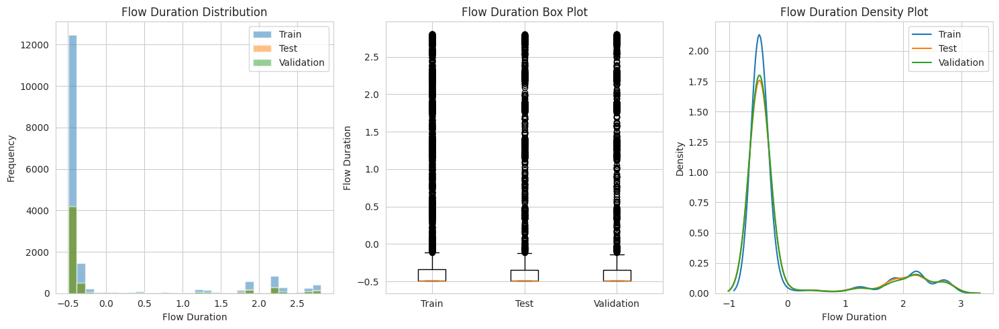

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0075
  P-value: 0.9632
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0136
  P-value: 0.3831
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0133
  P-value: 0.6787
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0010
train_vs_val_js_div: 0.0008
test_vs_val_js_div: 0.0008

--- Analysis for Feature: Flow IAT Mean ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


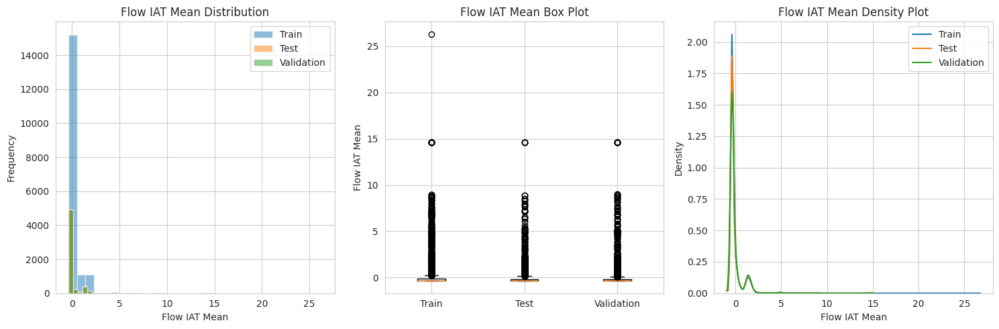

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0108
  P-value: 0.6738
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0121
  P-value: 0.5356
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0131
  P-value: 0.6942
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0370
train_vs_val_js_div: 0.0391
test_vs_val_js_div: 0.0008

--- Analysis for Feature: Bwd Packet Length Mean ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


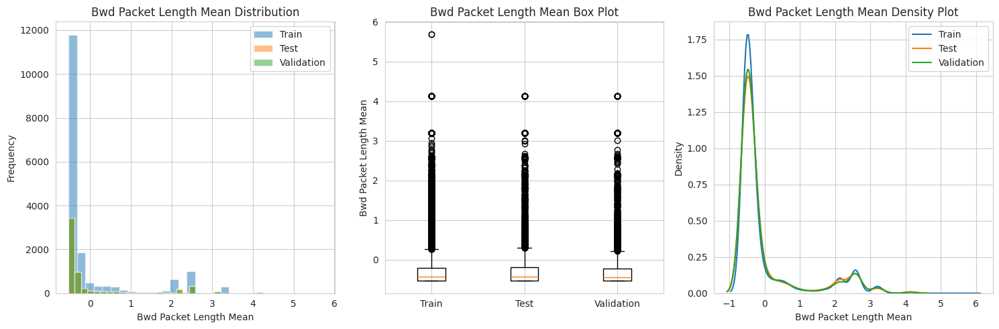

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0085
  P-value: 0.9050
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0142
  P-value: 0.3313
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0143
  P-value: 0.5857
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0713
train_vs_val_js_div: 0.0704
test_vs_val_js_div: 0.0013

--- Analysis for Feature: Bwd Packet Length Max ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


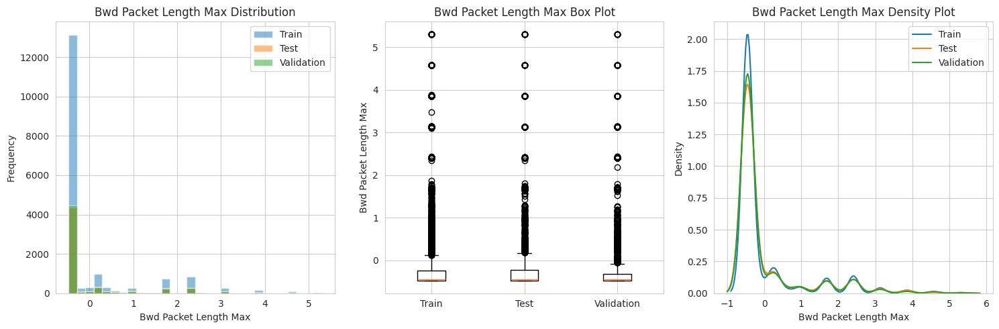

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0090
  P-value: 0.8634
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0149
  P-value: 0.2757
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0160
  P-value: 0.4399
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0005
train_vs_val_js_div: 0.0013
test_vs_val_js_div: 0.0015

--- Analysis for Feature: Flow Bytes/s ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


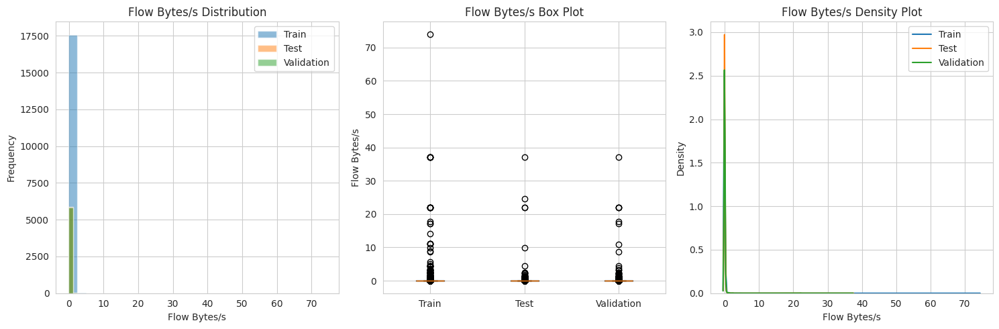

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0091
  P-value: 0.8564
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0160
  P-value: 0.2044
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0153
  P-value: 0.4960
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0007
train_vs_val_js_div: 0.0009
test_vs_val_js_div: 0.0003

--- Analysis for Feature: Down/Up Ratio ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


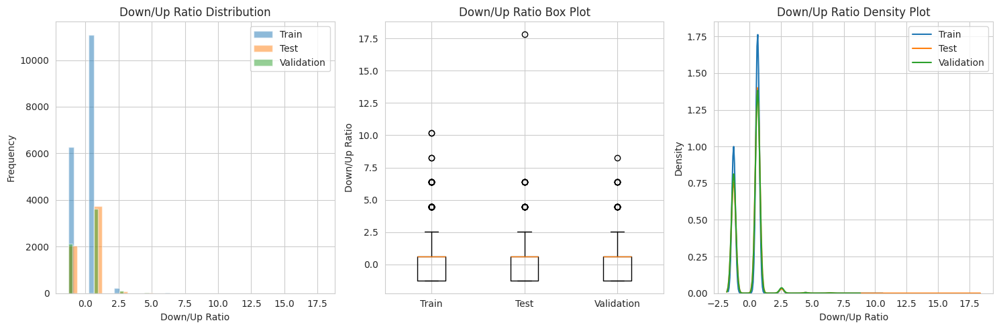

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0072
  P-value: 0.9743
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0078
  P-value: 0.9520
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0150
  P-value: 0.5253
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.4672
train_vs_val_js_div: 0.4467
test_vs_val_js_div: 0.4489

--- Analysis for Feature: SYN Flag Count ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


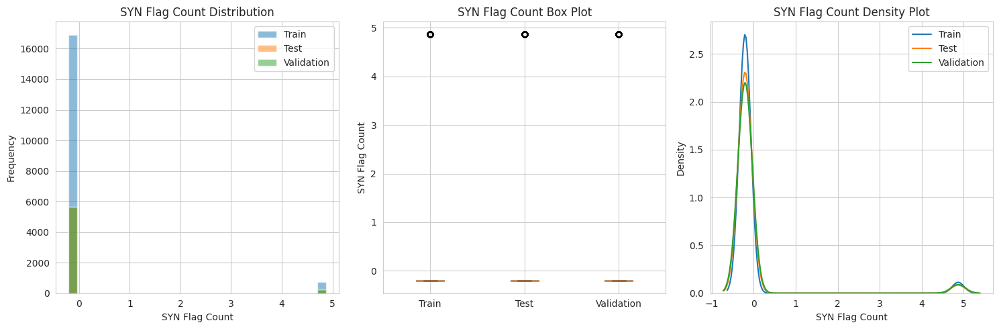

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0046
  P-value: 1.0000
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0010
  P-value: 1.0000
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0036
  P-value: 1.0000
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0001
train_vs_val_js_div: 0.0000
test_vs_val_js_div: 0.0000

--- Analysis for Feature: Fwd Packet Length Mean ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


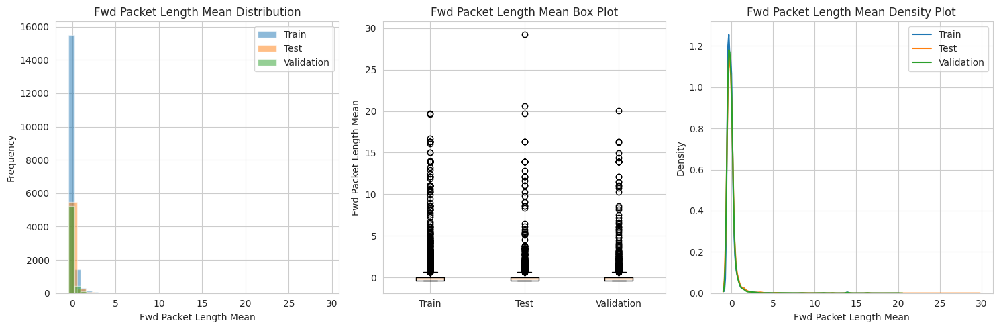

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0076
  P-value: 0.9574
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0130
  P-value: 0.4420
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0160
  P-value: 0.4399
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0055
train_vs_val_js_div: 0.0006
test_vs_val_js_div: 0.0039

--- Analysis for Feature: Fwd IAT Std ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


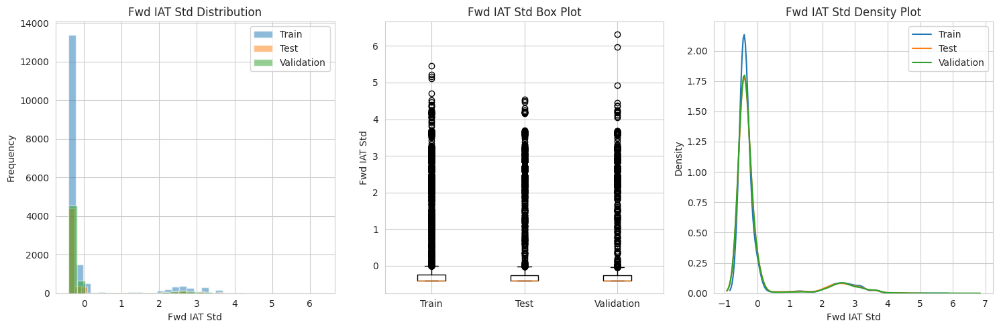

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0058
  P-value: 0.9983
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0153
  P-value: 0.2524
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0180
  P-value: 0.2947
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0237
train_vs_val_js_div: 0.0195
test_vs_val_js_div: 0.0501

--- Analysis for Feature: Packet Length Mean ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


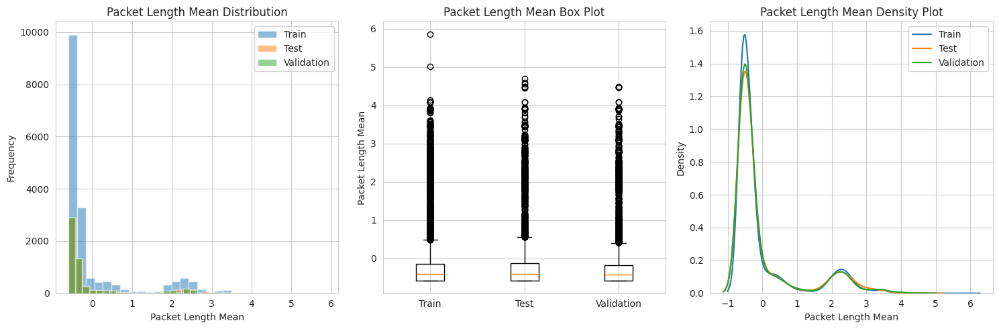

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0094
  P-value: 0.8320
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0142
  P-value: 0.3360
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0157
  P-value: 0.4675
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0375
train_vs_val_js_div: 0.0393
test_vs_val_js_div: 0.0149

--- Analysis for Feature: Fwd Packet Length Max ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


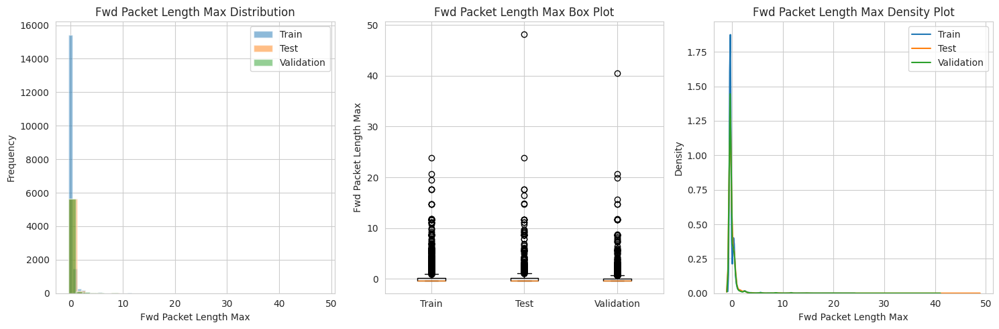

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0087
  P-value: 0.8876
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0157
  P-value: 0.2269
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0208
  P-value: 0.1588
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0139
train_vs_val_js_div: 0.0161
test_vs_val_js_div: 0.0027

--- Analysis for Feature: Flow Packets/s ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


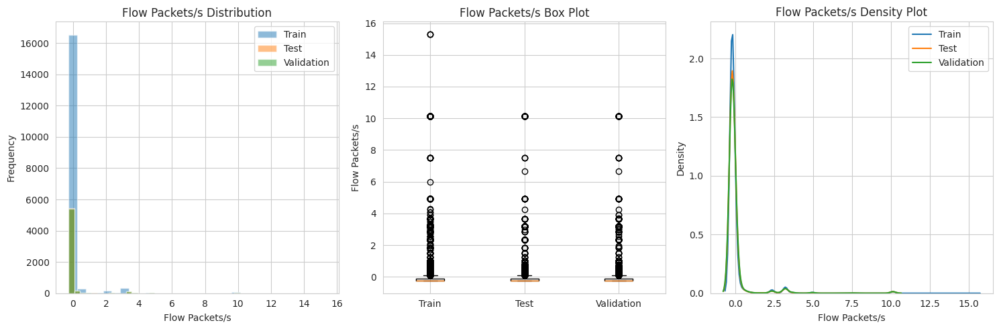

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0102
  P-value: 0.7488
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0121
  P-value: 0.5351
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0126
  P-value: 0.7401
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0218
train_vs_val_js_div: 0.0225
test_vs_val_js_div: 0.0006

--- Analysis for Feature: Total Fwd Packets ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


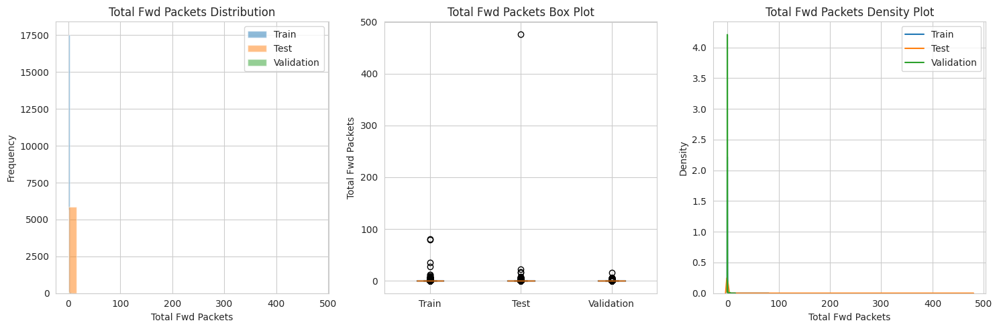

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0137
  P-value: 0.3756
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0160
  P-value: 0.2097
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0140
  P-value: 0.6165
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0014
train_vs_val_js_div: 0.0075
test_vs_val_js_div: 0.0140

--- Analysis for Feature: Destination Port ---


/tmp/ipython-input-368-813627218.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


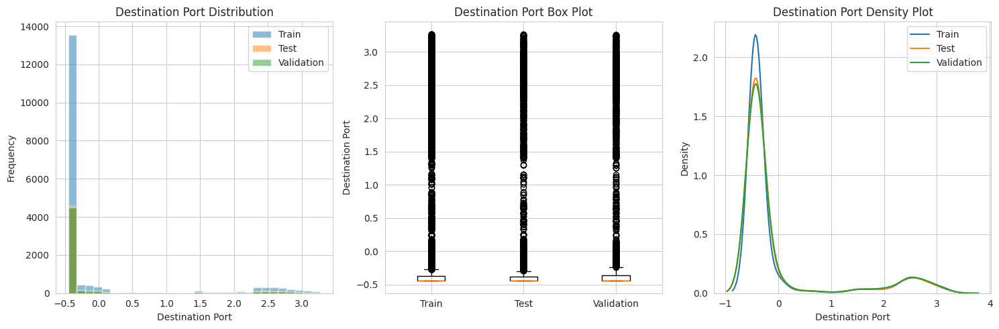

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0098
  P-value: 0.7846
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0071
  P-value: 0.9790
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0148
  P-value: 0.5402
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0007
train_vs_val_js_div: 0.0006
test_vs_val_js_div: 0.0014


{'Flow Duration': {'ks_tests': {'train_vs_test': {'statistic': np.float64(0.007511202182074184),
    'p_value': np.float64(0.9631919797937922),
    'sets_compared': 'Train vs Test',
    'significant_difference': np.False_},
   'train_vs_val': {'statistic': np.float64(0.013623959345829384),
    'p_value': np.float64(0.3830925418010922),
    'sets_compared': 'Train vs Validation',
    'significant_difference': np.False_},
   'test_vs_val': {'statistic': np.float64(0.013272077590607452),
    'p_value': np.float64(0.6787021676381784),
    'sets_compared': 'Test vs Validation',
    'significant_difference': np.False_}},
  'distribution_metrics': {'train_vs_test_js_div': np.float64(0.0010247426752213228),
   'train_vs_val_js_div': np.float64(0.000796744116662299),
   'test_vs_val_js_div': np.float64(0.000797025885128762)}},
 'Flow IAT Mean': {'ks_tests': {'train_vs_test': {'statistic': np.float64(0.010842473003240705),
    'p_value': np.float64(0.673771808992577),
    'sets_compared': 'Train

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import scipy.stats as stats_scipy

def analyze_class_distribution(y_train, y_test, y_val):
    """
    Analyze class distribution across train, test, and validation sets.

    Args:
        y_train (np.ndarray): Training labels.
        y_test (np.ndarray): Test labels.
        y_val (np.ndarray): Validation labels.
    """
    def get_class_distribution(labels):
        unique, counts = np.unique(labels, return_counts=True)
        total = len(labels)
        percentages = (counts / total) * 100
        return dict(zip(unique, percentages))

    print("Train Set Class Distribution:")
    train_dist = get_class_distribution(y_train)
    for cls, percentage in train_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nTest Set Class Distribution:")
    test_dist = get_class_distribution(y_test)
    for cls, percentage in test_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nValidation Set Class Distribution:")
    val_dist = get_class_distribution(y_val)
    for cls, percentage in val_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    return train_dist, test_dist, val_dist

distributions = analyze_class_distribution(y_train, y_test, y_val)
print(distributions)

def compare_distributions(train_data, test_data, val_data, feature_name):
    """
    Compare distributions of a specific feature across train, test, and validation sets.

    Parameters:
        train_data: Training dataset feature column.
        test_data: Test dataset feature column.
        val_data: Validation dataset feature column.
        feature_name: Name of the feature being analyzed.

    Returns:
        Dictionary of statistical test results and visualization.
    """
    results = {}

    # 1. Statistical Tests (Kolmogorov-Smirnov Test)
    def ks_test_between_sets(set1, set2, set_names):
        statistic, p_value = stats.ks_2samp(set1, set2)
        return {
            'statistic': statistic,
            'p_value': p_value,
            'sets_compared': set_names,
            'significant_difference': p_value < 0.05
        }

    results['ks_tests'] = {
        'train_vs_test': ks_test_between_sets(train_data, test_data, 'Train vs Test'),
        'train_vs_val': ks_test_between_sets(train_data, val_data, 'Train vs Validation'),
        'test_vs_val': ks_test_between_sets(test_data, val_data, 'Test vs Validation')
    }

    # 2. Distribution Visualization
    plt.figure(figsize=(15, 5))
    plt.subplot(131)
    plt.hist(train_data, bins=30, alpha=0.5, label='Train')
    plt.hist(test_data, bins=30, alpha=0.5, label='Test')
    plt.hist(val_data, bins=30, alpha=0.5, label='Validation')
    plt.title(f'{feature_name} Distribution')
    plt.xlabel(feature_name)
    plt.ylabel('Frequency')
    plt.legend()

    plt.subplot(132)
    box_data = [train_data, test_data, val_data]
    plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])
    plt.title(f'{feature_name} Box Plot')
    plt.ylabel(feature_name)

    plt.subplot(133)
    sns.kdeplot(train_data, label='Train')
    sns.kdeplot(test_data, label='Test')
    sns.kdeplot(val_data, label='Validation')
    plt.title(f'{feature_name} Density Plot')
    plt.xlabel(feature_name)
    plt.ylabel('Density')
    plt.legend()
    plt.tight_layout()
    plt.show()

    # 3. Distribution Metrics (Jensen-Shannon Divergence)
    def jensen_shannon_divergence(p, q):
        p = np.asarray(p)
        q = np.asarray(q)
        m = 0.5 * (p + q)
        return 0.5 * (stats_scipy.entropy(p, m) + stats_scipy.entropy(q, m))

    def get_distribution_histogram(data, bins=30):
        hist, _ = np.histogram(data, bins=bins, density=True)
        return hist

    results['distribution_metrics'] = {
        'train_vs_test_js_div': jensen_shannon_divergence(
            get_distribution_histogram(train_data),
            get_distribution_histogram(test_data)
        ),
        'train_vs_val_js_div': jensen_shannon_divergence(
            get_distribution_histogram(train_data),
            get_distribution_histogram(val_data)
        ),
        'test_vs_val_js_div': jensen_shannon_divergence(
            get_distribution_histogram(test_data),
            get_distribution_histogram(val_data)
        )
    }
    return results

def analyze_feature_distributions(X_train, X_test, X_val, feature_names=None):
    """
    Analyze distributions for multiple features.

    Parameters:
        X_train: Training dataset (2D NumPy array).
        X_test: Test dataset (2D NumPy array).
        X_val: Validation dataset (2D NumPy array).
        feature_names: Optional list of feature names (default is column indices).
    """
    if feature_names is None:
        feature_names = [f'Feature_{i}' for i in range(X_train.shape[1])]

    assert X_train.shape[1] == len(feature_names), "Number of feature names must match number of columns"
    comprehensive_results = {}
    for idx, feature in enumerate(feature_names):
        print(f"\n--- Analysis for Feature: {feature} ---")
        train_feature = X_train[:, idx]
        test_feature = X_test[:, idx]
        val_feature = X_val[:, idx]
        results = compare_distributions(train_feature, test_feature, val_feature, feature)
        comprehensive_results[feature] = results
        print("Kolmogorov-Smirnov Test Results:")
        for key, test_result in results['ks_tests'].items():
            print(f"{test_result['sets_compared']}:")
            print(f"  Statistic: {test_result['statistic']:.4f}")
            print(f"  P-value: {test_result['p_value']:.4f}")
            print(f"  Significant Difference: {test_result['significant_difference']}")
        print("\nJensen-Shannon Divergence:")
        for key, div_value in results['distribution_metrics'].items():
            print(f"{key}: {div_value:.4f}")
    return comprehensive_results


features = X_train_scaled.columns.tolist()
analyze_feature_distributions(X_train_scaled.to_numpy(), X_test_scaled.to_numpy(), X_val_scaled.to_numpy(), features)


#### PCA + T-SNE

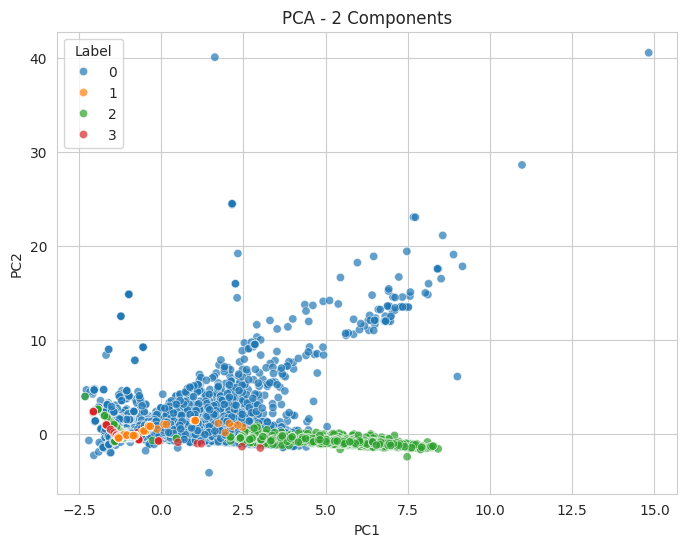

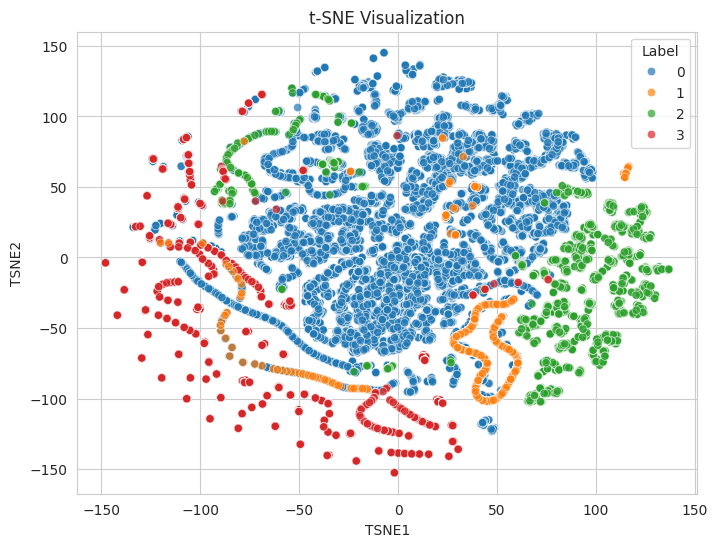

In [44]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler


features = df.drop(columns=['Label', 'Destination Port'], errors='ignore')
labels = df['Label']


scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

#  PCA visualization (2 components)
pca = PCA(n_components=2)
pca_result = pca.fit_transform(features_scaled)
pca_df = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])
pca_df['Label'] = labels.values

plt.figure(figsize=(8, 6))
sns.scatterplot(x='PC1', y='PC2', hue='Label', data=pca_df, palette='tab10', alpha=0.7)
plt.title("PCA - 2 Components")
plt.show()

#  t-SNE (2 components)
tsne = TSNE(n_components=2, random_state=42, perplexity=30, max_iter=1000)
tsne_result = tsne.fit_transform(features_scaled)
tsne_df = pd.DataFrame(data=tsne_result, columns=['TSNE1', 'TSNE2'])
tsne_df['Label'] = labels.values

plt.figure(figsize=(8, 6))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='Label', data=tsne_df, palette='tab10', alpha=0.7)
plt.title("t-SNE Visualization")
plt.show()


# DataLoader ( SS )



In [86]:
X_train_tensor = torch.tensor(X_train_scaled.values, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.long)
X_val_tensor = torch.tensor(X_val_scaled.values, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val.values, dtype=torch.long)
X_test_tensor = torch.tensor(X_test_scaled.values, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.long)

train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
val_dataset = TensorDataset(X_val_tensor, y_val_tensor)
test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

In [ ]:
#X_train_tensor_SS = torch.tensor(X_train_SS, dtype=torch.float32)
#y_train_tensor_SS = torch.tensor(y_train, dtype=torch.long)
#X_val_tensor_SS = torch.tensor(X_val_SS, dtype=torch.float32)
#y_val_tensor_SS = torch.tensor(y_val.values, dtype=torch.long)
#X_test_tensor_SS = torch.tensor(X_test_SS, dtype=torch.float32)
#y_test_tensor_SS = torch.tensor(y_test.values, dtype=torch.long)

#train_dataset_SS = TensorDataset(X_train_tensor_SS, y_train_tensor_SS)
#val_dataset_SS = TensorDataset(X_val_tensor_SS, y_val_tensor_SS)
#test_dataset_SS = TensorDataset(X_test_tensor_SS, y_test_tensor_SS)

#train_loader_SS = DataLoader(train_dataset_SS, batch_size=64, shuffle=True)
#val_loader_SS = DataLoader(val_dataset_SS, batch_size=64, shuffle=False)
#test_loader_SS = DataLoader(test_dataset_SS, batch_size=64, shuffle=False)

# Task 2: Shallow Neural Network  ( Log + Robust)

### Hyperparameter


 Layers 1

 Neurons per Layer   {32, 64, 128}

 Activation Linear

 Weight Initialization Default

 Batch Size 64

 Loss Function  Cross-Entropy

 Optimizer  AdamW

 Learning Rate  0.0005

 Epochs & Early Stopping 100 or shorter based on the designed criteria

 Regularization None

In [ ]:
# Shallow NN

class SimpleNN(nn.Module):
    def __init__(self, input_size=14, hidden_size=32, output_size=4):
        super(SimpleNN, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)  # Hidden layer
        self.fc2 = nn.Linear(hidden_size, output_size)  # Output layer

    def forward(self, x):
        x = self.fc1(x)  # Linear activation
        x = self.fc2(x)  # Linear output
        return x

In [87]:
# setting the device to cuda for the GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#device = "cpu"
print(f"The device is set to: {device}")

The device is set to: cuda


In [88]:
def training_loop(model, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion):
    """
    Train the model for a specified number of epochs and track the training and validation losses.

    Args:
        model: The neural network model to be trained.
        train_loader: DataLoader for the training dataset.
        val_loader: DataLoader for the validation dataset.
        train_dataset: The entire training dataset.
        val_dataset: The entire validation dataset.
        device: Device to run the model on (CPU or GPU).
        optimizer: The optimization algorithm to use for updating model parameters.
        criterion: The loss function to use for computing the loss.

    Returns:
        None: The function plots the training and validation loss over the epochs.
    """
    # Move the model to the correct device before training
    model.to(device)  # Add this line to move the model to the device

    # Record the start time
    start_time = time.time()

    # Define training parameters
    # we set patience to 30
    num_epochs = 100
    patience = 30
    patience_counter = 0
    best_loss = -1

    train_losses = []
    val_losses = []

    # Training loop
    for epoch in range(num_epochs):  # Train for epochs
        train_loss = 0
        val_loss = 0
        model.train()  # Set model to training mode
        for batch_X, batch_y in train_loader:
            batch_X, batch_y = batch_X.to(device), batch_y.to(device)  # Move batch to GPU
            optimizer.zero_grad()  # Clear previous gradients
            outputs = model(batch_X)  # Forward pass
            loss = criterion(outputs, batch_y)  # Compute loss
            loss.backward()  # Backpropagation
            optimizer.step()  # Update model parameters
            train_loss += loss.item() * batch_X.size(0)
        train_loss /= len(train_dataset)
        train_losses.append(train_loss)  # Store training loss

        # Compute Validation loss during training
        model.eval()  # Set model to evaluation mode
        with torch.no_grad():  # Disable gradient computation for validation
            for batch_X, batch_y in val_loader:
                batch_X, batch_y = batch_X.to(device), batch_y.to(device)  # Move batch to GPU
                val_outputs = model(batch_X)  # Forward pass
                loss = criterion(val_outputs, batch_y)  # Compute validation loss
                val_loss += loss.item() * batch_X.size(0)
            val_loss /= len(val_dataset)
            val_losses.append(val_loss)  # Store validation loss
            # Early stopping condition
        if val_loss <= best_loss:
            best_loss = val_loss
            patience_counter = 0
        else:
            patience_counter += 1
        if patience_counter >= patience:
            print(f"Early stopping triggered at epoch number {epoch} ")
            break

        if (epoch + 1) % 20 == 0:
            print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {train_losses[-1]:.4f}, Val Loss: {val_losses[-1]:.4f}')


    # Record the end time
    end_time = time.time()
    # Calculate the elapsed time
    elapsed_time = end_time - start_time
    print(f'The function took {elapsed_time:.4f} seconds to execute.')

    # Plot the training and validation loss
    plt.figure(figsize=(10, 5))
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss')
    plt.legend()
    plt.show()



In [89]:
def plot_confusion_matrix(y_true, y_pred, class_names):
    """
    Creates and displays a confusion matrix to evaluate classification performance.

    Args:
        y_true: Ground truth labels
        y_pred: Predicted labels
        class_names: List of class names for axis labels
    """
    cm = confusion_matrix(y_true, y_pred)  # Compute confusion matrix

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)

    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.title("Confusion Matrix")
    plt.show()
import torch
import time
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report

def testing_model(model, dataloader, device):
    """
    Evaluate the model on a given dataloader and compute accuracy, precision, recall, and F1-score.

    Args:
        model: The trained model.
        dataloader: DataLoader for the dataset.
        device: Device to run the model on (CPU or GPU).

    Returns:
        dict: Dictionary containing accuracy, precision, recall, and F1-score.
    """
    # Record the start time
    start_time = time.time()

    model.eval()  # Set the model to evaluation mode
    all_labels = []
    all_predictions = []

    with torch.no_grad():  # Disable gradient computation for efficiency
        for inputs, labels in dataloader:
            inputs, labels = inputs.to(device), labels.to(device)  # Move batch to GPU
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)  # Get the class with highest score
            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predicted.cpu().numpy())

    # Compute metrics
    accuracy = accuracy_score(all_labels, all_predictions) * 100
    precision = precision_score(all_labels, all_predictions, average=None, zero_division=0)
    recall = recall_score(all_labels, all_predictions, average=None, zero_division=0)
    f1 = f1_score(all_labels, all_predictions, average=None, zero_division=0)

    # Generate classification report
    class_names = [f"Class {cls}" for cls in np.unique(all_labels)]
    print("\nClassification Report:")
    print(classification_report(all_labels, all_predictions, target_names=class_names, zero_division=0))

    # Generation of confusion matrix
    plot_confusion_matrix(all_labels, all_predictions, class_names)

    # Record the end time
    end_time = time.time()
    elapsed_time = end_time - start_time
    print(f'The function took {elapsed_time:.4f} seconds to execute.')

    # Return results as a dictionary
    return {
        "accuracy": accuracy,
        "precision": precision.tolist(),
        "recall": recall.tolist(),
        "f1_score": f1.tolist()
    }


### h:32

In [ ]:
# model with a hidden size of 32 nodes
n_input_nodes = 14
criterion = nn.CrossEntropyLoss()
model32 = SimpleNN(n_input_nodes,32)
optimizer = optim.AdamW(model32.parameters(), lr=0.0005)
print(model32)
print(criterion)
print(optimizer)

SimpleNN(
  (fc1): Linear(in_features=14, out_features=32, bias=True)
  (fc2): Linear(in_features=32, out_features=4, bias=True)
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)


Epoch 20/100, Train Loss: 0.3317, Val Loss: 0.3372
Early stopping triggered at epoch number 29 
The function took 17.7546 seconds to execute.


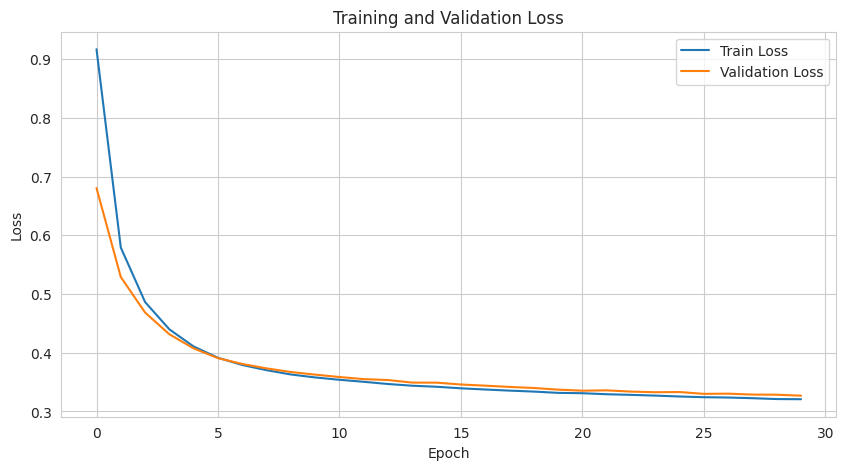

In [ ]:
training_loop(model32, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.93      0.94      0.94     11544
     Class 1       0.83      0.65      0.73       856
     Class 2       0.98      0.86      0.91      2321
     Class 3       0.81      0.91      0.86      2909

    accuracy                           0.91     17630
   macro avg       0.89      0.84      0.86     17630
weighted avg       0.91      0.91      0.91     17630



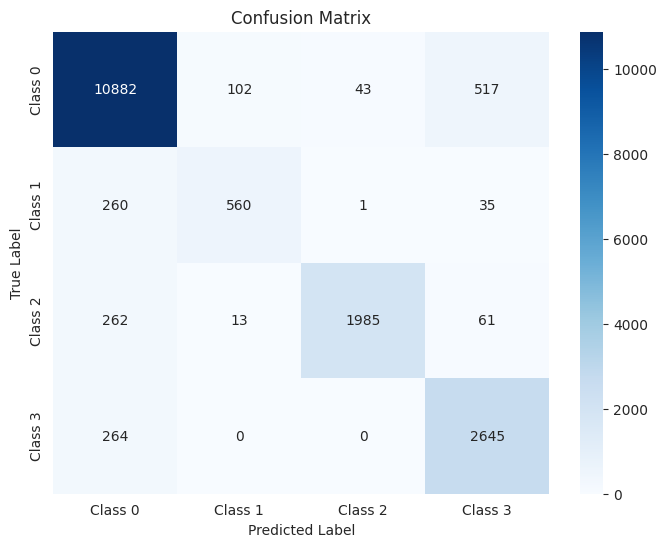

The function took 0.7791 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.93      0.94      0.93      3848
     Class 1       0.77      0.65      0.70       285
     Class 2       0.98      0.83      0.90       774
     Class 3       0.81      0.91      0.86       970

    accuracy                           0.91      5877
   macro avg       0.87      0.83      0.85      5877
weighted avg       0.91      0.91      0.91      5877



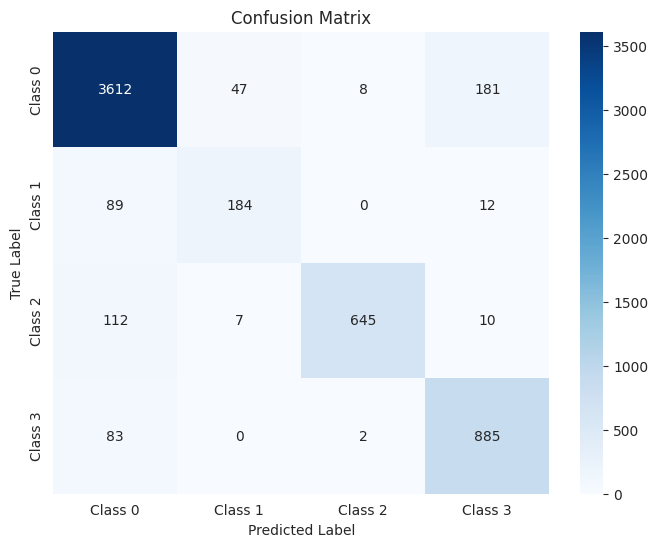

The function took 0.2987 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.93      0.94      0.94      3848
     Class 1       0.82      0.65      0.72       286
     Class 2       0.97      0.87      0.92       773
     Class 3       0.81      0.91      0.86       970

    accuracy                           0.91      5877
   macro avg       0.88      0.84      0.86      5877
weighted avg       0.91      0.91      0.91      5877



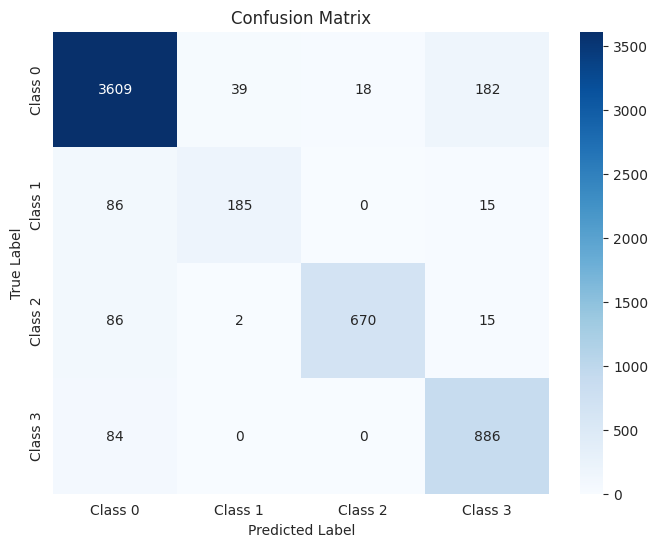

The function took 0.3050 seconds to execute.


In [ ]:
train_accuracy = testing_model(model32,train_loader,device)
val_accuracy = testing_model(model32,val_loader,device)
test_accuracy = testing_model(model32,test_loader,device)

### h: 64

SimpleNN(
  (fc1): Linear(in_features=14, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=4, bias=True)
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)
Epoch 20/100, Train Loss: 0.3234, Val Loss: 0.3253
Early stopping triggered at epoch number 29 
The function took 17.2425 seconds to execute.


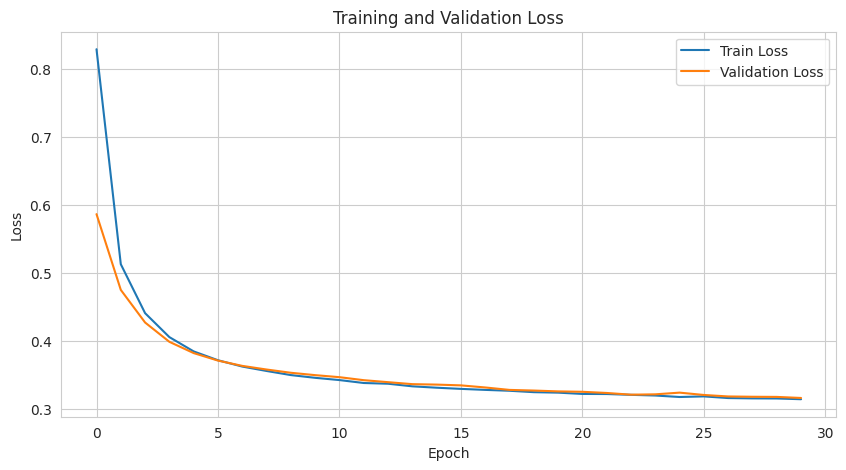

In [ ]:
n_input_nodes = 14
criterion = nn.CrossEntropyLoss()
model64 = SimpleNN(input_size=n_input_nodes,hidden_size=64)
optimizer = optim.AdamW(model64.parameters(), lr=0.0005)
print(model64)
print(criterion)
print(optimizer)

training_loop(model64, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.89      0.96      0.92     11544
     Class 1       0.00      0.00      0.00       856
     Class 2       0.98      0.86      0.92      2321
     Class 3       0.83      0.89      0.86      2909

    accuracy                           0.89     17630
   macro avg       0.67      0.68      0.67     17630
weighted avg       0.85      0.89      0.86     17630



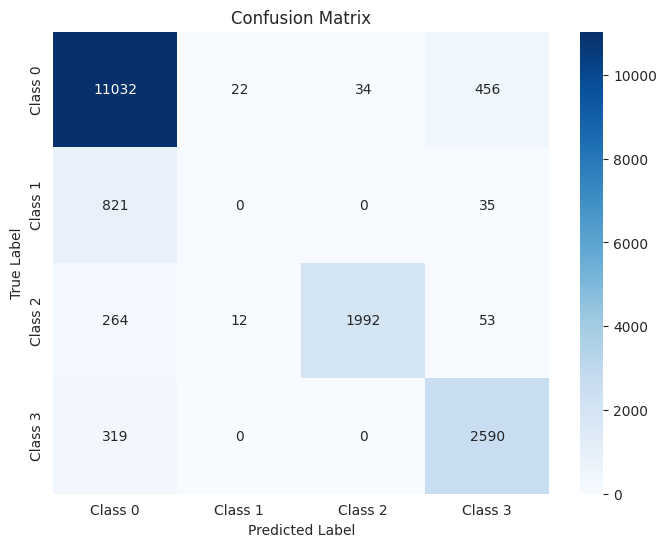

The function took 0.5171 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.88      0.96      0.92      3848
     Class 1       0.00      0.00      0.00       285
     Class 2       0.99      0.84      0.91       774
     Class 3       0.83      0.90      0.86       970

    accuracy                           0.88      5877
   macro avg       0.68      0.67      0.67      5877
weighted avg       0.85      0.88      0.86      5877



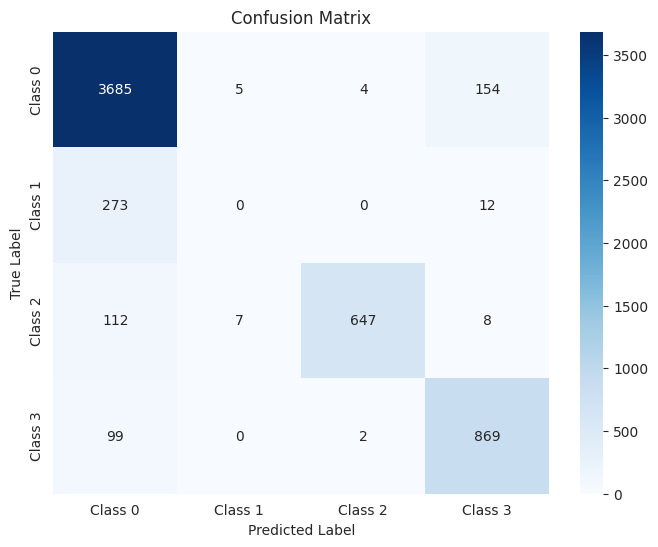

The function took 0.2998 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.89      0.95      0.92      3848
     Class 1       0.00      0.00      0.00       286
     Class 2       0.98      0.87      0.92       773
     Class 3       0.82      0.89      0.85       970

    accuracy                           0.89      5877
   macro avg       0.67      0.68      0.67      5877
weighted avg       0.85      0.89      0.86      5877



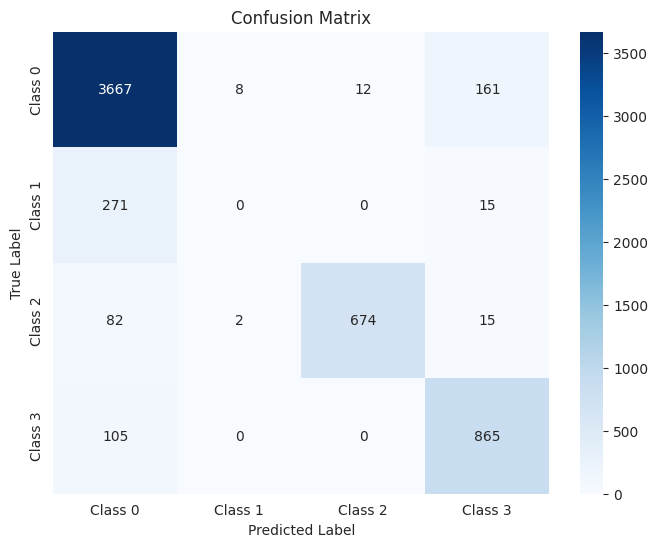

The function took 0.6550 seconds to execute.


In [ ]:
train_accuracy = testing_model(model64,train_loader,device)
val_accuracy = testing_model(model64,val_loader,device)
test_accuracy = testing_model(model64,test_loader,device)

### h: 128

SimpleNN(
  (fc1): Linear(in_features=14, out_features=128, bias=True)
  (fc2): Linear(in_features=128, out_features=4, bias=True)
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)
Epoch 20/100, Train Loss: 0.3175, Val Loss: 0.3210
Early stopping triggered at epoch number 29 
The function took 17.7467 seconds to execute.


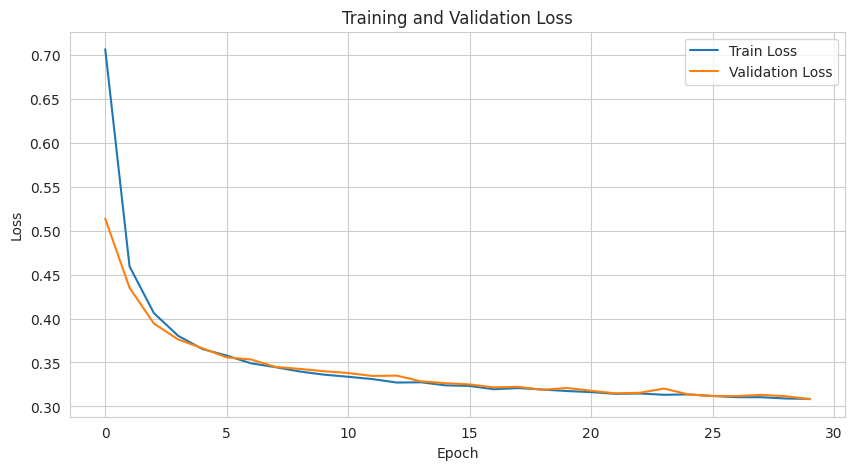

In [ ]:
n_input_nodes = 14
criterion = nn.CrossEntropyLoss()
model_128 = SimpleNN(input_size=n_input_nodes,hidden_size=128)
optimizer = optim.AdamW(model_128.parameters(), lr=0.0005)
print(model_128)
print(criterion)
print(optimizer)

training_loop(model_128, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.89      0.96      0.92     11544
     Class 1       0.00      0.00      0.00       856
     Class 2       0.99      0.86      0.92      2321
     Class 3       0.82      0.89      0.86      2909

    accuracy                           0.89     17630
   macro avg       0.68      0.68      0.67     17630
weighted avg       0.85      0.89      0.87     17630



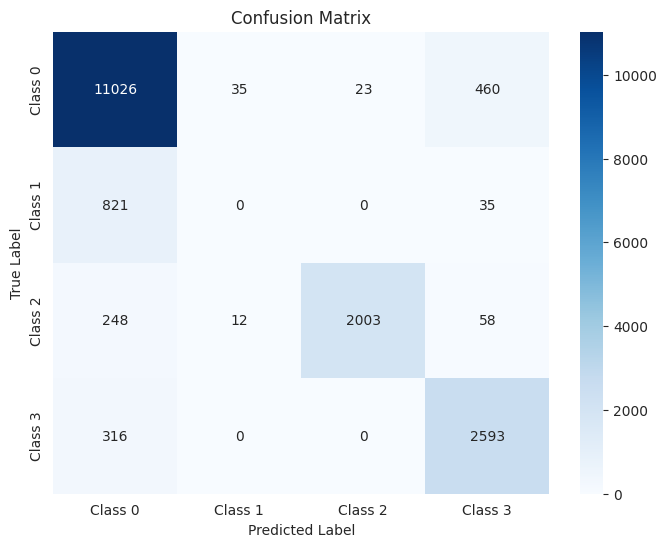

The function took 0.8446 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.89      0.96      0.92      3848
     Class 1       0.00      0.00      0.00       285
     Class 2       0.99      0.84      0.91       774
     Class 3       0.83      0.90      0.86       970

    accuracy                           0.89      5877
   macro avg       0.68      0.67      0.67      5877
weighted avg       0.85      0.89      0.86      5877



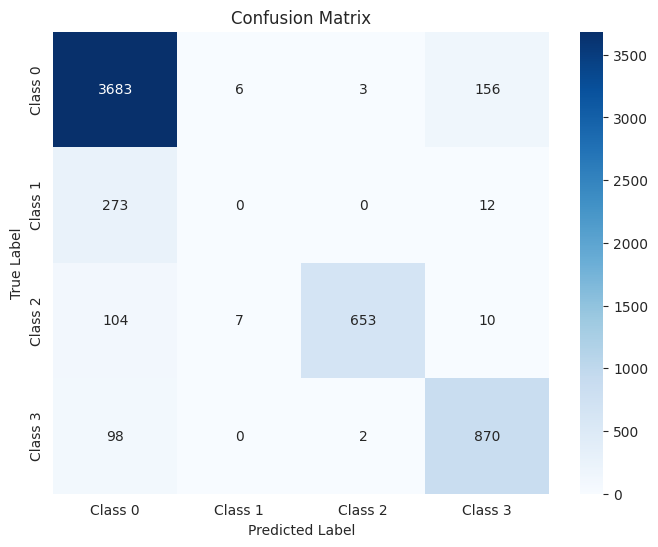

The function took 0.4465 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.89      0.95      0.92      3848
     Class 1       0.00      0.00      0.00       286
     Class 2       0.98      0.87      0.92       773
     Class 3       0.82      0.89      0.86       970

    accuracy                           0.89      5877
   macro avg       0.67      0.68      0.67      5877
weighted avg       0.85      0.89      0.87      5877



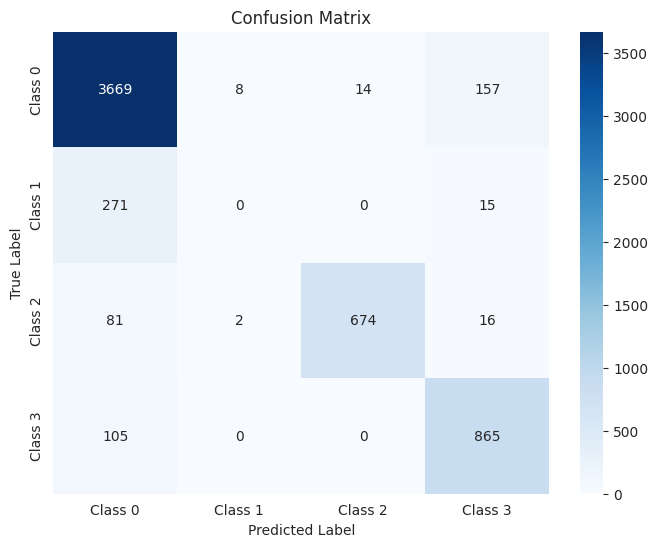

The function took 0.4665 seconds to execute.


In [ ]:
train_accuracy = testing_model(model_128,train_loader,device)
val_accuracy = testing_model(model_128,val_loader,device)
test_accuracy = testing_model(model_128,test_loader,device)

### ReLu activation

In [90]:
class SimpleNN_ReLU(nn.Module):
    def __init__(self, input_size=14, hidden_size=32, output_size=4):
        super(SimpleNN_ReLU, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)  # Hidden layer
        self.fc2 = nn.Linear(hidden_size, output_size)  # Output layer
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.fc2(x)
        return x

In [91]:
relu_nn = SimpleNN_ReLU(input_size=14,hidden_size=64)
optimizer = optim.AdamW(relu_nn.parameters(), lr=0.0005)
criterion = nn.CrossEntropyLoss()
print(relu_nn)
print(criterion)
print(optimizer)

SimpleNN_ReLU(
  (fc1): Linear(in_features=14, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=4, bias=True)
  (relu): ReLU()
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)


Epoch 20/100, Train Loss: 0.1629, Val Loss: 0.1834
Early stopping triggered at epoch number 29 
The function took 16.8850 seconds to execute.


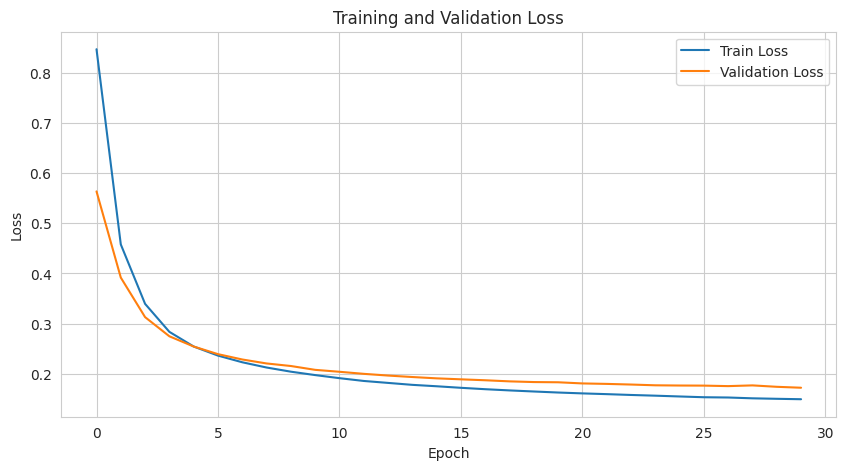

In [92]:
training_loop(relu_nn, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.97      0.96     11544
     Class 1       0.80      0.89      0.84       856
     Class 2       1.00      0.87      0.93      2321
     Class 3       0.94      0.92      0.93      2909

    accuracy                           0.95     17630
   macro avg       0.92      0.92      0.92     17630
weighted avg       0.95      0.95      0.95     17630



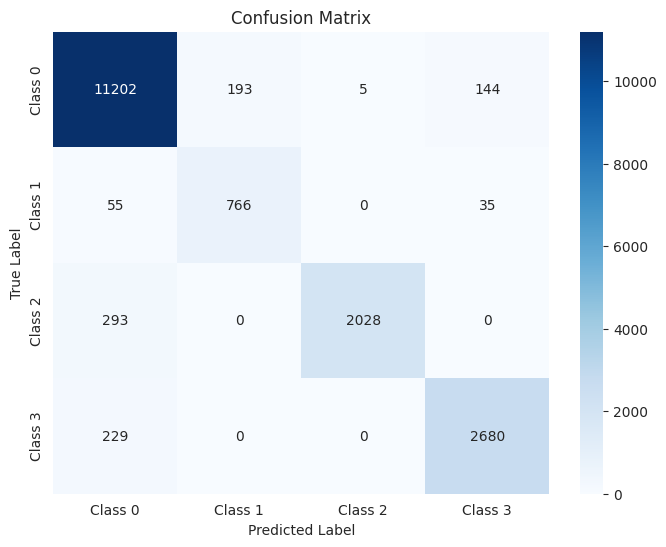

The function took 0.7446 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.97      0.96      3848
     Class 1       0.77      0.91      0.83       285
     Class 2       0.99      0.85      0.92       774
     Class 3       0.93      0.92      0.93       970

    accuracy                           0.94      5877
   macro avg       0.91      0.91      0.91      5877
weighted avg       0.94      0.94      0.94      5877



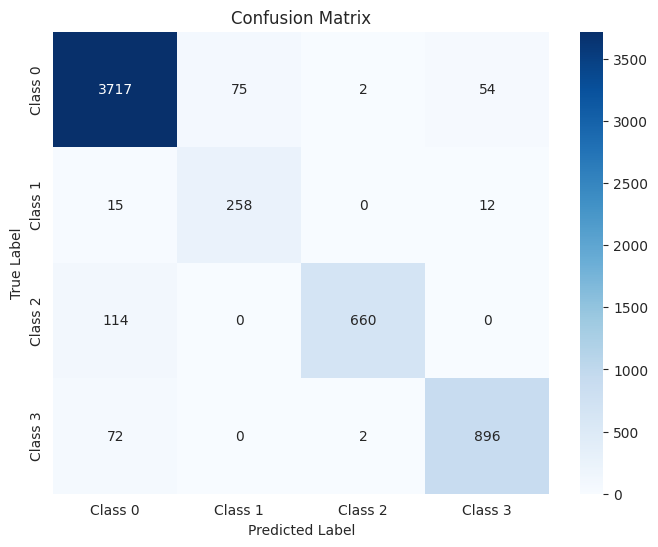

The function took 0.2843 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.97      0.96      3848
     Class 1       0.78      0.89      0.83       286
     Class 2       1.00      0.88      0.94       773
     Class 3       0.93      0.92      0.93       970

    accuracy                           0.95      5877
   macro avg       0.92      0.92      0.91      5877
weighted avg       0.95      0.95      0.95      5877



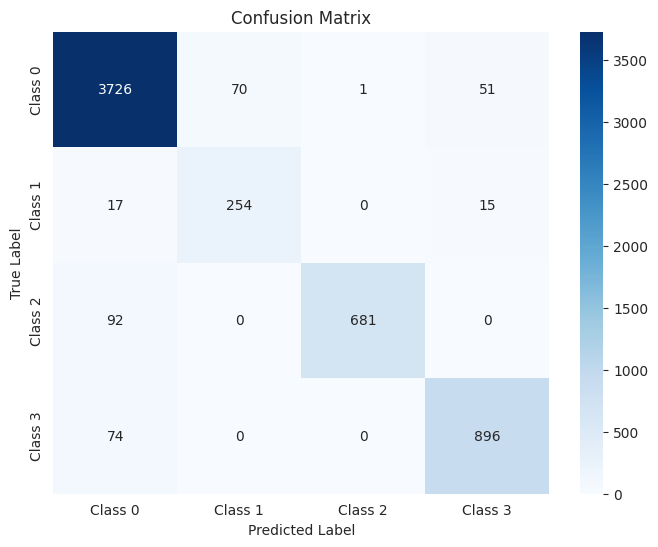

The function took 0.2754 seconds to execute.


In [93]:
train_accuracy = testing_model(relu_nn,train_loader,device)
val_accuracy = testing_model(relu_nn,val_loader,device)
test_accuracy = testing_model(relu_nn,test_loader,device)

# Task 3 : Impact of specific features

In [94]:
# here we take the test test, we replace port 80 with port 8080 (so we don't have to encode the port)
# i am reloading the dataset but without retraining the model
X_test_8080 = X_test.copy()
X_test_8080 = X_test_8080.assign(Label=y_test.values)  # Append y_test as a column named 'Label'

# Replaced port 80 with 8080 where Label is 1
X_test_8080.loc[(X_test_8080['Label'] == 1) & (X_test_8080['Destination Port'] == 80), 'Destination Port'] = 8080

X_test_8080 = X_test_8080.drop(columns=['Label'])

# 3. Preprocessing the test set
X_test_8080.drop_duplicates(inplace=True)
# For the test set, we applied the same log transform and the same scaler fitted on the training set




X_test_scaled = scaler.transform(X_test_8080)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test_8080.columns, index=X_test_8080.index)


X_test_tensor = torch.tensor(X_test_scaled.values, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.long)

test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.90      0.97      0.93      3848
     Class 1       0.20      0.06      0.09       286
     Class 2       1.00      0.88      0.94       773
     Class 3       0.93      0.92      0.93       970

    accuracy                           0.91      5877
   macro avg       0.76      0.71      0.72      5877
weighted avg       0.88      0.91      0.89      5877



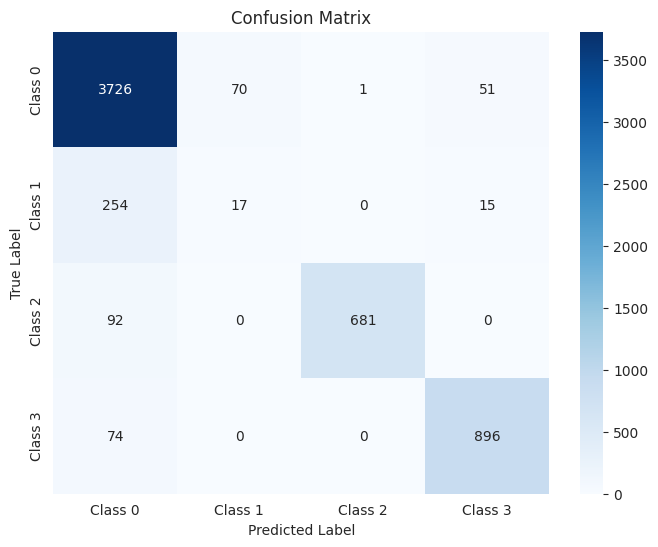

The function took 0.2859 seconds to execute.


In [95]:
test_accuracy = testing_model(relu_nn,test_loader,device)

### Dest-port dropping

In [ ]:

downloaded.GetContentFile('data_set_lab_1.csv')  # Download to a local file
df = pd.read_csv('data_set_lab_1.csv')


# label encoding
label_encoder = LabelEncoder()
df['Label'] = label_encoder.fit_transform(df['Label'])

label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))


print(label_mapping)


# {'Benign': np.int64(0), 'Brute Force': np.int64(1), 'DoS Hulk': np.int64(2), 'PortScan': np.int64(3)}

# pre processing
# We can decide what to do, since there are not many rows that have inf as value we can simply decide to drop them (even if they are form a class that is not really present in the dataset)
df.replace([np.inf, -np.inf], np.nan, inplace=True)
df.dropna(inplace=True)

# Convert relevant columns to numeric before comparison
for column in df.select_dtypes(include=['object']).columns:
    if column not in ['Label']:
        try:
            df[column] = pd.to_numeric(df[column])
        except ValueError:
            print(f"Could not convert column '{column}' to numeric.")

#remove of negative numbers
df = df[(df >= 0).all(axis=1)]

# Reset the index if needed
df = df.reset_index(drop=True)



# remove the biased feature
df = df.drop(columns=['Destination Port'])



cols_to_drop = [
    'Fwd PSH Flags',
    'Subflow Fwd Packets'

]

df = df.drop(columns=cols_to_drop)

df.drop_duplicates(inplace=True)





import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import FunctionTransformer, RobustScaler
import matplotlib.pyplot as plt
import seaborn as sns


X = df.drop(columns=['Label'])
y = df['Label']

# 1. Split the dataset into training (60%), validation (20%), and test (20%) sets

X_temp, X_test, y_temp, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)
X_train, X_val, y_train, y_val = train_test_split(
    X_temp, y_temp, test_size=0.2, random_state=42, stratify=y_temp
)




scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)


X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns, index=X_train.index)
X_val_scaled = pd.DataFrame(X_val_scaled, columns=X_val.columns, index=X_val.index)


X_test_scaled= scaler.transform(X_test)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns, index=X_test.index)

# This methodology ensures that the FFNN model is trained and validated on pre-processed data in a consistent manner
# and without information leakage from the test or validation sets.

X_train_tensor = torch.tensor(X_train_scaled.values, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.long)
X_val_tensor = torch.tensor(X_val_scaled.values, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val.values, dtype=torch.long)
X_test_tensor = torch.tensor(X_test_scaled.values, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.long)

train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
val_dataset = TensorDataset(X_val_tensor, y_val_tensor)
test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)



{'Benign': np.int64(0), 'Brute Force': np.int64(1), 'DoS Hulk': np.int64(2), 'PortScan': np.int64(3)}


In [ ]:
relu13f_nn = SimpleNN_ReLU(input_size=13,hidden_size=64)
optimizer = optim.AdamW(relu13f_nn.parameters(), lr=0.0005)
criterion = nn.CrossEntropyLoss()
print(relu13f_nn)
print(criterion)
print(optimizer)

SimpleNN_ReLU(
  (fc1): Linear(in_features=13, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=4, bias=True)
  (relu): ReLU()
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)


Epoch 20/100, Train Loss: 0.1659, Val Loss: 0.1646
Early stopping triggered at epoch number 29 
The function took 14.5526 seconds to execute.


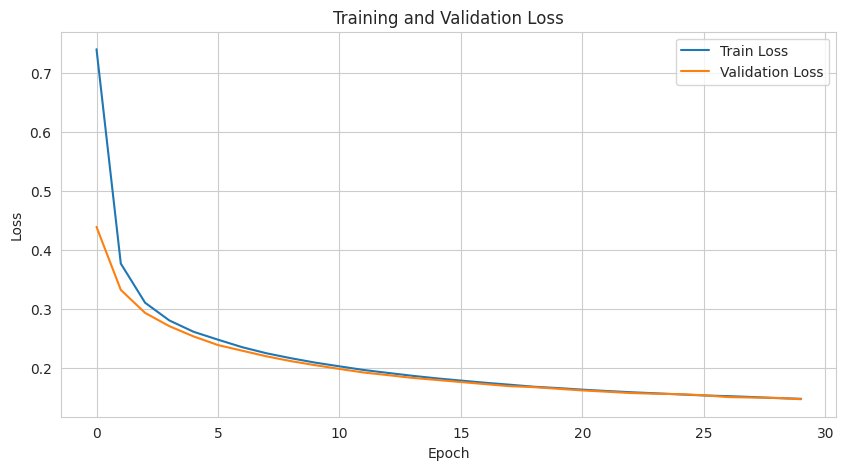

In [ ]:
training_loop(relu13f_nn, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.98      0.96      3378
     Class 1       0.79      0.89      0.84       285
     Class 2       0.99      0.85      0.91       774
     Class 3       0.57      0.07      0.12        57

    accuracy                           0.94      4494
   macro avg       0.82      0.70      0.71      4494
weighted avg       0.94      0.94      0.93      4494



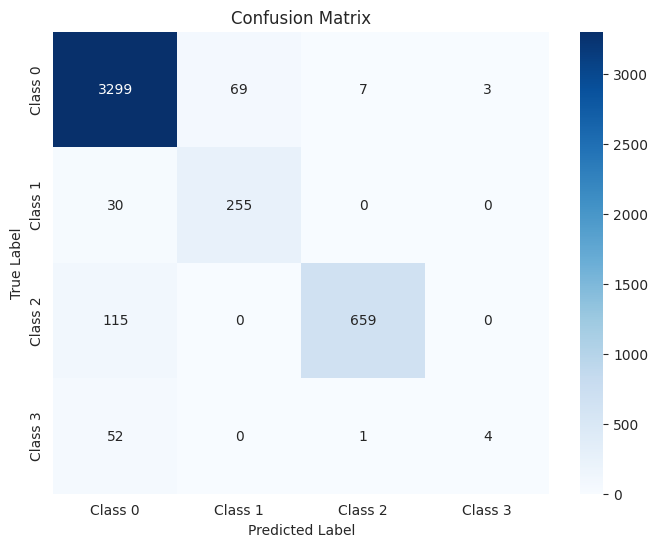

The function took 0.2766 seconds to execute.


In [ ]:
test_accuracy = testing_model(relu13f_nn,test_loader,device)

In [ ]:
import numpy as np

def analyze_class_distribution(y_train, y_test, y_val):
    """
    Analyze class distribution across train, test, and validation sets

    Args:
        y_train (np.ndarray): Training labels
        y_test (np.ndarray): Test labels
        y_val (np.ndarray): Validation labels
    """
    # Function to calculate class distribution
    def get_class_distribution(labels):
        unique, counts = np.unique(labels, return_counts=True)
        total = len(labels)
        percentages = (counts / total) * 100
        return dict(zip(unique, percentages))

    # Print distributions
    print("Train Set Class Distribution:")
    train_dist = get_class_distribution(y_train)
    for cls, percentage in train_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nTest Set Class Distribution:")
    test_dist = get_class_distribution(y_test)
    for cls, percentage in test_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nValidation Set Class Distribution:")
    val_dist = get_class_distribution(y_val)
    for cls, percentage in val_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    return train_dist, test_dist, val_dist





distributions = analyze_class_distribution(y_train, y_test, y_val)
print(distributions)

Train Set Class Distribution:
Class 0: 75.17%
Class 1: 6.36%
Class 2: 17.21%
Class 3: 1.27%

Test Set Class Distribution:
Class 0: 75.17%
Class 1: 6.34%
Class 2: 17.22%
Class 3: 1.27%

Validation Set Class Distribution:
Class 0: 75.16%
Class 1: 6.34%
Class 2: 17.22%
Class 3: 1.28%
({np.int64(0): np.float64(75.16517143055846), np.int64(1): np.float64(6.356492106544266), np.int64(2): np.float64(17.21260171082829), np.int64(3): np.float64(1.2657347520689894)}, {np.int64(0): np.float64(75.16688918558077), np.int64(1): np.float64(6.341789052069426), np.int64(2): np.float64(17.222963951935917), np.int64(3): np.float64(1.268357810413885)}, {np.int64(0): np.float64(75.15994436717664), np.int64(1): np.float64(6.342141863699583), np.int64(2): np.float64(17.21835883171071), np.int64(3): np.float64(1.2795549374130737)})


### class-weight

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

# Calculate class weights
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)


# Convert to tensor and move to device
class_weights = torch.tensor(class_weights, dtype=torch.float).to(device)



relu13f_nn_cw = SimpleNN_ReLU(input_size=13,hidden_size=64)
optimizer = optim.AdamW(relu13f_nn_cw.parameters(), lr=0.0005)
# Updated criterion with weights
criterion = nn.CrossEntropyLoss(weight = class_weights)
print(relu13f_nn_cw)
print(criterion)
print(optimizer)
print(class_weights)

SimpleNN_ReLU(
  (fc1): Linear(in_features=13, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=4, bias=True)
  (relu): ReLU()
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)
tensor([ 0.3326,  3.9330,  1.4524, 19.7514], device='cuda:0')


Epoch 20/100, Train Loss: 0.2861, Val Loss: 0.2981
Early stopping triggered at epoch number 29 
The function took 14.3153 seconds to execute.


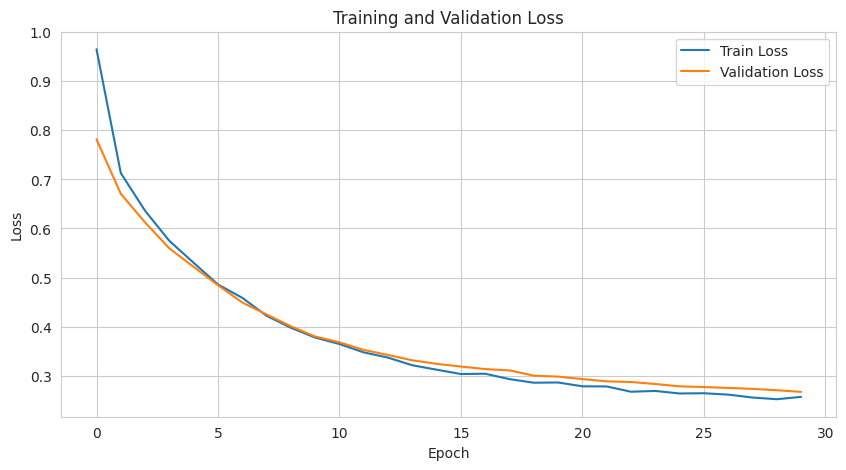

In [ ]:
training_loop(relu13f_nn_cw, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.91      0.94      3378
     Class 1       0.72      0.93      0.82       285
     Class 2       0.98      0.88      0.93       774
     Class 3       0.19      0.86      0.31        57

    accuracy                           0.91      4494
   macro avg       0.72      0.90      0.75      4494
weighted avg       0.95      0.91      0.92      4494



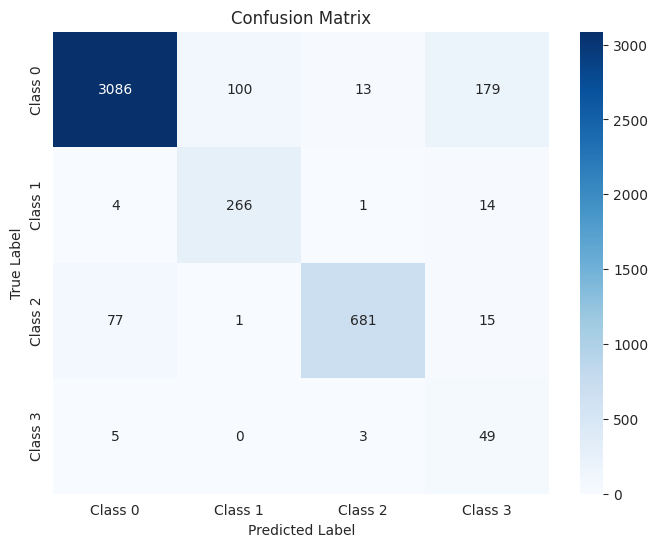

The function took 0.2823 seconds to execute.


In [ ]:
test =testing_model(relu13f_nn_cw,test_loader,device)

# Task 4: Deep NN

In [ ]:
# ---------------- reproducibility & helpers ----------------
import time, copy, itertools, torch, numpy as np
import torch.nn as nn, torch.optim as optim
from sklearn.metrics import accuracy_score, f1_score

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
torch.manual_seed(42);  np.random.seed(42)


In [ ]:
# ---------------- training_loop + live-plot --------------------------
import time, copy, matplotlib.pyplot as plt

def training_loop(model, train_loader, val_loader,
                  train_ds,   val_ds, device,
                  optimizer, criterion,
                  max_epochs=100, patience=30,
                  verbose_every=20, cfg_name="run"):
    """
      Train a PyTorch model with early-stopping and live loss plotting.

      Args:
          model (torch.nn.Module): Network to train.
          train_loader (DataLoader): Mini-batches for training.
          val_loader (DataLoader): Mini-batches for validation.
          train_ds (Dataset): Full training set (for loss normalisation).
          val_ds (Dataset): Full validation set.
          device (torch.device): CPU or GPU on which to run.
          optimizer (torch.optim.Optimizer): Parameter update rule.
          criterion (Callable): Loss function.
          max_epochs (int, optional):  Default = 100.
          patience (int, optional): Default = 30.
          verbose_every (int, optional): Print progress every N epochs; Default = 20.
          cfg_name (str, optional): Label shown in logs and plot title. Default = "run".

      Returns:
          Tuple[Dict[str, List[float]], torch.nn.Module]:
              • History of training and validation losses.
              • Model restored to the weights that achieved the best validation loss.

    """


    model = model.to(device)
    best_w      = copy.deepcopy(model.state_dict())
    best_loss   = float('inf')
    wait        = 0
    hist_tr, hist_val = [], []
    t0 = time.time()

    for epoch in range(max_epochs):
        # ---------- TRAIN ----------
        model.train()
        running = 0.0
        for xb, yb in train_loader:
            xb, yb = xb.to(device), yb.to(device)
            optimizer.zero_grad()
            loss = criterion(model(xb), yb)
            loss.backward(); optimizer.step()
            running += loss.item() * xb.size(0)
        tr_loss = running / len(train_ds)
        hist_tr.append(tr_loss)

        # ---------- VALID ----------
        model.eval(); running = 0.0
        with torch.no_grad():
            for xb, yb in val_loader:
                xb, yb = xb.to(device), yb.to(device)
                running += criterion(model(xb), yb).item() * xb.size(0)
        val_loss = running / len(val_ds)
        hist_val.append(val_loss)

        # ---------- EARLY-STOP ----------
        if val_loss < best_loss:
            best_loss = val_loss
            best_w    = copy.deepcopy(model.state_dict())
            wait      = 0
        else:
            wait += 1
            if wait >= patience:
                print(f"[{cfg_name}] early-stop @ epoch {epoch:03d}")
                break

        if verbose_every and (epoch+1) % verbose_every == 0:
            print(f"[{cfg_name}] ep {epoch+1:03d}  tr={tr_loss:.4f}  val={val_loss:.4f}")

    # restore best weights to
    model.load_state_dict(best_w)
    print(f"[{cfg_name}] done in {time.time()-t0:.1f}s  best-val={best_loss:.4f}")

    # ---------- PLOT ----------
    plt.figure(figsize=(6,3))
    plt.plot(hist_tr, label='train')
    plt.plot(hist_val,label='val')
    plt.xlabel('epoch'); plt.ylabel('loss'); plt.title(cfg_name); plt.legend()
    plt.tight_layout(); plt.show()

    return {'train': hist_tr, 'val': hist_val}, model


### Builder

In [ ]:
# ---------------- PlainFFNN builder ------------------------
class PlainFFNN(nn.Module):

    """
    Simple feed-forward neural network.

    Args:
        layer_sizes (List[int]): Number of units in each layer, e.g. [13, 32, 8, 4].

    Architecture:
        • Fully connected layers defined by `layer_sizes`
        • ReLU applied to every hidden layer
        • Last layer left linear, returning raw logits

    """
    def __init__(self, layer_sizes):
        super().__init__()
        self.fcs = nn.ModuleList(
            [nn.Linear(i, o) for i, o in zip(layer_sizes[:-1], layer_sizes[1:])]
        )
        self.act = nn.ReLU()

    def forward(self, x):
        for lyr in self.fcs[:-1]:
            x = self.act(lyr(x))
        return self.fcs[-1](x)


[ARCH#001-[32, 32]] done in 26.6s  best-val=0.2063


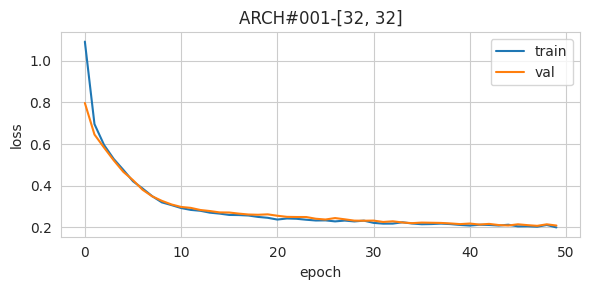


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.96     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.88      0.96      0.92      2475
     Class 3       0.37      0.88      0.53       182

    accuracy                           0.93     14379
   macro avg       0.75      0.93      0.81     14379
weighted avg       0.95      0.93      0.94     14379



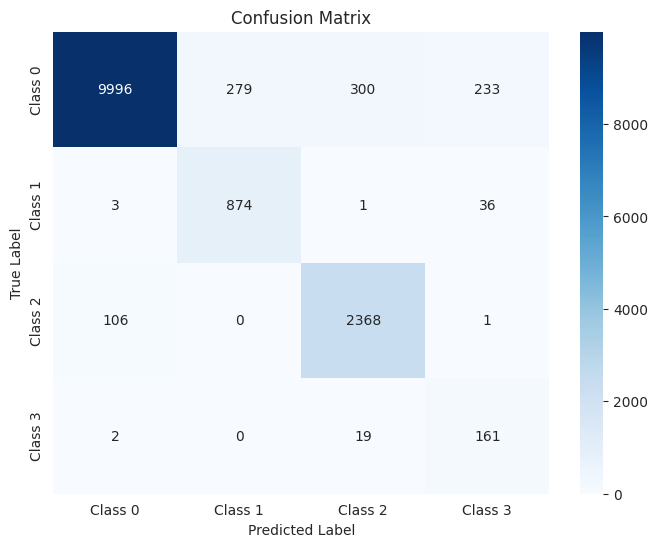

The function took 0.4685 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.76      0.93      0.84       228
     Class 2       0.87      0.97      0.91       619
     Class 3       0.35      0.87      0.50        46

    accuracy                           0.93      3595
   macro avg       0.74      0.92      0.80      3595
weighted avg       0.95      0.93      0.93      3595



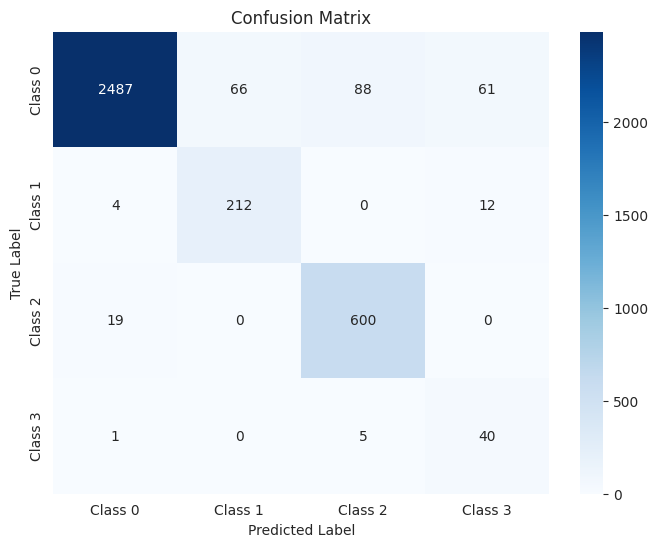

The function took 0.2529 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.89      0.94      0.91       774
     Class 3       0.37      0.88      0.52        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.81      4494
weighted avg       0.95      0.93      0.94      4494



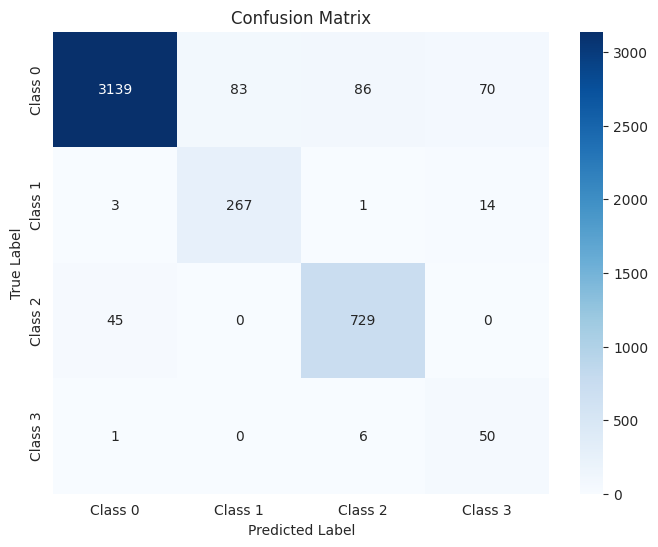

The function took 0.2838 seconds to execute.
[ARCH#002-[32, 16]] done in 26.7s  best-val=0.2292


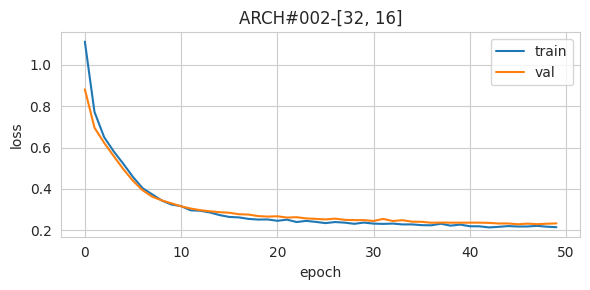


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.81      0.95      0.87      2475
     Class 3       0.32      0.88      0.46       182

    accuracy                           0.91     14379
   macro avg       0.72      0.92      0.78     14379
weighted avg       0.93      0.91      0.92     14379



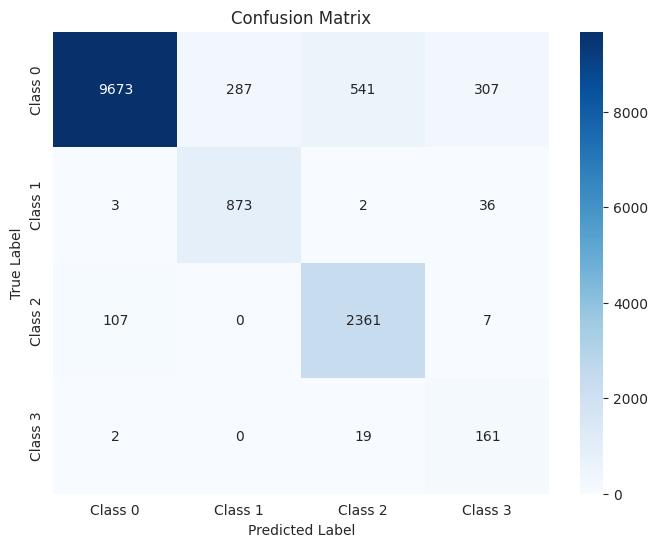

The function took 0.4762 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.81      0.97      0.88       619
     Class 3       0.31      0.89      0.46        46

    accuracy                           0.91      3595
   macro avg       0.72      0.92      0.78      3595
weighted avg       0.94      0.91      0.92      3595



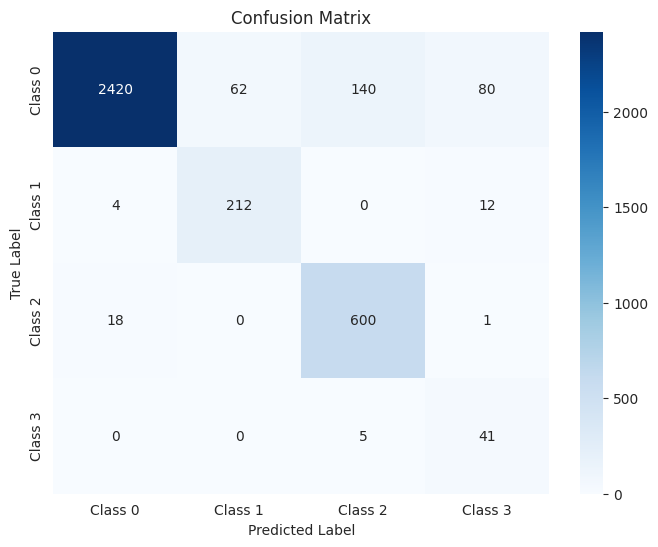

The function took 0.2711 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.90      0.94      3378
     Class 1       0.75      0.93      0.83       285
     Class 2       0.82      0.94      0.88       774
     Class 3       0.32      0.89      0.47        57

    accuracy                           0.91      4494
   macro avg       0.72      0.92      0.78      4494
weighted avg       0.93      0.91      0.92      4494



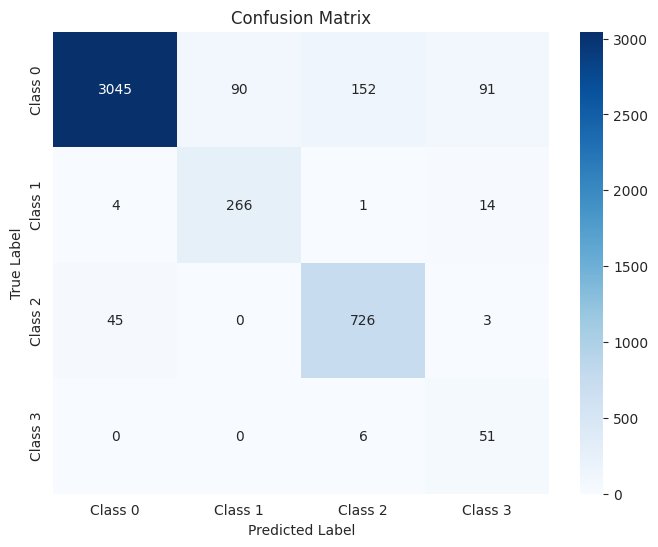

The function took 0.2763 seconds to execute.
[ARCH#003-[32, 8]] done in 26.4s  best-val=0.2200


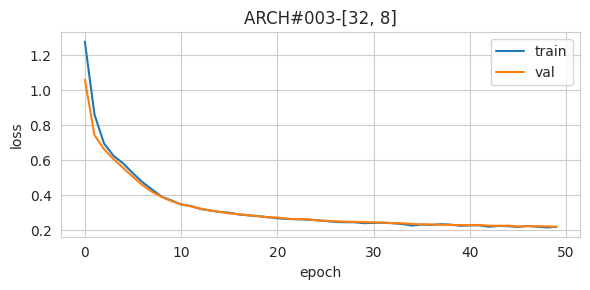


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.84      0.95      0.89      2475
     Class 3       0.28      0.88      0.42       182

    accuracy                           0.91     14379
   macro avg       0.71      0.92      0.77     14379
weighted avg       0.94      0.91      0.92     14379



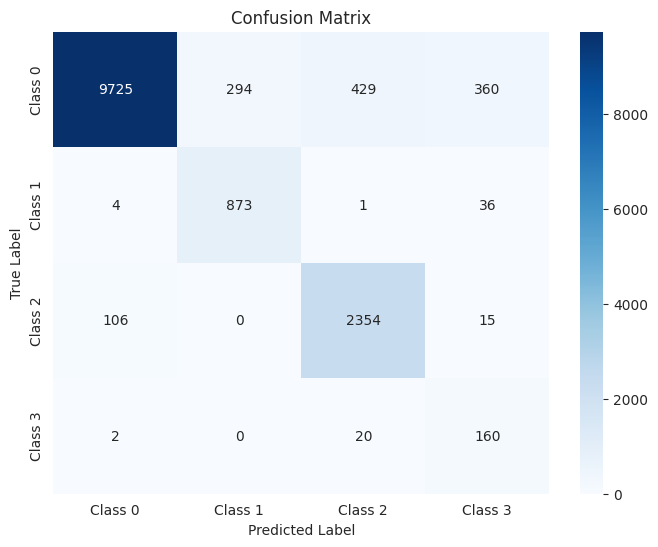

The function took 0.4657 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.84      0.97      0.90       619
     Class 3       0.26      0.89      0.41        46

    accuracy                           0.91      3595
   macro avg       0.72      0.92      0.77      3595
weighted avg       0.94      0.91      0.92      3595



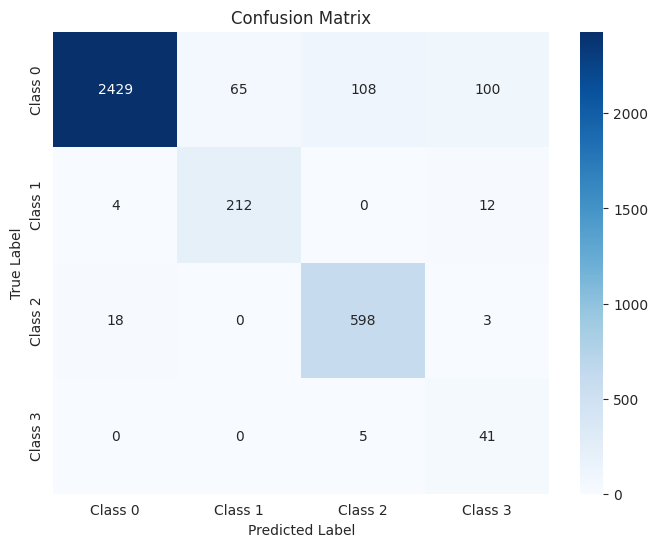

The function took 0.2446 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.75      0.94      0.84       285
     Class 2       0.84      0.94      0.89       774
     Class 3       0.31      0.88      0.46        57

    accuracy                           0.91      4494
   macro avg       0.72      0.92      0.78      4494
weighted avg       0.94      0.91      0.92      4494



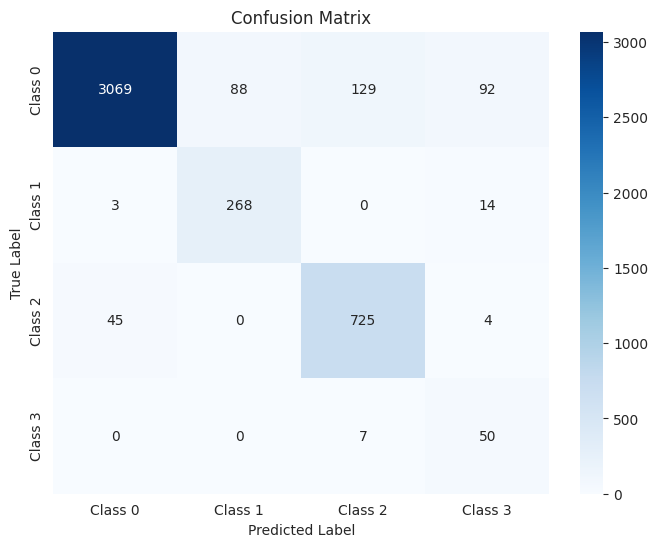

The function took 0.2838 seconds to execute.
[ARCH#004-[32, 4]] done in 26.3s  best-val=0.2585


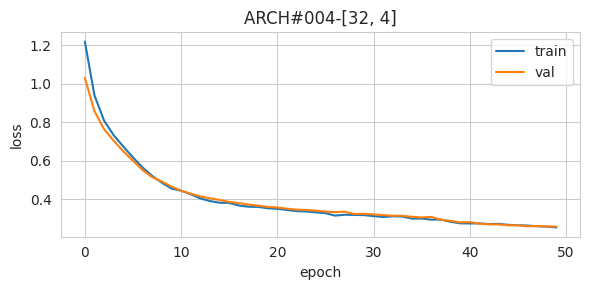


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.24      0.88      0.38       182

    accuracy                           0.92     14379
   macro avg       0.73      0.91      0.77     14379
weighted avg       0.95      0.92      0.93     14379



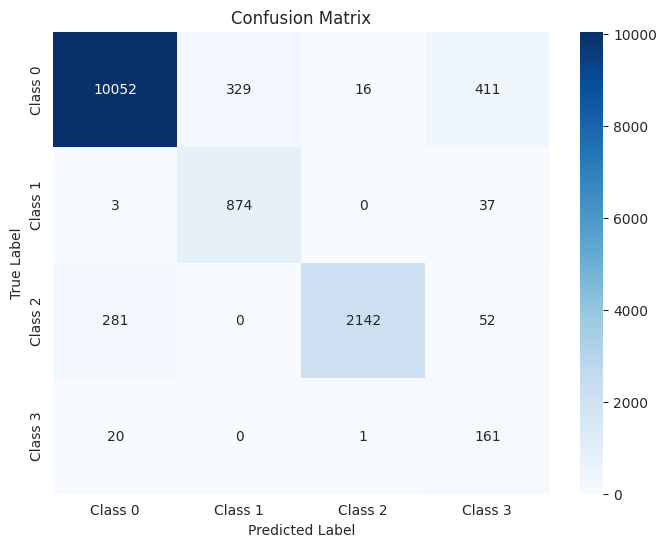

The function took 0.4632 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.22      0.89      0.36        46

    accuracy                           0.92      3595
   macro avg       0.73      0.91      0.77      3595
weighted avg       0.95      0.92      0.93      3595



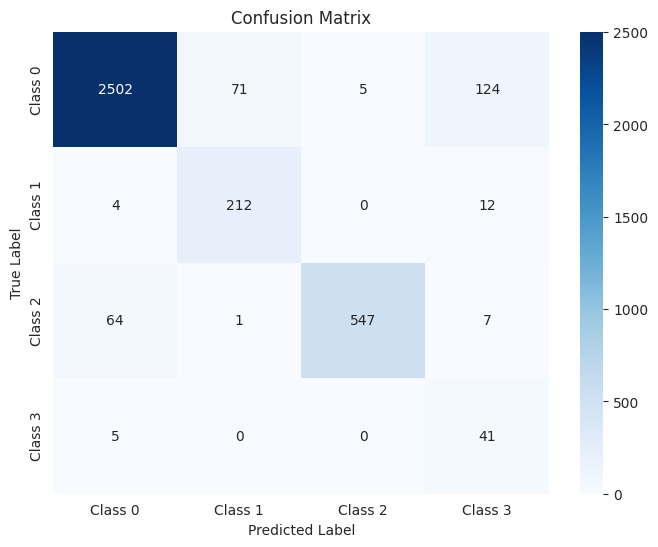

The function took 0.2816 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95      3378
     Class 1       0.73      0.94      0.82       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.27      0.86      0.41        57

    accuracy                           0.92      4494
   macro avg       0.74      0.89      0.77      4494
weighted avg       0.94      0.92      0.93      4494



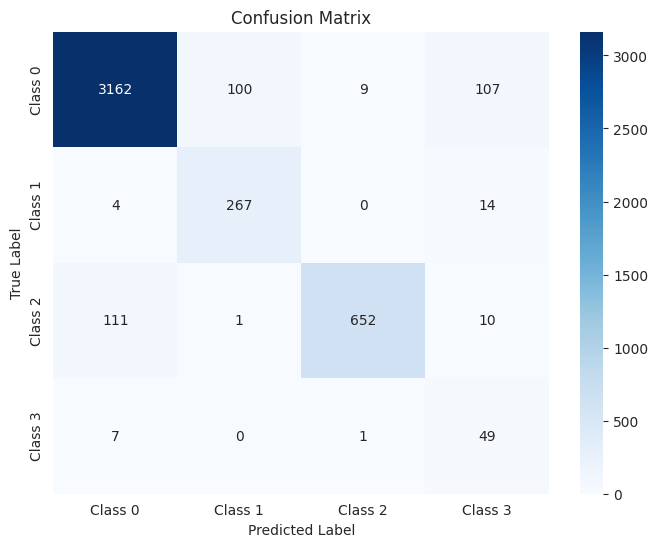

The function took 0.2921 seconds to execute.
[ARCH#005-[32, 2]] done in 26.5s  best-val=0.2989


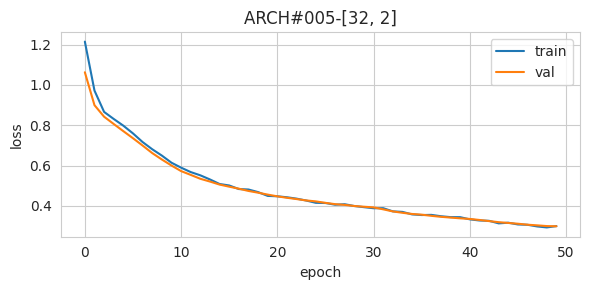


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.91      0.94     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.92      0.87      0.89      2475
     Class 3       0.23      0.88      0.36       182

    accuracy                           0.90     14379
   macro avg       0.71      0.90      0.75     14379
weighted avg       0.93      0.90      0.91     14379



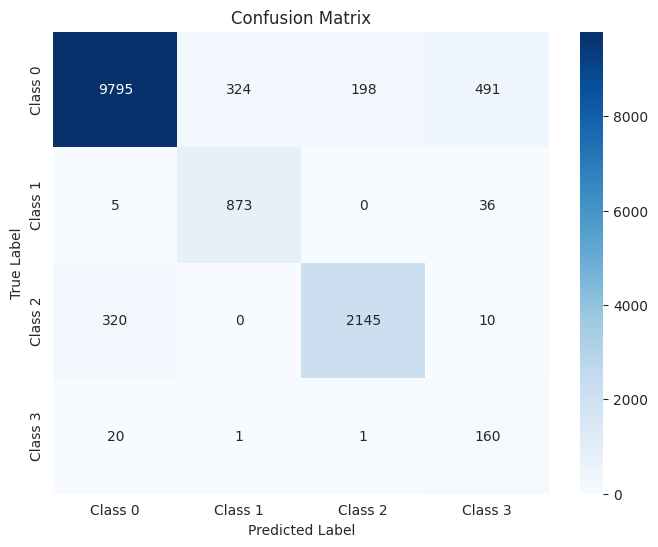

The function took 0.4694 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.91      0.94      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.91      0.89      0.90       619
     Class 3       0.22      0.89      0.35        46

    accuracy                           0.90      3595
   macro avg       0.71      0.90      0.75      3595
weighted avg       0.94      0.90      0.92      3595



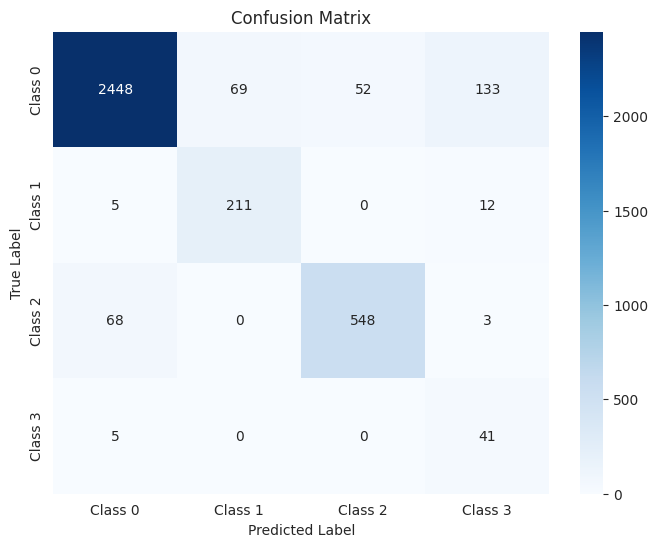

The function took 0.2613 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.90      0.93      3378
     Class 1       0.73      0.94      0.82       285
     Class 2       0.91      0.84      0.87       774
     Class 3       0.23      0.88      0.36        57

    accuracy                           0.90      4494
   macro avg       0.71      0.89      0.75      4494
weighted avg       0.93      0.90      0.91      4494



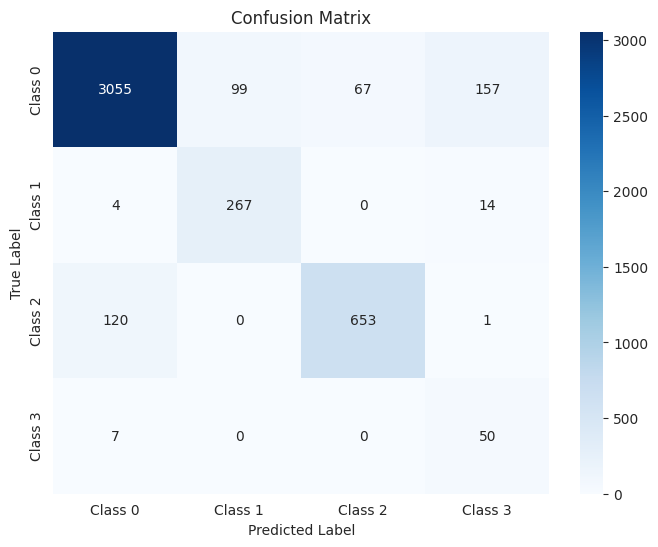

The function took 0.3059 seconds to execute.
[ARCH#006-[16, 16]] done in 26.5s  best-val=0.2373


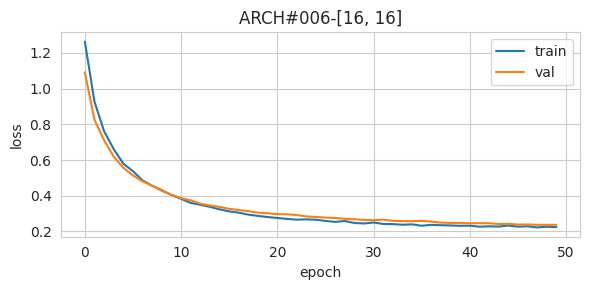


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.91      0.94      0.93      2475
     Class 3       0.22      0.88      0.35       182

    accuracy                           0.92     14379
   macro avg       0.72      0.92      0.77     14379
weighted avg       0.95      0.92      0.93     14379



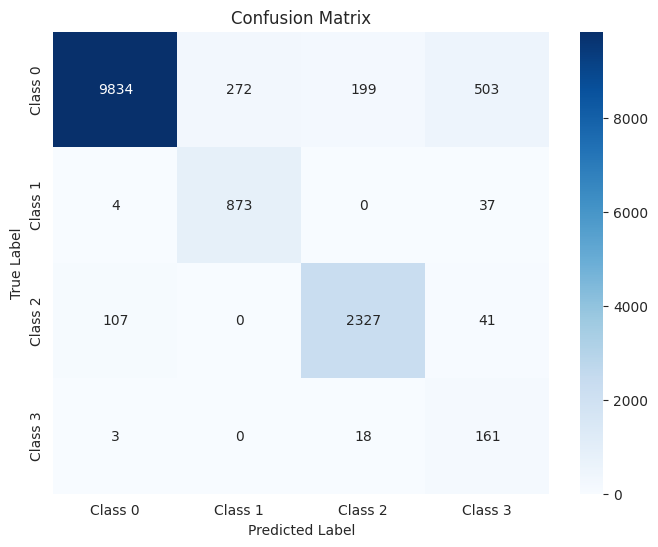

The function took 0.8219 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.90      0.96      0.93       619
     Class 3       0.20      0.87      0.33        46

    accuracy                           0.91      3595
   macro avg       0.72      0.92      0.76      3595
weighted avg       0.95      0.91      0.93      3595



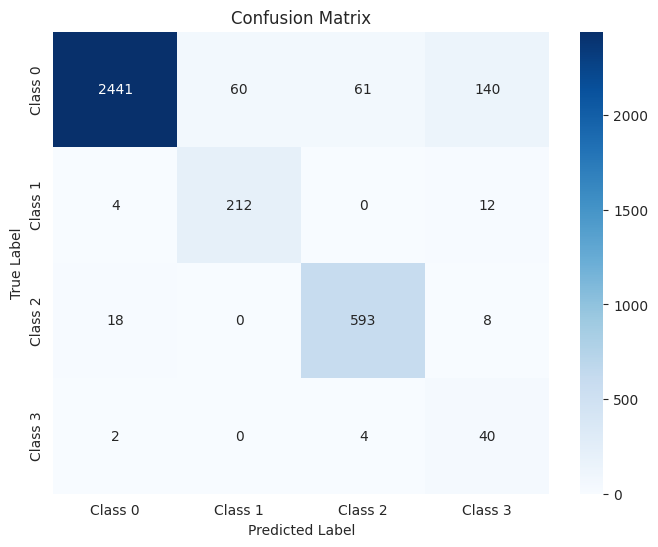

The function took 0.2510 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.91      0.93      0.92       774
     Class 3       0.23      0.88      0.36        57

    accuracy                           0.92      4494
   macro avg       0.72      0.91      0.77      4494
weighted avg       0.95      0.92      0.93      4494



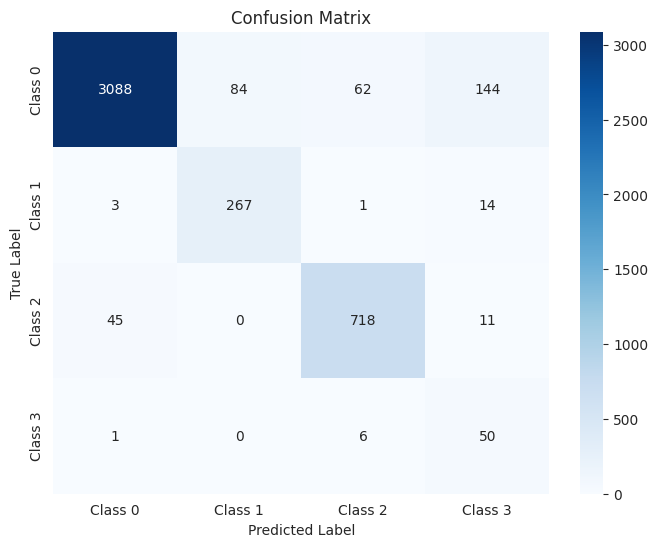

The function took 0.2814 seconds to execute.
[ARCH#007-[16, 8]] done in 26.6s  best-val=0.2576


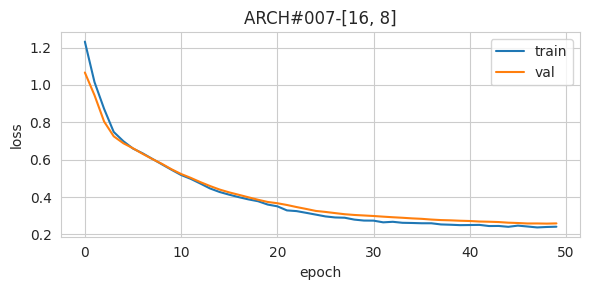


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.85      0.95      0.90      2475
     Class 3       0.33      0.88      0.48       182

    accuracy                           0.92     14379
   macro avg       0.72      0.92      0.79     14379
weighted avg       0.94      0.92      0.92     14379



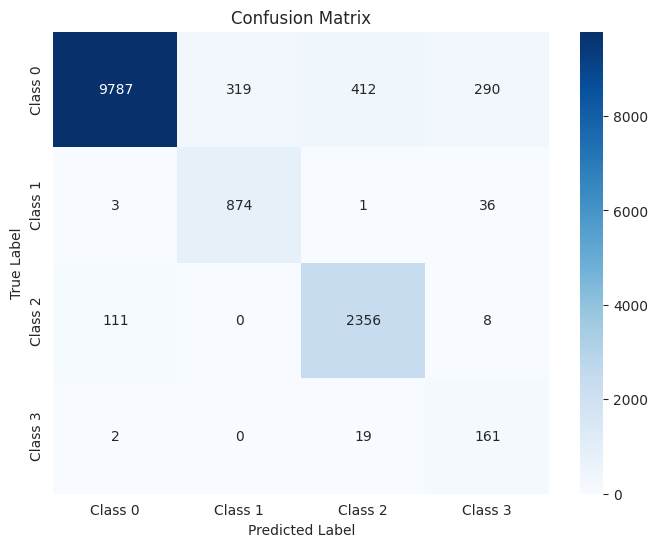

The function took 0.6297 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.83      0.97      0.89       619
     Class 3       0.30      0.87      0.45        46

    accuracy                           0.91      3595
   macro avg       0.72      0.92      0.78      3595
weighted avg       0.94      0.91      0.92      3595



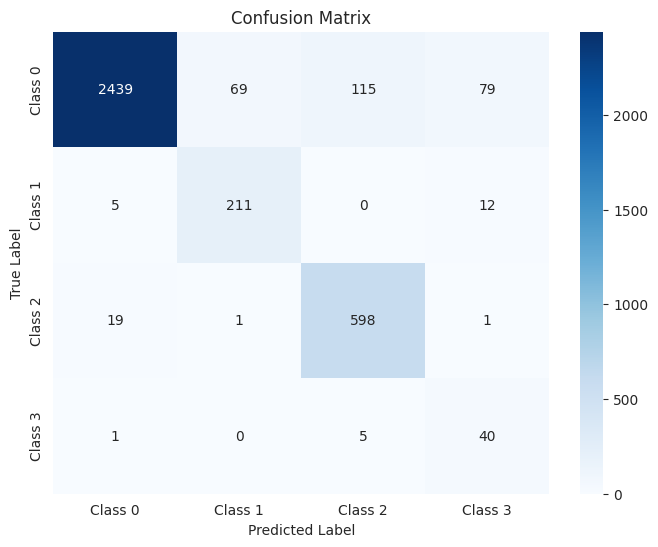

The function took 0.3814 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.86      0.94      0.90       774
     Class 3       0.33      0.88      0.48        57

    accuracy                           0.92      4494
   macro avg       0.73      0.92      0.79      4494
weighted avg       0.94      0.92      0.92      4494



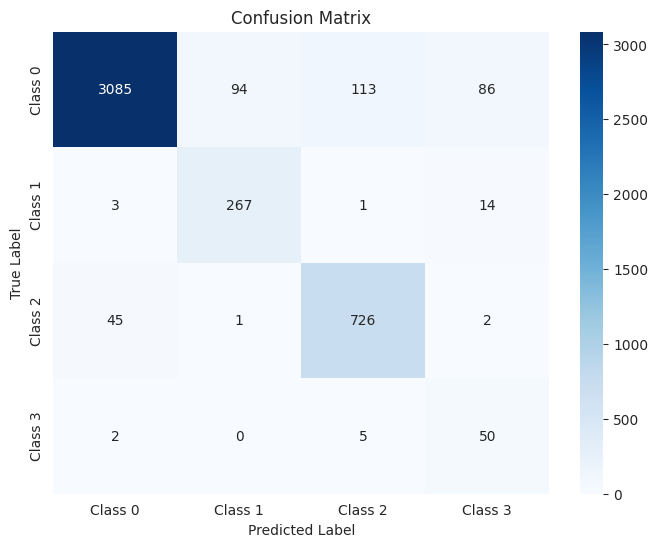

The function took 0.3996 seconds to execute.
[ARCH#008-[16, 4]] done in 27.3s  best-val=0.2747


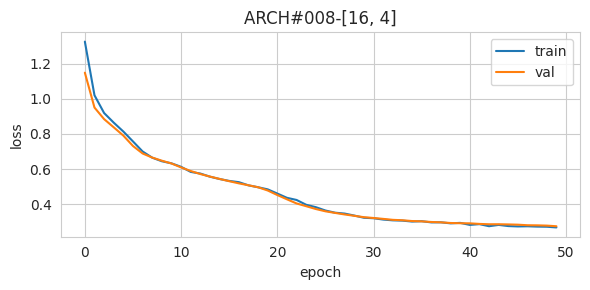


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.91      0.94     10808
     Class 1       0.74      0.96      0.83       914
     Class 2       0.97      0.87      0.91      2475
     Class 3       0.20      0.88      0.33       182

    accuracy                           0.91     14379
   macro avg       0.72      0.90      0.75     14379
weighted avg       0.94      0.91      0.92     14379



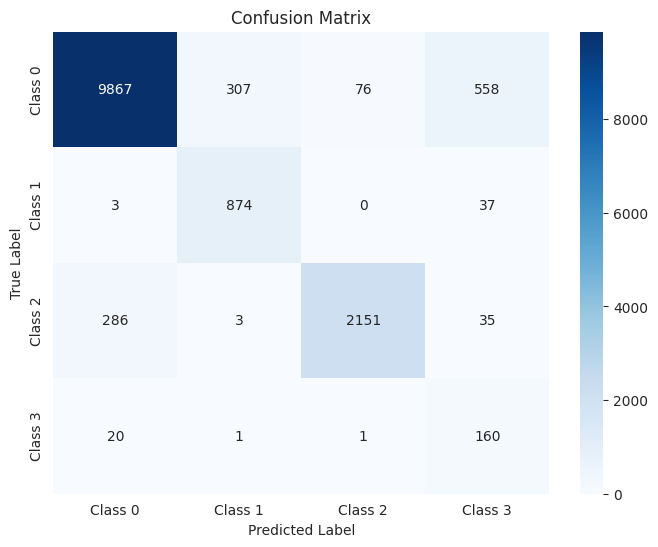

The function took 0.7665 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.91      0.94      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.96      0.89      0.92       619
     Class 3       0.19      0.87      0.31        46

    accuracy                           0.91      3595
   macro avg       0.72      0.90      0.75      3595
weighted avg       0.95      0.91      0.92      3595



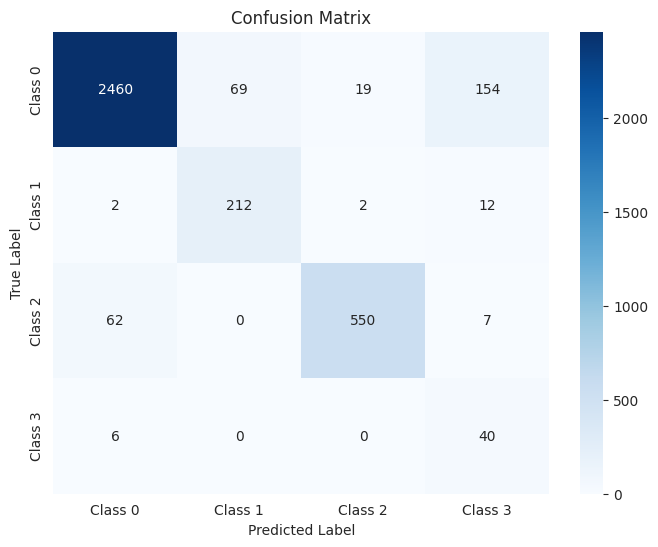

The function took 0.4220 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.91      0.94      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.95      0.84      0.90       774
     Class 3       0.20      0.86      0.33        57

    accuracy                           0.90      4494
   macro avg       0.71      0.89      0.75      4494
weighted avg       0.94      0.90      0.92      4494



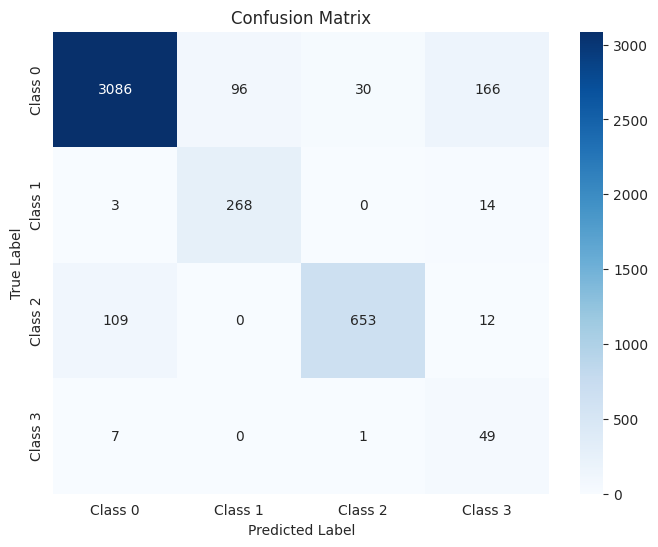

The function took 0.4229 seconds to execute.
[ARCH#009-[16, 2]] done in 26.9s  best-val=0.4310


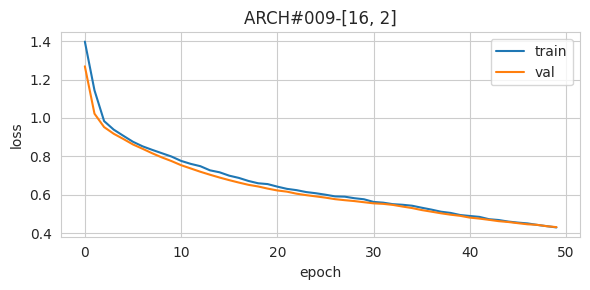


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.76      0.93      0.84       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.15      0.91      0.25       182

    accuracy                           0.90     14379
   macro avg       0.72      0.91      0.74     14379
weighted avg       0.96      0.90      0.93     14379



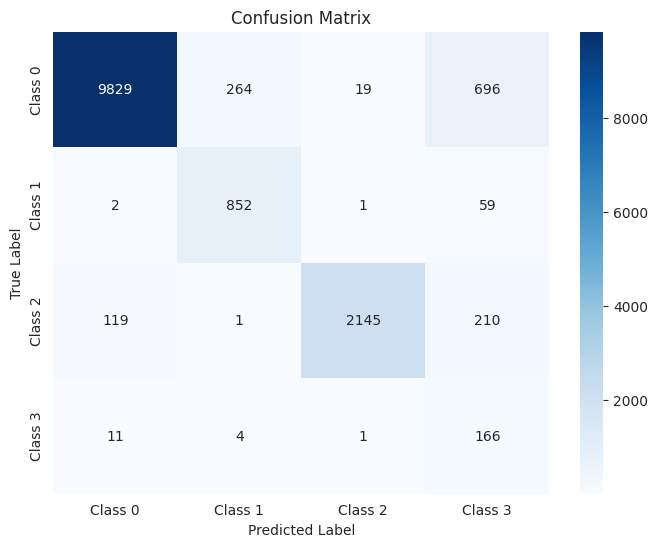

The function took 0.4656 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.78      0.90      0.84       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.14      0.91      0.25        46

    accuracy                           0.91      3595
   macro avg       0.73      0.90      0.74      3595
weighted avg       0.97      0.91      0.93      3595



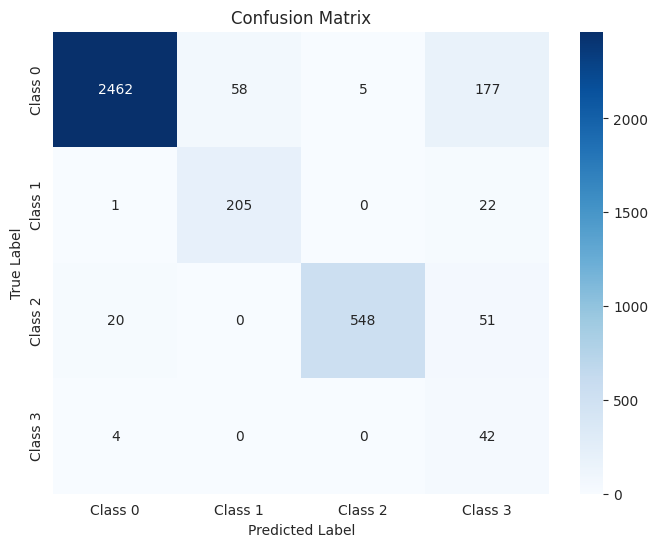

The function took 0.2818 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.75      0.91      0.82       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.14      0.84      0.24        57

    accuracy                           0.90      4494
   macro avg       0.71      0.88      0.73      4494
weighted avg       0.96      0.90      0.92      4494



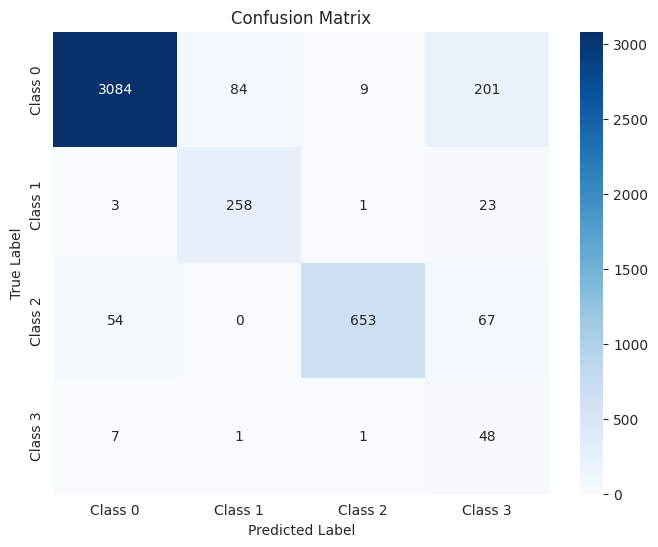

The function took 0.3093 seconds to execute.
[ARCH#010-[8, 8]] done in 26.6s  best-val=0.2688


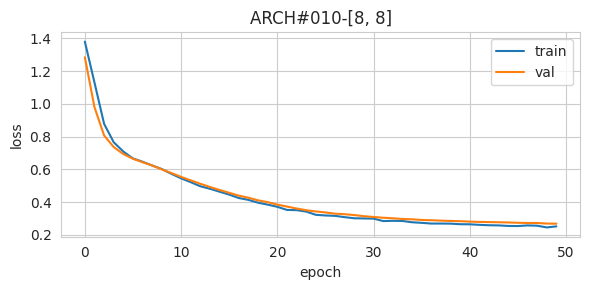


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.92      0.95     10808
     Class 1       0.74      0.96      0.83       914
     Class 2       0.90      0.90      0.90      2475
     Class 3       0.31      0.88      0.46       182

    accuracy                           0.92     14379
   macro avg       0.73      0.91      0.78     14379
weighted avg       0.94      0.92      0.92     14379



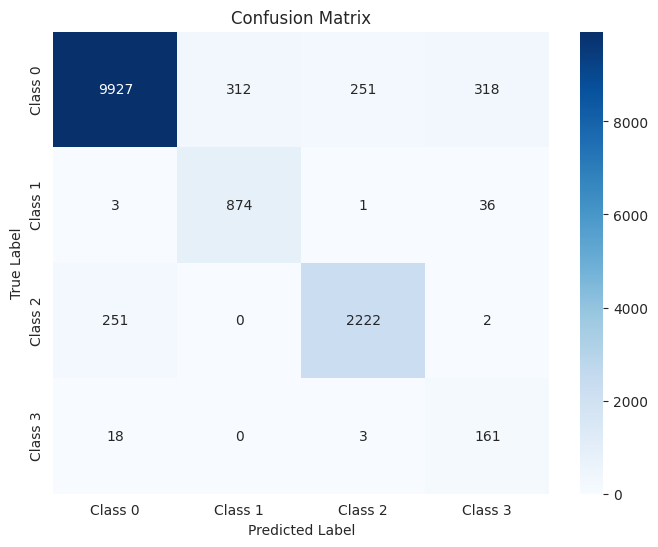

The function took 0.4823 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.92      0.94      2702
     Class 1       0.76      0.93      0.83       228
     Class 2       0.88      0.91      0.89       619
     Class 3       0.31      0.89      0.46        46

    accuracy                           0.92      3595
   macro avg       0.73      0.91      0.78      3595
weighted avg       0.94      0.92      0.92      3595



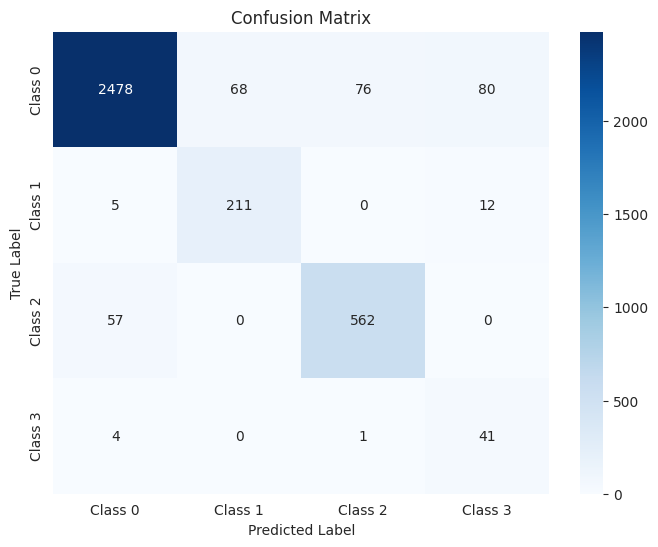

The function took 0.2629 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.92      0.94      3378
     Class 1       0.73      0.94      0.82       285
     Class 2       0.90      0.87      0.88       774
     Class 3       0.32      0.89      0.47        57

    accuracy                           0.91      4494
   macro avg       0.73      0.91      0.78      4494
weighted avg       0.93      0.91      0.92      4494



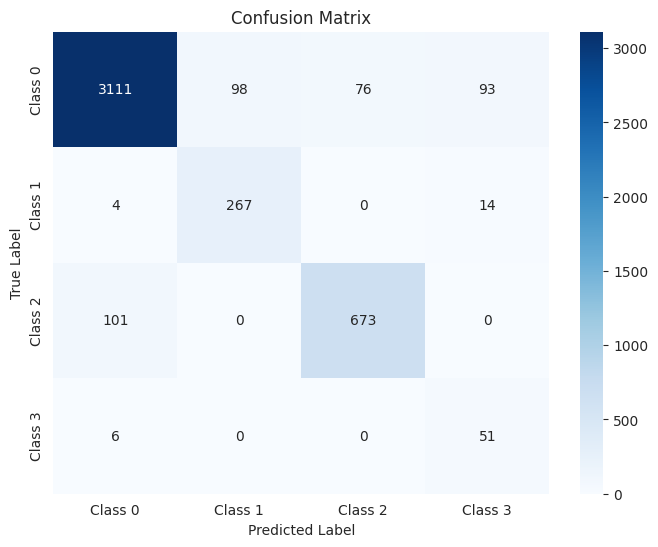

The function took 0.3141 seconds to execute.
[ARCH#011-[8, 4]] done in 26.3s  best-val=0.3059


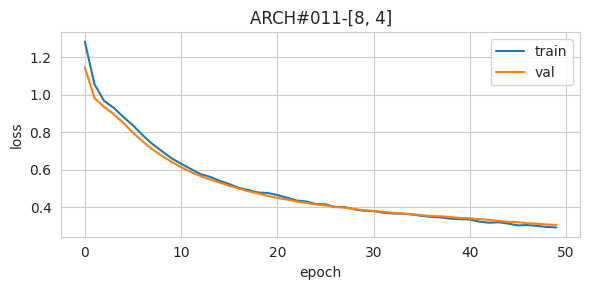


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.90      0.93     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.96      0.87      0.91      2475
     Class 3       0.17      0.91      0.29       182

    accuracy                           0.90     14379
   macro avg       0.71      0.91      0.74     14379
weighted avg       0.94      0.90      0.91     14379



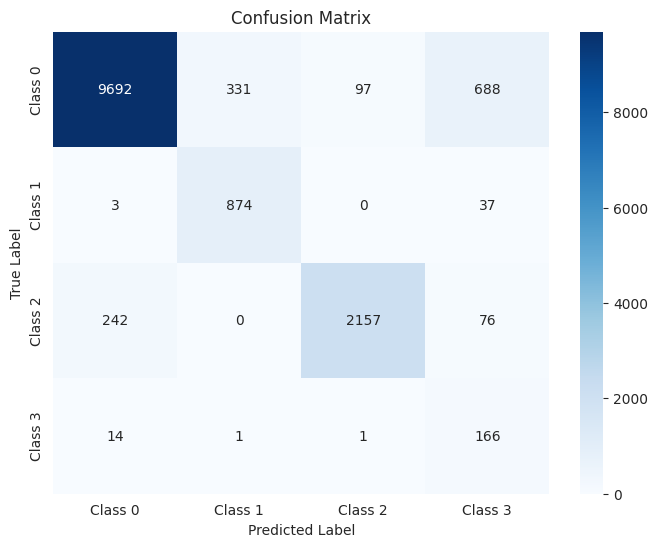

The function took 0.4721 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.90      0.93      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.96      0.88      0.92       619
     Class 3       0.16      0.89      0.28        46

    accuracy                           0.90      3595
   macro avg       0.71      0.90      0.74      3595
weighted avg       0.95      0.90      0.92      3595



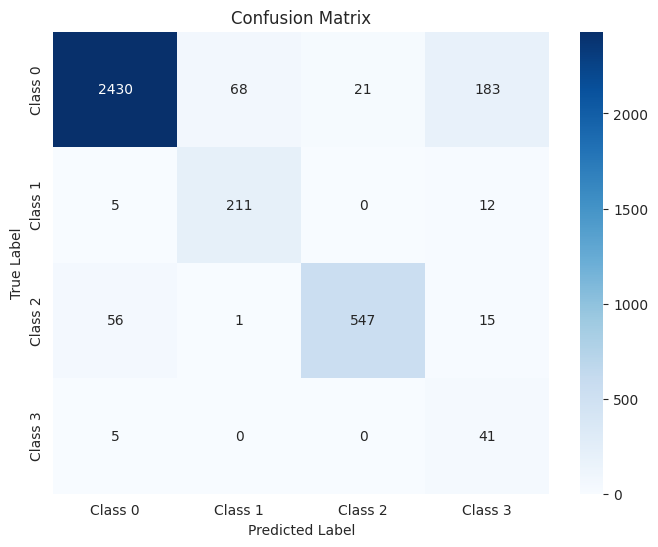

The function took 0.2868 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.90      0.93      3378
     Class 1       0.73      0.93      0.82       285
     Class 2       0.96      0.85      0.90       774
     Class 3       0.17      0.86      0.29        57

    accuracy                           0.90      4494
   macro avg       0.71      0.89      0.74      4494
weighted avg       0.94      0.90      0.91      4494



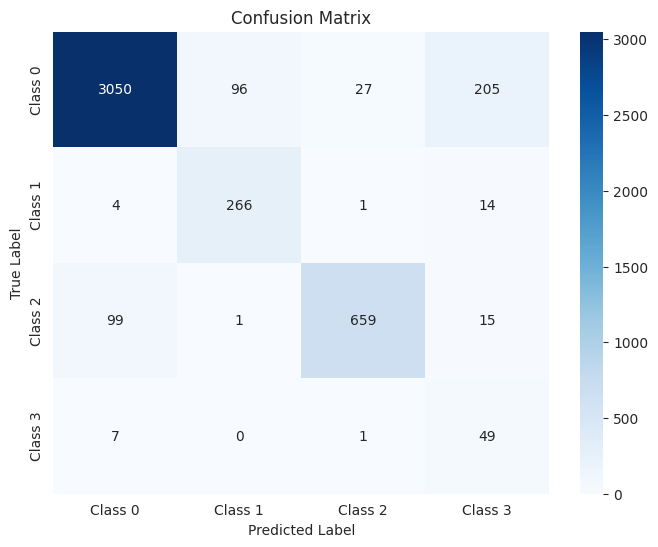

The function took 0.2805 seconds to execute.
[ARCH#012-[8, 2]] done in 26.3s  best-val=0.4337


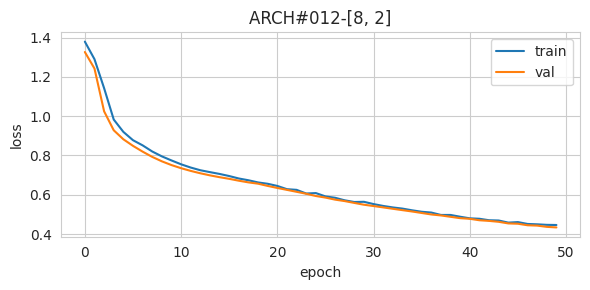


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.82      0.89     10808
     Class 1       0.64      0.95      0.77       914
     Class 2       0.88      0.87      0.88      2475
     Class 3       0.11      0.88      0.20       182

    accuracy                           0.84     14379
   macro avg       0.65      0.88      0.68     14379
weighted avg       0.92      0.84      0.87     14379



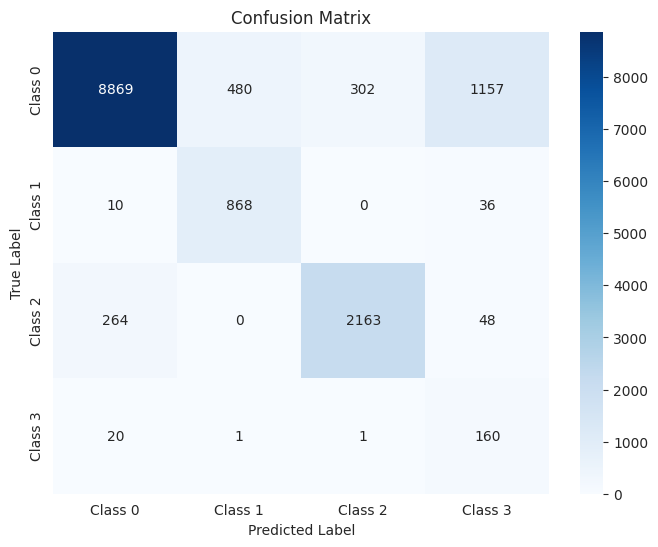

The function took 0.4969 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.81      0.88      2702
     Class 1       0.64      0.92      0.76       228
     Class 2       0.86      0.89      0.88       619
     Class 3       0.11      0.87      0.19        46

    accuracy                           0.83      3595
   macro avg       0.65      0.87      0.68      3595
weighted avg       0.92      0.83      0.87      3595



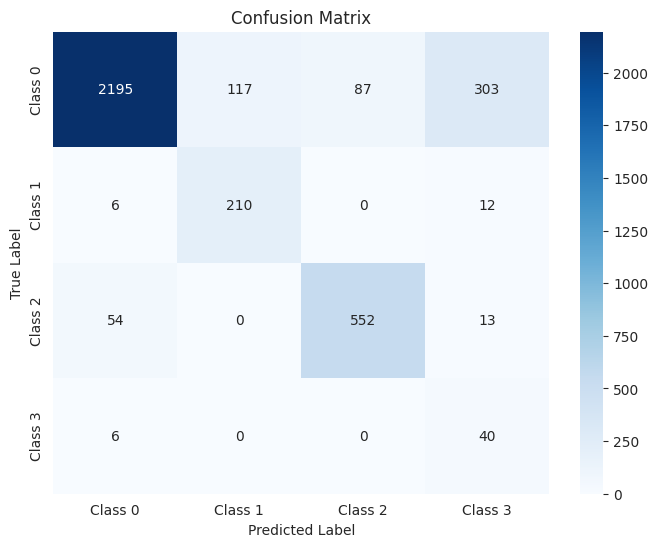

The function took 0.2921 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.81      0.88      3378
     Class 1       0.65      0.93      0.76       285
     Class 2       0.87      0.86      0.86       774
     Class 3       0.10      0.86      0.19        57

    accuracy                           0.83      4494
   macro avg       0.65      0.86      0.67      4494
weighted avg       0.92      0.83      0.86      4494



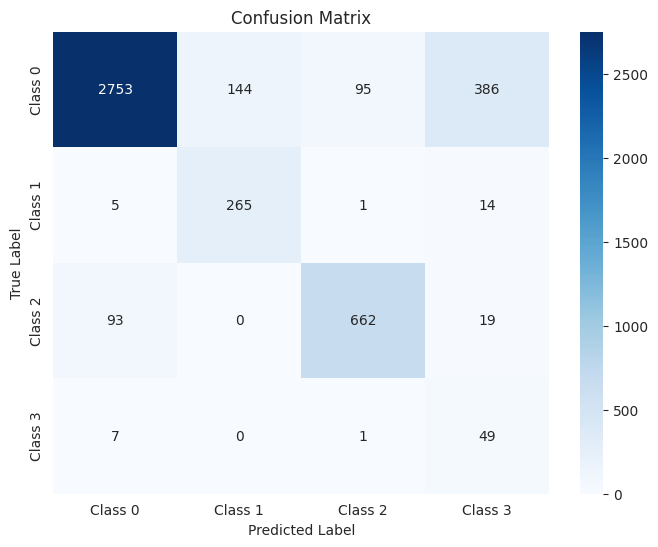

The function took 0.2947 seconds to execute.
[ARCH#013-[4, 4]] done in 26.4s  best-val=0.4171


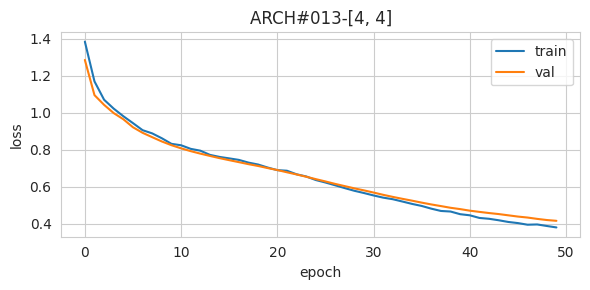


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.87      0.93     10808
     Class 1       0.67      0.95      0.79       914
     Class 2       0.98      0.86      0.92      2475
     Class 3       0.12      0.93      0.22       182

    accuracy                           0.88     14379
   macro avg       0.69      0.90      0.71     14379
weighted avg       0.95      0.88      0.91     14379



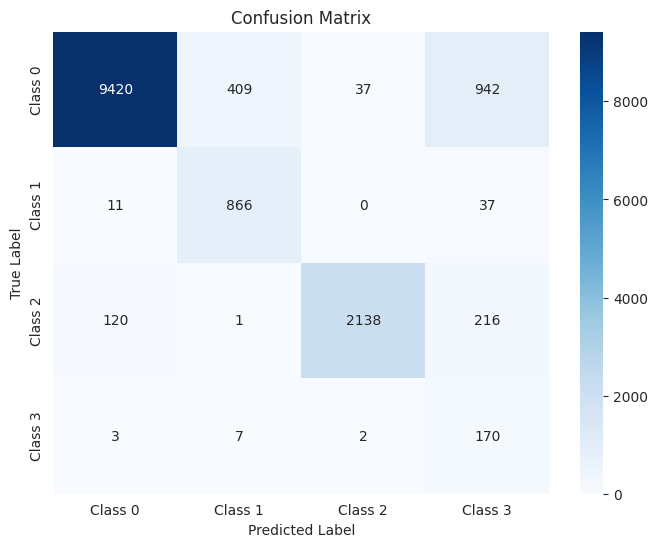

The function took 0.4826 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.87      0.93      2702
     Class 1       0.71      0.92      0.80       228
     Class 2       0.98      0.88      0.93       619
     Class 3       0.12      0.89      0.21        46

    accuracy                           0.88      3595
   macro avg       0.70      0.89      0.71      3595
weighted avg       0.96      0.88      0.91      3595



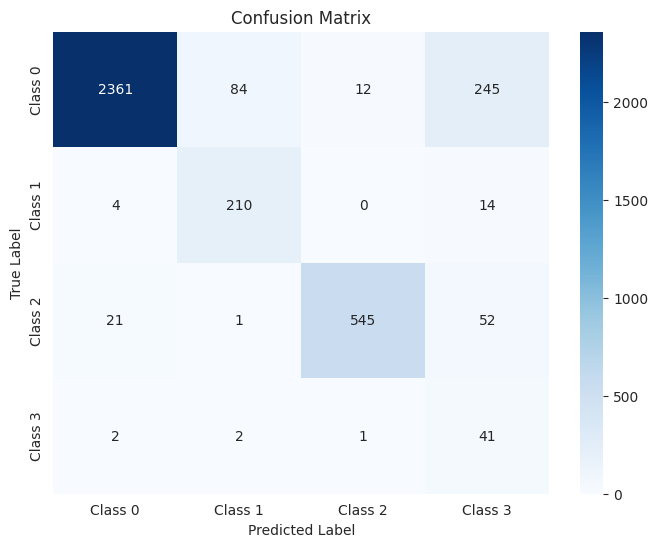

The function took 0.2808 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.88      0.93      3378
     Class 1       0.68      0.93      0.79       285
     Class 2       0.97      0.84      0.90       774
     Class 3       0.12      0.88      0.21        57

    accuracy                           0.87      4494
   macro avg       0.69      0.88      0.71      4494
weighted avg       0.95      0.87      0.90      4494



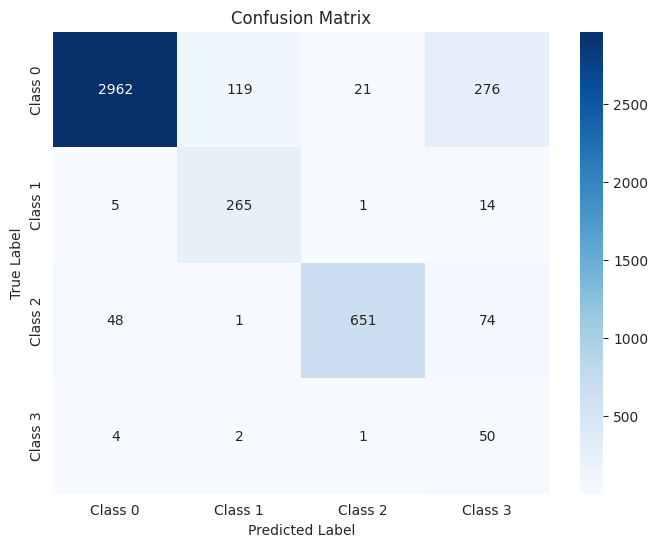

The function took 0.2934 seconds to execute.
[ARCH#014-[4, 2]] done in 26.3s  best-val=0.6082


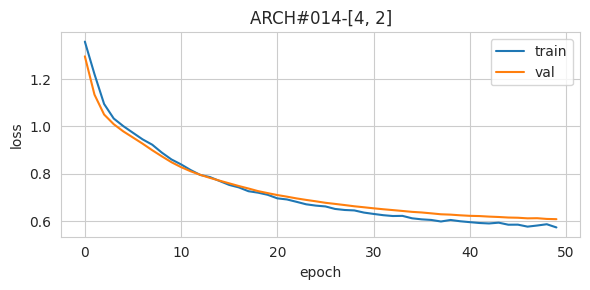


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.93      0.37      0.53     10808
     Class 1       0.49      0.96      0.65       914
     Class 2       0.93      0.86      0.89      2475
     Class 3       0.03      0.88      0.05       182

    accuracy                           0.50     14379
   macro avg       0.59      0.77      0.53     14379
weighted avg       0.89      0.50      0.59     14379



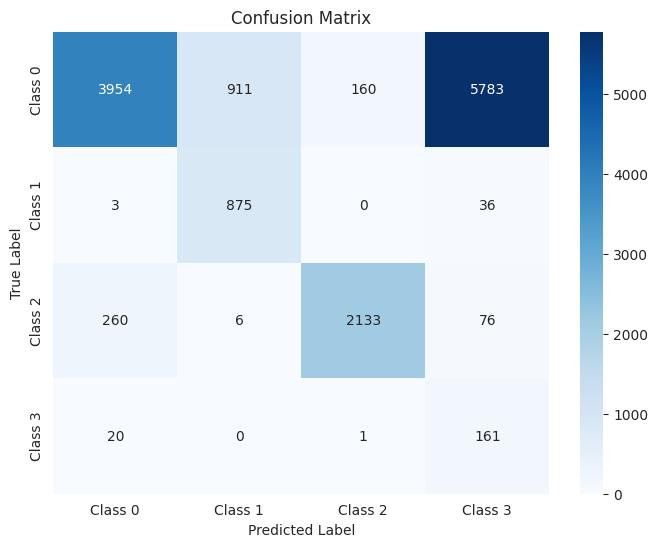

The function took 0.4907 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.37      0.53      2702
     Class 1       0.51      0.93      0.66       228
     Class 2       0.93      0.88      0.90       619
     Class 3       0.03      0.87      0.05        46

    accuracy                           0.50      3595
   macro avg       0.60      0.76      0.53      3595
weighted avg       0.90      0.50      0.59      3595



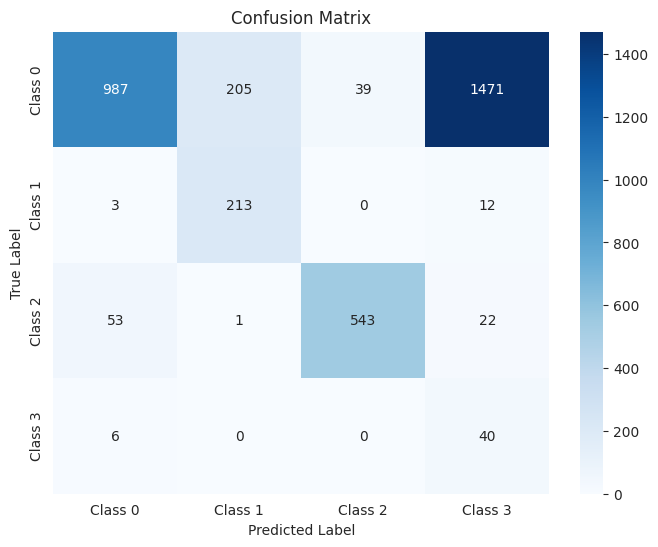

The function took 0.2876 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.92      0.36      0.52      3378
     Class 1       0.47      0.93      0.62       285
     Class 2       0.92      0.84      0.88       774
     Class 3       0.03      0.88      0.05        57

    accuracy                           0.48      4494
   macro avg       0.58      0.75      0.52      4494
weighted avg       0.88      0.48      0.58      4494



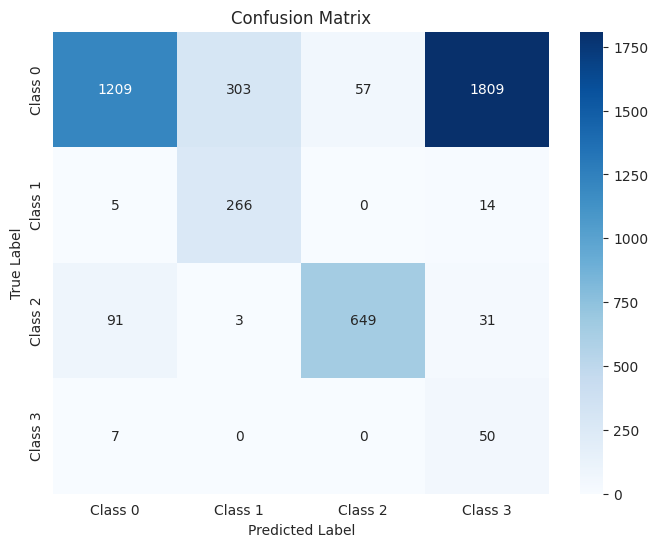

The function took 0.2931 seconds to execute.
[ARCH#015-[2, 2]] done in 26.3s  best-val=0.5400


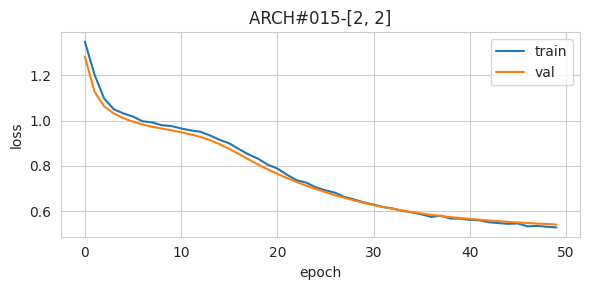


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.89      0.93     10808
     Class 1       0.64      0.95      0.76       914
     Class 2       0.96      0.87      0.91      2475
     Class 3       0.14      0.58      0.23       182

    accuracy                           0.89     14379
   macro avg       0.67      0.82      0.71     14379
weighted avg       0.93      0.89      0.90     14379



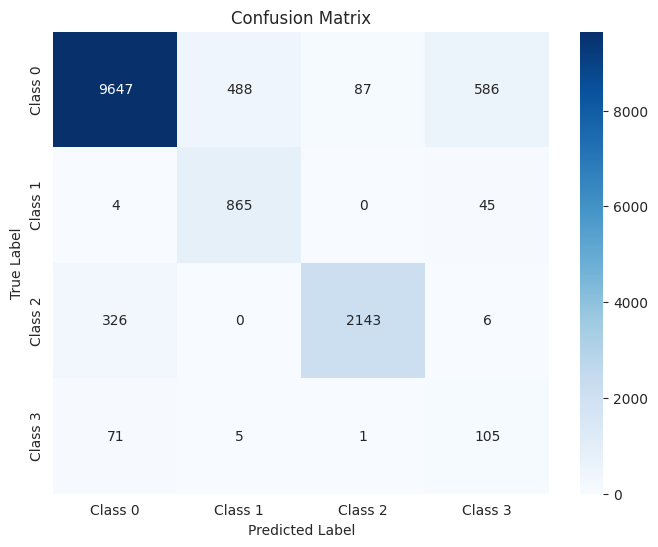

The function took 0.4611 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.90      0.93      2702
     Class 1       0.66      0.92      0.77       228
     Class 2       0.96      0.88      0.92       619
     Class 3       0.14      0.54      0.22        46

    accuracy                           0.89      3595
   macro avg       0.68      0.81      0.71      3595
weighted avg       0.93      0.89      0.91      3595



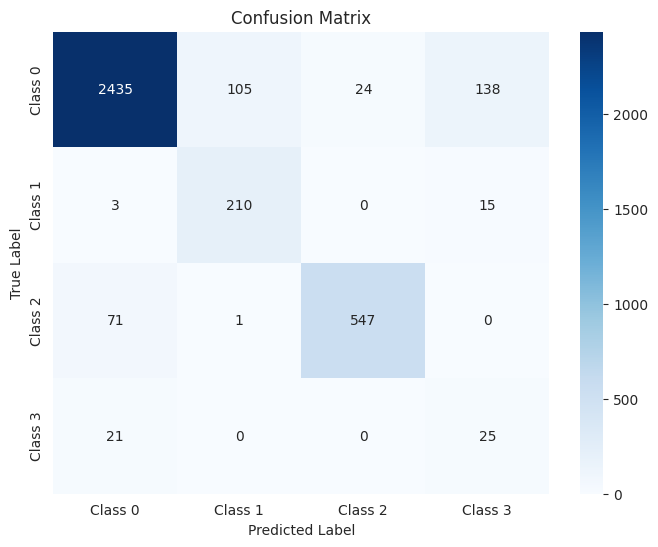

The function took 0.2874 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.88      0.92      3378
     Class 1       0.62      0.93      0.74       285
     Class 2       0.95      0.84      0.89       774
     Class 3       0.13      0.56      0.21        57

    accuracy                           0.88      4494
   macro avg       0.66      0.80      0.69      4494
weighted avg       0.92      0.88      0.89      4494



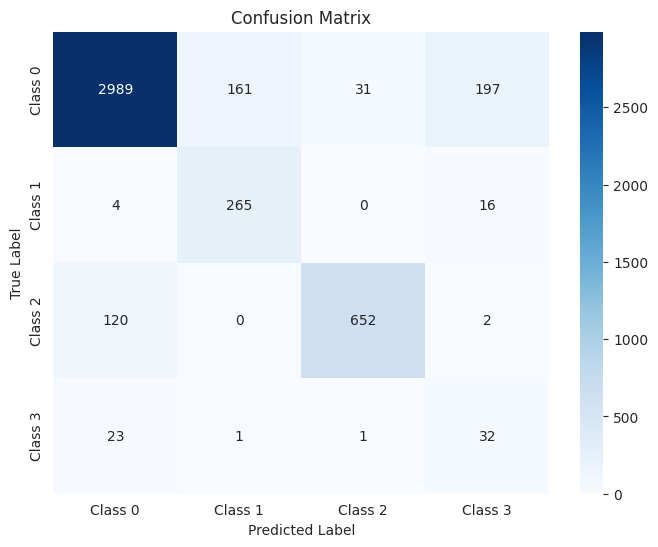

The function took 0.2967 seconds to execute.
[ARCH#016-[32, 32, 32]] done in 29.4s  best-val=0.2001


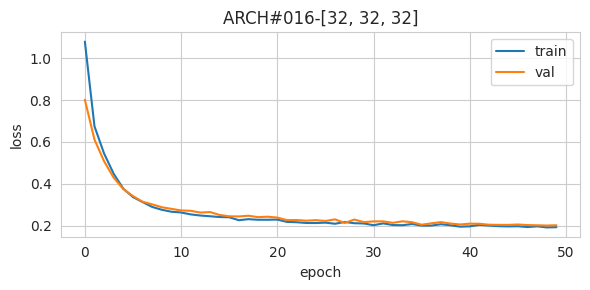


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.86      0.95      0.90      2475
     Class 3       0.39      0.88      0.54       182

    accuracy                           0.93     14379
   macro avg       0.75      0.93      0.81     14379
weighted avg       0.94      0.93      0.93     14379



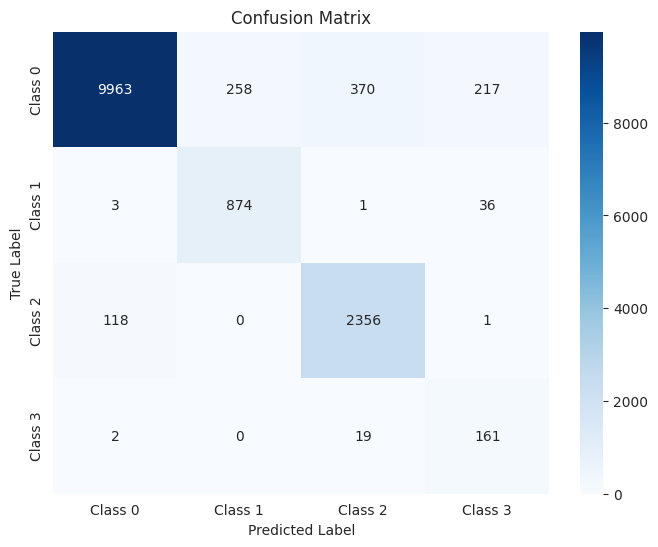

The function took 0.7333 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.85      0.96      0.91       619
     Class 3       0.36      0.87      0.51        46

    accuracy                           0.93      3595
   macro avg       0.75      0.92      0.80      3595
weighted avg       0.94      0.93      0.93      3595



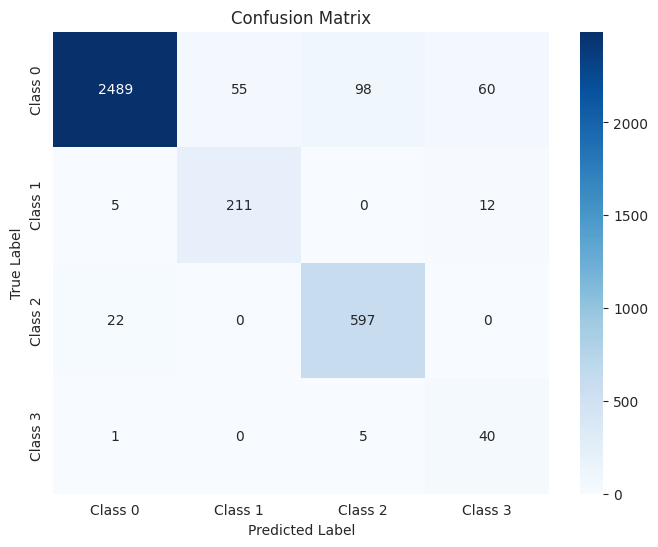

The function took 0.3737 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.86      0.94      0.90       774
     Class 3       0.39      0.86      0.53        57

    accuracy                           0.93      4494
   macro avg       0.75      0.91      0.81      4494
weighted avg       0.94      0.93      0.93      4494



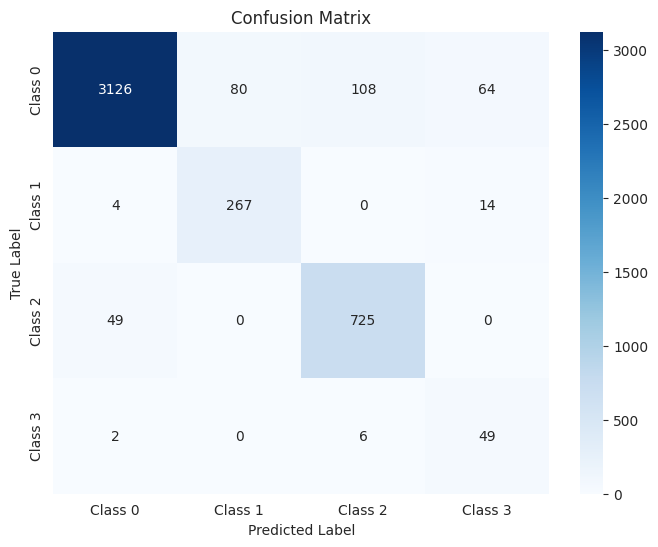

The function took 0.4572 seconds to execute.
[ARCH#017-[32, 32, 16]] done in 29.3s  best-val=0.2006


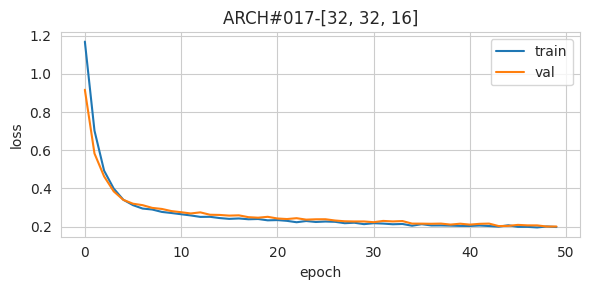


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.76      0.96      0.84       914
     Class 2       0.86      0.95      0.90      2475
     Class 3       0.37      0.88      0.52       182

    accuracy                           0.93     14379
   macro avg       0.74      0.93      0.80     14379
weighted avg       0.94      0.93      0.93     14379



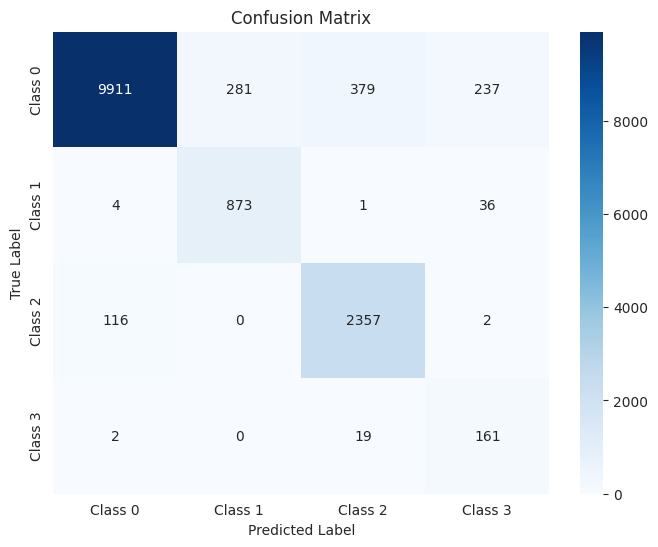

The function took 0.5243 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.85      0.97      0.91       619
     Class 3       0.34      0.89      0.49        46

    accuracy                           0.92      3595
   macro avg       0.74      0.92      0.80      3595
weighted avg       0.94      0.92      0.93      3595



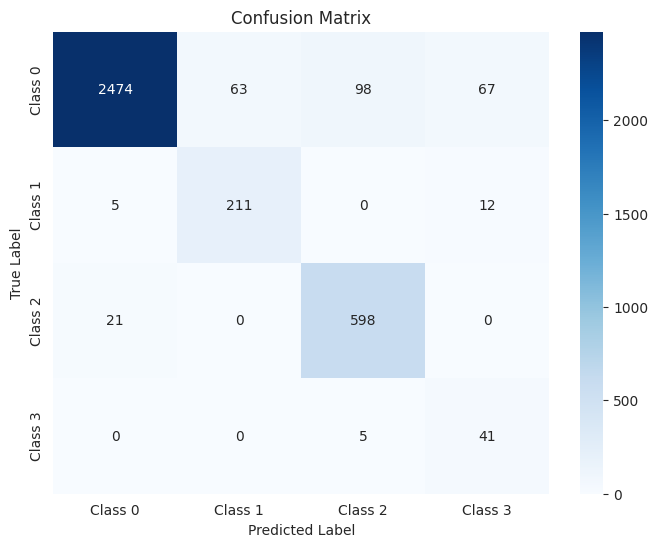

The function took 0.2886 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.87      0.94      0.90       774
     Class 3       0.38      0.88      0.53        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.81      4494
weighted avg       0.94      0.93      0.93      4494



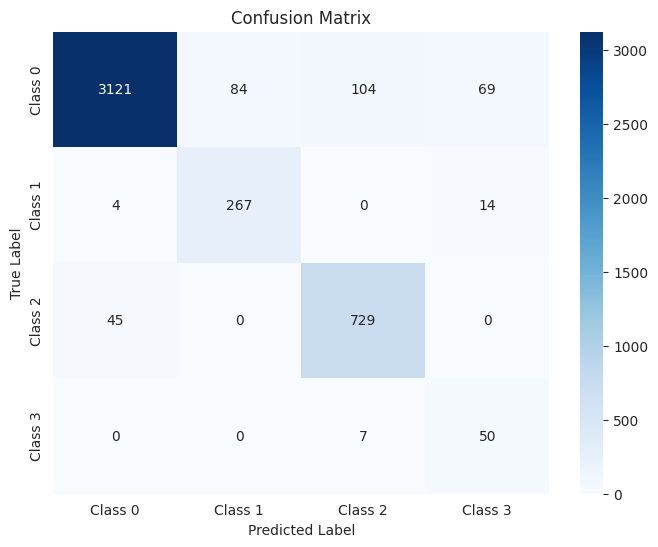

The function took 0.2950 seconds to execute.
[ARCH#018-[32, 32, 8]] done in 29.1s  best-val=0.2112


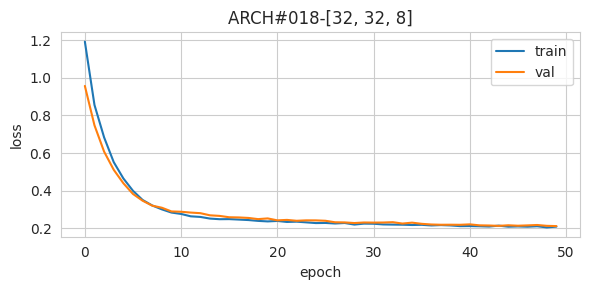


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.84      0.95      0.89      2475
     Class 3       0.36      0.88      0.52       182

    accuracy                           0.92     14379
   macro avg       0.73      0.92      0.80     14379
weighted avg       0.94      0.92      0.93     14379



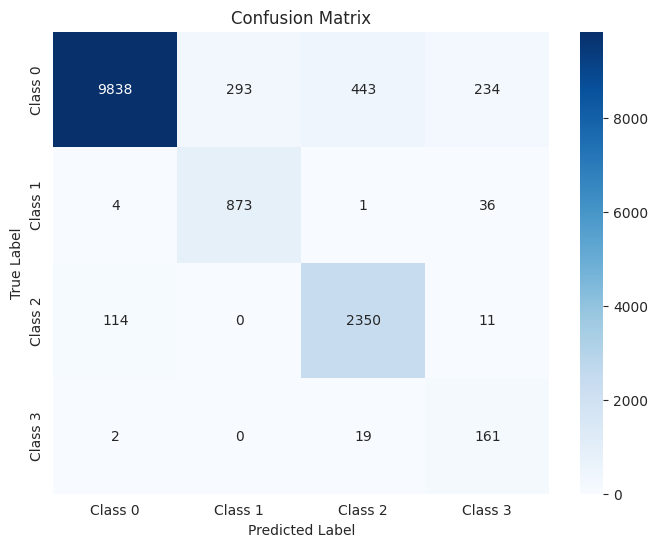

The function took 0.5232 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.83      0.96      0.89       619
     Class 3       0.34      0.89      0.49        46

    accuracy                           0.92      3595
   macro avg       0.73      0.92      0.79      3595
weighted avg       0.94      0.92      0.93      3595



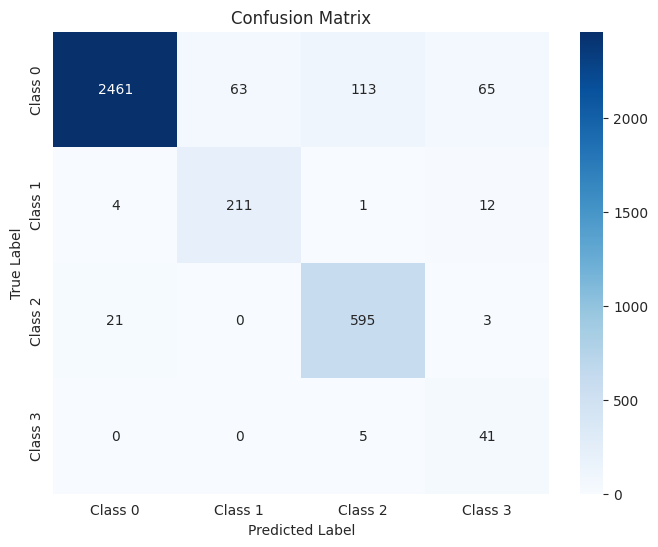

The function took 0.2920 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.84      0.94      0.89       774
     Class 3       0.39      0.89      0.54        57

    accuracy                           0.92      4494
   macro avg       0.74      0.92      0.80      4494
weighted avg       0.94      0.92      0.93      4494



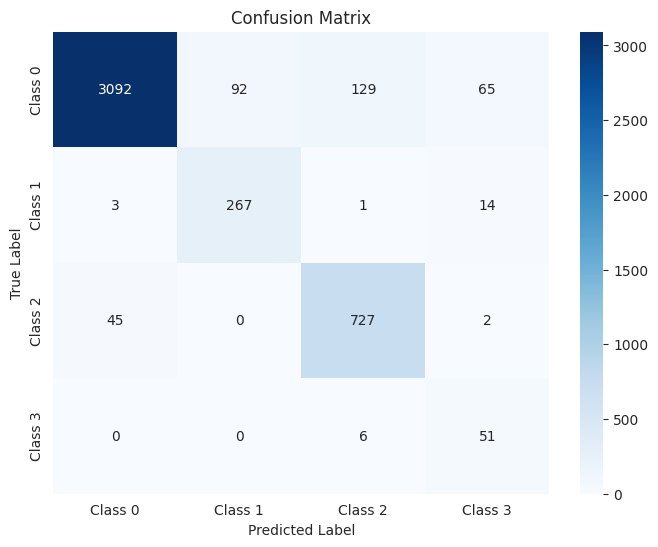

The function took 0.3199 seconds to execute.
[ARCH#019-[32, 32, 4]] done in 29.1s  best-val=0.2380


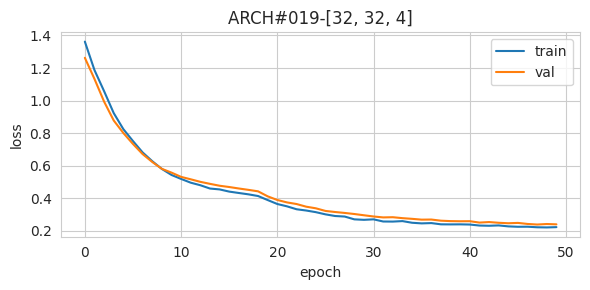


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.77      0.96      0.86       914
     Class 2       0.81      0.96      0.88      2475
     Class 3       0.35      0.87      0.50       182

    accuracy                           0.92     14379
   macro avg       0.73      0.92      0.79     14379
weighted avg       0.94      0.92      0.92     14379



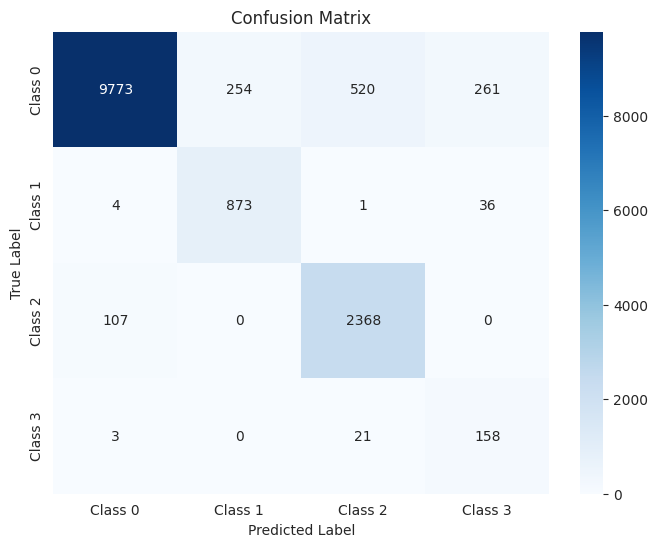

The function took 0.6922 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.80      0.93      0.86       228
     Class 2       0.79      0.97      0.87       619
     Class 3       0.33      0.85      0.47        46

    accuracy                           0.91      3595
   macro avg       0.73      0.91      0.79      3595
weighted avg       0.94      0.91      0.92      3595



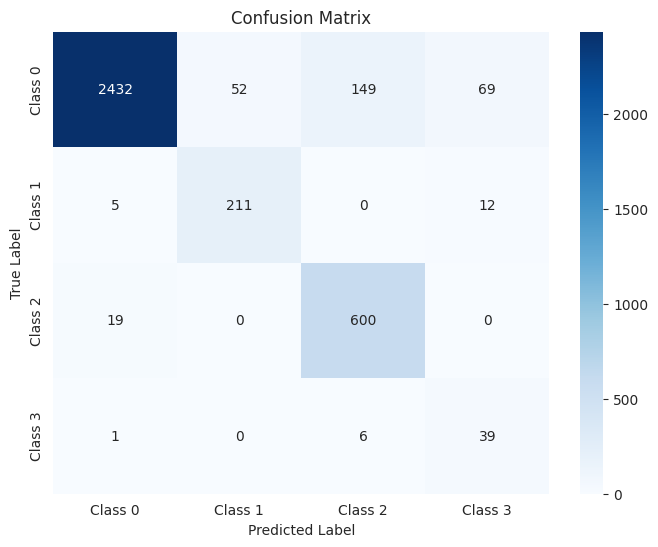

The function took 0.3725 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.78      0.93      0.85       285
     Class 2       0.82      0.94      0.88       774
     Class 3       0.36      0.84      0.50        57

    accuracy                           0.92      4494
   macro avg       0.74      0.91      0.79      4494
weighted avg       0.93      0.92      0.92      4494



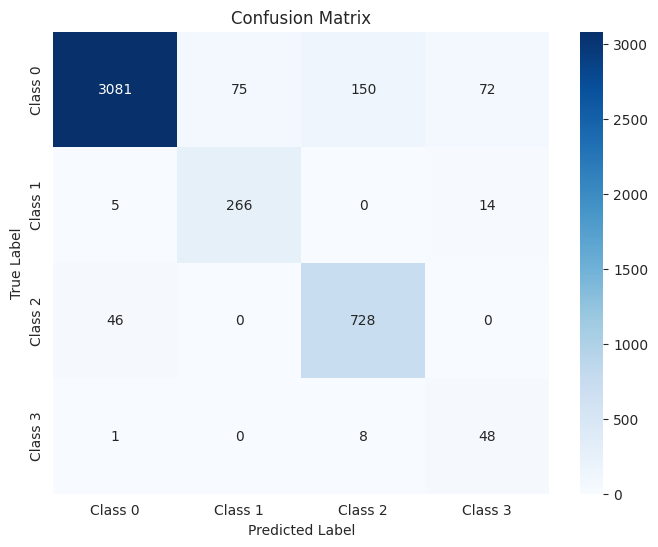

The function took 0.4046 seconds to execute.
[ARCH#020-[32, 32, 2]] done in 29.5s  best-val=0.3293


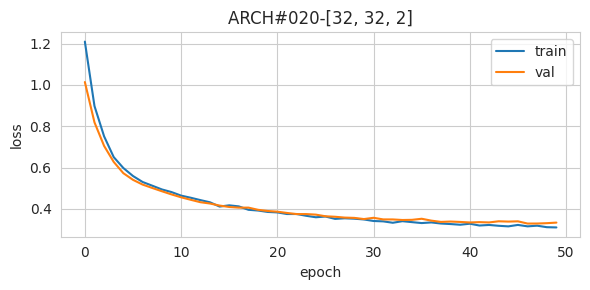


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.96     10808
     Class 1       0.75      0.86      0.80       914
     Class 2       0.97      0.88      0.93      2475
     Class 3       0.25      0.88      0.38       182

    accuracy                           0.92     14379
   macro avg       0.74      0.89      0.77     14379
weighted avg       0.95      0.92      0.93     14379



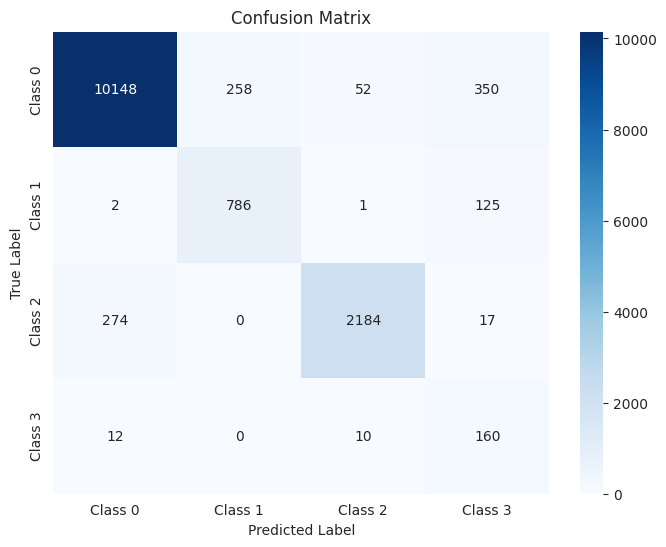

The function took 0.5180 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      2702
     Class 1       0.77      0.82      0.79       228
     Class 2       0.98      0.90      0.94       619
     Class 3       0.23      0.87      0.36        46

    accuracy                           0.93      3595
   macro avg       0.74      0.88      0.76      3595
weighted avg       0.95      0.93      0.94      3595



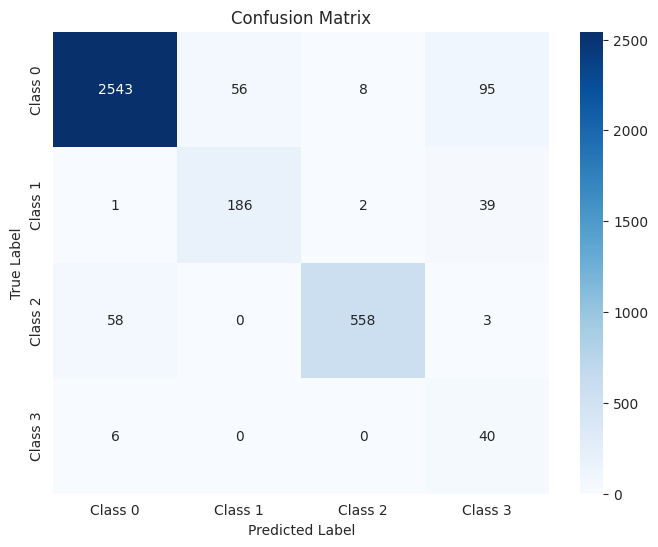

The function took 0.2803 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95      3378
     Class 1       0.76      0.84      0.80       285
     Class 2       0.96      0.86      0.91       774
     Class 3       0.24      0.86      0.37        57

    accuracy                           0.92      4494
   macro avg       0.73      0.88      0.76      4494
weighted avg       0.94      0.92      0.93      4494



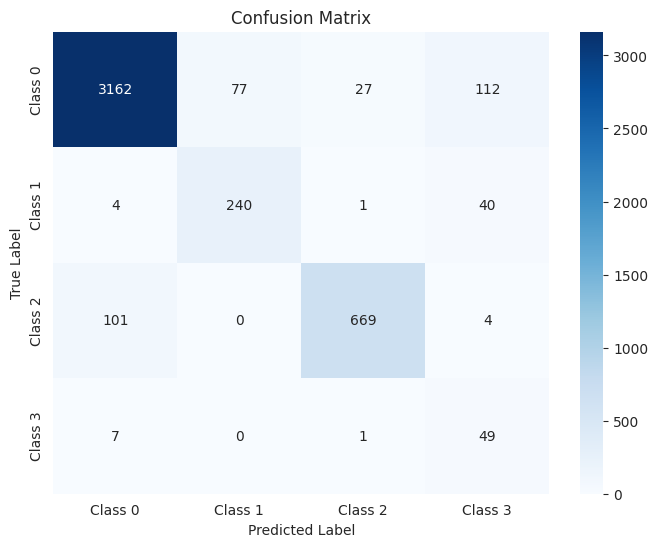

The function took 0.3057 seconds to execute.
[ARCH#021-[32, 16, 16]] done in 28.9s  best-val=0.2175


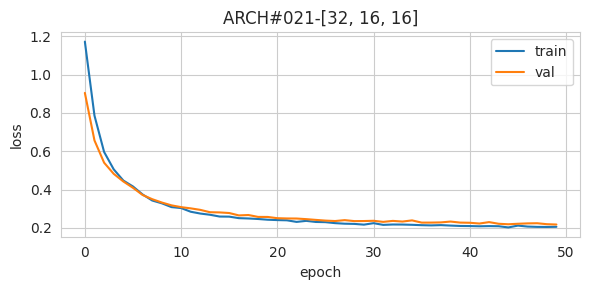


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.83      0.95      0.89      2475
     Class 3       0.31      0.88      0.46       182

    accuracy                           0.91     14379
   macro avg       0.72      0.92      0.79     14379
weighted avg       0.94      0.91      0.92     14379



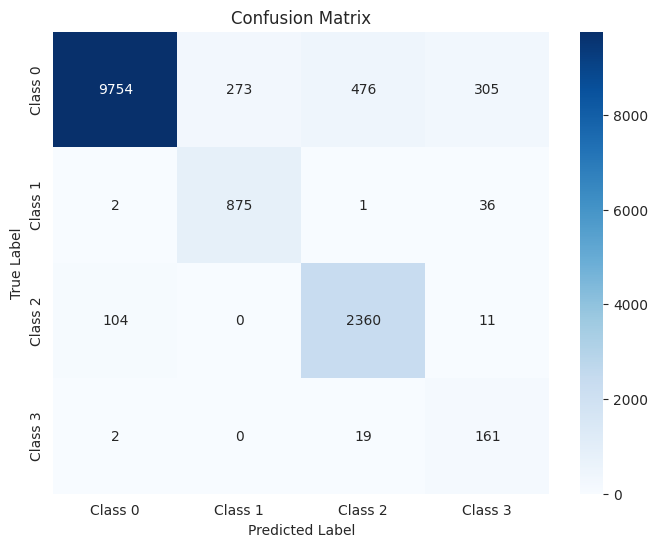

The function took 0.5129 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.83      0.96      0.89       619
     Class 3       0.28      0.87      0.42        46

    accuracy                           0.91      3595
   macro avg       0.72      0.92      0.78      3595
weighted avg       0.94      0.91      0.92      3595



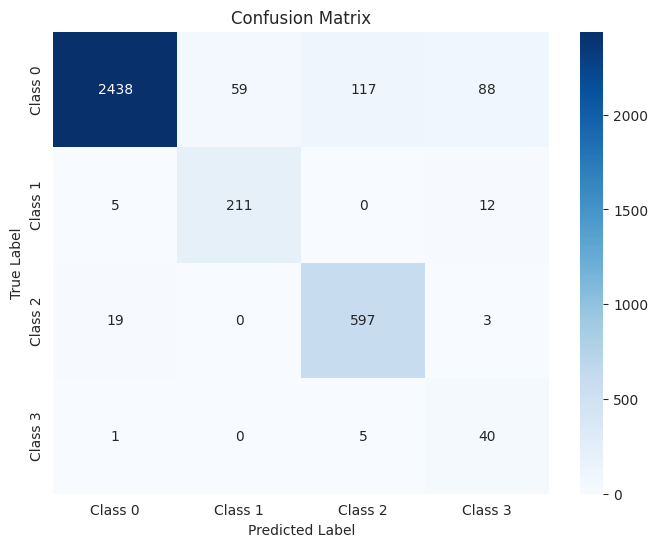

The function took 0.2840 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.82      0.95      0.88       774
     Class 3       0.34      0.86      0.49        57

    accuracy                           0.92      4494
   macro avg       0.73      0.91      0.79      4494
weighted avg       0.94      0.92      0.92      4494



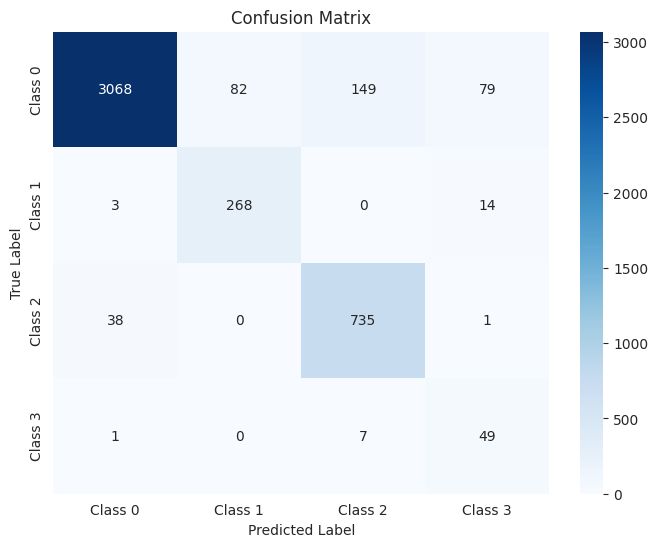

The function took 0.2967 seconds to execute.
[ARCH#022-[32, 16, 8]] done in 28.9s  best-val=0.2137


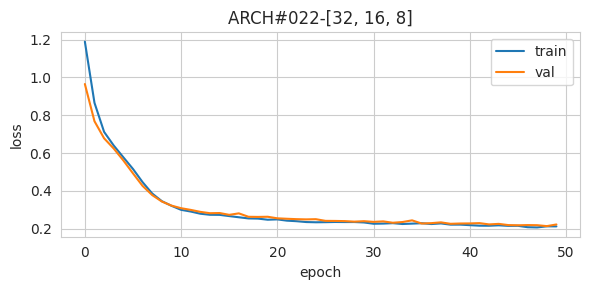


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.88      0.95      0.91      2475
     Class 3       0.35      0.88      0.50       182

    accuracy                           0.93     14379
   macro avg       0.74      0.93      0.80     14379
weighted avg       0.95      0.93      0.93     14379



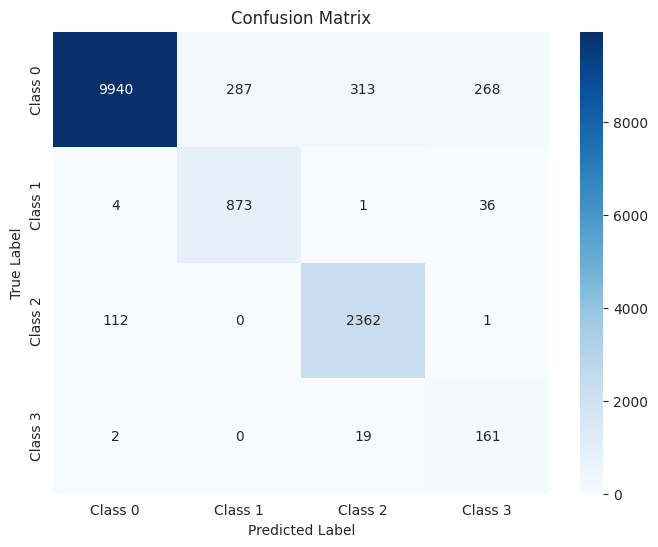

The function took 0.4994 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.86      0.97      0.91       619
     Class 3       0.34      0.89      0.49        46

    accuracy                           0.93      3595
   macro avg       0.74      0.93      0.80      3595
weighted avg       0.95      0.93      0.93      3595



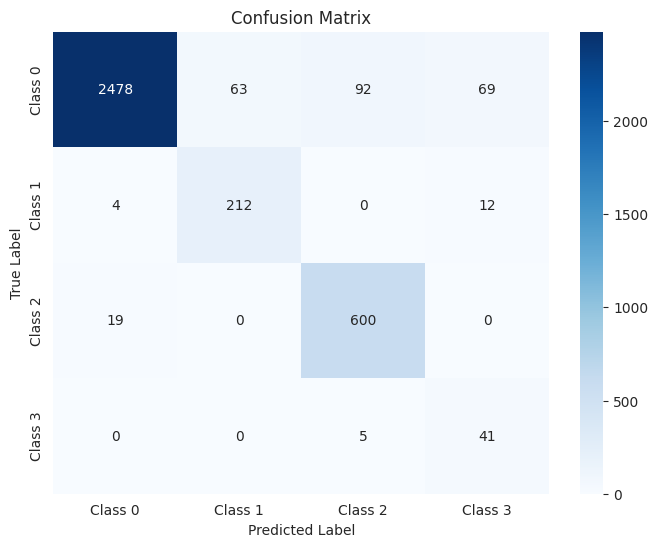

The function took 0.2918 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.88      0.94      0.91       774
     Class 3       0.35      0.88      0.51        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.80      4494
weighted avg       0.94      0.93      0.93      4494



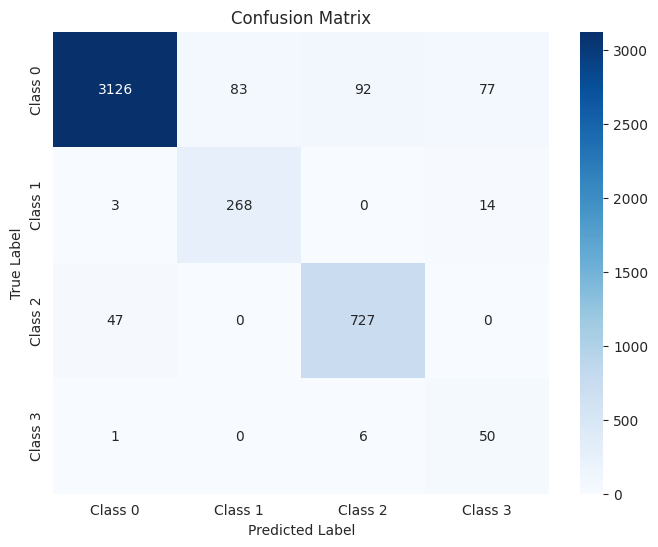

The function took 0.3089 seconds to execute.
[ARCH#023-[32, 16, 4]] done in 29.1s  best-val=0.2356


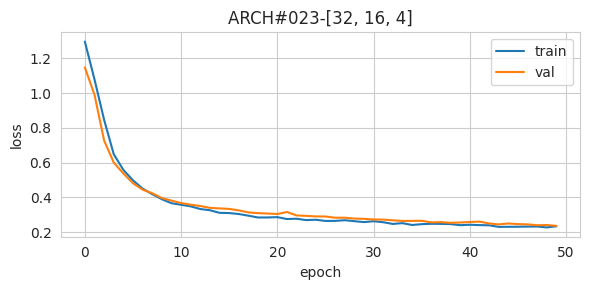


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.86      0.95      0.90      2475
     Class 3       0.29      0.88      0.43       182

    accuracy                           0.92     14379
   macro avg       0.72      0.92      0.78     14379
weighted avg       0.94      0.92      0.92     14379



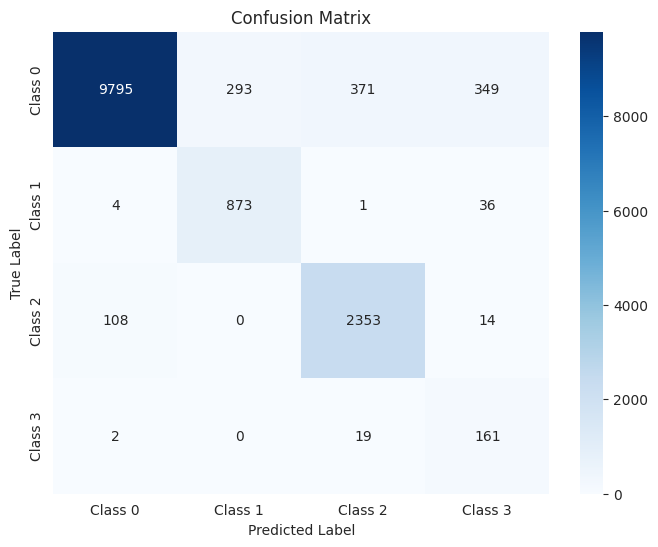

The function took 0.7415 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.95      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.86      0.96      0.91       619
     Class 3       0.25      0.87      0.39        46

    accuracy                           0.92      3595
   macro avg       0.72      0.92      0.77      3595
weighted avg       0.94      0.92      0.93      3595



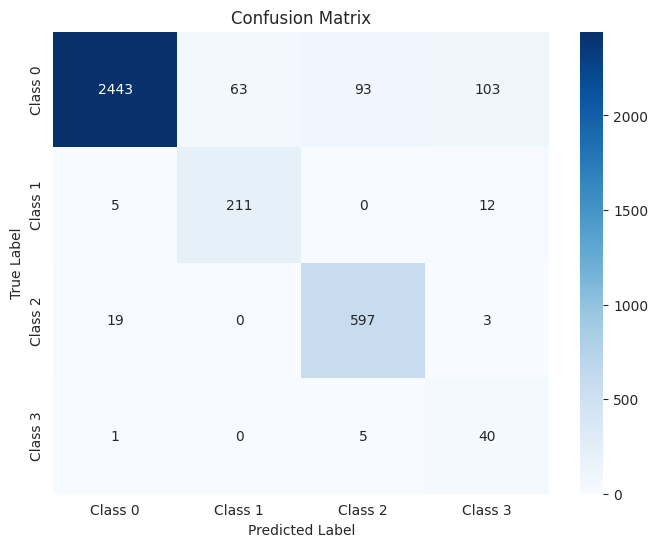

The function took 0.3965 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.86      0.94      0.90       774
     Class 3       0.33      0.88      0.48        57

    accuracy                           0.92      4494
   macro avg       0.73      0.92      0.79      4494
weighted avg       0.94      0.92      0.92      4494



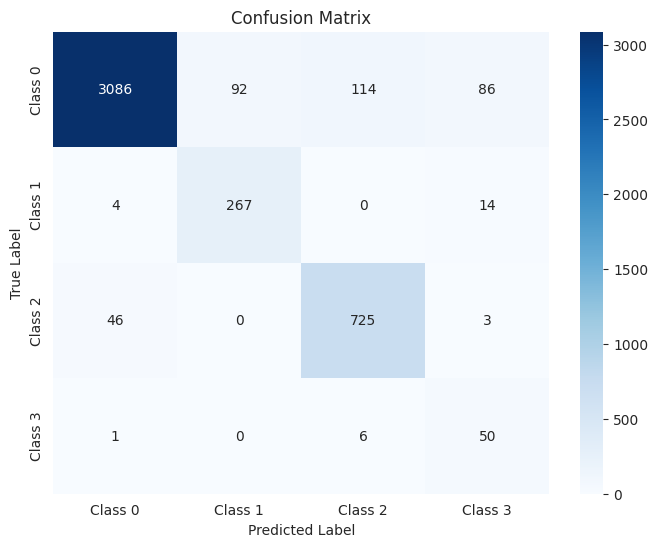

The function took 0.4773 seconds to execute.
[ARCH#024-[32, 16, 2]] done in 28.8s  best-val=0.4072


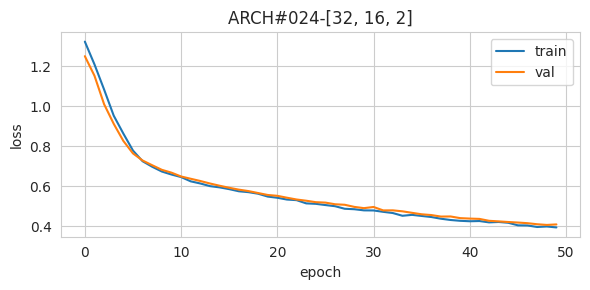


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95     10808
     Class 1       0.75      0.91      0.82       914
     Class 2       0.95      0.89      0.92      2475
     Class 3       0.32      0.87      0.47       182

    accuracy                           0.93     14379
   macro avg       0.75      0.90      0.79     14379
weighted avg       0.94      0.93      0.93     14379



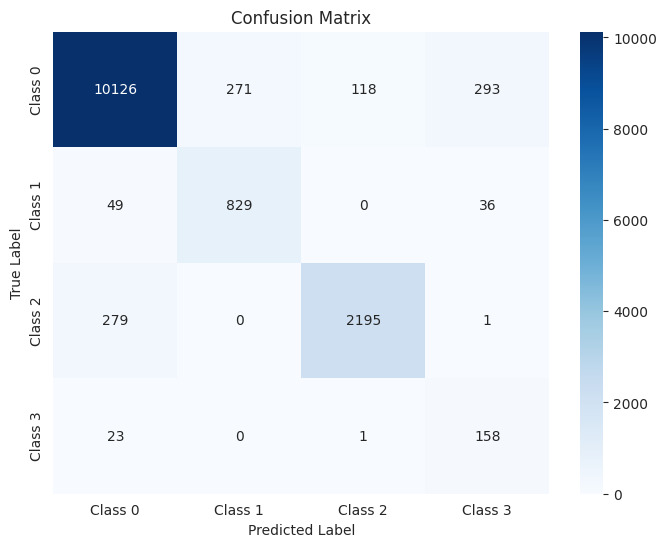

The function took 0.7859 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95      2702
     Class 1       0.78      0.87      0.82       228
     Class 2       0.93      0.90      0.92       619
     Class 3       0.31      0.87      0.46        46

    accuracy                           0.93      3595
   macro avg       0.75      0.90      0.79      3595
weighted avg       0.94      0.93      0.93      3595



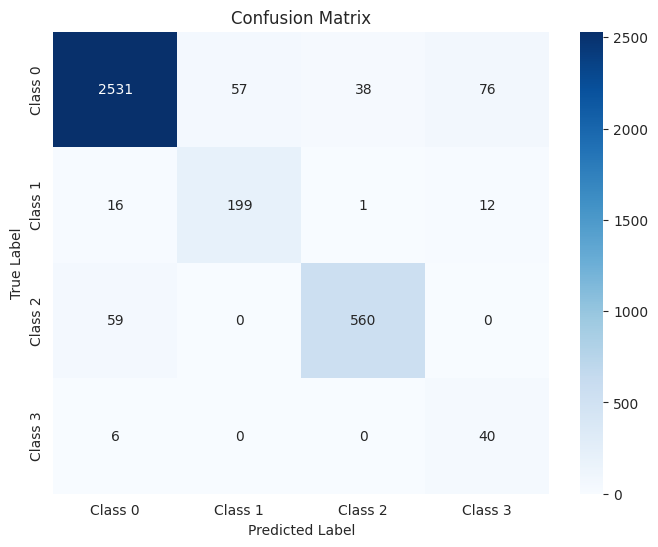

The function took 0.3400 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.95      3378
     Class 1       0.76      0.89      0.82       285
     Class 2       0.93      0.87      0.90       774
     Class 3       0.29      0.82      0.43        57

    accuracy                           0.92      4494
   macro avg       0.73      0.88      0.77      4494
weighted avg       0.93      0.92      0.92      4494



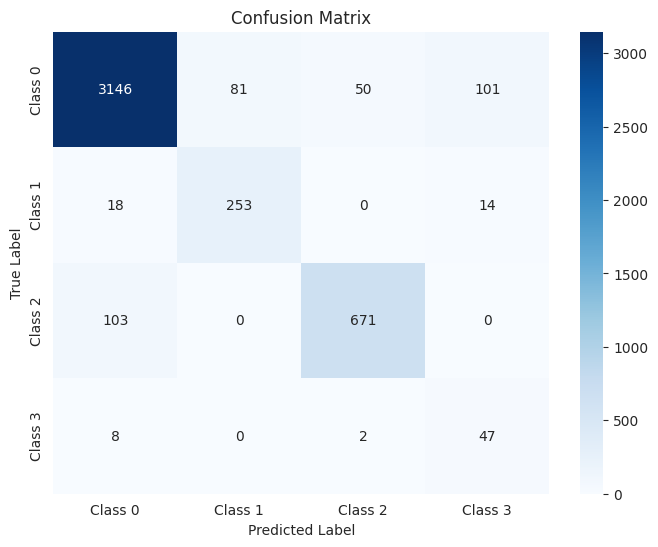

The function took 0.3038 seconds to execute.
[ARCH#025-[32, 8, 8]] done in 29.2s  best-val=0.2310


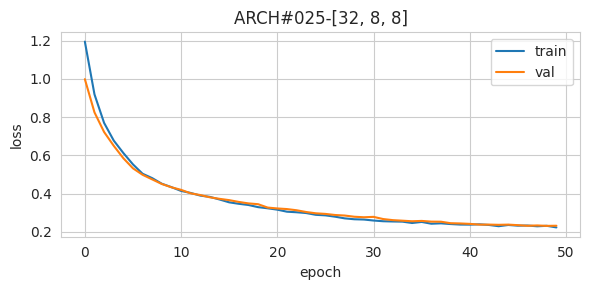


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.98      0.87      0.93      2475
     Class 3       0.13      0.98      0.24       182

    accuracy                           0.89     14379
   macro avg       0.71      0.92      0.73     14379
weighted avg       0.96      0.89      0.92     14379



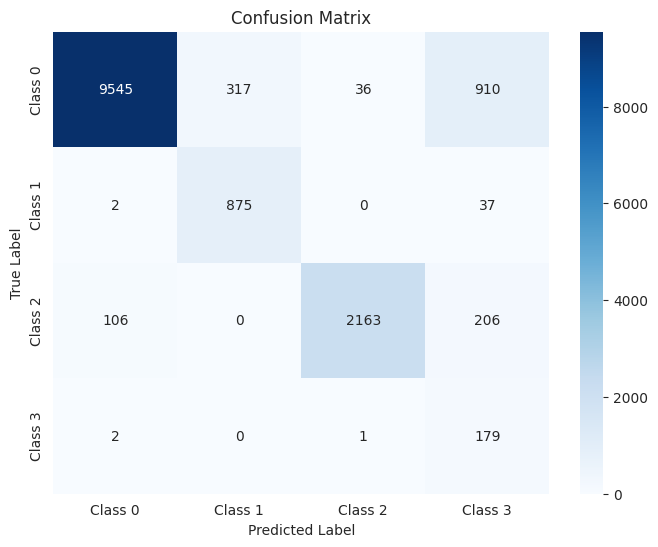

The function took 0.5146 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.13      1.00      0.24        46

    accuracy                           0.89      3595
   macro avg       0.71      0.93      0.73      3595
weighted avg       0.96      0.89      0.92      3595



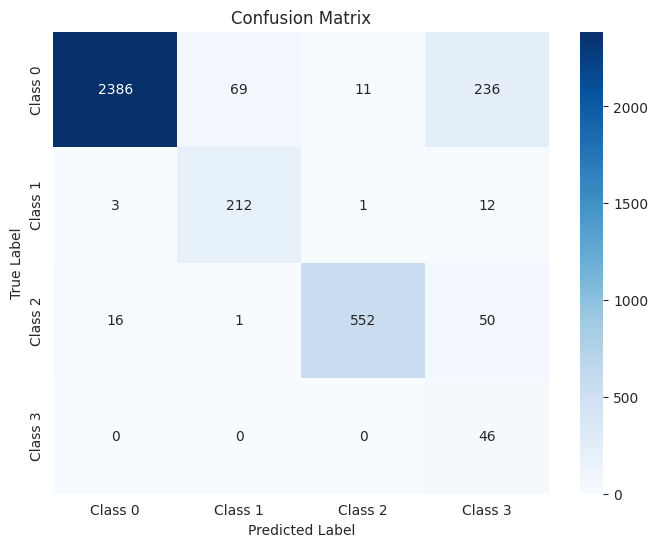

The function took 0.3168 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.93      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.14      0.96      0.24        57

    accuracy                           0.89      4494
   macro avg       0.71      0.91      0.73      4494
weighted avg       0.96      0.89      0.91      4494



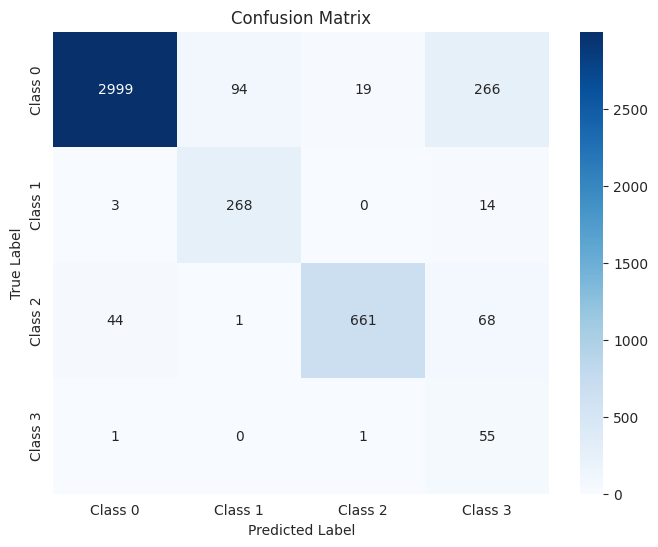

The function took 0.3144 seconds to execute.
[ARCH#026-[32, 8, 4]] done in 29.1s  best-val=0.2695


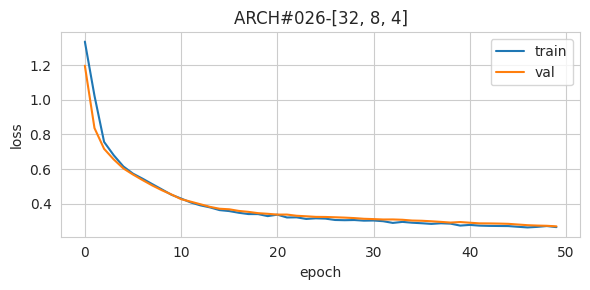


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.84      0.91     10808
     Class 1       0.70      0.96      0.81       914
     Class 2       0.93      0.94      0.93      2475
     Class 3       0.11      0.93      0.20       182

    accuracy                           0.87     14379
   macro avg       0.68      0.92      0.71     14379
weighted avg       0.96      0.87      0.90     14379



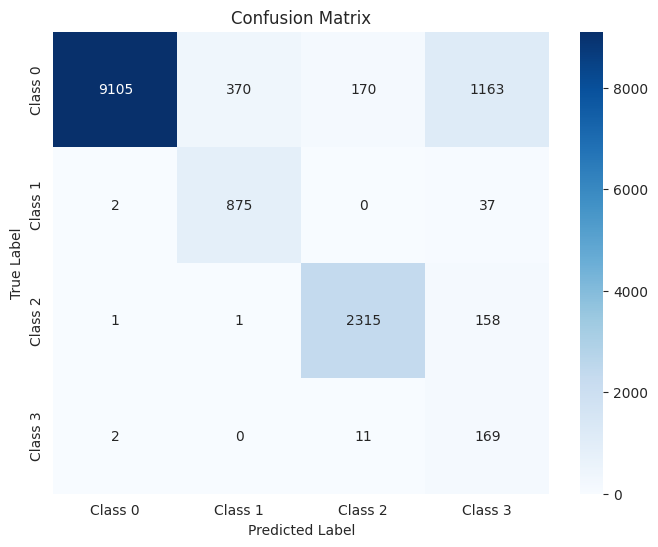

The function took 0.7197 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.85      0.92      2702
     Class 1       0.72      0.93      0.81       228
     Class 2       0.91      0.95      0.93       619
     Class 3       0.11      0.91      0.20        46

    accuracy                           0.87      3595
   macro avg       0.69      0.91      0.71      3595
weighted avg       0.95      0.87      0.90      3595



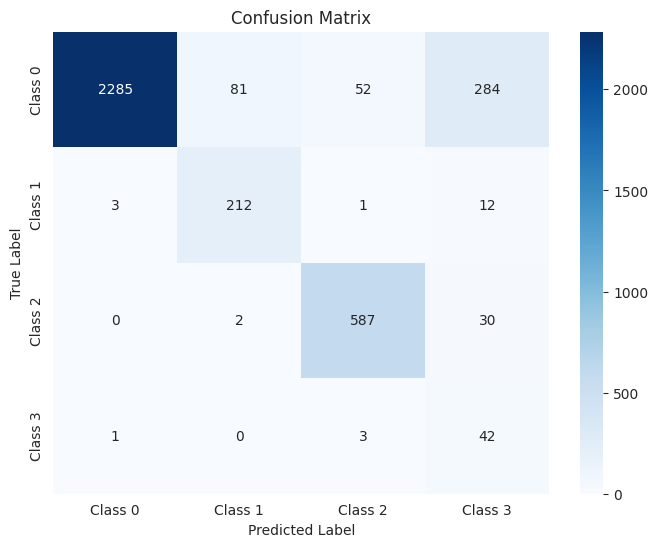

The function took 0.4279 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.84      0.91      3378
     Class 1       0.70      0.94      0.80       285
     Class 2       0.92      0.93      0.93       774
     Class 3       0.11      0.93      0.20        57

    accuracy                           0.87      4494
   macro avg       0.68      0.91      0.71      4494
weighted avg       0.95      0.87      0.90      4494



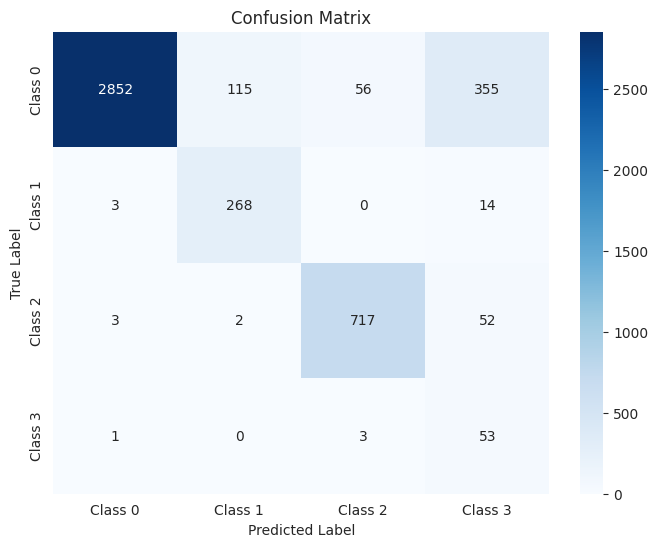

The function took 0.4475 seconds to execute.
[ARCH#027-[32, 8, 2]] done in 29.5s  best-val=0.3299


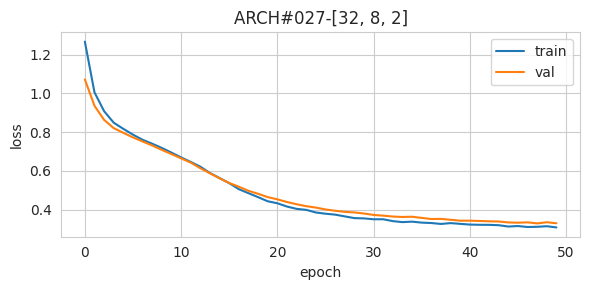


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.84      0.91     10808
     Class 1       0.71      0.96      0.82       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.09      0.96      0.17       182

    accuracy                           0.86     14379
   macro avg       0.70      0.91      0.71     14379
weighted avg       0.97      0.86      0.90     14379



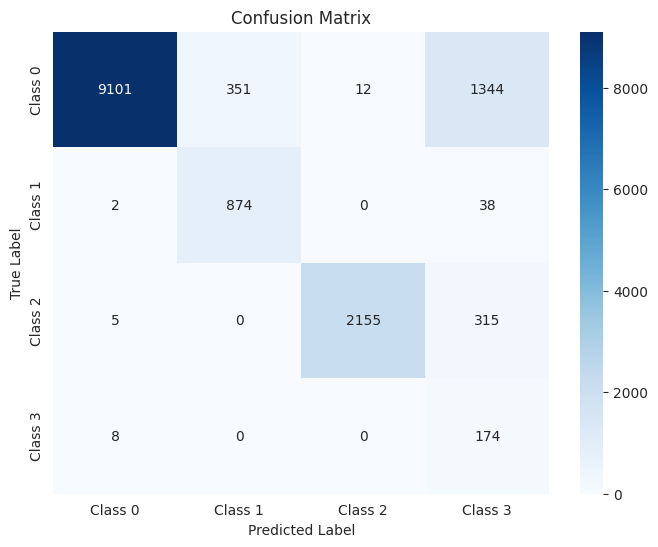

The function took 0.5074 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.85      0.92      2702
     Class 1       0.73      0.93      0.82       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.10      0.96      0.18        46

    accuracy                           0.86      3595
   macro avg       0.70      0.91      0.71      3595
weighted avg       0.97      0.86      0.90      3595



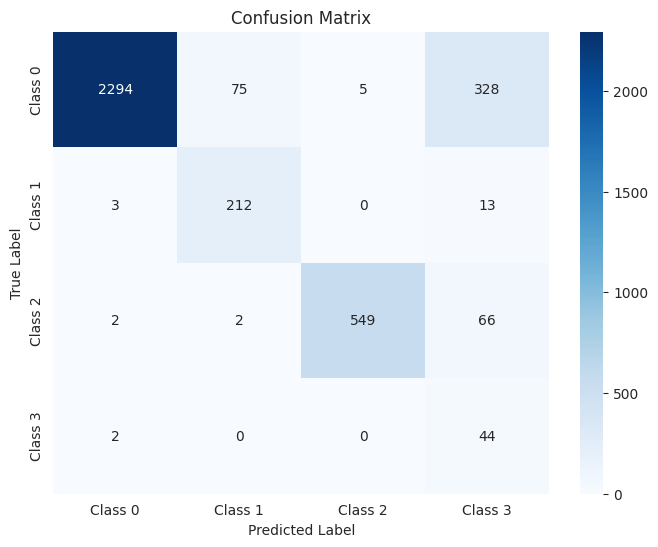

The function took 0.3251 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.84      0.91      3378
     Class 1       0.71      0.93      0.81       285
     Class 2       0.99      0.85      0.92       774
     Class 3       0.09      0.95      0.17        57

    accuracy                           0.85      4494
   macro avg       0.70      0.89      0.70      4494
weighted avg       0.97      0.85      0.90      4494



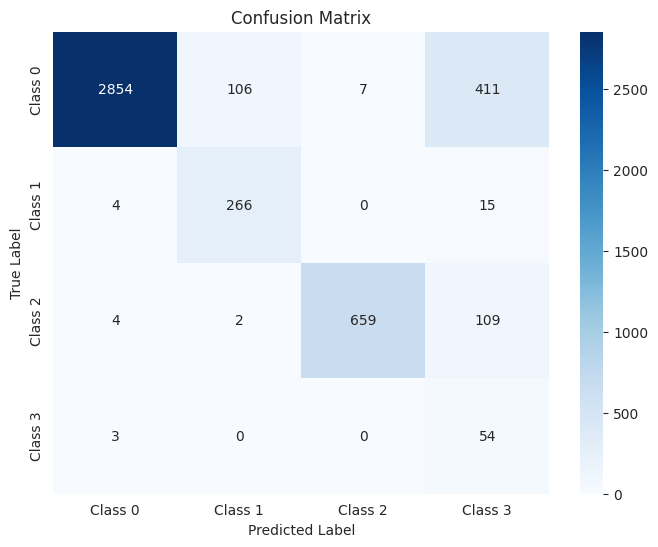

The function took 0.3070 seconds to execute.
[ARCH#028-[32, 4, 4]] done in 29.0s  best-val=0.2654


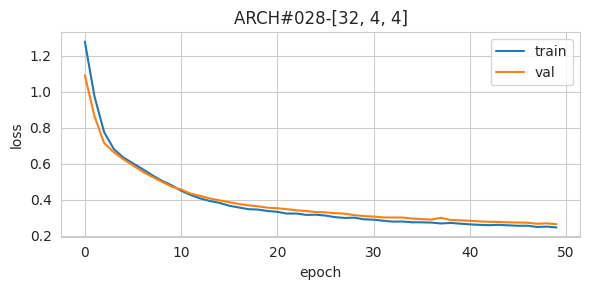


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.74      0.96      0.84       914
     Class 2       0.89      0.96      0.92      2475
     Class 3       0.36      0.87      0.51       182

    accuracy                           0.93     14379
   macro avg       0.75      0.93      0.81     14379
weighted avg       0.95      0.93      0.94     14379



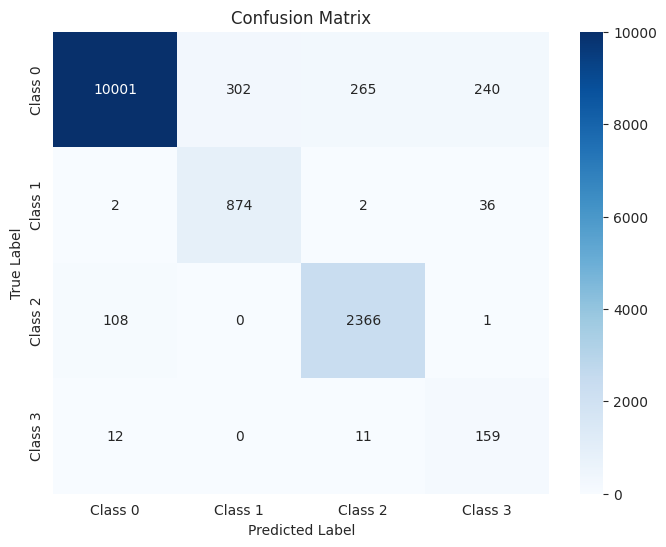

The function took 0.5149 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.96      2702
     Class 1       0.76      0.93      0.84       228
     Class 2       0.89      0.97      0.93       619
     Class 3       0.34      0.87      0.49        46

    accuracy                           0.93      3595
   macro avg       0.75      0.92      0.80      3595
weighted avg       0.95      0.93      0.94      3595



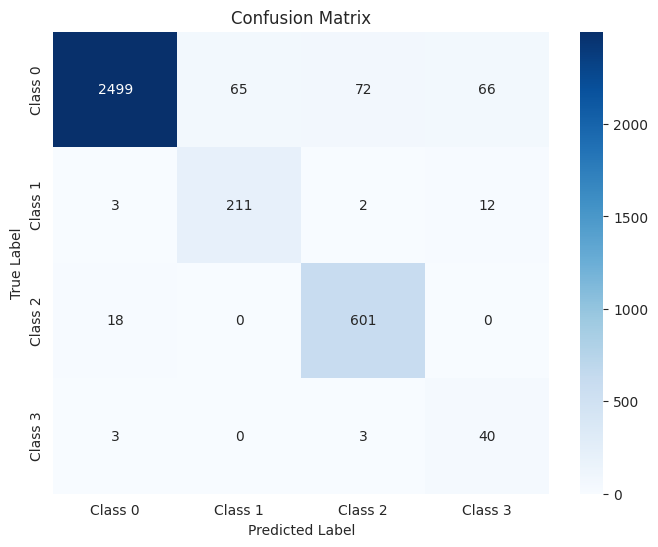

The function took 0.3293 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.75      0.93      0.83       285
     Class 2       0.90      0.94      0.92       774
     Class 3       0.38      0.86      0.52        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.81      4494
weighted avg       0.94      0.93      0.94      4494



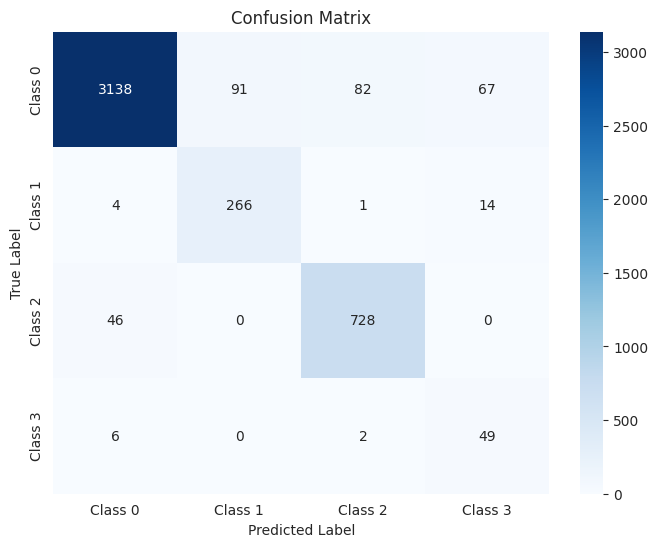

The function took 0.2984 seconds to execute.
[ARCH#029-[32, 4, 2]] done in 29.1s  best-val=0.6627


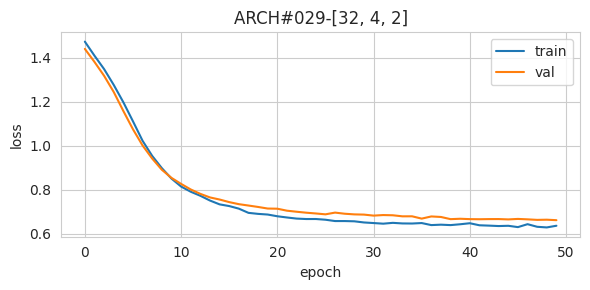


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.83      0.12      0.21     10808
     Class 1       0.73      0.86      0.79       914
     Class 2       0.20      0.89      0.32      2475
     Class 3       0.27      0.88      0.42       182

    accuracy                           0.31     14379
   macro avg       0.51      0.69      0.44     14379
weighted avg       0.71      0.31      0.27     14379



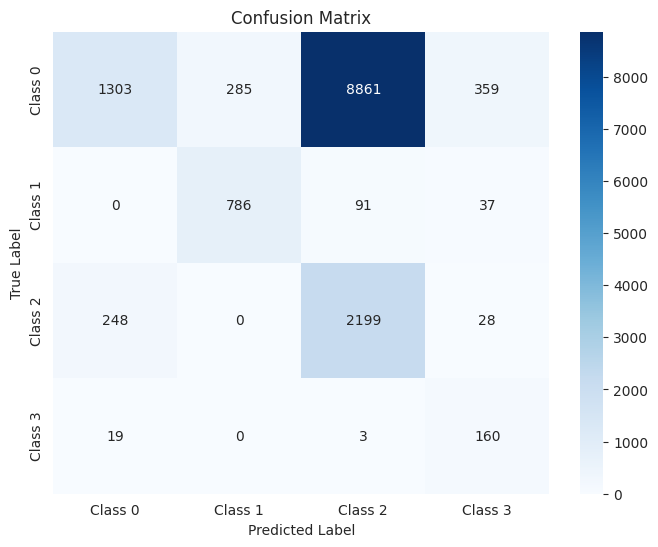

The function took 0.5524 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.84      0.12      0.21      2702
     Class 1       0.75      0.81      0.78       228
     Class 2       0.20      0.90      0.33       619
     Class 3       0.26      0.89      0.40        46

    accuracy                           0.31      3595
   macro avg       0.51      0.68      0.43      3595
weighted avg       0.72      0.31      0.27      3595



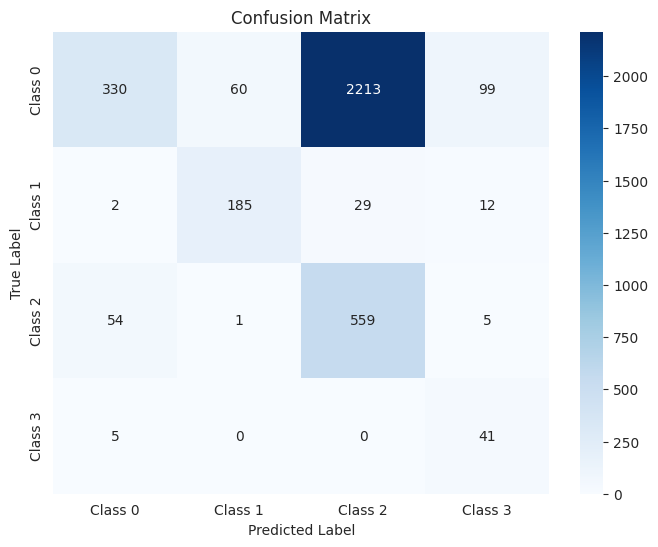

The function took 0.3460 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.80      0.12      0.21      3378
     Class 1       0.74      0.84      0.79       285
     Class 2       0.19      0.87      0.32       774
     Class 3       0.29      0.86      0.44        57

    accuracy                           0.31      4494
   macro avg       0.50      0.67      0.44      4494
weighted avg       0.68      0.31      0.27      4494



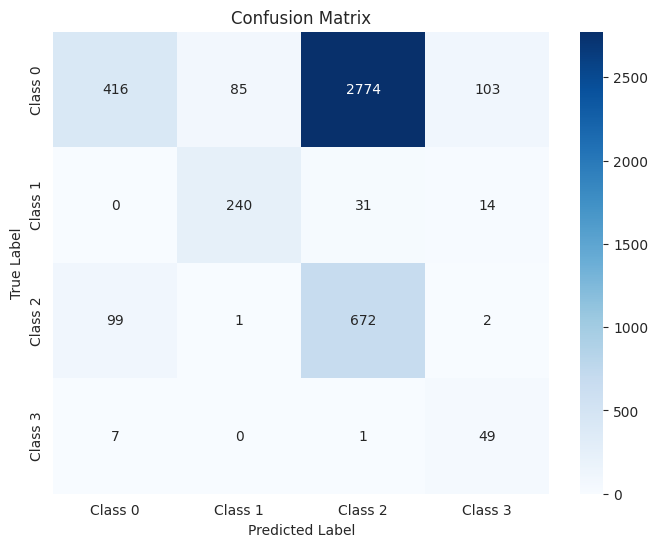

The function took 0.4650 seconds to execute.
[ARCH#030-[32, 2, 2]] done in 29.2s  best-val=0.4956


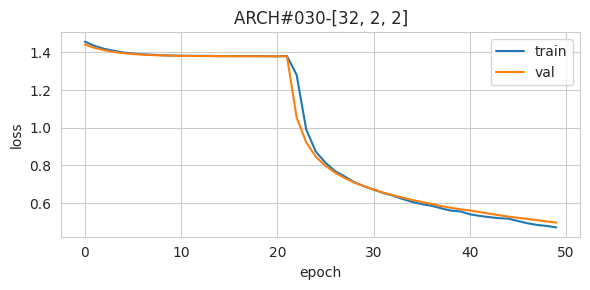


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.74      0.96      0.84       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.15      0.81      0.25       182

    accuracy                           0.91     14379
   macro avg       0.72      0.89      0.74     14379
weighted avg       0.96      0.91      0.93     14379



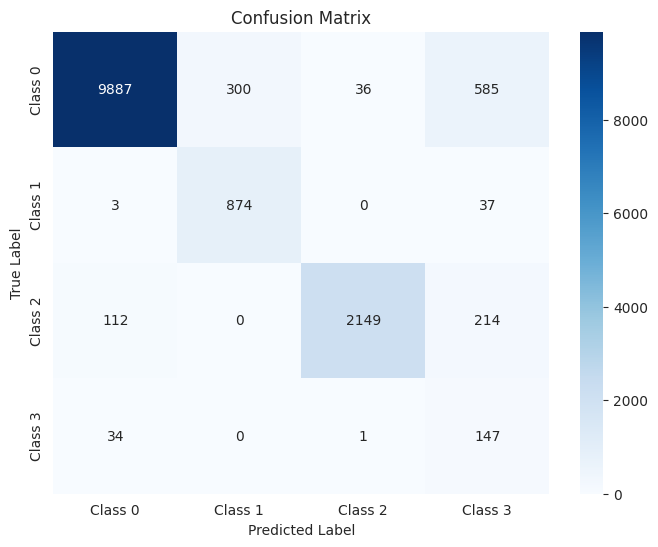

The function took 0.5106 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.12      0.74      0.21        46

    accuracy                           0.90      3595
   macro avg       0.72      0.87      0.73      3595
weighted avg       0.96      0.90      0.93      3595



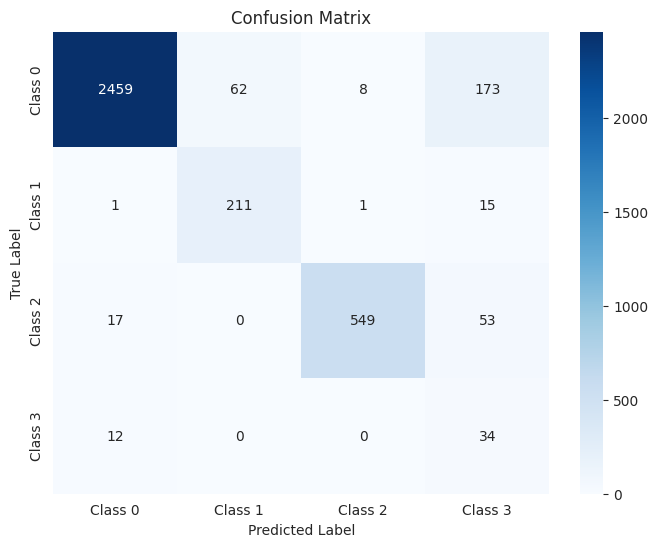

The function took 0.3530 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.73      0.93      0.82       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.15      0.77      0.25        57

    accuracy                           0.91      4494
   macro avg       0.71      0.87      0.73      4494
weighted avg       0.95      0.91      0.92      4494



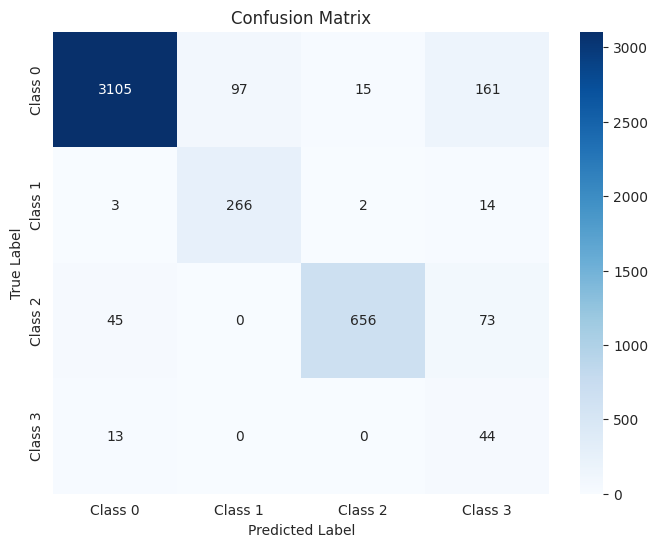

The function took 0.3165 seconds to execute.
[ARCH#031-[16, 16, 16]] done in 28.7s  best-val=0.2233


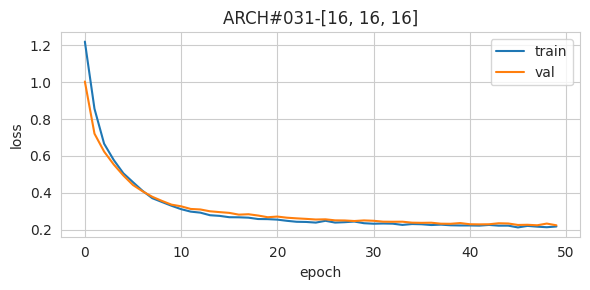


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.84      0.95      0.89      2475
     Class 3       0.23      0.95      0.37       182

    accuracy                           0.91     14379
   macro avg       0.71      0.94      0.76     14379
weighted avg       0.94      0.91      0.92     14379



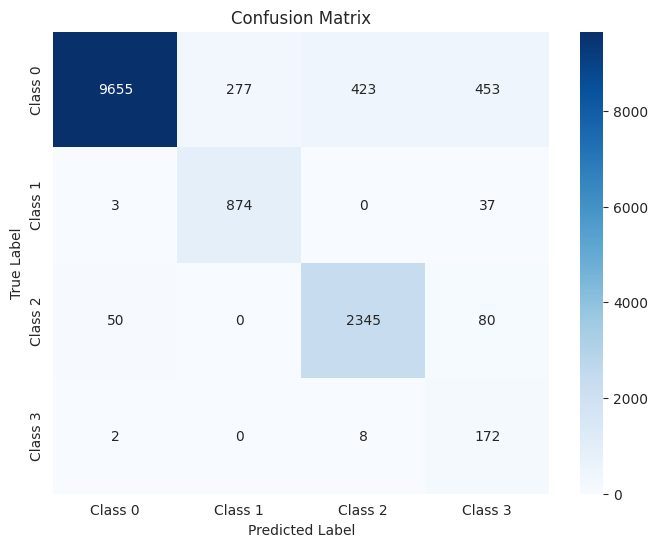

The function took 0.4930 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.85      0.95      0.90       619
     Class 3       0.23      0.93      0.36        46

    accuracy                           0.91      3595
   macro avg       0.71      0.93      0.76      3595
weighted avg       0.94      0.91      0.92      3595



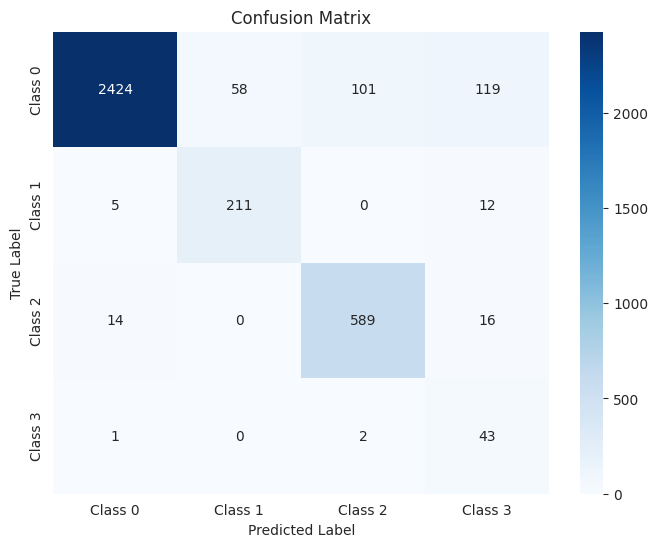

The function took 0.3272 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.84      0.95      0.89       774
     Class 3       0.25      0.91      0.39        57

    accuracy                           0.91      4494
   macro avg       0.71      0.92      0.77      4494
weighted avg       0.94      0.91      0.92      4494



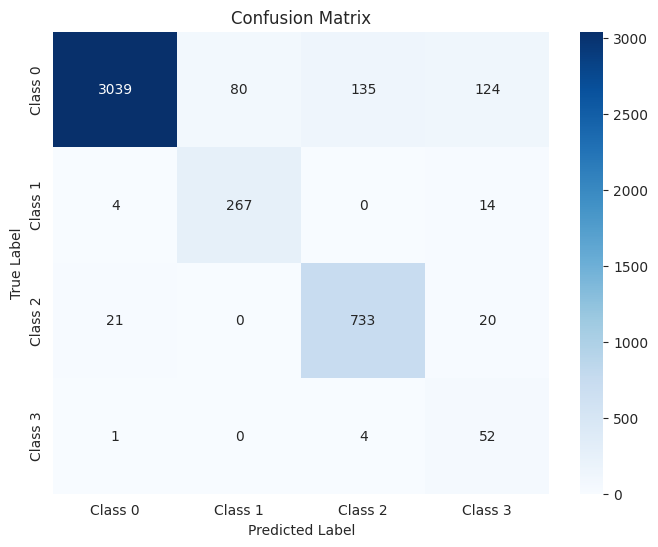

The function took 0.3162 seconds to execute.
[ARCH#032-[16, 16, 8]] done in 29.4s  best-val=0.2312


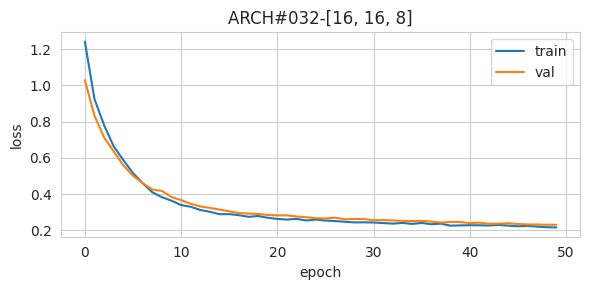


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.82      0.95      0.88      2475
     Class 3       0.37      0.88      0.52       182

    accuracy                           0.92     14379
   macro avg       0.73      0.92      0.80     14379
weighted avg       0.94      0.92      0.92     14379



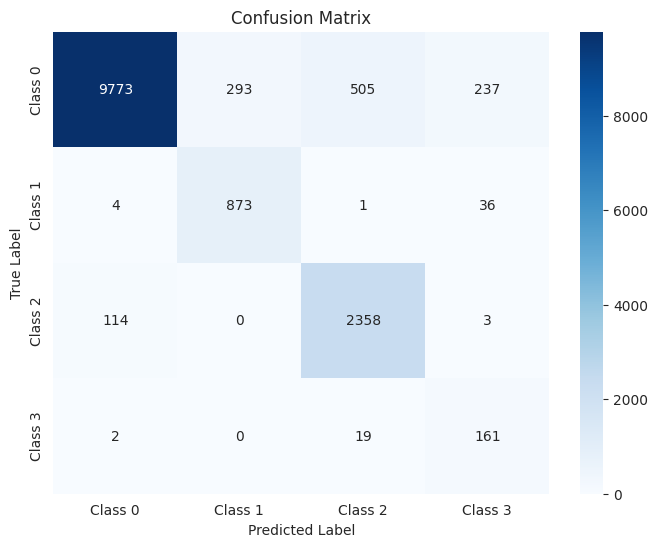

The function took 0.5199 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.81      0.97      0.88       619
     Class 3       0.32      0.87      0.47        46

    accuracy                           0.91      3595
   macro avg       0.72      0.92      0.78      3595
weighted avg       0.94      0.91      0.92      3595



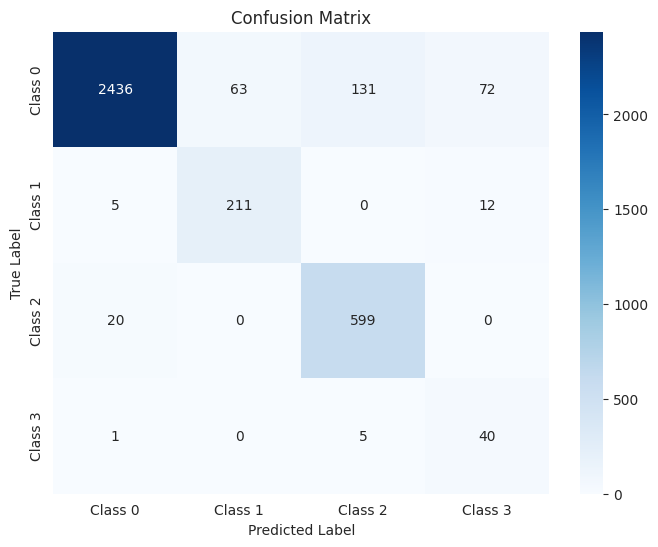

The function took 0.3175 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.75      0.94      0.84       285
     Class 2       0.83      0.94      0.88       774
     Class 3       0.38      0.84      0.52        57

    accuracy                           0.92      4494
   macro avg       0.73      0.91      0.79      4494
weighted avg       0.93      0.92      0.92      4494



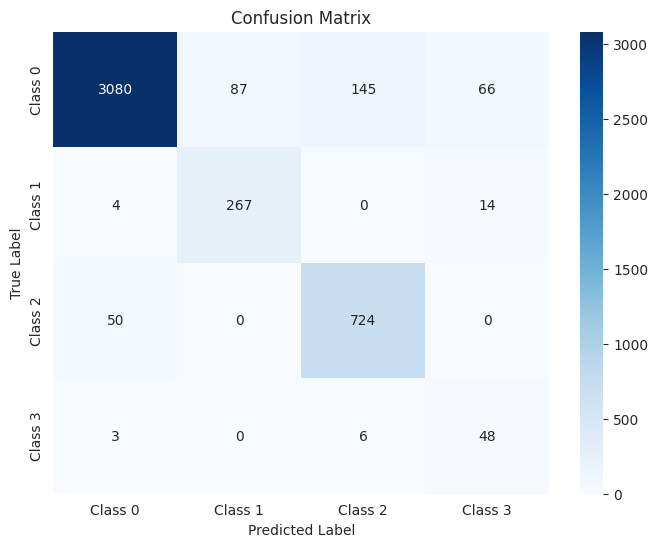

The function took 0.3142 seconds to execute.
[ARCH#033-[16, 16, 4]] done in 29.4s  best-val=0.2766


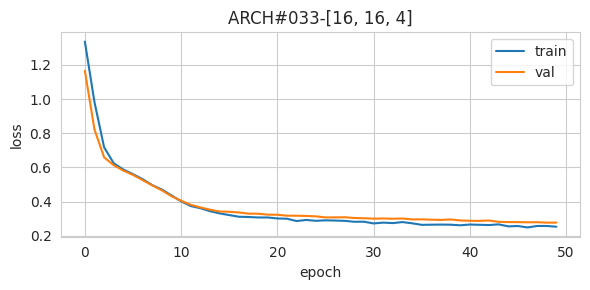


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.84      0.94      0.89      2475
     Class 3       0.35      0.88      0.50       182

    accuracy                           0.92     14379
   macro avg       0.73      0.92      0.80     14379
weighted avg       0.94      0.92      0.92     14379



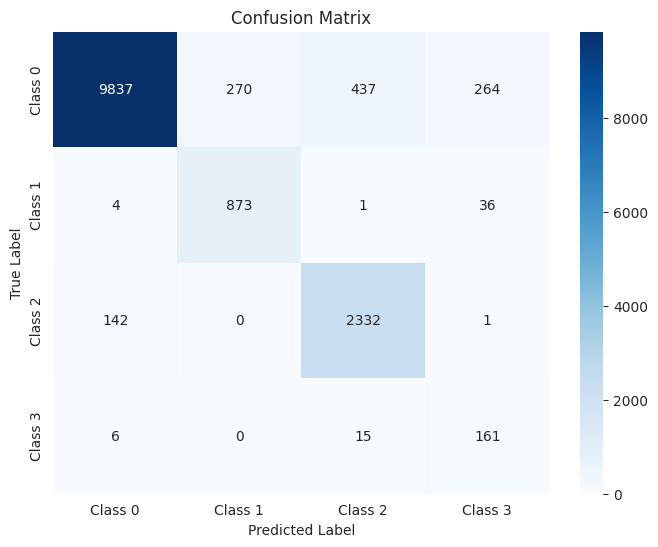

The function took 0.7491 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.82      0.96      0.89       619
     Class 3       0.33      0.89      0.49        46

    accuracy                           0.92      3595
   macro avg       0.73      0.92      0.79      3595
weighted avg       0.94      0.92      0.92      3595



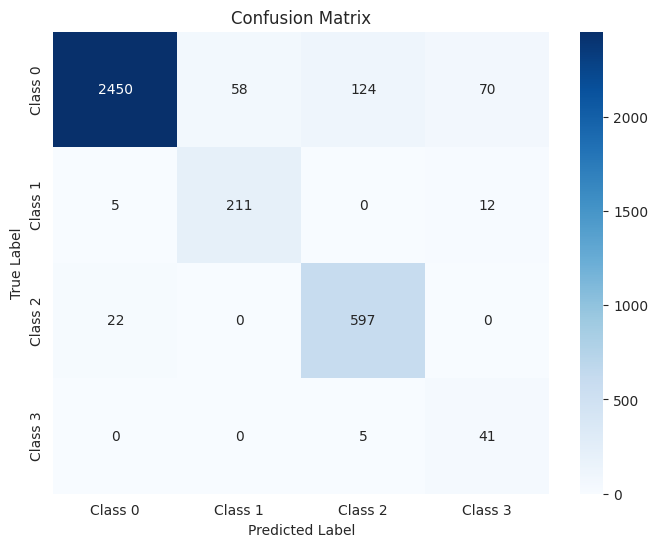

The function took 0.4263 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.76      0.93      0.84       285
     Class 2       0.85      0.93      0.89       774
     Class 3       0.35      0.89      0.51        57

    accuracy                           0.92      4494
   macro avg       0.74      0.92      0.80      4494
weighted avg       0.94      0.92      0.92      4494



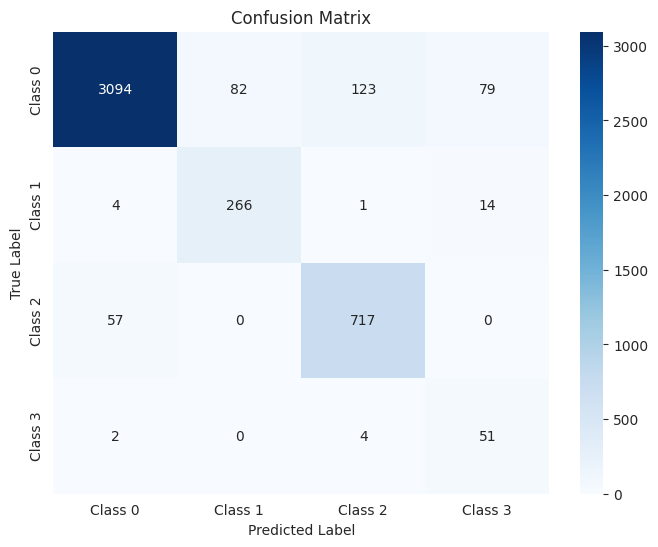

The function took 0.4591 seconds to execute.
[ARCH#034-[16, 16, 2]] done in 29.0s  best-val=0.6226


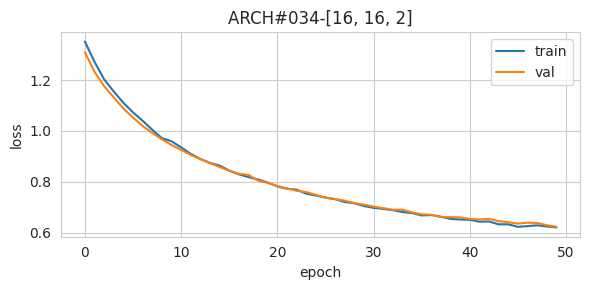


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.83      0.90     10808
     Class 1       0.31      0.95      0.46       914
     Class 2       0.92      0.95      0.93      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.85     14379
   macro avg       0.56      0.68      0.58     14379
weighted avg       0.93      0.85      0.87     14379



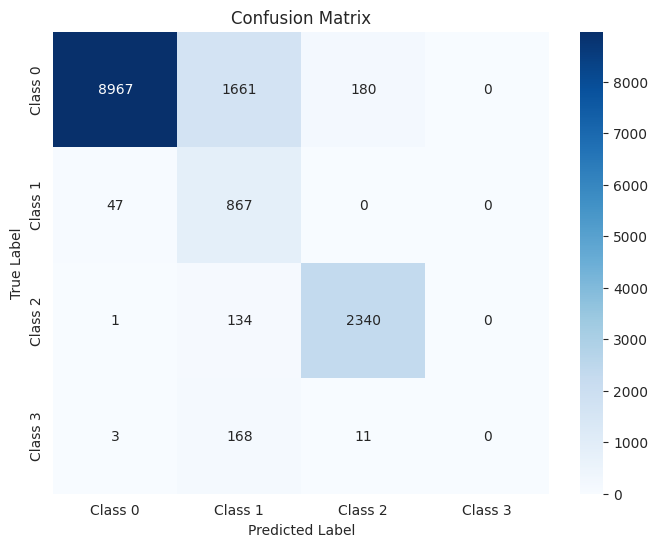

The function took 0.5146 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.84      0.91      2702
     Class 1       0.32      0.93      0.48       228
     Class 2       0.91      0.96      0.94       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.85      3595
   macro avg       0.56      0.68      0.58      3595
weighted avg       0.92      0.85      0.87      3595



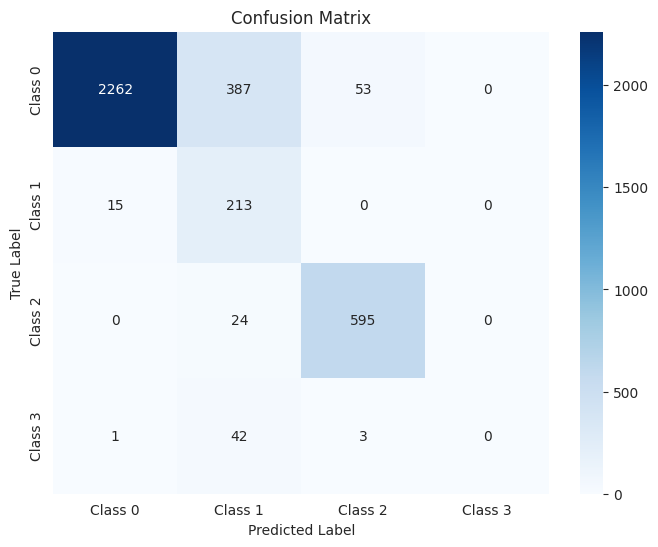

The function took 0.3757 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.83      0.91      3378
     Class 1       0.30      0.94      0.46       285
     Class 2       0.94      0.94      0.94       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.85      4494
   macro avg       0.56      0.68      0.57      4494
weighted avg       0.93      0.85      0.87      4494



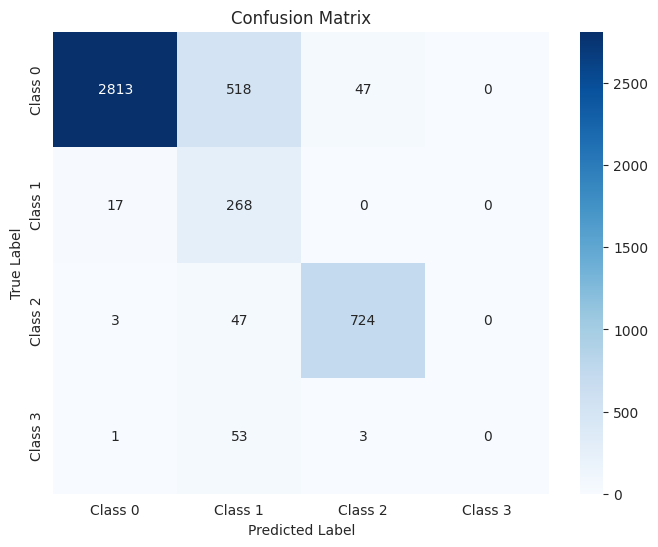

The function took 0.3114 seconds to execute.
[ARCH#035-[16, 8, 8]] done in 29.0s  best-val=0.2337


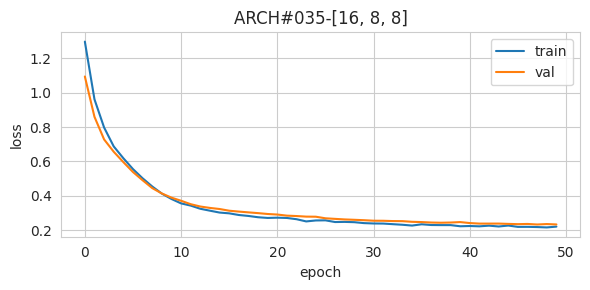


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.89      0.96      0.92      2475
     Class 3       0.37      0.88      0.53       182

    accuracy                           0.93     14379
   macro avg       0.75      0.93      0.81     14379
weighted avg       0.95      0.93      0.94     14379



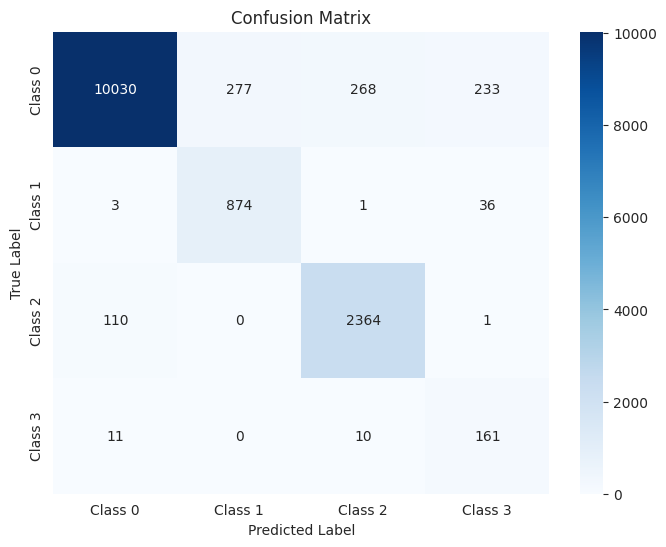

The function took 0.5459 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.96      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.88      0.97      0.92       619
     Class 3       0.34      0.87      0.49        46

    accuracy                           0.93      3595
   macro avg       0.75      0.92      0.80      3595
weighted avg       0.95      0.93      0.94      3595



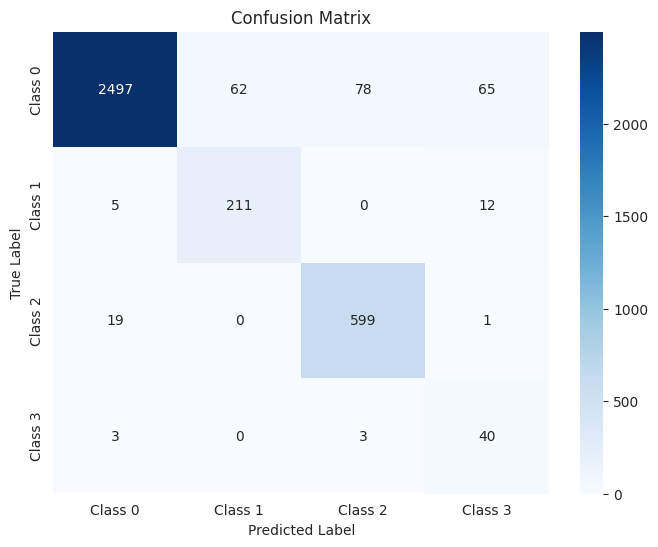

The function took 0.3114 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.89      0.94      0.92       774
     Class 3       0.39      0.86      0.53        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.81      4494
weighted avg       0.95      0.93      0.94      4494



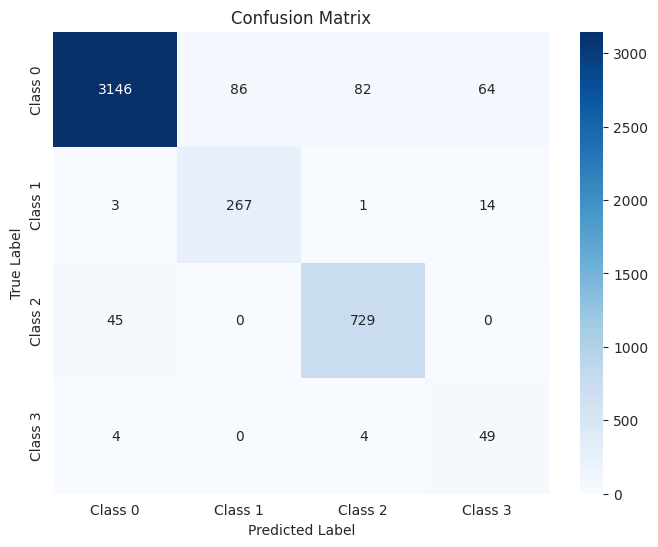

The function took 0.3237 seconds to execute.
[ARCH#036-[16, 8, 4]] done in 28.9s  best-val=0.2337


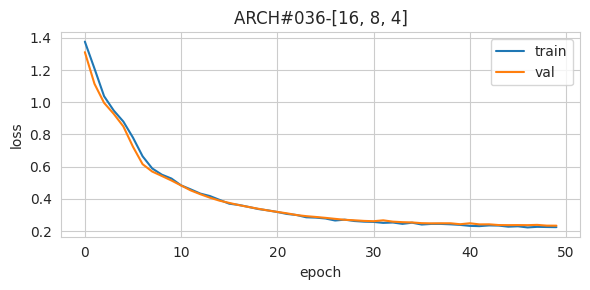


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.94      0.91      0.93      2475
     Class 3       0.22      0.94      0.35       182

    accuracy                           0.92     14379
   macro avg       0.72      0.93      0.76     14379
weighted avg       0.95      0.92      0.93     14379



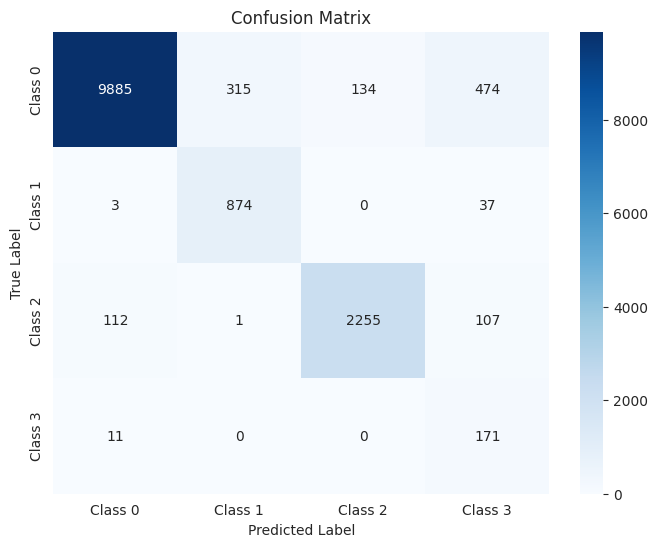

The function took 0.7555 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.74      0.93      0.83       228
     Class 2       0.93      0.93      0.93       619
     Class 3       0.20      0.89      0.33        46

    accuracy                           0.92      3595
   macro avg       0.72      0.92      0.76      3595
weighted avg       0.95      0.92      0.93      3595



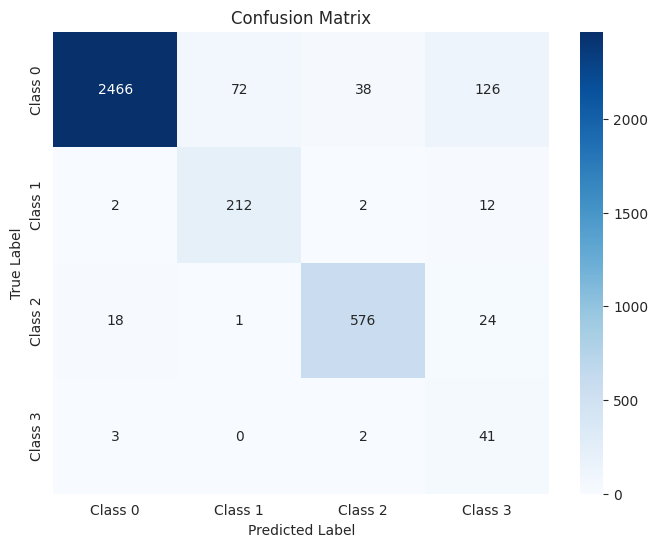

The function took 0.4344 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.93      0.90      0.92       774
     Class 3       0.22      0.88      0.35        57

    accuracy                           0.92      4494
   macro avg       0.72      0.91      0.76      4494
weighted avg       0.95      0.92      0.93      4494



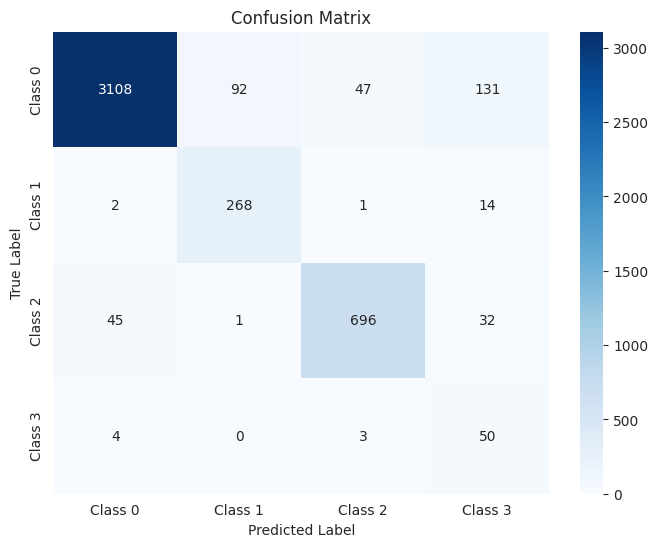

The function took 0.4497 seconds to execute.
[ARCH#037-[16, 8, 2]] done in 29.2s  best-val=0.3646


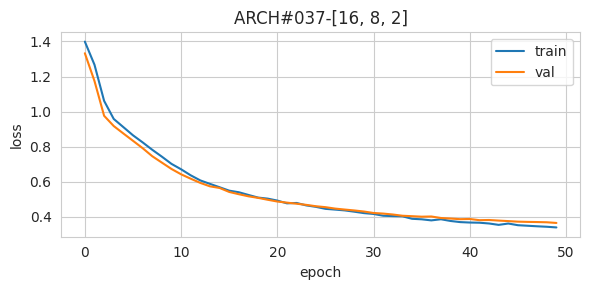


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95     10808
     Class 1       0.73      0.95      0.82       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.26      0.87      0.40       182

    accuracy                           0.92     14379
   macro avg       0.73      0.91      0.77     14379
weighted avg       0.95      0.92      0.93     14379



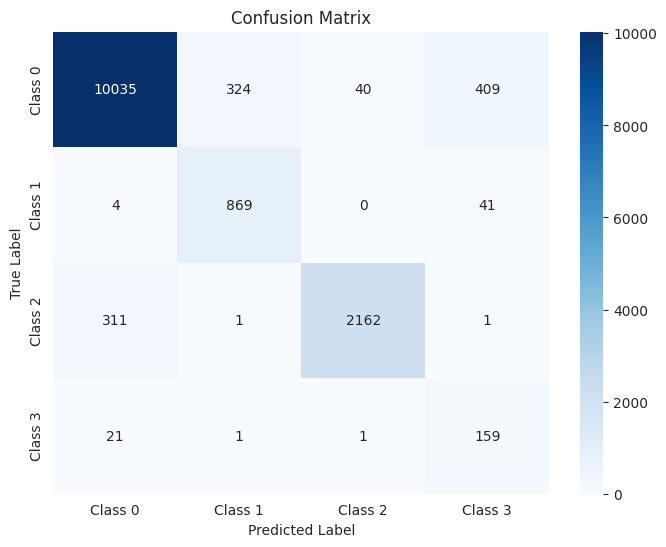

The function took 0.5062 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95      2702
     Class 1       0.75      0.92      0.83       228
     Class 2       0.97      0.89      0.93       619
     Class 3       0.25      0.87      0.39        46

    accuracy                           0.92      3595
   macro avg       0.74      0.90      0.77      3595
weighted avg       0.95      0.92      0.93      3595



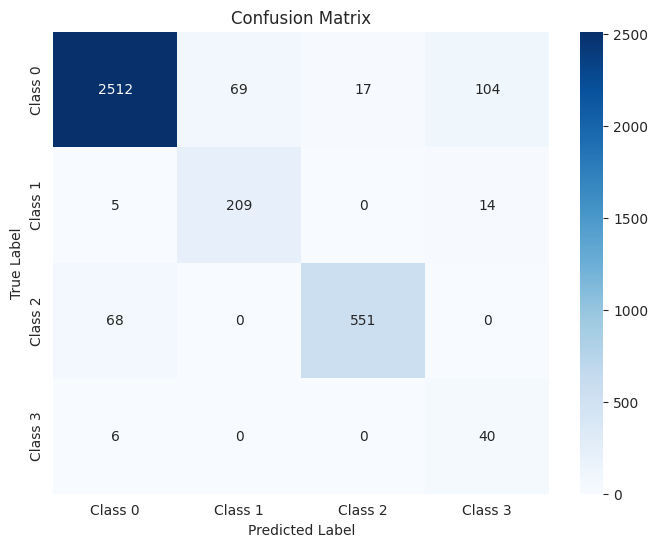

The function took 0.3669 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.92      0.94      3378
     Class 1       0.72      0.93      0.81       285
     Class 2       0.96      0.85      0.90       774
     Class 3       0.24      0.82      0.37        57

    accuracy                           0.91      4494
   macro avg       0.72      0.88      0.76      4494
weighted avg       0.94      0.91      0.92      4494



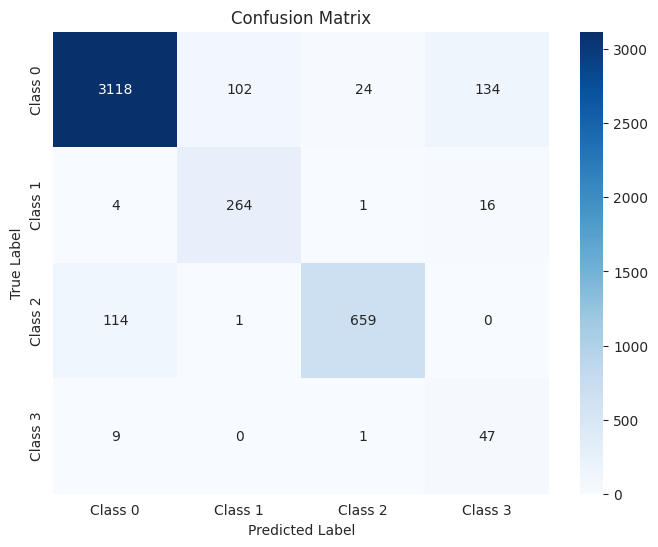

The function took 0.3285 seconds to execute.
[ARCH#038-[16, 4, 4]] done in 28.8s  best-val=0.2648


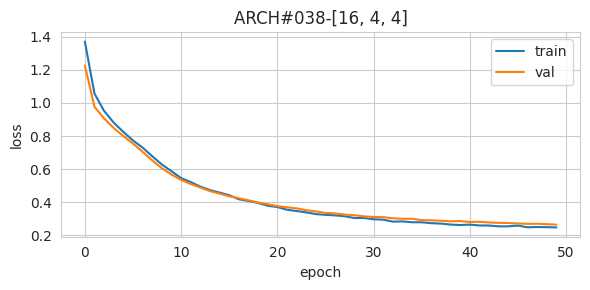


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.71      0.96      0.82       914
     Class 2       0.90      0.91      0.90      2475
     Class 3       0.23      0.92      0.36       182

    accuracy                           0.91     14379
   macro avg       0.71      0.92      0.76     14379
weighted avg       0.95      0.91      0.92     14379



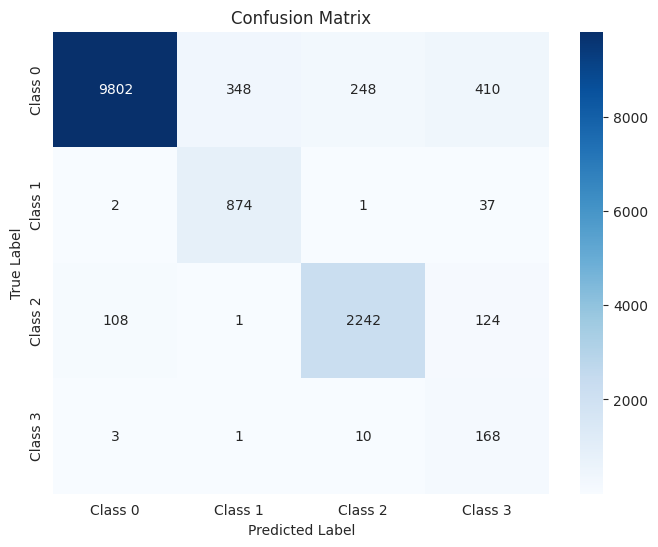

The function took 0.5014 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.74      0.93      0.82       228
     Class 2       0.90      0.92      0.91       619
     Class 3       0.21      0.91      0.34        46

    accuracy                           0.91      3595
   macro avg       0.71      0.92      0.75      3595
weighted avg       0.95      0.91      0.93      3595



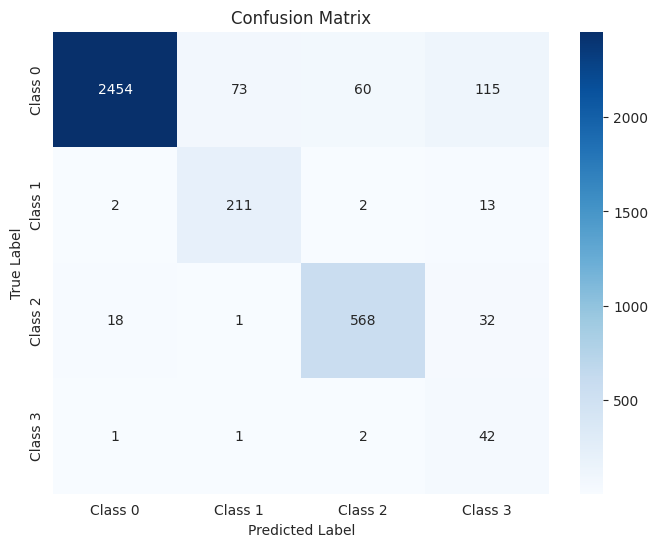

The function took 0.3603 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.72      0.94      0.81       285
     Class 2       0.88      0.90      0.89       774
     Class 3       0.23      0.86      0.37        57

    accuracy                           0.91      4494
   macro avg       0.70      0.90      0.75      4494
weighted avg       0.94      0.91      0.92      4494



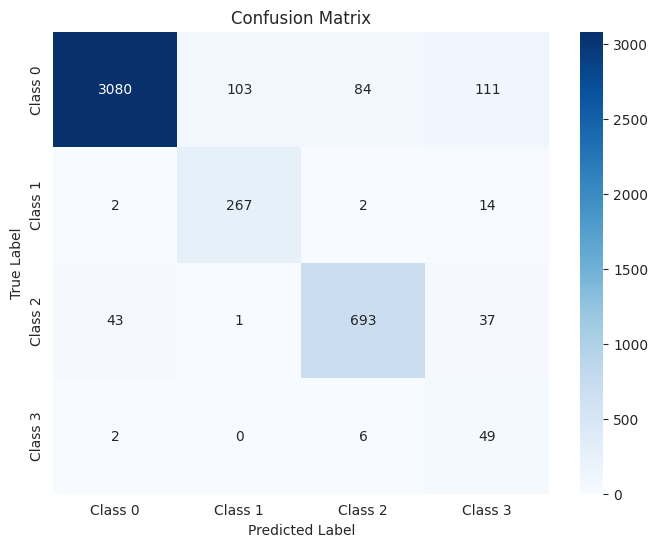

The function took 0.3189 seconds to execute.
[ARCH#039-[16, 4, 2]] done in 28.9s  best-val=0.5925


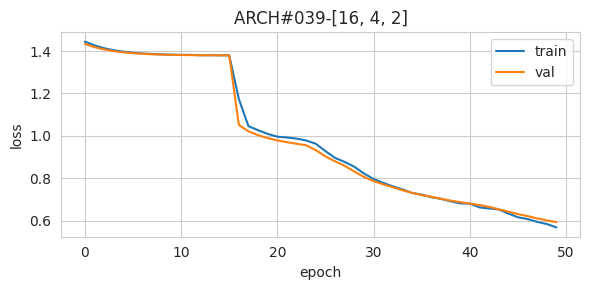


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.63      0.77     10808
     Class 1       0.51      0.96      0.67       914
     Class 2       0.94      0.86      0.90      2475
     Class 3       0.05      0.95      0.09       182

    accuracy                           0.69     14379
   macro avg       0.62      0.85      0.61     14379
weighted avg       0.93      0.69      0.78     14379



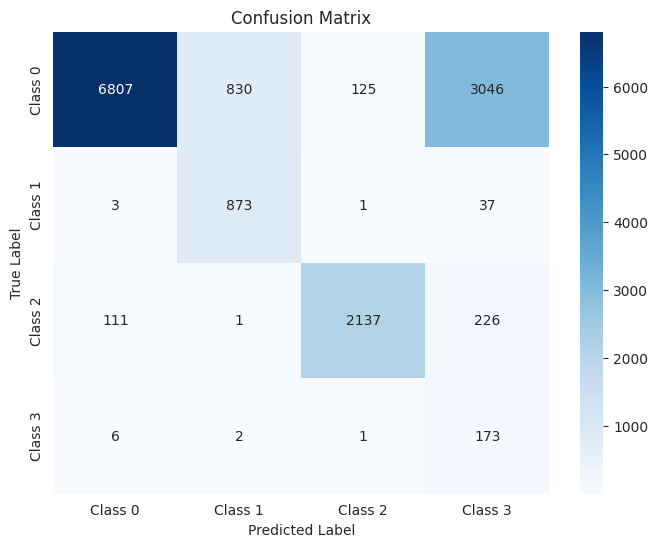

The function took 0.5092 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.62      0.76      2702
     Class 1       0.51      0.93      0.66       228
     Class 2       0.95      0.88      0.91       619
     Class 3       0.05      0.96      0.09        46

    accuracy                           0.69      3595
   macro avg       0.62      0.85      0.61      3595
weighted avg       0.94      0.69      0.77      3595



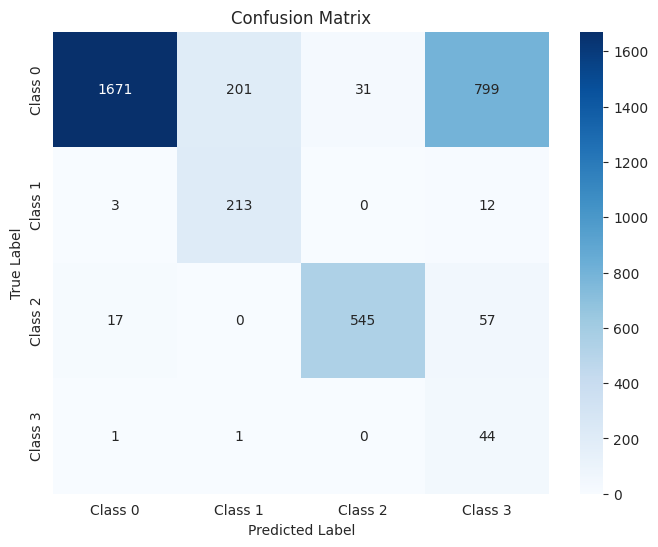

The function took 0.3876 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.63      0.77      3378
     Class 1       0.47      0.93      0.63       285
     Class 2       0.94      0.84      0.89       774
     Class 3       0.05      0.89      0.09        57

    accuracy                           0.69      4494
   macro avg       0.61      0.83      0.59      4494
weighted avg       0.93      0.69      0.77      4494



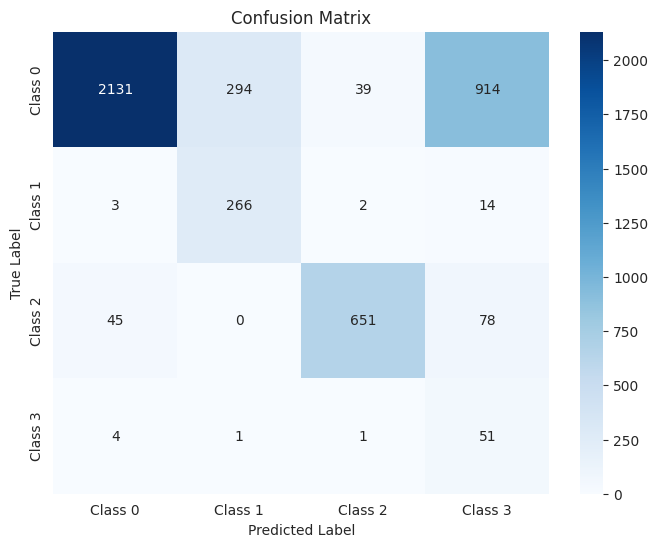

The function took 0.6346 seconds to execute.
[ARCH#040-[16, 2, 2]] done in 29.8s  best-val=0.5658


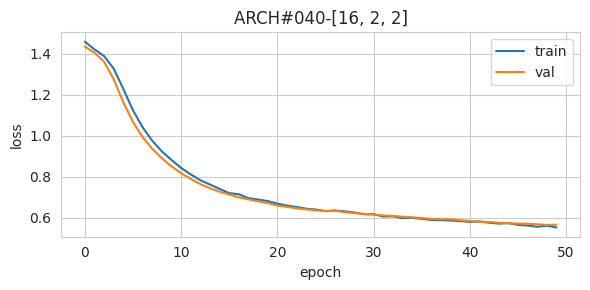


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.95     10808
     Class 1       0.71      0.86      0.78       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.23      0.84      0.37       182

    accuracy                           0.91     14379
   macro avg       0.73      0.87      0.75     14379
weighted avg       0.94      0.91      0.92     14379



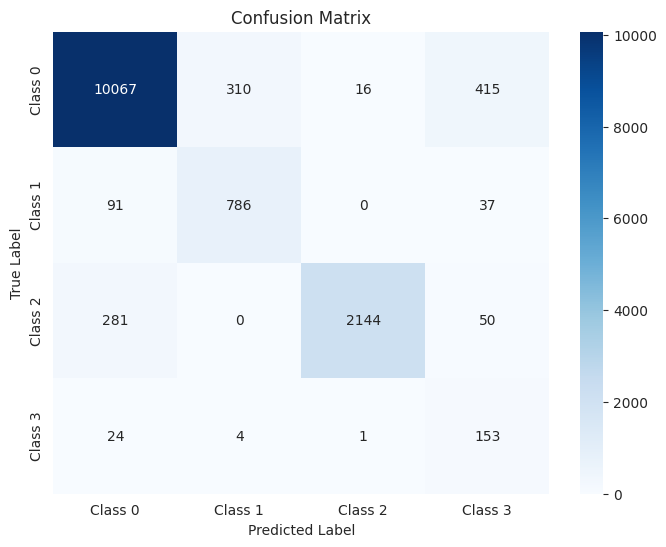

The function took 0.6298 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.95      2702
     Class 1       0.73      0.81      0.77       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.22      0.83      0.35        46

    accuracy                           0.92      3595
   macro avg       0.73      0.86      0.75      3595
weighted avg       0.94      0.92      0.93      3595



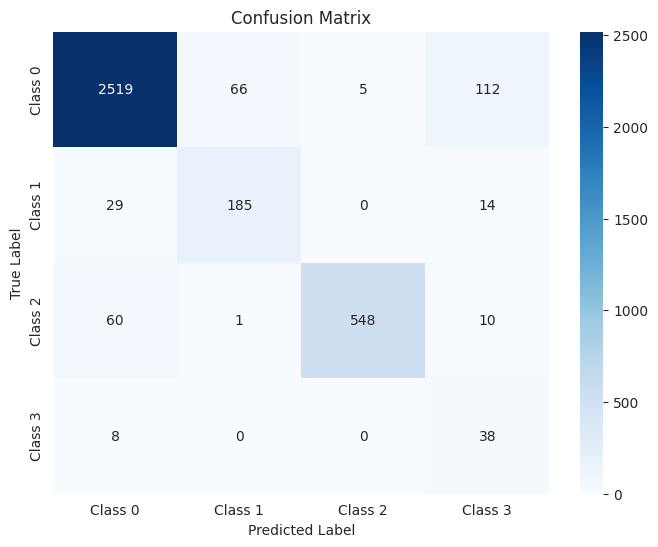

The function took 0.3410 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.94      0.94      3378
     Class 1       0.72      0.84      0.77       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.24      0.79      0.37        57

    accuracy                           0.91      4494
   macro avg       0.72      0.85      0.75      4494
weighted avg       0.94      0.91      0.92      4494



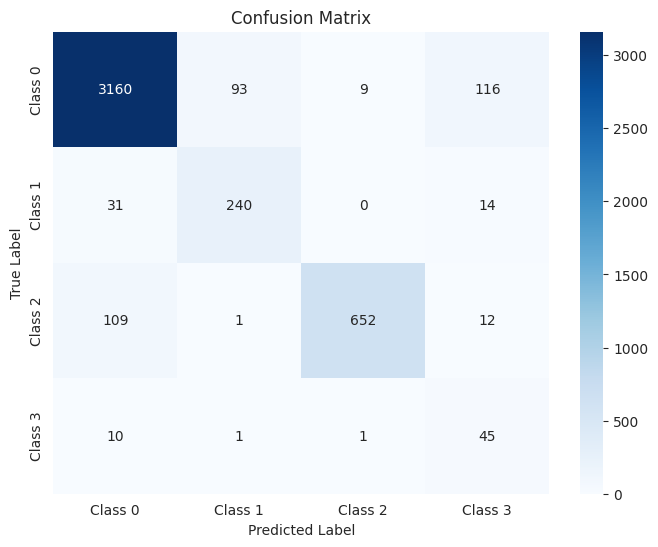

The function took 0.3341 seconds to execute.
[ARCH#041-[8, 8, 8]] done in 28.9s  best-val=0.2523


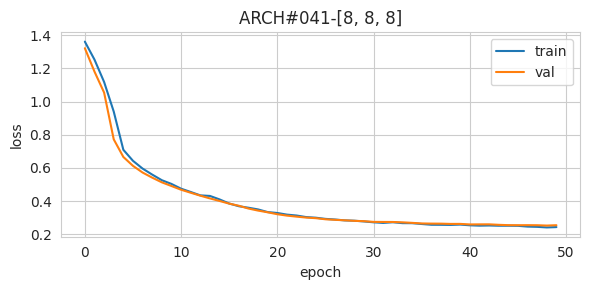


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.71      0.96      0.82       914
     Class 2       0.91      0.93      0.92      2475
     Class 3       0.20      0.89      0.32       182

    accuracy                           0.91     14379
   macro avg       0.70      0.92      0.75     14379
weighted avg       0.95      0.91      0.92     14379



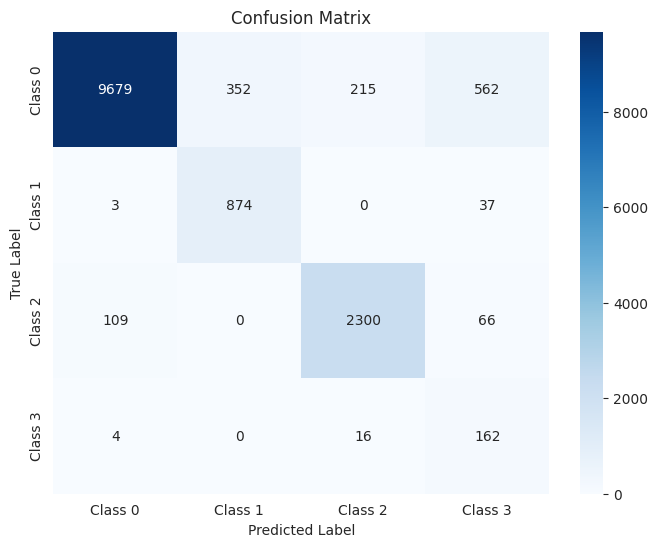

The function took 0.5361 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.72      0.93      0.81       228
     Class 2       0.91      0.95      0.93       619
     Class 3       0.18      0.89      0.30        46

    accuracy                           0.90      3595
   macro avg       0.70      0.92      0.75      3595
weighted avg       0.95      0.90      0.92      3595



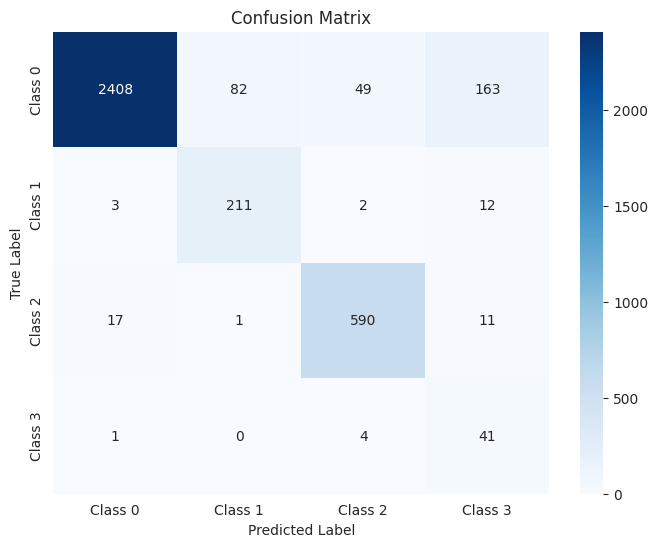

The function took 0.3617 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.90      0.94      3378
     Class 1       0.70      0.93      0.80       285
     Class 2       0.89      0.92      0.90       774
     Class 3       0.21      0.86      0.34        57

    accuracy                           0.90      4494
   macro avg       0.70      0.90      0.75      4494
weighted avg       0.94      0.90      0.92      4494



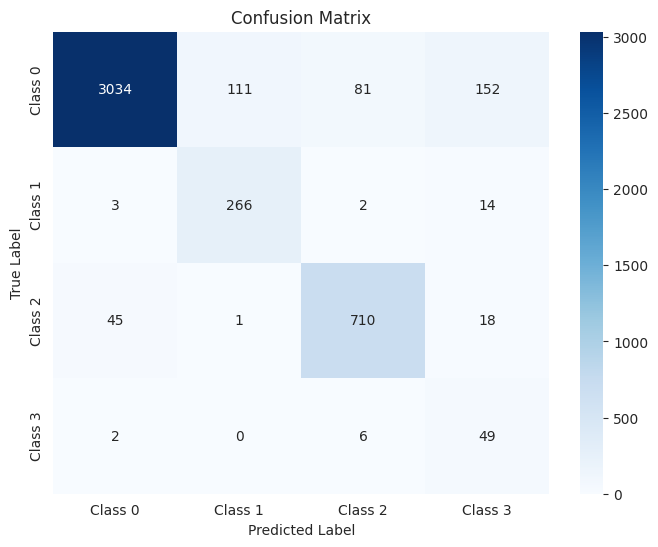

The function took 0.3295 seconds to execute.
[ARCH#042-[8, 8, 4]] done in 29.0s  best-val=0.3183


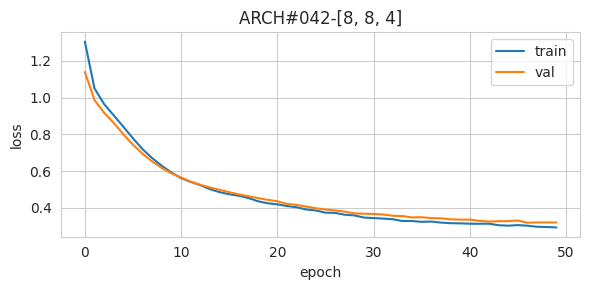


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.91      0.94     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.18      0.87      0.30       182

    accuracy                           0.90     14379
   macro avg       0.71      0.90      0.74     14379
weighted avg       0.95      0.90      0.92     14379



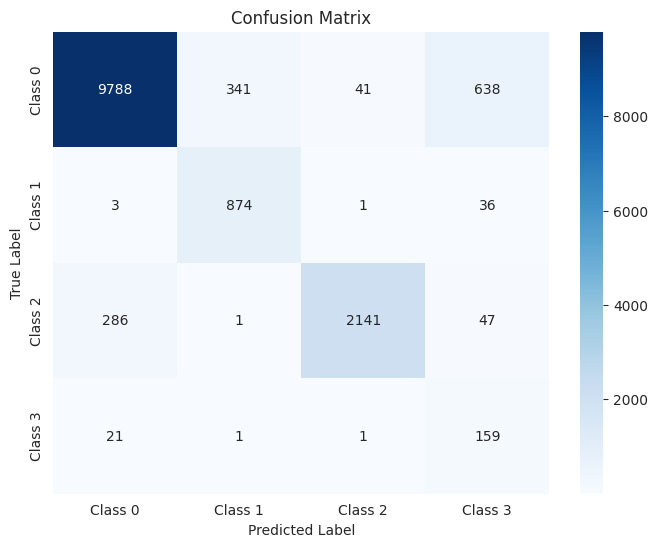

The function took 0.5251 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.91      0.94      2702
     Class 1       0.73      0.93      0.82       228
     Class 2       0.98      0.88      0.93       619
     Class 3       0.18      0.87      0.30        46

    accuracy                           0.91      3595
   macro avg       0.72      0.90      0.75      3595
weighted avg       0.95      0.91      0.92      3595



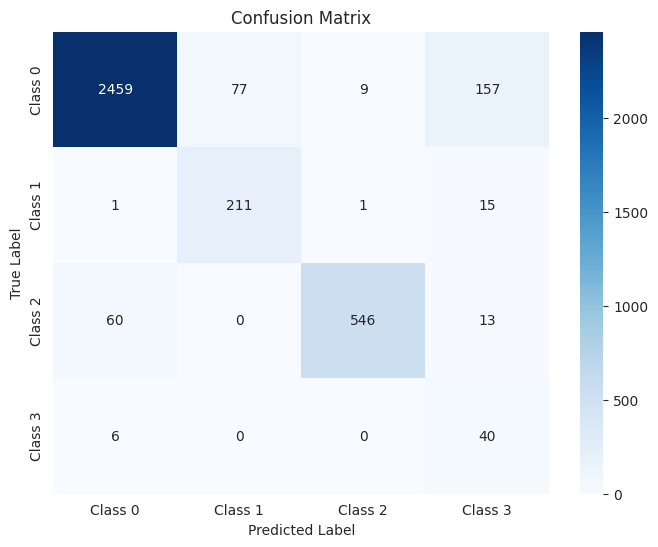

The function took 0.3640 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.90      0.93      3378
     Class 1       0.70      0.94      0.80       285
     Class 2       0.98      0.84      0.90       774
     Class 3       0.17      0.86      0.28        57

    accuracy                           0.89      4494
   macro avg       0.70      0.88      0.73      4494
weighted avg       0.94      0.89      0.91      4494



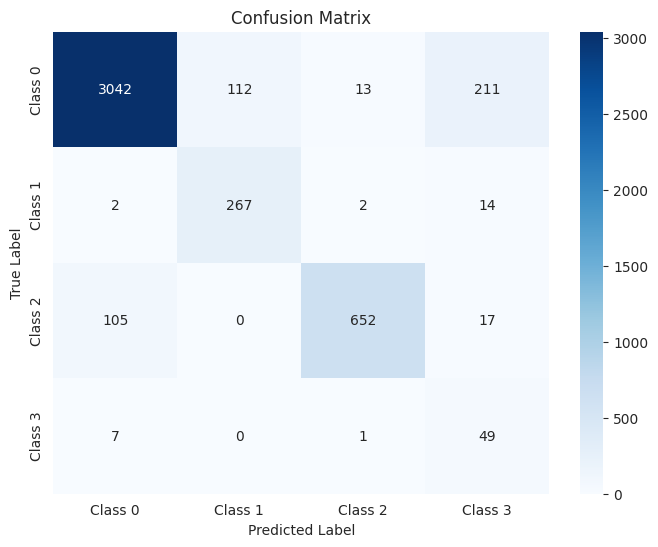

The function took 0.3334 seconds to execute.
[ARCH#043-[8, 8, 2]] done in 29.4s  best-val=1.3794


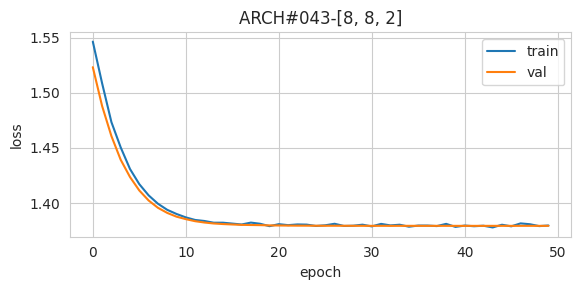


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



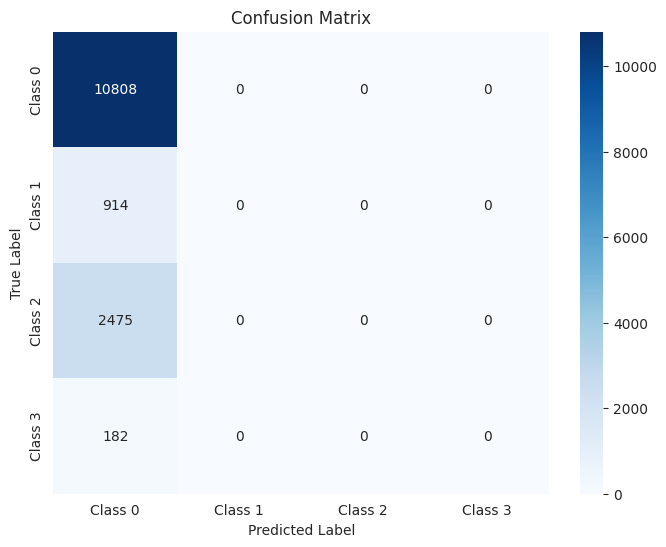

The function took 0.7434 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



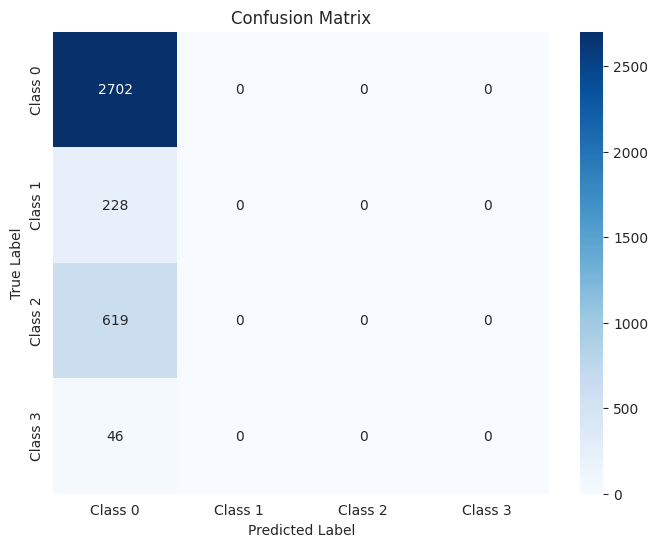

The function took 0.4539 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



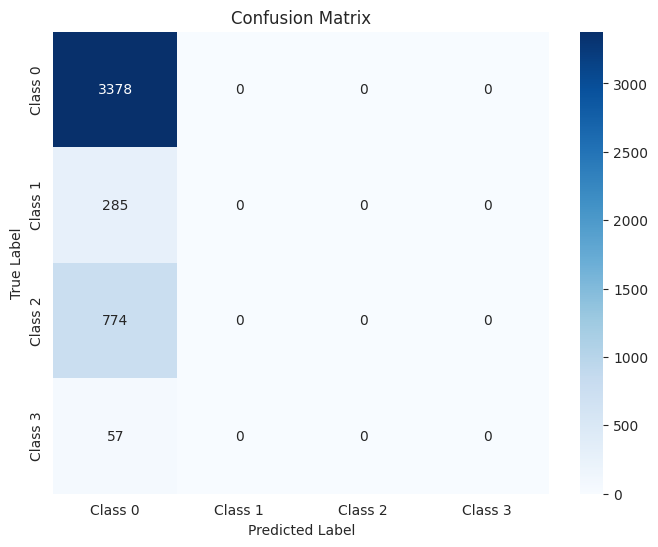

The function took 0.5193 seconds to execute.
[ARCH#044-[8, 4, 4]] done in 29.1s  best-val=0.4057


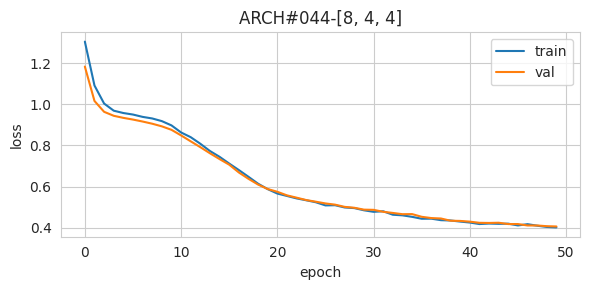


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.81      0.89     10808
     Class 1       0.67      0.93      0.78       914
     Class 2       1.00      0.86      0.92      2475
     Class 3       0.08      0.96      0.15       182

    accuracy                           0.83     14379
   macro avg       0.69      0.89      0.69     14379
weighted avg       0.96      0.83      0.88     14379



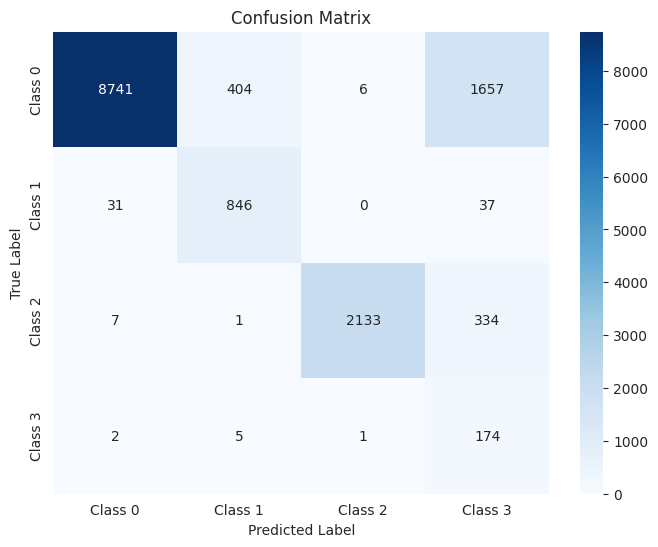

The function took 0.5481 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.81      0.89      2702
     Class 1       0.70      0.89      0.79       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.08      0.98      0.15        46

    accuracy                           0.83      3595
   macro avg       0.69      0.89      0.69      3595
weighted avg       0.96      0.83      0.88      3595



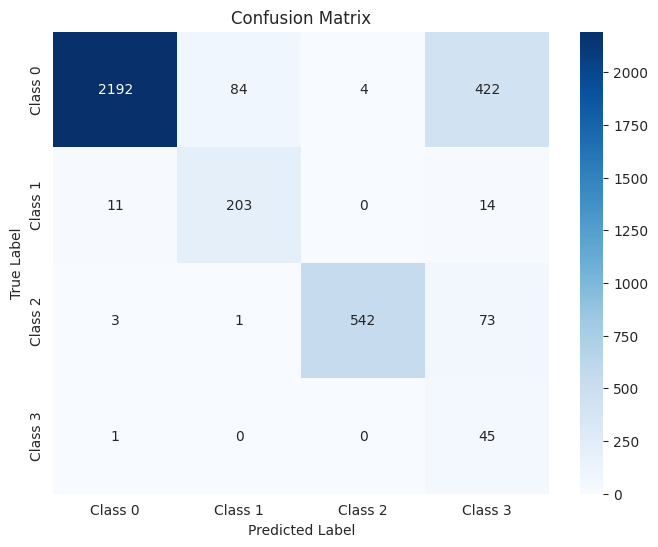

The function took 0.3562 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.81      0.89      3378
     Class 1       0.65      0.91      0.76       285
     Class 2       0.99      0.84      0.91       774
     Class 3       0.08      0.95      0.15        57

    accuracy                           0.82      4494
   macro avg       0.68      0.88      0.68      4494
weighted avg       0.96      0.82      0.88      4494



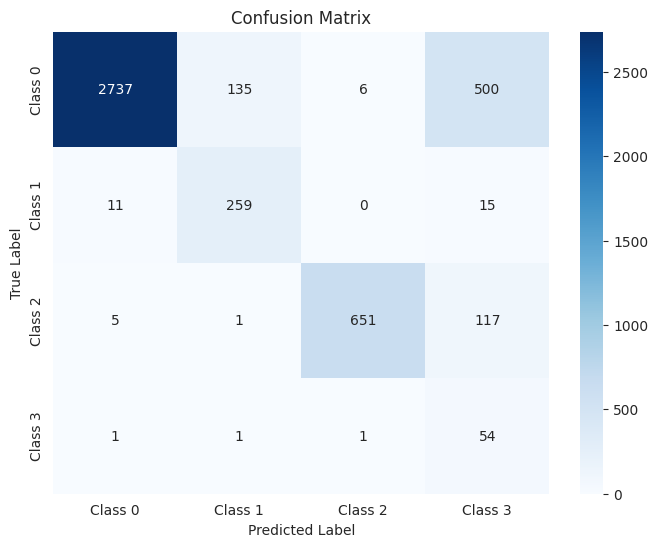

The function took 0.3304 seconds to execute.
[ARCH#045-[8, 4, 2]] done in 28.7s  best-val=0.5542


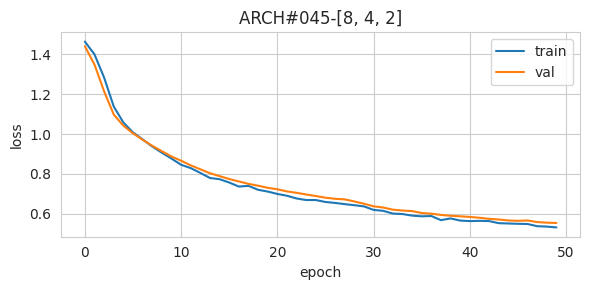


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.63      0.77     10808
     Class 1       0.48      0.93      0.63       914
     Class 2       0.75      0.93      0.83      2475
     Class 3       0.06      0.84      0.11       182

    accuracy                           0.71     14379
   macro avg       0.57      0.83      0.59     14379
weighted avg       0.90      0.71      0.76     14379



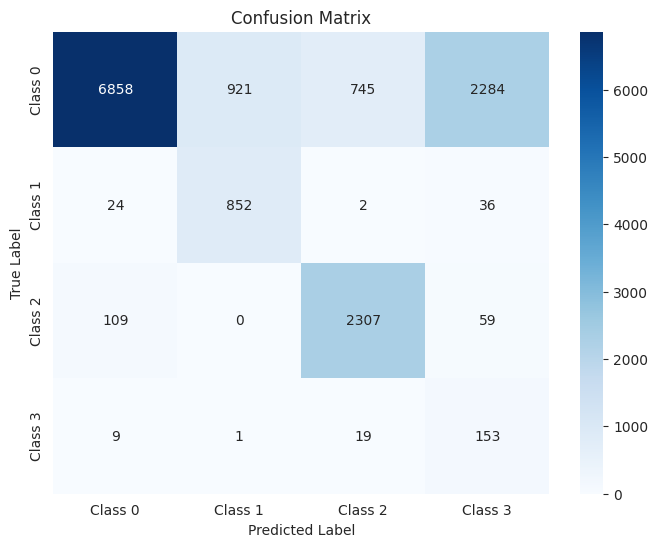

The function took 0.5086 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.64      0.77      2702
     Class 1       0.48      0.90      0.63       228
     Class 2       0.75      0.95      0.84       619
     Class 3       0.06      0.83      0.11        46

    accuracy                           0.71      3595
   macro avg       0.57      0.83      0.59      3595
weighted avg       0.90      0.71      0.77      3595



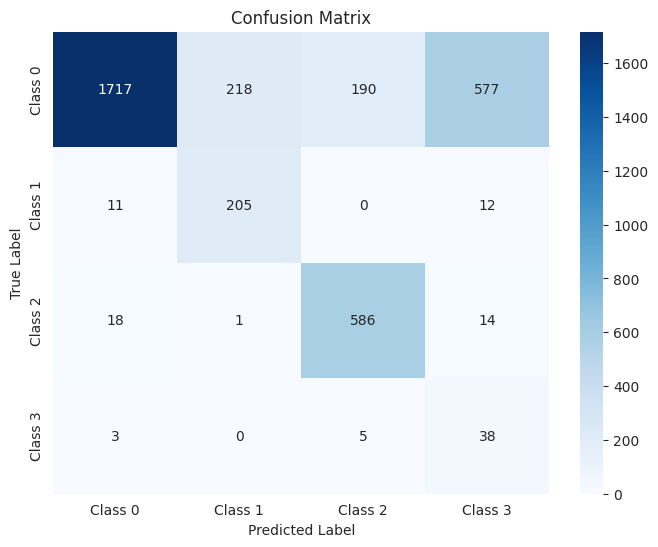

The function took 0.3972 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.64      0.77      3378
     Class 1       0.48      0.92      0.63       285
     Class 2       0.76      0.91      0.83       774
     Class 3       0.06      0.84      0.11        57

    accuracy                           0.71      4494
   macro avg       0.57      0.83      0.59      4494
weighted avg       0.89      0.71      0.76      4494



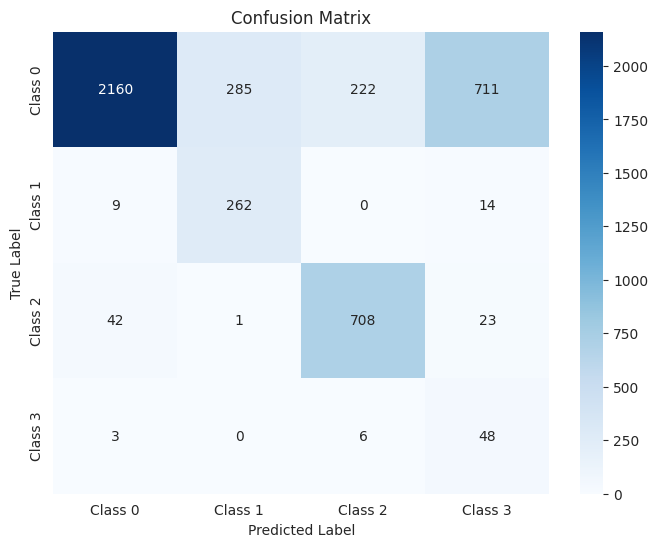

The function took 0.3477 seconds to execute.
[ARCH#046-[8, 2, 2]] early-stop @ epoch 040
[ARCH#046-[8, 2, 2]] done in 23.9s  best-val=1.3794


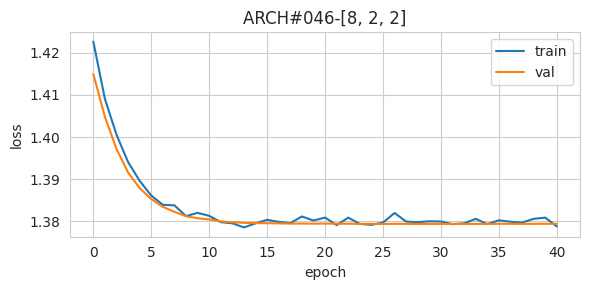


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



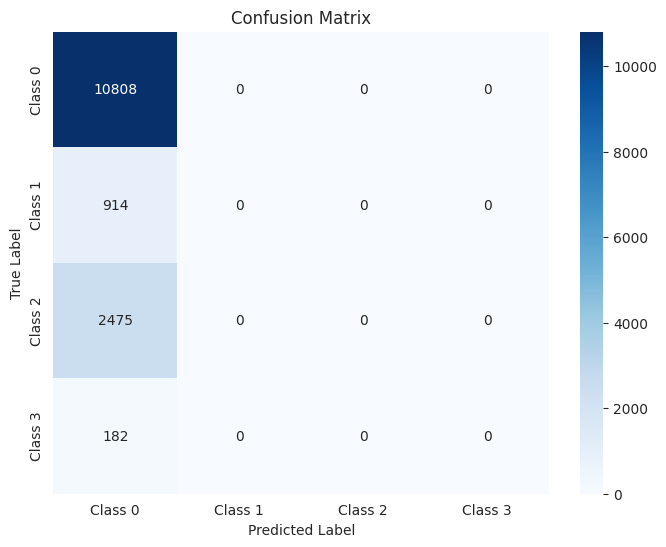

The function took 0.5169 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



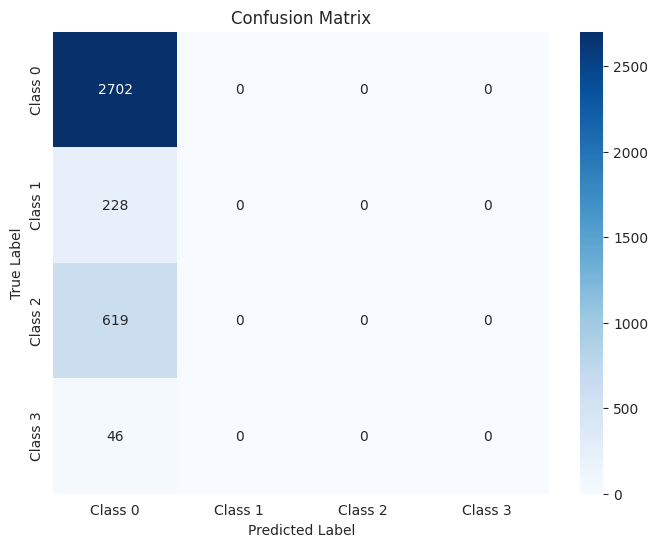

The function took 0.3715 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



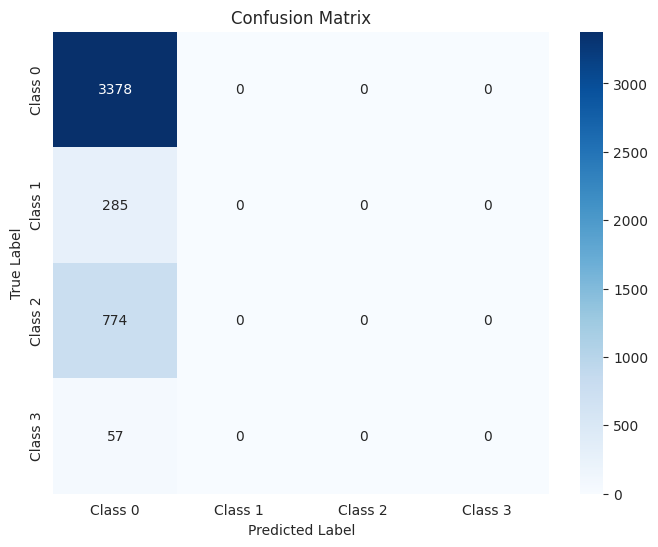

The function took 0.3344 seconds to execute.
[ARCH#047-[4, 4, 4]] done in 28.5s  best-val=0.3920


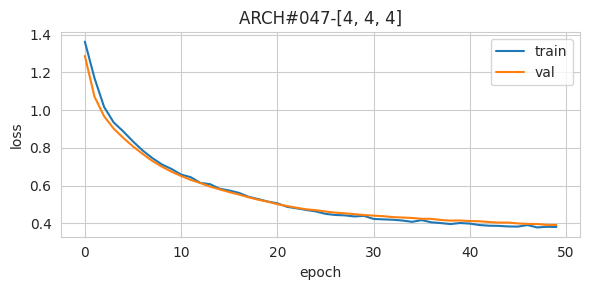


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.89      0.92     10808
     Class 1       0.70      0.91      0.79       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.15      0.87      0.25       182

    accuracy                           0.88     14379
   macro avg       0.70      0.88      0.72     14379
weighted avg       0.94      0.88      0.91     14379



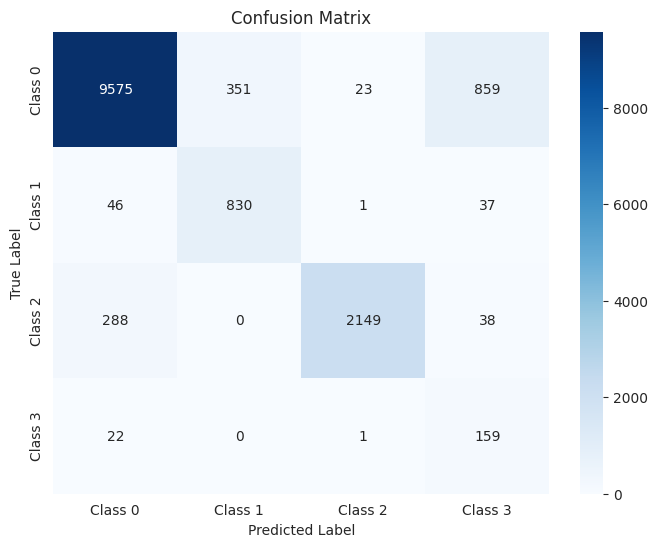

The function took 0.5400 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.89      0.93      2702
     Class 1       0.74      0.88      0.80       228
     Class 2       0.98      0.88      0.93       619
     Class 3       0.15      0.87      0.25        46

    accuracy                           0.89      3595
   macro avg       0.71      0.88      0.73      3595
weighted avg       0.94      0.89      0.91      3595



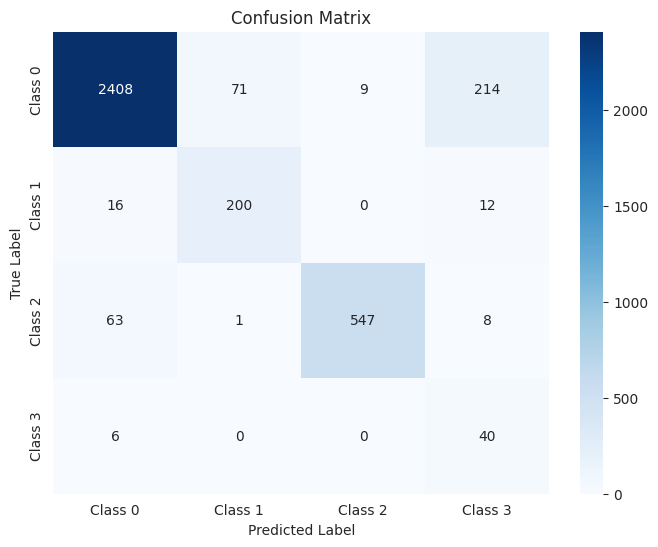

The function took 0.3642 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.89      0.92      3378
     Class 1       0.70      0.89      0.78       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.15      0.86      0.26        57

    accuracy                           0.88      4494
   macro avg       0.70      0.87      0.72      4494
weighted avg       0.94      0.88      0.90      4494



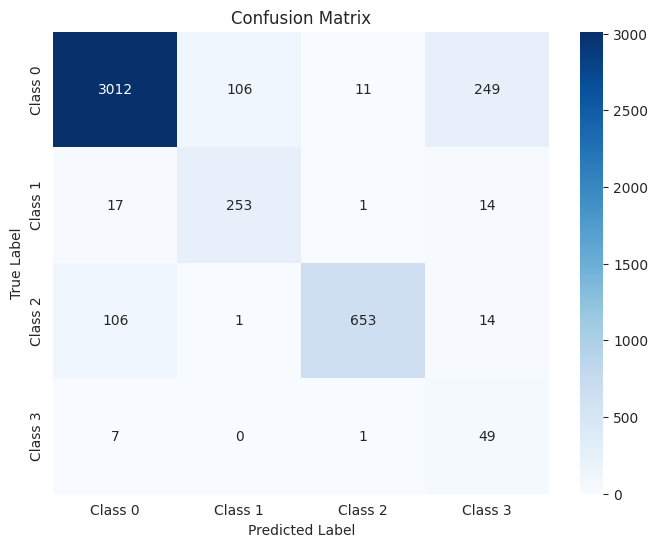

The function took 0.3504 seconds to execute.
[ARCH#048-[4, 4, 2]] early-stop @ epoch 045
[ARCH#048-[4, 4, 2]] done in 26.4s  best-val=1.3794


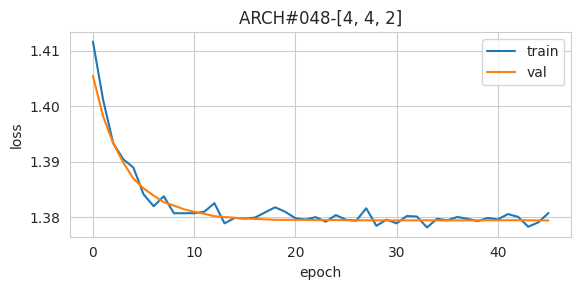


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



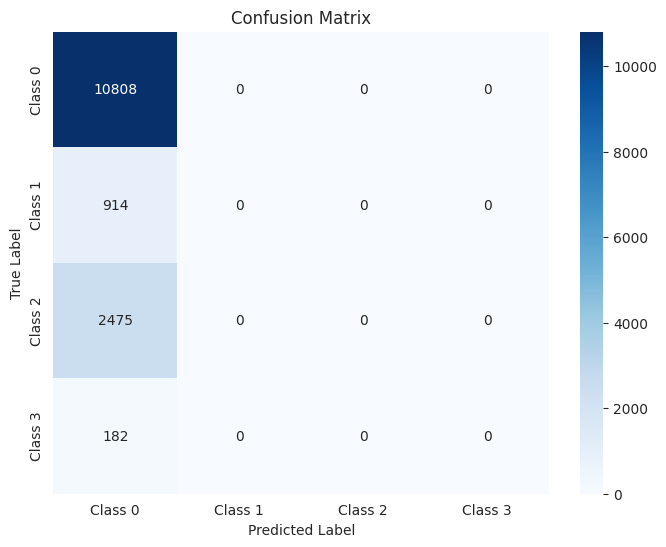

The function took 0.8852 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



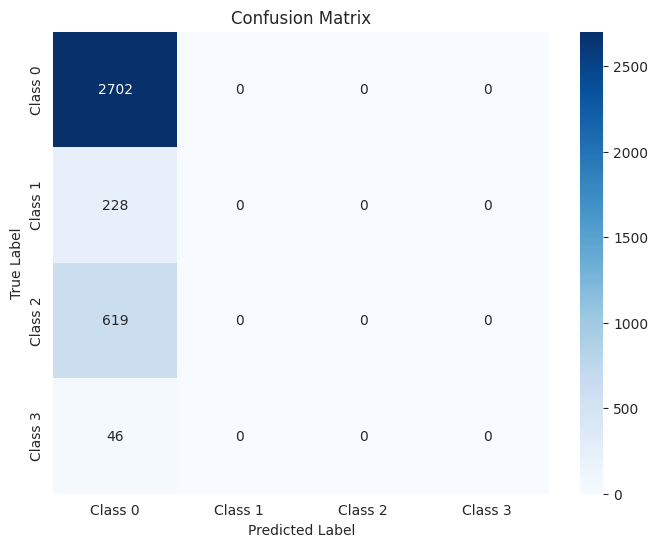

The function took 0.4152 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



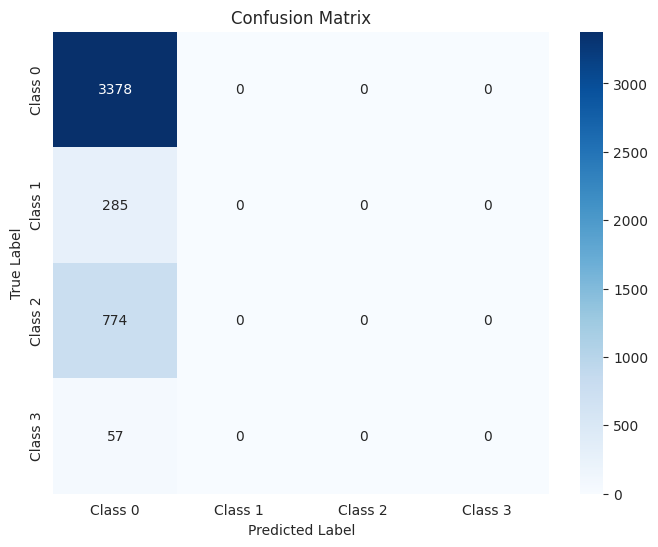

The function took 0.4469 seconds to execute.
[ARCH#049-[4, 2, 2]] done in 29.4s  best-val=0.5962


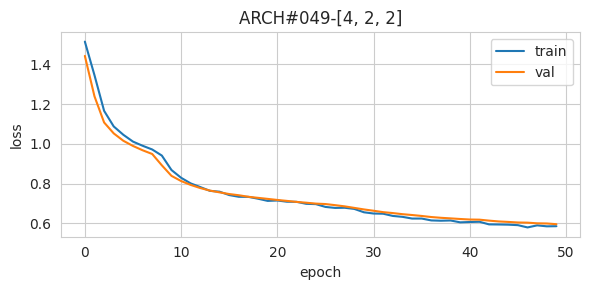


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.96      0.95     10808
     Class 1       0.64      0.91      0.75       914
     Class 2       0.99      0.86      0.92      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.93     14379
   macro avg       0.65      0.68      0.66     14379
weighted avg       0.92      0.93      0.92     14379



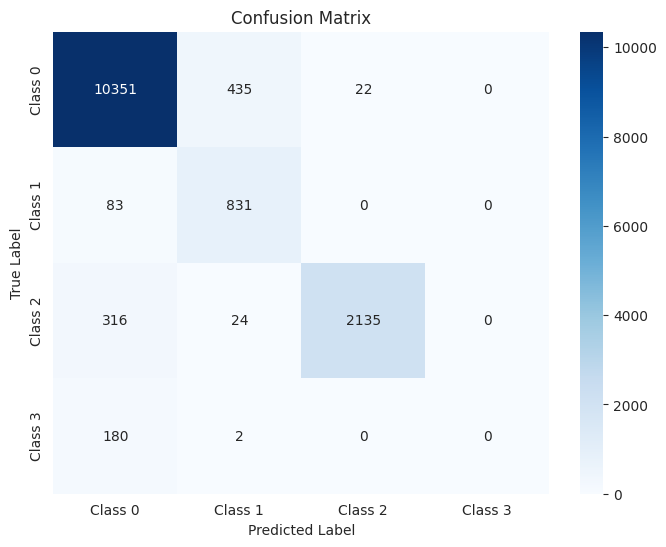

The function took 0.5704 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.96      0.96      2702
     Class 1       0.68      0.89      0.77       228
     Class 2       0.98      0.88      0.93       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.93      3595
   macro avg       0.65      0.68      0.66      3595
weighted avg       0.93      0.93      0.93      3595



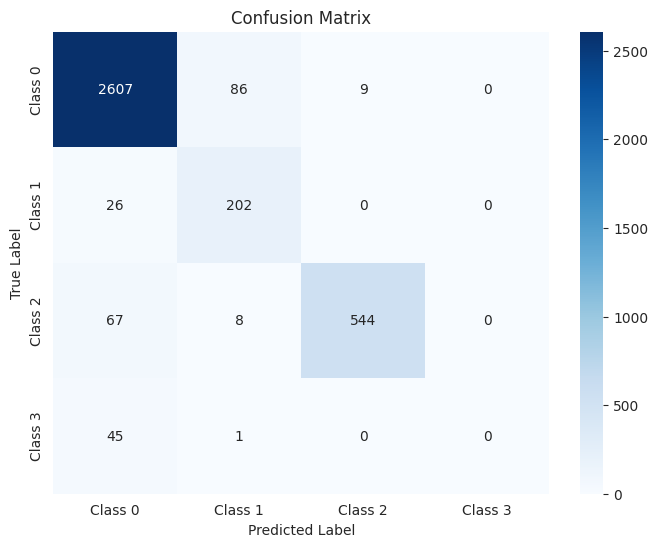

The function took 0.3464 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.96      0.95      3378
     Class 1       0.62      0.89      0.73       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.92      4494
   macro avg       0.64      0.67      0.65      4494
weighted avg       0.92      0.92      0.92      4494



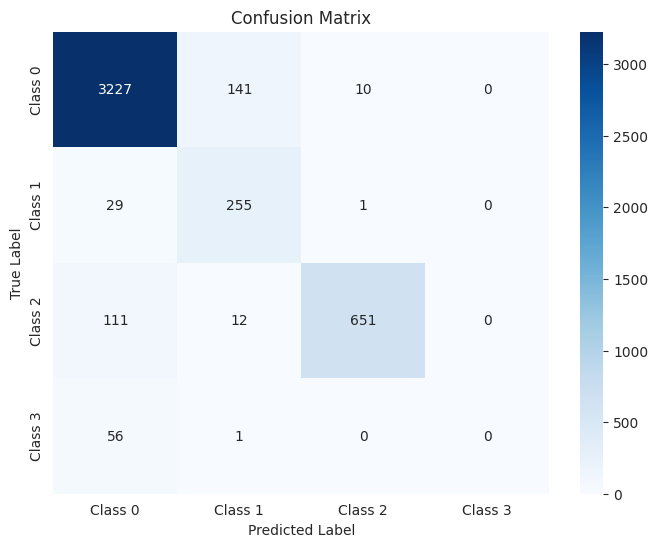

The function took 0.3392 seconds to execute.
[ARCH#050-[2, 2, 2]] done in 29.0s  best-val=0.8790


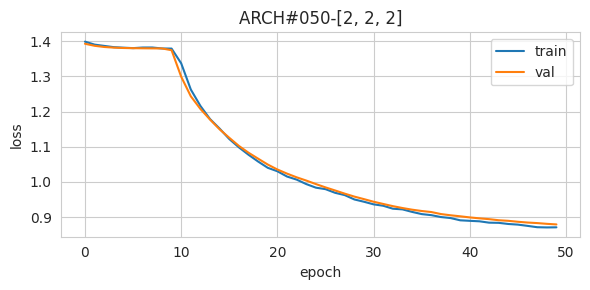


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.81      0.89     10808
     Class 1       0.01      0.00      0.00       914
     Class 2       0.64      0.87      0.74      2475
     Class 3       0.01      0.10      0.02       182

    accuracy                           0.76     14379
   macro avg       0.41      0.45      0.41     14379
weighted avg       0.84      0.76      0.79     14379



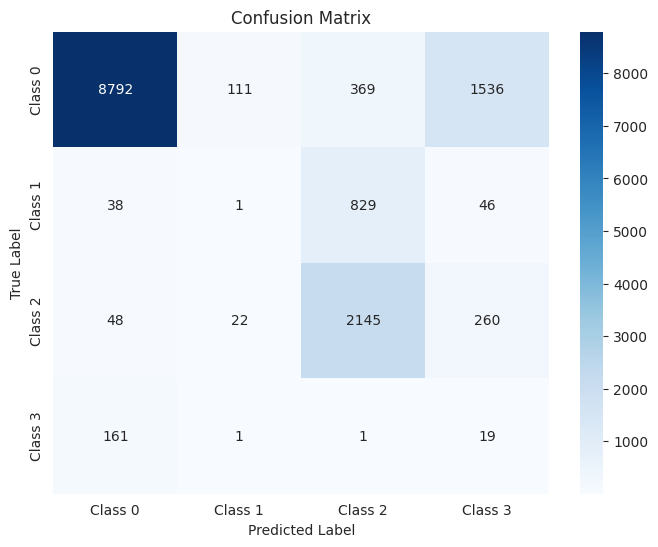

The function took 0.5564 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.81      0.89      2702
     Class 1       0.03      0.00      0.01       228
     Class 2       0.66      0.89      0.75       619
     Class 3       0.01      0.11      0.02        46

    accuracy                           0.77      3595
   macro avg       0.42      0.45      0.42      3595
weighted avg       0.84      0.77      0.80      3595



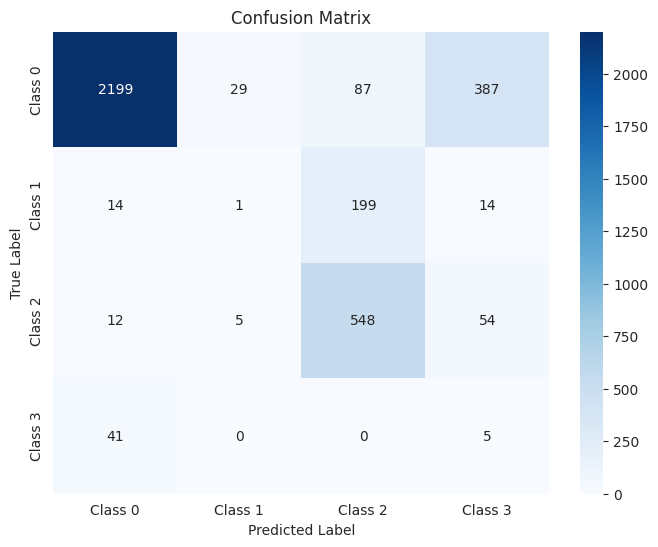

The function took 0.3707 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.82      0.89      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.64      0.85      0.73       774
     Class 3       0.01      0.11      0.02        57

    accuracy                           0.77      4494
   macro avg       0.41      0.45      0.41      4494
weighted avg       0.84      0.77      0.80      4494



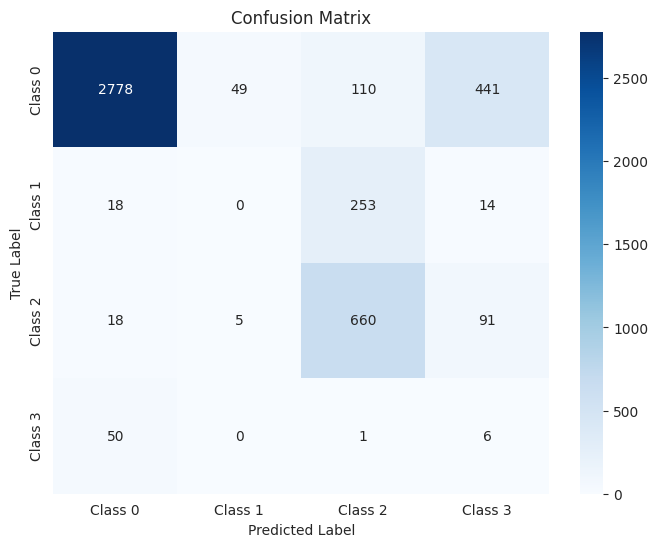

The function took 0.3317 seconds to execute.
[ARCH#051-[32, 32, 32, 32]] done in 31.6s  best-val=0.1908


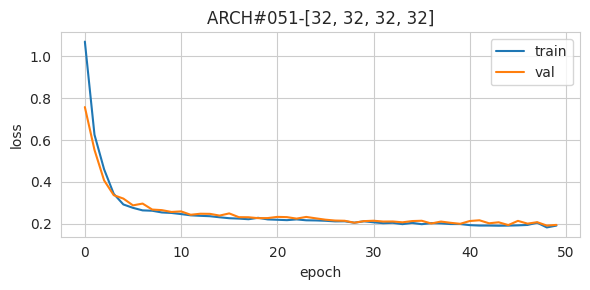


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.77      0.96      0.86       914
     Class 2       0.80      0.98      0.88      2475
     Class 3       0.36      0.88      0.51       182

    accuracy                           0.92     14379
   macro avg       0.73      0.93      0.80     14379
weighted avg       0.94      0.92      0.92     14379



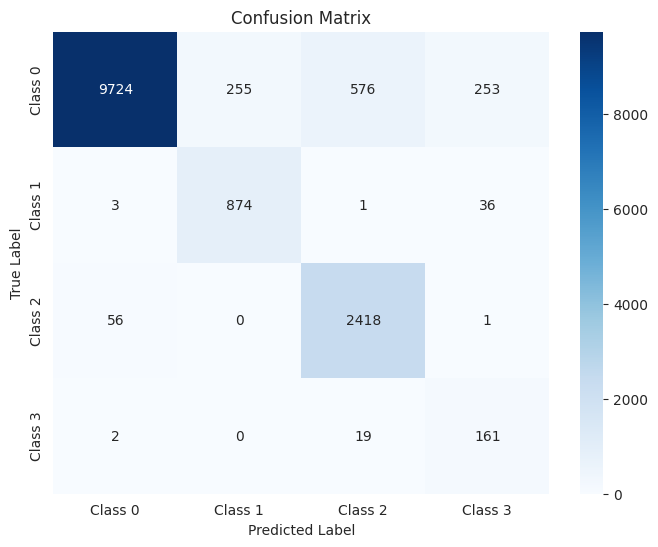

The function took 0.7573 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.80      0.93      0.86       228
     Class 2       0.81      0.97      0.89       619
     Class 3       0.34      0.89      0.49        46

    accuracy                           0.92      3595
   macro avg       0.74      0.92      0.80      3595
weighted avg       0.94      0.92      0.92      3595



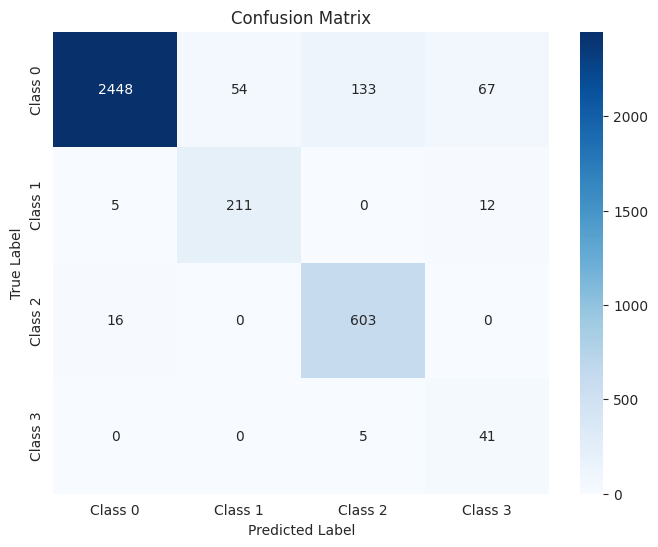

The function took 0.4478 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.78      0.94      0.85       285
     Class 2       0.80      0.97      0.88       774
     Class 3       0.37      0.88      0.52        57

    accuracy                           0.92      4494
   macro avg       0.73      0.92      0.80      4494
weighted avg       0.94      0.92      0.92      4494



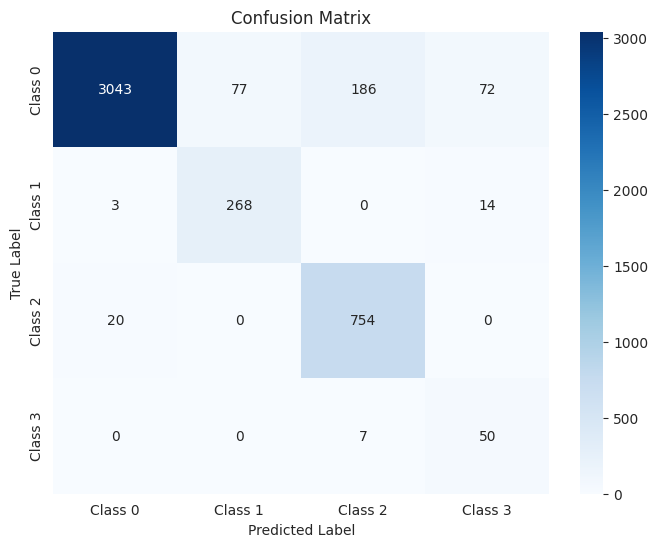

The function took 0.4388 seconds to execute.
[ARCH#052-[32, 32, 32, 16]] done in 31.8s  best-val=0.2019


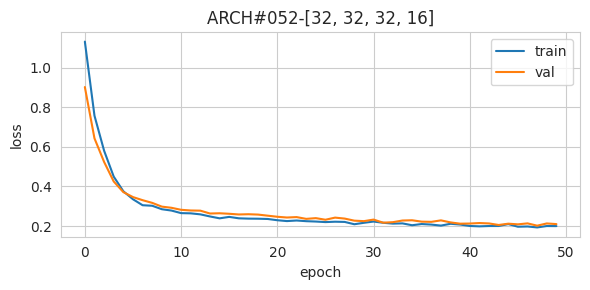


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.95     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.86      0.91      0.88      2475
     Class 3       0.23      0.98      0.37       182

    accuracy                           0.91     14379
   macro avg       0.71      0.94      0.76     14379
weighted avg       0.95      0.91      0.92     14379



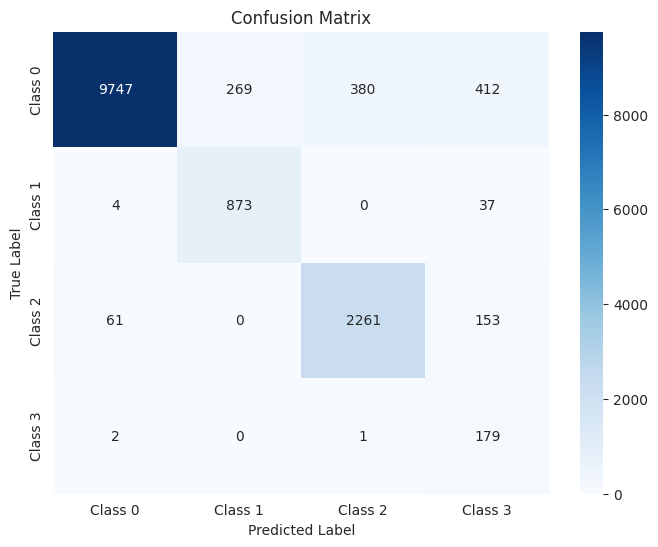

The function took 0.5416 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.87      0.91      0.89       619
     Class 3       0.21      0.98      0.35        46

    accuracy                           0.91      3595
   macro avg       0.71      0.93      0.76      3595
weighted avg       0.95      0.91      0.92      3595



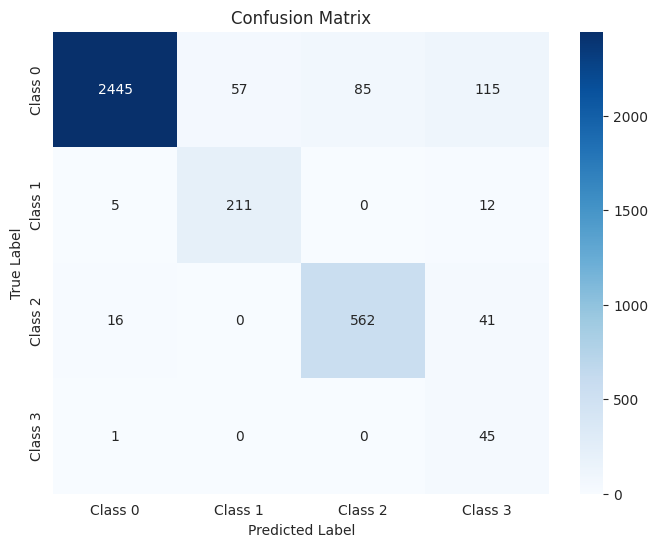

The function took 0.3644 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.95      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.84      0.91      0.87       774
     Class 3       0.24      0.96      0.38        57

    accuracy                           0.91      4494
   macro avg       0.71      0.93      0.76      4494
weighted avg       0.94      0.91      0.92      4494



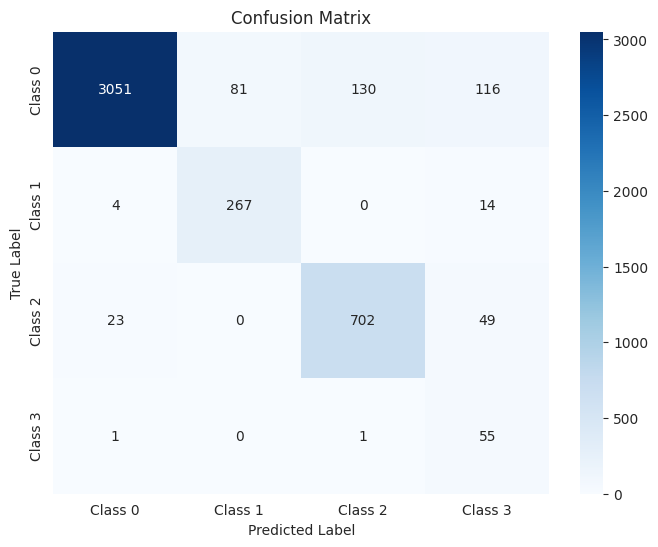

The function took 0.3682 seconds to execute.
[ARCH#053-[32, 32, 32, 8]] done in 31.2s  best-val=0.2015


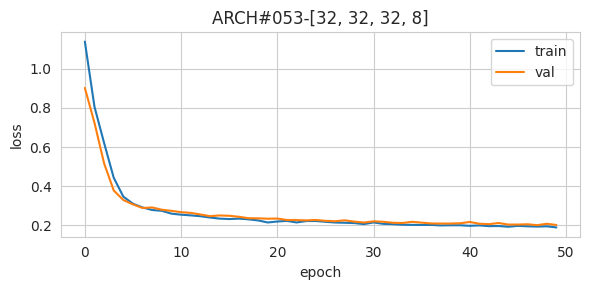


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.81      0.95      0.88      2475
     Class 3       0.29      0.92      0.44       182

    accuracy                           0.91     14379
   macro avg       0.71      0.93      0.78     14379
weighted avg       0.94      0.91      0.92     14379



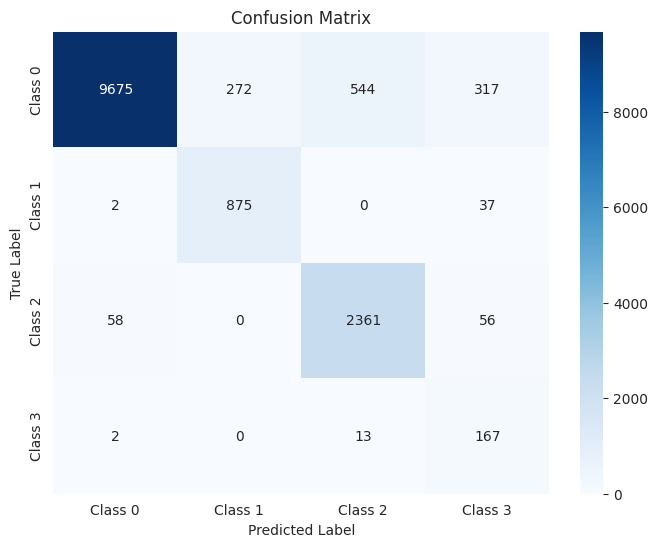

The function took 0.7950 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.82      0.96      0.88       619
     Class 3       0.28      0.91      0.43        46

    accuracy                           0.91      3595
   macro avg       0.72      0.93      0.78      3595
weighted avg       0.94      0.91      0.92      3595



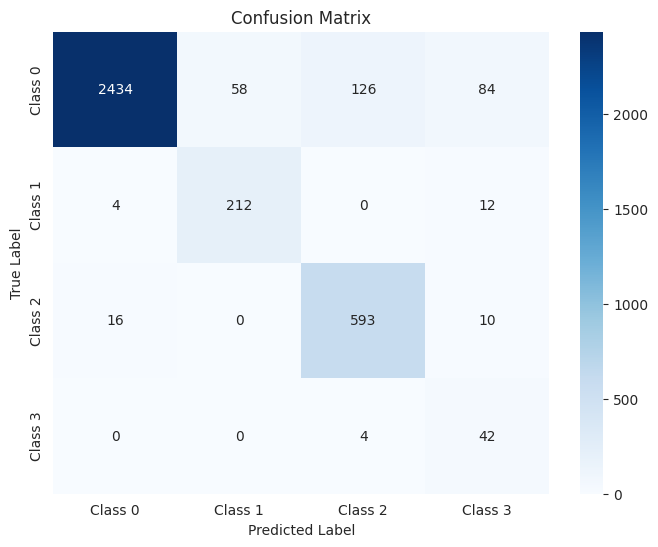

The function took 0.3875 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.80      0.95      0.87       774
     Class 3       0.31      0.89      0.46        57

    accuracy                           0.91      4494
   macro avg       0.72      0.92      0.78      4494
weighted avg       0.94      0.91      0.92      4494



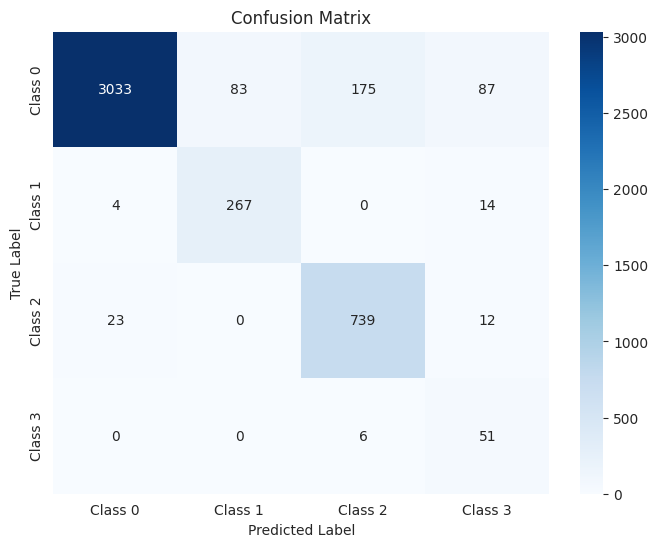

The function took 0.4244 seconds to execute.
[ARCH#054-[32, 32, 32, 4]] done in 31.9s  best-val=0.2069


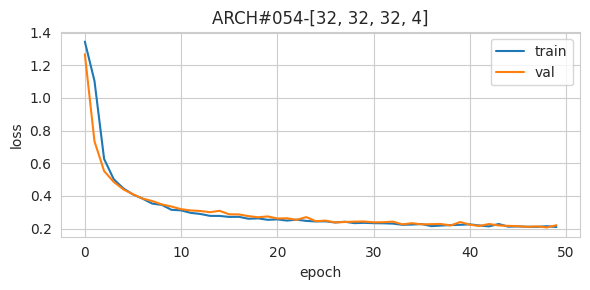


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.93      0.95      0.94      2475
     Class 3       0.33      0.88      0.48       182

    accuracy                           0.94     14379
   macro avg       0.75      0.93      0.80     14379
weighted avg       0.95      0.94      0.94     14379



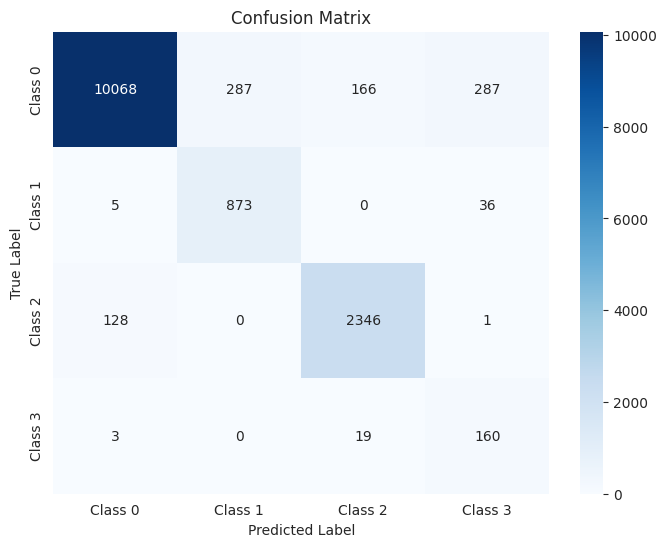

The function took 0.5493 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.92      0.96      0.94       619
     Class 3       0.32      0.89      0.47        46

    accuracy                           0.94      3595
   macro avg       0.75      0.93      0.80      3595
weighted avg       0.95      0.94      0.94      3595



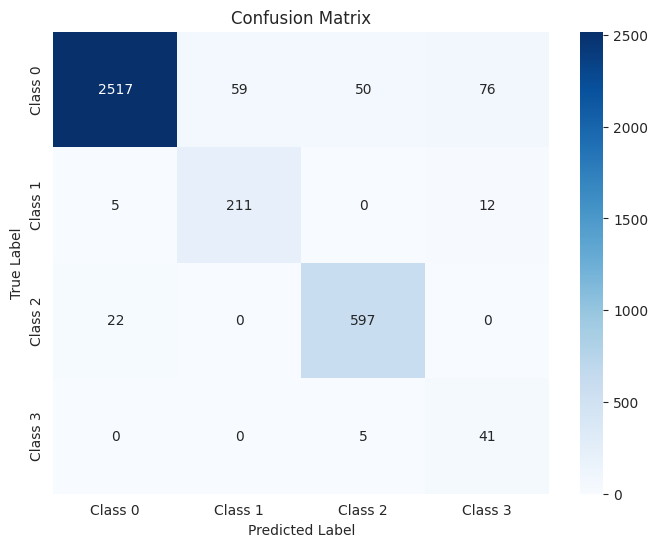

The function took 0.3539 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.92      0.94      0.93       774
     Class 3       0.32      0.86      0.47        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.80      4494
weighted avg       0.95      0.93      0.94      4494



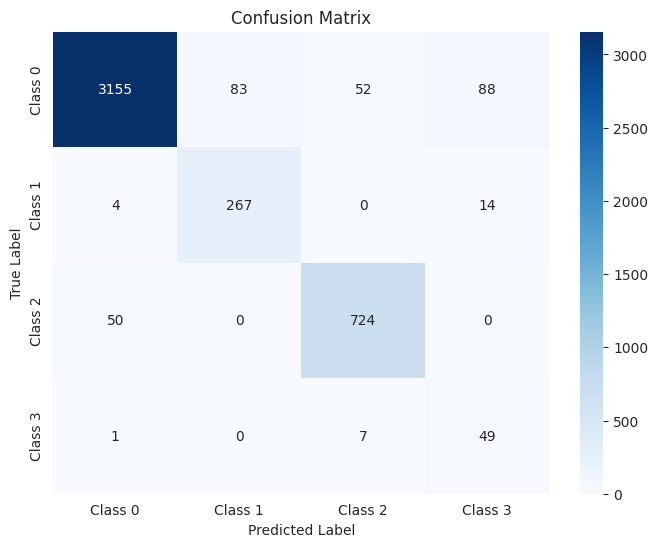

The function took 0.3547 seconds to execute.
[ARCH#055-[32, 32, 32, 2]] done in 31.0s  best-val=0.9599


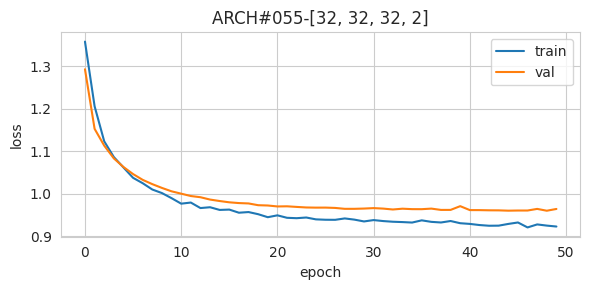


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.01      0.02     10808
     Class 1       0.86      0.91      0.88       914
     Class 2       0.19      1.00      0.31      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.24     14379
   macro avg       0.51      0.48      0.30     14379
weighted avg       0.84      0.24      0.13     14379



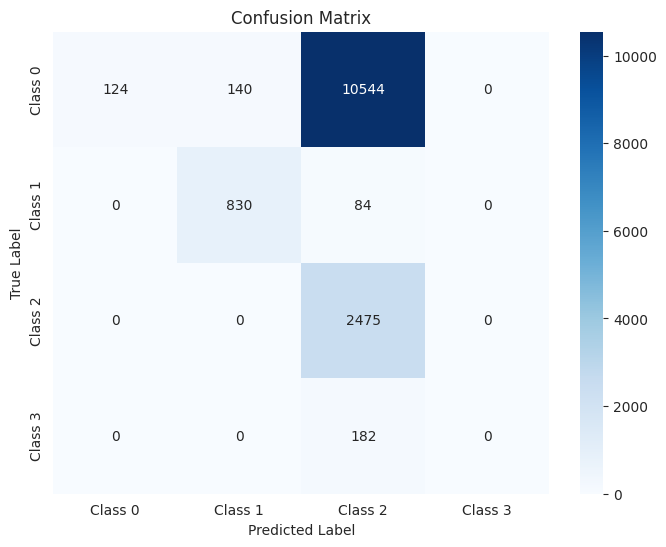

The function took 0.5347 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.01      0.01      2702
     Class 1       0.84      0.87      0.86       228
     Class 2       0.19      1.00      0.31       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.23      3595
   macro avg       0.50      0.47      0.30      3595
weighted avg       0.80      0.23      0.12      3595



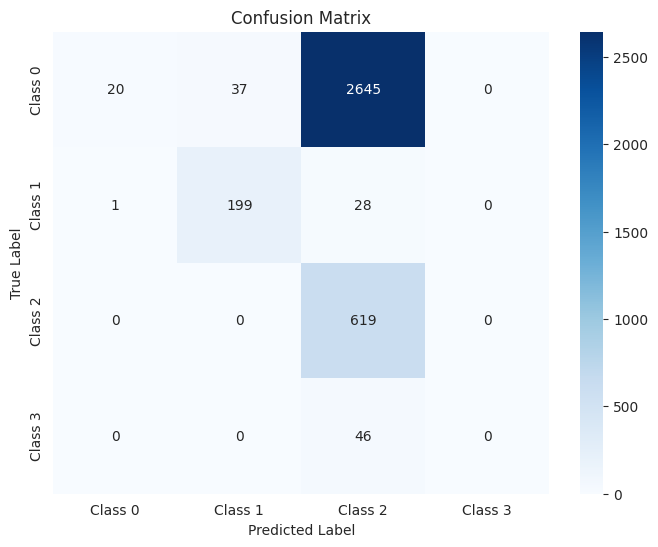

The function took 0.3999 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.01      0.02      3378
     Class 1       0.86      0.89      0.87       285
     Class 2       0.19      1.00      0.31       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.24      4494
   macro avg       0.51      0.47      0.30      4494
weighted avg       0.84      0.24      0.13      4494



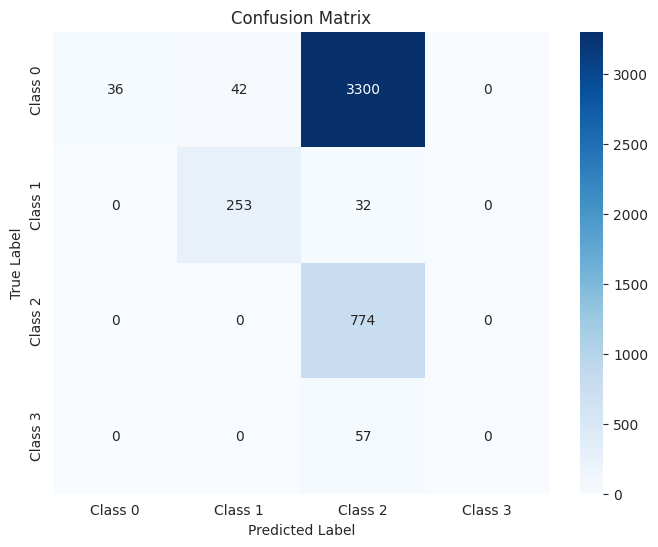

The function took 0.3616 seconds to execute.
[ARCH#056-[32, 32, 16, 16]] done in 31.9s  best-val=0.2025


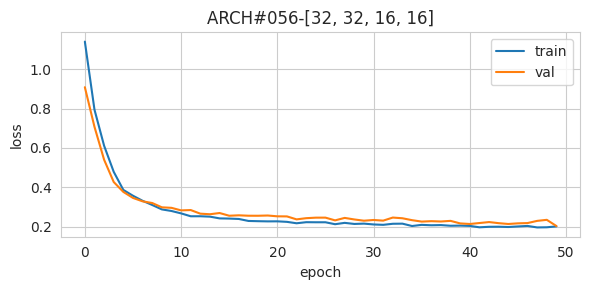


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.86      0.95      0.90      2475
     Class 3       0.30      0.88      0.45       182

    accuracy                           0.92     14379
   macro avg       0.73      0.93      0.79     14379
weighted avg       0.94      0.92      0.93     14379



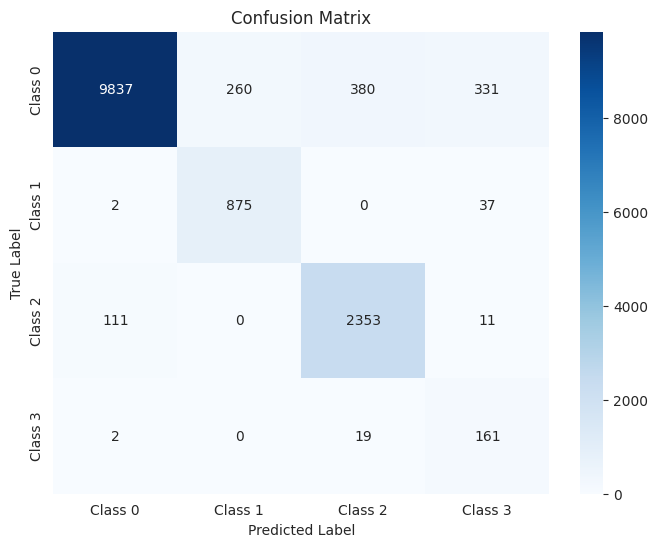

The function took 0.5030 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.86      0.97      0.91       619
     Class 3       0.28      0.89      0.42        46

    accuracy                           0.92      3595
   macro avg       0.73      0.92      0.78      3595
weighted avg       0.95      0.92      0.93      3595



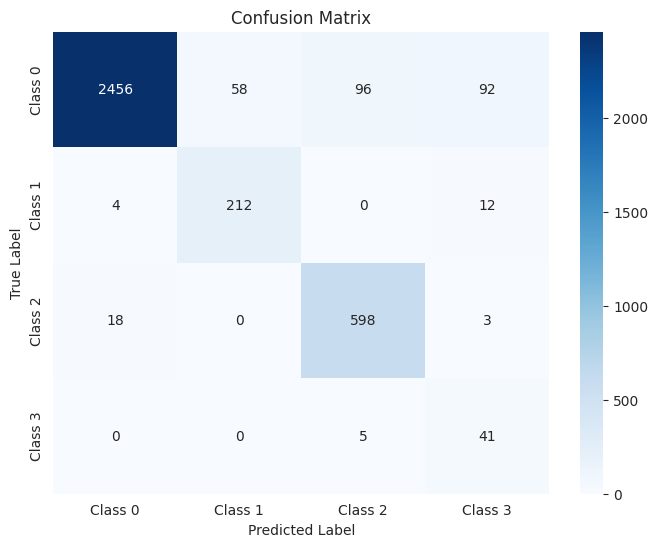

The function took 0.4315 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.77      0.94      0.85       285
     Class 2       0.86      0.94      0.89       774
     Class 3       0.31      0.86      0.45        57

    accuracy                           0.92      4494
   macro avg       0.73      0.91      0.78      4494
weighted avg       0.94      0.92      0.93      4494



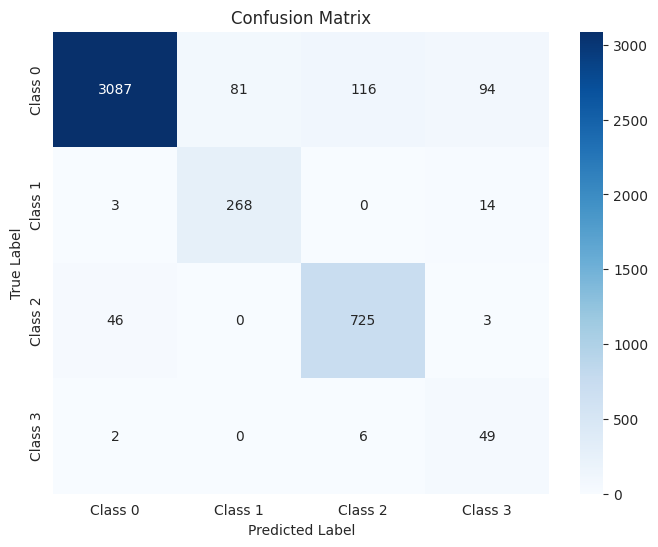

The function took 0.3768 seconds to execute.
[ARCH#057-[32, 32, 16, 8]] done in 31.6s  best-val=0.2109


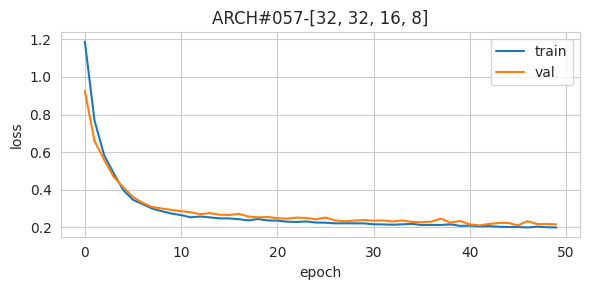


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.92      0.90      0.91      2475
     Class 3       0.22      0.98      0.37       182

    accuracy                           0.92     14379
   macro avg       0.72      0.94      0.77     14379
weighted avg       0.95      0.92      0.93     14379



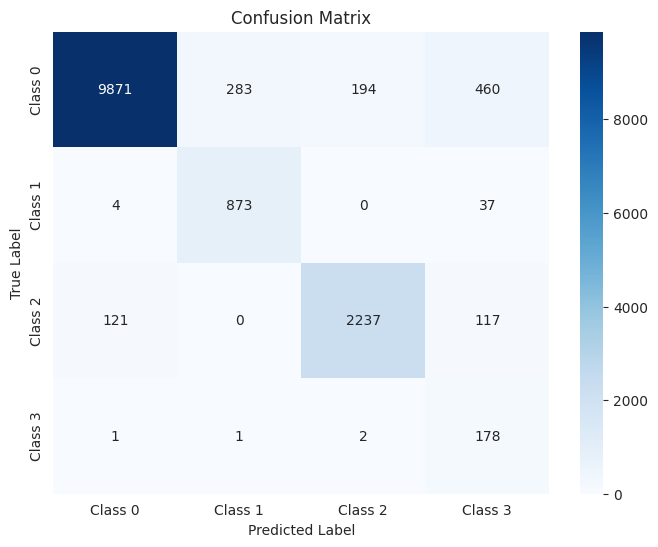

The function took 0.5327 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.94      0.91      0.92       619
     Class 3       0.22      1.00      0.36        46

    accuracy                           0.92      3595
   macro avg       0.73      0.94      0.77      3595
weighted avg       0.96      0.92      0.93      3595



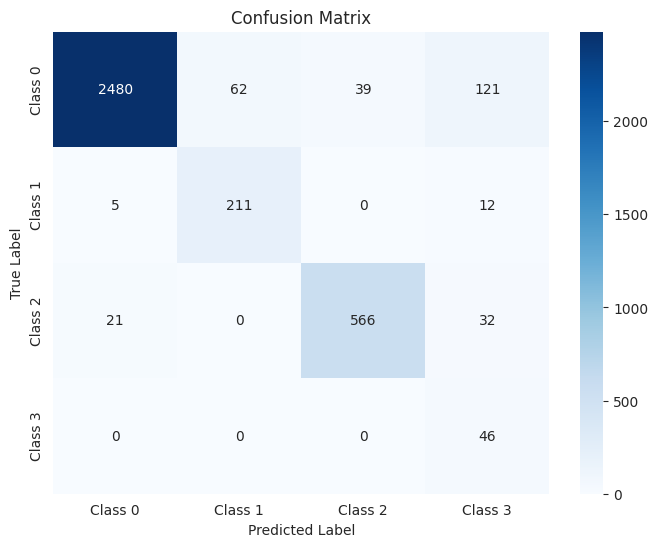

The function took 0.3945 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.75      0.94      0.83       285
     Class 2       0.92      0.89      0.91       774
     Class 3       0.23      0.95      0.37        57

    accuracy                           0.92      4494
   macro avg       0.72      0.92      0.77      4494
weighted avg       0.95      0.92      0.93      4494



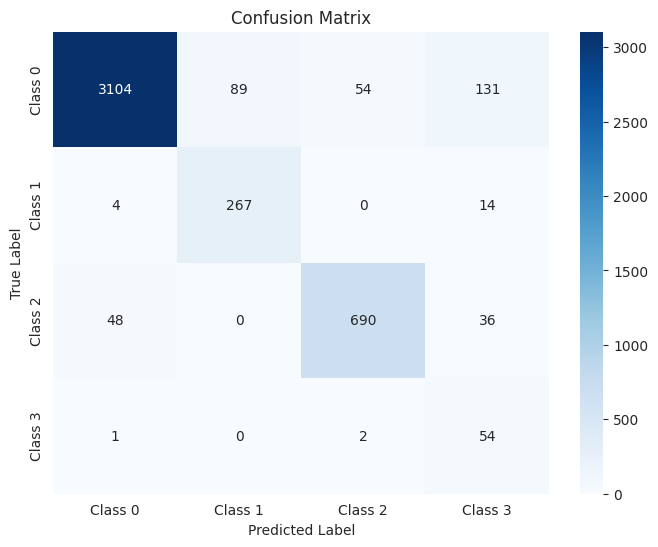

The function took 0.4683 seconds to execute.
[ARCH#058-[32, 32, 16, 4]] done in 32.4s  best-val=0.2512


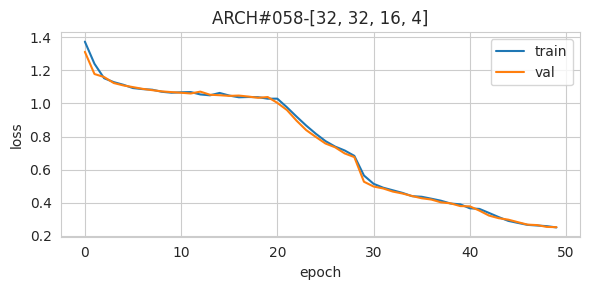


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.81      0.98      0.89      2475
     Class 3       0.39      0.88      0.54       182

    accuracy                           0.91     14379
   macro avg       0.73      0.93      0.80     14379
weighted avg       0.94      0.91      0.92     14379



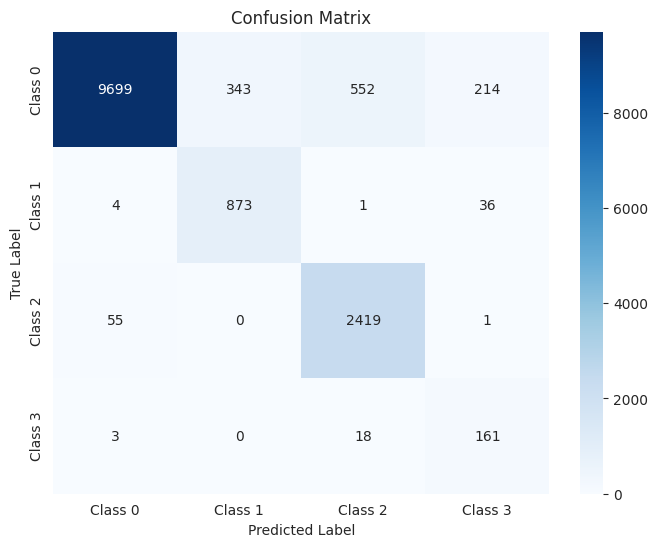

The function took 0.5673 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.73      0.93      0.81       228
     Class 2       0.81      0.98      0.88       619
     Class 3       0.37      0.89      0.52        46

    accuracy                           0.91      3595
   macro avg       0.72      0.92      0.79      3595
weighted avg       0.94      0.91      0.92      3595



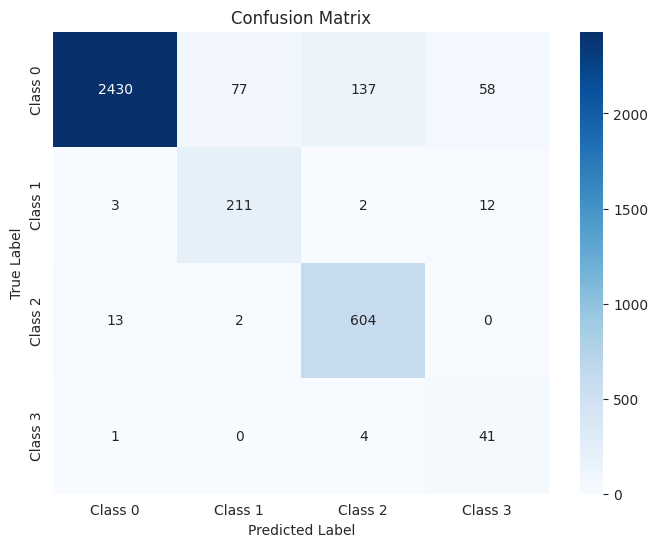

The function took 0.3610 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.72      0.94      0.81       285
     Class 2       0.79      0.97      0.87       774
     Class 3       0.38      0.82      0.52        57

    accuracy                           0.91      4494
   macro avg       0.72      0.91      0.79      4494
weighted avg       0.93      0.91      0.92      4494



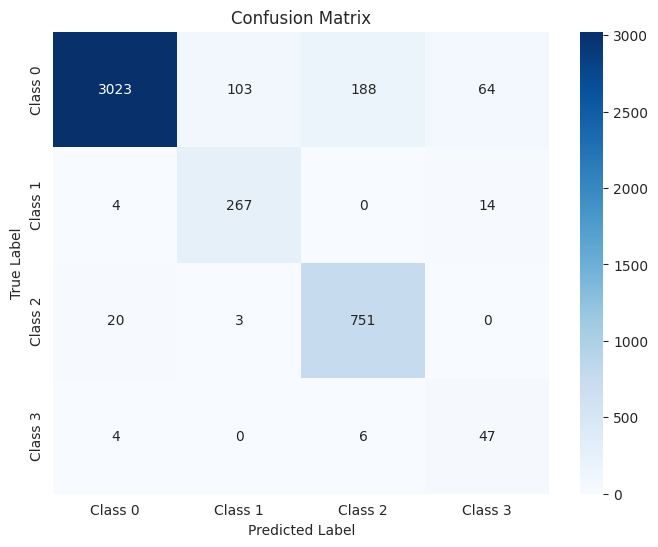

The function took 0.3882 seconds to execute.
[ARCH#059-[32, 32, 16, 2]] early-stop @ epoch 036
[ARCH#059-[32, 32, 16, 2]] done in 23.8s  best-val=1.3794


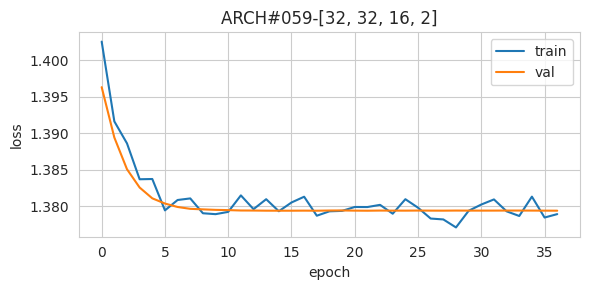


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



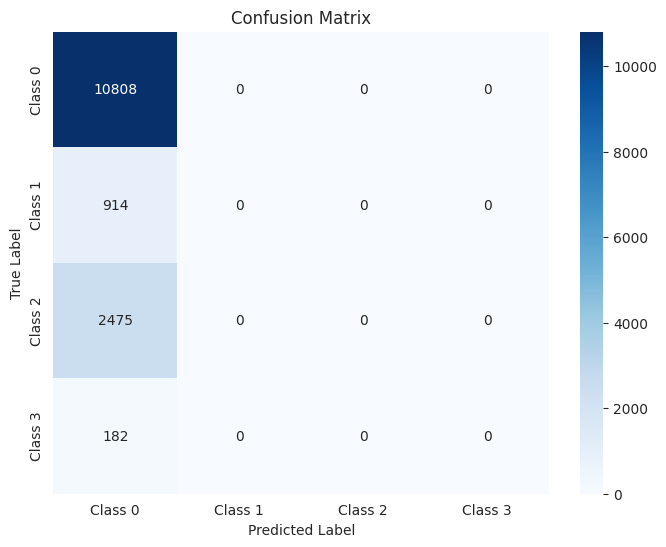

The function took 0.5769 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



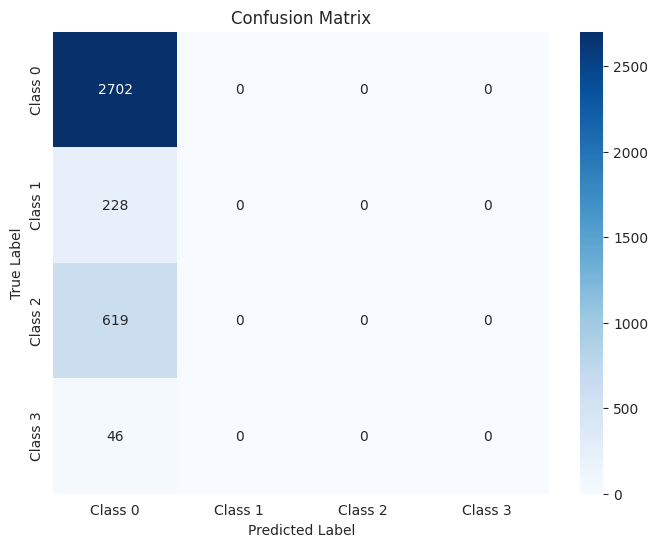

The function took 0.3843 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



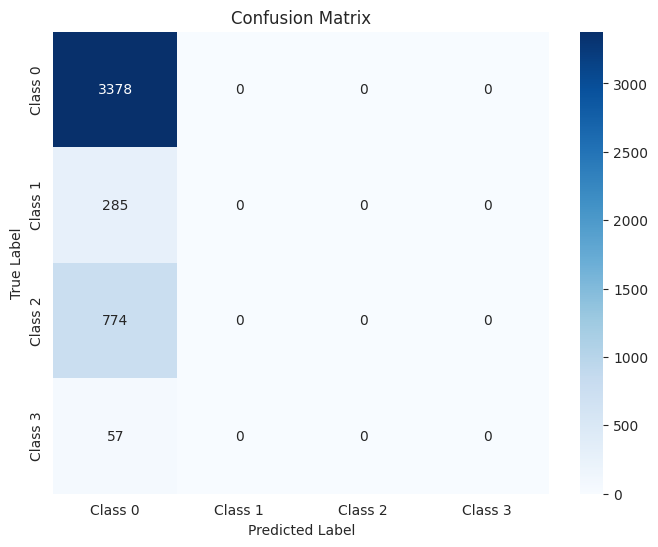

The function took 0.4140 seconds to execute.
[ARCH#060-[32, 32, 8, 8]] done in 31.4s  best-val=0.2325


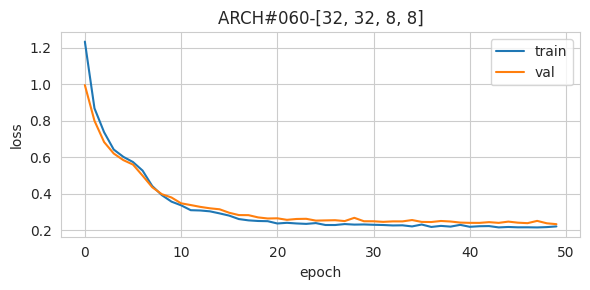


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.87      0.95      0.91      2475
     Class 3       0.39      0.88      0.55       182

    accuracy                           0.93     14379
   macro avg       0.76      0.93      0.82     14379
weighted avg       0.95      0.93      0.94     14379



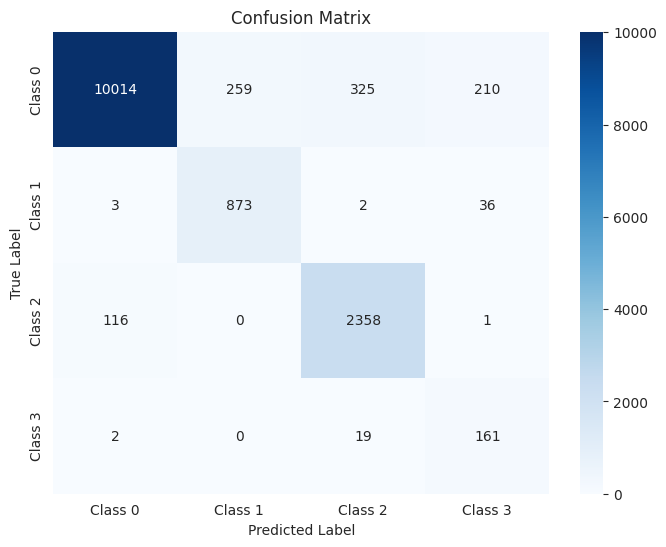

The function took 0.5756 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.80      0.93      0.86       228
     Class 2       0.87      0.97      0.92       619
     Class 3       0.37      0.89      0.52        46

    accuracy                           0.93      3595
   macro avg       0.76      0.93      0.81      3595
weighted avg       0.95      0.93      0.94      3595



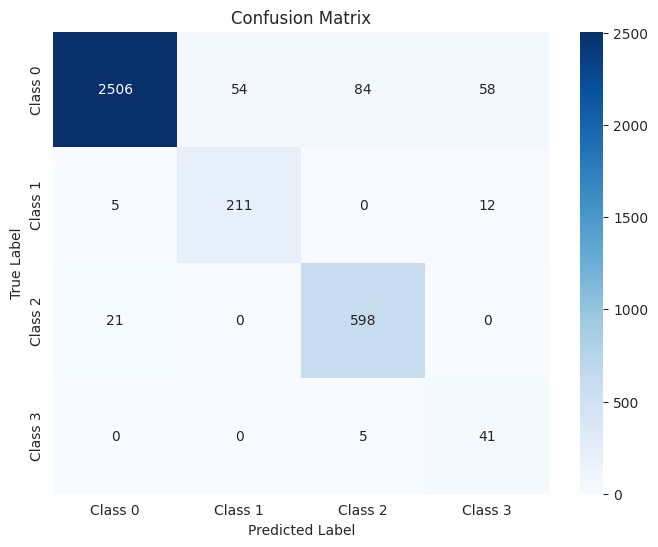

The function took 0.3923 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.87      0.94      0.90       774
     Class 3       0.41      0.89      0.56        57

    accuracy                           0.93      4494
   macro avg       0.76      0.92      0.82      4494
weighted avg       0.94      0.93      0.93      4494



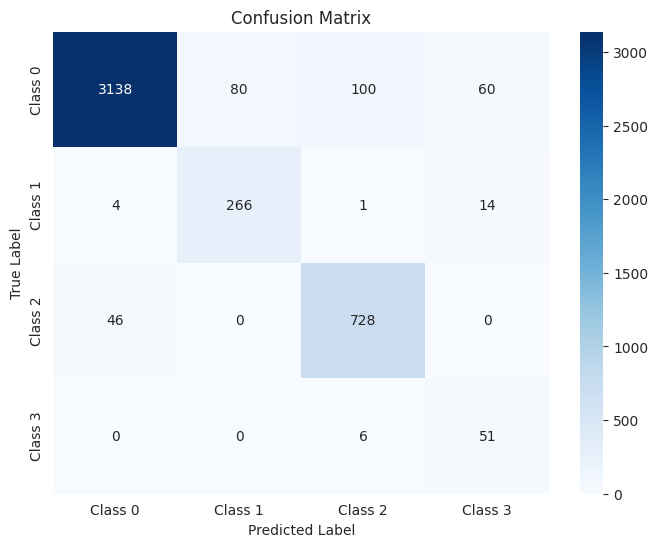

The function took 0.3969 seconds to execute.
[ARCH#061-[32, 32, 8, 4]] done in 32.2s  best-val=0.2960


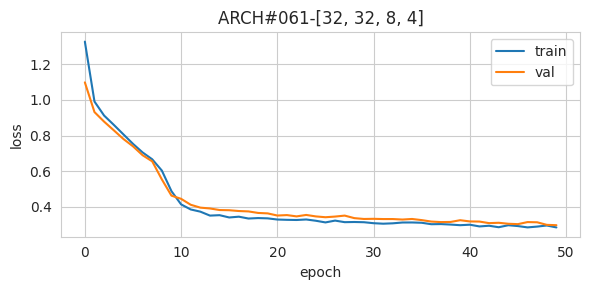


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.85      0.92     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       1.00      0.87      0.93      2475
     Class 3       0.10      0.98      0.18       182

    accuracy                           0.86     14379
   macro avg       0.71      0.92      0.71     14379
weighted avg       0.97      0.86      0.91     14379



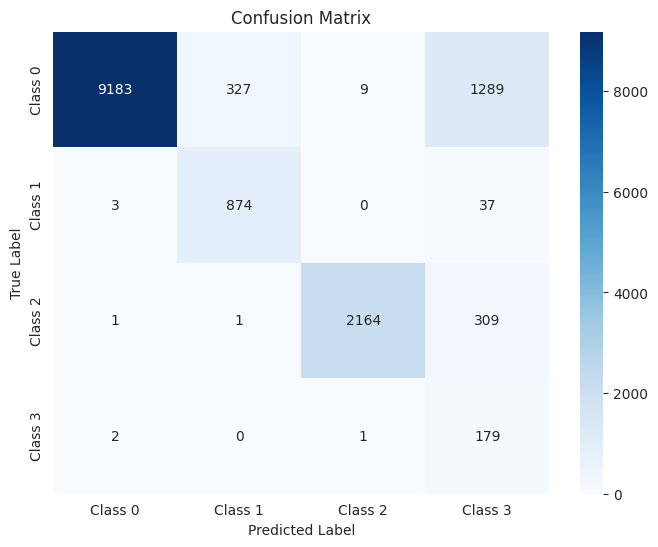

The function took 0.5508 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.86      0.92      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.10      0.98      0.19        46

    accuracy                           0.87      3595
   macro avg       0.71      0.91      0.72      3595
weighted avg       0.97      0.87      0.91      3595



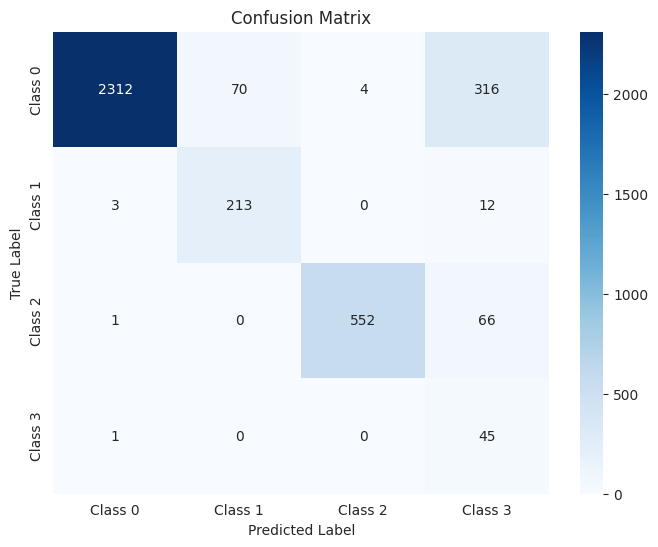

The function took 0.3728 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.85      0.92      3378
     Class 1       0.72      0.94      0.81       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.10      0.96      0.17        57

    accuracy                           0.86      4494
   macro avg       0.70      0.90      0.70      4494
weighted avg       0.96      0.86      0.90      4494



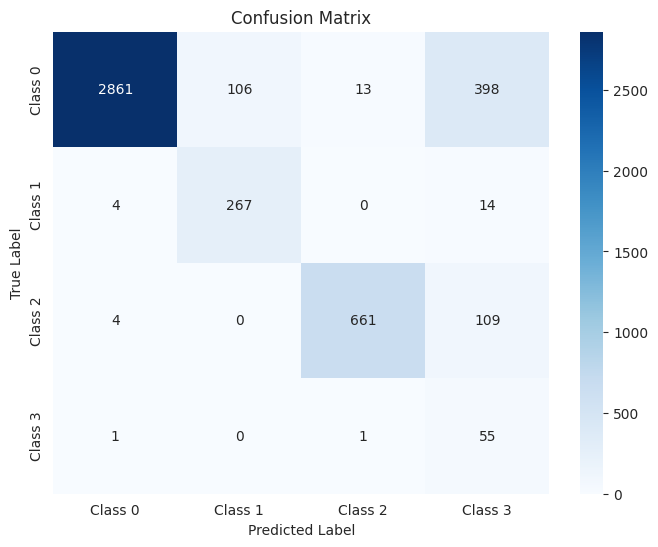

The function took 0.3927 seconds to execute.
[ARCH#062-[32, 32, 8, 2]] early-stop @ epoch 044
[ARCH#062-[32, 32, 8, 2]] done in 28.3s  best-val=1.3794


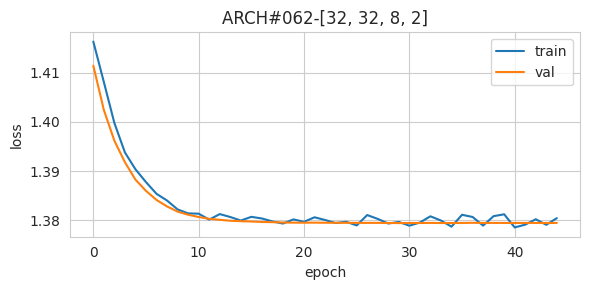


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



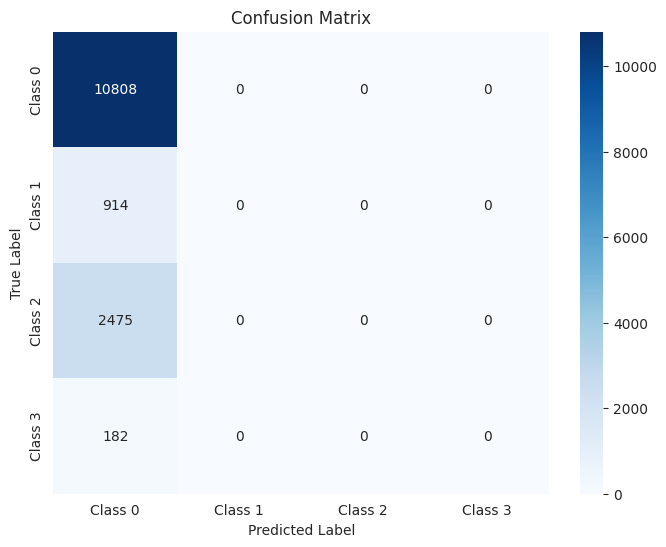

The function took 0.5499 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



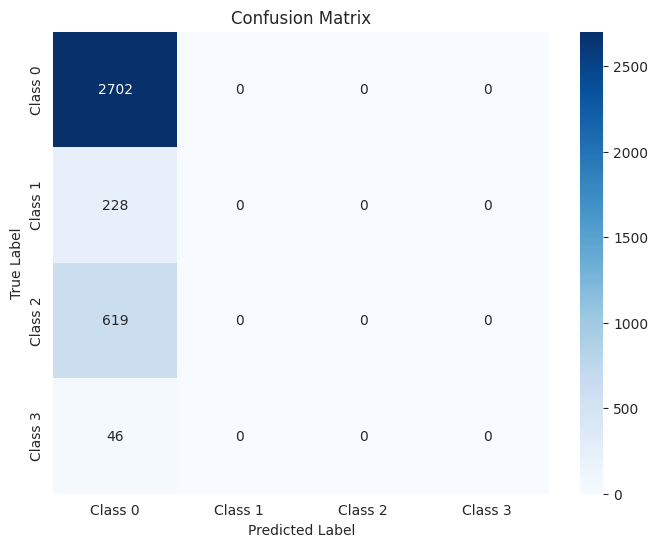

The function took 0.3768 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



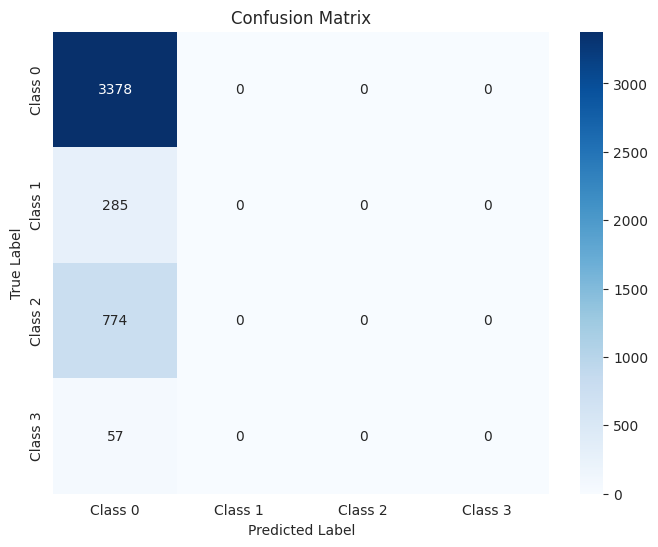

The function took 0.3928 seconds to execute.
[ARCH#063-[32, 32, 4, 4]] done in 31.3s  best-val=0.3232


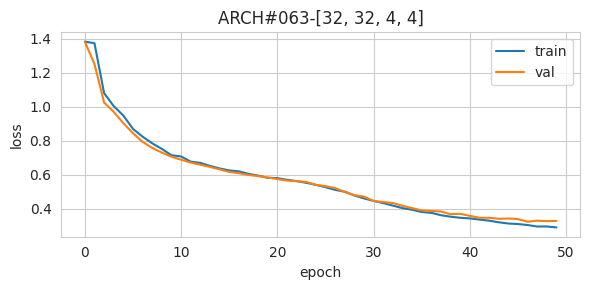


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.20      0.99      0.33       182

    accuracy                           0.92     14379
   macro avg       0.74      0.93      0.77     14379
weighted avg       0.96      0.92      0.94     14379



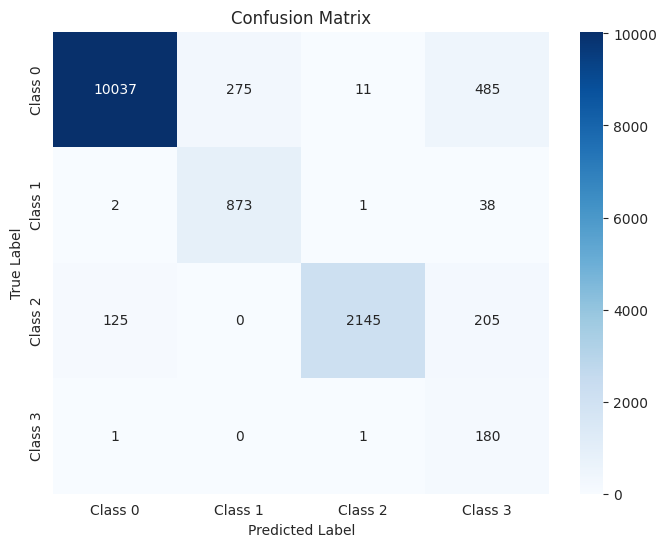

The function took 0.8056 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.99      0.88      0.94       619
     Class 3       0.19      0.98      0.32        46

    accuracy                           0.92      3595
   macro avg       0.74      0.93      0.76      3595
weighted avg       0.97      0.92      0.94      3595



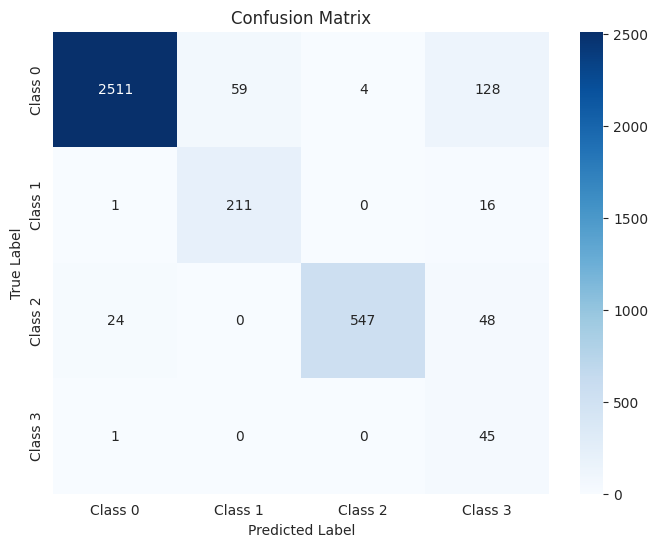

The function took 0.4030 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.76      0.93      0.84       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.19      0.95      0.31        57

    accuracy                           0.91      4494
   macro avg       0.73      0.91      0.75      4494
weighted avg       0.96      0.91      0.93      4494



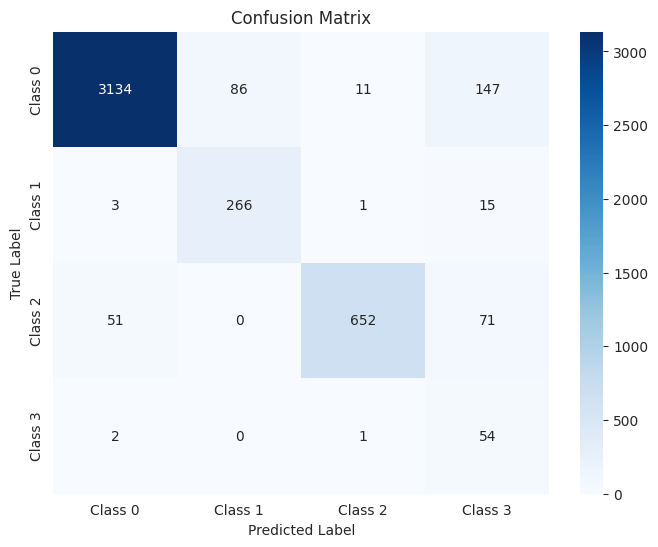

The function took 0.4445 seconds to execute.
[ARCH#064-[32, 32, 4, 2]] done in 31.4s  best-val=0.4955


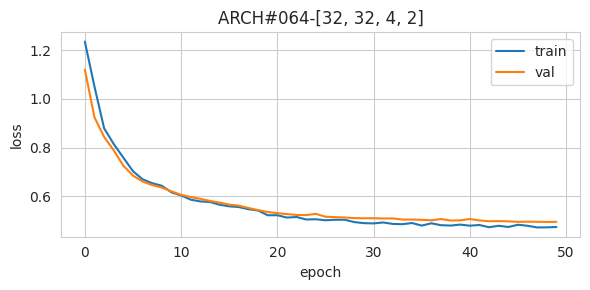


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.36      0.52     10808
     Class 1       0.77      0.91      0.83       914
     Class 2       0.91      0.94      0.92      2475
     Class 3       0.02      0.89      0.05       182

    accuracy                           0.50     14379
   macro avg       0.67      0.77      0.58     14379
weighted avg       0.94      0.50      0.60     14379



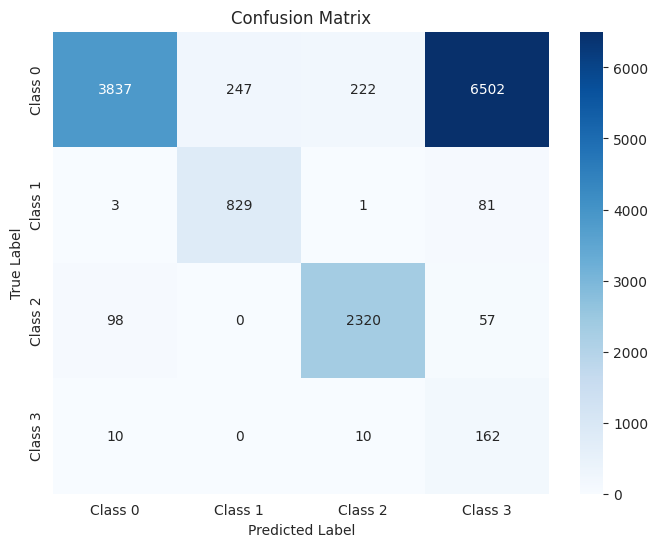

The function took 0.5639 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.35      0.52      2702
     Class 1       0.79      0.87      0.83       228
     Class 2       0.88      0.95      0.92       619
     Class 3       0.02      0.89      0.05        46

    accuracy                           0.49      3595
   macro avg       0.67      0.77      0.58      3595
weighted avg       0.94      0.49      0.60      3595



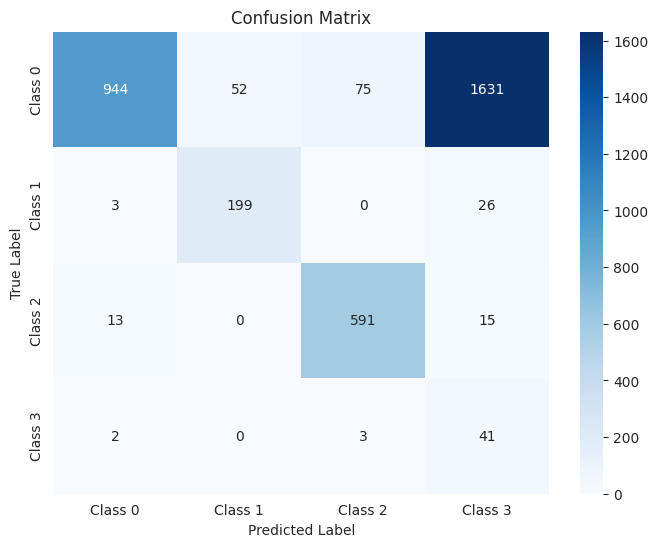

The function took 0.3812 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.35      0.52      3378
     Class 1       0.77      0.89      0.82       285
     Class 2       0.92      0.93      0.92       774
     Class 3       0.02      0.89      0.05        57

    accuracy                           0.49      4494
   macro avg       0.67      0.77      0.58      4494
weighted avg       0.93      0.49      0.60      4494



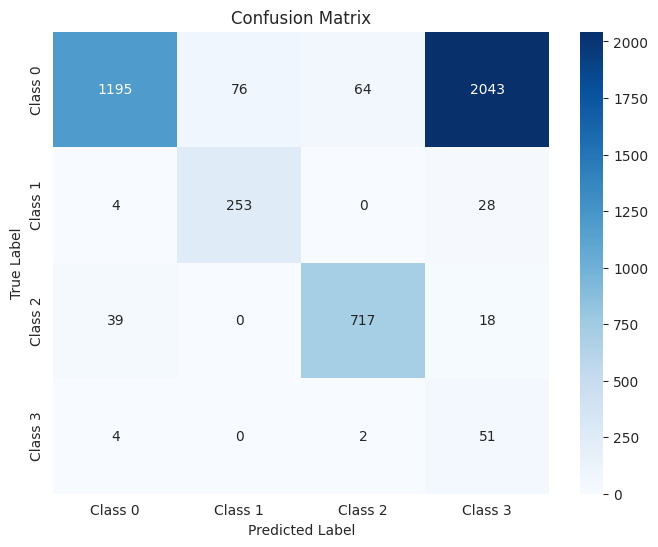

The function took 0.3746 seconds to execute.
[ARCH#065-[32, 32, 2, 2]] early-stop @ epoch 035
[ARCH#065-[32, 32, 2, 2]] done in 22.9s  best-val=1.3794


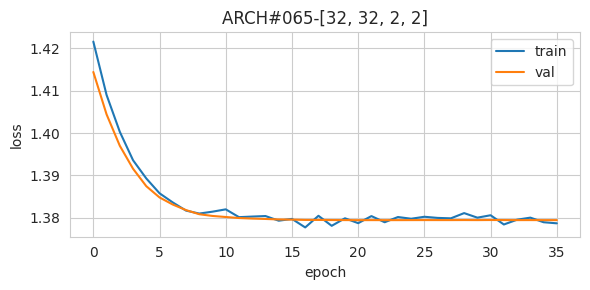


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



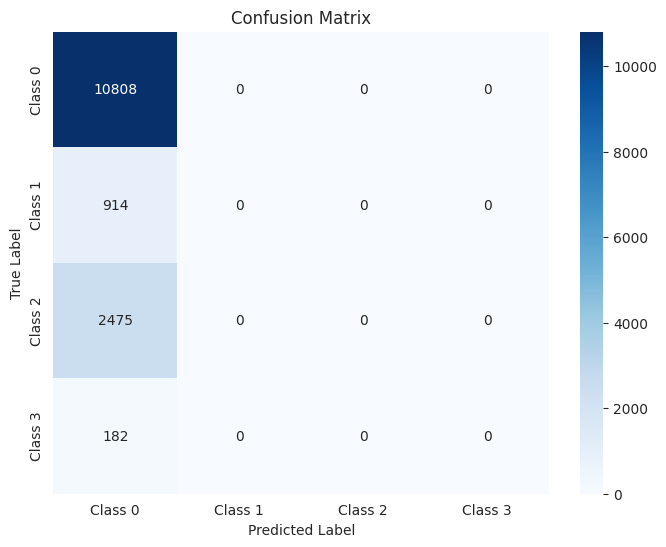

The function took 0.8944 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.64      3595



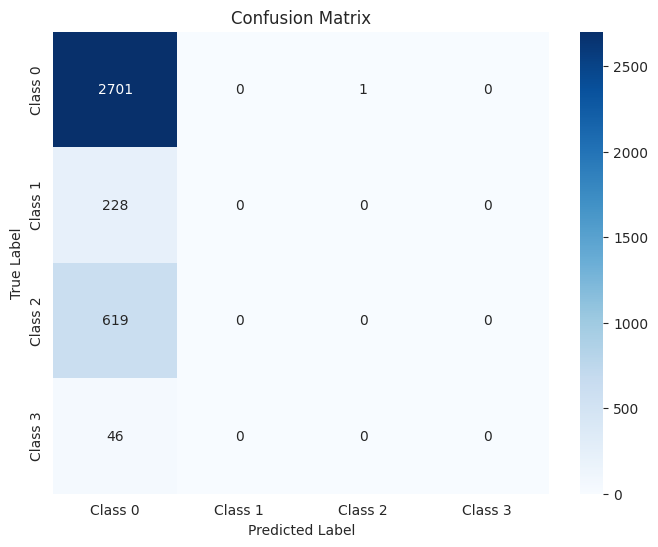

The function took 0.3427 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.56      0.75      0.64      4494



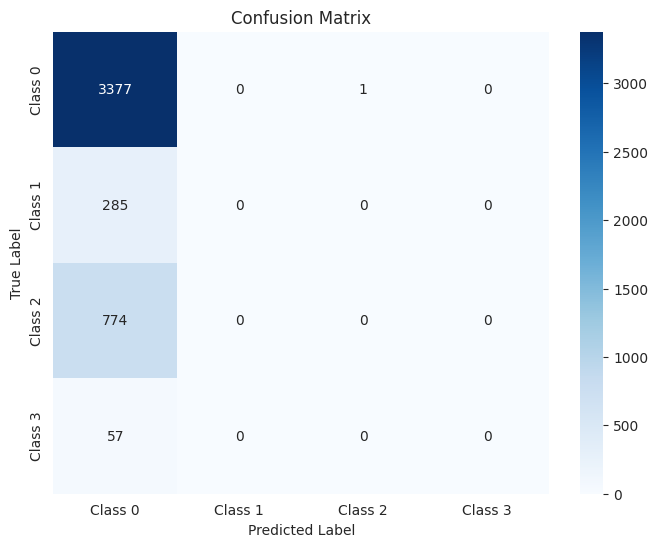

The function took 0.3792 seconds to execute.
[ARCH#066-[32, 16, 16, 16]] done in 31.4s  best-val=0.2074


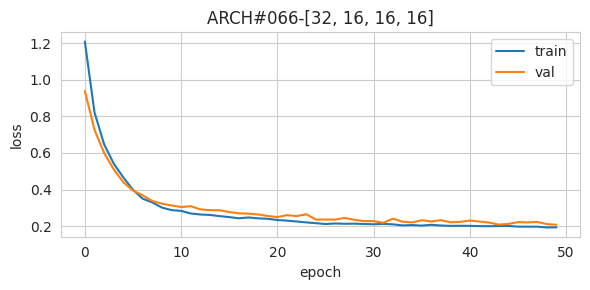


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.78      0.96      0.86       914
     Class 2       0.85      0.95      0.90      2475
     Class 3       0.37      0.88      0.52       182

    accuracy                           0.93     14379
   macro avg       0.75      0.93      0.81     14379
weighted avg       0.94      0.93      0.93     14379



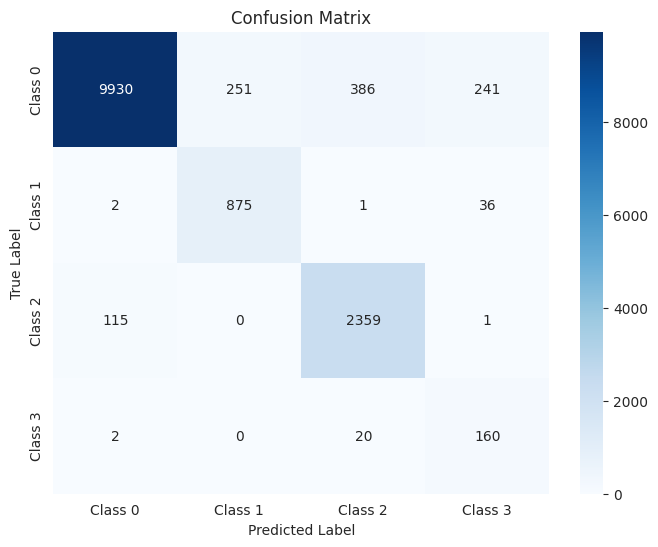

The function took 0.5747 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.79      0.93      0.86       228
     Class 2       0.85      0.97      0.90       619
     Class 3       0.34      0.87      0.49        46

    accuracy                           0.93      3595
   macro avg       0.74      0.92      0.80      3595
weighted avg       0.94      0.93      0.93      3595



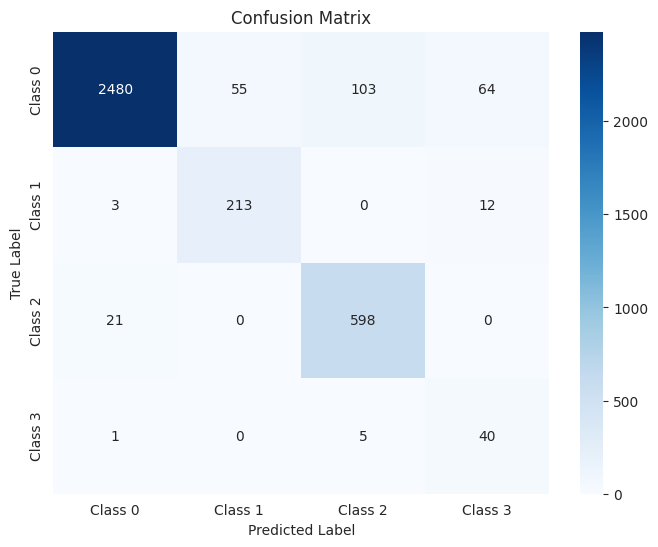

The function took 0.3706 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.78      0.94      0.85       285
     Class 2       0.86      0.94      0.90       774
     Class 3       0.36      0.86      0.51        57

    accuracy                           0.93      4494
   macro avg       0.75      0.91      0.80      4494
weighted avg       0.94      0.93      0.93      4494



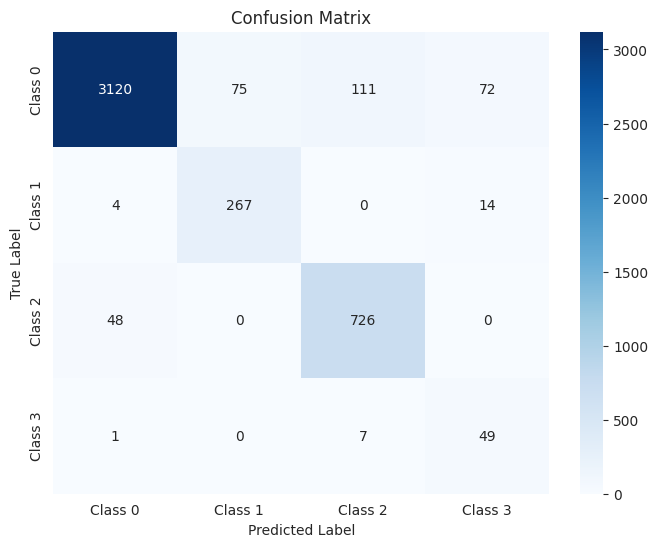

The function took 0.4027 seconds to execute.
[ARCH#067-[32, 16, 16, 8]] done in 32.1s  best-val=0.2202


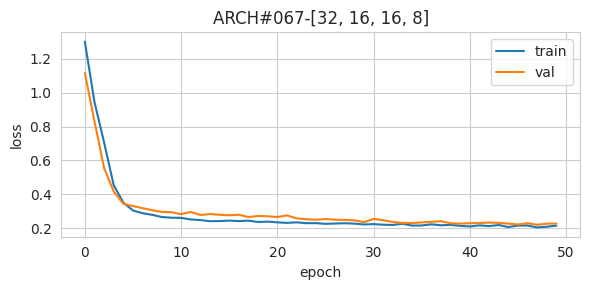


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.82      0.93      0.87      2475
     Class 3       0.28      0.96      0.44       182

    accuracy                           0.91     14379
   macro avg       0.72      0.93      0.78     14379
weighted avg       0.94      0.91      0.92     14379



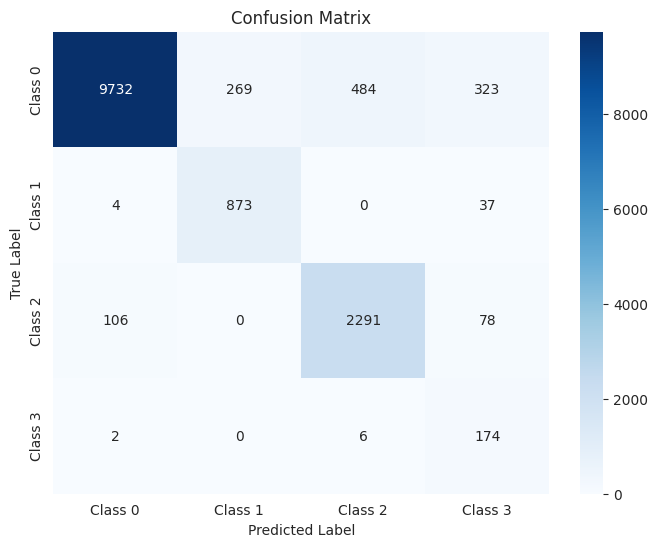

The function took 0.5596 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.82      0.94      0.88       619
     Class 3       0.28      1.00      0.44        46

    accuracy                           0.91      3595
   macro avg       0.72      0.94      0.78      3595
weighted avg       0.94      0.91      0.92      3595



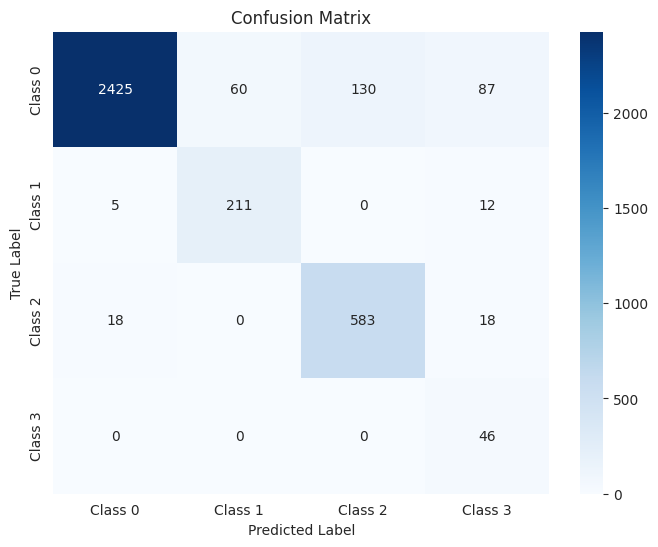

The function took 0.3712 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.76      0.93      0.84       285
     Class 2       0.83      0.91      0.87       774
     Class 3       0.30      0.91      0.45        57

    accuracy                           0.91      4494
   macro avg       0.72      0.92      0.78      4494
weighted avg       0.94      0.91      0.92      4494



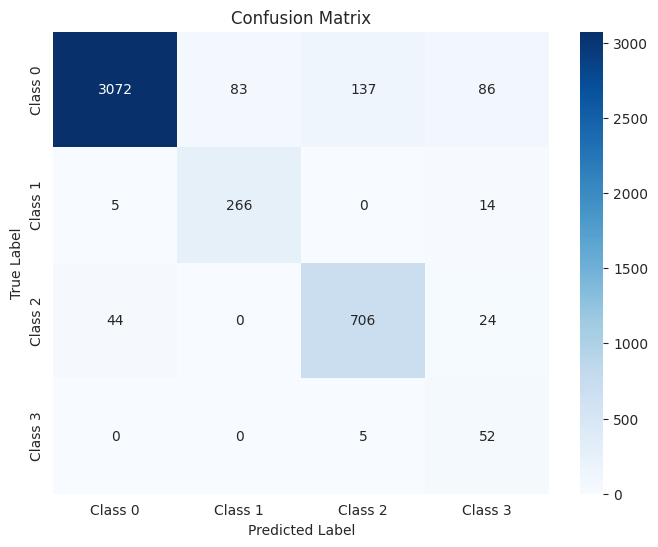

The function took 0.4375 seconds to execute.
[ARCH#068-[32, 16, 16, 4]] done in 31.4s  best-val=0.3000


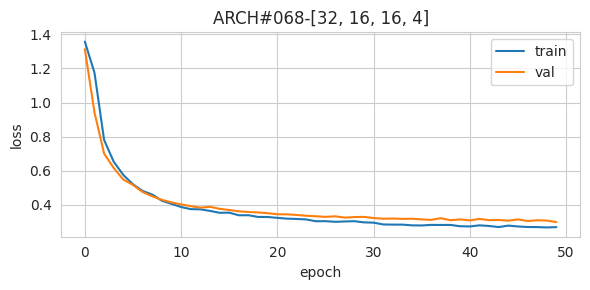


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95     10808
     Class 1       0.77      0.91      0.84       914
     Class 2       0.87      0.95      0.91      2475
     Class 3       0.39      0.87      0.54       182

    accuracy                           0.93     14379
   macro avg       0.76      0.91      0.81     14379
weighted avg       0.94      0.93      0.93     14379



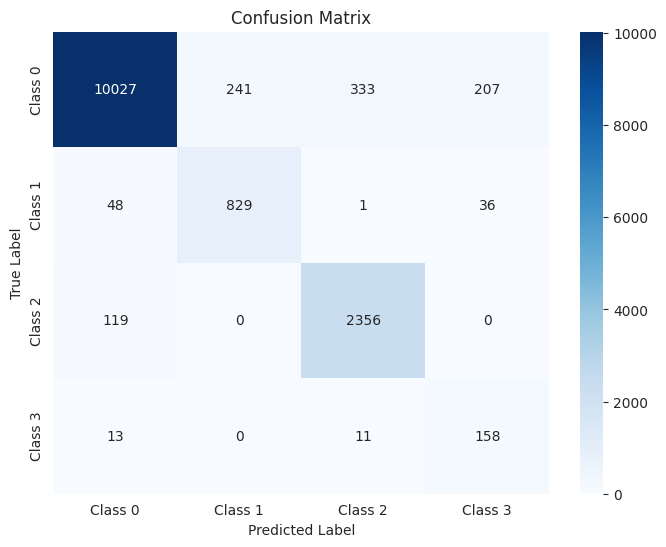

The function took 0.5664 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      2702
     Class 1       0.80      0.87      0.83       228
     Class 2       0.86      0.96      0.91       619
     Class 3       0.36      0.85      0.50        46

    accuracy                           0.93      3595
   macro avg       0.75      0.90      0.80      3595
weighted avg       0.94      0.93      0.93      3595



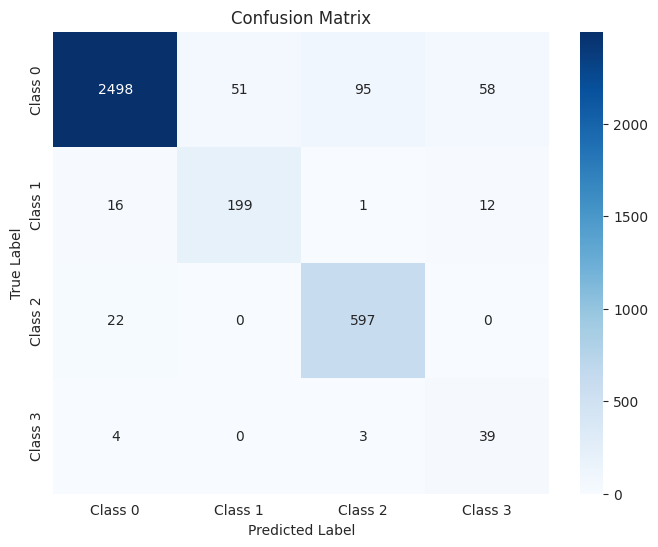

The function took 0.4004 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.79      0.89      0.83       285
     Class 2       0.85      0.95      0.90       774
     Class 3       0.38      0.81      0.52        57

    accuracy                           0.93      4494
   macro avg       0.75      0.89      0.80      4494
weighted avg       0.94      0.93      0.93      4494



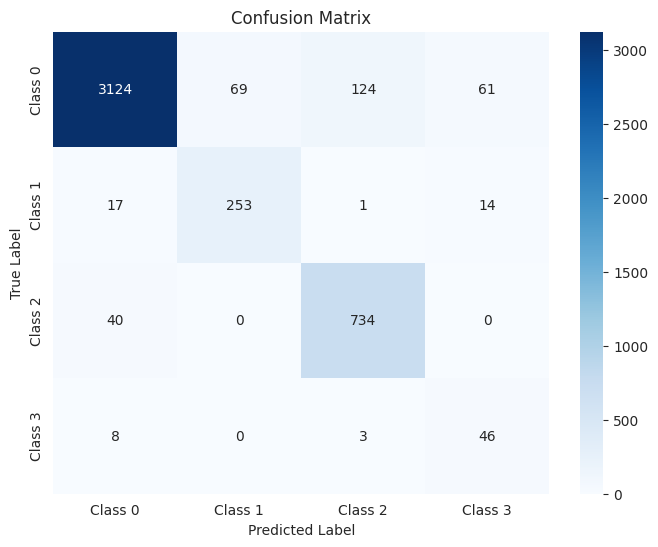

The function took 0.4166 seconds to execute.
[ARCH#069-[32, 16, 16, 2]] done in 32.4s  best-val=0.5878


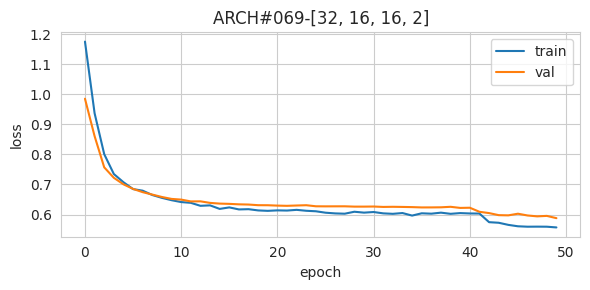


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.92      0.94     10808
     Class 1       0.77      0.86      0.81       914
     Class 2       0.79      0.96      0.87      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.91     14379
   macro avg       0.63      0.69      0.66     14379
weighted avg       0.91      0.91      0.91     14379



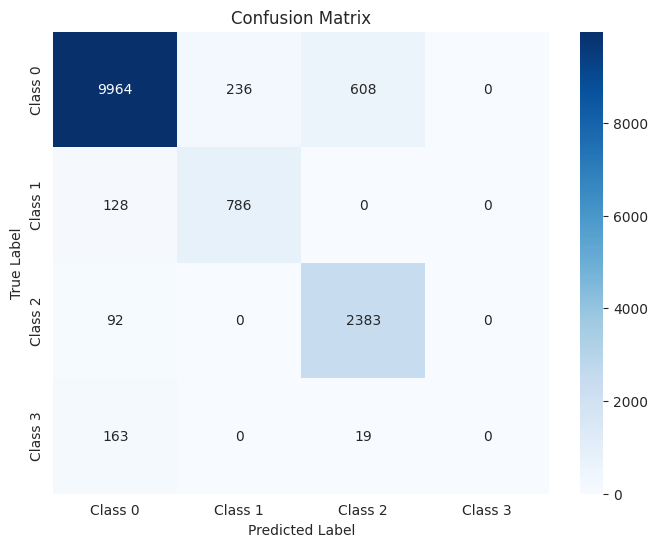

The function took 0.5785 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.94      2702
     Class 1       0.79      0.81      0.80       228
     Class 2       0.80      0.97      0.88       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.92      3595
   macro avg       0.64      0.68      0.66      3595
weighted avg       0.91      0.92      0.91      3595



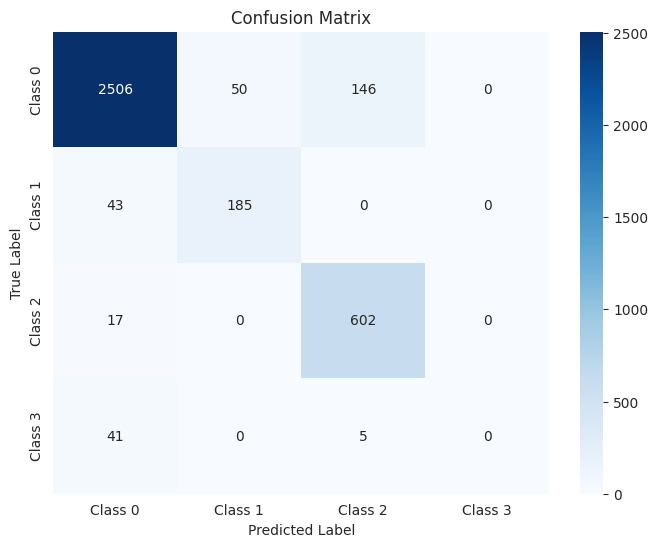

The function took 0.3711 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.92      0.94      3378
     Class 1       0.77      0.84      0.81       285
     Class 2       0.79      0.95      0.86       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.91      4494
   macro avg       0.63      0.68      0.65      4494
weighted avg       0.91      0.91      0.91      4494



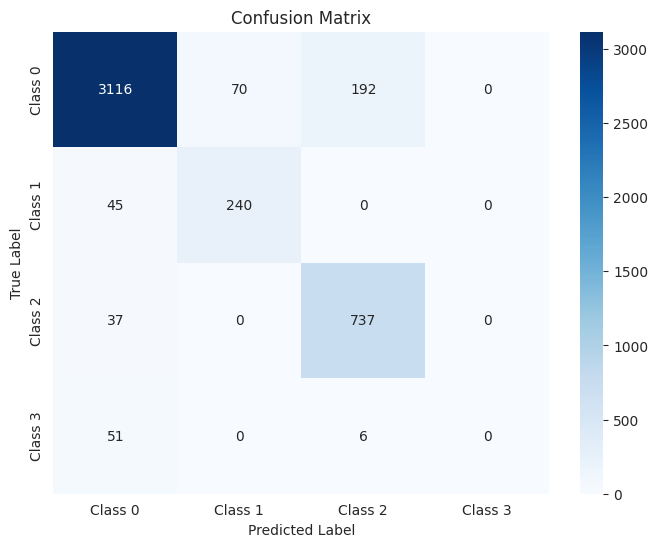

The function took 0.4124 seconds to execute.
[ARCH#070-[32, 16, 8, 8]] done in 30.9s  best-val=0.2164


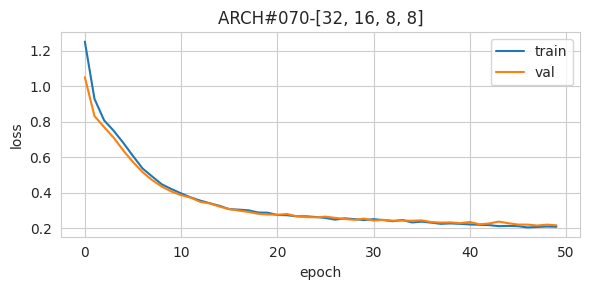


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.24      0.97      0.38       182

    accuracy                           0.93     14379
   macro avg       0.74      0.94      0.78     14379
weighted avg       0.96      0.93      0.94     14379



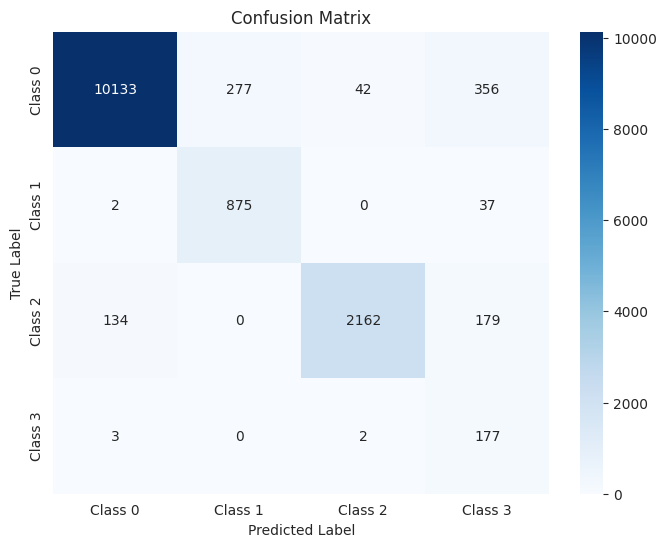

The function took 0.5810 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.22      0.98      0.36        46

    accuracy                           0.93      3595
   macro avg       0.74      0.93      0.77      3595
weighted avg       0.96      0.93      0.94      3595



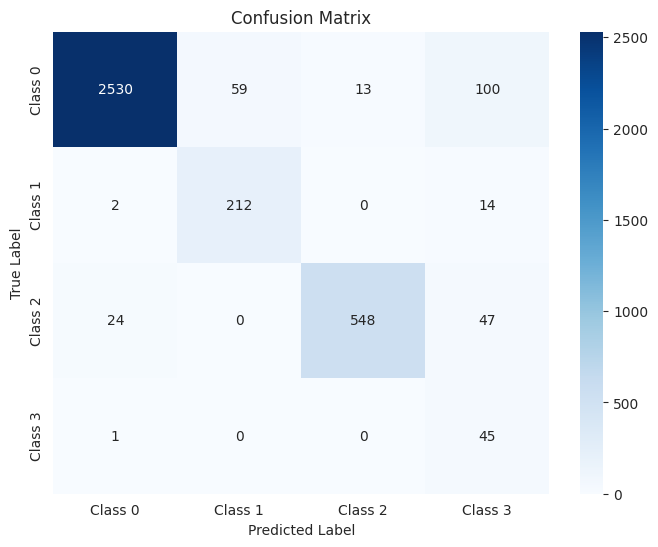

The function took 0.3817 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.24      0.95      0.38        57

    accuracy                           0.93      4494
   macro avg       0.74      0.92      0.77      4494
weighted avg       0.96      0.93      0.94      4494



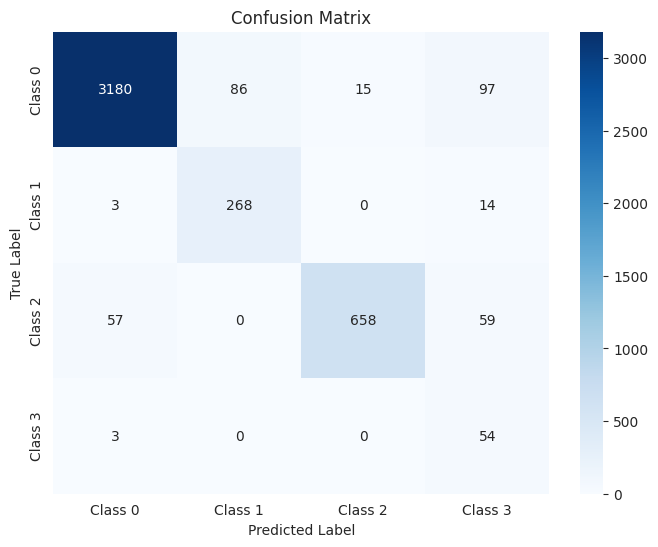

The function took 0.4279 seconds to execute.
[ARCH#071-[32, 16, 8, 4]] done in 31.9s  best-val=0.2370


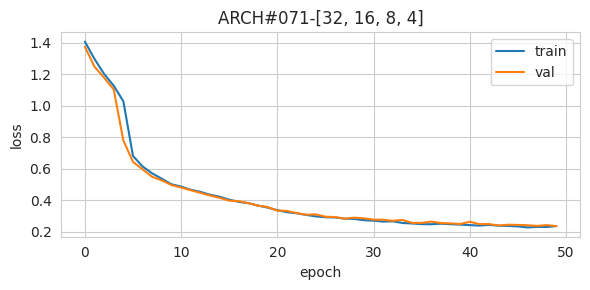


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.94     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.85      0.90      0.88      2475
     Class 3       0.18      0.93      0.30       182

    accuracy                           0.89     14379
   macro avg       0.69      0.92      0.73     14379
weighted avg       0.94      0.89      0.91     14379



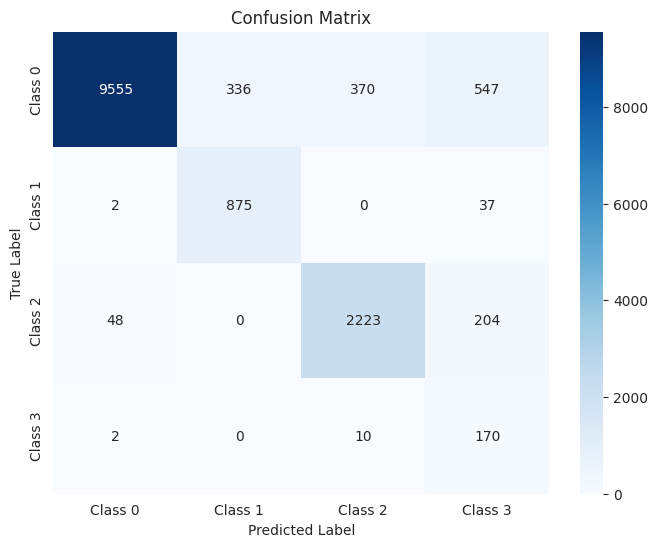

The function took 0.6044 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.87      0.90      0.89       619
     Class 3       0.17      0.93      0.29        46

    accuracy                           0.89      3595
   macro avg       0.70      0.91      0.74      3595
weighted avg       0.95      0.89      0.91      3595



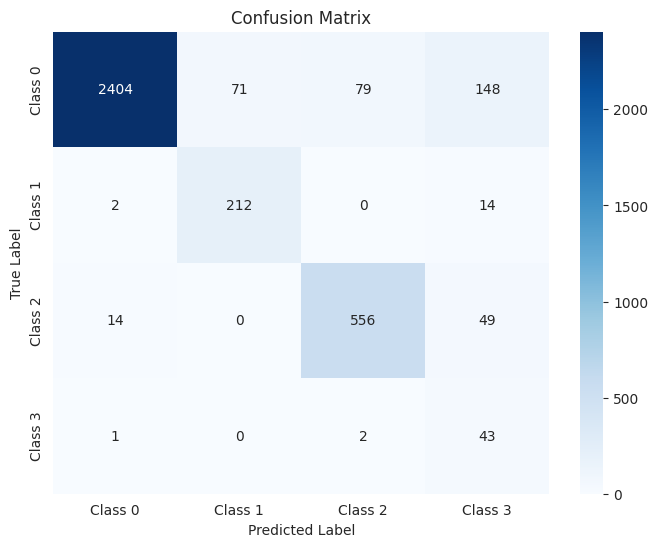

The function took 0.3687 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.72      0.94      0.82       285
     Class 2       0.84      0.89      0.86       774
     Class 3       0.18      0.91      0.30        57

    accuracy                           0.89      4494
   macro avg       0.68      0.91      0.73      4494
weighted avg       0.94      0.89      0.91      4494



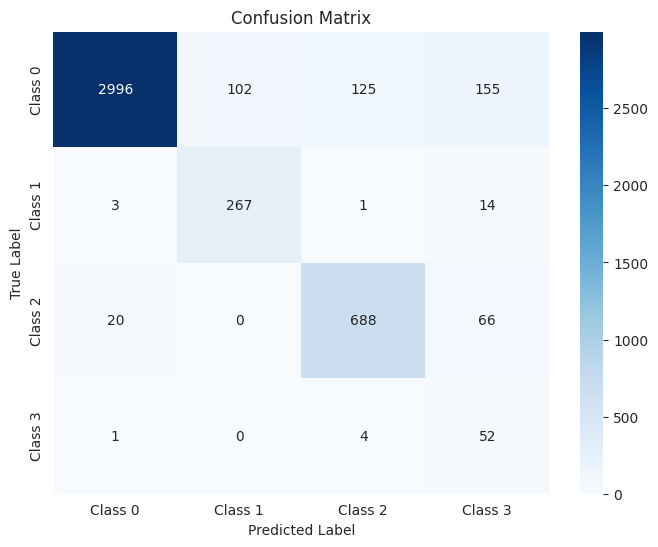

The function took 0.4111 seconds to execute.
[ARCH#072-[32, 16, 8, 2]] done in 31.2s  best-val=0.4049


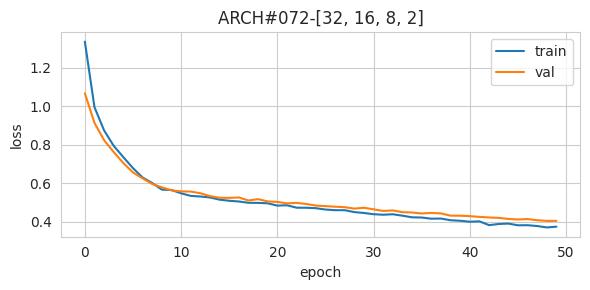


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.95      0.95     10808
     Class 1       0.75      0.86      0.80       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.34      0.88      0.49       182

    accuracy                           0.93     14379
   macro avg       0.76      0.89      0.79     14379
weighted avg       0.94      0.93      0.93     14379



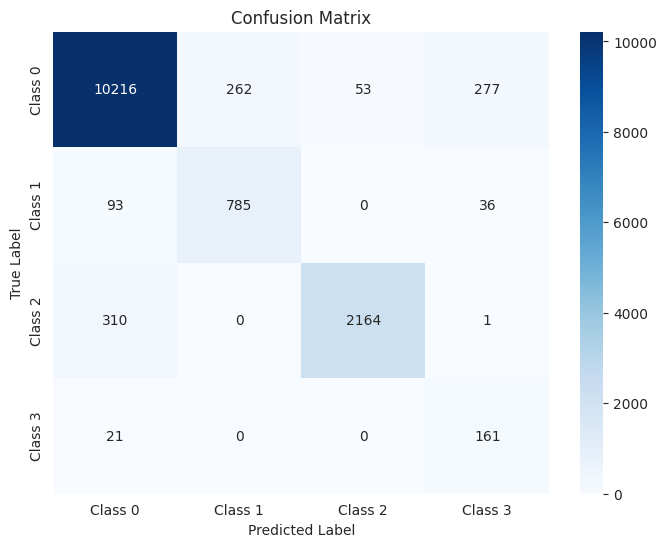

The function took 0.5837 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.95      0.95      2702
     Class 1       0.77      0.81      0.79       228
     Class 2       0.97      0.89      0.93       619
     Class 3       0.31      0.87      0.46        46

    accuracy                           0.93      3595
   macro avg       0.75      0.88      0.78      3595
weighted avg       0.94      0.93      0.93      3595



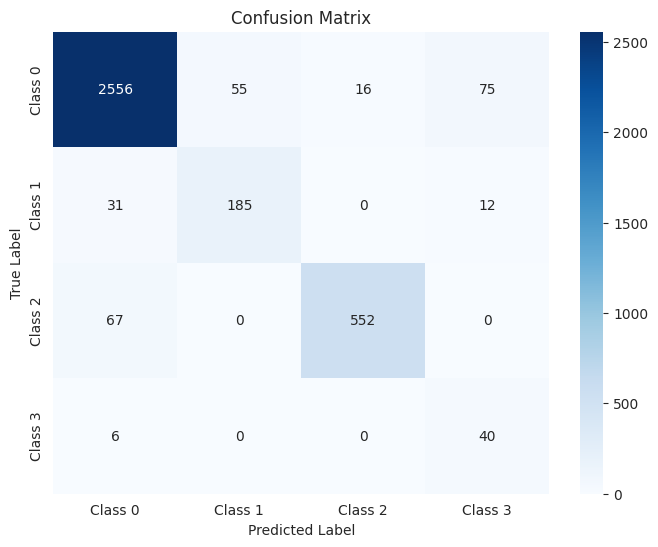

The function took 0.3876 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.95      0.95      3378
     Class 1       0.75      0.84      0.80       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.34      0.88      0.49        57

    accuracy                           0.92      4494
   macro avg       0.75      0.88      0.79      4494
weighted avg       0.94      0.92      0.93      4494



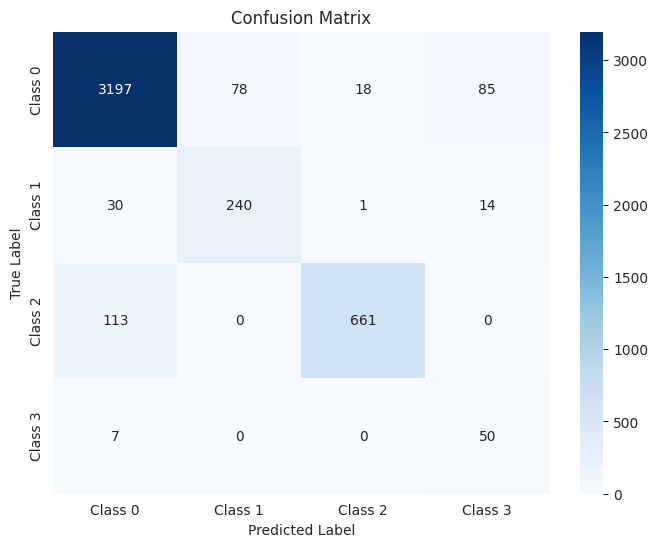

The function took 0.4177 seconds to execute.
[ARCH#073-[32, 16, 4, 4]] done in 31.7s  best-val=0.2450


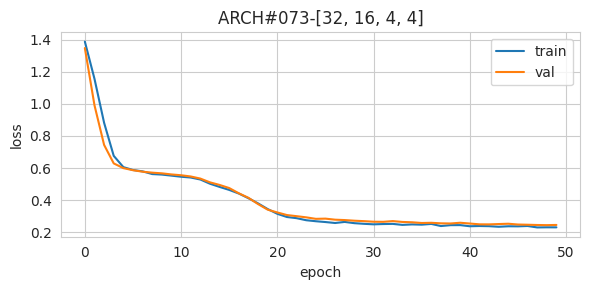


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.84      0.96      0.89      2475
     Class 3       0.24      0.88      0.37       182

    accuracy                           0.91     14379
   macro avg       0.71      0.92      0.76     14379
weighted avg       0.94      0.91      0.92     14379



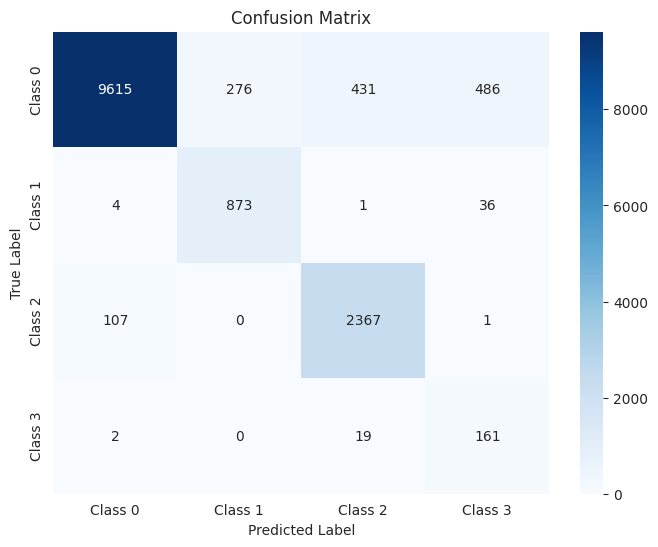

The function took 0.5807 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.82      0.97      0.89       619
     Class 3       0.23      0.89      0.37        46

    accuracy                           0.90      3595
   macro avg       0.71      0.92      0.76      3595
weighted avg       0.94      0.90      0.92      3595



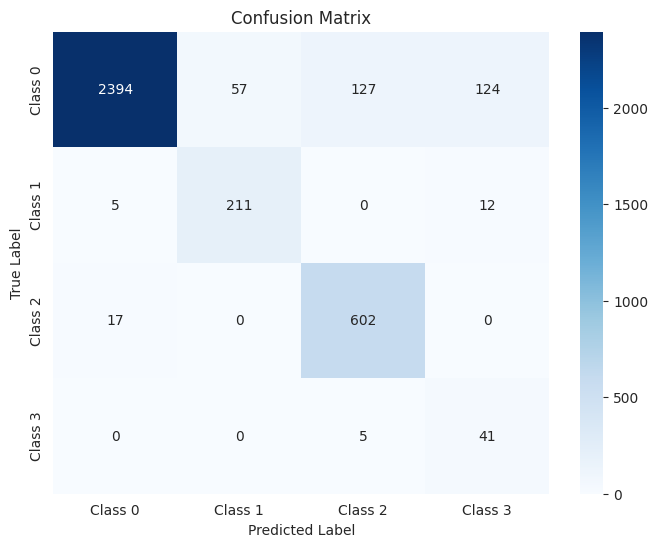

The function took 0.3705 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.90      0.94      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.85      0.94      0.89       774
     Class 3       0.24      0.89      0.37        57

    accuracy                           0.91      4494
   macro avg       0.71      0.92      0.76      4494
weighted avg       0.94      0.91      0.92      4494



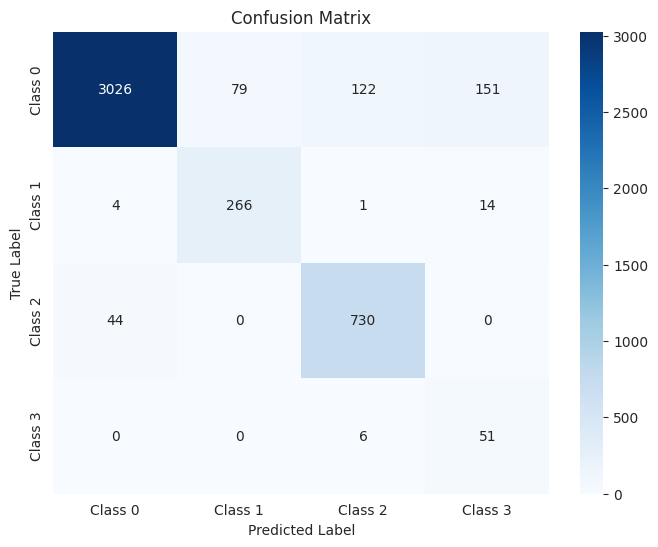

The function took 0.7307 seconds to execute.
[ARCH#074-[32, 16, 4, 2]] done in 31.5s  best-val=0.3192


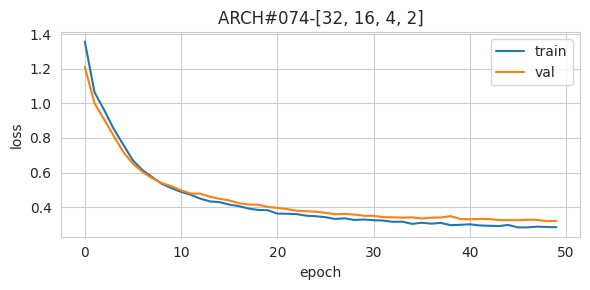


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96     10808
     Class 1       0.74      0.96      0.83       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.36      0.88      0.51       182

    accuracy                           0.93     14379
   macro avg       0.76      0.91      0.81     14379
weighted avg       0.95      0.93      0.94     14379



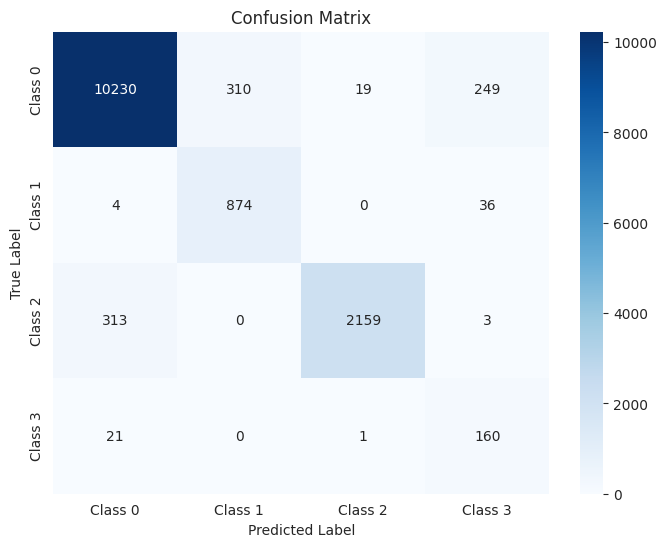

The function took 0.5754 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.33      0.87      0.48        46

    accuracy                           0.94      3595
   macro avg       0.76      0.91      0.80      3595
weighted avg       0.95      0.94      0.94      3595



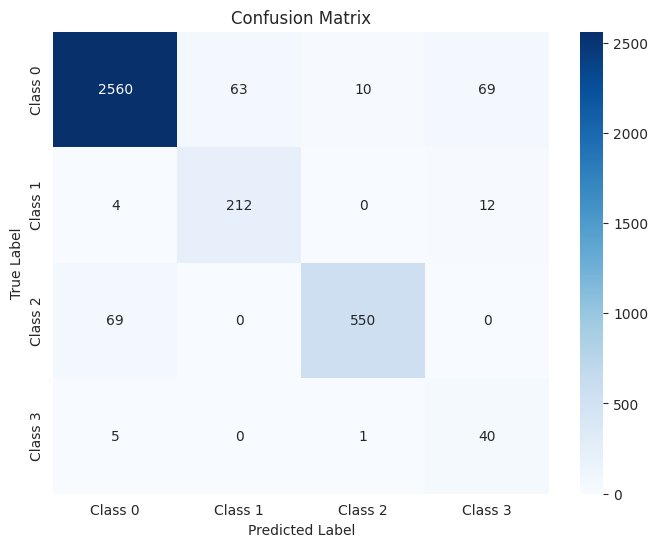

The function took 0.3700 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.95      0.95      3378
     Class 1       0.73      0.93      0.82       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.37      0.86      0.52        57

    accuracy                           0.93      4494
   macro avg       0.76      0.90      0.80      4494
weighted avg       0.94      0.93      0.93      4494



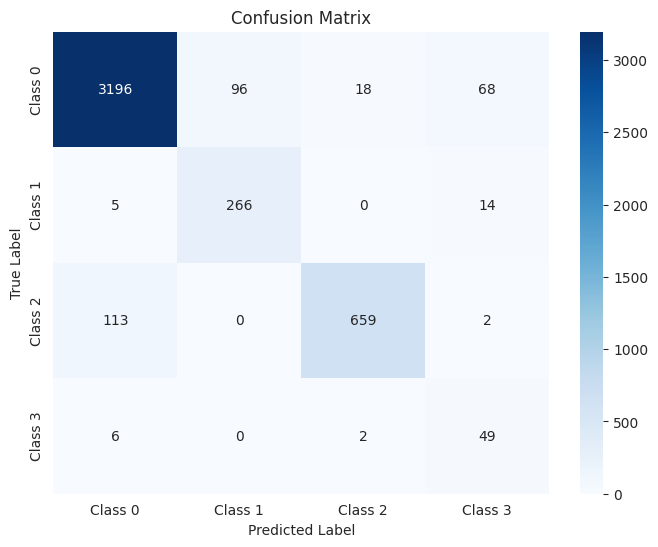

The function took 0.4429 seconds to execute.
[ARCH#075-[32, 16, 2, 2]] early-stop @ epoch 045
[ARCH#075-[32, 16, 2, 2]] done in 29.6s  best-val=1.3794


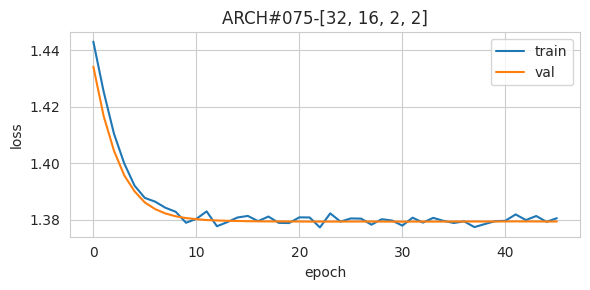


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



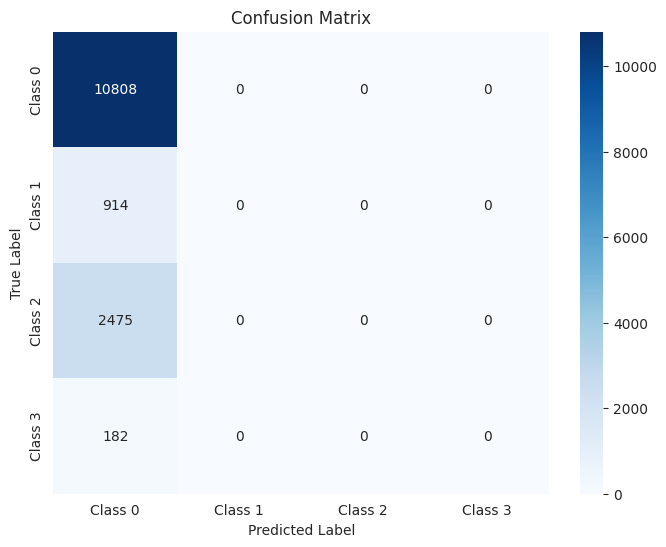

The function took 0.6988 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



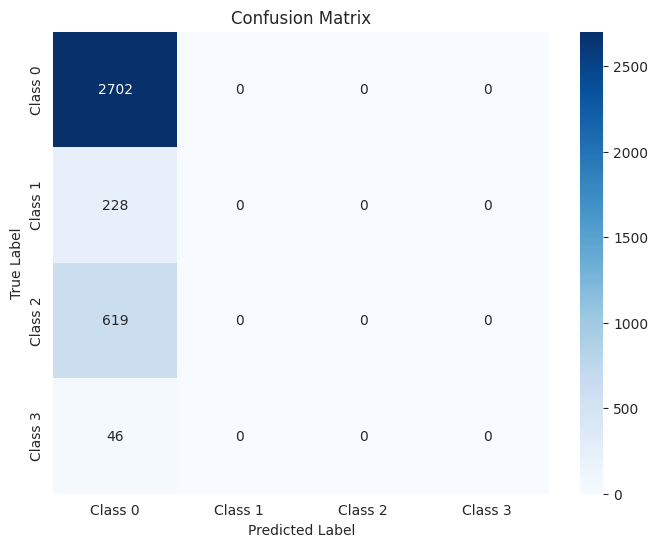

The function took 0.3833 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



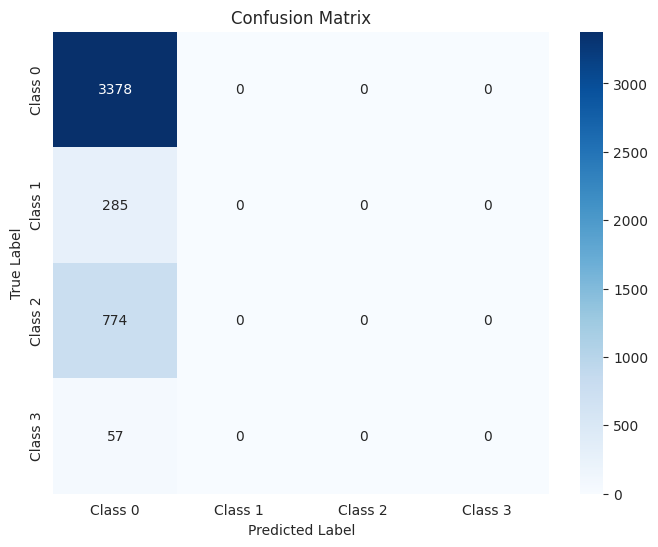

The function took 0.4296 seconds to execute.
[ARCH#076-[32, 8, 8, 8]] done in 31.7s  best-val=0.2367


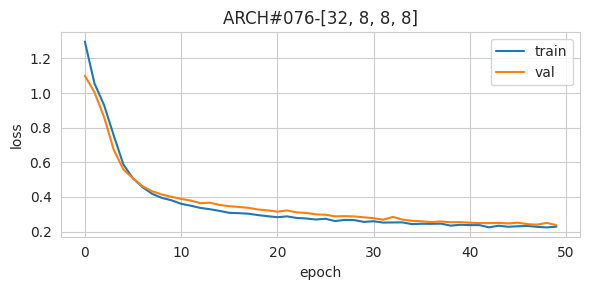


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.92      0.92      0.92      2475
     Class 3       0.28      0.92      0.42       182

    accuracy                           0.93     14379
   macro avg       0.73      0.93      0.78     14379
weighted avg       0.95      0.93      0.93     14379



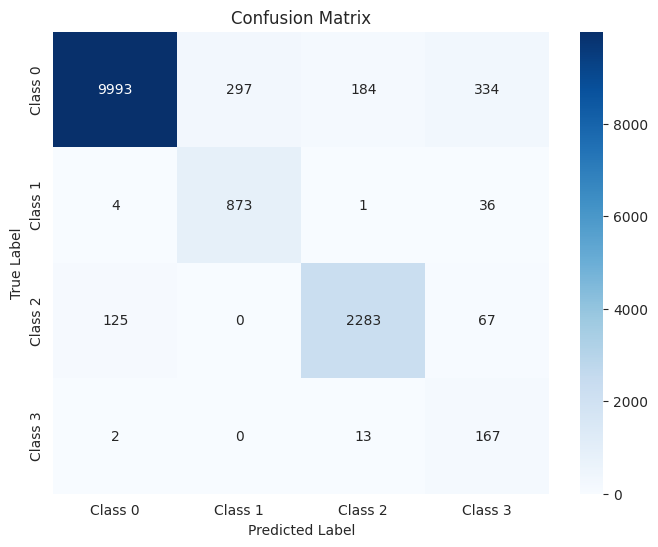

The function took 0.5753 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.92      0.94      0.93       619
     Class 3       0.26      0.91      0.41        46

    accuracy                           0.93      3595
   macro avg       0.73      0.93      0.78      3595
weighted avg       0.95      0.93      0.94      3595



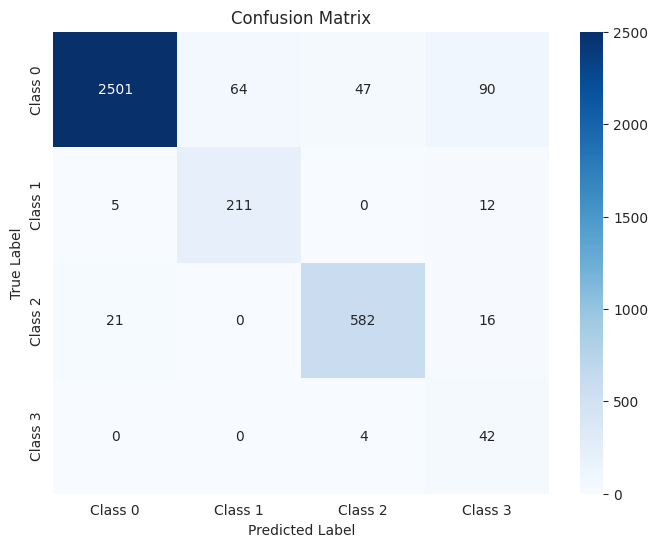

The function took 0.3724 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.75      0.93      0.83       285
     Class 2       0.93      0.91      0.92       774
     Class 3       0.27      0.89      0.41        57

    accuracy                           0.92      4494
   macro avg       0.73      0.92      0.78      4494
weighted avg       0.95      0.92      0.93      4494



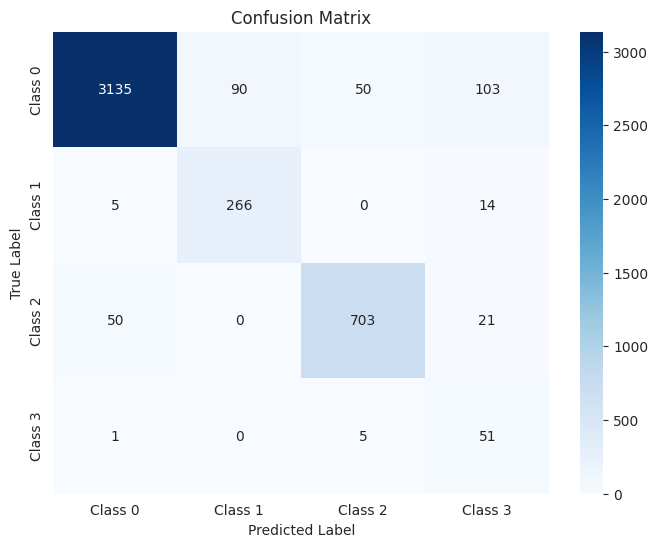

The function took 0.3870 seconds to execute.
[ARCH#077-[32, 8, 8, 4]] done in 32.1s  best-val=0.2568


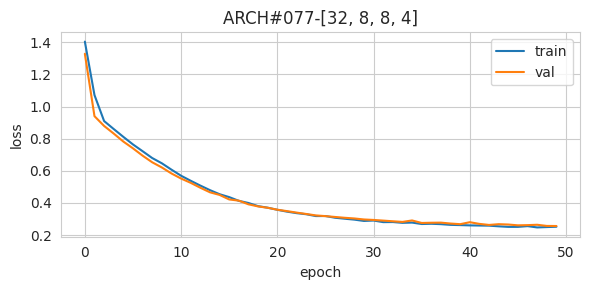


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95     10808
     Class 1       0.74      0.96      0.83       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.31      0.88      0.46       182

    accuracy                           0.93     14379
   macro avg       0.75      0.91      0.79     14379
weighted avg       0.95      0.93      0.94     14379



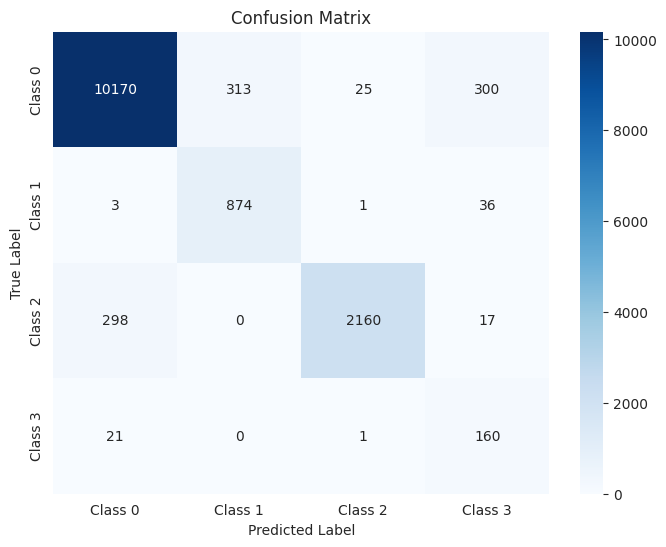

The function took 0.5681 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.96      2702
     Class 1       0.76      0.93      0.83       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.28      0.87      0.43        46

    accuracy                           0.93      3595
   macro avg       0.75      0.91      0.79      3595
weighted avg       0.95      0.93      0.94      3595



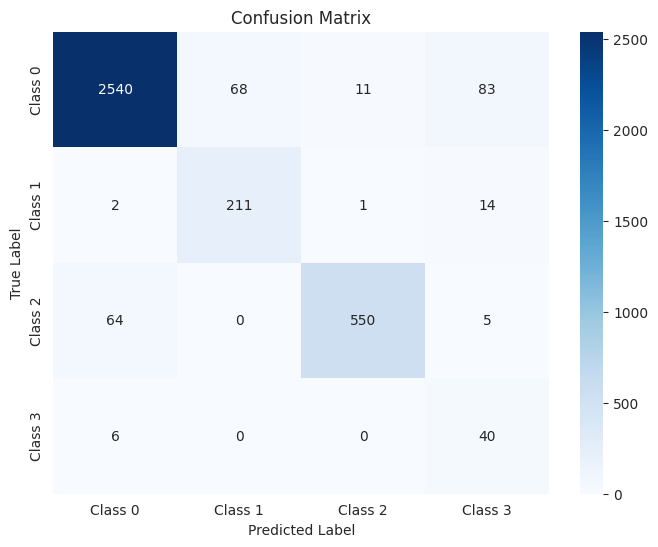

The function took 0.3691 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95      3378
     Class 1       0.74      0.93      0.82       285
     Class 2       0.96      0.85      0.91       774
     Class 3       0.32      0.86      0.46        57

    accuracy                           0.92      4494
   macro avg       0.75      0.90      0.79      4494
weighted avg       0.94      0.92      0.93      4494



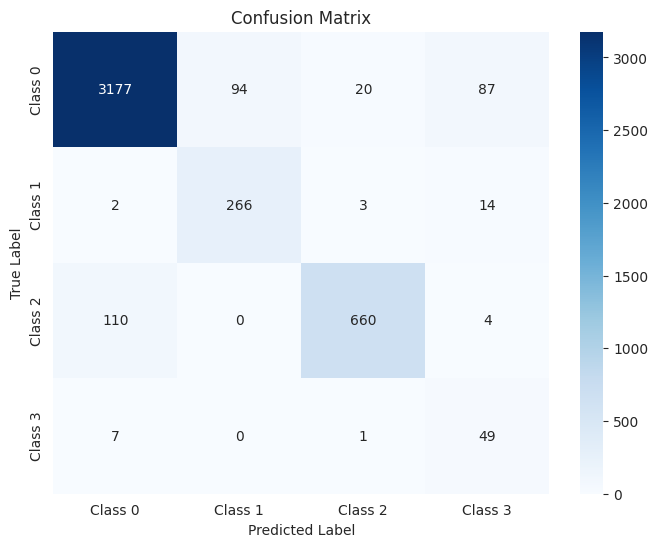

The function took 0.4377 seconds to execute.
[ARCH#078-[32, 8, 8, 2]] done in 31.3s  best-val=0.2731


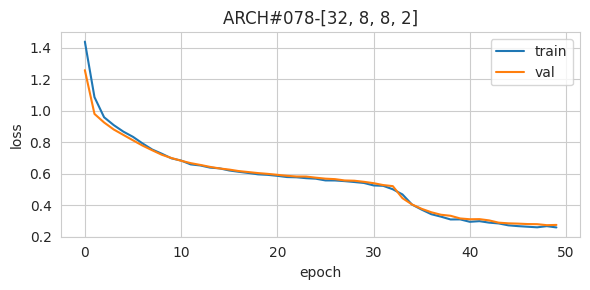


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.16      0.98      0.27       182

    accuracy                           0.90     14379
   macro avg       0.72      0.93      0.74     14379
weighted avg       0.96      0.90      0.92     14379



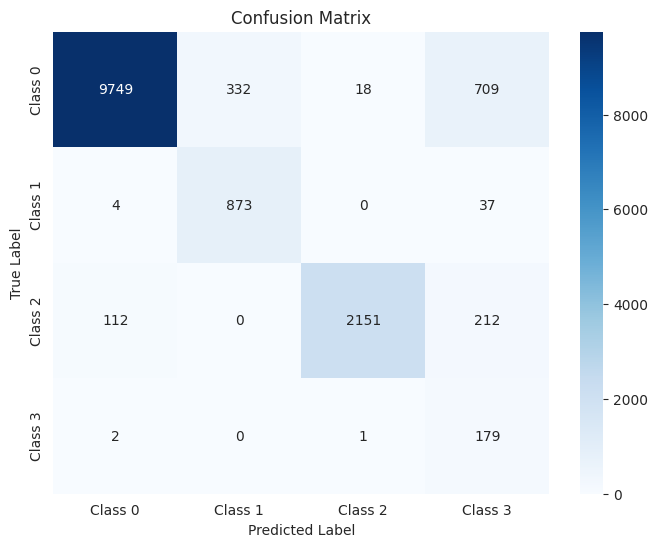

The function took 0.5718 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.74      0.93      0.82       228
     Class 2       0.99      0.89      0.93       619
     Class 3       0.15      0.98      0.27        46

    accuracy                           0.90      3595
   macro avg       0.72      0.92      0.74      3595
weighted avg       0.96      0.90      0.93      3595



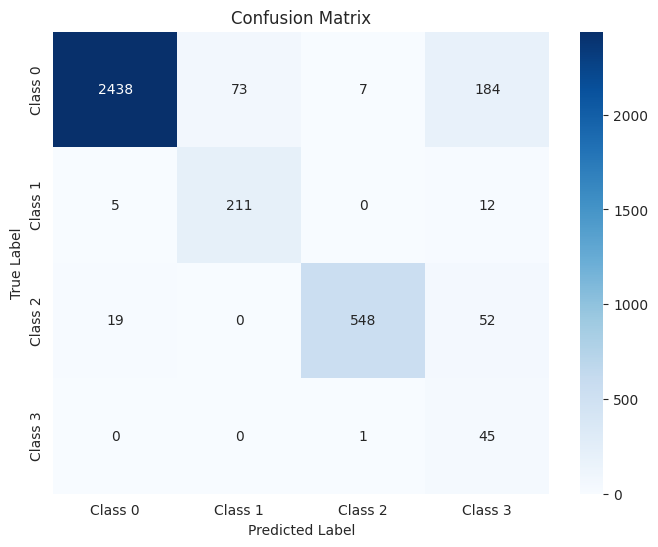

The function took 0.3858 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94      3378
     Class 1       0.72      0.94      0.81       285
     Class 2       0.98      0.84      0.90       774
     Class 3       0.16      0.96      0.27        57

    accuracy                           0.90      4494
   macro avg       0.71      0.91      0.73      4494
weighted avg       0.96      0.90      0.92      4494



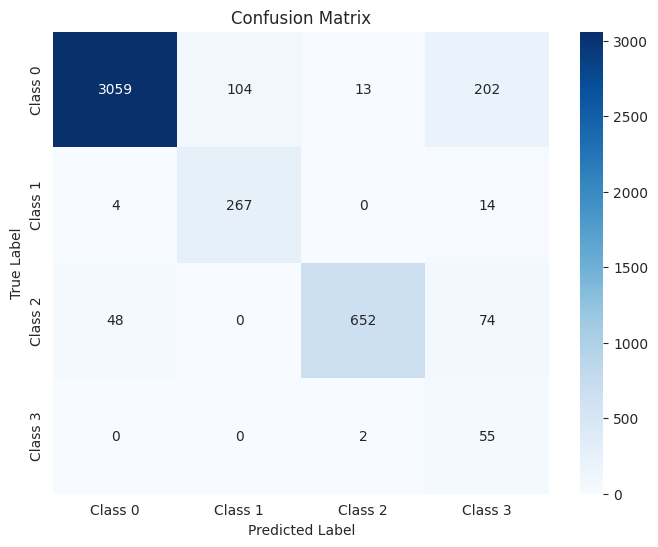

The function took 0.3991 seconds to execute.
[ARCH#079-[32, 8, 4, 4]] done in 31.9s  best-val=0.3674


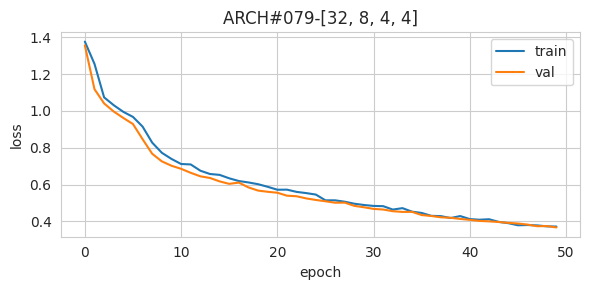


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.90      0.93     10808
     Class 1       0.61      0.91      0.73       914
     Class 2       0.95      0.86      0.90      2475
     Class 3       0.24      0.91      0.37       182

    accuracy                           0.89     14379
   macro avg       0.69      0.89      0.73     14379
weighted avg       0.93      0.89      0.91     14379



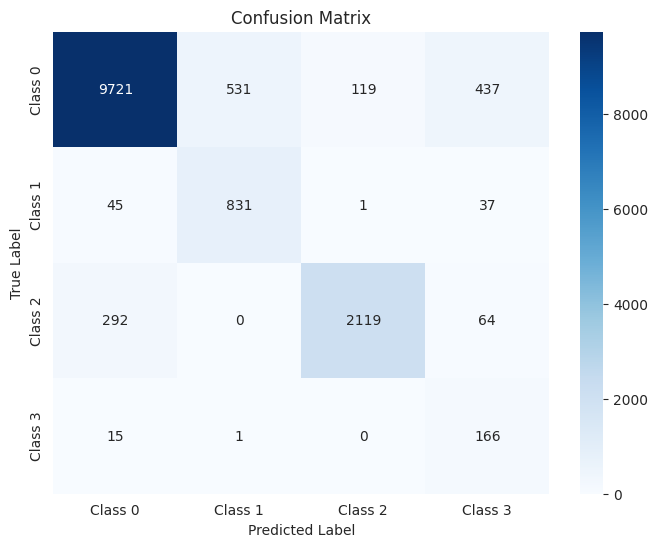

The function took 0.5558 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.90      0.93      2702
     Class 1       0.60      0.88      0.71       228
     Class 2       0.94      0.87      0.91       619
     Class 3       0.23      0.89      0.37        46

    accuracy                           0.89      3595
   macro avg       0.68      0.88      0.73      3595
weighted avg       0.93      0.89      0.90      3595



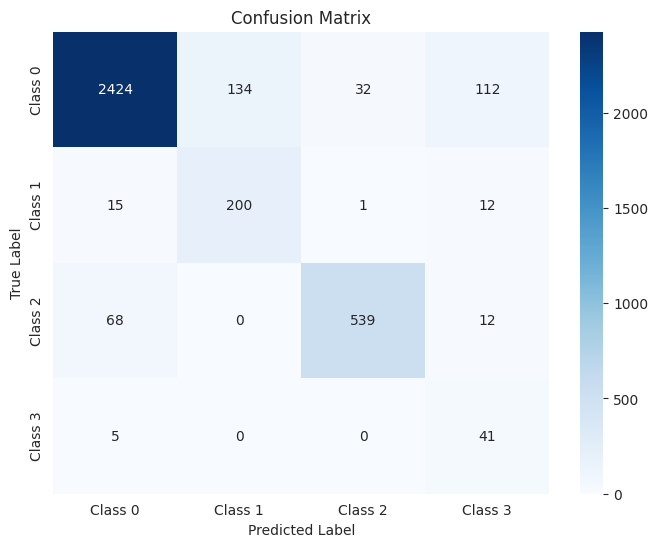

The function took 0.4140 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.90      0.93      3378
     Class 1       0.60      0.88      0.72       285
     Class 2       0.95      0.84      0.89       774
     Class 3       0.23      0.86      0.37        57

    accuracy                           0.89      4494
   macro avg       0.69      0.87      0.73      4494
weighted avg       0.93      0.89      0.90      4494



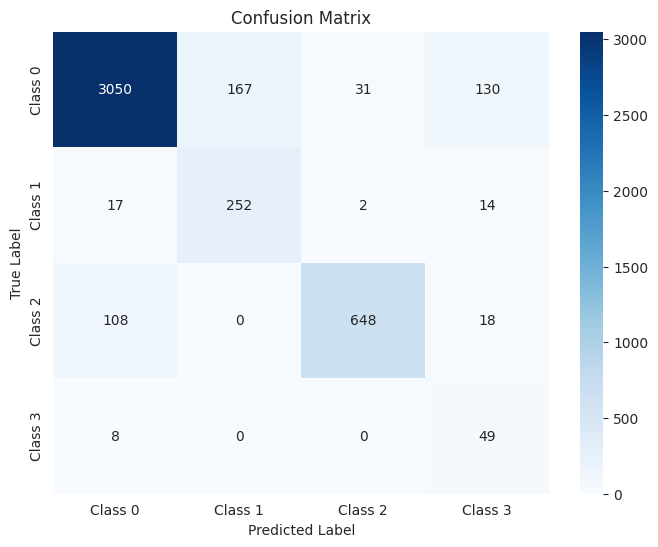

The function took 0.4005 seconds to execute.
[ARCH#080-[32, 8, 4, 2]] done in 31.2s  best-val=0.2889


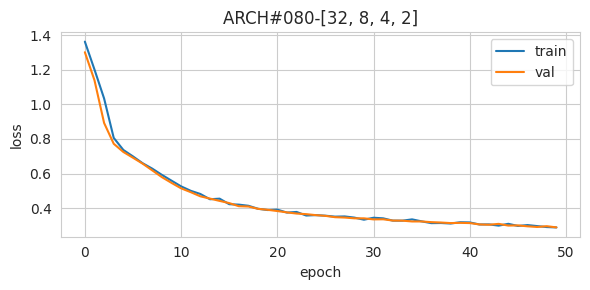


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.92      0.94     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.97      0.86      0.92      2475
     Class 3       0.23      0.88      0.37       182

    accuracy                           0.91     14379
   macro avg       0.72      0.90      0.76     14379
weighted avg       0.94      0.91      0.92     14379



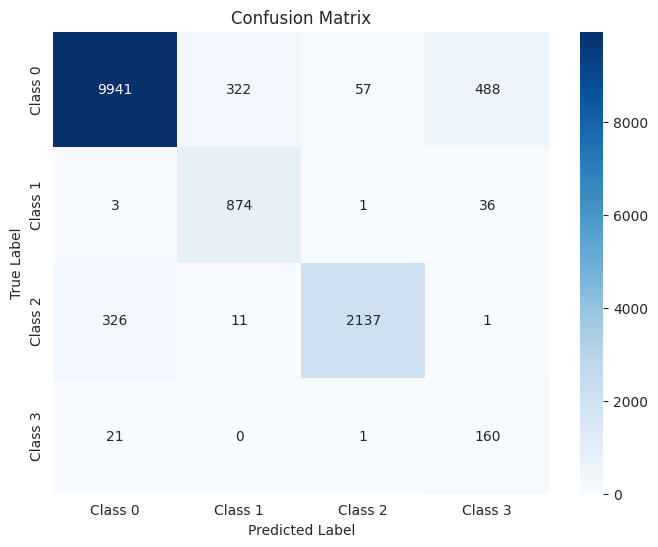

The function took 0.5745 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.92      0.94      2702
     Class 1       0.73      0.93      0.82       228
     Class 2       0.97      0.88      0.93       619
     Class 3       0.22      0.87      0.36        46

    accuracy                           0.91      3595
   macro avg       0.72      0.90      0.76      3595
weighted avg       0.95      0.91      0.93      3595



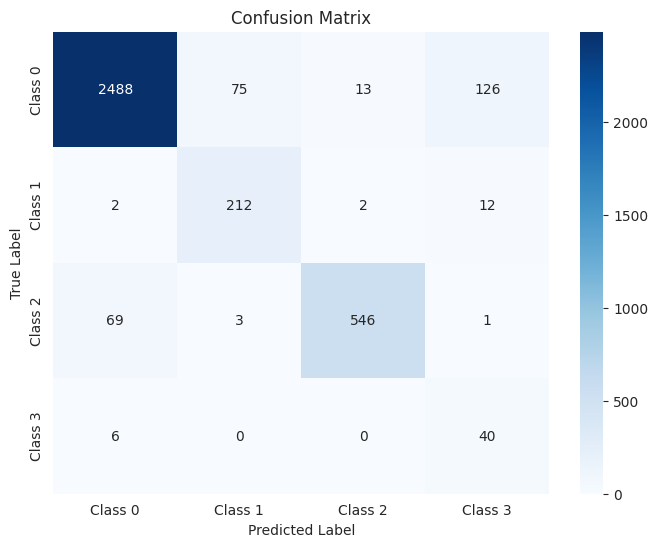

The function took 0.3685 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.92      0.94      3378
     Class 1       0.72      0.94      0.81       285
     Class 2       0.97      0.84      0.90       774
     Class 3       0.23      0.86      0.36        57

    accuracy                           0.91      4494
   macro avg       0.72      0.89      0.75      4494
weighted avg       0.94      0.91      0.92      4494



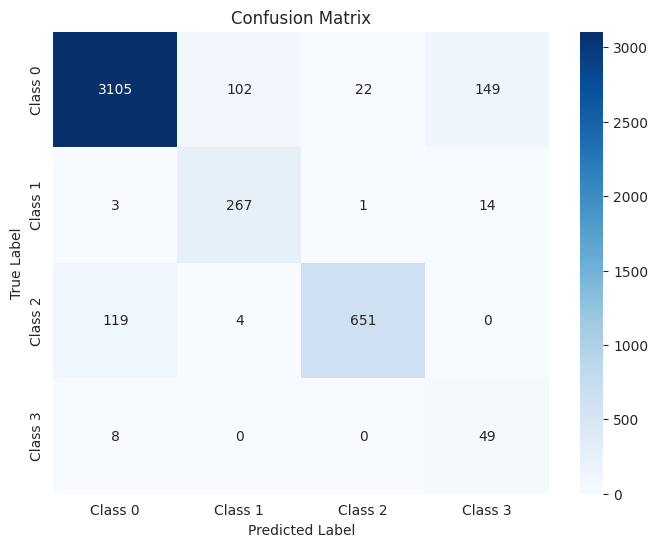

The function took 0.4210 seconds to execute.
[ARCH#081-[32, 8, 2, 2]] done in 31.8s  best-val=0.4382


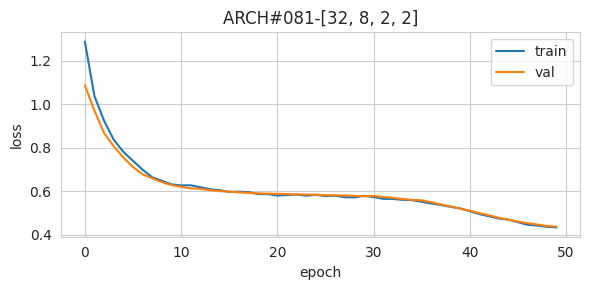


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.81      0.89     10808
     Class 1       0.75      0.91      0.82       914
     Class 2       1.00      0.86      0.93      2475
     Class 3       0.08      0.99      0.14       182

    accuracy                           0.83     14379
   macro avg       0.70      0.89      0.70     14379
weighted avg       0.96      0.83      0.88     14379



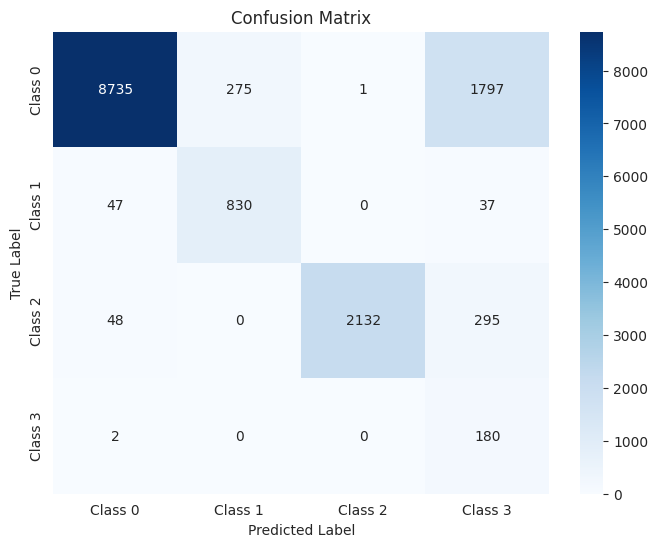

The function took 0.7922 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.82      0.89      2702
     Class 1       0.77      0.88      0.82       228
     Class 2       1.00      0.88      0.93       619
     Class 3       0.08      0.98      0.15        46

    accuracy                           0.83      3595
   macro avg       0.71      0.89      0.70      3595
weighted avg       0.96      0.83      0.89      3595



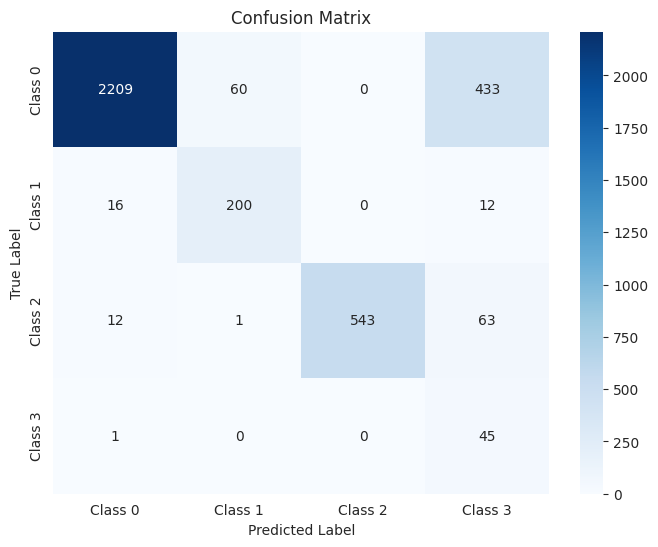

The function took 0.7048 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.82      0.89      3378
     Class 1       0.75      0.89      0.82       285
     Class 2       1.00      0.84      0.91       774
     Class 3       0.08      0.96      0.14        57

    accuracy                           0.83      4494
   macro avg       0.70      0.88      0.69      4494
weighted avg       0.96      0.83      0.88      4494



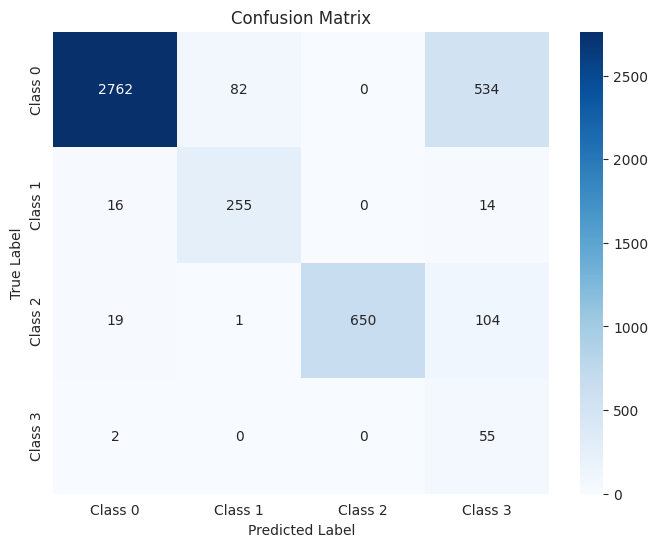

The function took 0.4109 seconds to execute.
[ARCH#082-[32, 4, 4, 4]] done in 31.4s  best-val=0.2656


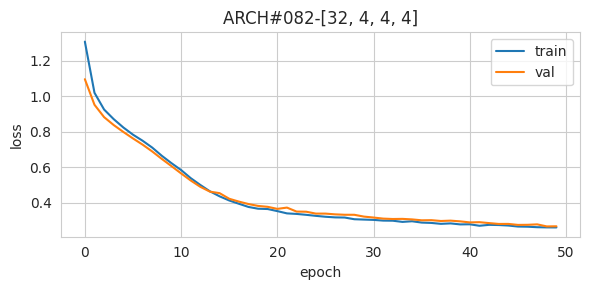


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.27      0.87      0.41       182

    accuracy                           0.93     14379
   macro avg       0.75      0.91      0.78     14379
weighted avg       0.95      0.93      0.93     14379



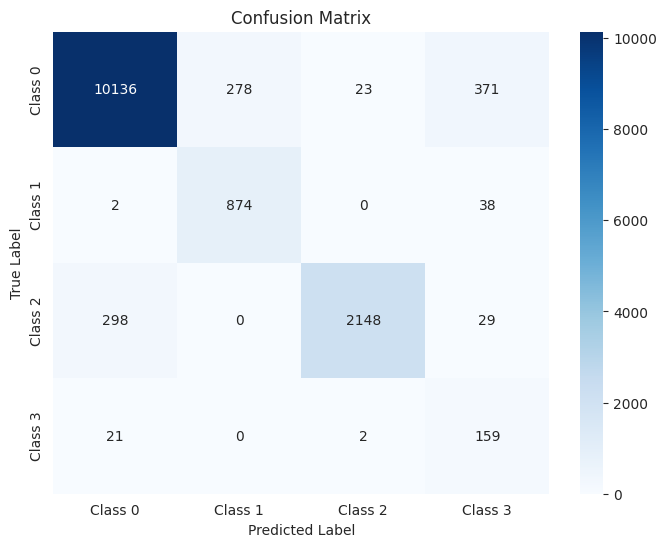

The function took 0.5979 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.96      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.99      0.89      0.93       619
     Class 3       0.24      0.85      0.38        46

    accuracy                           0.93      3595
   macro avg       0.75      0.90      0.78      3595
weighted avg       0.95      0.93      0.94      3595



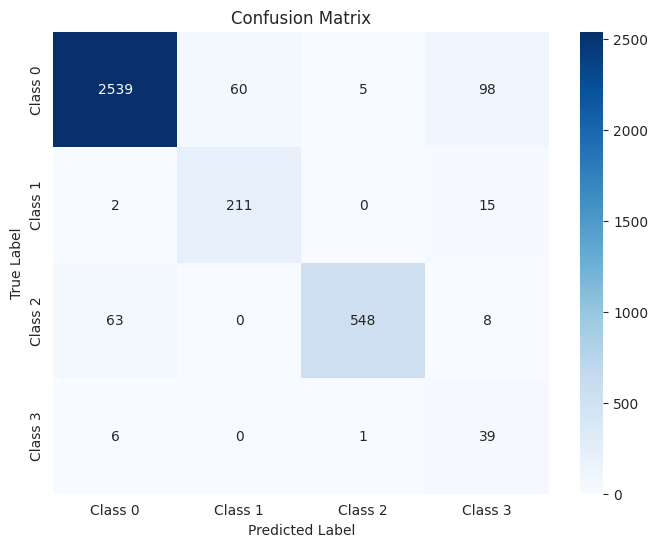

The function took 0.3943 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.28      0.86      0.42        57

    accuracy                           0.92      4494
   macro avg       0.74      0.90      0.78      4494
weighted avg       0.94      0.92      0.93      4494



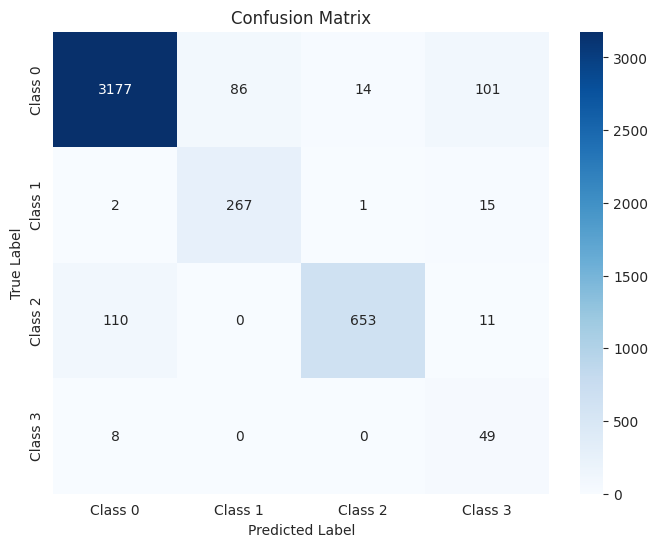

The function took 0.4204 seconds to execute.
[ARCH#083-[32, 4, 4, 2]] done in 32.0s  best-val=0.6318


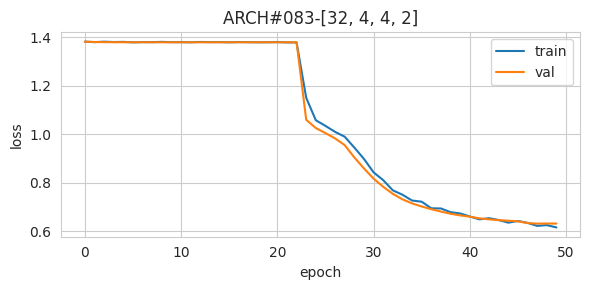


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.97      0.96     10808
     Class 1       0.71      0.86      0.78       914
     Class 2       1.00      0.86      0.92      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.93     14379
   macro avg       0.66      0.67      0.66     14379
weighted avg       0.93      0.93      0.93     14379



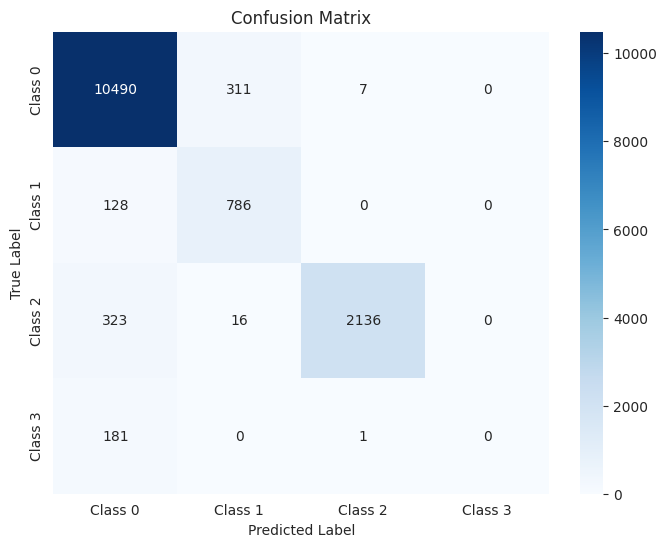

The function took 0.5886 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.98      0.96      2702
     Class 1       0.74      0.82      0.78       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.94      3595
   macro avg       0.67      0.67      0.67      3595
weighted avg       0.93      0.94      0.93      3595



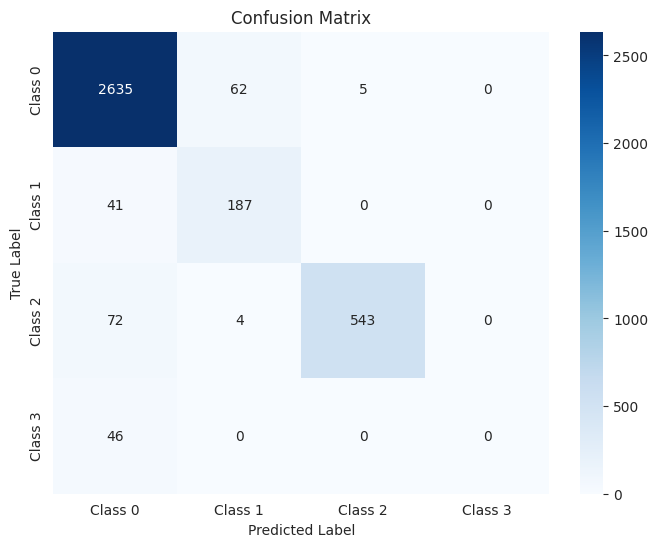

The function took 0.3776 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.97      0.95      3378
     Class 1       0.69      0.84      0.76       285
     Class 2       0.99      0.84      0.91       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.93      4494
   macro avg       0.65      0.66      0.66      4494
weighted avg       0.92      0.93      0.92      4494



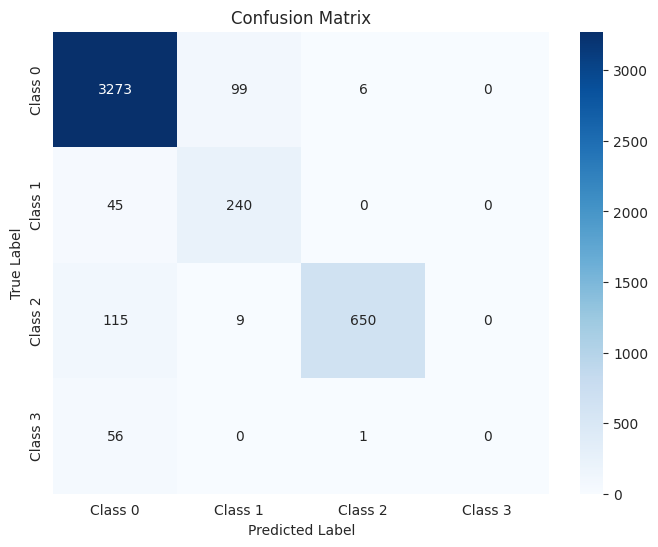

The function took 0.4140 seconds to execute.
[ARCH#084-[32, 4, 2, 2]] done in 31.3s  best-val=0.5646


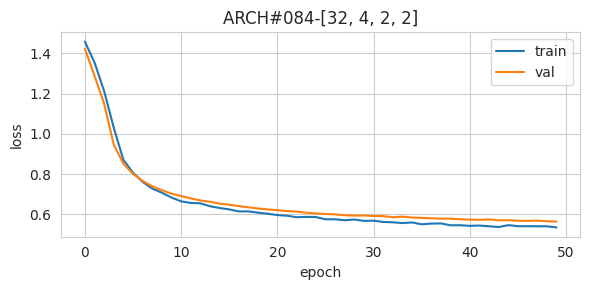


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.97      0.96     10808
     Class 1       0.77      0.86      0.81       914
     Class 2       0.95      0.87      0.91      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.93     14379
   macro avg       0.67      0.68      0.67     14379
weighted avg       0.92      0.93      0.93     14379



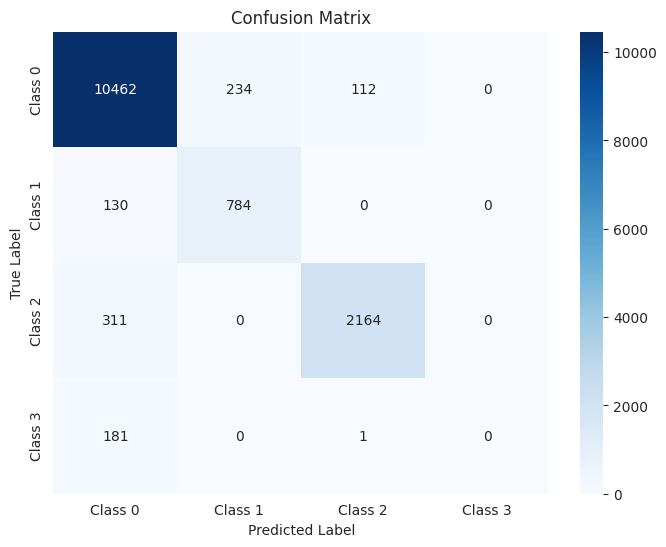

The function took 0.5653 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.97      0.96      2702
     Class 1       0.80      0.81      0.81       228
     Class 2       0.94      0.89      0.91       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.93      3595
   macro avg       0.67      0.67      0.67      3595
weighted avg       0.92      0.93      0.93      3595



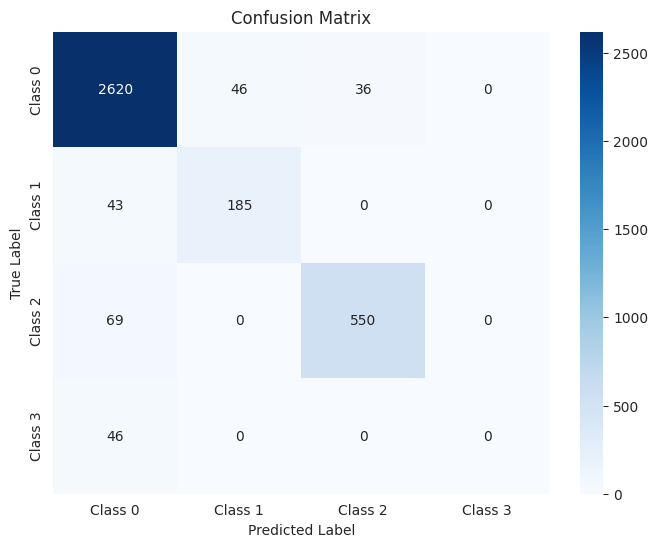

The function took 0.3793 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.97      0.95      3378
     Class 1       0.78      0.84      0.81       285
     Class 2       0.94      0.85      0.90       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.93      4494
   macro avg       0.66      0.66      0.66      4494
weighted avg       0.92      0.93      0.92      4494



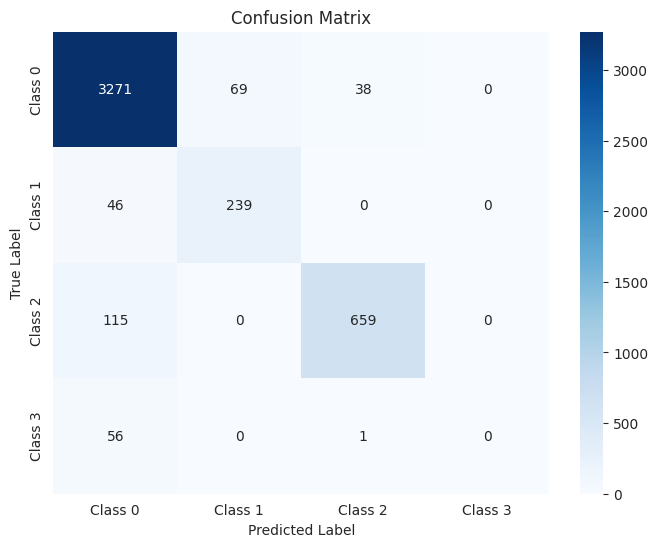

The function took 0.4136 seconds to execute.
[ARCH#085-[32, 2, 2, 2]] done in 32.2s  best-val=0.7111


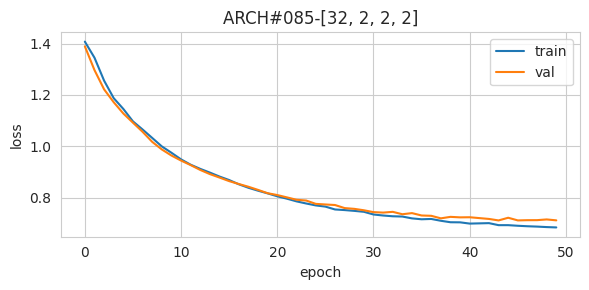


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90     10808
     Class 1       0.23      0.72      0.34       914
     Class 2       0.01      0.00      0.00      2475
     Class 3       0.08      0.98      0.15       182

    accuracy                           0.67     14379
   macro avg       0.33      0.63      0.35     14379
weighted avg       0.77      0.67      0.70     14379



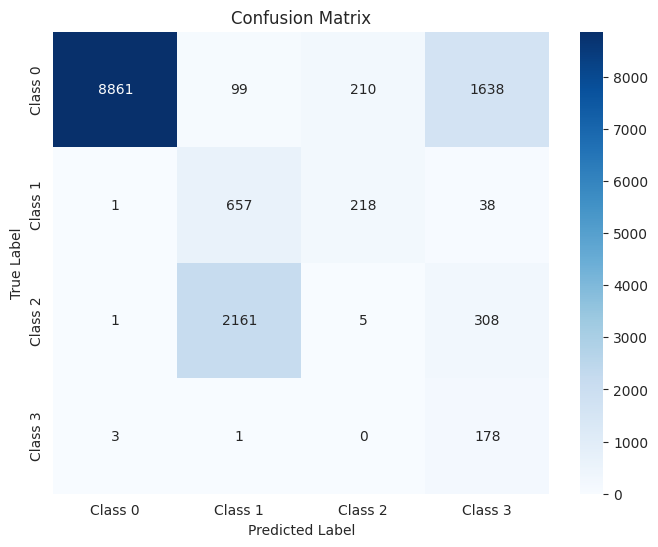

The function took 0.6137 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.90      2702
     Class 1       0.22      0.71      0.34       228
     Class 2       0.01      0.00      0.00       619
     Class 3       0.09      0.98      0.16        46

    accuracy                           0.68      3595
   macro avg       0.33      0.63      0.35      3595
weighted avg       0.77      0.68      0.70      3595



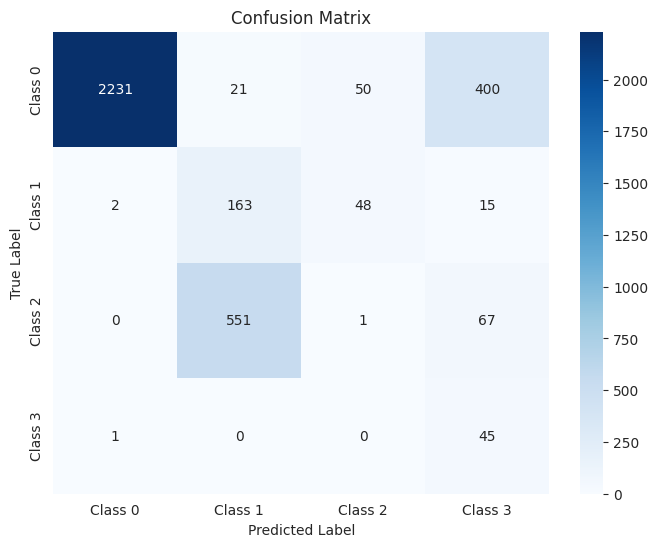

The function took 0.3910 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90      3378
     Class 1       0.23      0.72      0.35       285
     Class 2       0.01      0.00      0.00       774
     Class 3       0.08      0.96      0.15        57

    accuracy                           0.68      4494
   macro avg       0.33      0.63      0.35      4494
weighted avg       0.77      0.68      0.70      4494



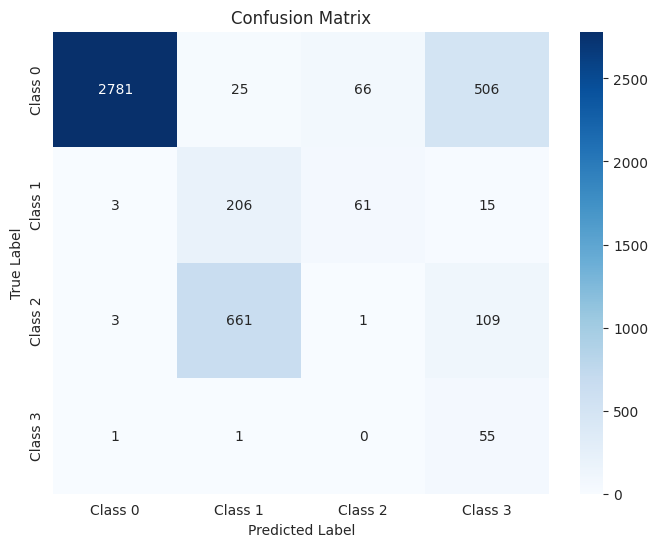

The function took 0.4228 seconds to execute.
[ARCH#086-[16, 16, 16, 16]] done in 31.3s  best-val=0.2343


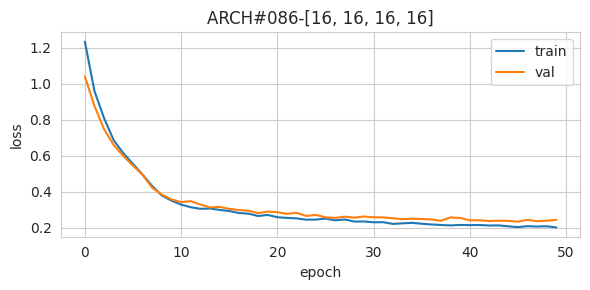


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.74      0.96      0.83       914
     Class 2       0.89      0.95      0.92      2475
     Class 3       0.38      0.88      0.53       182

    accuracy                           0.93     14379
   macro avg       0.75      0.93      0.81     14379
weighted avg       0.95      0.93      0.93     14379



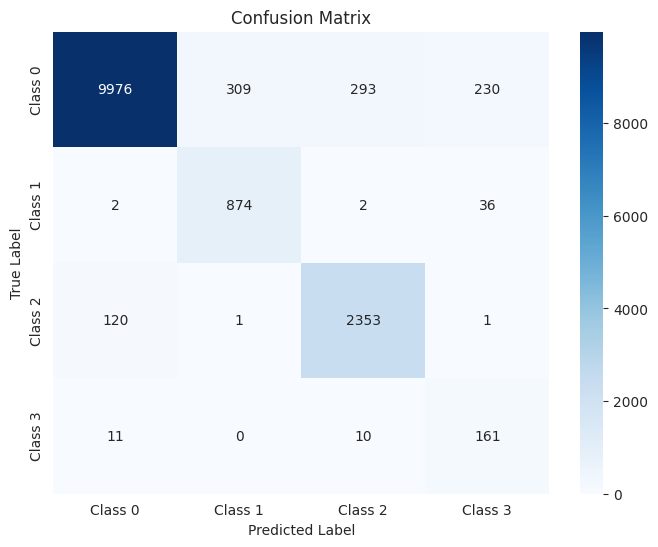

The function took 0.5759 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.87      0.97      0.92       619
     Class 3       0.35      0.87      0.50        46

    accuracy                           0.93      3595
   macro avg       0.74      0.92      0.80      3595
weighted avg       0.95      0.93      0.93      3595



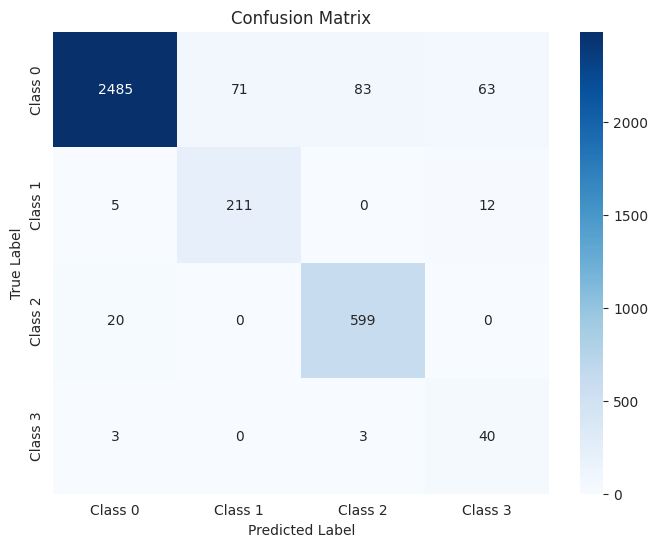

The function took 0.3781 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.74      0.93      0.82       285
     Class 2       0.89      0.93      0.91       774
     Class 3       0.39      0.88      0.54        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.81      4494
weighted avg       0.94      0.93      0.93      4494



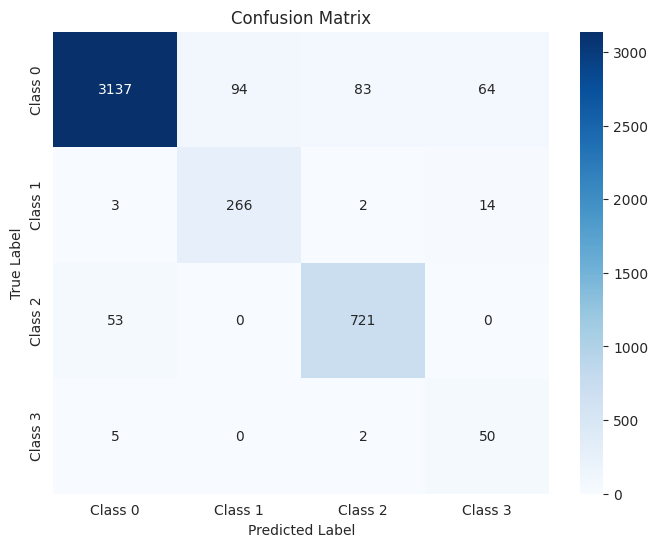

The function took 0.3998 seconds to execute.
[ARCH#087-[16, 16, 16, 8]] done in 32.1s  best-val=0.2290


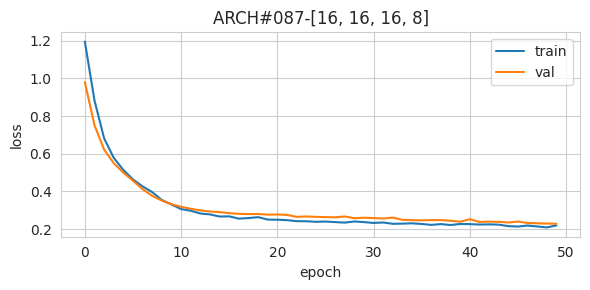


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.78      0.95      0.86       914
     Class 2       0.90      0.94      0.92      2475
     Class 3       0.31      0.88      0.46       182

    accuracy                           0.93     14379
   macro avg       0.75      0.93      0.80     14379
weighted avg       0.95      0.93      0.94     14379



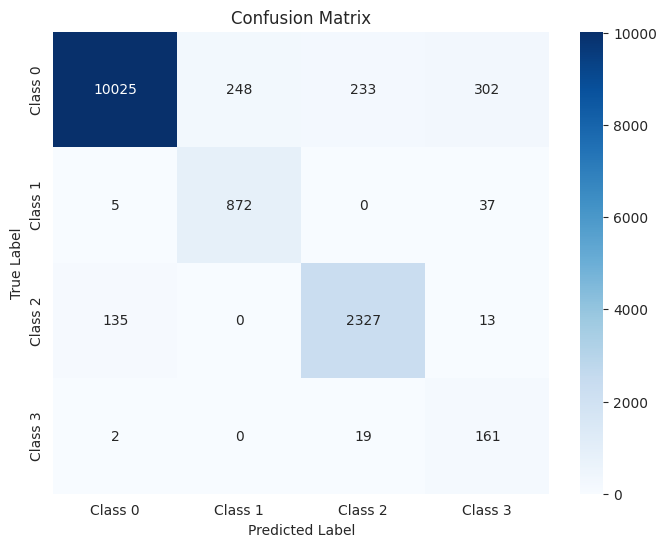

The function took 0.5659 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.80      0.93      0.86       228
     Class 2       0.89      0.96      0.92       619
     Class 3       0.31      0.87      0.46        46

    accuracy                           0.93      3595
   macro avg       0.75      0.92      0.80      3595
weighted avg       0.95      0.93      0.94      3595



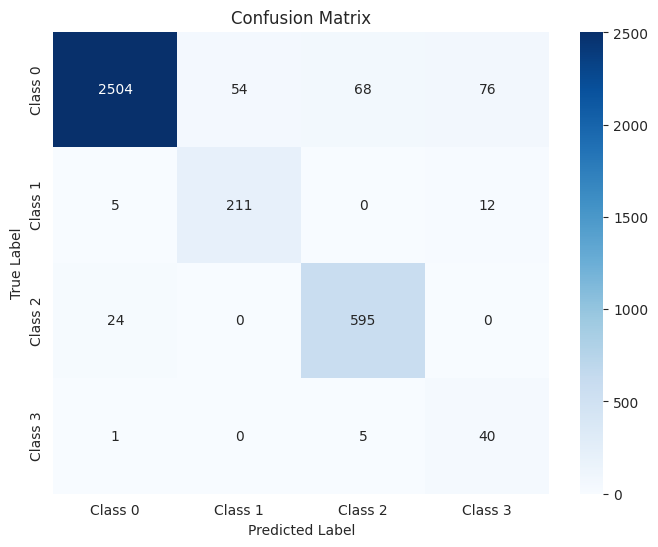

The function took 0.3931 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.78      0.93      0.85       285
     Class 2       0.91      0.93      0.92       774
     Class 3       0.31      0.88      0.46        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.80      4494
weighted avg       0.95      0.93      0.94      4494



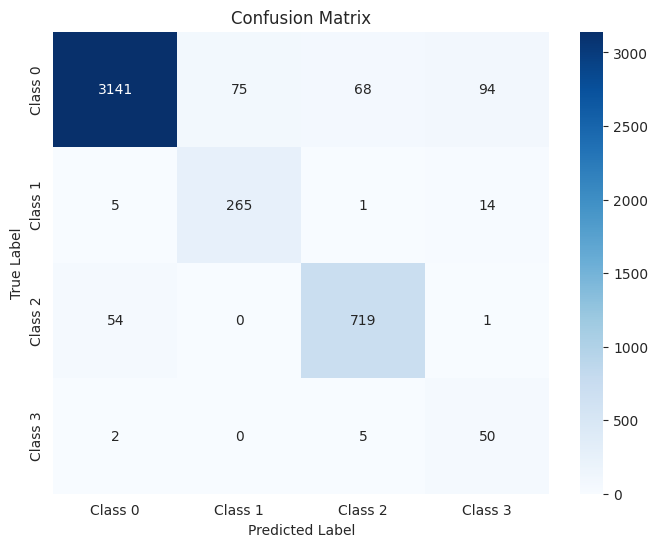

The function took 0.4026 seconds to execute.
[ARCH#088-[16, 16, 16, 4]] done in 31.2s  best-val=0.2371


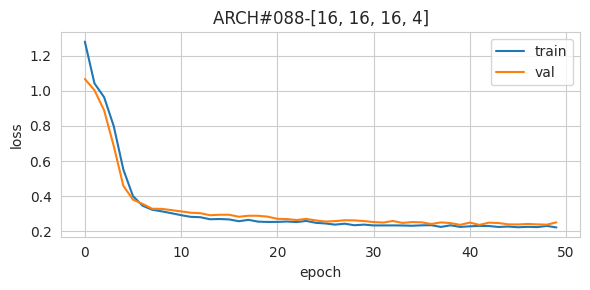


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.13      0.98      0.23       182

    accuracy                           0.89     14379
   macro avg       0.71      0.92      0.73     14379
weighted avg       0.96      0.89      0.92     14379



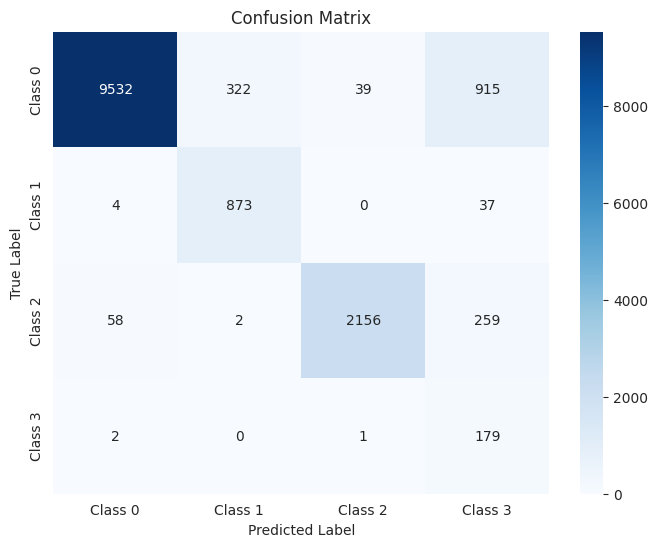

The function took 0.5817 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.74      0.93      0.82       228
     Class 2       0.97      0.88      0.92       619
     Class 3       0.13      0.96      0.24        46

    accuracy                           0.89      3595
   macro avg       0.71      0.91      0.73      3595
weighted avg       0.96      0.89      0.92      3595



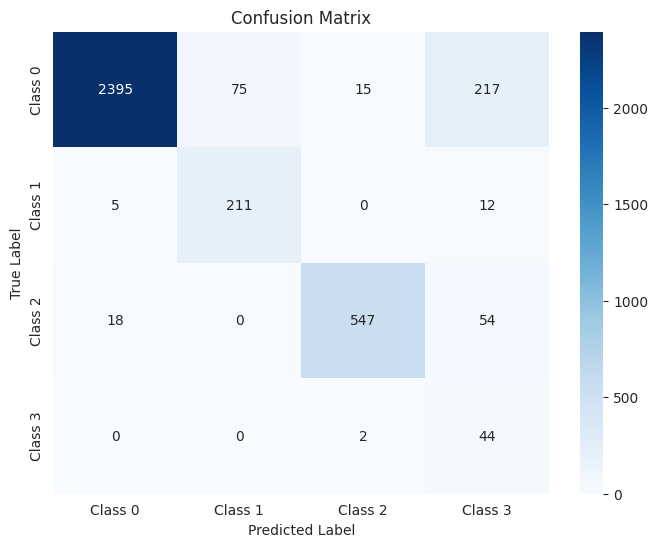

The function took 0.3632 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.72      0.94      0.82       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.13      0.96      0.23        57

    accuracy                           0.88      4494
   macro avg       0.70      0.91      0.72      4494
weighted avg       0.96      0.88      0.91      4494



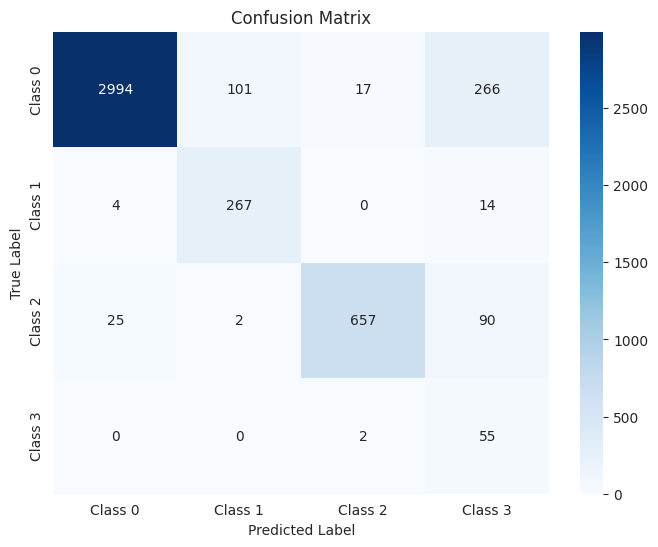

The function took 0.4010 seconds to execute.
[ARCH#089-[16, 16, 16, 2]] done in 31.8s  best-val=0.6474


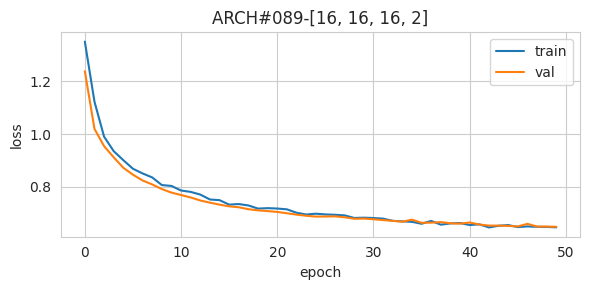


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95     10808
     Class 1       0.49      0.91      0.64       914
     Class 2       1.00      0.86      0.92      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.92     14379
   macro avg       0.61      0.68      0.63     14379
weighted avg       0.93      0.92      0.92     14379



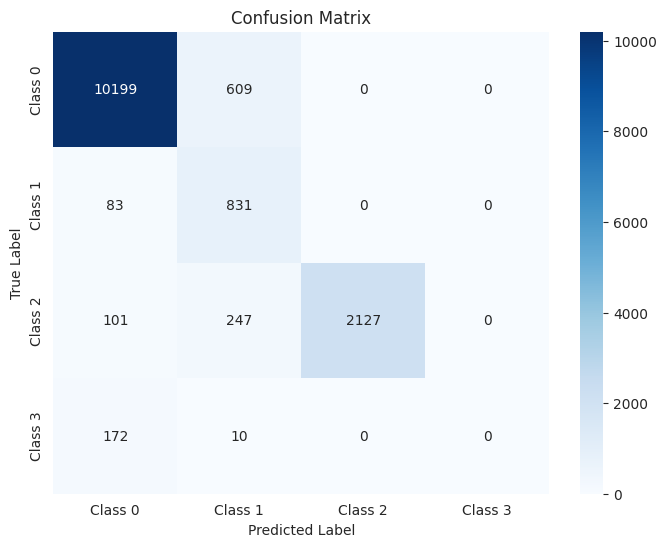

The function took 0.6115 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95      2702
     Class 1       0.49      0.89      0.63       228
     Class 2       1.00      0.88      0.93       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.92      3595
   macro avg       0.61      0.68      0.63      3595
weighted avg       0.93      0.92      0.92      3595



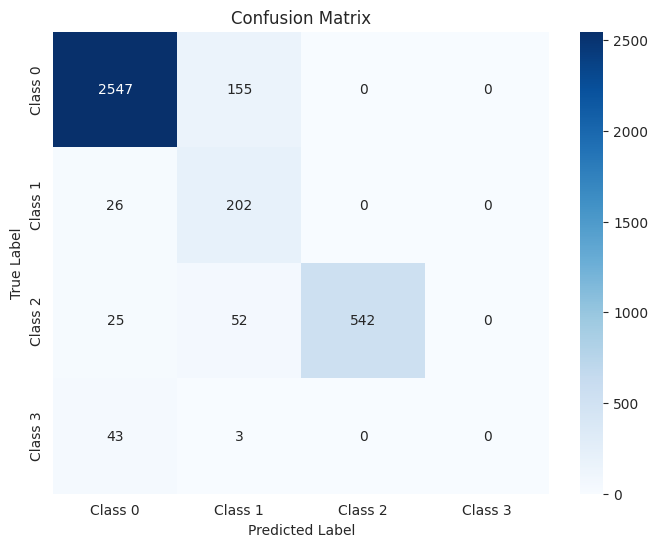

The function took 0.3750 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95      3378
     Class 1       0.48      0.89      0.62       285
     Class 2       1.00      0.84      0.91       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.91      4494
   macro avg       0.61      0.67      0.62      4494
weighted avg       0.93      0.91      0.91      4494



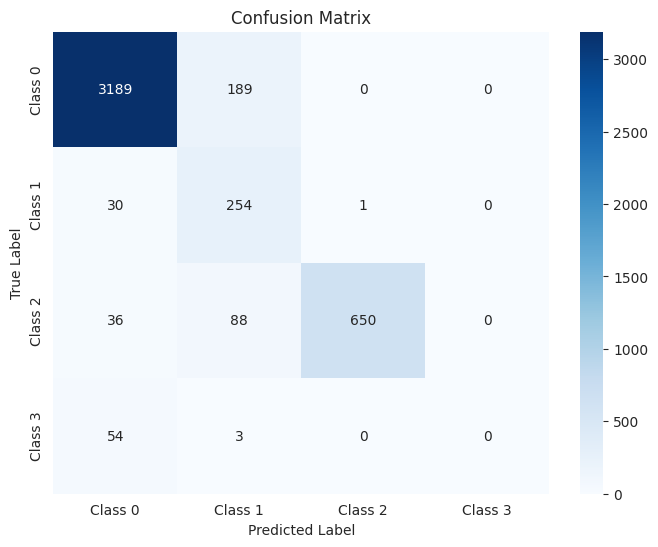

The function took 0.4054 seconds to execute.
[ARCH#090-[16, 16, 8, 8]] done in 30.9s  best-val=0.2291


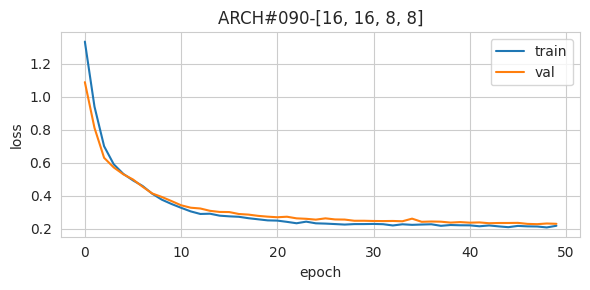


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.85      0.95      0.90      2475
     Class 3       0.39      0.88      0.54       182

    accuracy                           0.92     14379
   macro avg       0.74      0.93      0.81     14379
weighted avg       0.94      0.92      0.93     14379



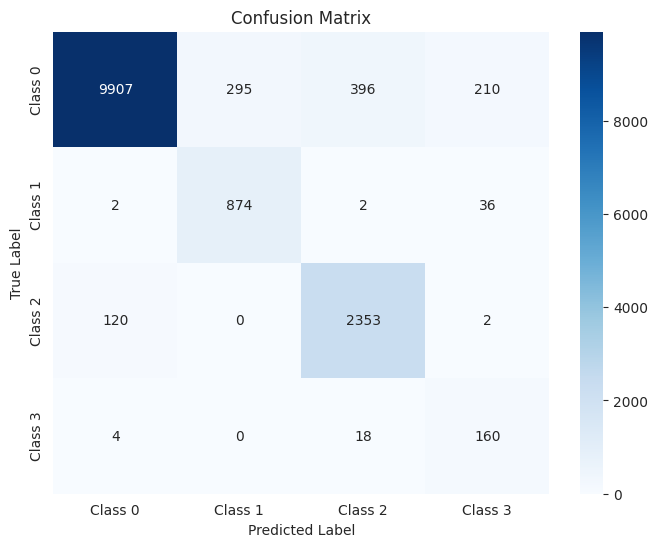

The function took 0.9145 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.84      0.96      0.90       619
     Class 3       0.37      0.87      0.52        46

    accuracy                           0.92      3595
   macro avg       0.74      0.92      0.80      3595
weighted avg       0.94      0.92      0.93      3595



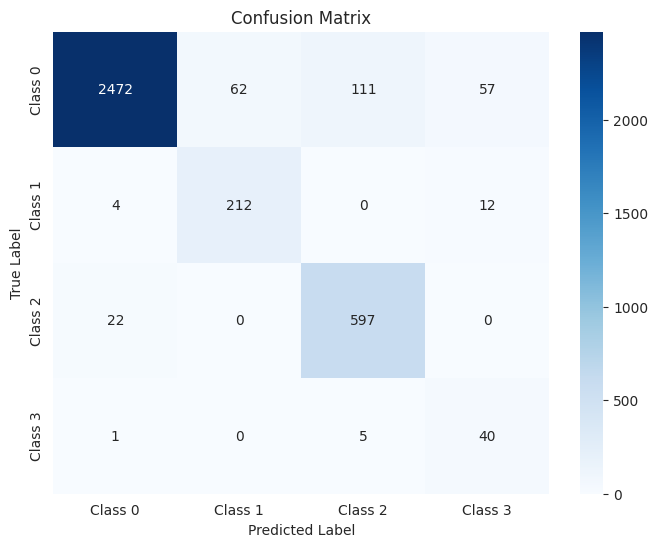

The function took 0.3413 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.74      0.94      0.82       285
     Class 2       0.85      0.94      0.89       774
     Class 3       0.40      0.86      0.54        57

    accuracy                           0.92      4494
   macro avg       0.74      0.91      0.80      4494
weighted avg       0.94      0.92      0.93      4494



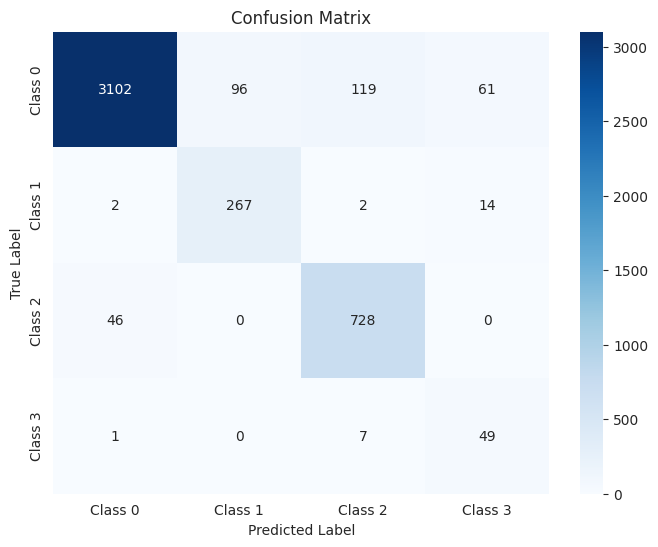

The function took 0.4167 seconds to execute.
[ARCH#091-[16, 16, 8, 4]] done in 32.1s  best-val=0.2281


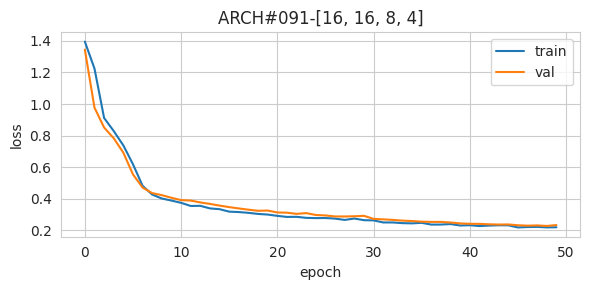


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.93      0.95      0.94      2475
     Class 3       0.29      0.88      0.44       182

    accuracy                           0.93     14379
   macro avg       0.73      0.93      0.79     14379
weighted avg       0.95      0.93      0.94     14379



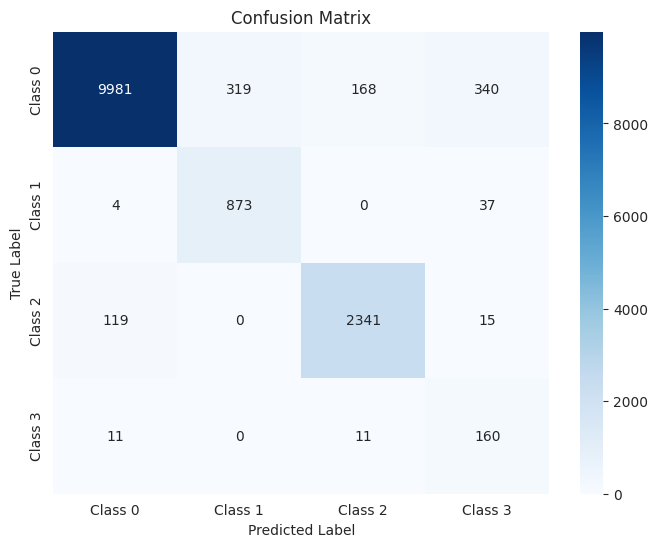

The function took 0.5962 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.91      0.96      0.94       619
     Class 3       0.29      0.87      0.44        46

    accuracy                           0.93      3595
   macro avg       0.74      0.92      0.79      3595
weighted avg       0.95      0.93      0.94      3595



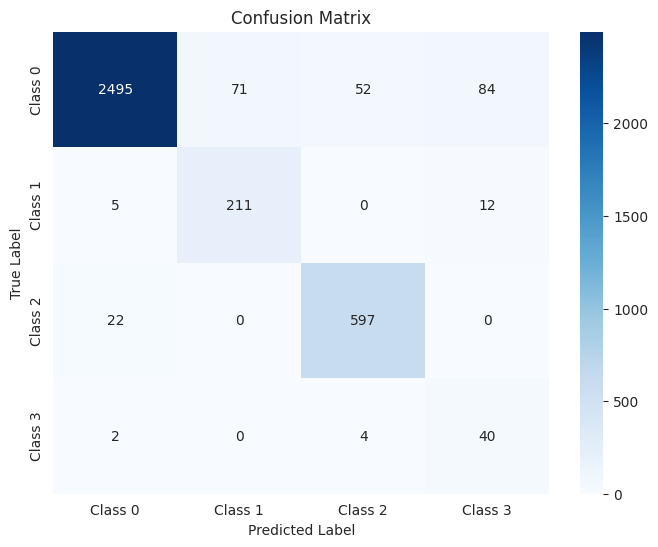

The function took 0.3926 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.73      0.94      0.82       285
     Class 2       0.93      0.94      0.93       774
     Class 3       0.31      0.86      0.46        57

    accuracy                           0.93      4494
   macro avg       0.74      0.91      0.79      4494
weighted avg       0.95      0.93      0.94      4494



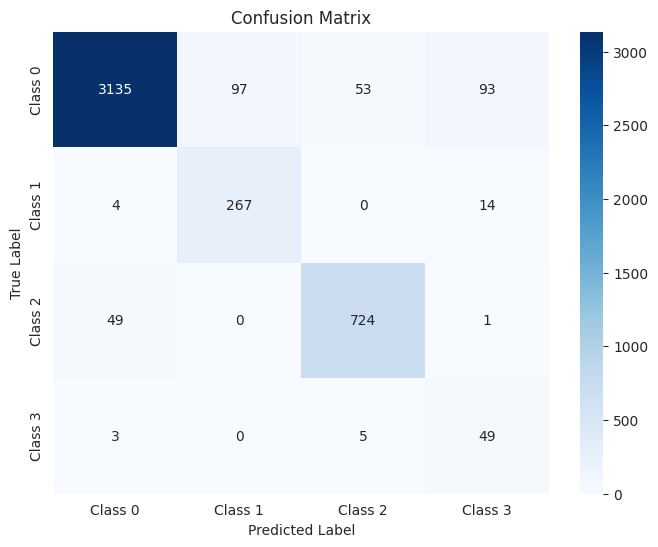

The function took 0.4105 seconds to execute.
[ARCH#092-[16, 16, 8, 2]] early-stop @ epoch 036
[ARCH#092-[16, 16, 8, 2]] done in 23.2s  best-val=1.3794


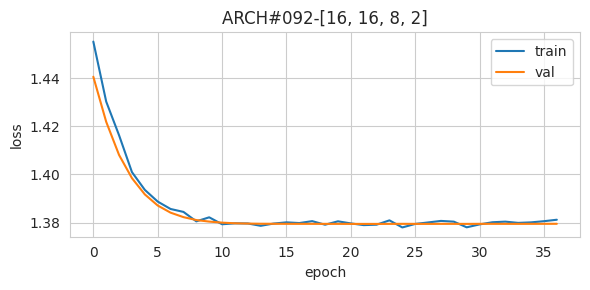


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



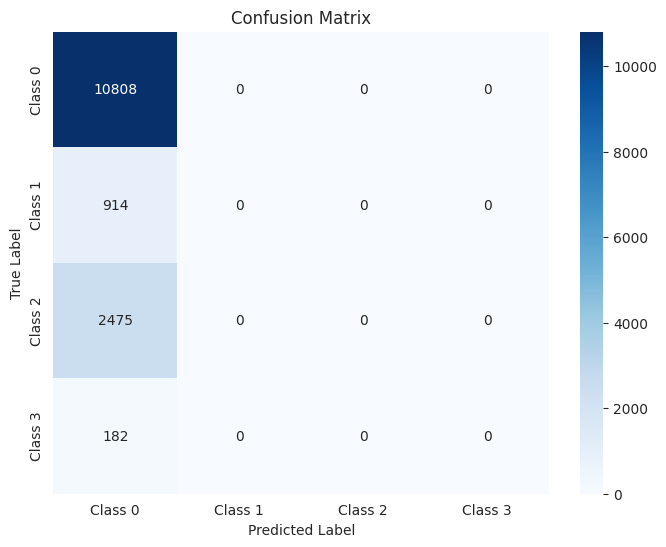

The function took 0.8205 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



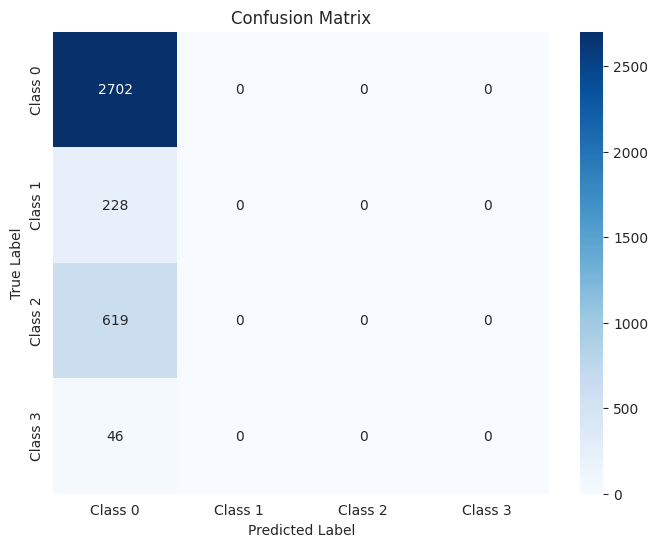

The function took 0.4038 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



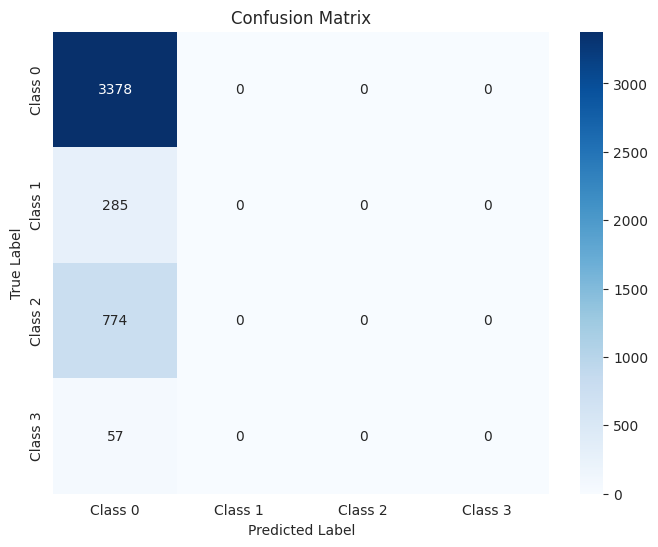

The function took 0.5071 seconds to execute.
[ARCH#093-[16, 16, 4, 4]] done in 31.6s  best-val=0.2616


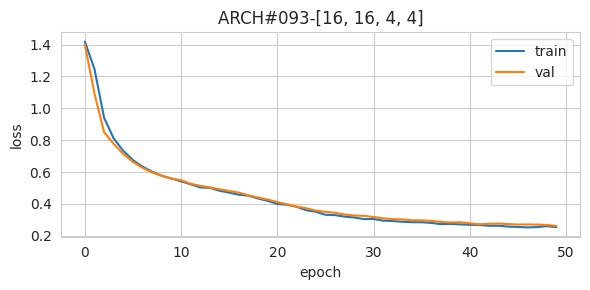


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.89      0.95      0.91      2475
     Class 3       0.19      0.88      0.31       182

    accuracy                           0.90     14379
   macro avg       0.70      0.92      0.75     14379
weighted avg       0.95      0.90      0.92     14379



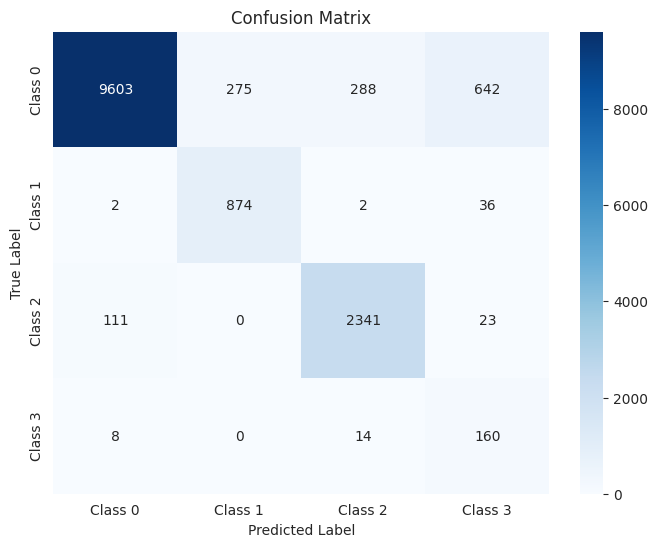

The function took 0.6144 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.87      0.96      0.91       619
     Class 3       0.18      0.87      0.30        46

    accuracy                           0.90      3595
   macro avg       0.71      0.91      0.75      3595
weighted avg       0.95      0.90      0.92      3595



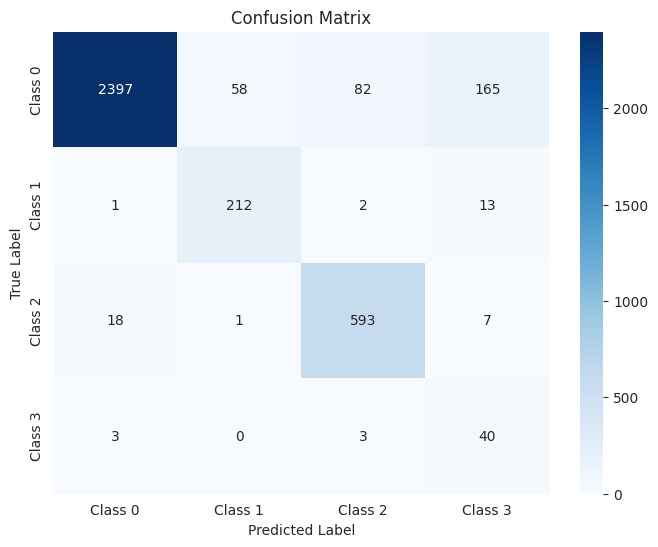

The function took 0.3832 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.93      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.88      0.93      0.90       774
     Class 3       0.18      0.86      0.30        57

    accuracy                           0.90      4494
   macro avg       0.70      0.90      0.75      4494
weighted avg       0.94      0.90      0.91      4494



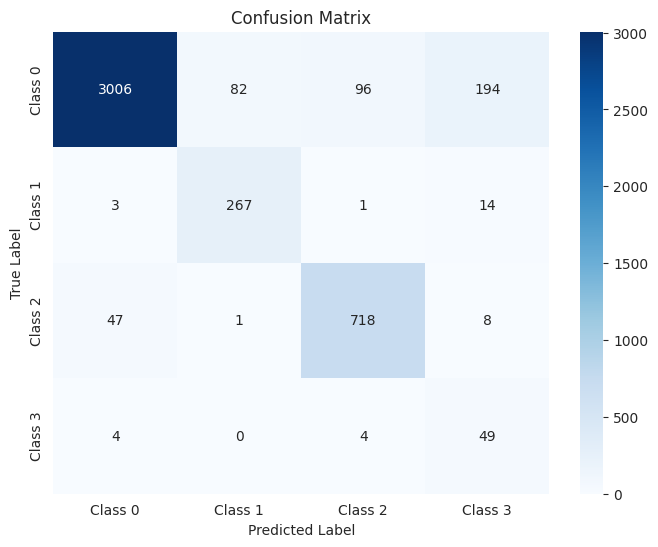

The function took 0.4203 seconds to execute.
[ARCH#094-[16, 16, 4, 2]] early-stop @ epoch 025
[ARCH#094-[16, 16, 4, 2]] done in 16.2s  best-val=1.3794


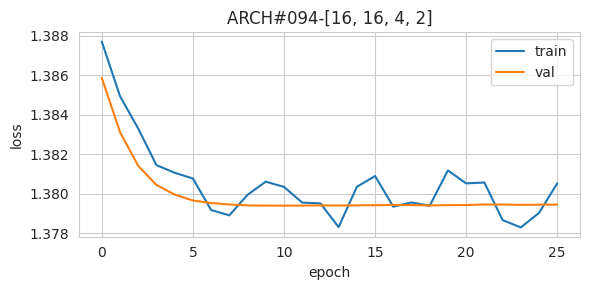


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



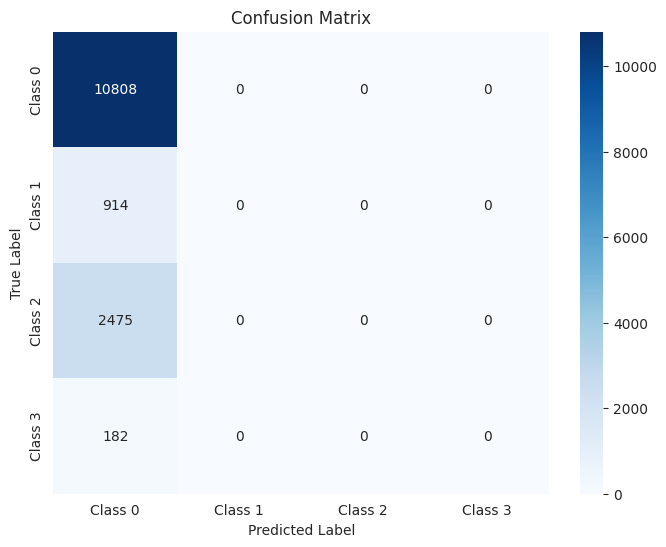

The function took 0.5897 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



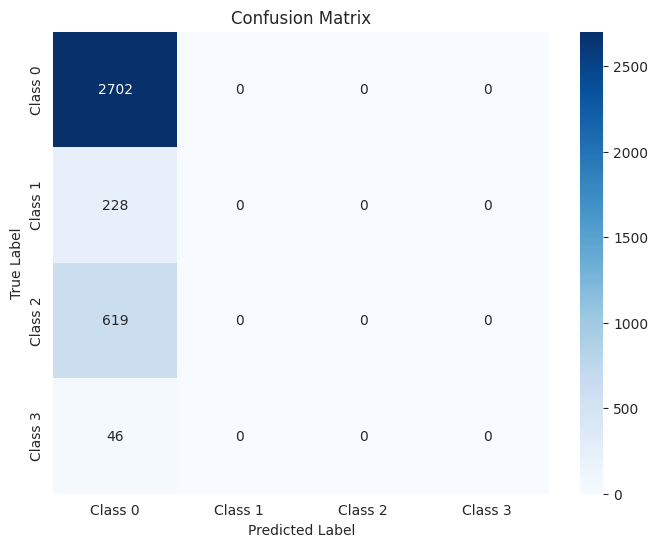

The function took 0.3634 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.56      0.75      0.64      4494



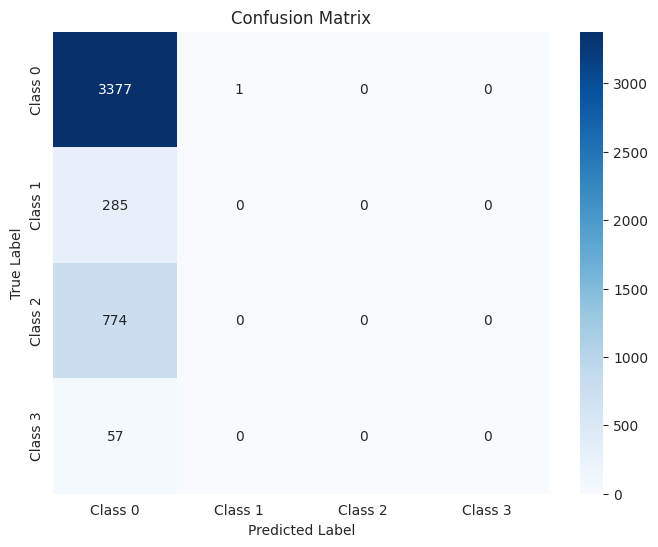

The function took 0.4259 seconds to execute.
[ARCH#095-[16, 16, 2, 2]] early-stop @ epoch 039
[ARCH#095-[16, 16, 2, 2]] done in 25.3s  best-val=1.3794


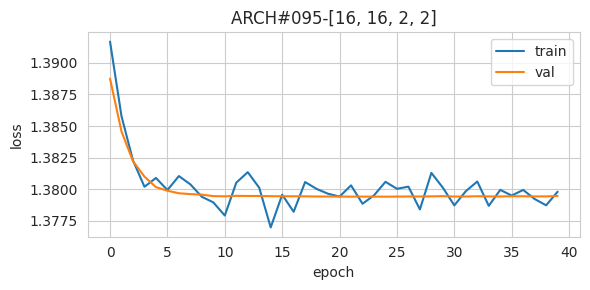


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



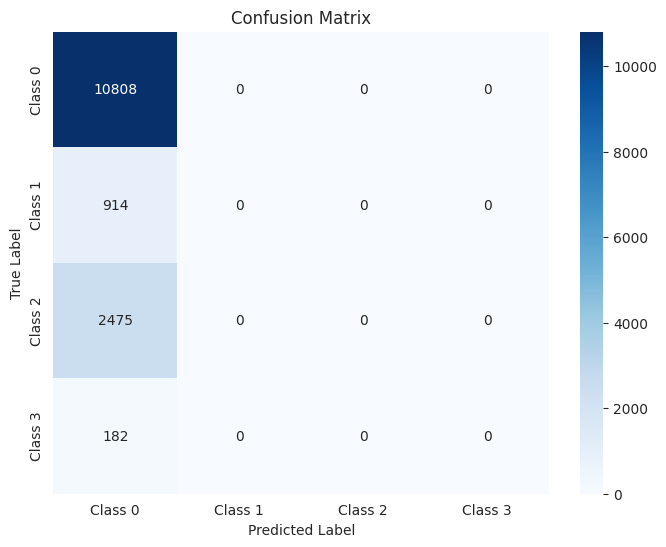

The function took 0.5969 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



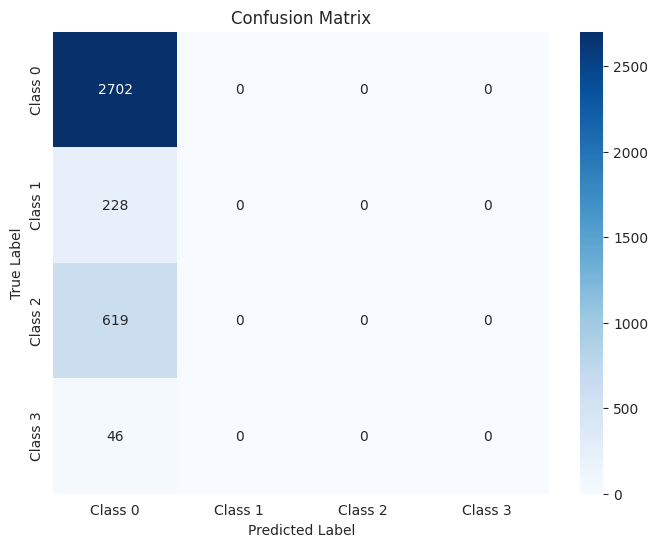

The function took 0.3673 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



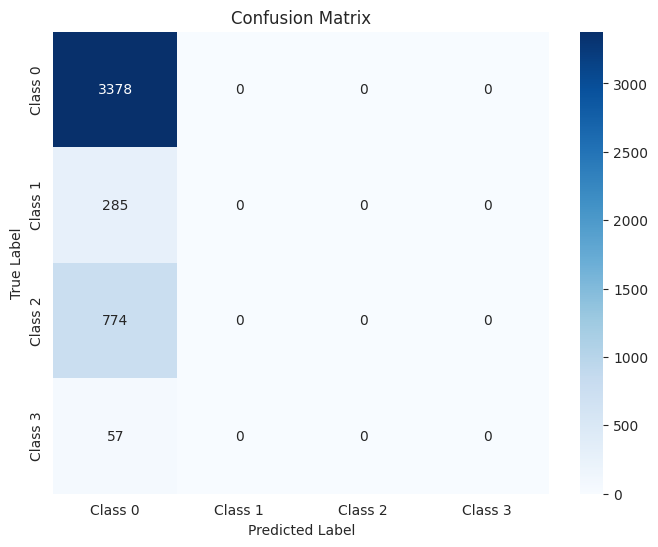

The function took 0.4076 seconds to execute.
[ARCH#096-[16, 8, 8, 8]] done in 32.0s  best-val=0.2543


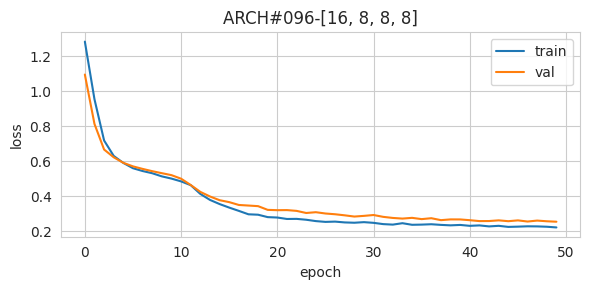


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.81      0.95      0.88      2475
     Class 3       0.29      0.88      0.44       182

    accuracy                           0.90     14379
   macro avg       0.71      0.92      0.77     14379
weighted avg       0.93      0.90      0.91     14379



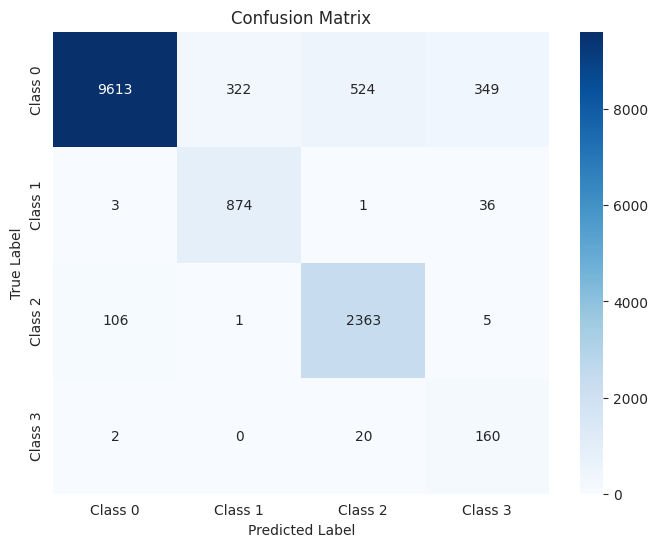

The function took 0.6151 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.80      0.97      0.88       619
     Class 3       0.26      0.87      0.40        46

    accuracy                           0.90      3595
   macro avg       0.70      0.91      0.76      3595
weighted avg       0.93      0.90      0.91      3595



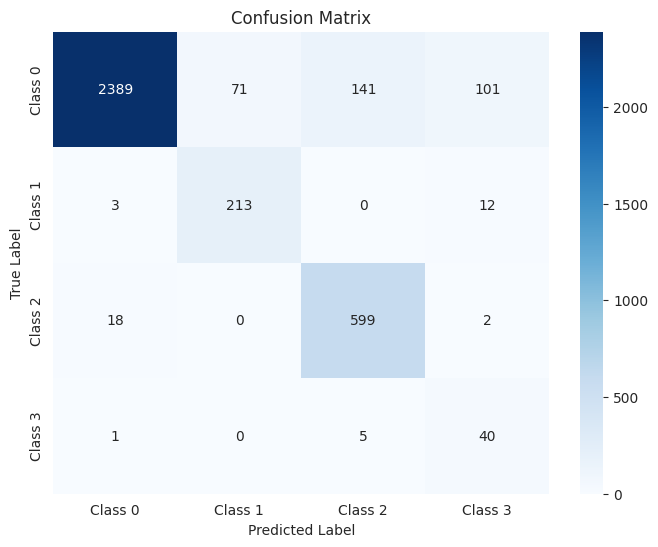

The function took 0.3699 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.90      0.94      3378
     Class 1       0.72      0.93      0.82       285
     Class 2       0.82      0.94      0.88       774
     Class 3       0.31      0.88      0.46        57

    accuracy                           0.91      4494
   macro avg       0.71      0.91      0.77      4494
weighted avg       0.93      0.91      0.91      4494



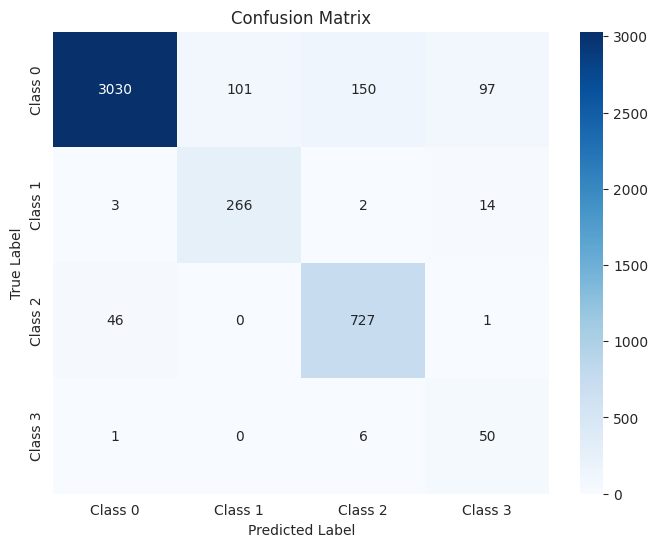

The function took 0.4155 seconds to execute.
[ARCH#097-[16, 8, 8, 4]] done in 31.0s  best-val=0.2592


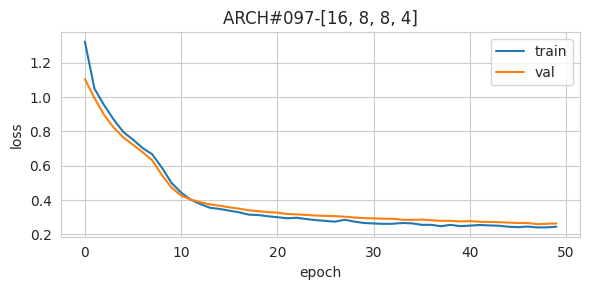


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.84      0.95      0.89      2475
     Class 3       0.36      0.88      0.51       182

    accuracy                           0.92     14379
   macro avg       0.73      0.92      0.79     14379
weighted avg       0.94      0.92      0.92     14379



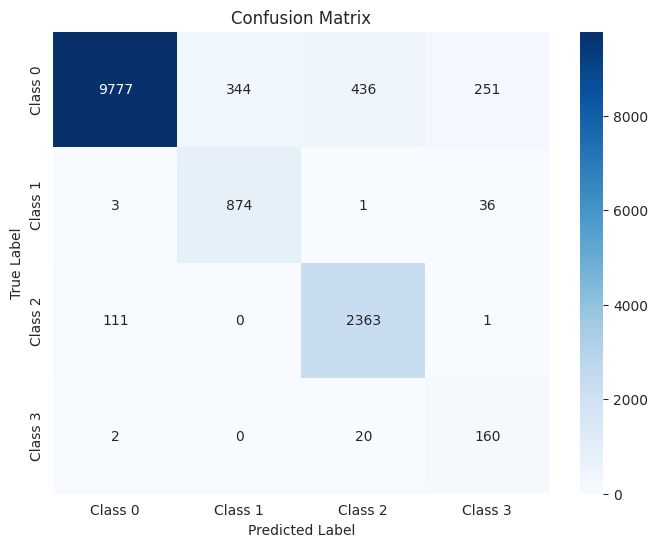

The function took 0.6173 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.73      0.93      0.81       228
     Class 2       0.83      0.97      0.89       619
     Class 3       0.34      0.89      0.49        46

    accuracy                           0.91      3595
   macro avg       0.72      0.92      0.79      3595
weighted avg       0.94      0.91      0.92      3595



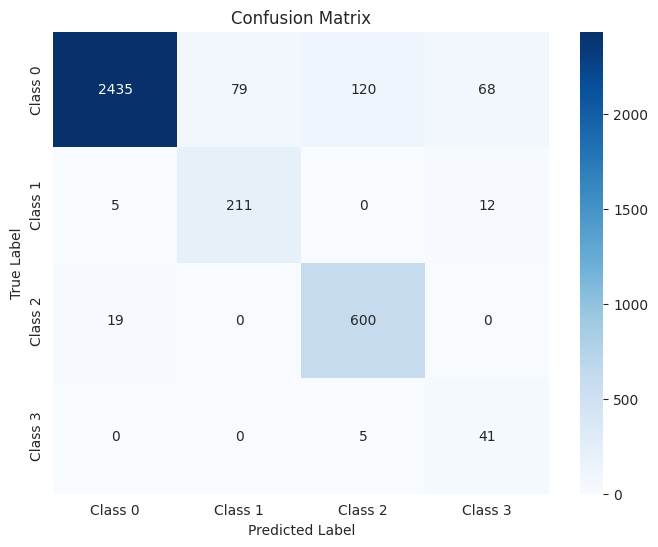

The function took 0.3688 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94      3378
     Class 1       0.71      0.93      0.81       285
     Class 2       0.85      0.94      0.89       774
     Class 3       0.36      0.86      0.50        57

    accuracy                           0.91      4494
   macro avg       0.72      0.91      0.79      4494
weighted avg       0.93      0.91      0.92      4494



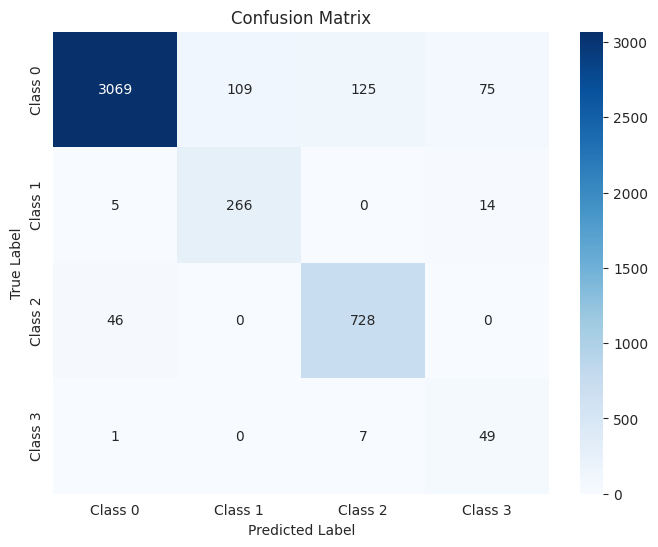

The function took 0.4159 seconds to execute.
[ARCH#098-[16, 8, 8, 2]] done in 31.9s  best-val=0.3323


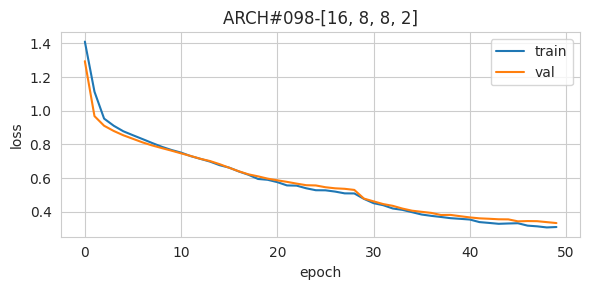


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.92      0.94     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.97      0.87      0.92      2475
     Class 3       0.25      0.88      0.39       182

    accuracy                           0.92     14379
   macro avg       0.73      0.91      0.77     14379
weighted avg       0.94      0.92      0.93     14379



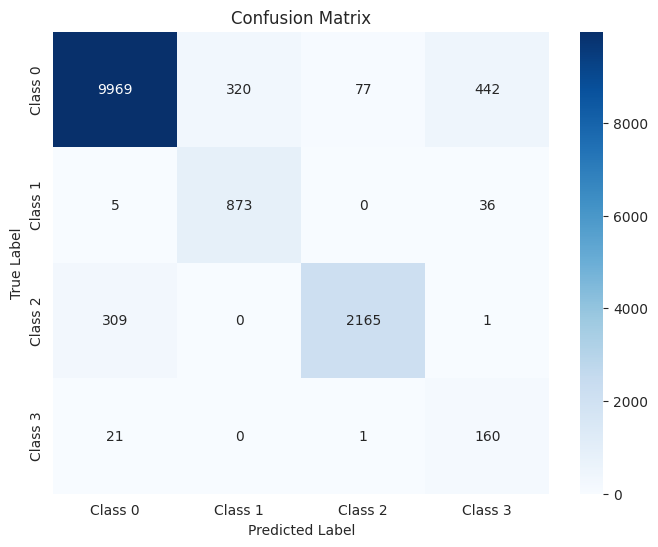

The function took 0.6196 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.92      0.95      2702
     Class 1       0.76      0.93      0.84       228
     Class 2       0.95      0.89      0.92       619
     Class 3       0.24      0.87      0.37        46

    accuracy                           0.92      3595
   macro avg       0.73      0.90      0.77      3595
weighted avg       0.94      0.92      0.93      3595



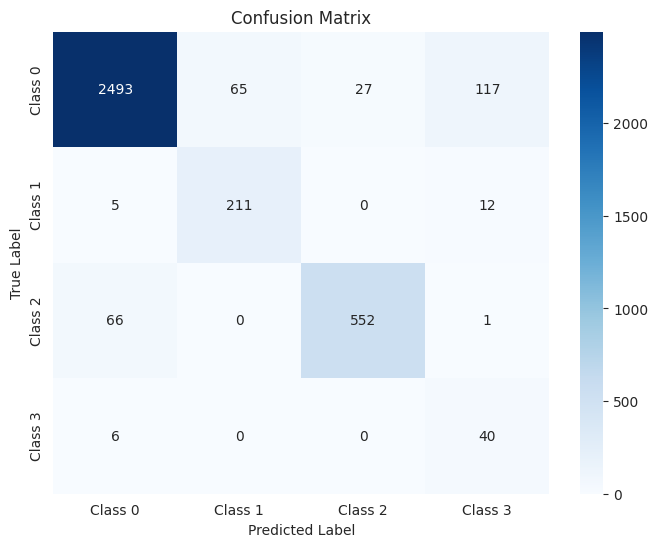

The function took 0.3651 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.92      0.94      3378
     Class 1       0.72      0.93      0.81       285
     Class 2       0.95      0.86      0.90       774
     Class 3       0.25      0.86      0.39        57

    accuracy                           0.91      4494
   macro avg       0.72      0.89      0.76      4494
weighted avg       0.94      0.91      0.92      4494



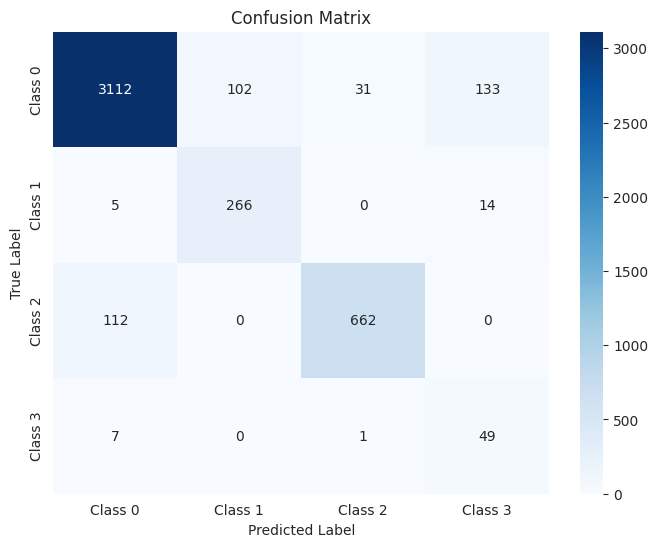

The function took 0.7663 seconds to execute.
[ARCH#099-[16, 8, 4, 4]] done in 31.5s  best-val=0.2991


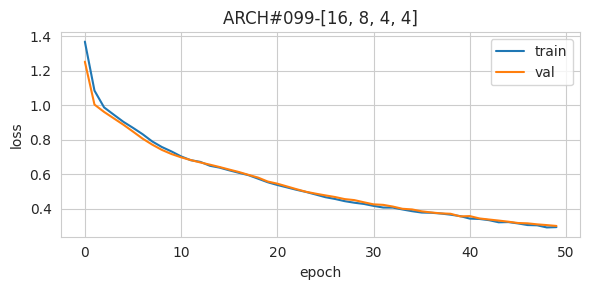


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.13      0.95      0.23       182

    accuracy                           0.89     14379
   macro avg       0.72      0.92      0.73     14379
weighted avg       0.96      0.89      0.92     14379



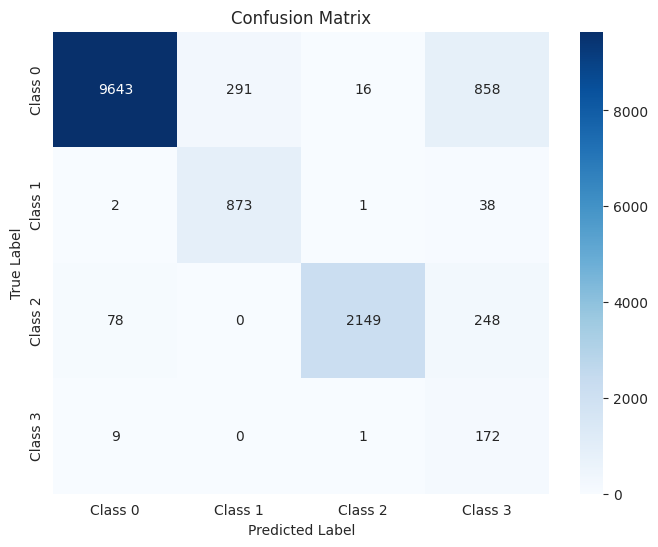

The function took 0.5960 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.13      0.96      0.22        46

    accuracy                           0.89      3595
   macro avg       0.72      0.91      0.73      3595
weighted avg       0.97      0.89      0.92      3595



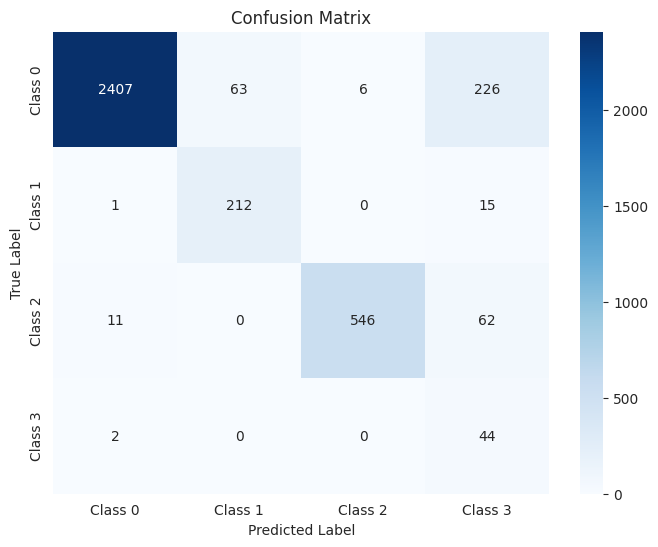

The function took 0.3775 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.75      0.94      0.83       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.13      0.89      0.22        57

    accuracy                           0.89      4494
   macro avg       0.71      0.89      0.72      4494
weighted avg       0.96      0.89      0.92      4494



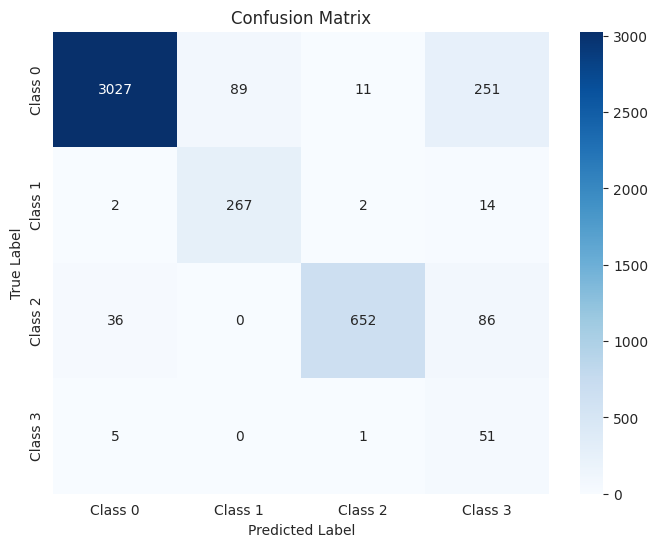

The function took 0.4080 seconds to execute.
[ARCH#100-[16, 8, 4, 2]] done in 32.2s  best-val=0.5992


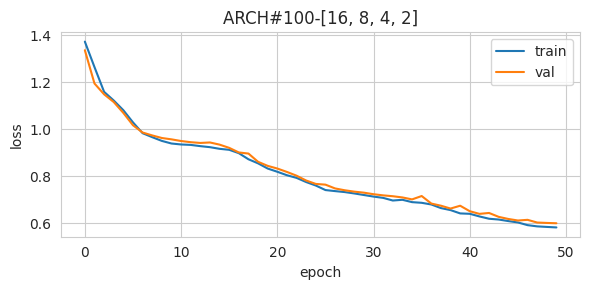


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.74      0.85     10808
     Class 1       0.65      0.96      0.78       914
     Class 2       0.65      0.97      0.78      2475
     Class 3       0.12      0.86      0.21       182

    accuracy                           0.80     14379
   macro avg       0.61      0.88      0.66     14379
weighted avg       0.91      0.80      0.83     14379



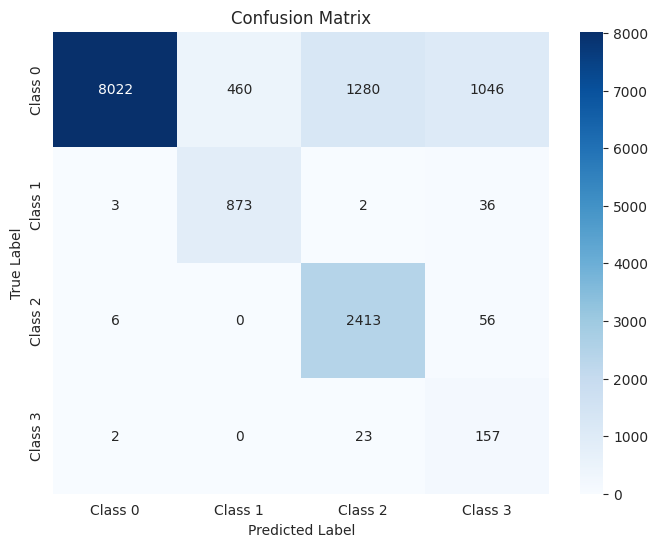

The function took 0.6287 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.76      0.86      2702
     Class 1       0.68      0.93      0.78       228
     Class 2       0.67      0.97      0.79       619
     Class 3       0.12      0.85      0.20        46

    accuracy                           0.81      3595
   macro avg       0.62      0.87      0.66      3595
weighted avg       0.91      0.81      0.84      3595



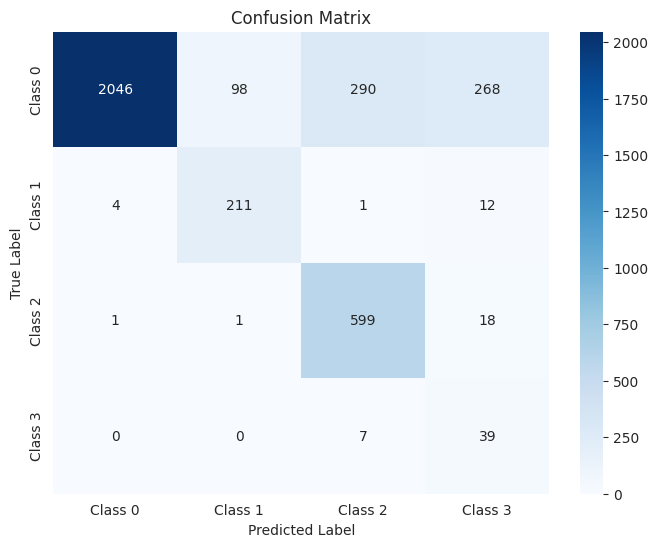

The function took 0.4240 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.74      0.85      3378
     Class 1       0.65      0.93      0.77       285
     Class 2       0.64      0.97      0.77       774
     Class 3       0.11      0.82      0.20        57

    accuracy                           0.79      4494
   macro avg       0.60      0.87      0.65      4494
weighted avg       0.90      0.79      0.82      4494



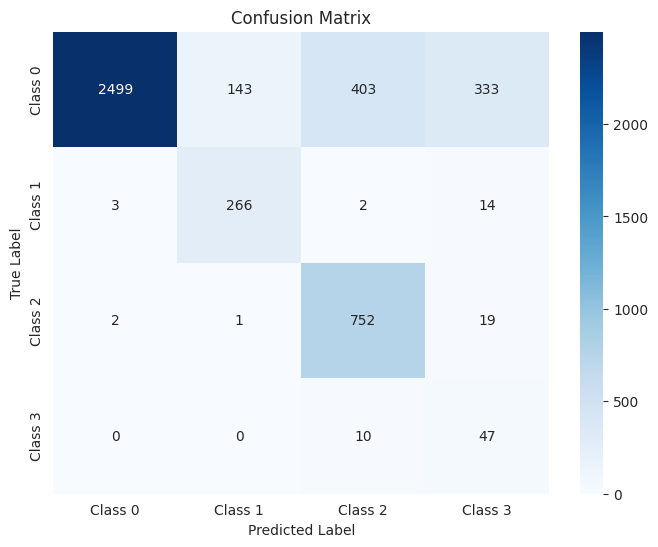

The function took 0.4219 seconds to execute.
[ARCH#101-[16, 8, 2, 2]] done in 31.3s  best-val=0.3781


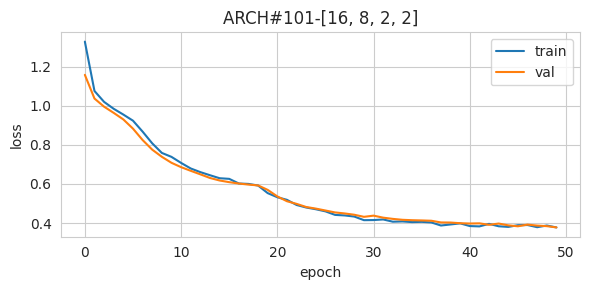


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.92      0.94     10808
     Class 1       0.77      0.95      0.85       914
     Class 2       0.93      0.87      0.90      2475
     Class 3       0.25      0.88      0.38       182

    accuracy                           0.91     14379
   macro avg       0.73      0.90      0.77     14379
weighted avg       0.94      0.91      0.92     14379



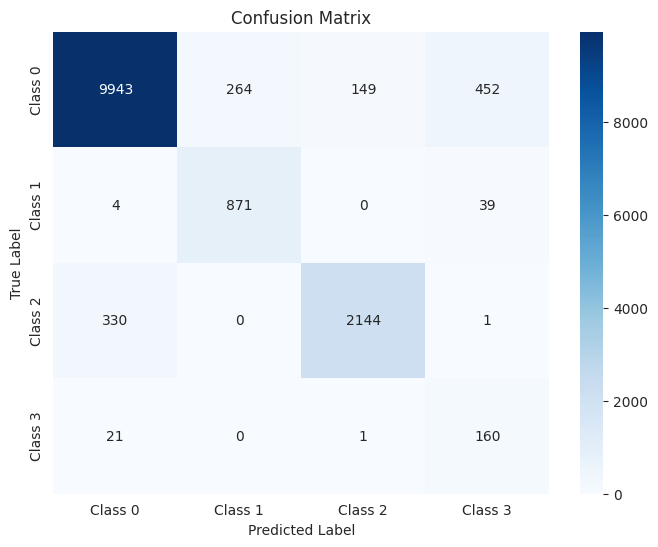

The function took 0.5725 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.92      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.94      0.89      0.91       619
     Class 3       0.23      0.85      0.37        46

    accuracy                           0.92      3595
   macro avg       0.73      0.90      0.77      3595
weighted avg       0.94      0.92      0.93      3595



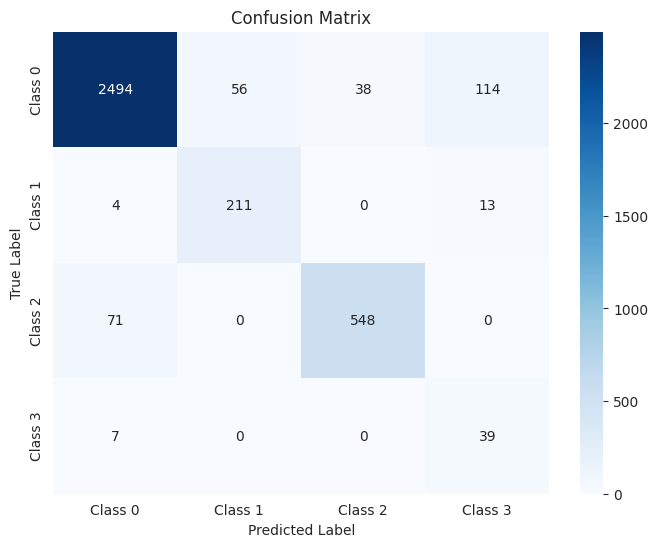

The function took 0.3747 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.92      0.94      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.93      0.84      0.89       774
     Class 3       0.22      0.81      0.35        57

    accuracy                           0.91      4494
   macro avg       0.72      0.88      0.75      4494
weighted avg       0.93      0.91      0.92      4494



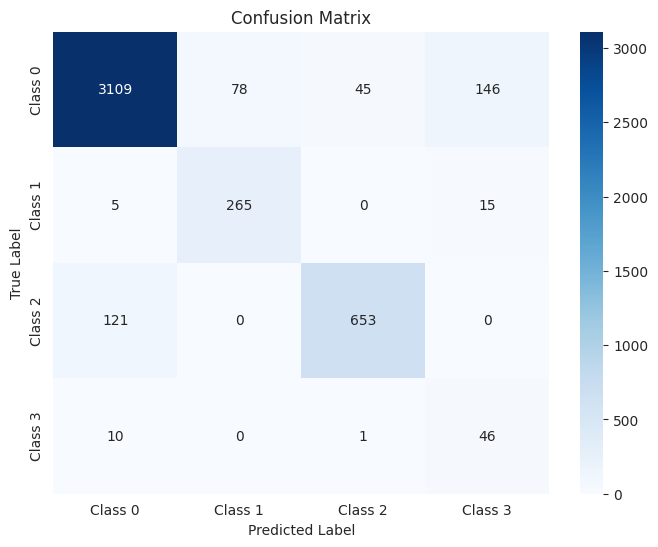

The function took 0.4195 seconds to execute.
[ARCH#102-[16, 4, 4, 4]] done in 32.4s  best-val=0.3727


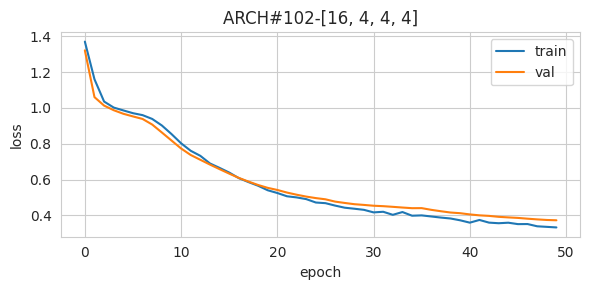


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.89      0.93     10808
     Class 1       0.74      0.96      0.83       914
     Class 2       0.93      0.86      0.90      2475
     Class 3       0.16      0.91      0.27       182

    accuracy                           0.89     14379
   macro avg       0.70      0.91      0.73     14379
weighted avg       0.94      0.89      0.91     14379



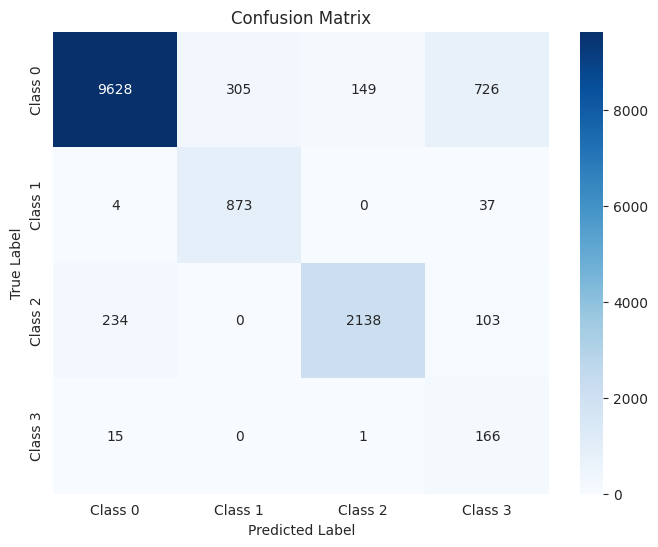

The function took 0.6192 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.93      2702
     Class 1       0.76      0.93      0.84       228
     Class 2       0.94      0.88      0.91       619
     Class 3       0.15      0.89      0.25        46

    accuracy                           0.89      3595
   macro avg       0.71      0.90      0.73      3595
weighted avg       0.95      0.89      0.91      3595



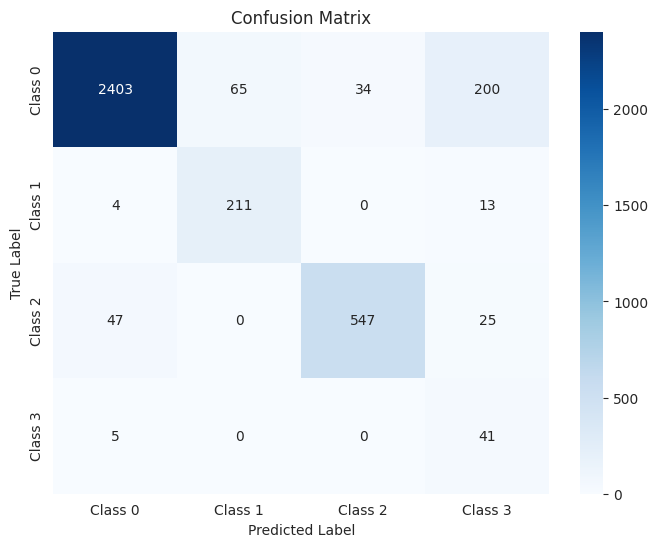

The function took 0.3751 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.89      0.93      3378
     Class 1       0.74      0.93      0.82       285
     Class 2       0.93      0.84      0.88       774
     Class 3       0.16      0.86      0.27        57

    accuracy                           0.89      4494
   macro avg       0.70      0.88      0.73      4494
weighted avg       0.94      0.89      0.91      4494



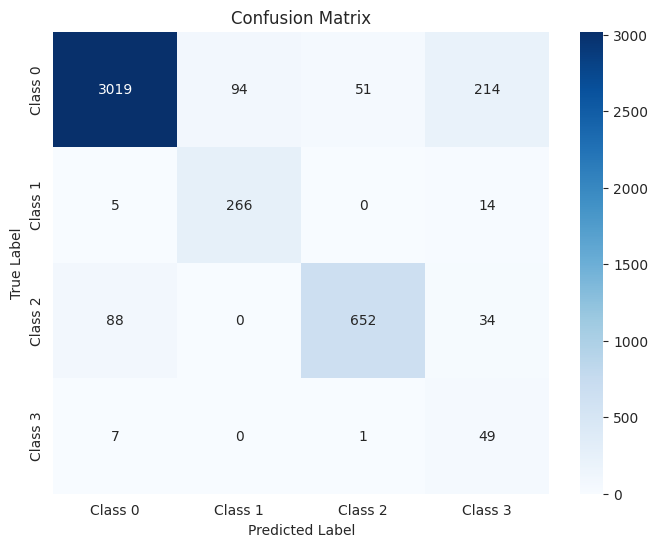

The function took 0.4228 seconds to execute.
[ARCH#103-[16, 4, 4, 2]] done in 31.5s  best-val=0.4615


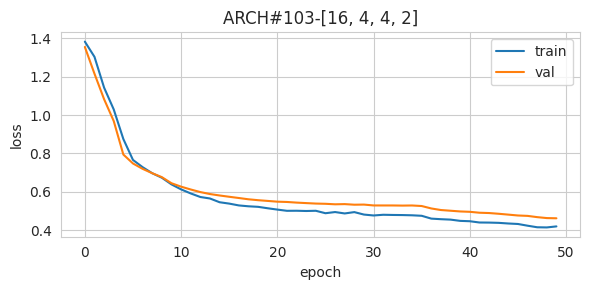


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.89      0.93     10808
     Class 1       0.74      0.96      0.83       914
     Class 2       0.99      0.86      0.92      2475
     Class 3       0.15      0.87      0.25       182

    accuracy                           0.89     14379
   macro avg       0.71      0.90      0.73     14379
weighted avg       0.95      0.89      0.91     14379



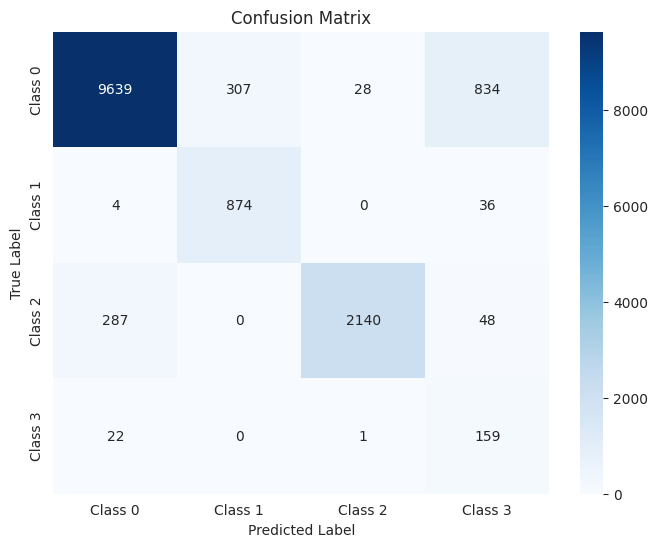

The function took 0.5957 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.90      0.93      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.15      0.87      0.25        46

    accuracy                           0.90      3595
   macro avg       0.72      0.89      0.74      3595
weighted avg       0.95      0.90      0.92      3595



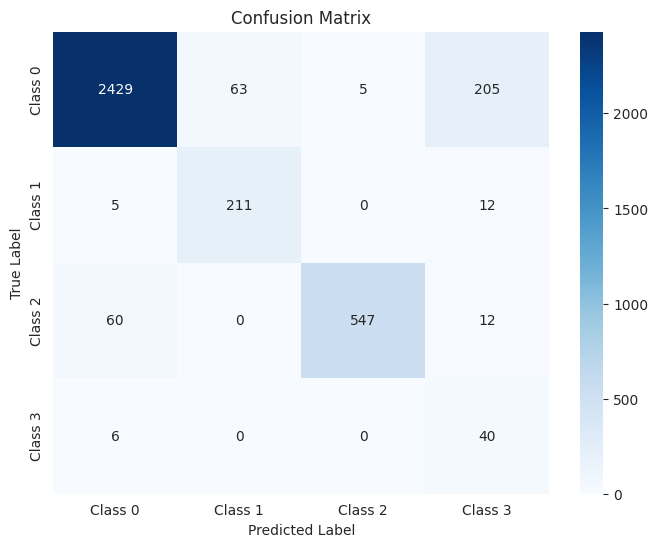

The function took 0.3912 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.89      0.93      3378
     Class 1       0.74      0.93      0.82       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.14      0.86      0.24        57

    accuracy                           0.89      4494
   macro avg       0.71      0.88      0.73      4494
weighted avg       0.94      0.89      0.91      4494



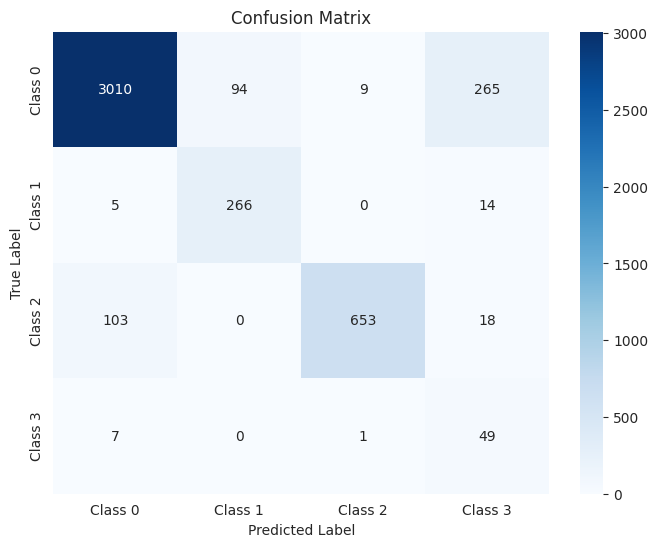

The function took 0.4144 seconds to execute.
[ARCH#104-[16, 4, 2, 2]] done in 32.3s  best-val=0.5810


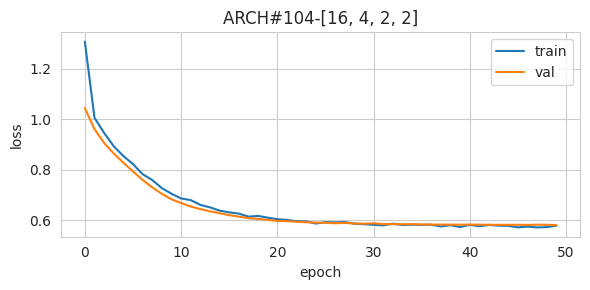


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.97      0.96     10808
     Class 1       0.74      0.91      0.82       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.94     14379
   macro avg       0.67      0.69      0.67     14379
weighted avg       0.93      0.94      0.93     14379



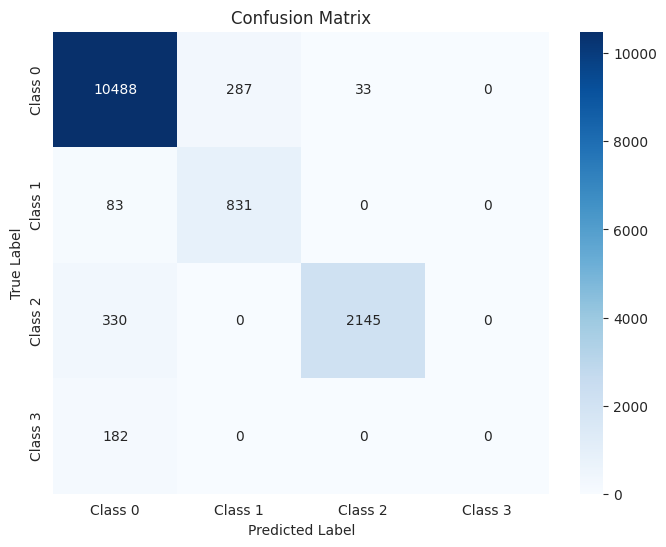

The function took 0.6067 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.97      0.96      2702
     Class 1       0.77      0.88      0.82       228
     Class 2       0.98      0.88      0.93       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.94      3595
   macro avg       0.67      0.68      0.68      3595
weighted avg       0.93      0.94      0.93      3595



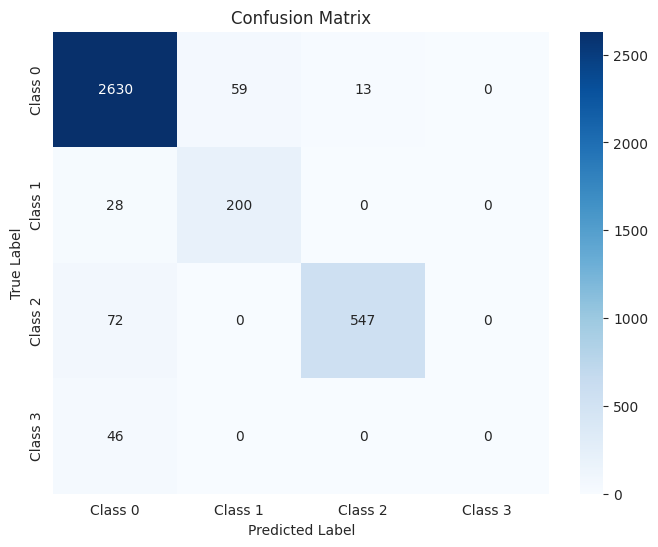

The function took 0.3777 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.97      0.96      3378
     Class 1       0.75      0.89      0.82       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.93      4494
   macro avg       0.67      0.68      0.67      4494
weighted avg       0.92      0.93      0.93      4494



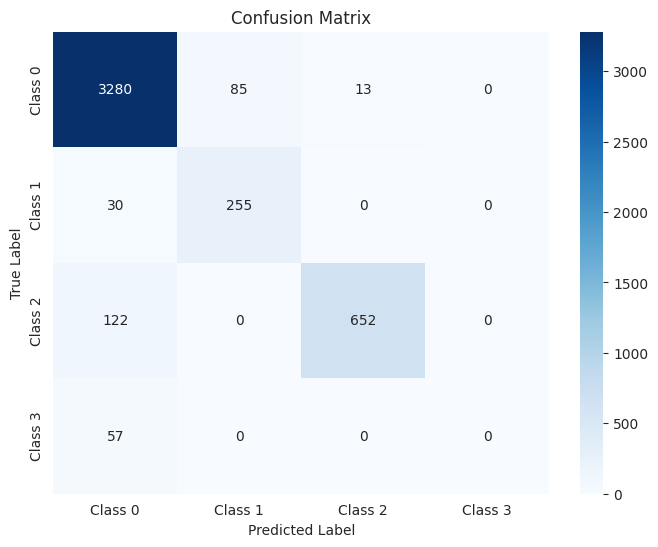

The function took 0.4201 seconds to execute.
[ARCH#105-[16, 2, 2, 2]] done in 31.1s  best-val=0.5470


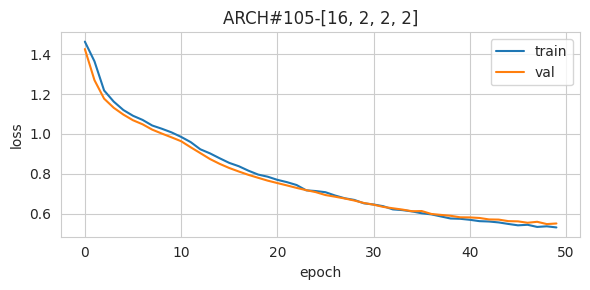


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.88      0.92     10808
     Class 1       0.62      0.95      0.75       914
     Class 2       0.93      0.87      0.90      2475
     Class 3       0.18      0.85      0.30       182

    accuracy                           0.88     14379
   macro avg       0.67      0.89      0.72     14379
weighted avg       0.93      0.88      0.90     14379



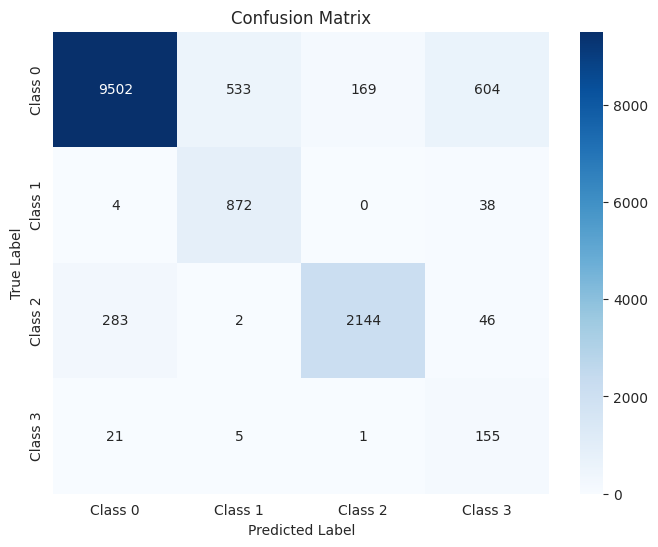

The function took 0.6104 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.89      0.93      2702
     Class 1       0.63      0.92      0.75       228
     Class 2       0.93      0.88      0.91       619
     Class 3       0.19      0.85      0.31        46

    accuracy                           0.89      3595
   macro avg       0.68      0.89      0.72      3595
weighted avg       0.93      0.89      0.90      3595



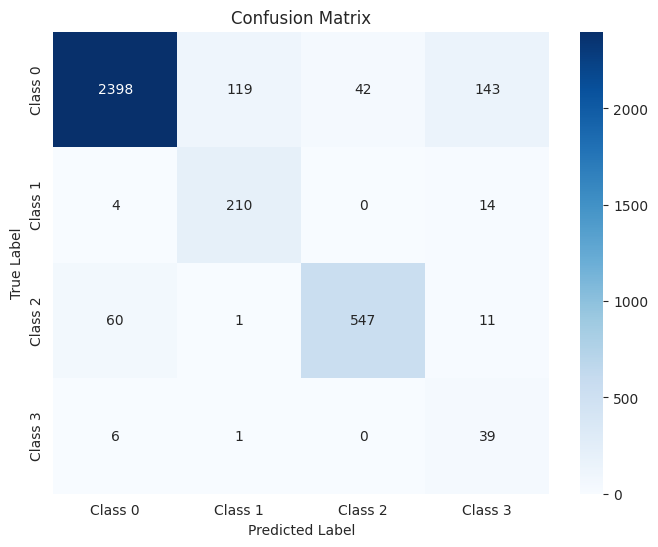

The function took 0.3851 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.88      0.92      3378
     Class 1       0.60      0.93      0.73       285
     Class 2       0.92      0.84      0.88       774
     Class 3       0.17      0.82      0.29        57

    accuracy                           0.87      4494
   macro avg       0.66      0.87      0.70      4494
weighted avg       0.92      0.87      0.89      4494



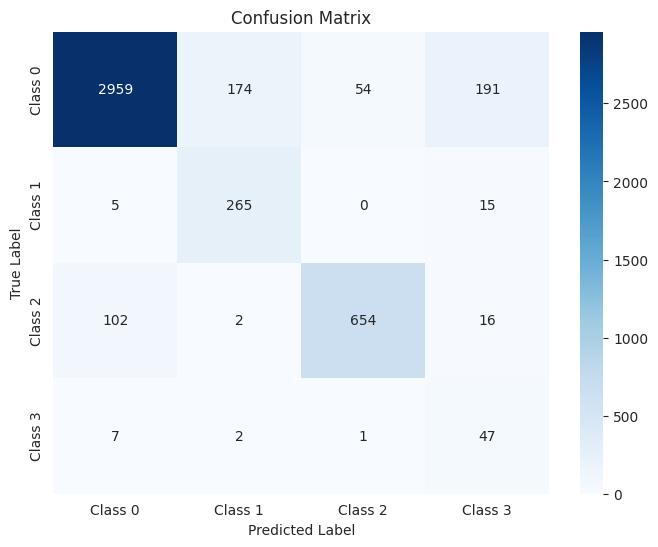

The function took 0.4167 seconds to execute.
[ARCH#106-[8, 8, 8, 8]] done in 32.1s  best-val=0.3134


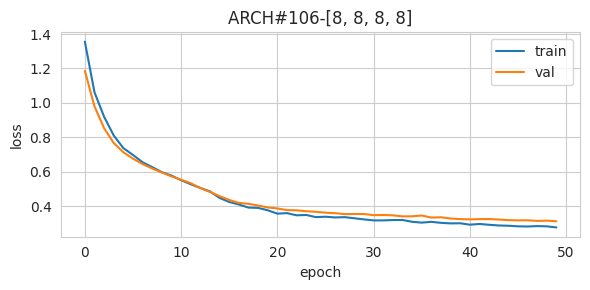


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.73      0.95      0.83       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.13      0.91      0.23       182

    accuracy                           0.89     14379
   macro avg       0.71      0.91      0.73     14379
weighted avg       0.96      0.89      0.92     14379



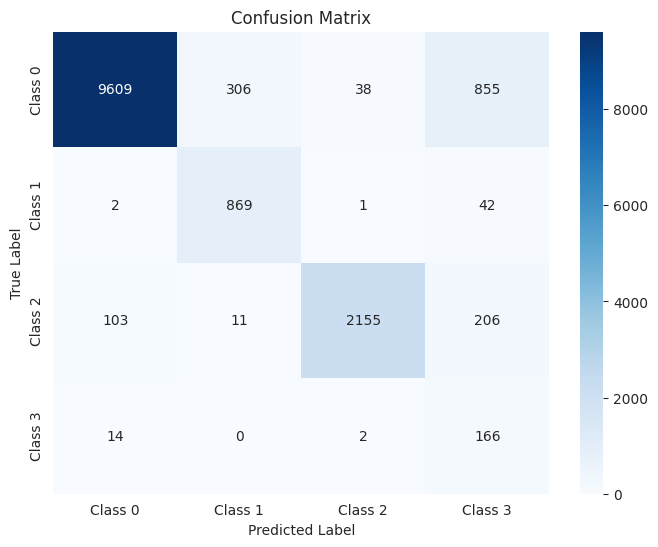

The function took 0.6060 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.93      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.12      0.89      0.21        46

    accuracy                           0.89      3595
   macro avg       0.71      0.90      0.73      3595
weighted avg       0.96      0.89      0.92      3595



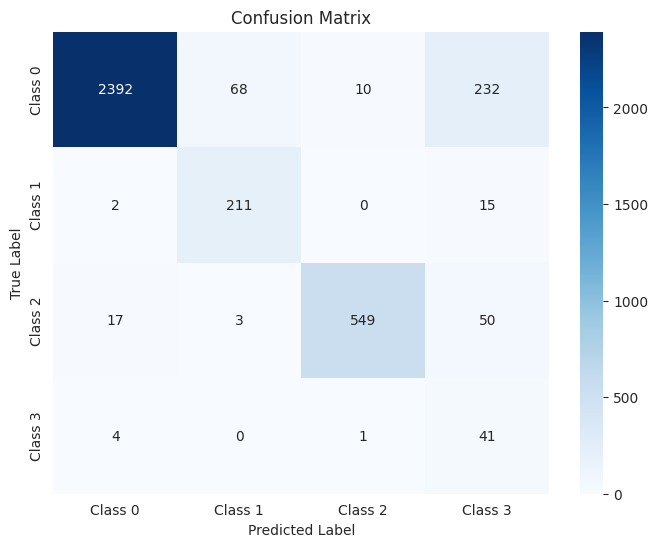

The function took 0.4054 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.94      3378
     Class 1       0.72      0.93      0.81       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.13      0.86      0.23        57

    accuracy                           0.89      4494
   macro avg       0.70      0.88      0.72      4494
weighted avg       0.95      0.89      0.91      4494



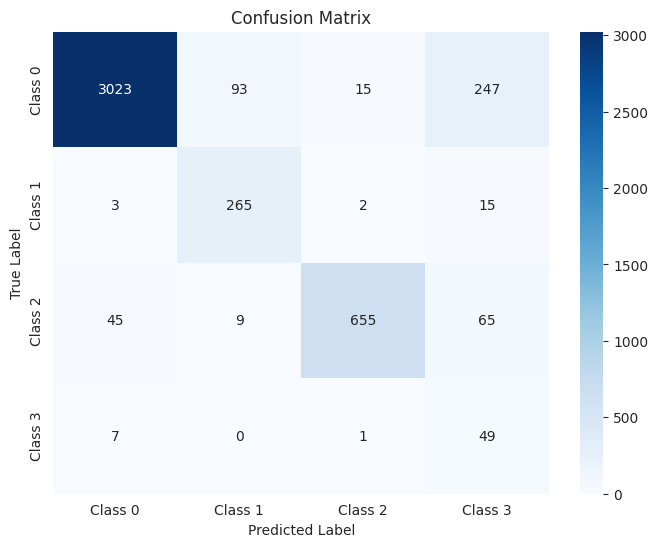

The function took 0.4144 seconds to execute.
[ARCH#107-[8, 8, 8, 4]] done in 31.4s  best-val=0.3534


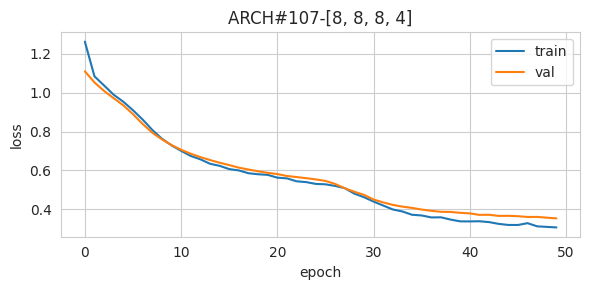


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93     10808
     Class 1       0.70      0.96      0.81       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.13      0.98      0.23       182

    accuracy                           0.89     14379
   macro avg       0.70      0.92      0.72     14379
weighted avg       0.96      0.89      0.91     14379



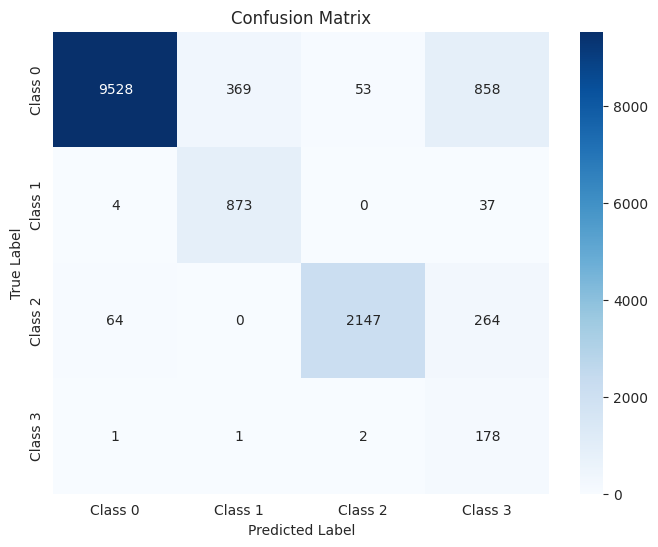

The function took 0.6177 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      2702
     Class 1       0.72      0.93      0.81       228
     Class 2       0.96      0.88      0.92       619
     Class 3       0.14      0.98      0.24        46

    accuracy                           0.89      3595
   macro avg       0.70      0.92      0.73      3595
weighted avg       0.96      0.89      0.91      3595



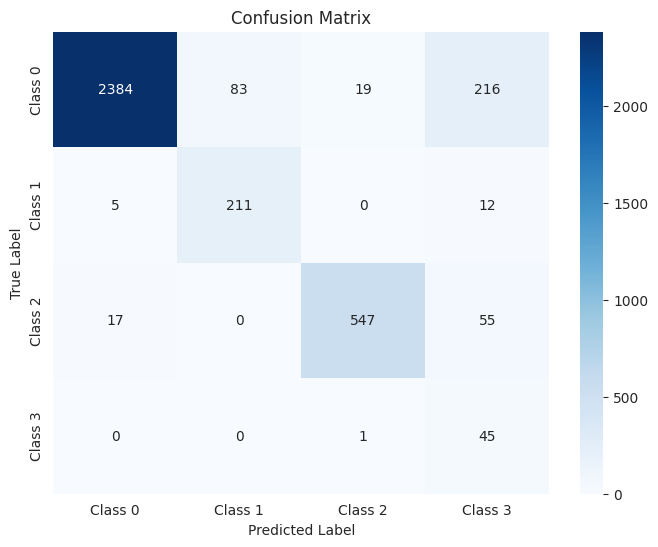

The function took 0.3765 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      3378
     Class 1       0.69      0.93      0.80       285
     Class 2       0.97      0.84      0.90       774
     Class 3       0.13      0.98      0.24        57

    accuracy                           0.88      4494
   macro avg       0.70      0.91      0.72      4494
weighted avg       0.96      0.88      0.91      4494



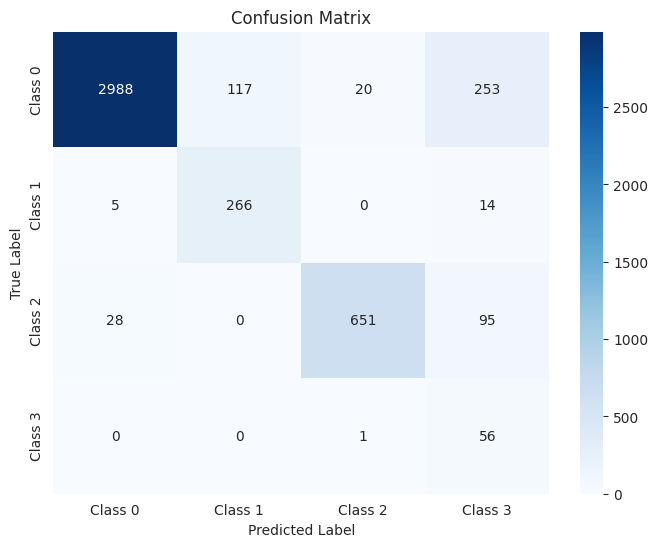

The function took 0.4496 seconds to execute.
[ARCH#108-[8, 8, 8, 2]] done in 31.7s  best-val=0.3822


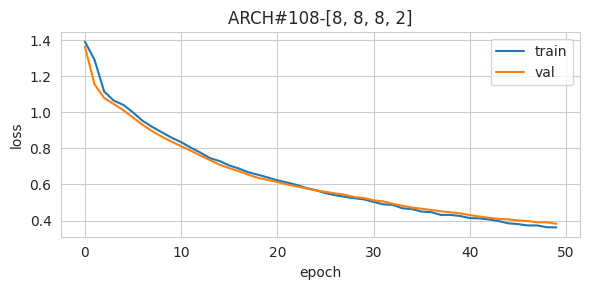


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.99      0.86      0.92      2475
     Class 3       0.13      0.98      0.23       182

    accuracy                           0.89     14379
   macro avg       0.72      0.92      0.74     14379
weighted avg       0.96      0.89      0.92     14379



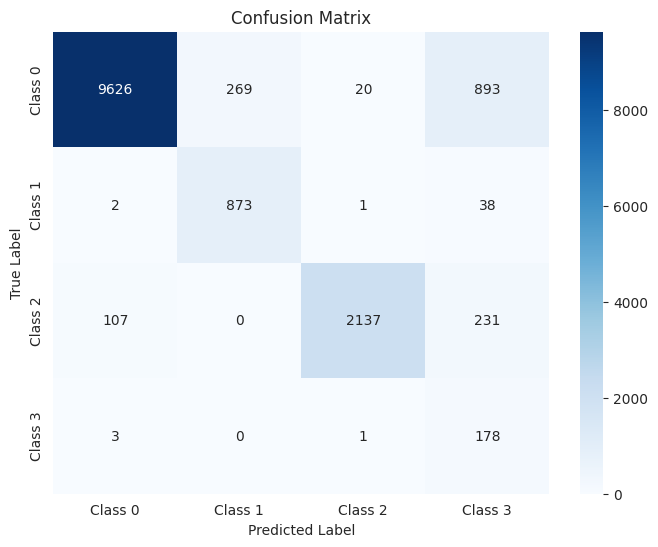

The function took 0.6289 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.80      0.92      0.85       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.13      0.98      0.23        46

    accuracy                           0.89      3595
   macro avg       0.73      0.92      0.74      3595
weighted avg       0.97      0.89      0.92      3595



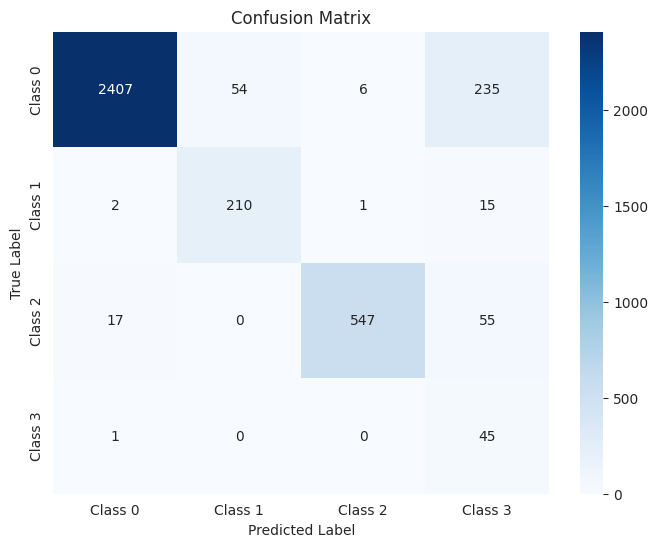

The function took 0.7400 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.94      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.98      0.84      0.90       774
     Class 3       0.13      0.93      0.23        57

    accuracy                           0.89      4494
   macro avg       0.72      0.90      0.73      4494
weighted avg       0.96      0.89      0.92      4494



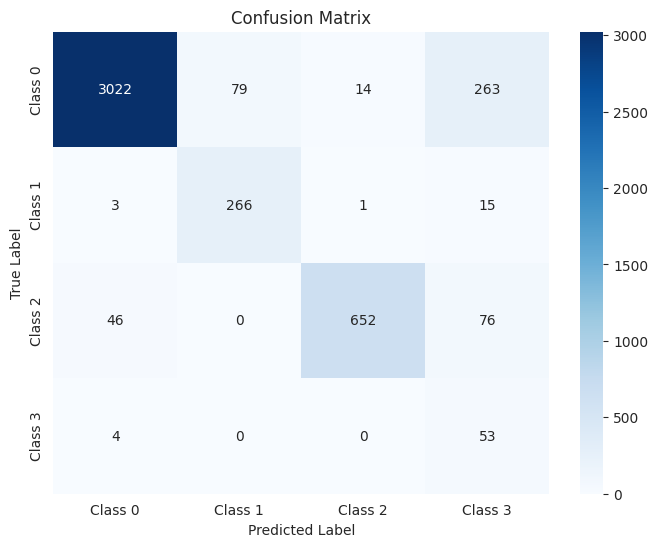

The function took 0.4437 seconds to execute.
[ARCH#109-[8, 8, 4, 4]] done in 31.3s  best-val=0.3417


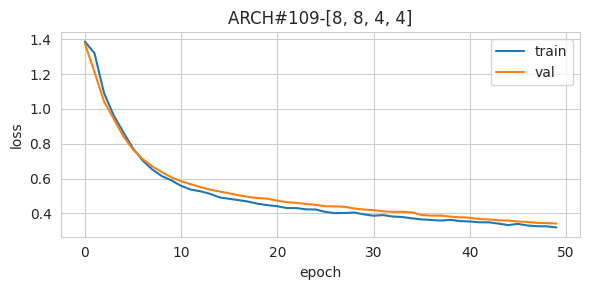


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.83      0.90     10808
     Class 1       0.71      0.91      0.80       914
     Class 2       0.95      0.87      0.91      2475
     Class 3       0.09      0.98      0.17       182

    accuracy                           0.84     14379
   macro avg       0.69      0.90      0.70     14379
weighted avg       0.95      0.84      0.89     14379



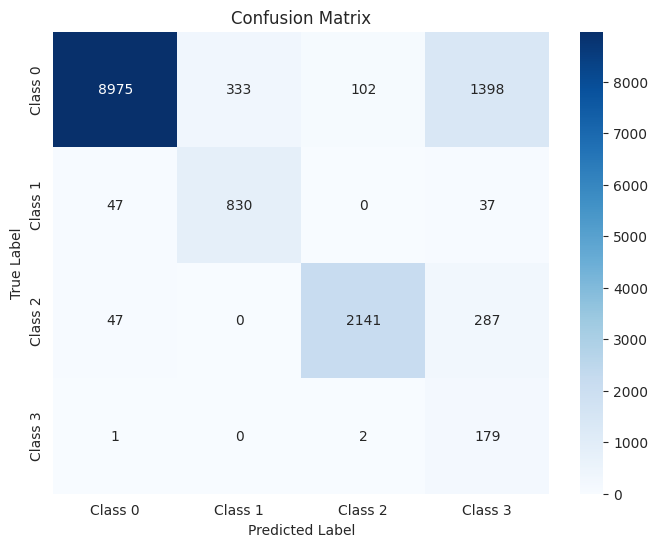

The function took 0.6466 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.83      0.90      2702
     Class 1       0.74      0.88      0.80       228
     Class 2       0.95      0.88      0.92       619
     Class 3       0.10      0.98      0.17        46

    accuracy                           0.85      3595
   macro avg       0.69      0.89      0.70      3595
weighted avg       0.96      0.85      0.89      3595



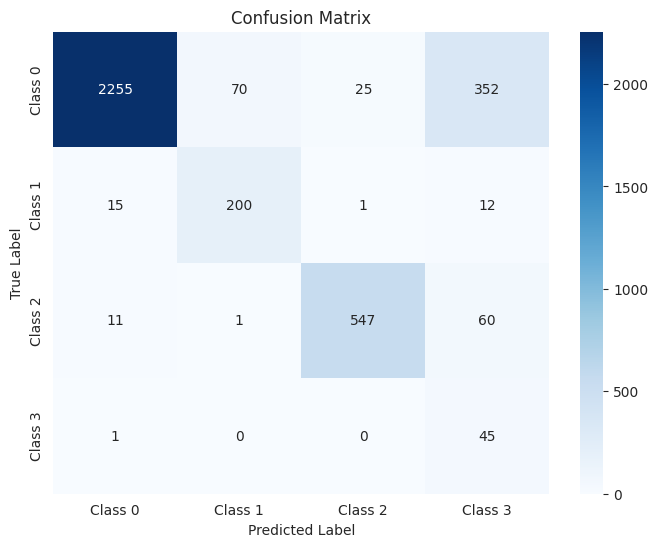

The function took 0.3684 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.83      0.90      3378
     Class 1       0.70      0.88      0.78       285
     Class 2       0.94      0.84      0.89       774
     Class 3       0.09      0.96      0.17        57

    accuracy                           0.84      4494
   macro avg       0.68      0.88      0.69      4494
weighted avg       0.95      0.84      0.88      4494



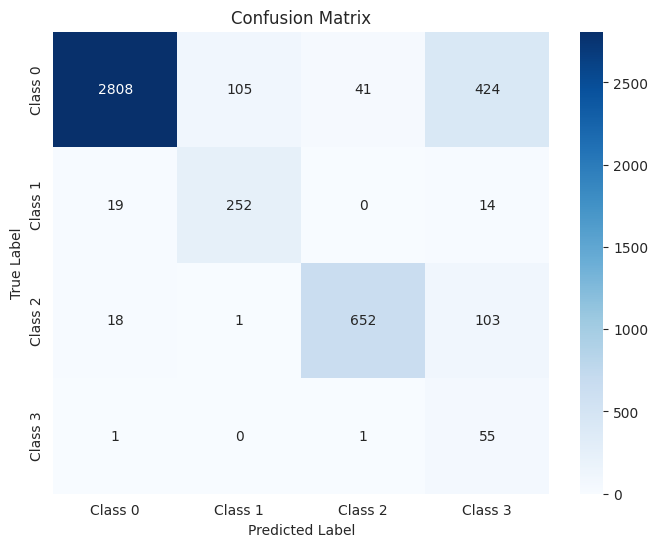

The function took 0.4411 seconds to execute.
[ARCH#110-[8, 8, 4, 2]] early-stop @ epoch 049
[ARCH#110-[8, 8, 4, 2]] done in 32.1s  best-val=1.3794


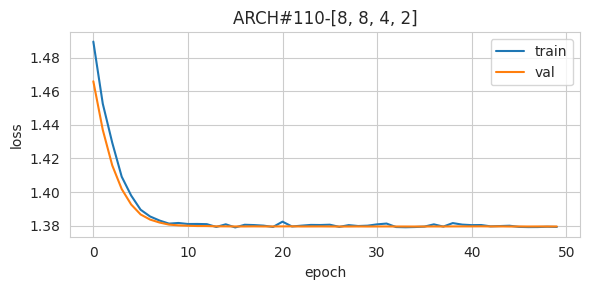


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



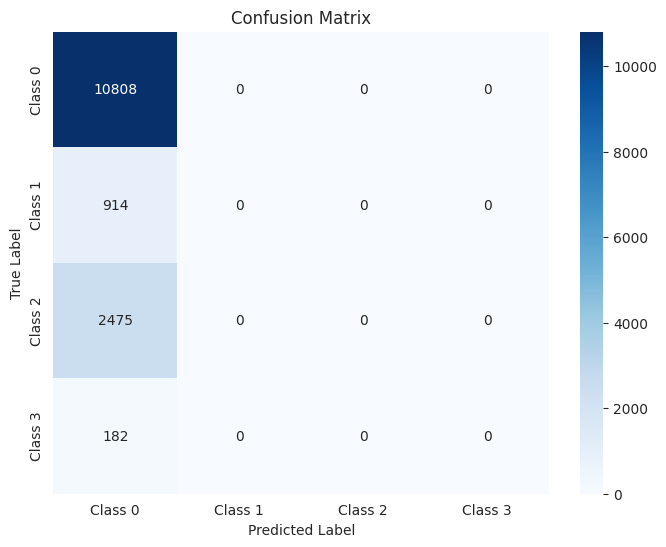

The function took 0.6197 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



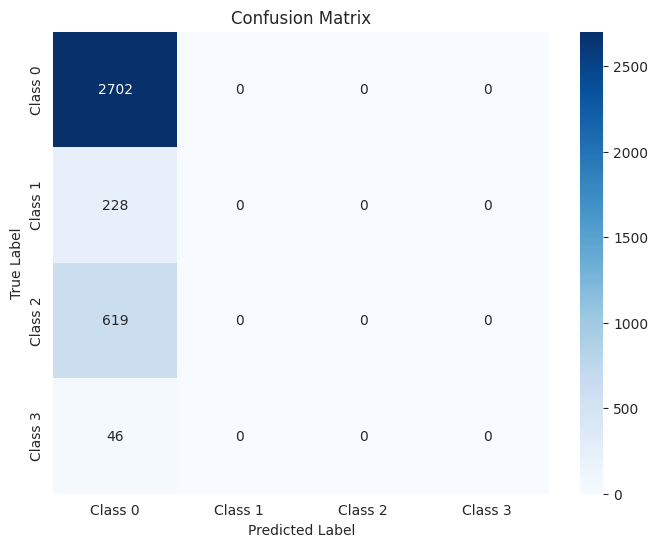

The function took 0.3701 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



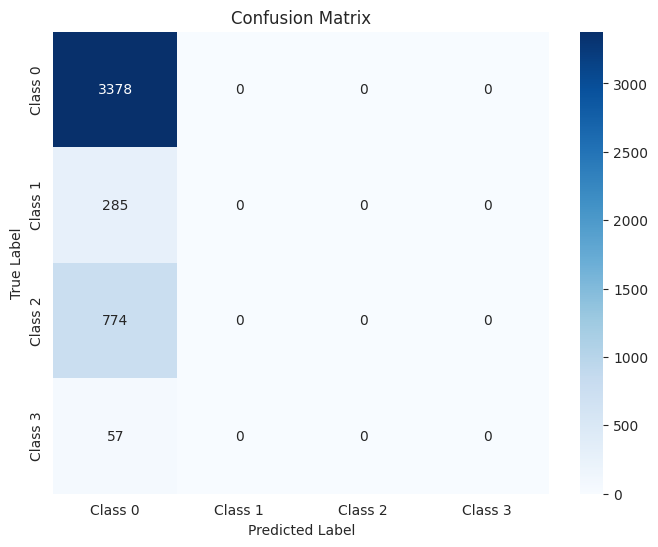

The function took 0.4093 seconds to execute.
[ARCH#111-[8, 8, 2, 2]] done in 31.3s  best-val=0.4950


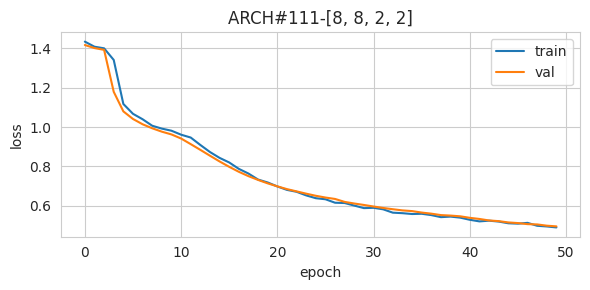


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95     10808
     Class 1       0.72      0.95      0.82       914
     Class 2       0.94      0.87      0.90      2475
     Class 3       0.30      0.82      0.44       182

    accuracy                           0.92     14379
   macro avg       0.73      0.89      0.78     14379
weighted avg       0.94      0.92      0.92     14379



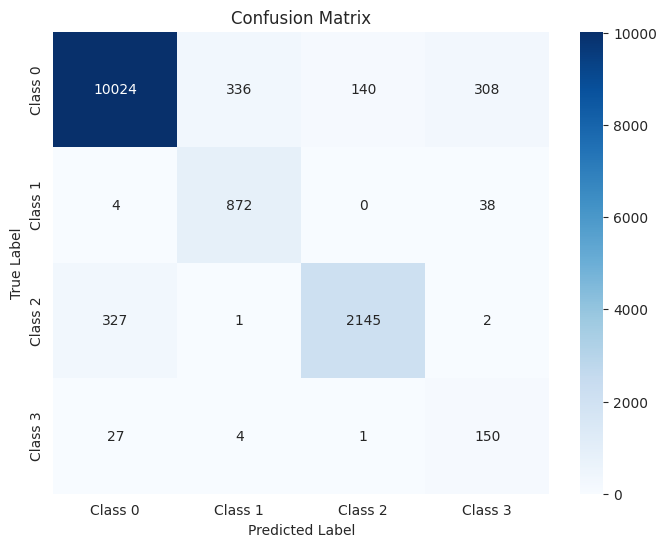

The function took 0.6036 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.94      0.89      0.91       619
     Class 3       0.27      0.83      0.40        46

    accuracy                           0.92      3595
   macro avg       0.73      0.89      0.77      3595
weighted avg       0.94      0.92      0.93      3595



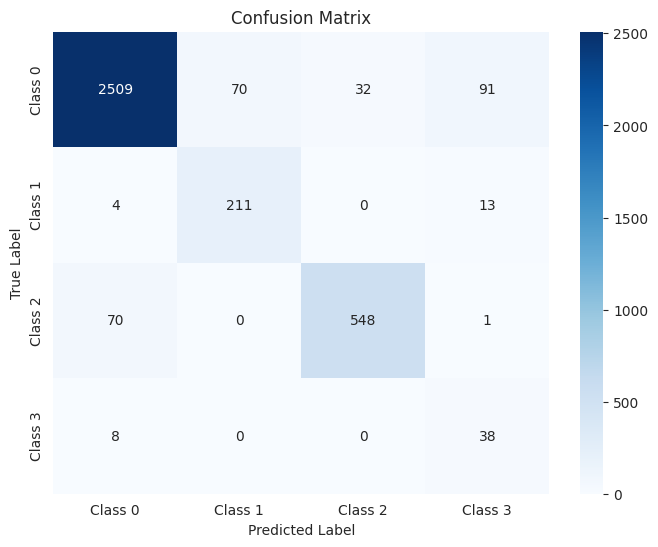

The function took 0.3746 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.92      0.94      3378
     Class 1       0.71      0.93      0.81       285
     Class 2       0.93      0.84      0.88       774
     Class 3       0.27      0.77      0.40        57

    accuracy                           0.91      4494
   macro avg       0.72      0.87      0.76      4494
weighted avg       0.93      0.91      0.92      4494



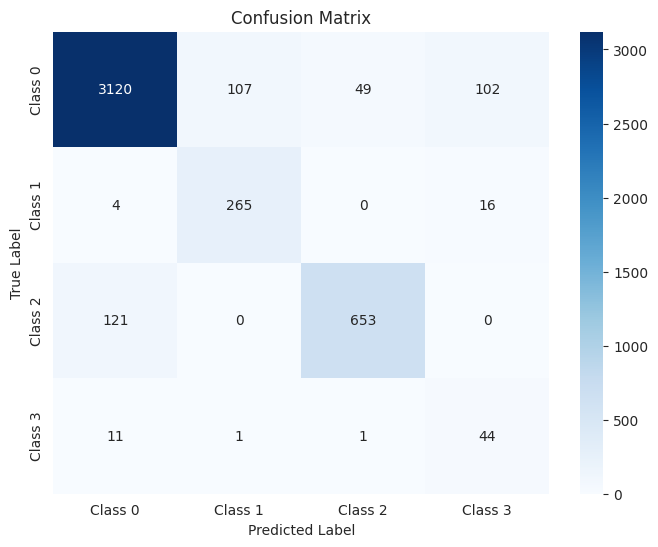

The function took 0.4100 seconds to execute.
[ARCH#112-[8, 4, 4, 4]] done in 32.1s  best-val=0.3868


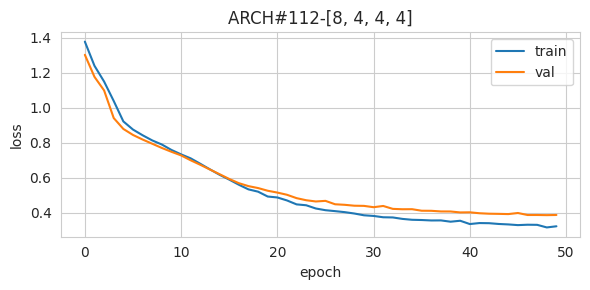


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.91      0.94     10808
     Class 1       0.73      0.92      0.82       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.19      0.88      0.31       182

    accuracy                           0.91     14379
   macro avg       0.72      0.90      0.75     14379
weighted avg       0.95      0.91      0.92     14379



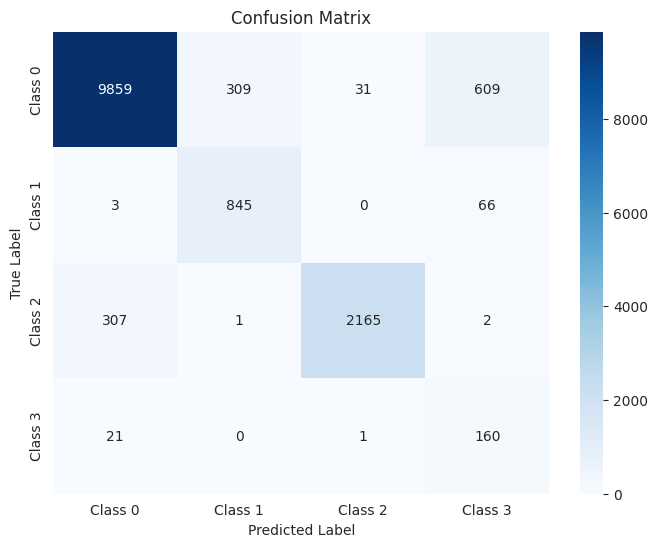

The function took 0.6192 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.91      0.94      2702
     Class 1       0.74      0.89      0.81       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.18      0.85      0.30        46

    accuracy                           0.91      3595
   macro avg       0.72      0.89      0.75      3595
weighted avg       0.95      0.91      0.92      3595



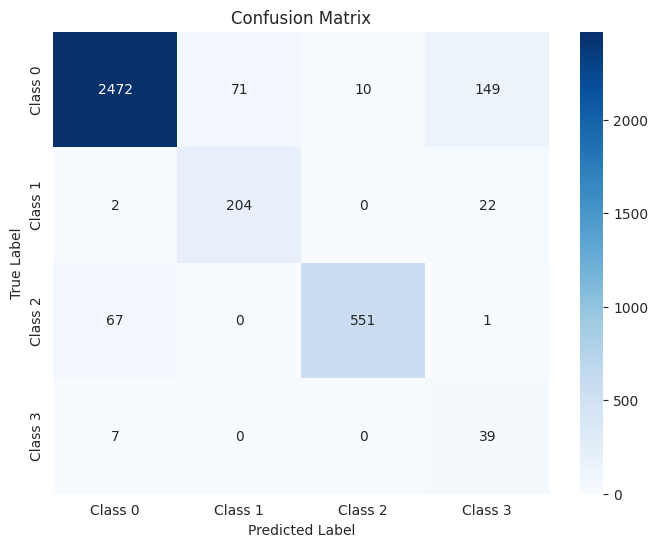

The function took 0.3975 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.91      0.93      3378
     Class 1       0.73      0.90      0.80       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.18      0.86      0.30        57

    accuracy                           0.90      4494
   macro avg       0.71      0.88      0.74      4494
weighted avg       0.94      0.90      0.91      4494



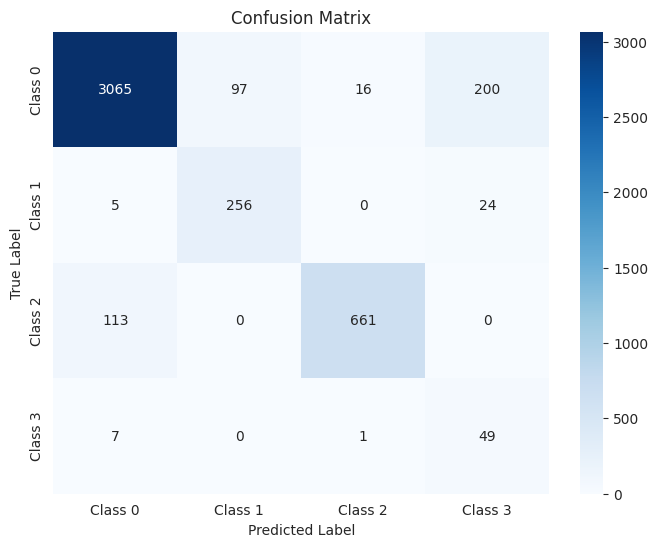

The function took 0.4173 seconds to execute.
[ARCH#113-[8, 4, 4, 2]] done in 31.1s  best-val=0.5979


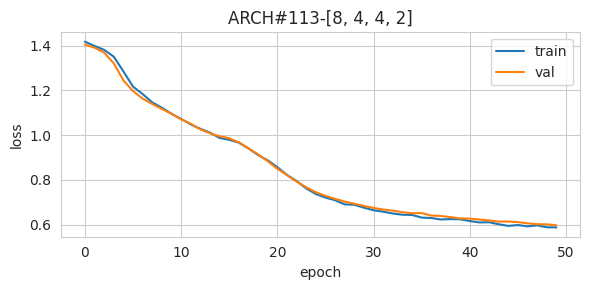


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.51      0.66     10808
     Class 1       0.32      0.96      0.48       914
     Class 2       0.92      0.87      0.90      2475
     Class 3       0.05      0.88      0.09       182

    accuracy                           0.60     14379
   macro avg       0.56      0.81      0.53     14379
weighted avg       0.89      0.60      0.68     14379



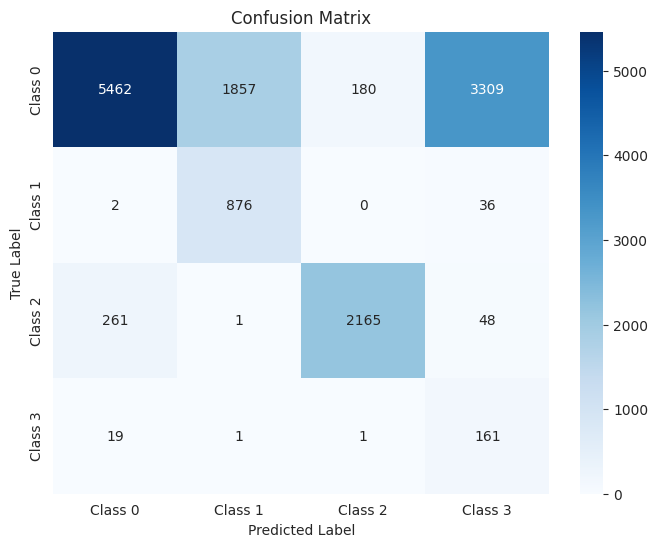

The function took 0.6942 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.50      0.66      2702
     Class 1       0.31      0.94      0.47       228
     Class 2       0.90      0.89      0.89       619
     Class 3       0.05      0.87      0.09        46

    accuracy                           0.60      3595
   macro avg       0.55      0.80      0.53      3595
weighted avg       0.89      0.60      0.68      3595



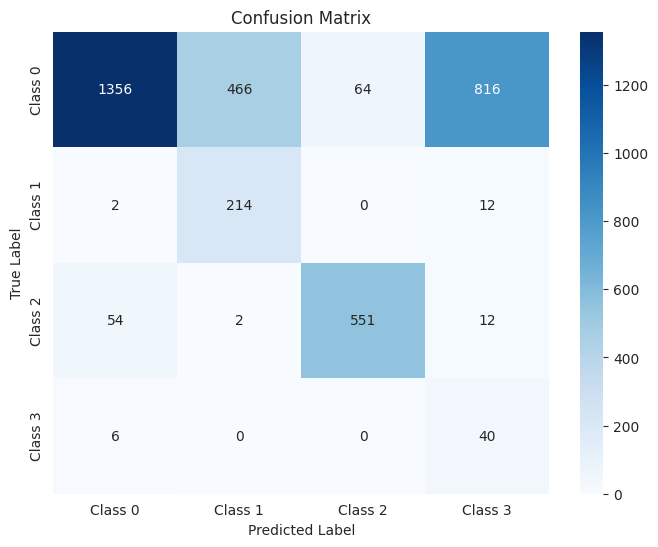

The function took 0.3750 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.49      0.65      3378
     Class 1       0.31      0.95      0.47       285
     Class 2       0.90      0.85      0.87       774
     Class 3       0.04      0.86      0.08        57

    accuracy                           0.59      4494
   macro avg       0.55      0.79      0.52      4494
weighted avg       0.88      0.59      0.67      4494



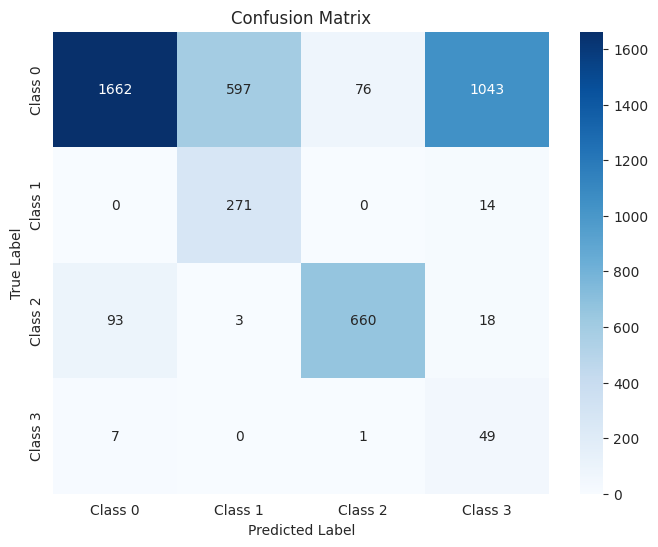

The function took 0.4263 seconds to execute.
[ARCH#114-[8, 4, 2, 2]] done in 32.4s  best-val=0.5840


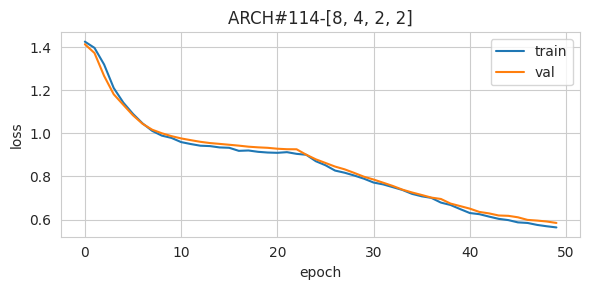


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.79      0.88     10808
     Class 1       0.65      0.96      0.78       914
     Class 2       0.68      0.95      0.79      2475
     Class 3       0.06      0.28      0.10       182

    accuracy                           0.82     14379
   macro avg       0.59      0.74      0.64     14379
weighted avg       0.90      0.82      0.85     14379



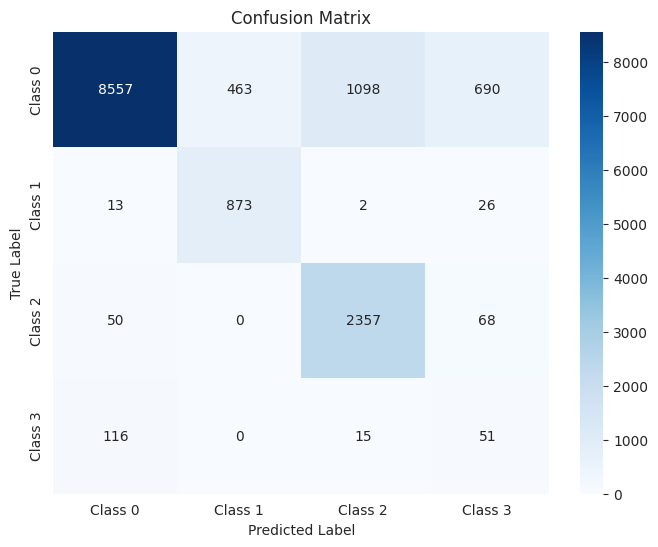

The function took 0.6692 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.81      0.89      2702
     Class 1       0.68      0.93      0.79       228
     Class 2       0.70      0.97      0.81       619
     Class 3       0.05      0.17      0.07        46

    accuracy                           0.84      3595
   macro avg       0.60      0.72      0.64      3595
weighted avg       0.90      0.84      0.86      3595



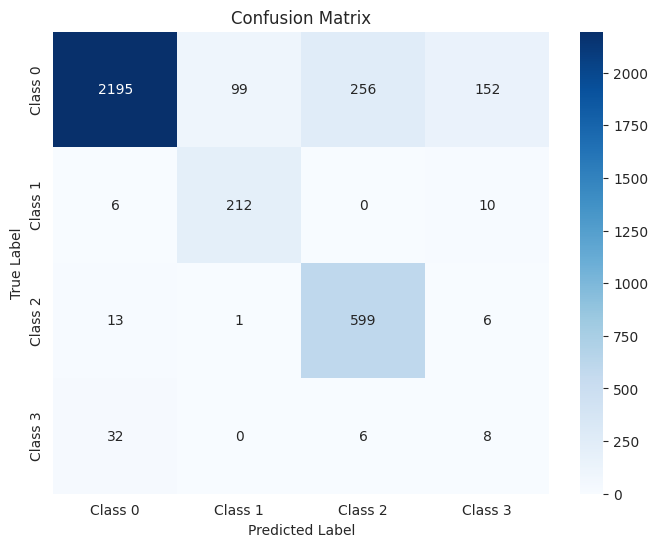

The function took 0.4188 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.80      0.88      3378
     Class 1       0.65      0.94      0.77       285
     Class 2       0.68      0.94      0.79       774
     Class 3       0.07      0.32      0.11        57

    accuracy                           0.82      4494
   macro avg       0.59      0.75      0.64      4494
weighted avg       0.90      0.82      0.85      4494



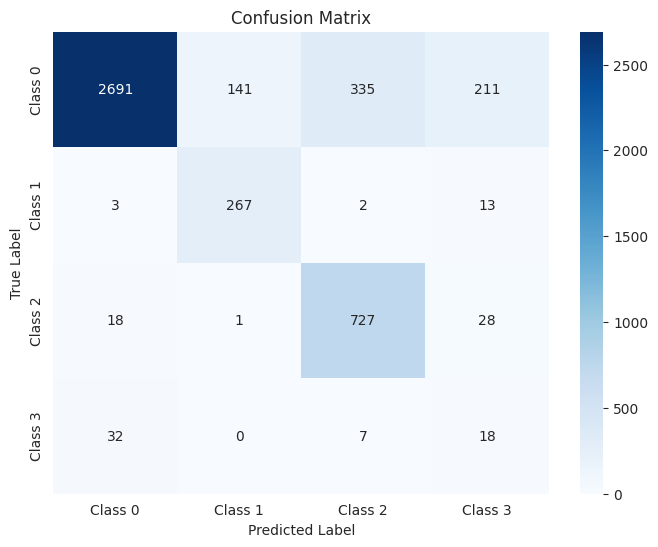

The function took 0.4041 seconds to execute.
[ARCH#115-[8, 2, 2, 2]] early-stop @ epoch 027
[ARCH#115-[8, 2, 2, 2]] done in 17.4s  best-val=1.3794


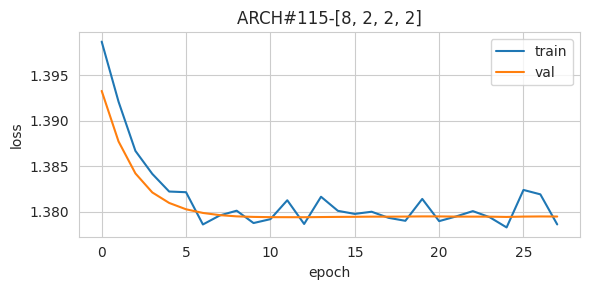


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



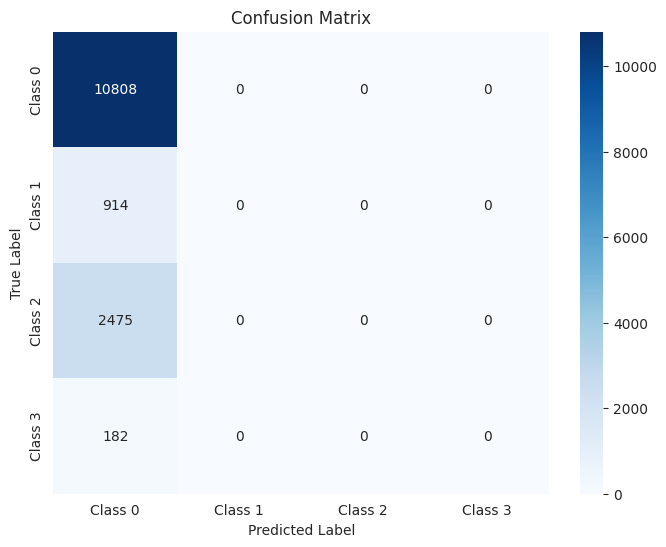

The function took 0.6180 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



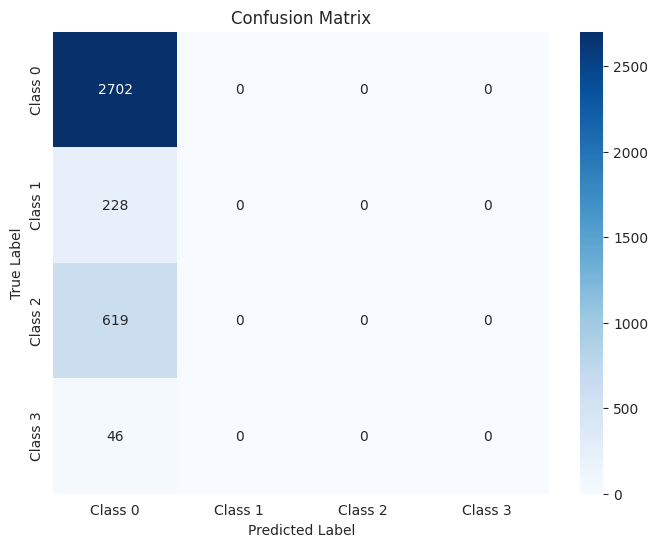

The function took 0.4053 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



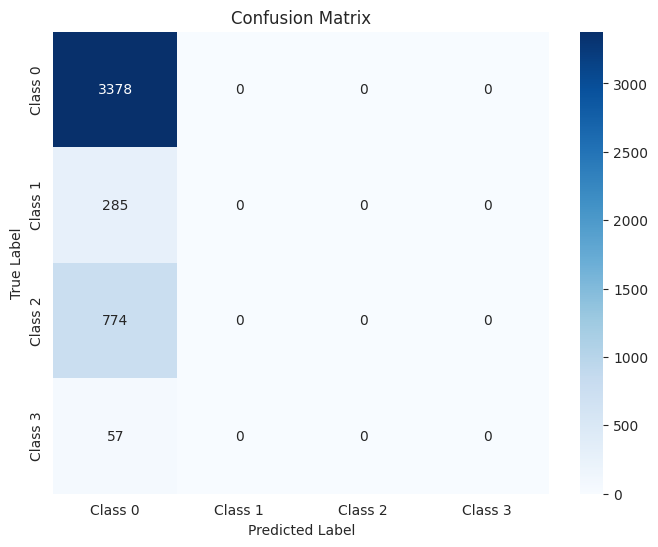

The function took 0.4090 seconds to execute.
[ARCH#116-[4, 4, 4, 4]] done in 31.8s  best-val=0.3668


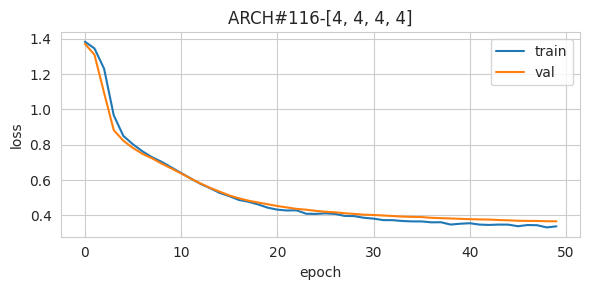


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.95     10808
     Class 1       0.69      0.93      0.79       914
     Class 2       0.98      0.86      0.92      2475
     Class 3       0.28      0.87      0.42       182

    accuracy                           0.92     14379
   macro avg       0.73      0.90      0.77     14379
weighted avg       0.94      0.92      0.92     14379



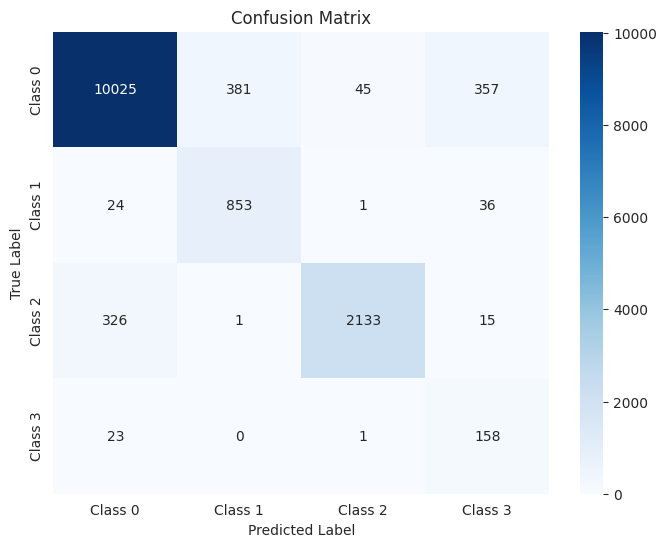

The function took 0.9874 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95      2702
     Class 1       0.71      0.91      0.79       228
     Class 2       0.98      0.88      0.92       619
     Class 3       0.28      0.85      0.43        46

    accuracy                           0.92      3595
   macro avg       0.73      0.89      0.77      3595
weighted avg       0.94      0.92      0.93      3595



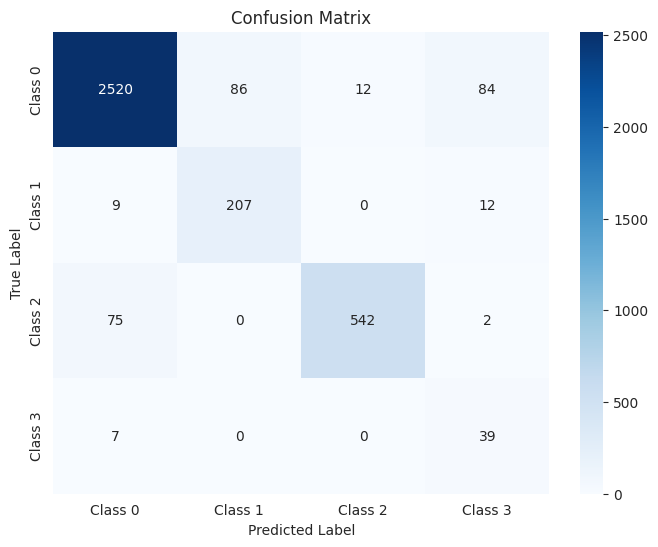

The function took 0.3942 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.92      0.94      3378
     Class 1       0.66      0.91      0.76       285
     Class 2       0.97      0.84      0.90       774
     Class 3       0.25      0.82      0.39        57

    accuracy                           0.91      4494
   macro avg       0.71      0.87      0.75      4494
weighted avg       0.93      0.91      0.92      4494



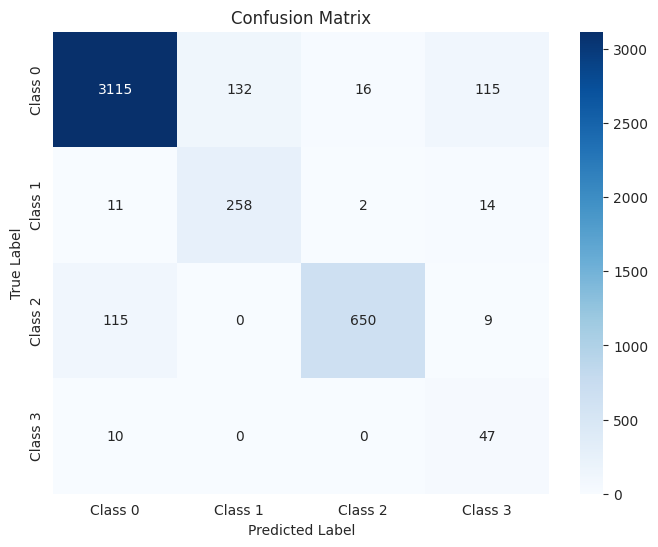

The function took 0.4135 seconds to execute.
[ARCH#117-[4, 4, 4, 2]] early-stop @ epoch 045
[ARCH#117-[4, 4, 4, 2]] done in 29.0s  best-val=1.3794


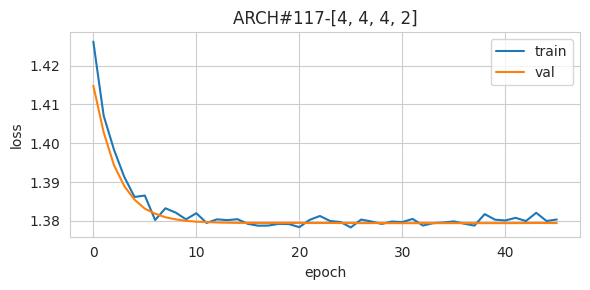


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



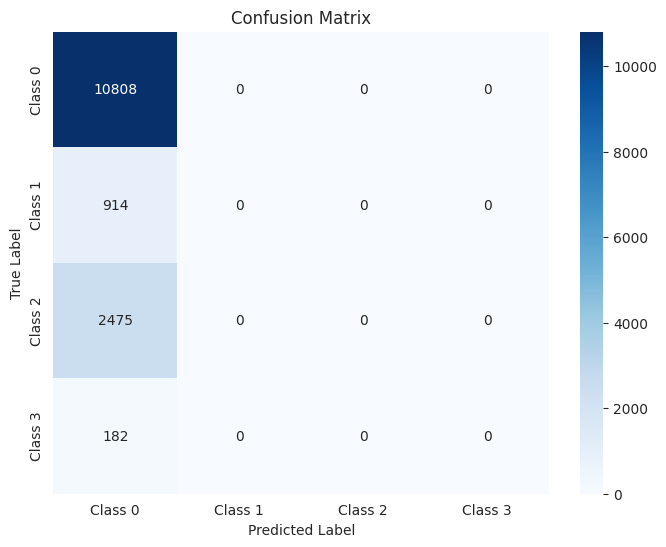

The function took 0.6467 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



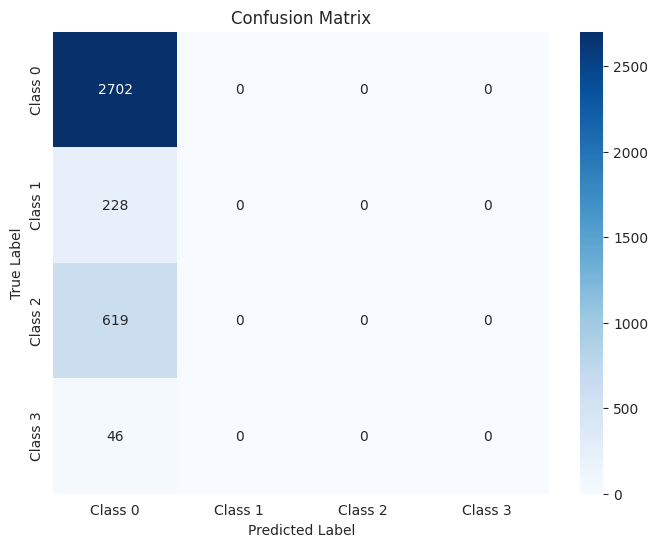

The function took 0.4025 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



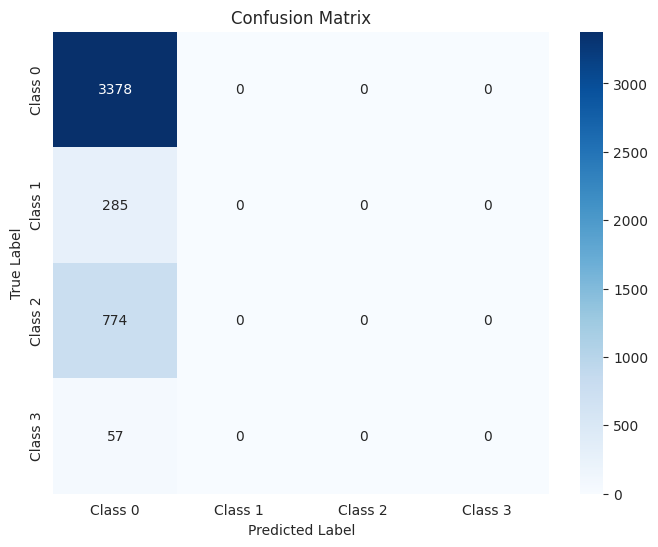

The function took 0.4434 seconds to execute.
[ARCH#118-[4, 4, 2, 2]] done in 32.0s  best-val=0.9183


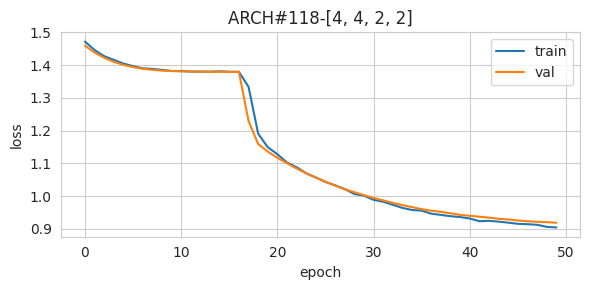


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.88      0.92     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.63      0.87      0.73      2475
     Class 3       0.13      0.76      0.22       182

    accuracy                           0.82     14379
   macro avg       0.43      0.63      0.47     14379
weighted avg       0.83      0.82      0.82     14379



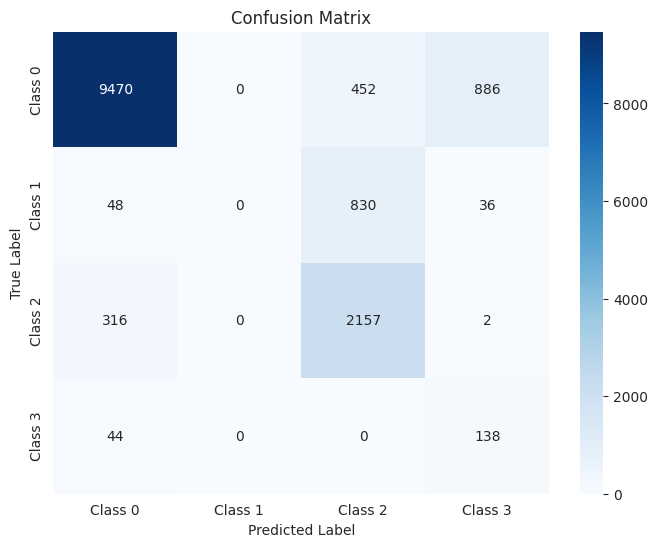

The function took 0.8508 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.88      0.92      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.64      0.89      0.75       619
     Class 3       0.13      0.76      0.22        46

    accuracy                           0.82      3595
   macro avg       0.43      0.63      0.47      3595
weighted avg       0.83      0.82      0.82      3595



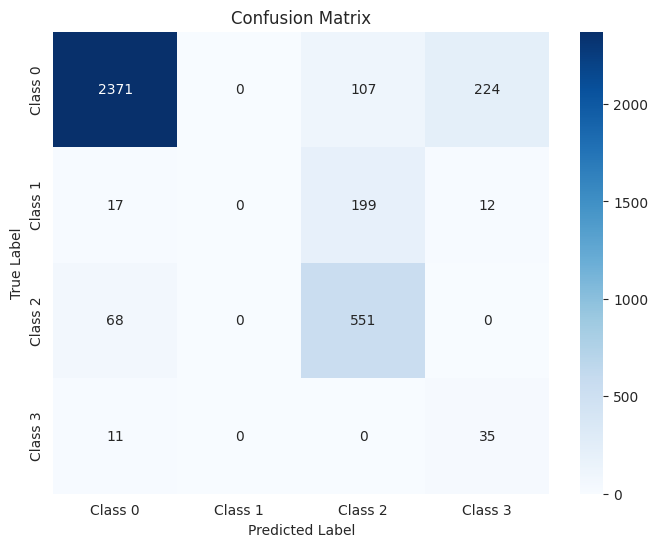

The function took 0.4042 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.87      0.91      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.63      0.85      0.73       774
     Class 3       0.12      0.77      0.21        57

    accuracy                           0.81      4494
   macro avg       0.43      0.62      0.46      4494
weighted avg       0.83      0.81      0.81      4494



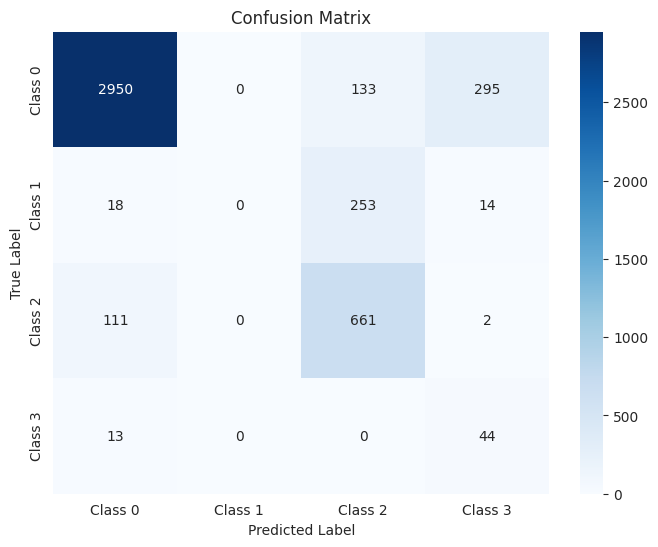

The function took 0.4384 seconds to execute.
[ARCH#119-[4, 2, 2, 2]] done in 31.2s  best-val=0.8476


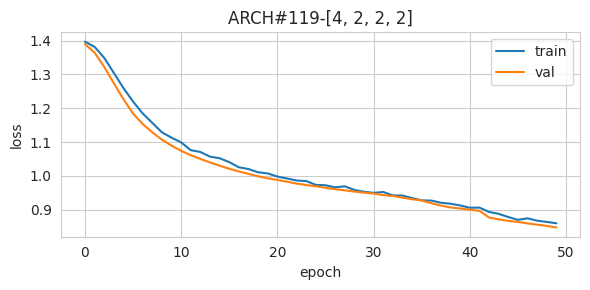


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.86      0.70      0.77     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.54      0.87      0.67      2475
     Class 3       0.10      0.87      0.17       182

    accuracy                           0.69     14379
   macro avg       0.38      0.61      0.40     14379
weighted avg       0.74      0.69      0.70     14379



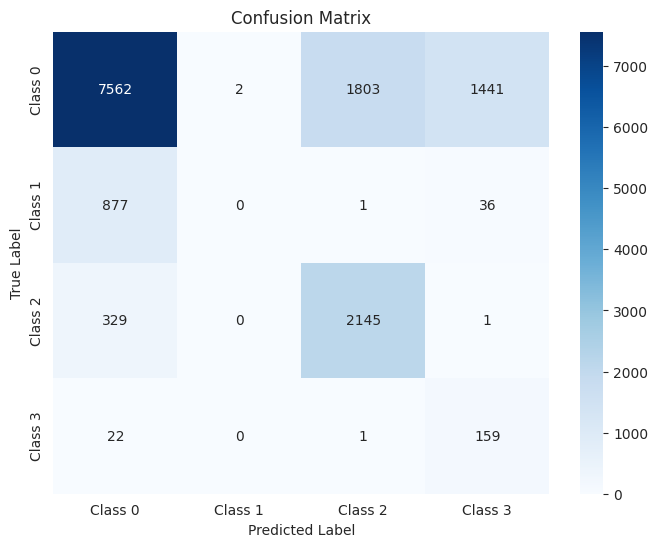

The function took 0.6823 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.87      0.69      0.77      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.55      0.89      0.68       619
     Class 3       0.09      0.87      0.17        46

    accuracy                           0.69      3595
   macro avg       0.38      0.61      0.40      3595
weighted avg       0.75      0.69      0.70      3595



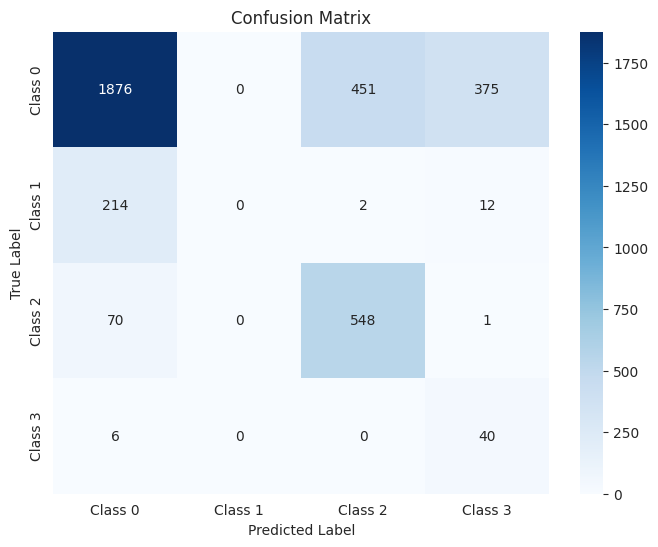

The function took 0.3841 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.86      0.70      0.77      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.53      0.84      0.65       774
     Class 3       0.10      0.88      0.18        57

    accuracy                           0.68      4494
   macro avg       0.37      0.61      0.40      4494
weighted avg       0.74      0.68      0.69      4494



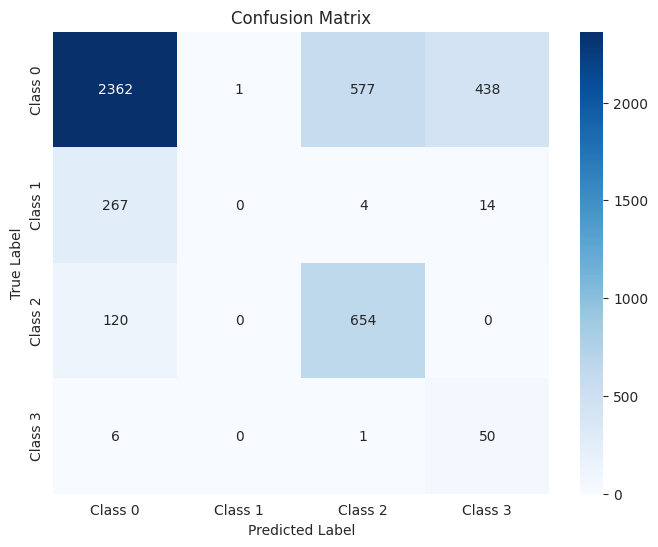

The function took 0.3949 seconds to execute.
[ARCH#120-[2, 2, 2, 2]] early-stop @ epoch 044
[ARCH#120-[2, 2, 2, 2]] done in 28.3s  best-val=1.3794


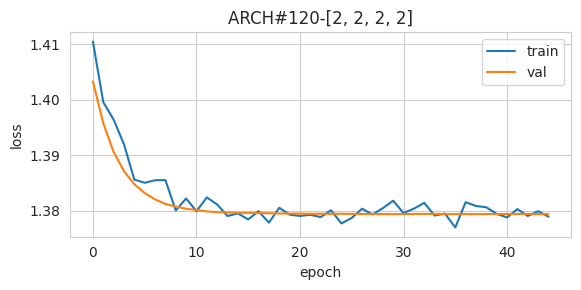


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



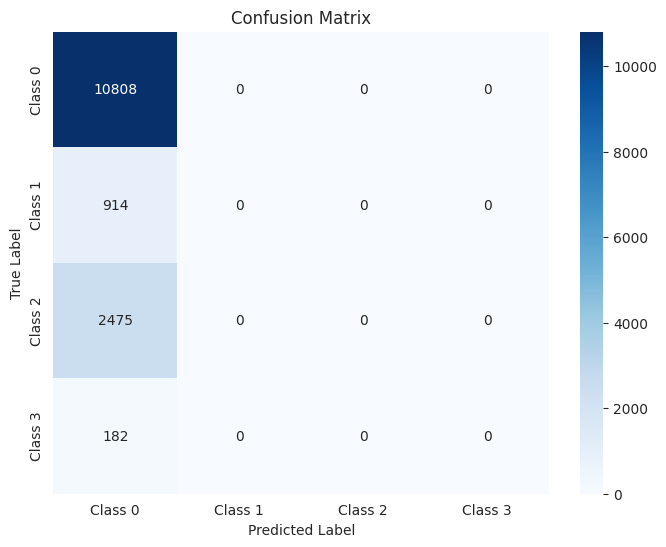

The function took 0.6219 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



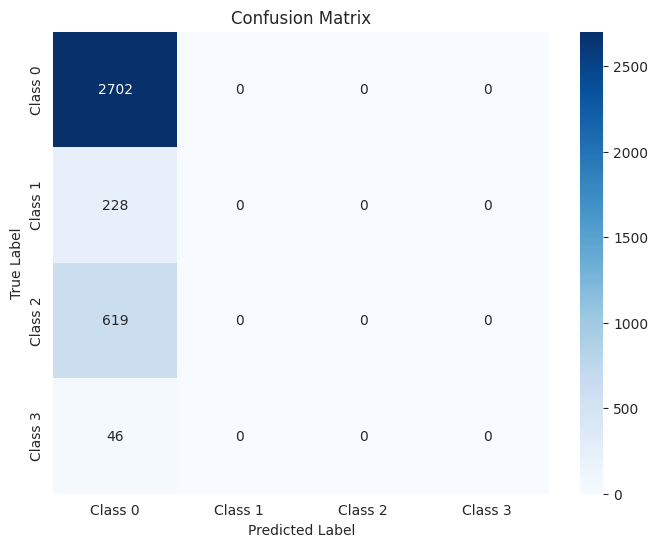

The function took 0.3868 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



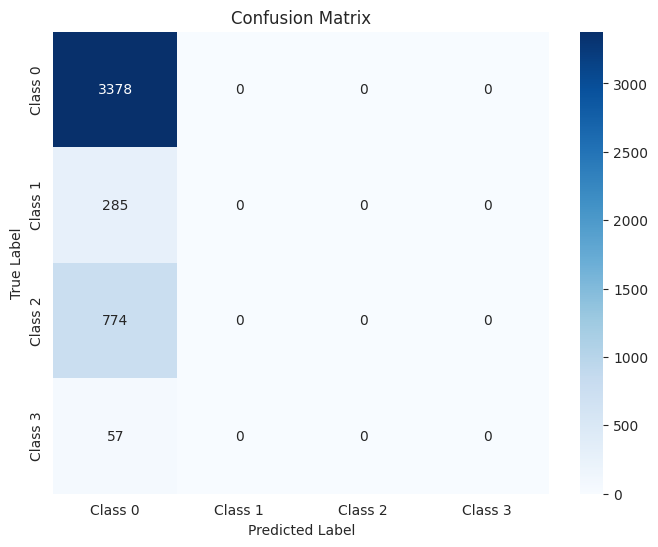

The function took 0.4412 seconds to execute.
[ARCH#121-[32, 32, 32, 32, 32]] done in 34.6s  best-val=0.2006


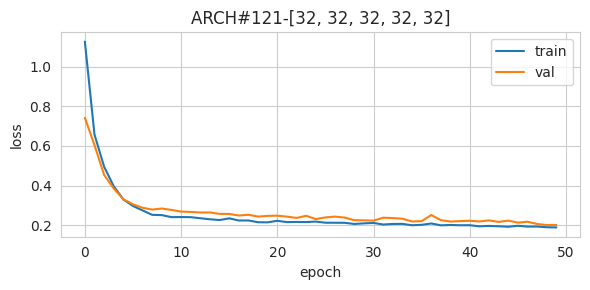


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.78      0.96      0.86       914
     Class 2       0.82      0.97      0.89      2475
     Class 3       0.39      0.88      0.54       182

    accuracy                           0.92     14379
   macro avg       0.75      0.93      0.81     14379
weighted avg       0.94      0.92      0.93     14379



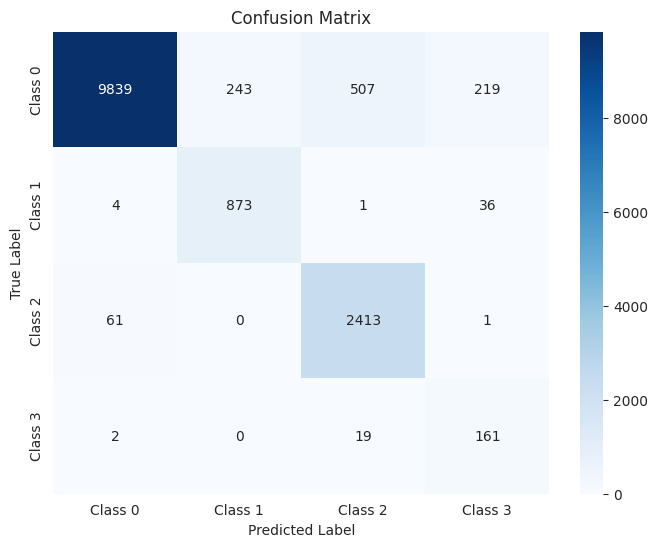

The function took 0.6588 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.80      0.93      0.86       228
     Class 2       0.82      0.97      0.89       619
     Class 3       0.36      0.89      0.52        46

    accuracy                           0.92      3595
   macro avg       0.74      0.93      0.80      3595
weighted avg       0.94      0.92      0.93      3595



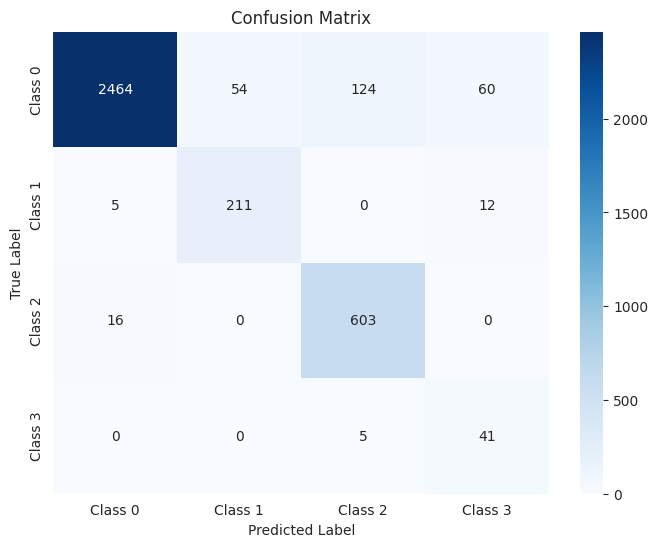

The function took 0.3639 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      3378
     Class 1       0.78      0.93      0.85       285
     Class 2       0.83      0.97      0.89       774
     Class 3       0.40      0.88      0.55        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.81      4494
weighted avg       0.94      0.93      0.93      4494



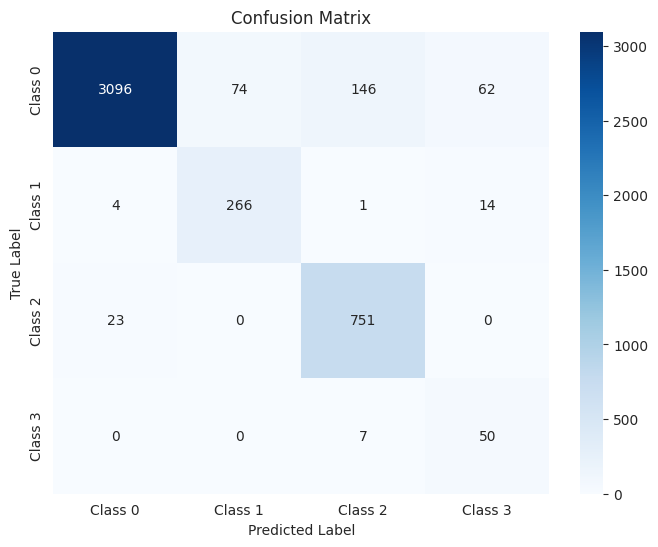

The function took 0.4219 seconds to execute.
[ARCH#122-[32, 32, 32, 32, 16]] done in 34.4s  best-val=0.1937


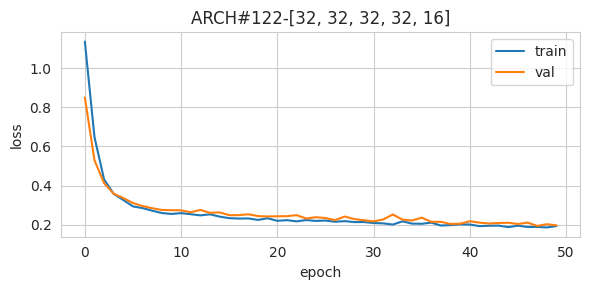


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.78      0.96      0.86       914
     Class 2       0.85      0.95      0.90      2475
     Class 3       0.37      0.88      0.53       182

    accuracy                           0.93     14379
   macro avg       0.75      0.93      0.81     14379
weighted avg       0.94      0.93      0.93     14379



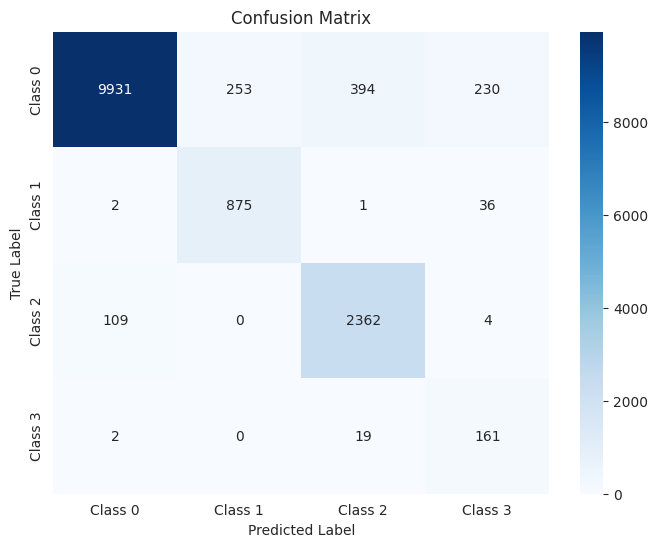

The function took 0.6523 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.85      0.97      0.91       619
     Class 3       0.36      0.89      0.51        46

    accuracy                           0.93      3595
   macro avg       0.75      0.93      0.81      3595
weighted avg       0.95      0.93      0.93      3595



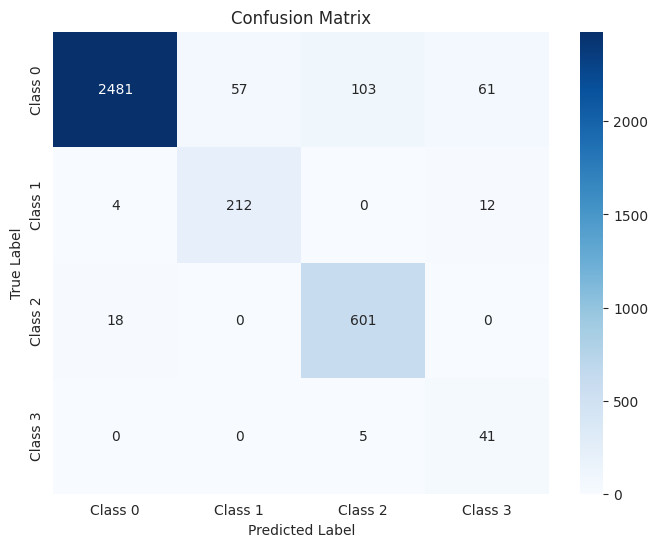

The function took 0.3830 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.78      0.93      0.85       285
     Class 2       0.86      0.94      0.90       774
     Class 3       0.39      0.89      0.54        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.81      4494
weighted avg       0.94      0.93      0.93      4494



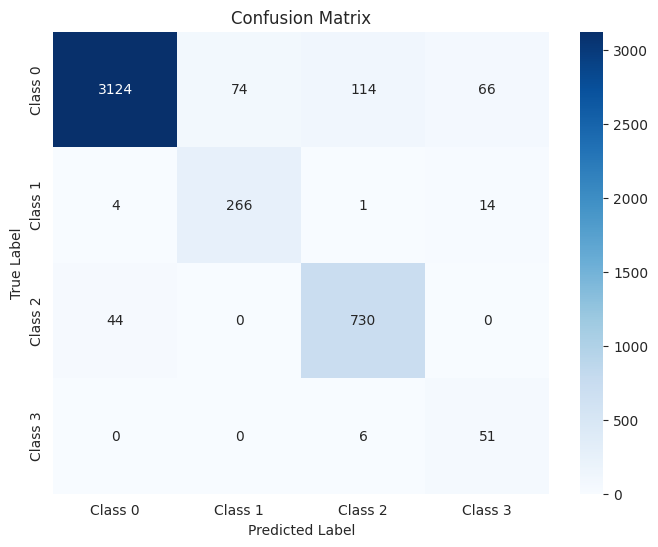

The function took 0.4080 seconds to execute.
[ARCH#123-[32, 32, 32, 32, 8]] early-stop @ epoch 047
[ARCH#123-[32, 32, 32, 32, 8]] done in 32.5s  best-val=0.2311


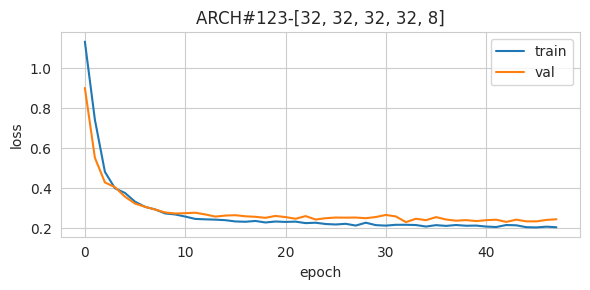


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.88      0.91      0.89      2475
     Class 3       0.34      0.88      0.49       182

    accuracy                           0.92     14379
   macro avg       0.74      0.92      0.80     14379
weighted avg       0.94      0.92      0.93     14379



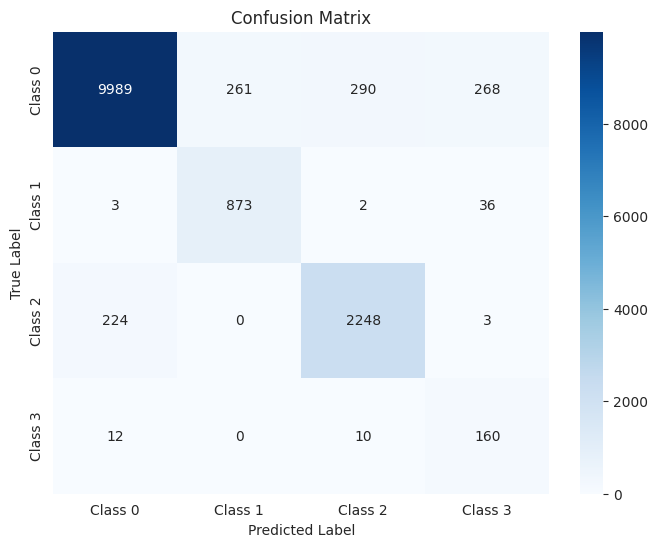

The function took 0.6568 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.87      0.92      0.89       619
     Class 3       0.33      0.89      0.49        46

    accuracy                           0.92      3595
   macro avg       0.74      0.91      0.79      3595
weighted avg       0.94      0.92      0.93      3595



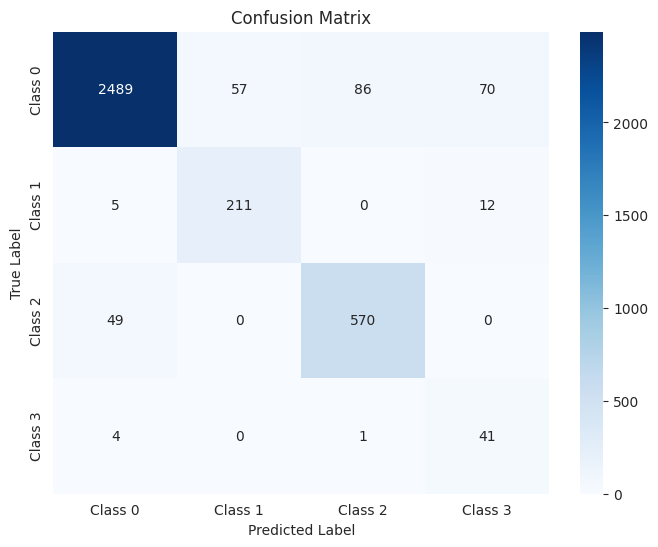

The function took 0.3715 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95      3378
     Class 1       0.77      0.93      0.85       285
     Class 2       0.88      0.88      0.88       774
     Class 3       0.34      0.88      0.49        57

    accuracy                           0.92      4494
   macro avg       0.74      0.90      0.79      4494
weighted avg       0.93      0.92      0.92      4494



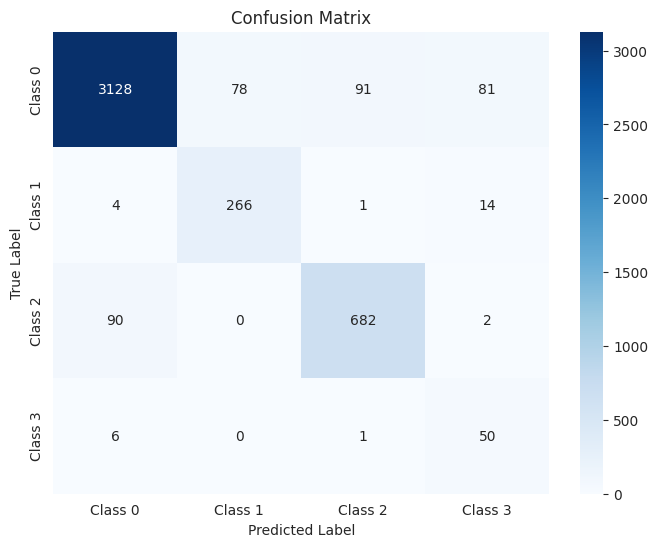

The function took 0.4369 seconds to execute.
[ARCH#124-[32, 32, 32, 32, 4]] done in 34.5s  best-val=0.2285


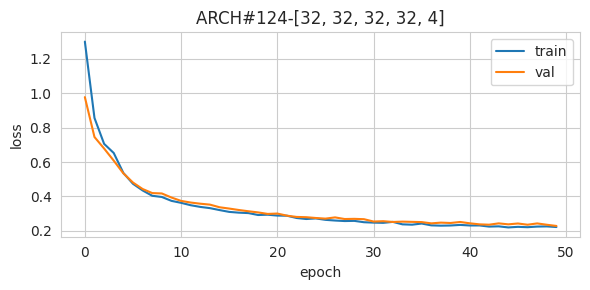


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       1.00      0.87      0.93      2475
     Class 3       0.18      0.99      0.30       182

    accuracy                           0.91     14379
   macro avg       0.73      0.93      0.76     14379
weighted avg       0.96      0.91      0.93     14379



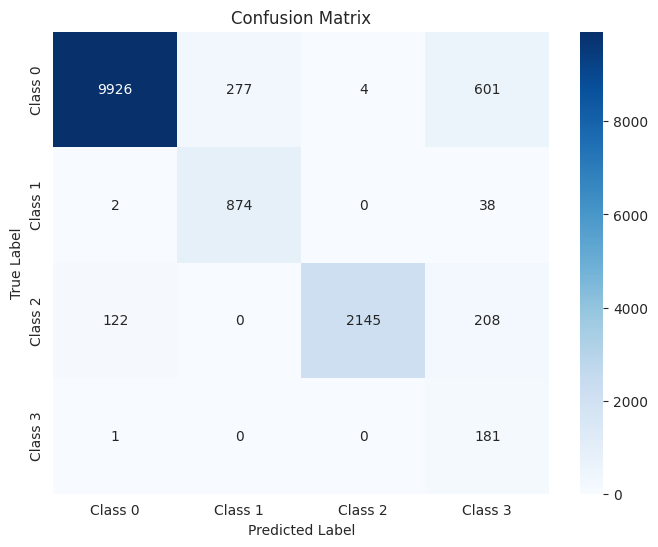

The function took 0.6434 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.96      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       1.00      0.88      0.94       619
     Class 3       0.17      0.98      0.29        46

    accuracy                           0.92      3595
   macro avg       0.74      0.93      0.76      3595
weighted avg       0.97      0.92      0.94      3595



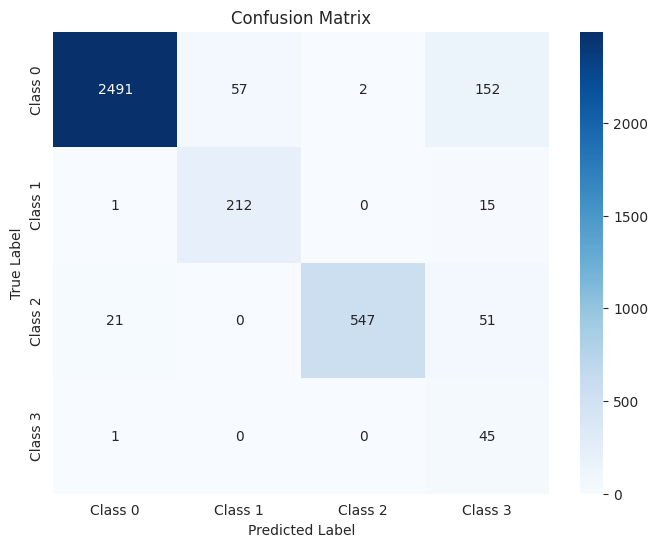

The function took 0.7479 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.99      0.84      0.91       774
     Class 3       0.16      0.95      0.28        57

    accuracy                           0.91      4494
   macro avg       0.73      0.91      0.75      4494
weighted avg       0.96      0.91      0.93      4494



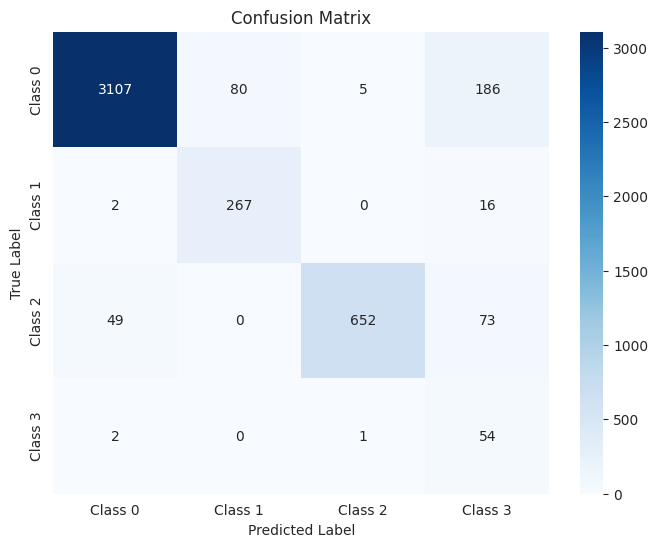

The function took 0.4098 seconds to execute.
[ARCH#125-[32, 32, 32, 32, 2]] done in 34.4s  best-val=0.2493


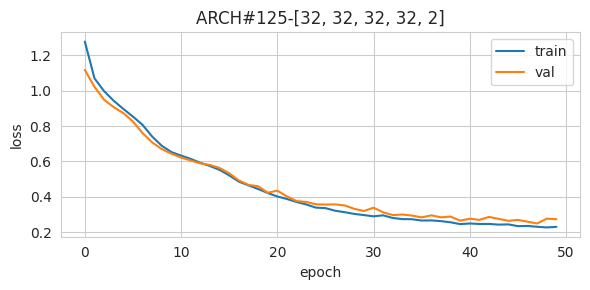


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.37      0.88      0.52       182

    accuracy                           0.94     14379
   macro avg       0.77      0.92      0.81     14379
weighted avg       0.95      0.94      0.94     14379



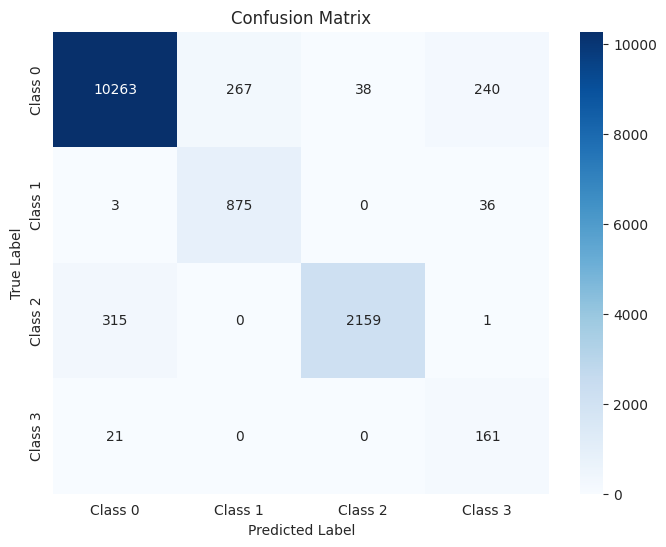

The function took 0.6707 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.34      0.87      0.49        46

    accuracy                           0.94      3595
   macro avg       0.77      0.91      0.81      3595
weighted avg       0.95      0.94      0.94      3595



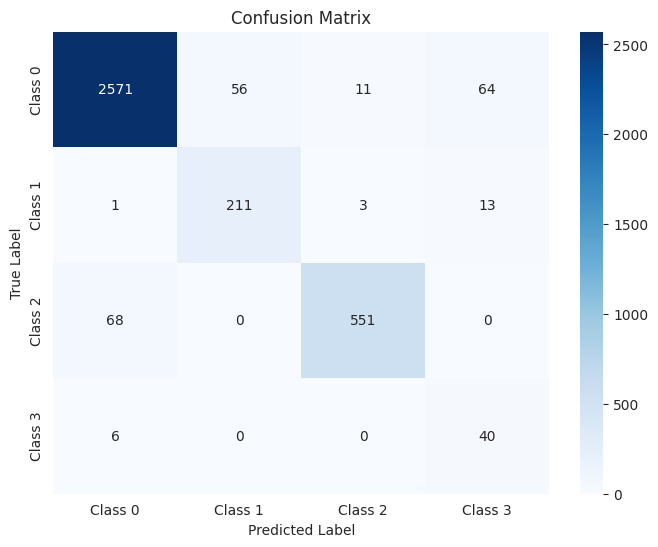

The function took 0.3846 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.95      0.96      3378
     Class 1       0.76      0.93      0.84       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.36      0.82      0.50        57

    accuracy                           0.93      4494
   macro avg       0.76      0.89      0.80      4494
weighted avg       0.94      0.93      0.93      4494



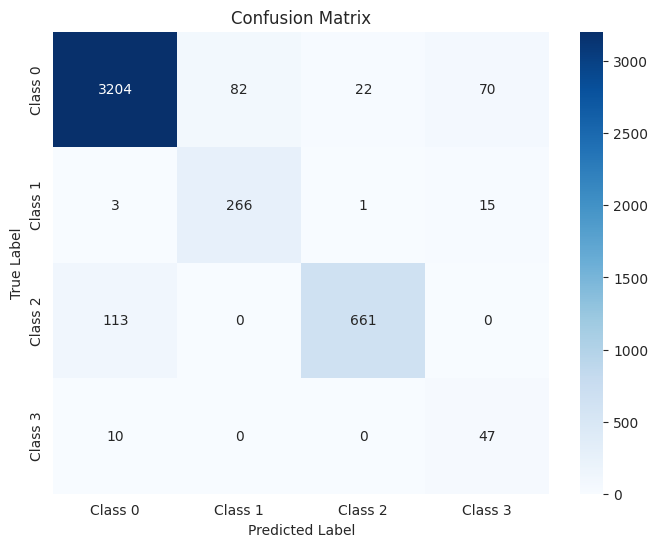

The function took 0.4054 seconds to execute.
[ARCH#126-[32, 32, 32, 16, 16]] done in 33.8s  best-val=0.2118


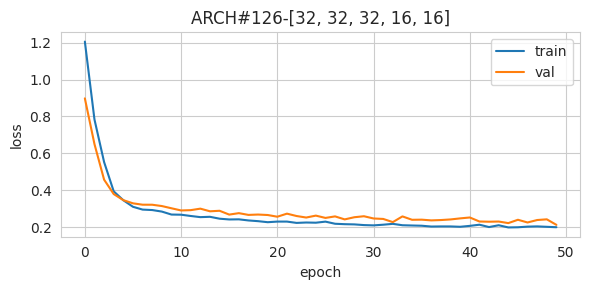


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.76      0.96      0.84       914
     Class 2       0.89      0.95      0.92      2475
     Class 3       0.39      0.88      0.54       182

    accuracy                           0.93     14379
   macro avg       0.76      0.93      0.82     14379
weighted avg       0.95      0.93      0.94     14379



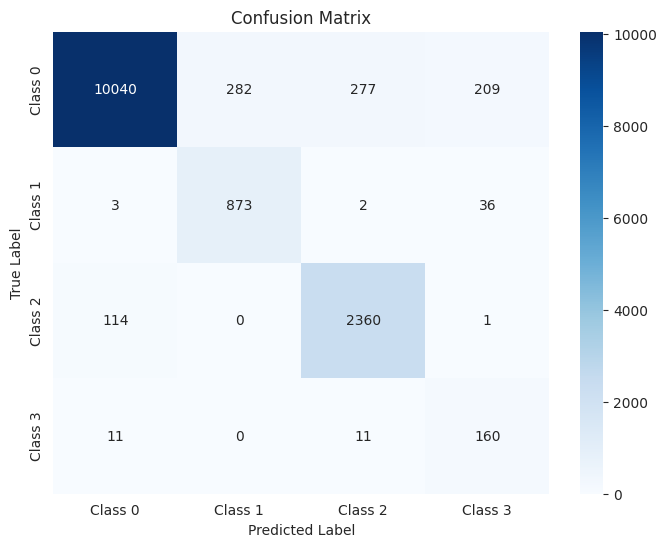

The function took 0.7370 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.88      0.96      0.92       619
     Class 3       0.37      0.89      0.53        46

    accuracy                           0.93      3595
   macro avg       0.75      0.93      0.81      3595
weighted avg       0.95      0.93      0.94      3595



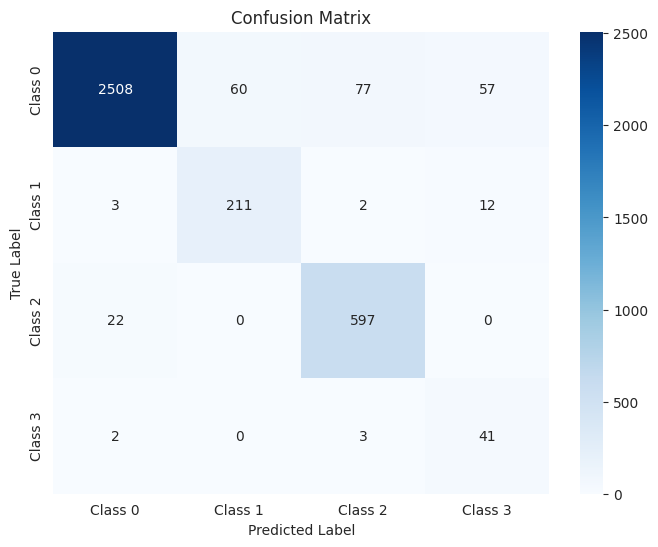

The function took 0.4330 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.88      0.94      0.91       774
     Class 3       0.39      0.84      0.53        57

    accuracy                           0.93      4494
   macro avg       0.76      0.91      0.81      4494
weighted avg       0.94      0.93      0.93      4494



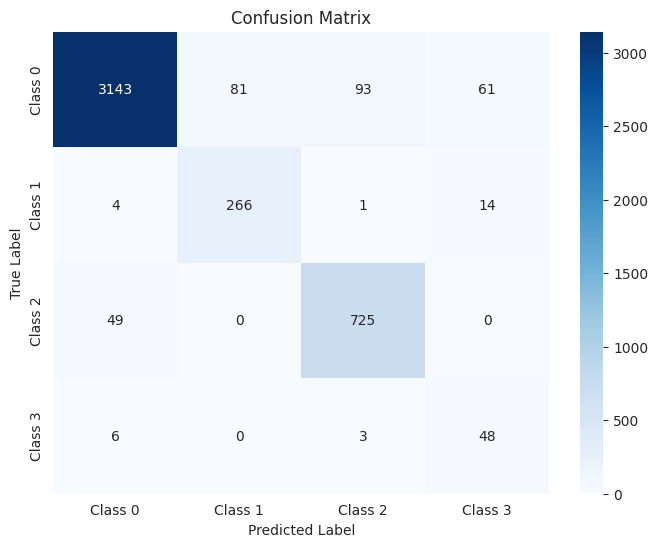

The function took 0.5396 seconds to execute.
[ARCH#127-[32, 32, 32, 16, 8]] done in 34.9s  best-val=0.2122


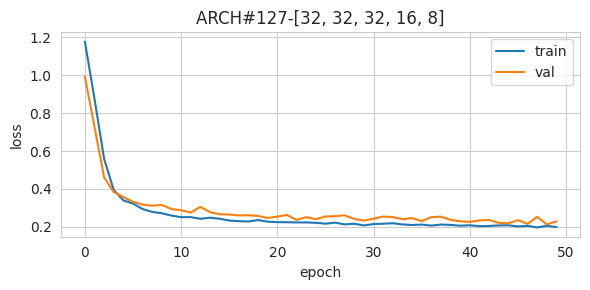


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.94      0.92      0.93      2475
     Class 3       0.35      0.88      0.51       182

    accuracy                           0.93     14379
   macro avg       0.75      0.92      0.81     14379
weighted avg       0.95      0.93      0.94     14379



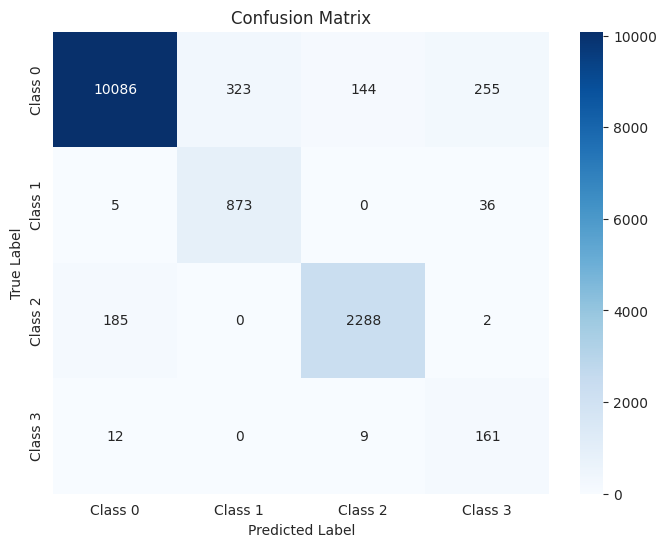

The function took 0.6621 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96      2702
     Class 1       0.76      0.93      0.84       228
     Class 2       0.94      0.95      0.94       619
     Class 3       0.34      0.89      0.49        46

    accuracy                           0.94      3595
   macro avg       0.75      0.93      0.81      3595
weighted avg       0.95      0.94      0.94      3595



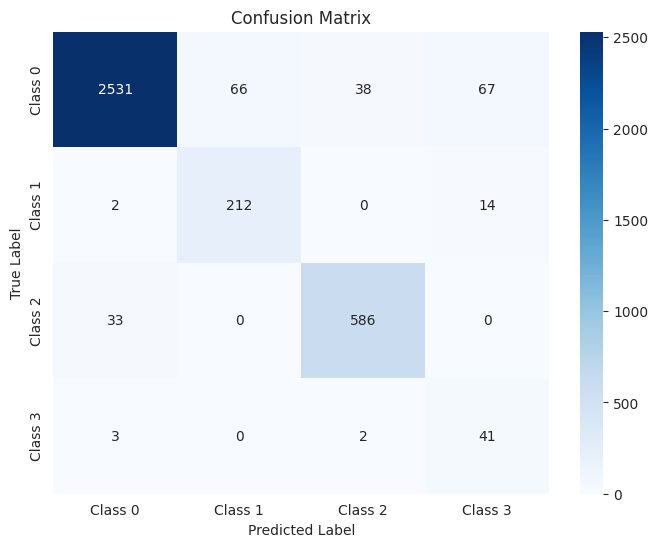

The function took 0.3790 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.74      0.93      0.82       285
     Class 2       0.93      0.92      0.93       774
     Class 3       0.35      0.88      0.51        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.80      4494
weighted avg       0.95      0.93      0.94      4494



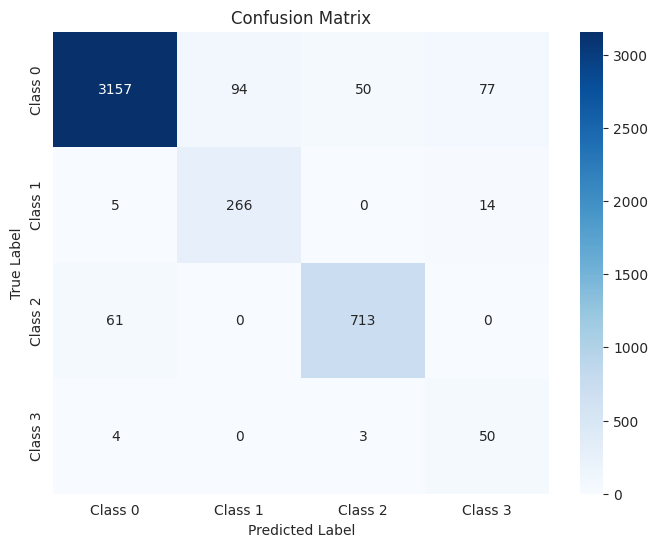

The function took 0.4271 seconds to execute.
[ARCH#128-[32, 32, 32, 16, 4]] done in 34.4s  best-val=0.2393


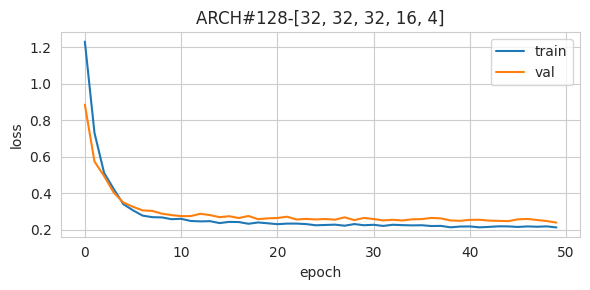


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.78      0.96      0.86       914
     Class 2       0.83      0.98      0.90      2475
     Class 3       0.36      0.88      0.52       182

    accuracy                           0.92     14379
   macro avg       0.74      0.93      0.81     14379
weighted avg       0.94      0.92      0.93     14379



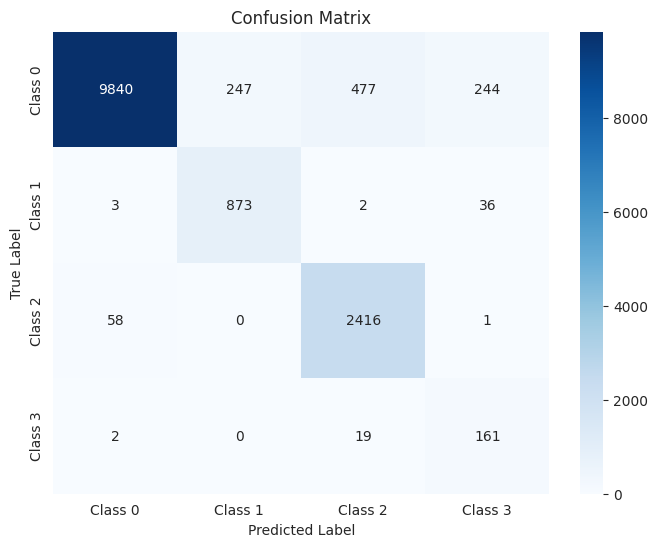

The function took 0.6453 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.79      0.93      0.86       228
     Class 2       0.84      0.97      0.90       619
     Class 3       0.35      0.89      0.50        46

    accuracy                           0.92      3595
   macro avg       0.74      0.93      0.80      3595
weighted avg       0.94      0.92      0.93      3595



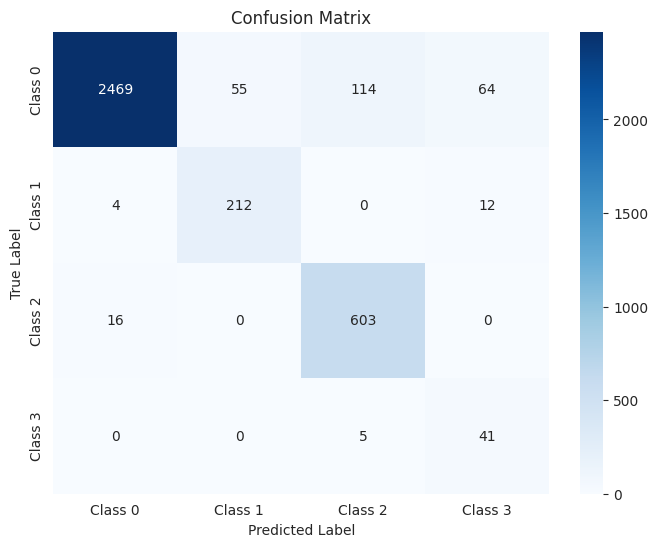

The function took 0.3974 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      3378
     Class 1       0.78      0.93      0.85       285
     Class 2       0.82      0.97      0.89       774
     Class 3       0.37      0.88      0.52        57

    accuracy                           0.92      4494
   macro avg       0.74      0.92      0.80      4494
weighted avg       0.94      0.92      0.93      4494



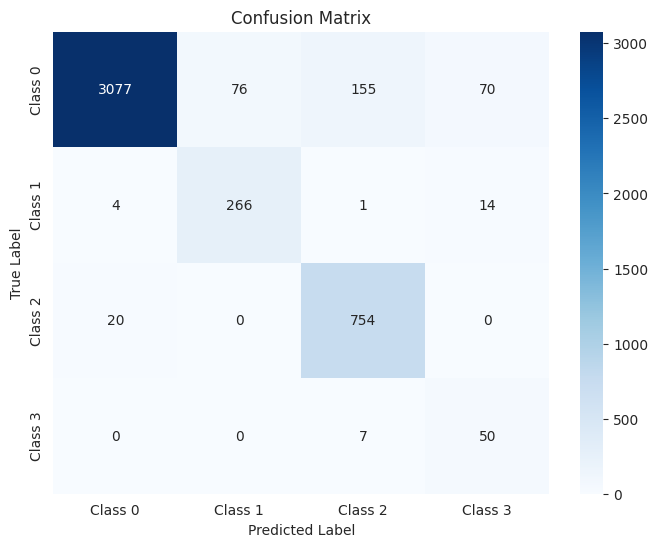

The function took 0.4151 seconds to execute.
[ARCH#129-[32, 32, 32, 16, 2]] early-stop @ epoch 036
[ARCH#129-[32, 32, 32, 16, 2]] done in 25.6s  best-val=1.3794


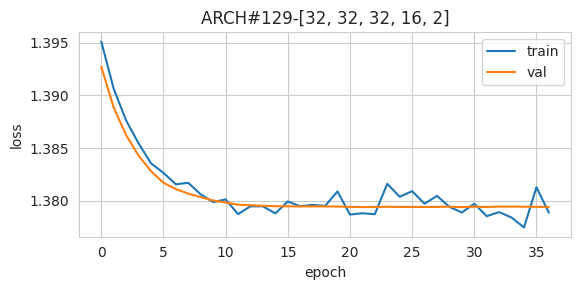


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



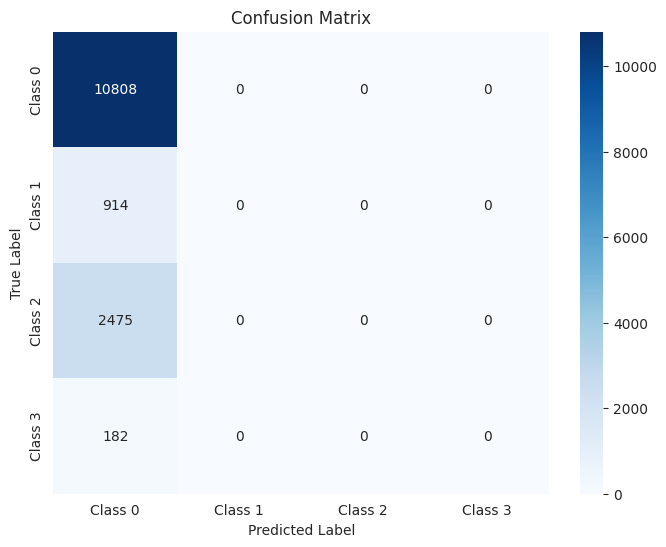

The function took 0.6720 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



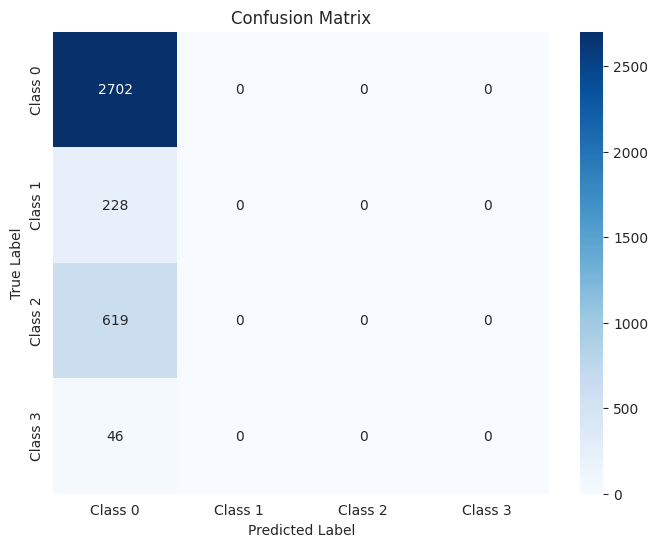

The function took 0.3978 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



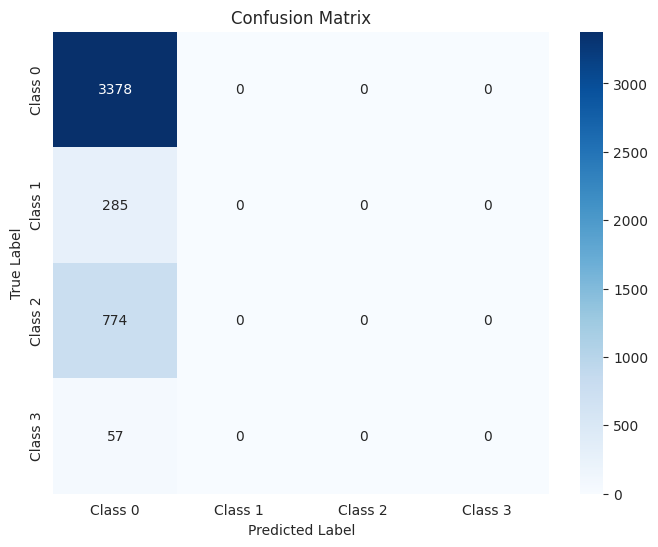

The function took 0.4099 seconds to execute.
[ARCH#130-[32, 32, 32, 8, 8]] done in 33.6s  best-val=0.2293


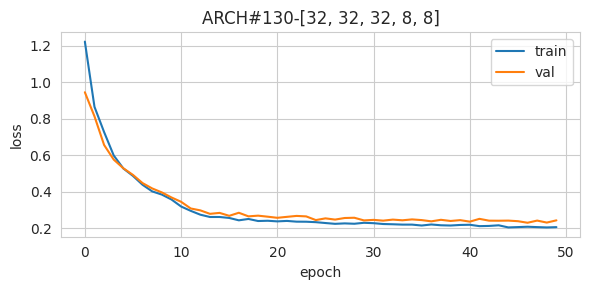


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.89      0.88      0.89      2475
     Class 3       0.23      0.93      0.37       182

    accuracy                           0.91     14379
   macro avg       0.72      0.92      0.76     14379
weighted avg       0.95      0.91      0.93     14379



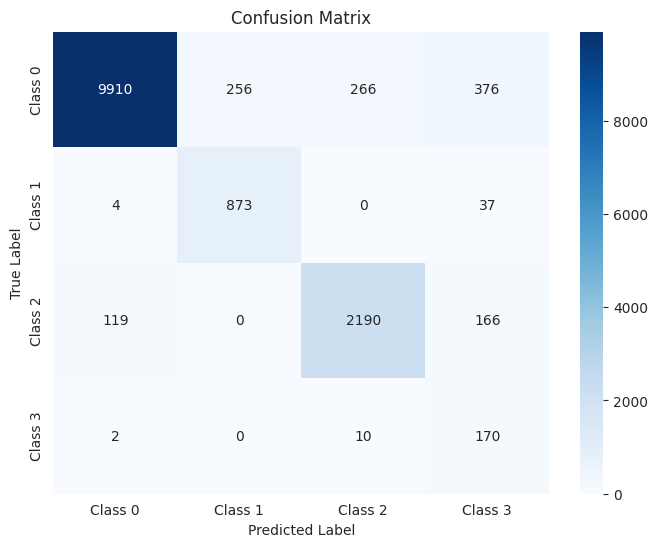

The function took 0.8292 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.79      0.93      0.86       228
     Class 2       0.89      0.89      0.89       619
     Class 3       0.21      0.93      0.35        46

    accuracy                           0.91      3595
   macro avg       0.72      0.92      0.76      3595
weighted avg       0.95      0.91      0.93      3595



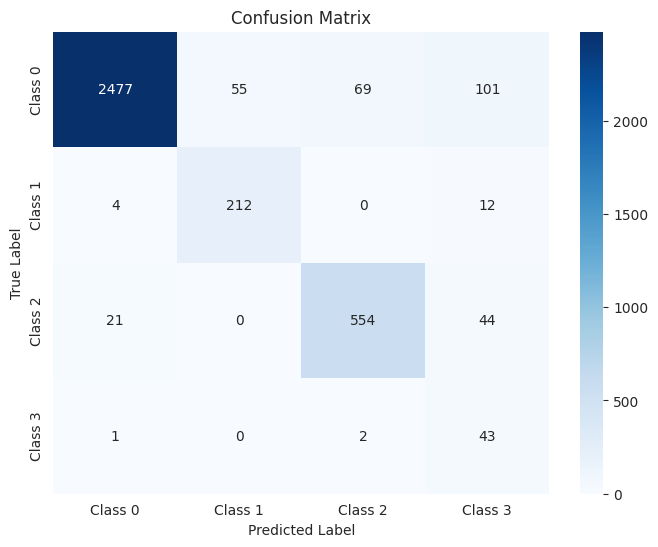

The function took 0.4921 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.78      0.94      0.85       285
     Class 2       0.89      0.87      0.88       774
     Class 3       0.23      0.89      0.36        57

    accuracy                           0.91      4494
   macro avg       0.72      0.91      0.76      4494
weighted avg       0.94      0.91      0.93      4494



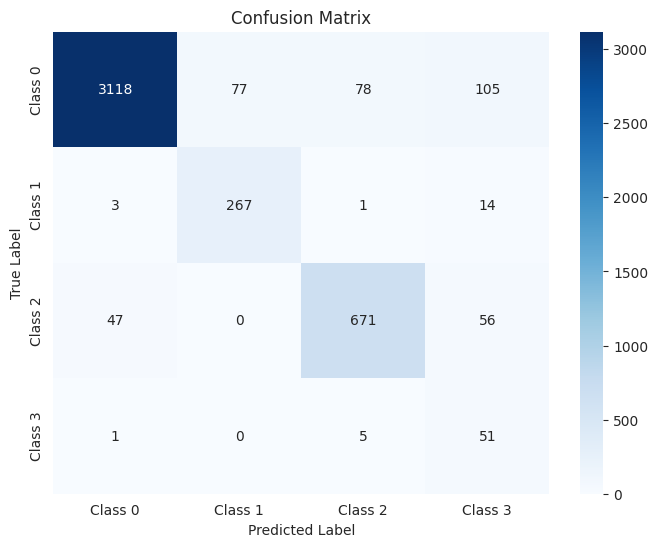

The function took 0.4777 seconds to execute.
[ARCH#131-[32, 32, 32, 8, 4]] done in 34.3s  best-val=0.2658


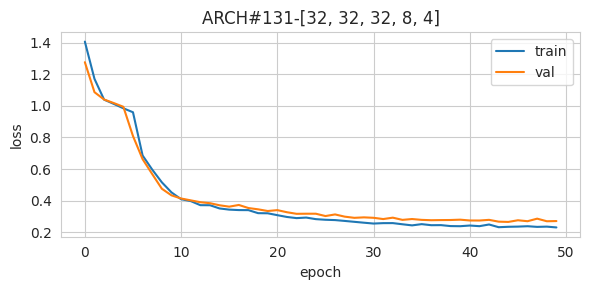


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.77      0.95      0.85       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.20      0.99      0.33       182

    accuracy                           0.92     14379
   macro avg       0.74      0.93      0.77     14379
weighted avg       0.96      0.92      0.94     14379



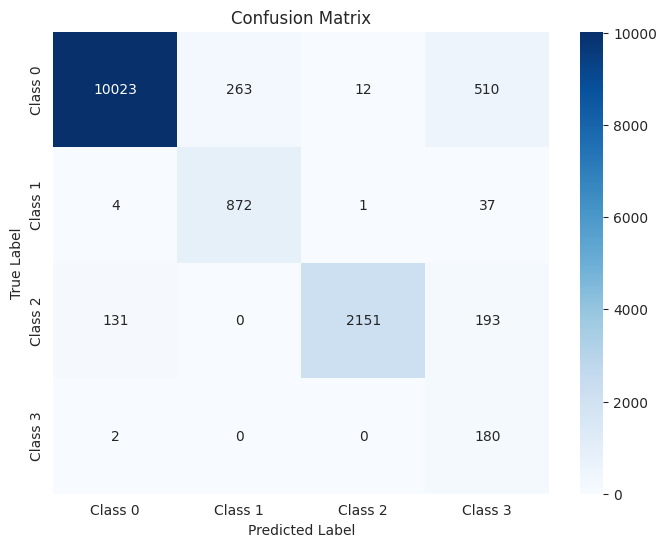

The function took 0.6830 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.19      0.98      0.32        46

    accuracy                           0.92      3595
   macro avg       0.74      0.93      0.76      3595
weighted avg       0.96      0.92      0.94      3595



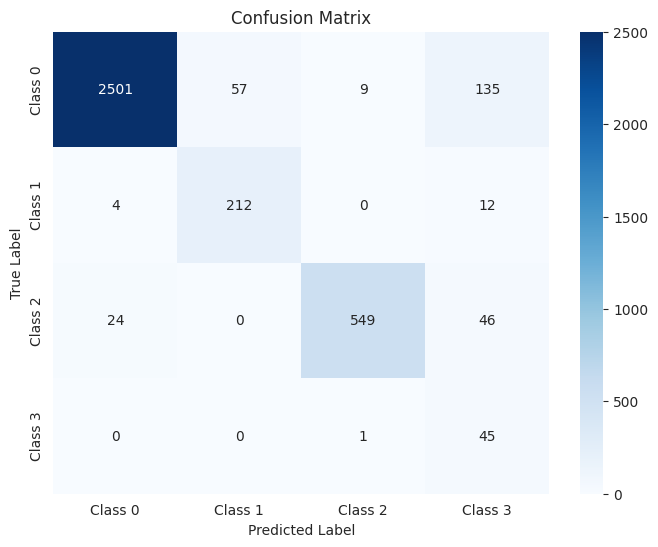

The function took 0.3878 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.20      0.96      0.33        57

    accuracy                           0.92      4494
   macro avg       0.73      0.92      0.76      4494
weighted avg       0.96      0.92      0.93      4494



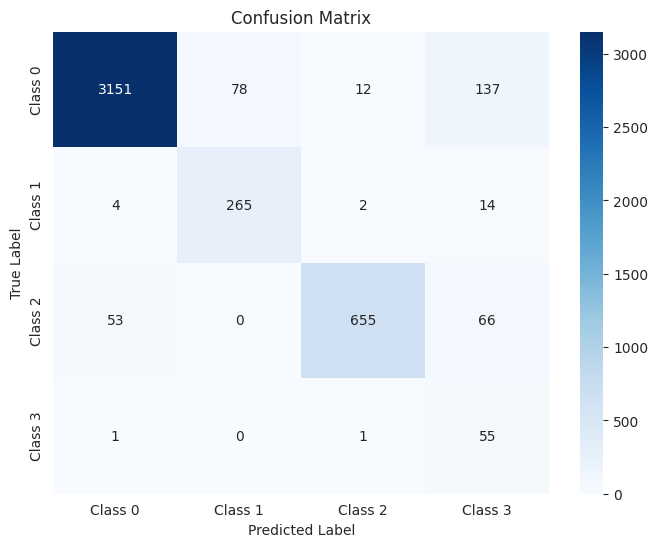

The function took 0.4206 seconds to execute.
[ARCH#132-[32, 32, 32, 8, 2]] done in 34.3s  best-val=1.3794


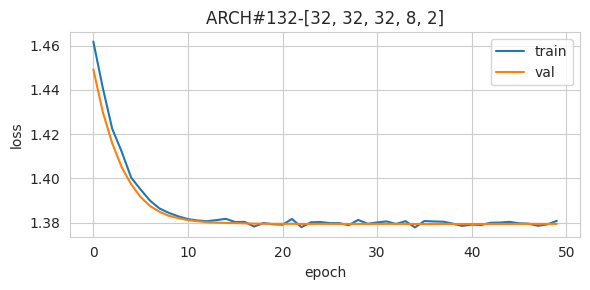


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



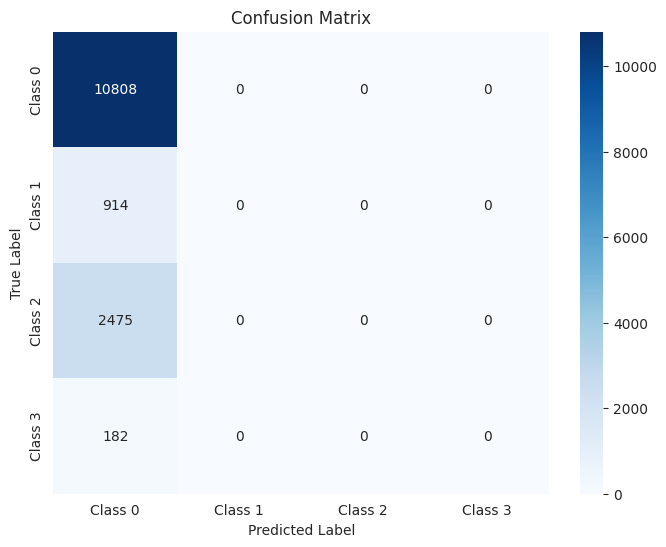

The function took 0.6785 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



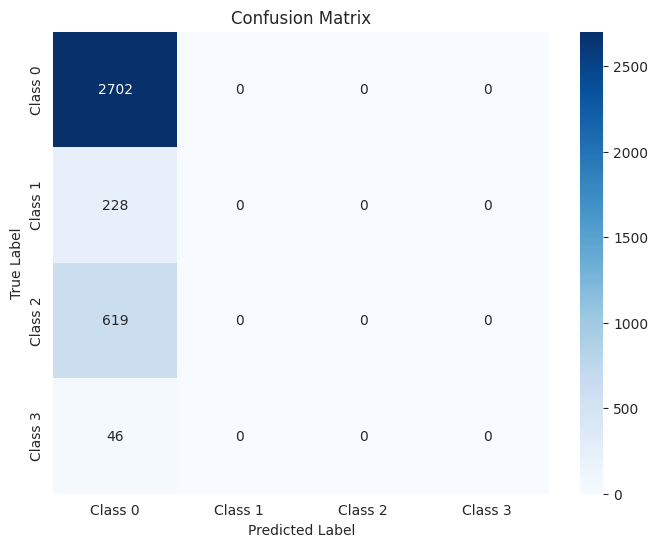

The function took 0.8015 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



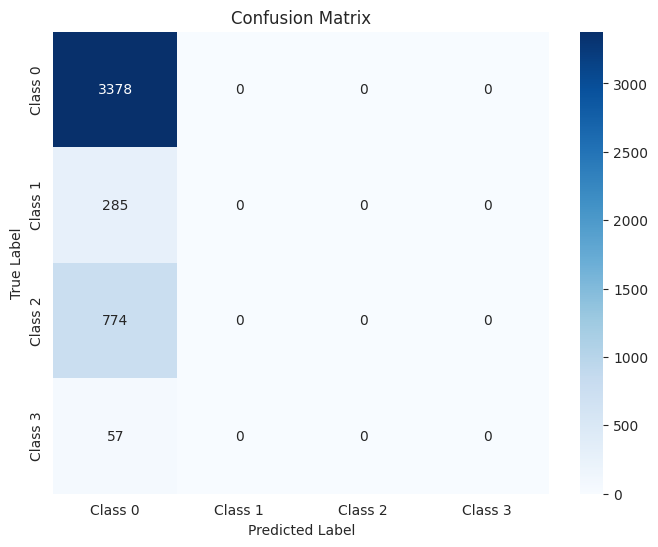

The function took 0.4075 seconds to execute.
[ARCH#133-[32, 32, 32, 4, 4]] done in 33.9s  best-val=0.3041


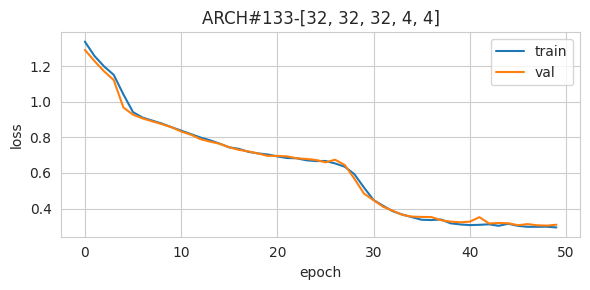


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.91     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.09      0.99      0.16       182

    accuracy                           0.84     14379
   macro avg       0.71      0.91      0.71     14379
weighted avg       0.97      0.84      0.90     14379



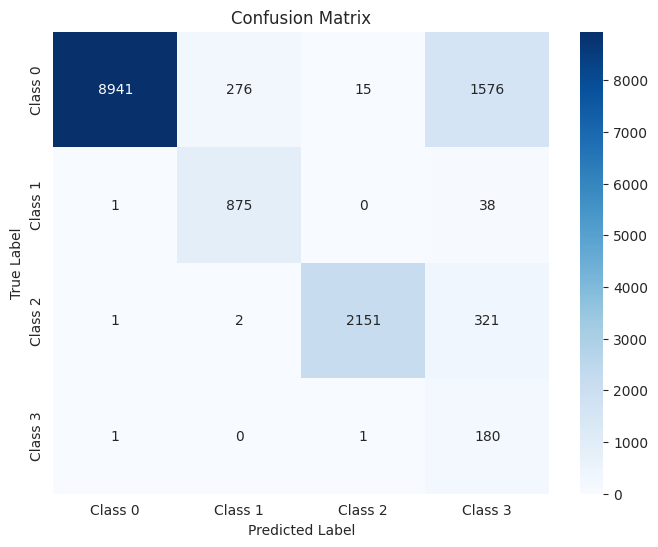

The function took 0.8101 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.91      2702
     Class 1       0.78      0.94      0.85       228
     Class 2       1.00      0.89      0.94       619
     Class 3       0.09      0.98      0.16        46

    accuracy                           0.85      3595
   macro avg       0.72      0.91      0.71      3595
weighted avg       0.97      0.85      0.90      3595



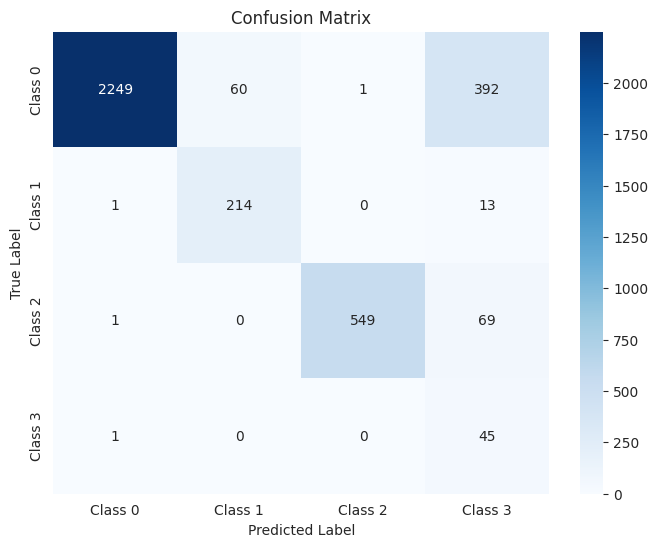

The function took 0.4026 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.91      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.08      0.96      0.15        57

    accuracy                           0.84      4494
   macro avg       0.71      0.89      0.70      4494
weighted avg       0.97      0.84      0.89      4494



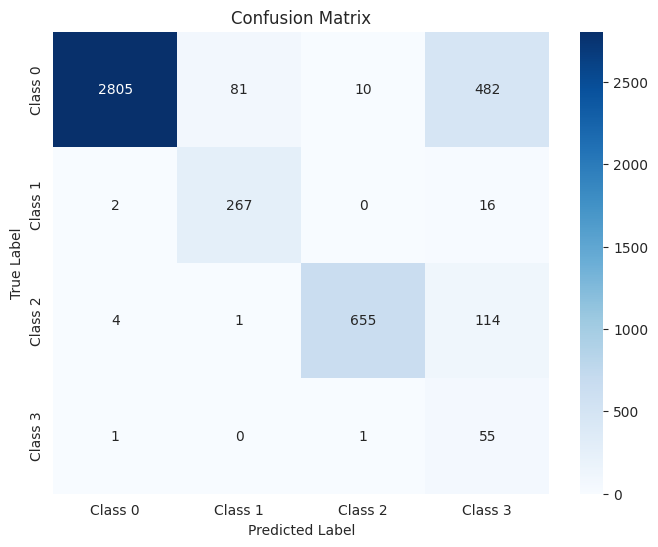

The function took 0.4188 seconds to execute.
[ARCH#134-[32, 32, 32, 4, 2]] done in 34.5s  best-val=0.6946


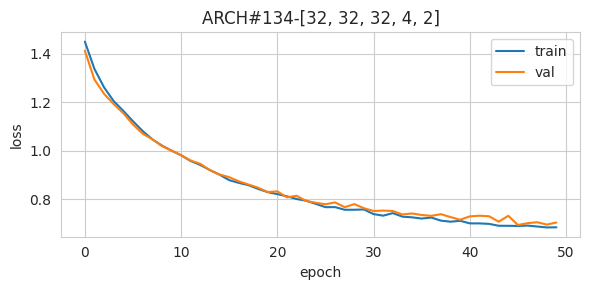


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.91     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.64      0.88      0.74      2475
     Class 3       0.09      0.98      0.16       182

    accuracy                           0.79     14379
   macro avg       0.43      0.67      0.45     14379
weighted avg       0.86      0.79      0.81     14379



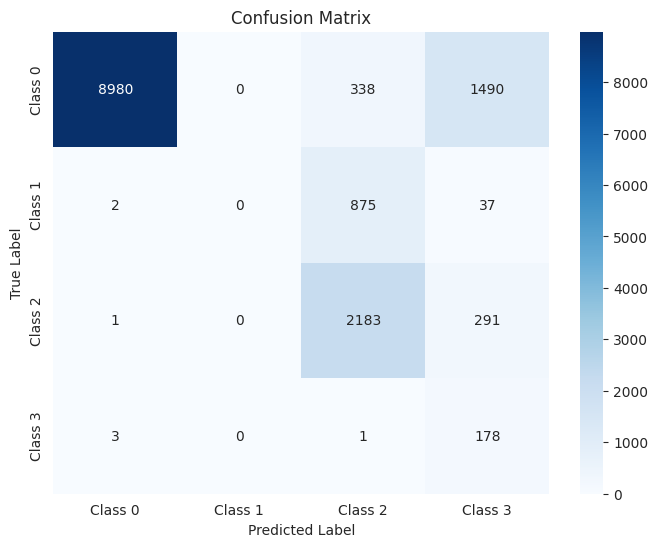

The function took 0.6842 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.84      0.91      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.66      0.90      0.76       619
     Class 3       0.09      0.98      0.17        46

    accuracy                           0.80      3595
   macro avg       0.44      0.68      0.46      3595
weighted avg       0.87      0.80      0.82      3595



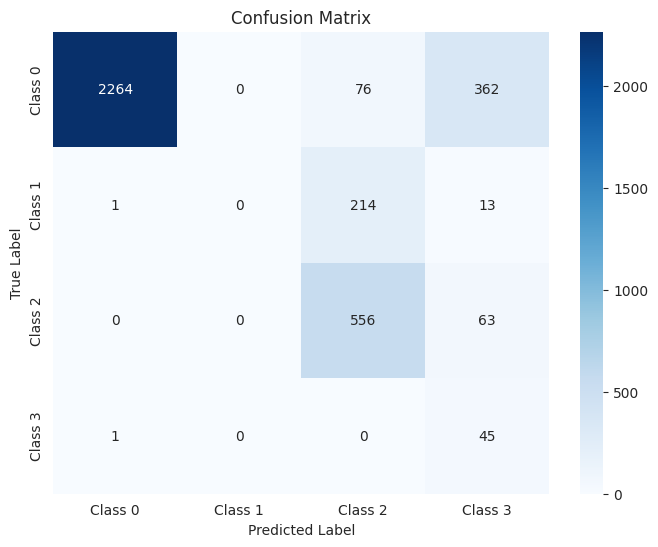

The function took 0.4257 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.91      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.64      0.86      0.73       774
     Class 3       0.09      0.96      0.16        57

    accuracy                           0.79      4494
   macro avg       0.43      0.67      0.45      4494
weighted avg       0.86      0.79      0.81      4494



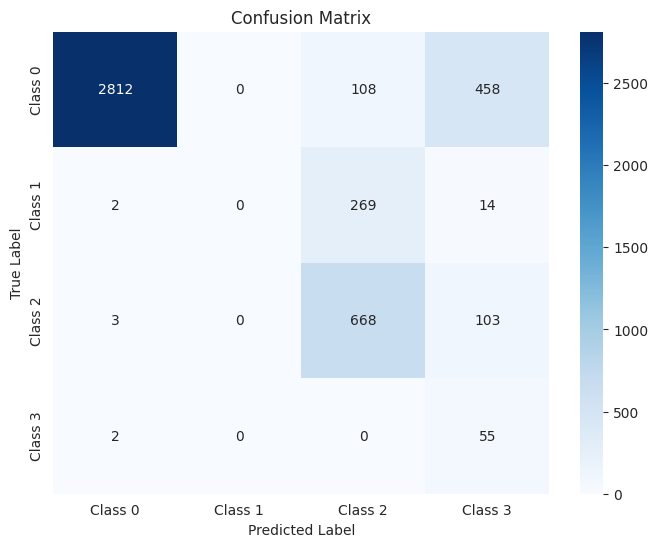

The function took 0.4104 seconds to execute.
[ARCH#135-[32, 32, 32, 2, 2]] done in 34.7s  best-val=0.2708


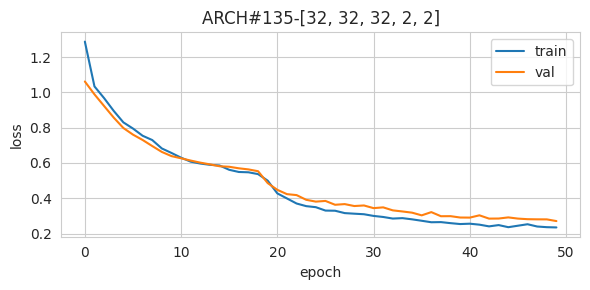


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96     10808
     Class 1       0.74      0.96      0.84       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.28      0.95      0.43       182

    accuracy                           0.93     14379
   macro avg       0.75      0.93      0.79     14379
weighted avg       0.95      0.93      0.94     14379



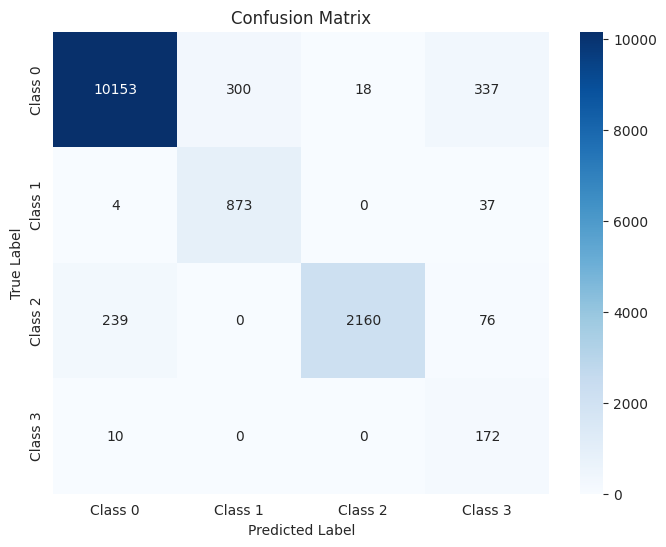

The function took 0.6746 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.26      0.89      0.40        46

    accuracy                           0.93      3595
   macro avg       0.75      0.91      0.78      3595
weighted avg       0.96      0.93      0.94      3595



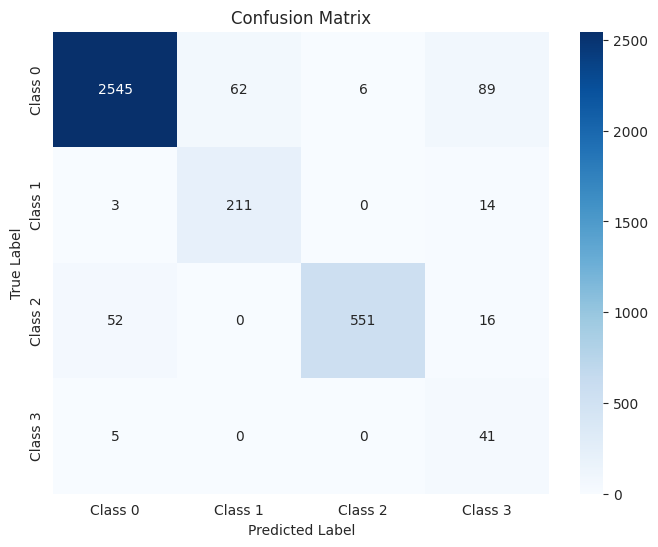

The function took 0.3865 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95      3378
     Class 1       0.75      0.94      0.83       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.26      0.86      0.40        57

    accuracy                           0.92      4494
   macro avg       0.74      0.90      0.77      4494
weighted avg       0.95      0.92      0.93      4494



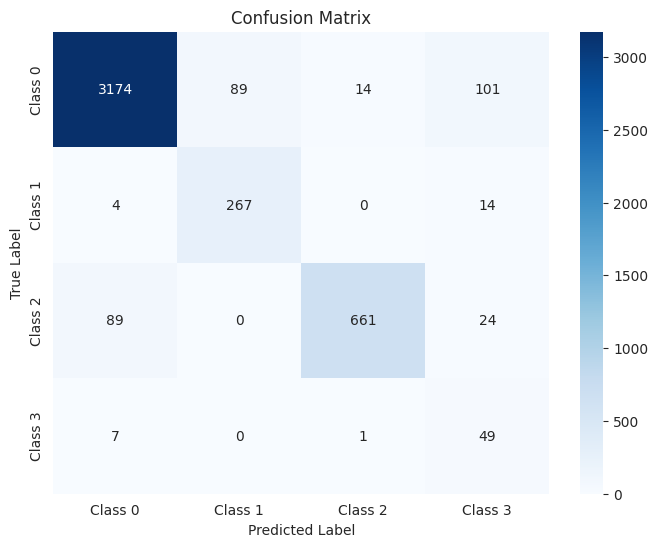

The function took 0.4320 seconds to execute.
[ARCH#136-[32, 32, 16, 16, 16]] done in 33.6s  best-val=0.1960


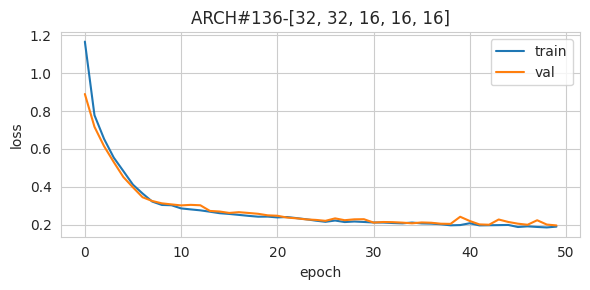


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.89      0.93      0.91      2475
     Class 3       0.28      0.90      0.43       182

    accuracy                           0.92     14379
   macro avg       0.73      0.93      0.79     14379
weighted avg       0.95      0.92      0.93     14379



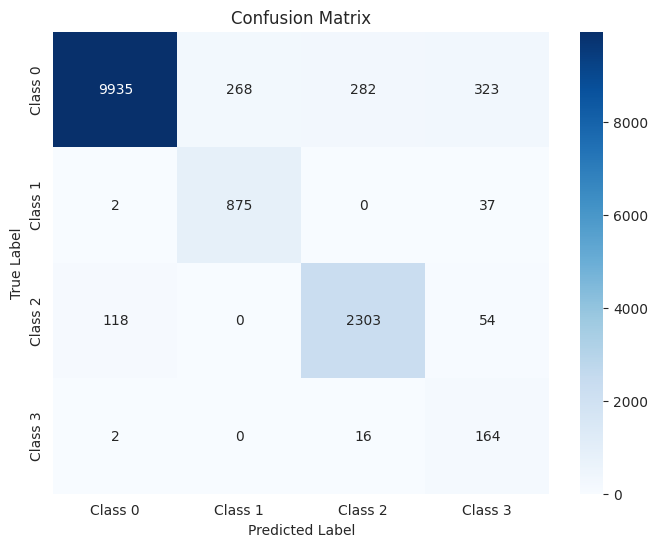

The function took 0.8834 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.88      0.95      0.92       619
     Class 3       0.28      0.91      0.42        46

    accuracy                           0.93      3595
   macro avg       0.73      0.93      0.79      3595
weighted avg       0.95      0.93      0.93      3595



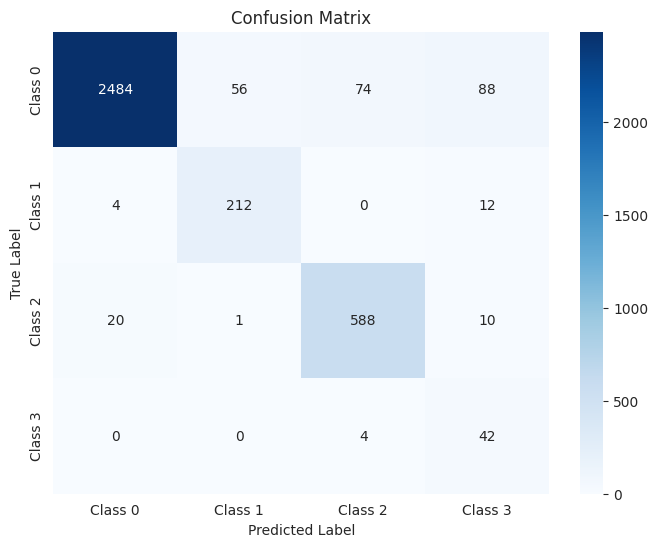

The function took 0.4926 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.77      0.94      0.85       285
     Class 2       0.88      0.92      0.90       774
     Class 3       0.30      0.88      0.45        57

    accuracy                           0.92      4494
   macro avg       0.74      0.92      0.79      4494
weighted avg       0.94      0.92      0.93      4494



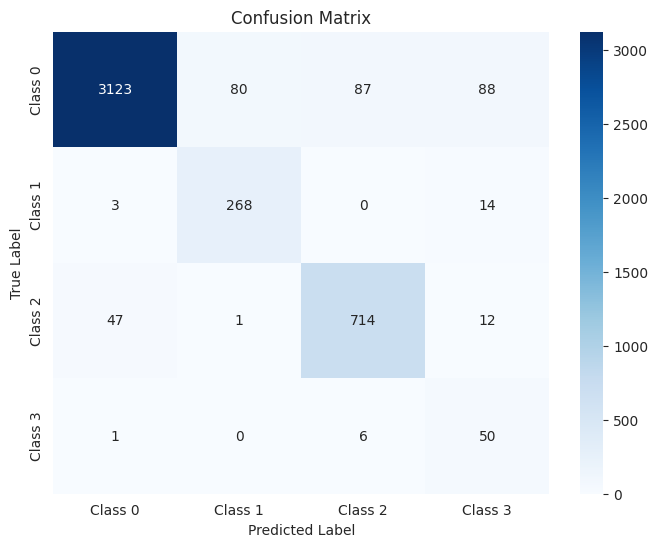

The function took 0.5294 seconds to execute.
[ARCH#137-[32, 32, 16, 16, 8]] done in 34.4s  best-val=0.2060


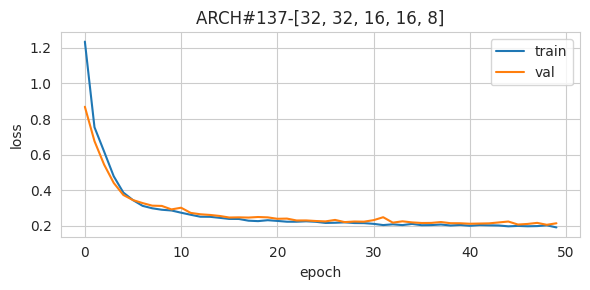


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.90      0.95      0.93      2475
     Class 3       0.41      0.88      0.56       182

    accuracy                           0.94     14379
   macro avg       0.77      0.93      0.83     14379
weighted avg       0.95      0.94      0.94     14379



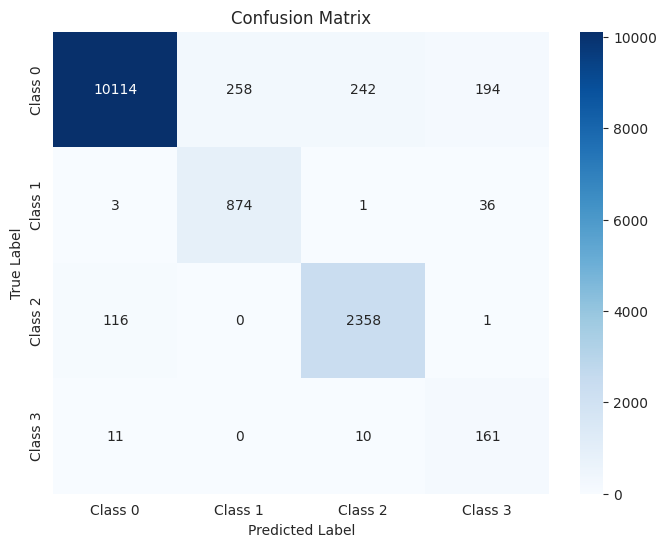

The function took 0.6619 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.79      0.93      0.86       228
     Class 2       0.89      0.97      0.93       619
     Class 3       0.38      0.87      0.53        46

    accuracy                           0.94      3595
   macro avg       0.76      0.93      0.82      3595
weighted avg       0.95      0.94      0.94      3595



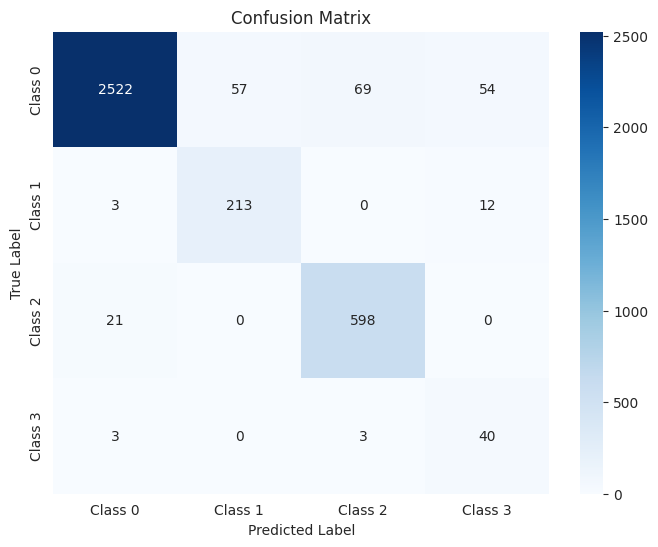

The function took 0.3810 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      3378
     Class 1       0.78      0.94      0.85       285
     Class 2       0.90      0.94      0.92       774
     Class 3       0.41      0.84      0.55        57

    accuracy                           0.94      4494
   macro avg       0.77      0.91      0.82      4494
weighted avg       0.95      0.94      0.94      4494



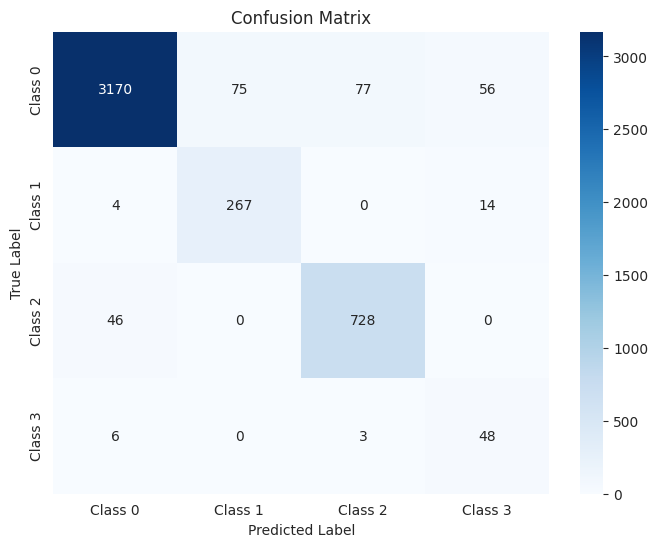

The function took 0.4076 seconds to execute.
[ARCH#138-[32, 32, 16, 16, 4]] done in 34.3s  best-val=0.2180


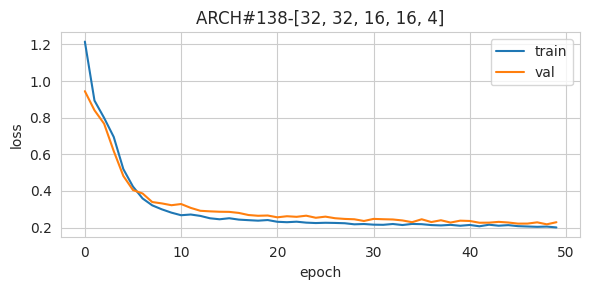


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.92      0.93      0.93      2475
     Class 3       0.32      0.92      0.47       182

    accuracy                           0.93     14379
   macro avg       0.74      0.93      0.80     14379
weighted avg       0.95      0.93      0.94     14379



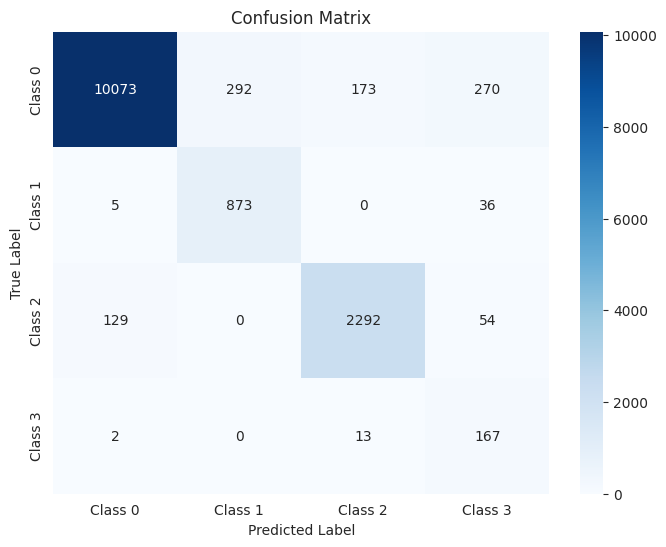

The function took 0.7064 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.93      0.95      0.94       619
     Class 3       0.30      0.89      0.45        46

    accuracy                           0.94      3595
   macro avg       0.75      0.92      0.80      3595
weighted avg       0.96      0.94      0.94      3595



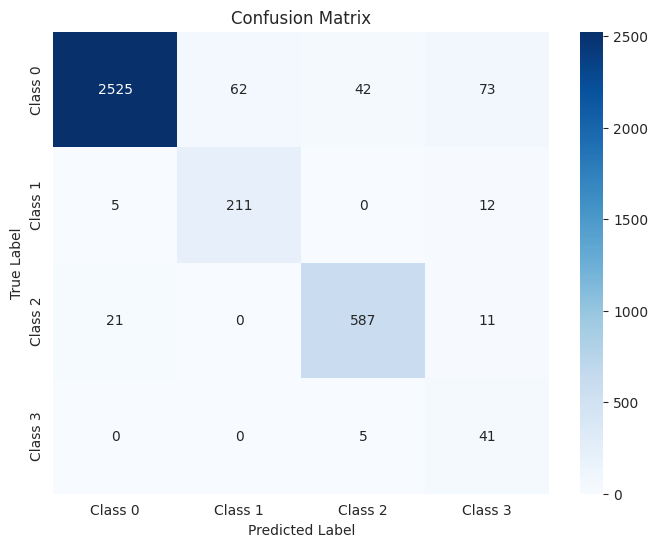

The function took 0.3719 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.75      0.94      0.83       285
     Class 2       0.92      0.92      0.92       774
     Class 3       0.31      0.84      0.45        57

    accuracy                           0.93      4494
   macro avg       0.74      0.91      0.79      4494
weighted avg       0.95      0.93      0.94      4494



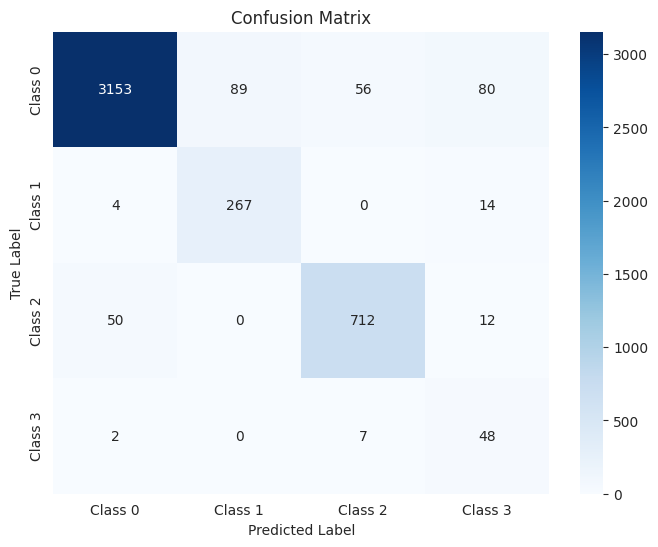

The function took 0.4264 seconds to execute.
[ARCH#139-[32, 32, 16, 16, 2]] done in 33.5s  best-val=0.4149


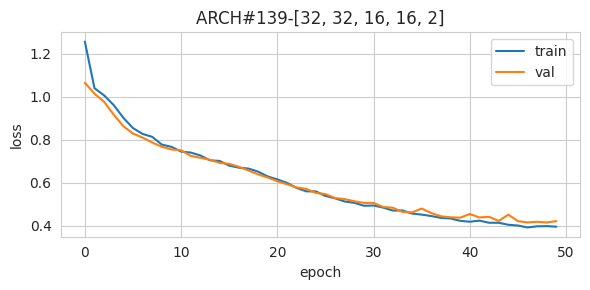


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.98      0.85      0.91      2475
     Class 3       0.27      0.88      0.42       182

    accuracy                           0.92     14379
   macro avg       0.75      0.91      0.78     14379
weighted avg       0.94      0.92      0.93     14379



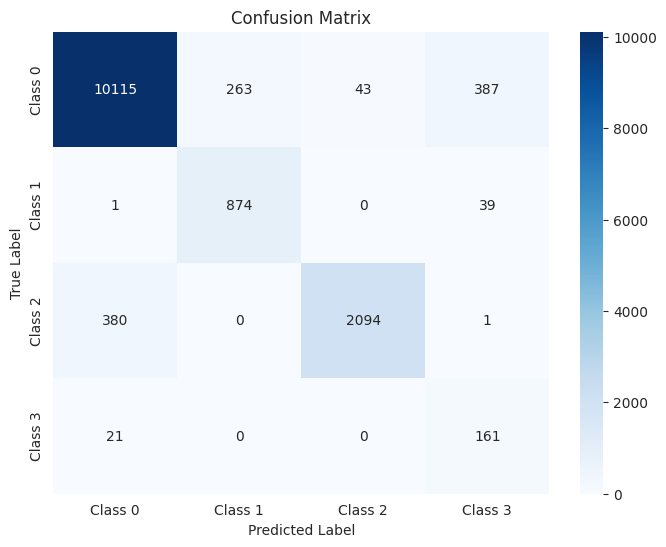

The function took 0.6787 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95      2702
     Class 1       0.79      0.93      0.86       228
     Class 2       0.97      0.86      0.92       619
     Class 3       0.26      0.87      0.40        46

    accuracy                           0.92      3595
   macro avg       0.75      0.90      0.78      3595
weighted avg       0.95      0.92      0.93      3595



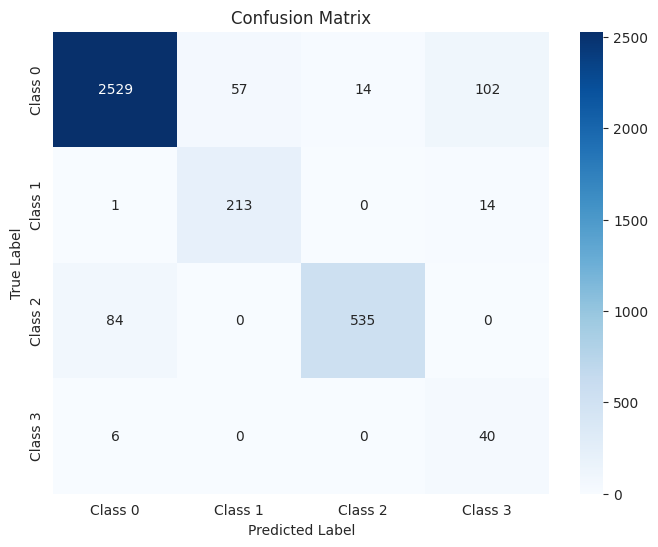

The function took 0.4044 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.94      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.97      0.82      0.89       774
     Class 3       0.25      0.84      0.39        57

    accuracy                           0.91      4494
   macro avg       0.74      0.89      0.77      4494
weighted avg       0.94      0.91      0.92      4494



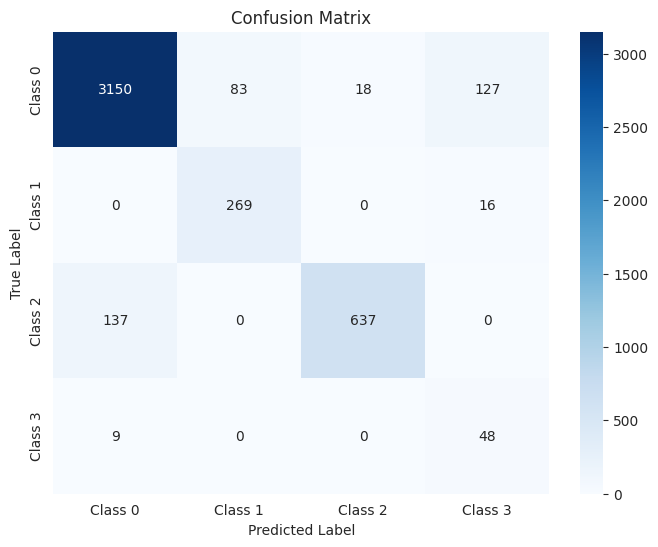

The function took 0.4891 seconds to execute.
[ARCH#140-[32, 32, 16, 8, 8]] done in 34.4s  best-val=0.2641


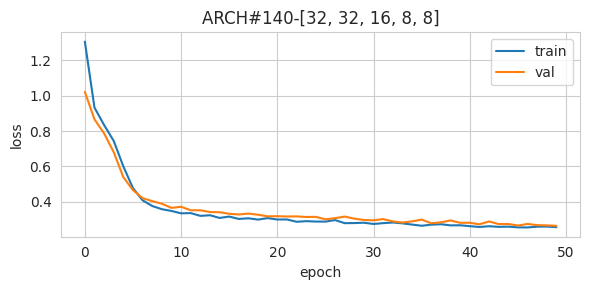


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.56      0.96      0.70       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.20      0.99      0.34       182

    accuracy                           0.89     14379
   macro avg       0.69      0.93      0.73     14379
weighted avg       0.95      0.89      0.91     14379



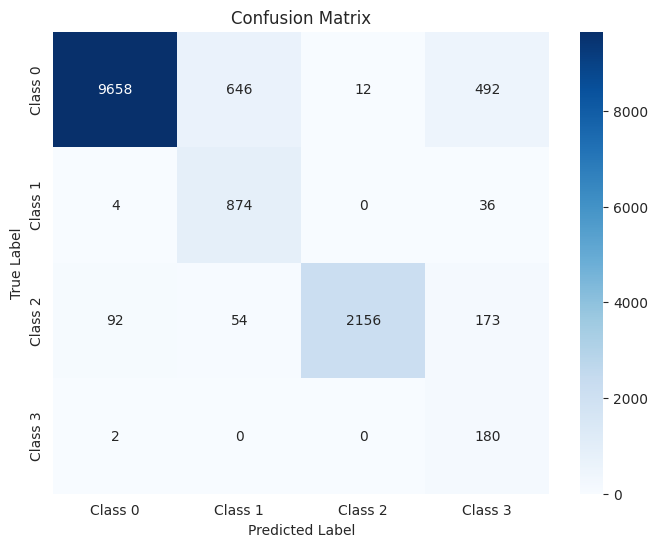

The function took 0.6722 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.59      0.93      0.73       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.19      0.98      0.32        46

    accuracy                           0.90      3595
   macro avg       0.69      0.92      0.73      3595
weighted avg       0.95      0.90      0.92      3595



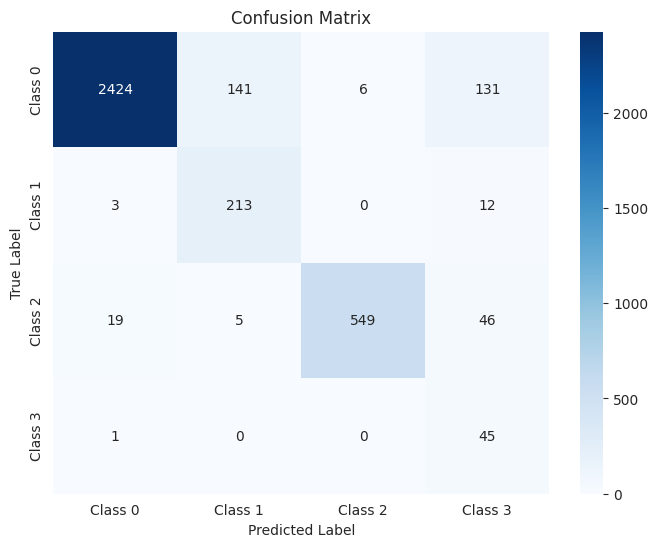

The function took 0.3741 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.54      0.94      0.68       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.20      0.91      0.32        57

    accuracy                           0.89      4494
   macro avg       0.67      0.90      0.71      4494
weighted avg       0.95      0.89      0.91      4494



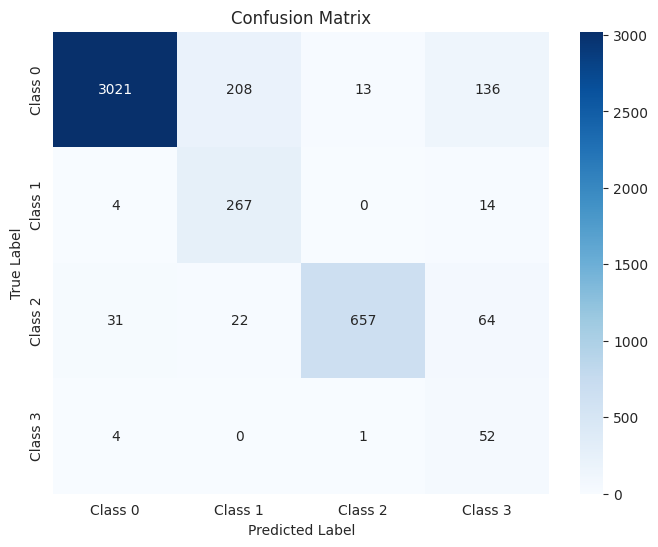

The function took 0.7847 seconds to execute.
[ARCH#141-[32, 32, 16, 8, 4]] done in 34.5s  best-val=0.2324


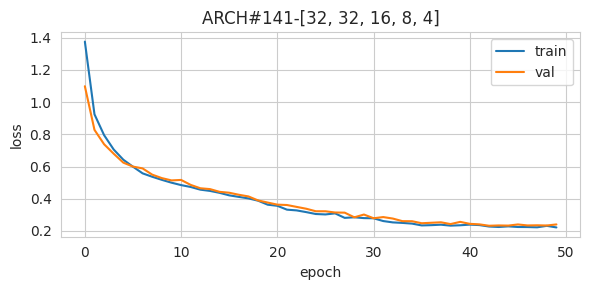


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.65      0.96      0.78       914
     Class 2       0.87      0.95      0.91      2475
     Class 3       0.40      0.88      0.55       182

    accuracy                           0.92     14379
   macro avg       0.73      0.92      0.79     14379
weighted avg       0.94      0.92      0.92     14379



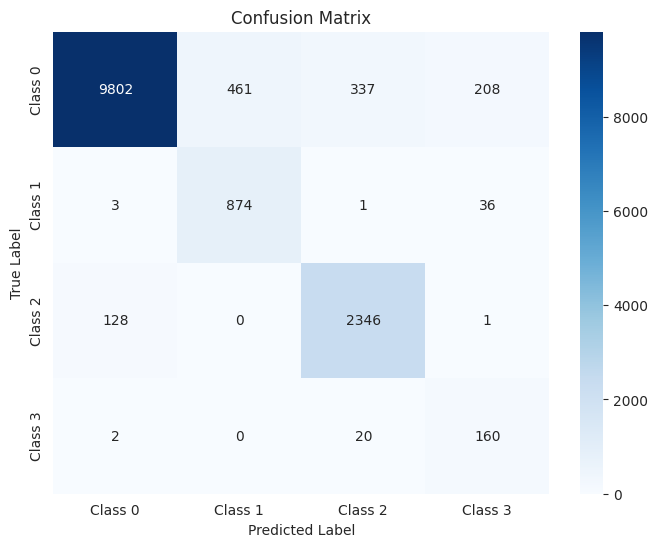

The function took 0.7171 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.66      0.93      0.78       228
     Class 2       0.87      0.96      0.91       619
     Class 3       0.37      0.87      0.52        46

    accuracy                           0.92      3595
   macro avg       0.72      0.92      0.79      3595
weighted avg       0.94      0.92      0.92      3595



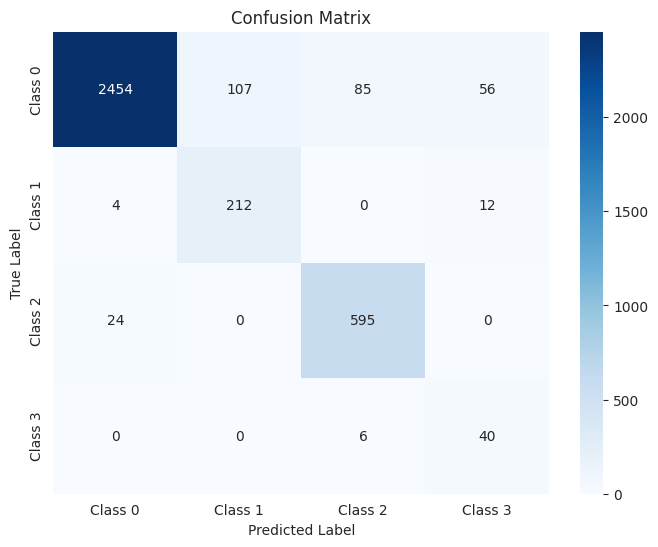

The function took 0.4048 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94      3378
     Class 1       0.64      0.94      0.76       285
     Class 2       0.88      0.93      0.90       774
     Class 3       0.39      0.84      0.54        57

    accuracy                           0.91      4494
   macro avg       0.72      0.91      0.79      4494
weighted avg       0.93      0.91      0.92      4494



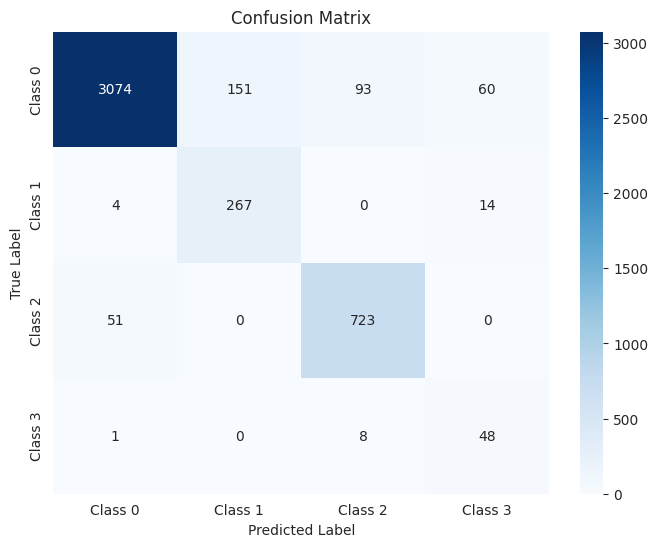

The function took 0.4359 seconds to execute.
[ARCH#142-[32, 32, 16, 8, 2]] done in 33.8s  best-val=0.5215


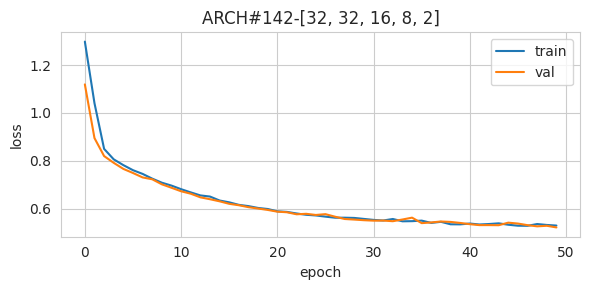


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.94      0.95     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.07      0.12      0.09       182

    accuracy                           0.92     14379
   macro avg       0.69      0.72      0.70     14379
weighted avg       0.94      0.92      0.93     14379



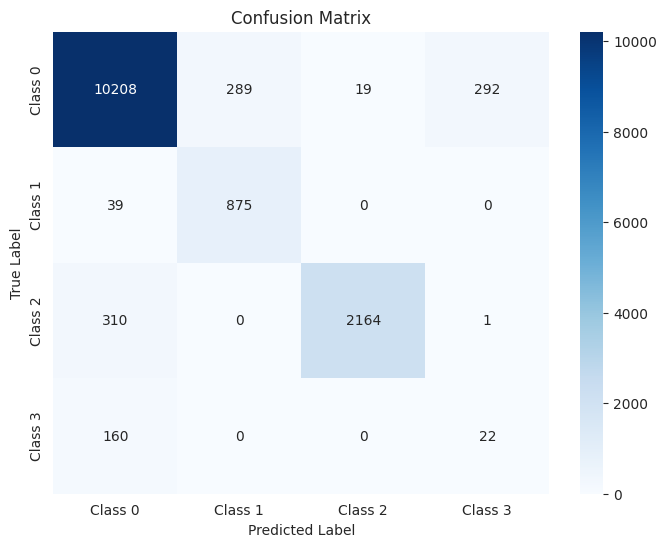

The function took 0.8161 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.12      0.24      0.16        46

    accuracy                           0.92      3595
   macro avg       0.71      0.75      0.72      3595
weighted avg       0.94      0.92      0.93      3595



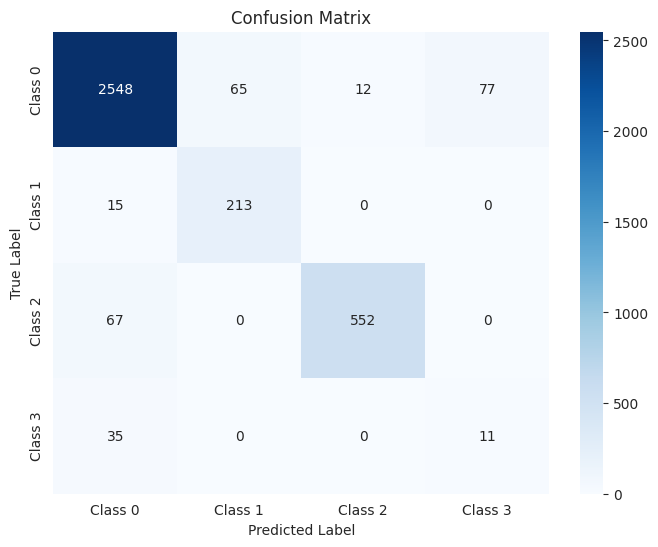

The function took 0.4743 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.94      0.94      3378
     Class 1       0.75      0.94      0.84       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.07      0.14      0.10        57

    accuracy                           0.91      4494
   macro avg       0.69      0.72      0.70      4494
weighted avg       0.93      0.91      0.92      4494



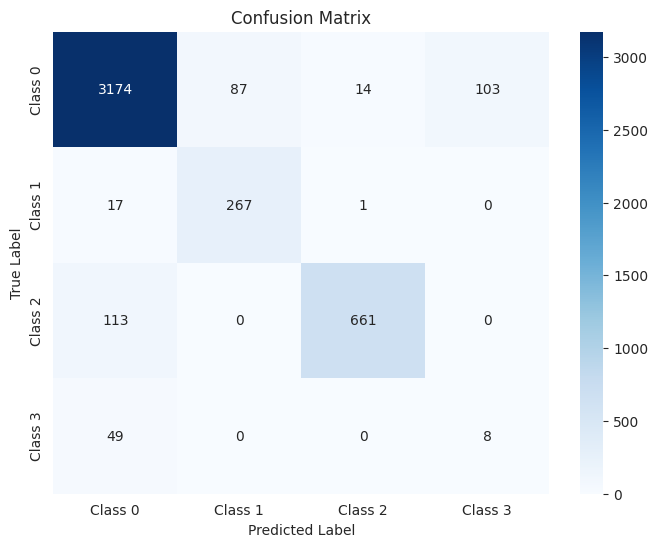

The function took 0.4601 seconds to execute.
[ARCH#143-[32, 32, 16, 4, 4]] done in 34.7s  best-val=0.2456


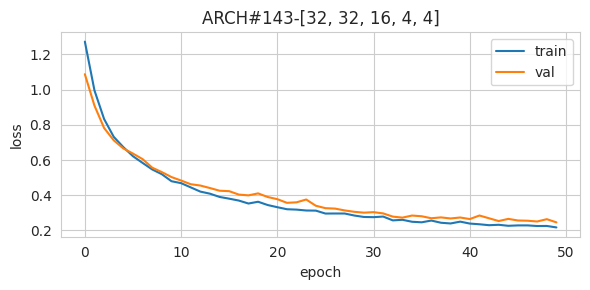


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96     10808
     Class 1       0.79      0.96      0.86       914
     Class 2       0.93      0.90      0.92      2475
     Class 3       0.35      0.88      0.50       182

    accuracy                           0.93     14379
   macro avg       0.76      0.92      0.81     14379
weighted avg       0.95      0.93      0.94     14379



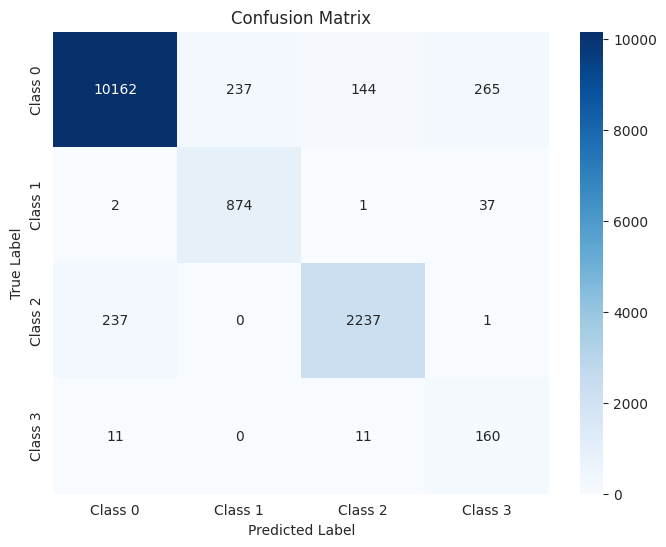

The function took 0.7130 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      2702
     Class 1       0.81      0.93      0.87       228
     Class 2       0.94      0.91      0.92       619
     Class 3       0.33      0.87      0.48        46

    accuracy                           0.94      3595
   macro avg       0.76      0.91      0.81      3595
weighted avg       0.95      0.94      0.94      3595



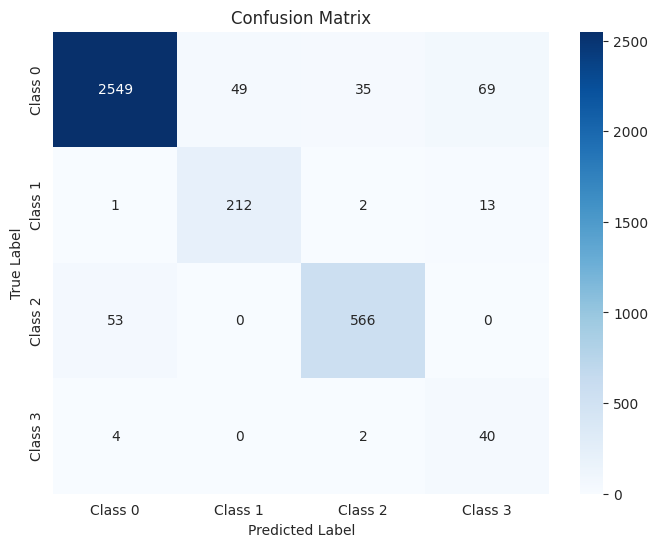

The function took 0.3890 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.96      3378
     Class 1       0.80      0.94      0.86       285
     Class 2       0.93      0.88      0.91       774
     Class 3       0.35      0.86      0.50        57

    accuracy                           0.93      4494
   macro avg       0.76      0.91      0.81      4494
weighted avg       0.94      0.93      0.94      4494



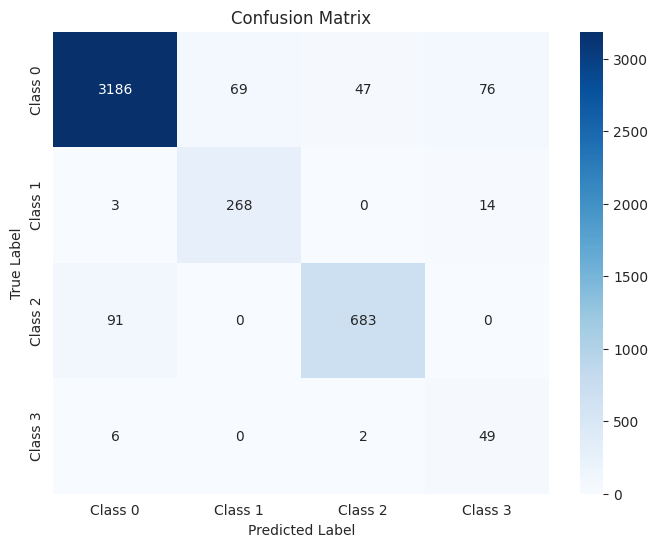

The function took 0.4514 seconds to execute.
[ARCH#144-[32, 32, 16, 4, 2]] done in 34.8s  best-val=0.2842


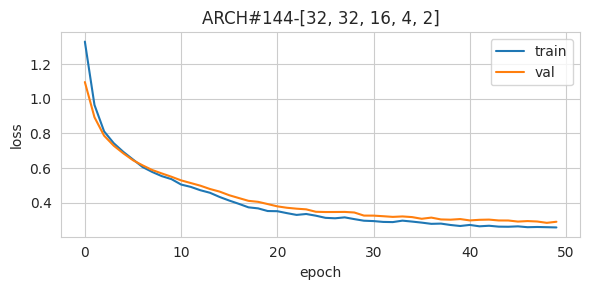


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.37      0.88      0.52       182

    accuracy                           0.94     14379
   macro avg       0.77      0.91      0.81     14379
weighted avg       0.95      0.94      0.94     14379



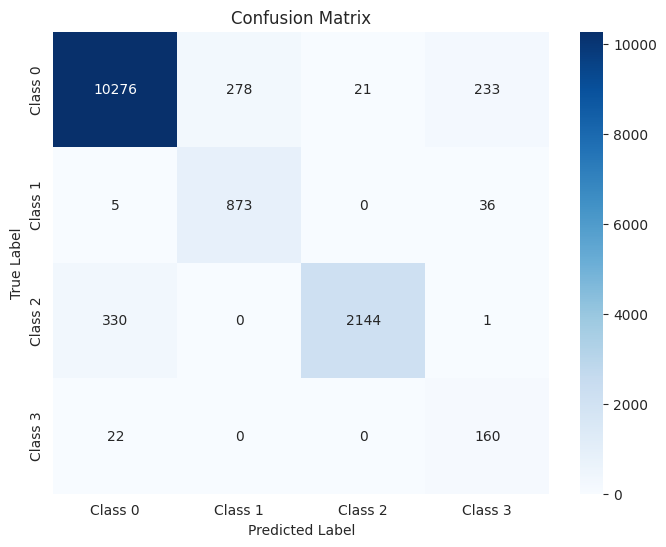

The function took 0.7316 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96      2702
     Class 1       0.78      0.93      0.84       228
     Class 2       0.99      0.89      0.93       619
     Class 3       0.35      0.87      0.50        46

    accuracy                           0.94      3595
   macro avg       0.77      0.91      0.81      3595
weighted avg       0.95      0.94      0.94      3595



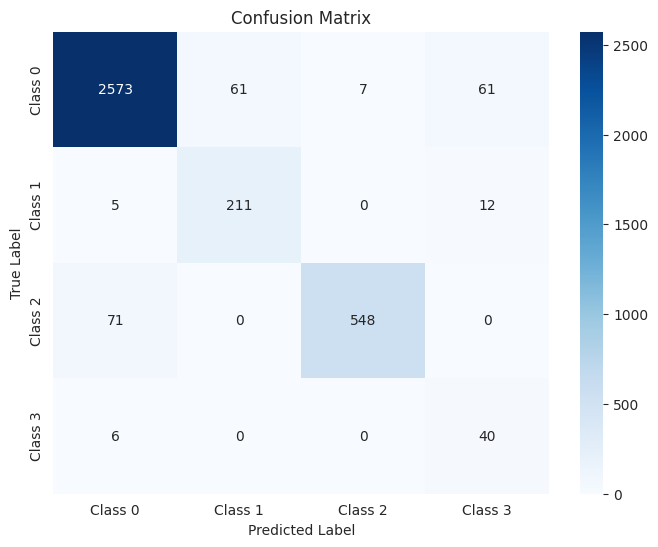

The function took 0.3844 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.95      0.96      3378
     Class 1       0.76      0.93      0.84       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.36      0.82      0.51        57

    accuracy                           0.93      4494
   macro avg       0.77      0.89      0.80      4494
weighted avg       0.94      0.93      0.93      4494



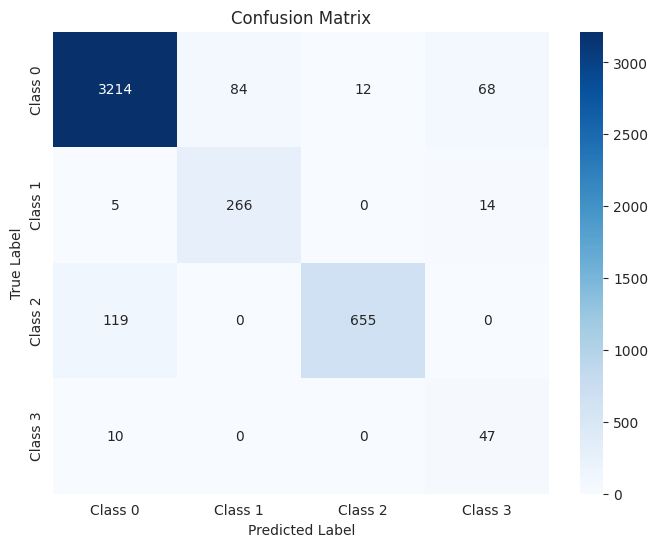

The function took 0.4061 seconds to execute.
[ARCH#145-[32, 32, 16, 2, 2]] done in 33.7s  best-val=0.9371


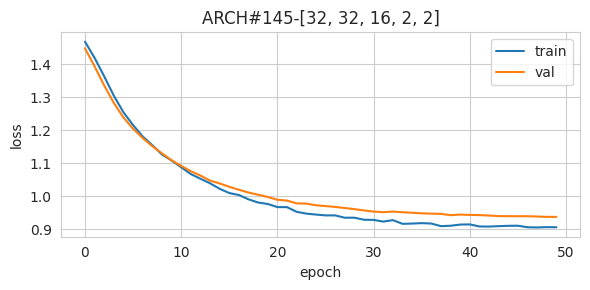


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.80      0.97      0.88     10808
     Class 1       0.78      0.96      0.86       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.79     14379
   macro avg       0.39      0.48      0.43     14379
weighted avg       0.65      0.79      0.71     14379



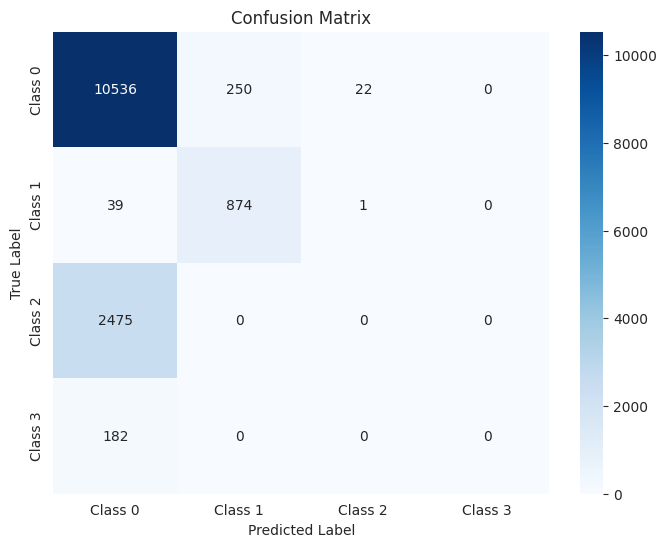

The function took 0.8331 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.80      0.98      0.88      2702
     Class 1       0.81      0.93      0.86       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.79      3595
   macro avg       0.40      0.48      0.44      3595
weighted avg       0.65      0.79      0.71      3595



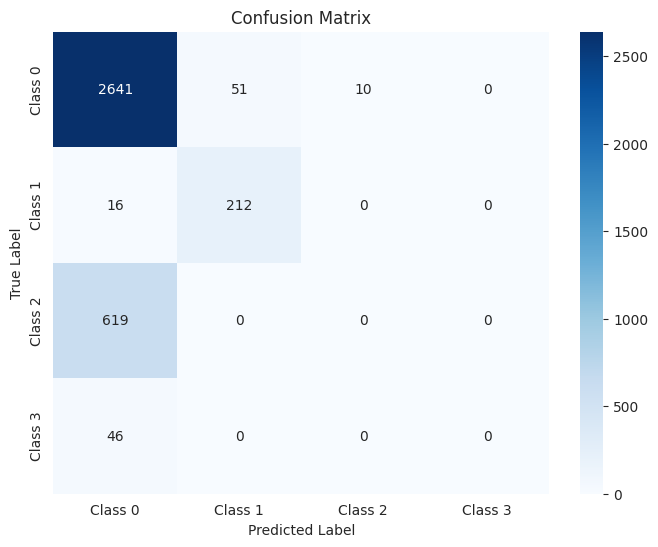

The function took 0.4546 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.79      0.98      0.88      3378
     Class 1       0.78      0.93      0.85       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.79      4494
   macro avg       0.39      0.48      0.43      4494
weighted avg       0.65      0.79      0.71      4494



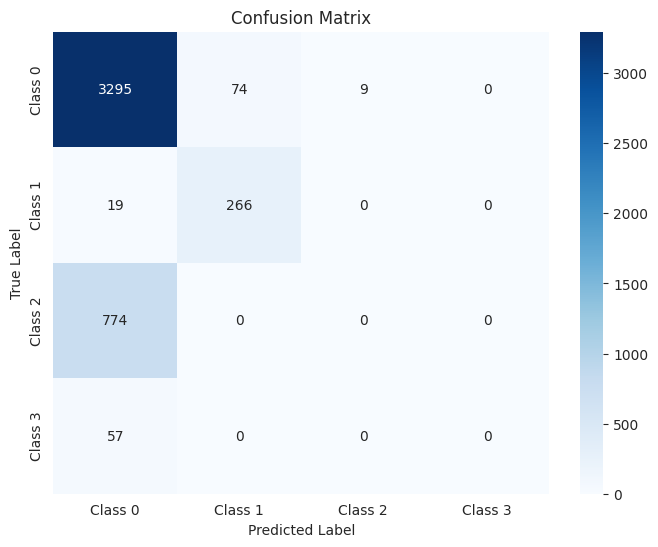

The function took 0.5145 seconds to execute.
[ARCH#146-[32, 32, 8, 8, 8]] done in 34.5s  best-val=0.2821


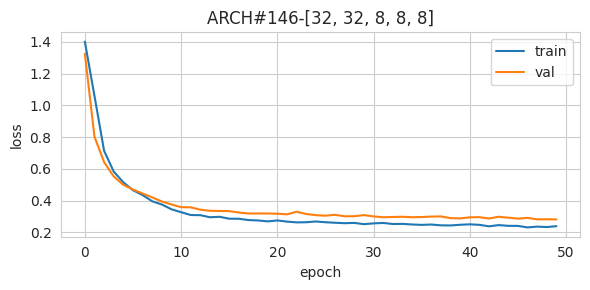


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.34      0.88      0.49       182

    accuracy                           0.94     14379
   macro avg       0.77      0.91      0.81     14379
weighted avg       0.95      0.94      0.94     14379



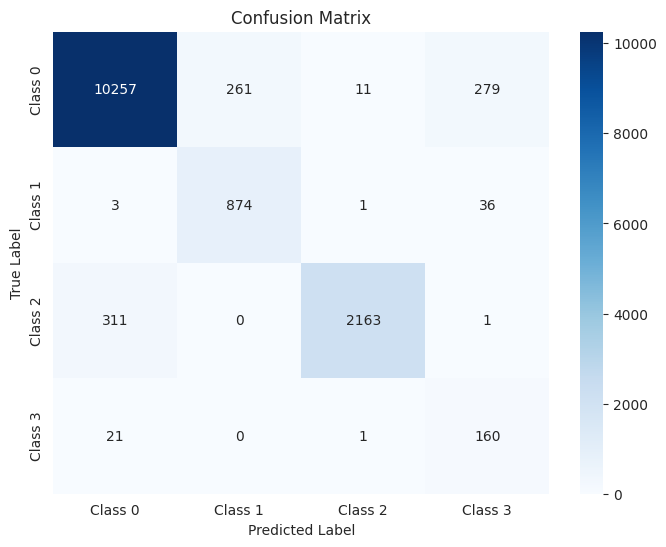

The function took 0.7209 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.31      0.87      0.45        46

    accuracy                           0.94      3595
   macro avg       0.77      0.91      0.80      3595
weighted avg       0.95      0.94      0.94      3595



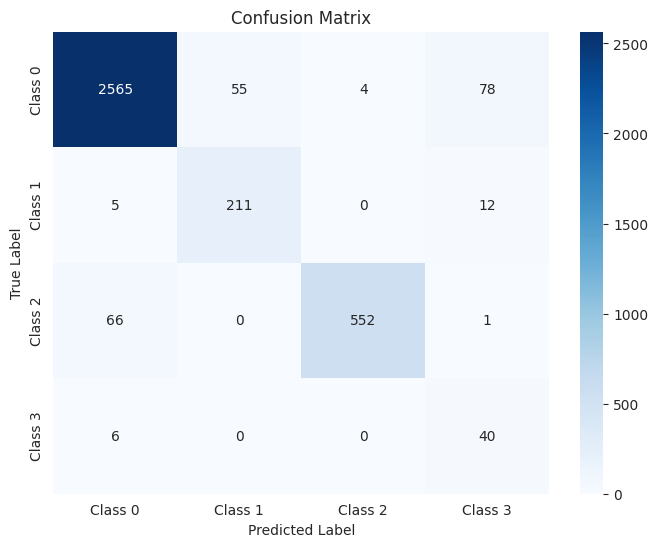

The function took 0.3729 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.95      0.96      3378
     Class 1       0.77      0.94      0.85       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.34      0.86      0.49        57

    accuracy                           0.93      4494
   macro avg       0.76      0.90      0.80      4494
weighted avg       0.94      0.93      0.93      4494



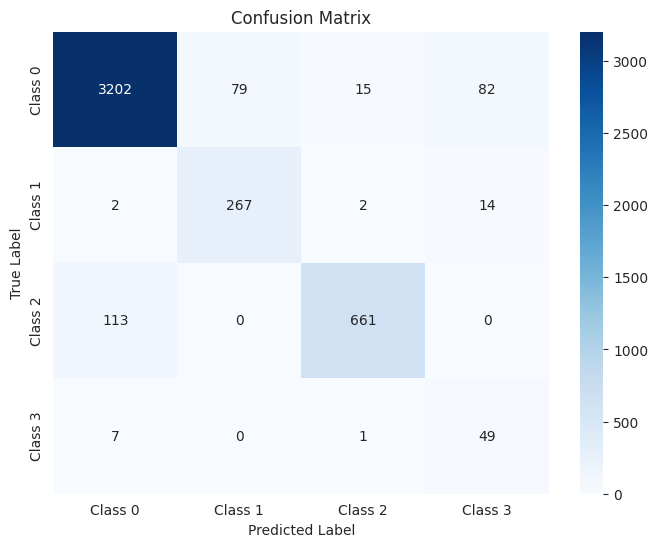

The function took 0.4099 seconds to execute.
[ARCH#147-[32, 32, 8, 8, 4]] done in 34.2s  best-val=0.2715


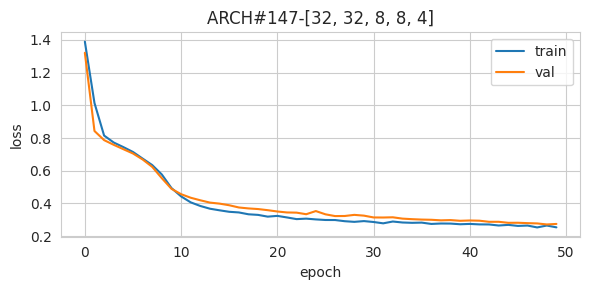


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.90      0.95      0.93      2475
     Class 3       0.26      0.88      0.40       182

    accuracy                           0.92     14379
   macro avg       0.72      0.93      0.77     14379
weighted avg       0.95      0.92      0.93     14379



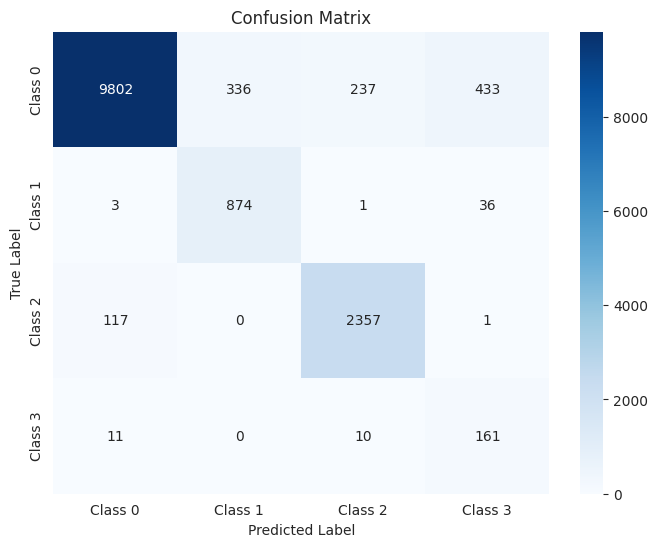

The function took 0.6974 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.74      0.93      0.82       228
     Class 2       0.90      0.97      0.93       619
     Class 3       0.25      0.89      0.39        46

    accuracy                           0.92      3595
   macro avg       0.72      0.92      0.77      3595
weighted avg       0.95      0.92      0.93      3595



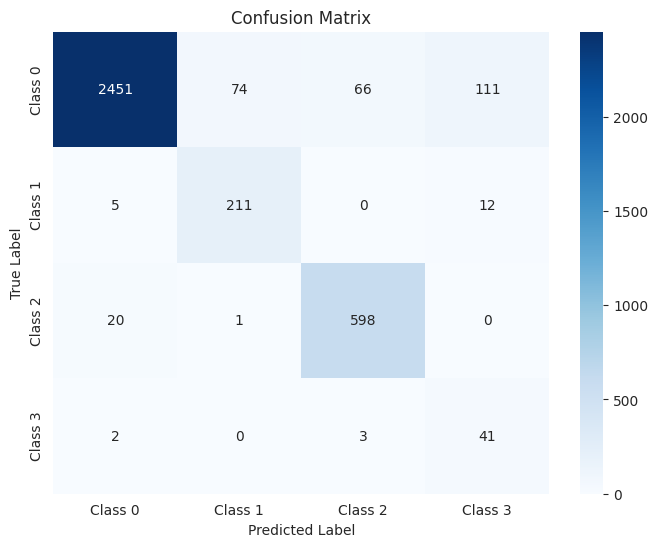

The function took 0.3735 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94      3378
     Class 1       0.71      0.93      0.81       285
     Class 2       0.91      0.94      0.92       774
     Class 3       0.26      0.89      0.40        57

    accuracy                           0.92      4494
   macro avg       0.72      0.92      0.77      4494
weighted avg       0.94      0.92      0.93      4494



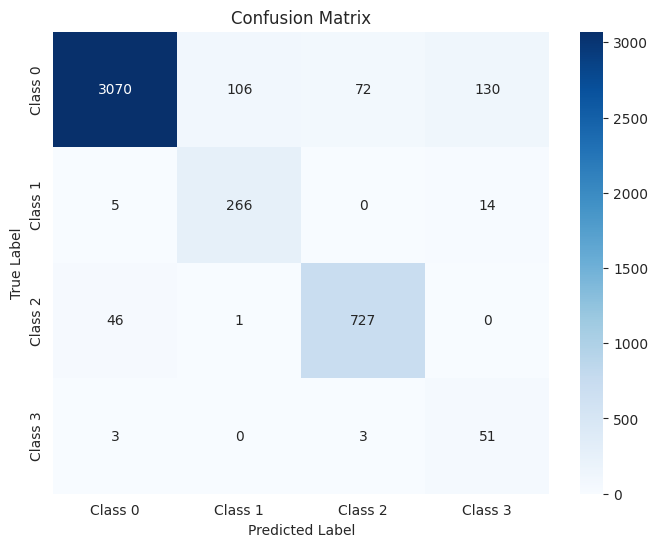

The function took 0.4175 seconds to execute.
[ARCH#148-[32, 32, 8, 8, 2]] done in 33.4s  best-val=1.3794


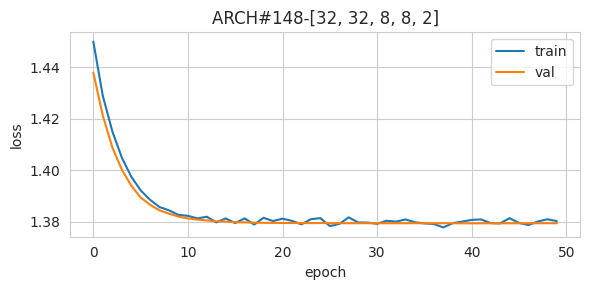


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



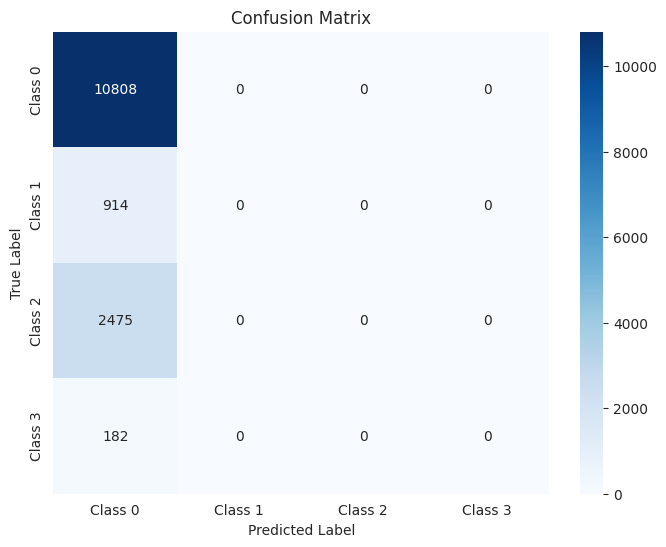

The function took 0.7056 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



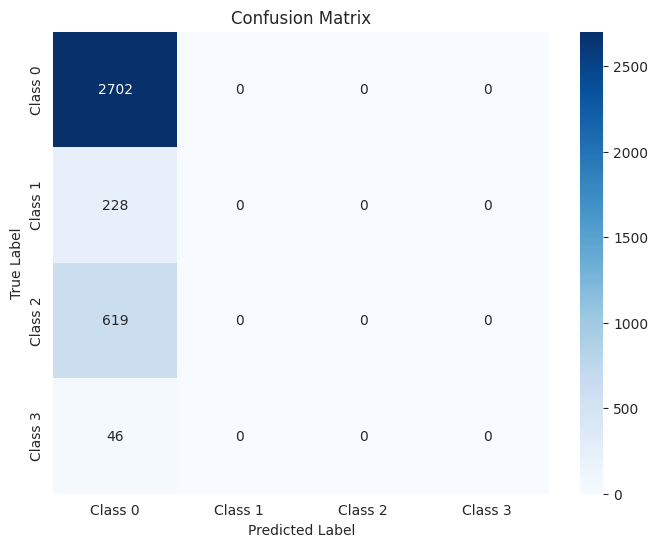

The function took 0.4262 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



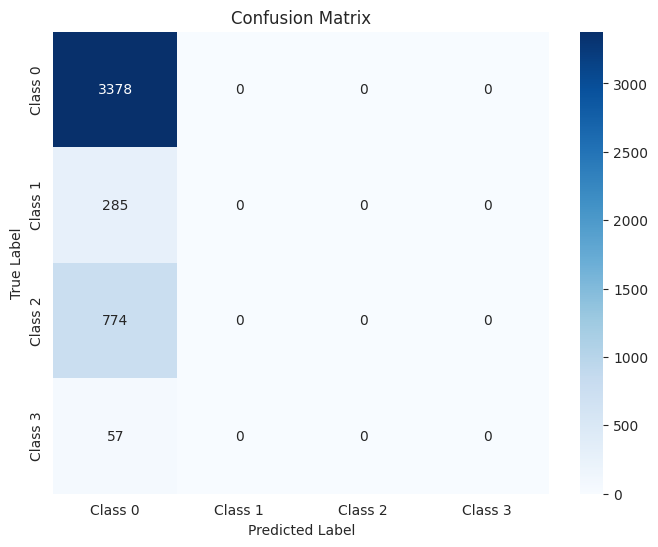

The function took 0.4854 seconds to execute.
[ARCH#149-[32, 32, 8, 4, 4]] done in 34.6s  best-val=0.3095


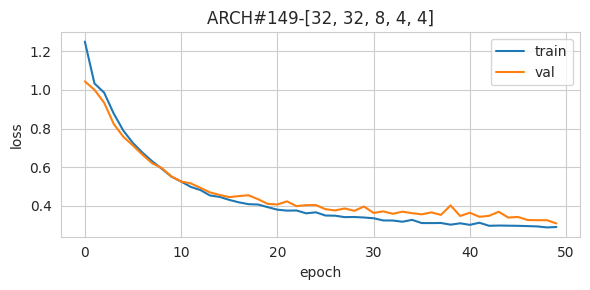


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95     10808
     Class 1       0.78      0.95      0.86       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.17      0.91      0.29       182

    accuracy                           0.92     14379
   macro avg       0.73      0.91      0.76     14379
weighted avg       0.96      0.92      0.93     14379



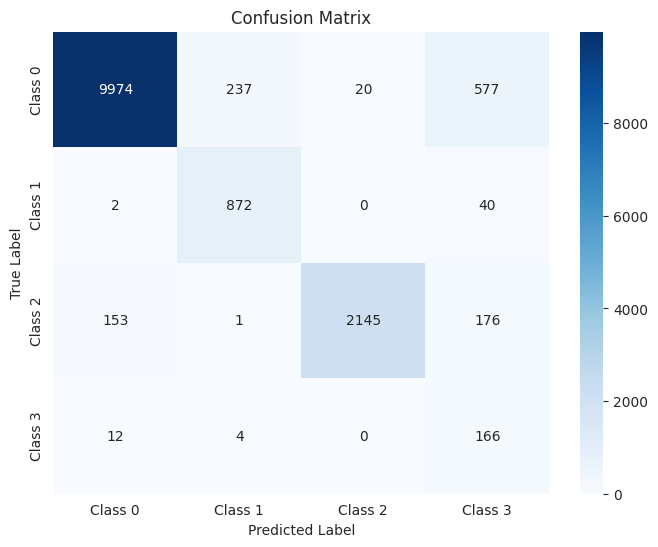

The function took 0.7136 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.81      0.93      0.86       228
     Class 2       0.99      0.89      0.93       619
     Class 3       0.16      0.93      0.27        46

    accuracy                           0.91      3595
   macro avg       0.74      0.92      0.76      3595
weighted avg       0.97      0.91      0.94      3595



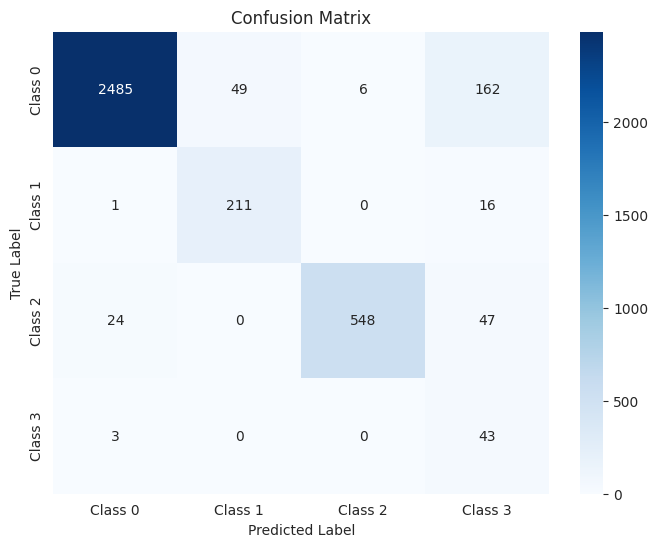

The function took 0.7597 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.79      0.93      0.85       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.17      0.88      0.28        57

    accuracy                           0.91      4494
   macro avg       0.73      0.89      0.75      4494
weighted avg       0.96      0.91      0.93      4494



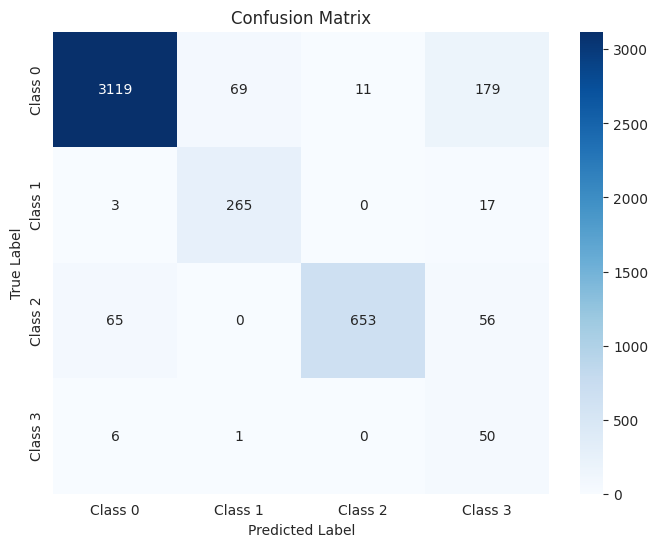

The function took 0.4402 seconds to execute.
[ARCH#150-[32, 32, 8, 4, 2]] early-stop @ epoch 043
[ARCH#150-[32, 32, 8, 4, 2]] done in 29.9s  best-val=1.3794


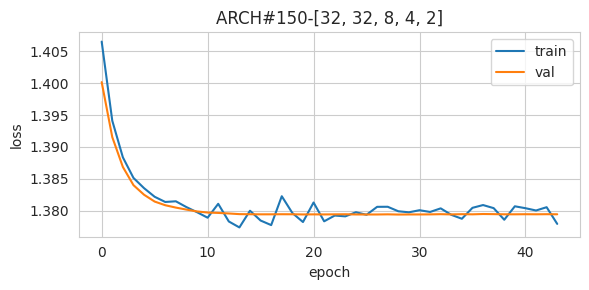


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



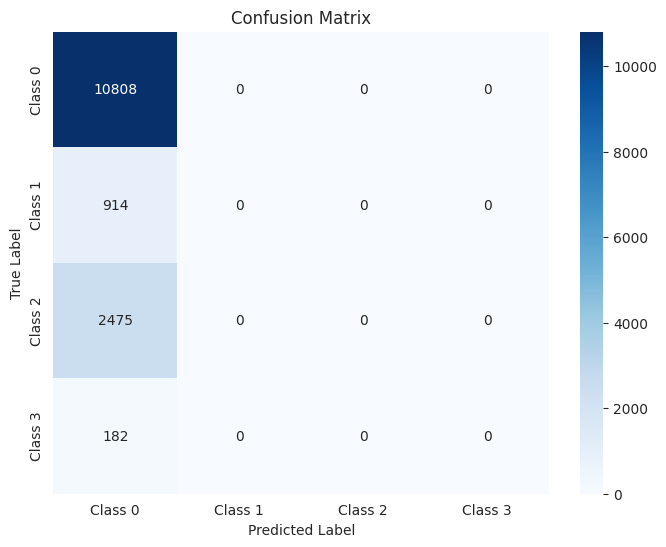

The function took 0.7547 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



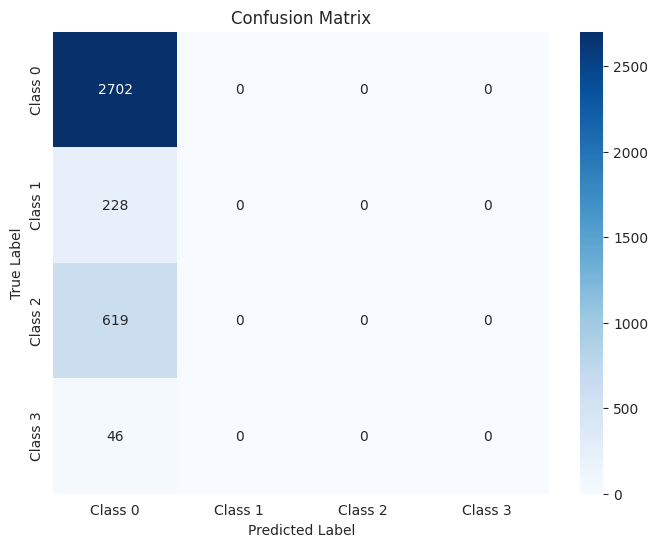

The function took 0.4663 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



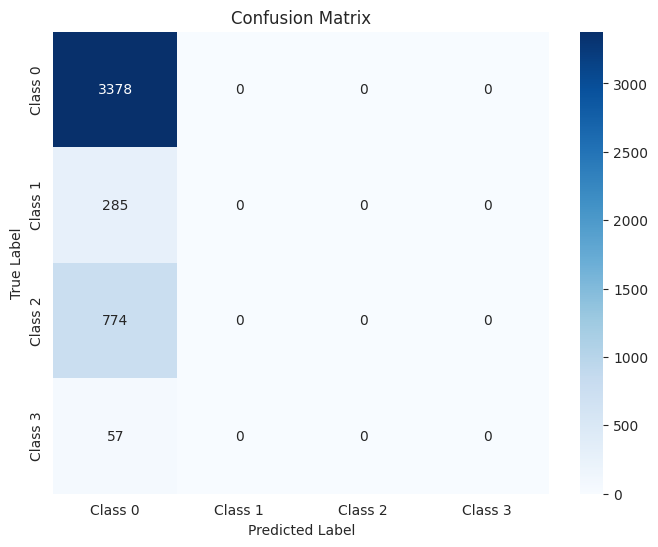

The function took 0.4894 seconds to execute.
[ARCH#151-[32, 32, 8, 2, 2]] done in 34.5s  best-val=0.5423


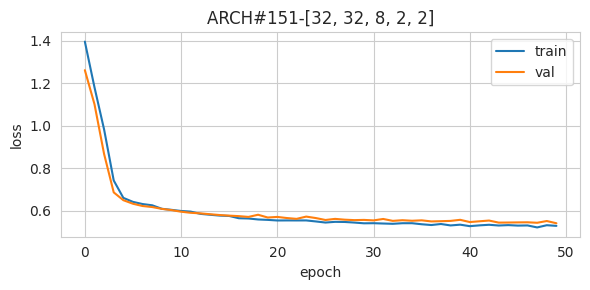


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95     10808
     Class 1       0.76      0.91      0.83       914
     Class 2       0.92      0.92      0.92      2475
     Class 3       0.02      0.03      0.02       182

    accuracy                           0.92     14379
   macro avg       0.67      0.70      0.68     14379
weighted avg       0.93      0.92      0.93     14379



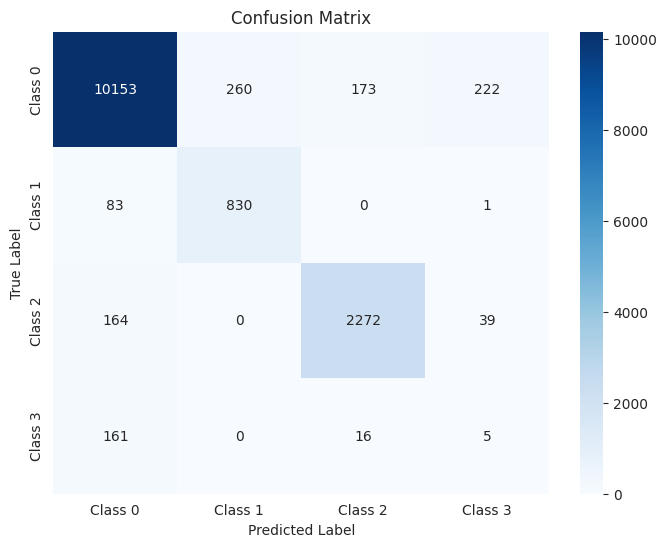

The function took 0.7210 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95      2702
     Class 1       0.79      0.87      0.83       228
     Class 2       0.93      0.94      0.94       619
     Class 3       0.03      0.04      0.04        46

    accuracy                           0.93      3595
   macro avg       0.68      0.70      0.69      3595
weighted avg       0.93      0.93      0.93      3595



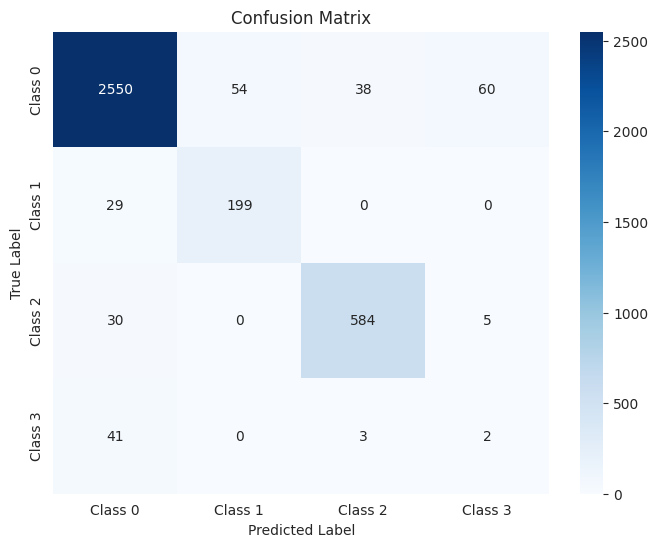

The function took 0.3857 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95      3378
     Class 1       0.76      0.89      0.82       285
     Class 2       0.93      0.91      0.92       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.92      4494
   macro avg       0.66      0.69      0.67      4494
weighted avg       0.93      0.92      0.92      4494



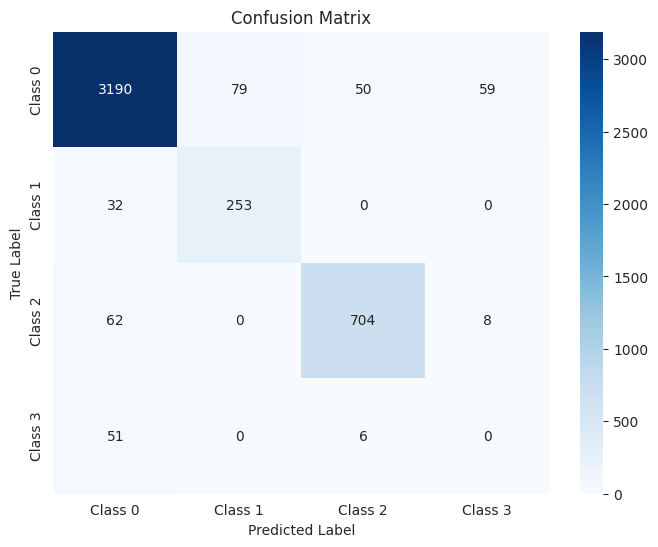

The function took 0.4175 seconds to execute.
[ARCH#152-[32, 32, 4, 4, 4]] done in 34.7s  best-val=0.3163


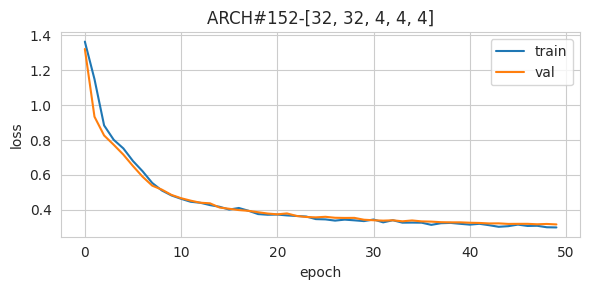


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95     10808
     Class 1       0.70      0.96      0.81       914
     Class 2       0.99      0.86      0.92      2475
     Class 3       0.38      0.88      0.53       182

    accuracy                           0.93     14379
   macro avg       0.76      0.91      0.80     14379
weighted avg       0.94      0.93      0.93     14379



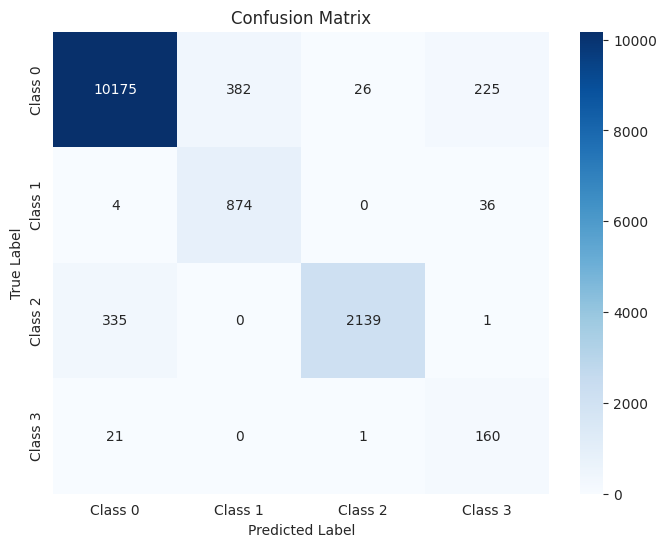

The function took 0.7059 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95      2702
     Class 1       0.68      0.93      0.79       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.35      0.87      0.50        46

    accuracy                           0.93      3595
   macro avg       0.75      0.91      0.79      3595
weighted avg       0.95      0.93      0.93      3595



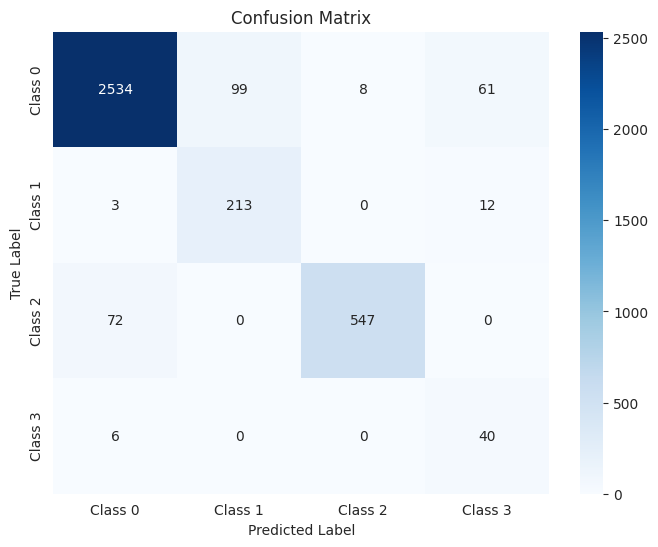

The function took 0.3689 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95      3378
     Class 1       0.68      0.94      0.79       285
     Class 2       0.98      0.84      0.90       774
     Class 3       0.37      0.84      0.51        57

    accuracy                           0.92      4494
   macro avg       0.75      0.89      0.79      4494
weighted avg       0.94      0.92      0.93      4494



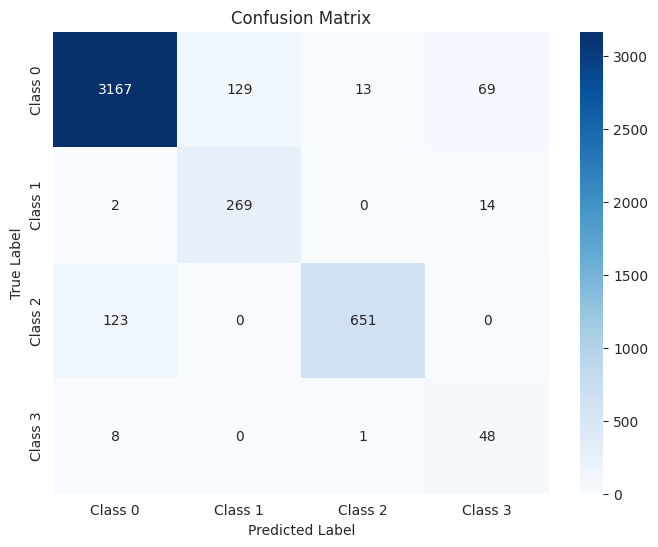

The function took 0.4239 seconds to execute.
[ARCH#153-[32, 32, 4, 4, 2]] done in 33.5s  best-val=1.3794


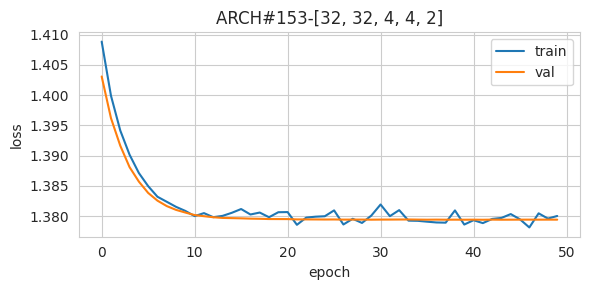


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



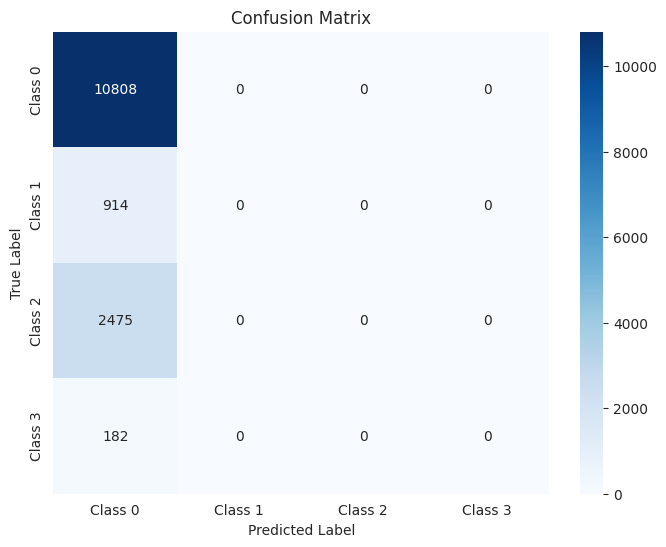

The function took 0.7968 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



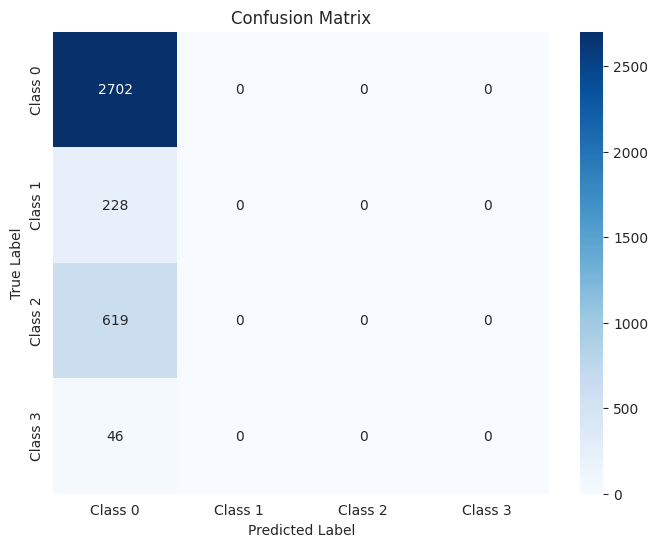

The function took 0.4363 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



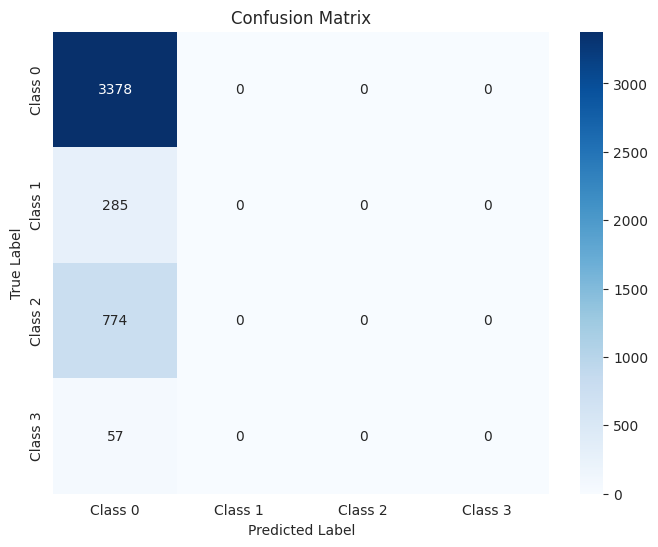

The function took 0.5114 seconds to execute.
[ARCH#154-[32, 32, 4, 2, 2]] done in 34.3s  best-val=0.4676


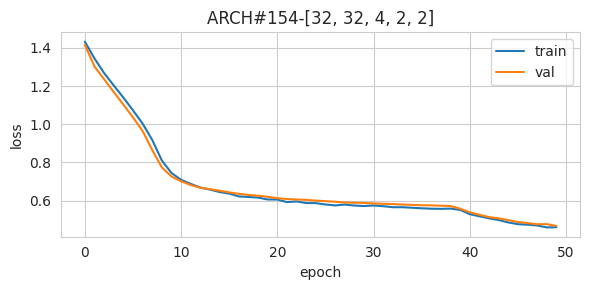


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.58      0.74     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.04      0.98      0.07       182

    accuracy                           0.66     14379
   macro avg       0.69      0.85      0.64     14379
weighted avg       0.97      0.66      0.77     14379



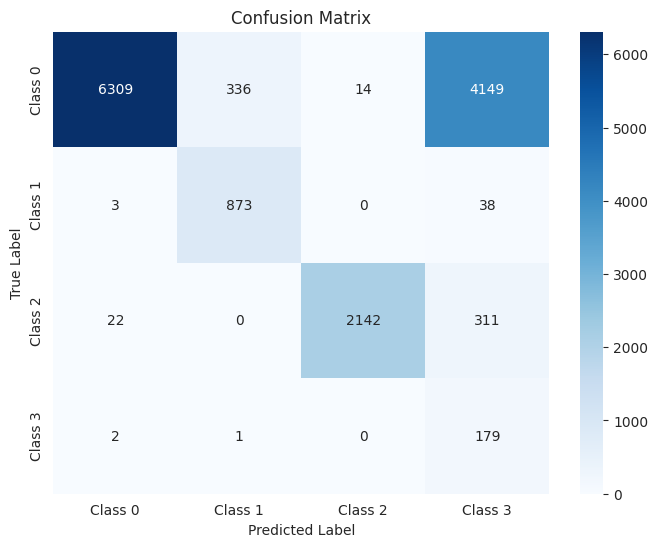

The function took 0.7399 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.59      0.74      2702
     Class 1       0.73      0.93      0.82       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.04      1.00      0.08        46

    accuracy                           0.67      3595
   macro avg       0.69      0.85      0.64      3595
weighted avg       0.97      0.67      0.77      3595



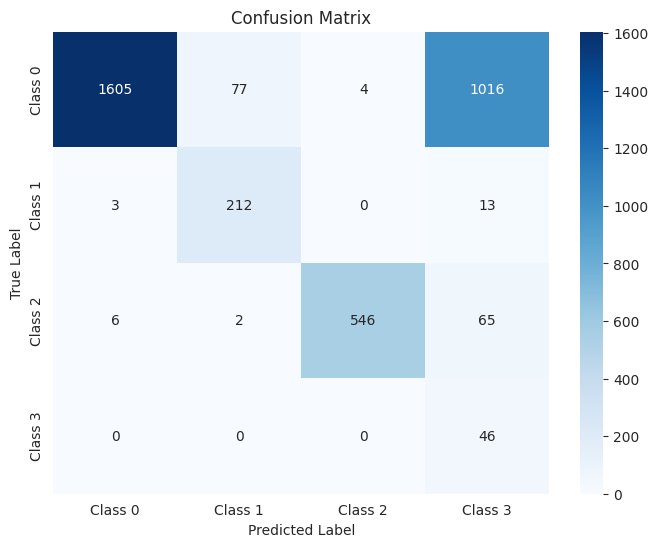

The function took 0.4132 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.59      0.74      3378
     Class 1       0.73      0.93      0.82       285
     Class 2       0.99      0.84      0.91       774
     Class 3       0.04      0.98      0.07        57

    accuracy                           0.66      4494
   macro avg       0.69      0.84      0.64      4494
weighted avg       0.97      0.66      0.77      4494



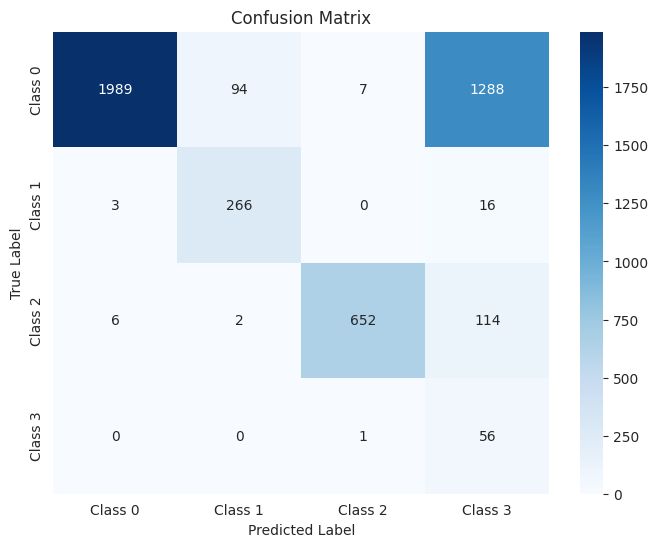

The function took 0.4210 seconds to execute.
[ARCH#155-[32, 32, 2, 2, 2]] done in 34.3s  best-val=0.5497


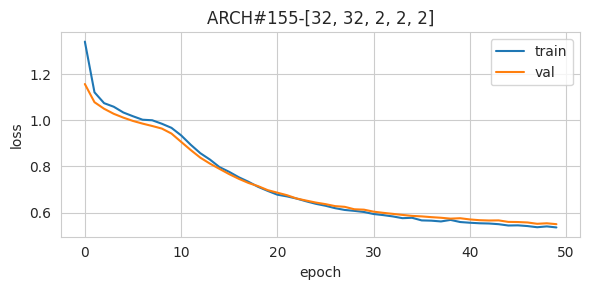


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.97      0.96     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.94     14379
   macro avg       0.68      0.70      0.68     14379
weighted avg       0.93      0.94      0.94     14379



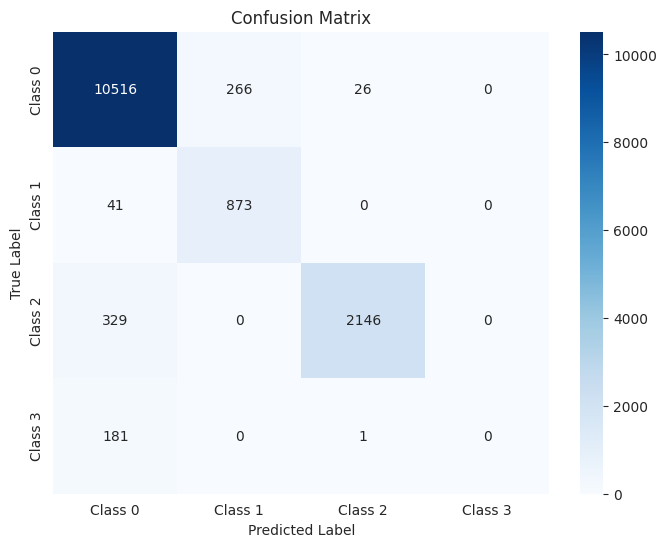

The function took 0.7234 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.98      0.96      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.98      0.88      0.93       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.94      3595
   macro avg       0.68      0.70      0.69      3595
weighted avg       0.93      0.94      0.94      3595



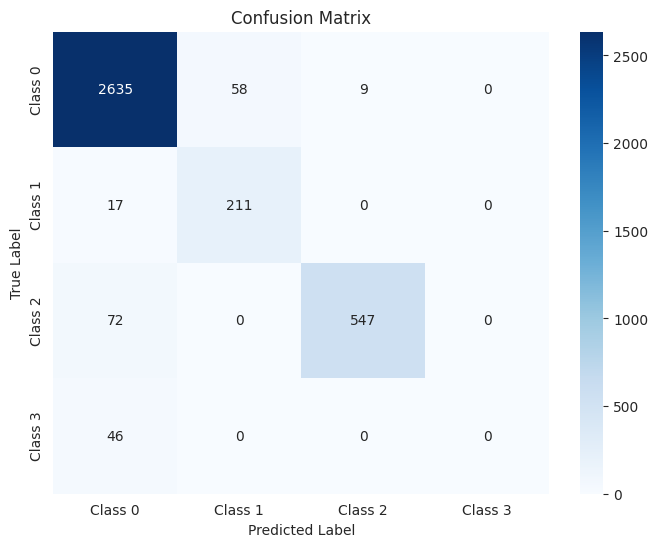

The function took 0.3664 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.97      0.96      3378
     Class 1       0.76      0.93      0.84       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.94      4494
   macro avg       0.67      0.69      0.68      4494
weighted avg       0.93      0.94      0.93      4494



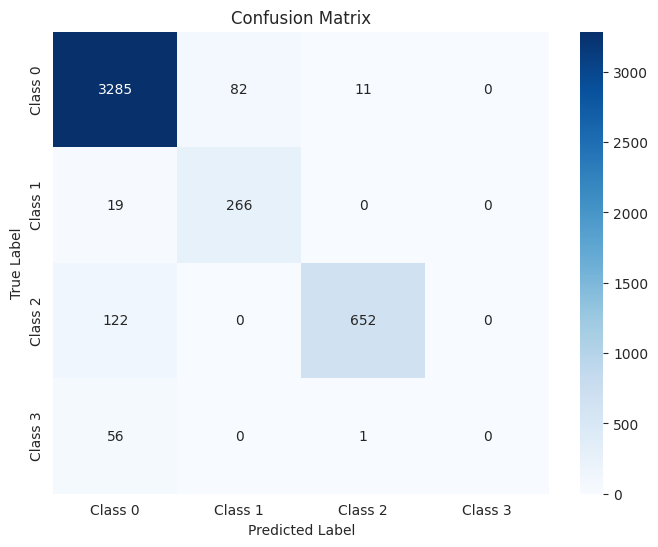

The function took 0.4162 seconds to execute.
[ARCH#156-[32, 16, 16, 16, 16]] done in 33.5s  best-val=0.2154


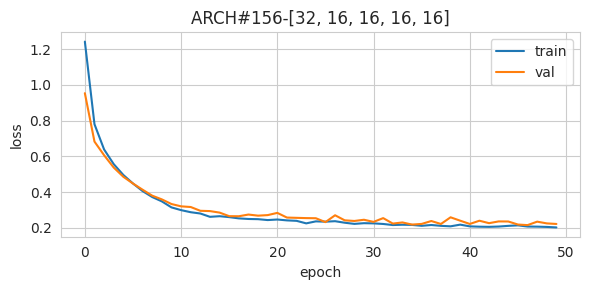


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.89      0.95      0.92      2475
     Class 3       0.34      0.88      0.49       182

    accuracy                           0.93     14379
   macro avg       0.74      0.93      0.80     14379
weighted avg       0.95      0.93      0.93     14379



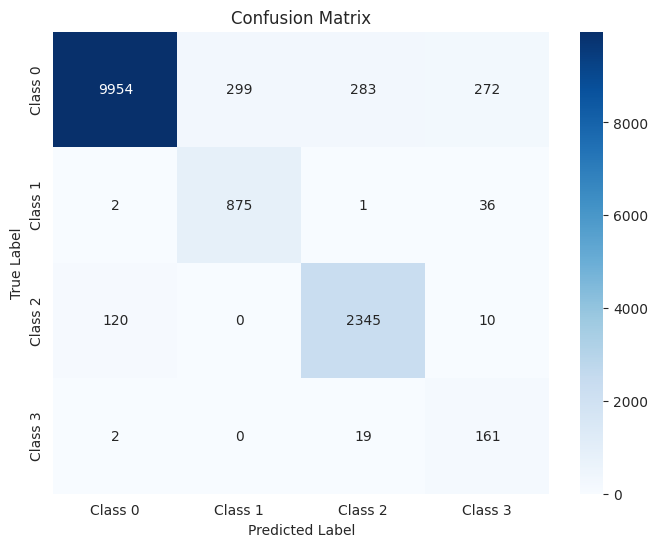

The function took 0.7022 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.87      0.96      0.91       619
     Class 3       0.32      0.87      0.47        46

    accuracy                           0.93      3595
   macro avg       0.74      0.92      0.79      3595
weighted avg       0.95      0.93      0.93      3595



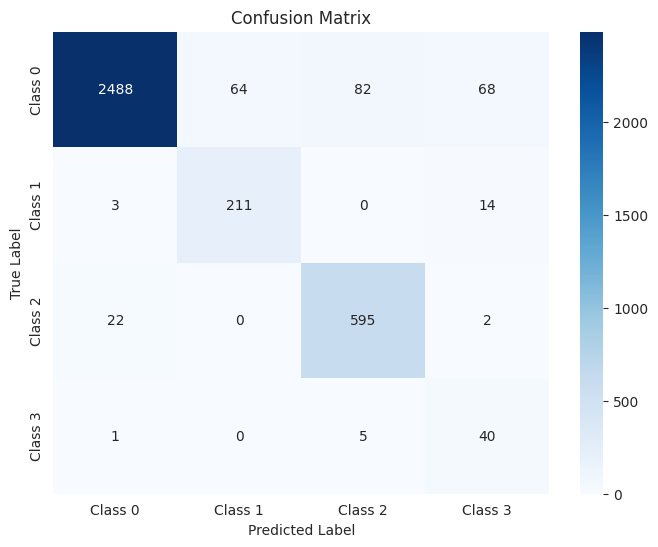

The function took 0.3802 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.89      0.93      0.91       774
     Class 3       0.32      0.86      0.46        57

    accuracy                           0.92      4494
   macro avg       0.74      0.91      0.79      4494
weighted avg       0.94      0.92      0.93      4494



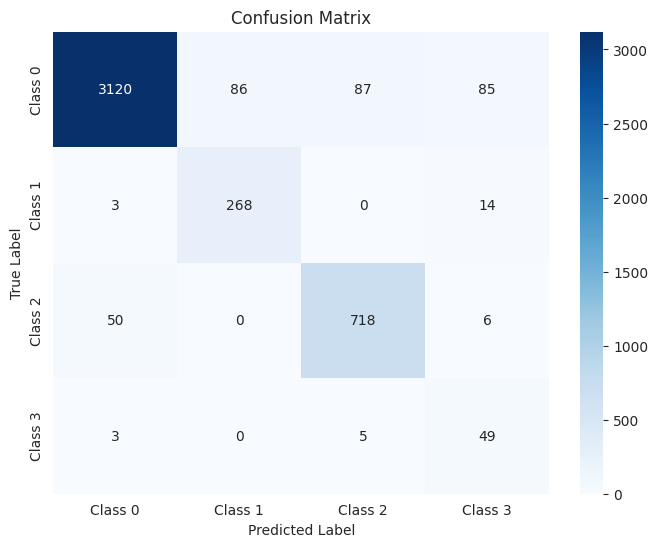

The function took 0.4798 seconds to execute.
[ARCH#157-[32, 16, 16, 16, 8]] done in 34.2s  best-val=0.2058


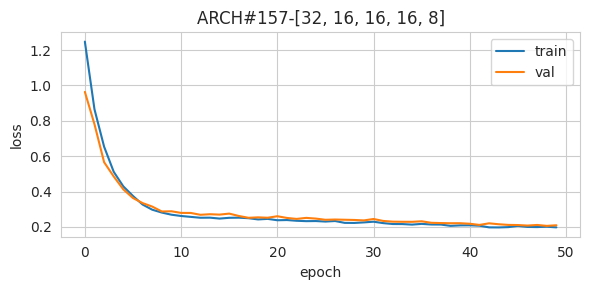


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.78      0.96      0.86       914
     Class 2       0.90      0.93      0.92      2475
     Class 3       0.29      0.92      0.44       182

    accuracy                           0.93     14379
   macro avg       0.74      0.93      0.79     14379
weighted avg       0.95      0.93      0.94     14379



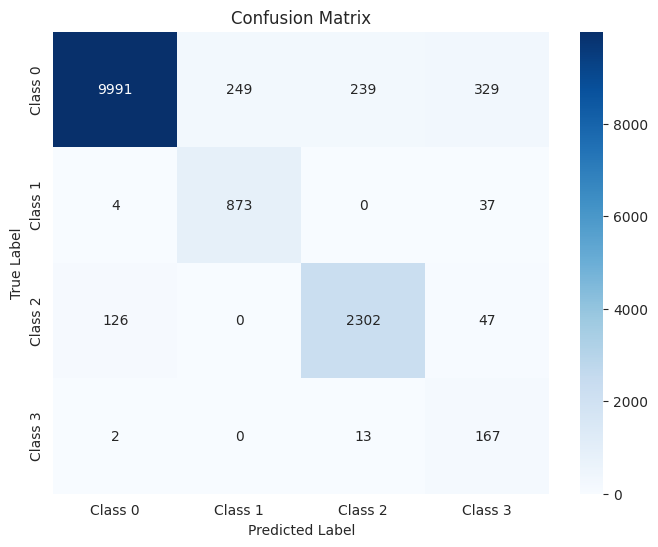

The function took 0.7206 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.80      0.93      0.86       228
     Class 2       0.90      0.95      0.92       619
     Class 3       0.28      0.91      0.42        46

    accuracy                           0.93      3595
   macro avg       0.74      0.93      0.79      3595
weighted avg       0.95      0.93      0.94      3595



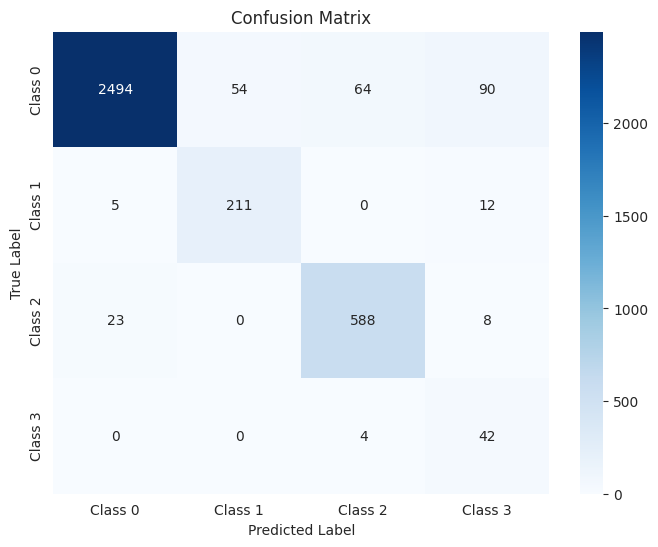

The function took 0.3560 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.78      0.93      0.85       285
     Class 2       0.91      0.92      0.92       774
     Class 3       0.30      0.88      0.45        57

    accuracy                           0.93      4494
   macro avg       0.74      0.92      0.79      4494
weighted avg       0.95      0.93      0.94      4494



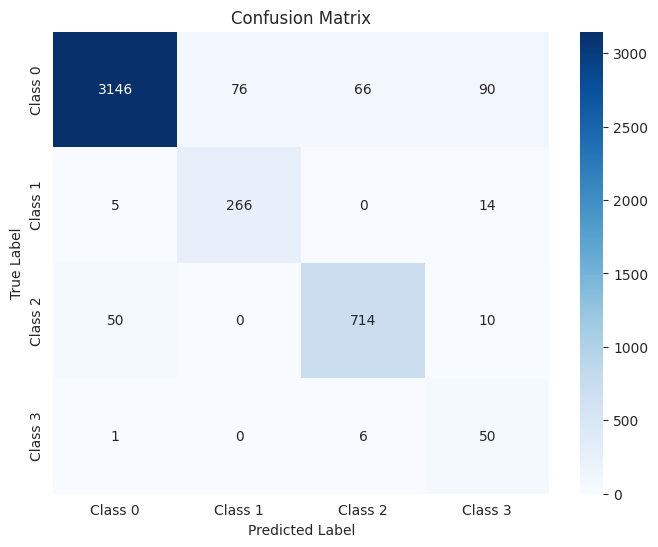

The function took 0.7737 seconds to execute.
[ARCH#158-[32, 16, 16, 16, 4]] done in 34.5s  best-val=0.2315


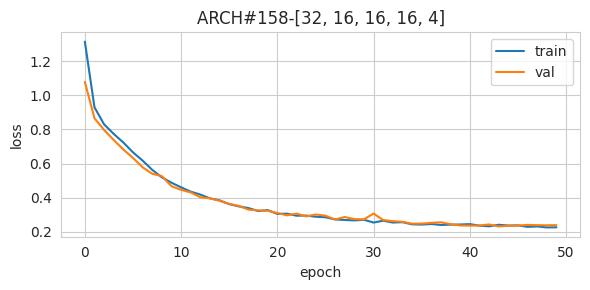


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.95      0.90      0.92      2475
     Class 3       0.33      0.88      0.48       182

    accuracy                           0.93     14379
   macro avg       0.75      0.92      0.80     14379
weighted avg       0.95      0.93      0.94     14379



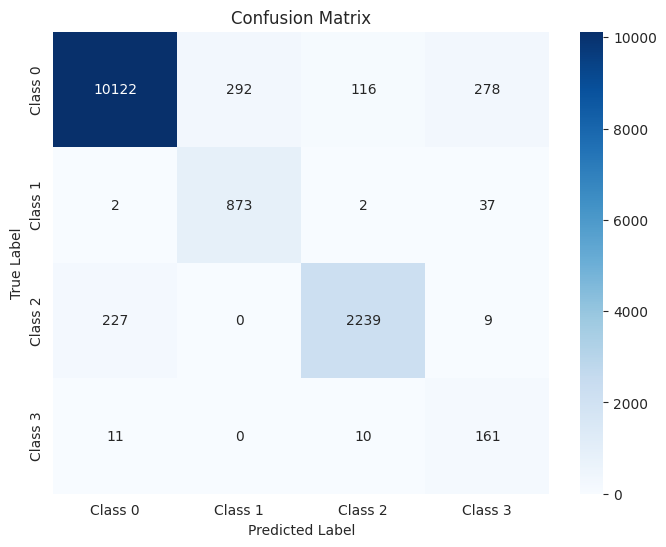

The function took 0.7581 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.94      0.91      0.93       619
     Class 3       0.31      0.89      0.46        46

    accuracy                           0.93      3595
   macro avg       0.75      0.92      0.80      3595
weighted avg       0.95      0.93      0.94      3595



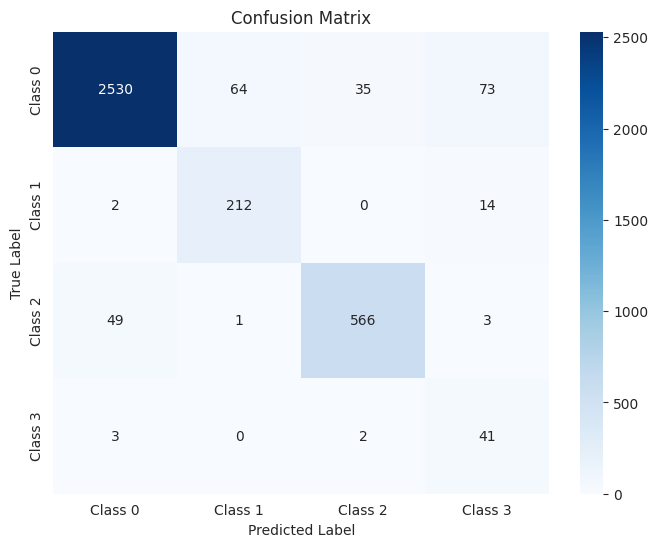

The function took 0.3981 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.93      0.88      0.90       774
     Class 3       0.34      0.88      0.49        57

    accuracy                           0.93      4494
   macro avg       0.74      0.91      0.79      4494
weighted avg       0.94      0.93      0.93      4494



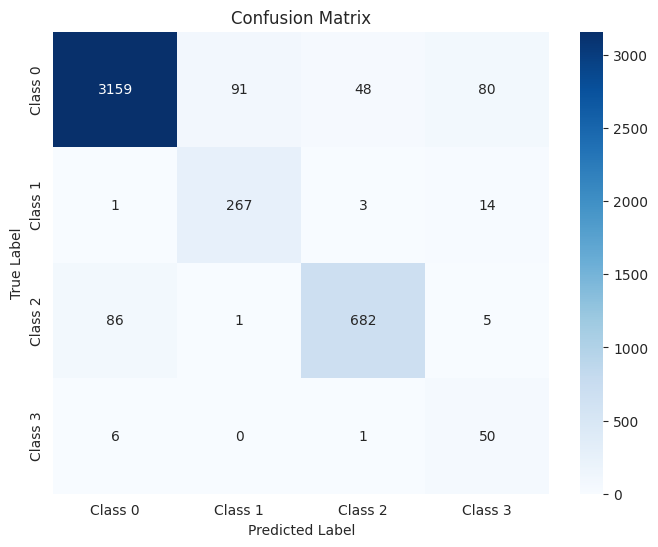

The function took 0.4193 seconds to execute.
[ARCH#159-[32, 16, 16, 16, 2]] done in 33.6s  best-val=0.2968


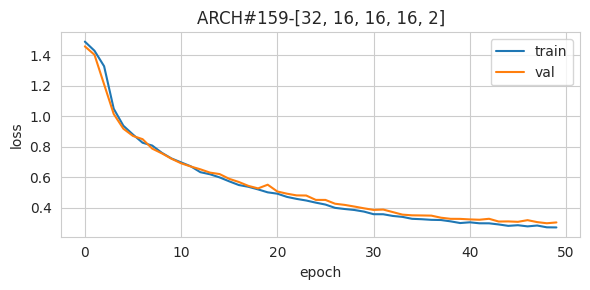


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.70      0.96      0.81       914
     Class 2       0.91      0.94      0.92      2475
     Class 3       0.21      0.98      0.35       182

    accuracy                           0.91     14379
   macro avg       0.70      0.94      0.76     14379
weighted avg       0.95      0.91      0.92     14379



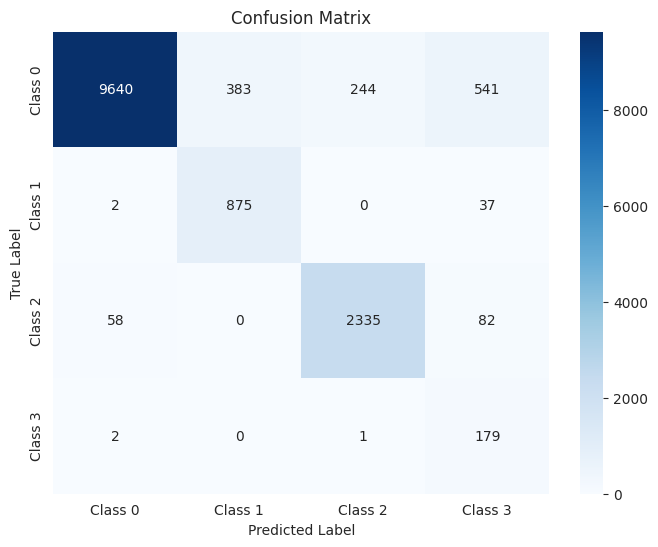

The function took 0.7880 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.72      0.93      0.81       228
     Class 2       0.90      0.94      0.92       619
     Class 3       0.21      0.93      0.34        46

    accuracy                           0.91      3595
   macro avg       0.70      0.93      0.75      3595
weighted avg       0.95      0.91      0.92      3595



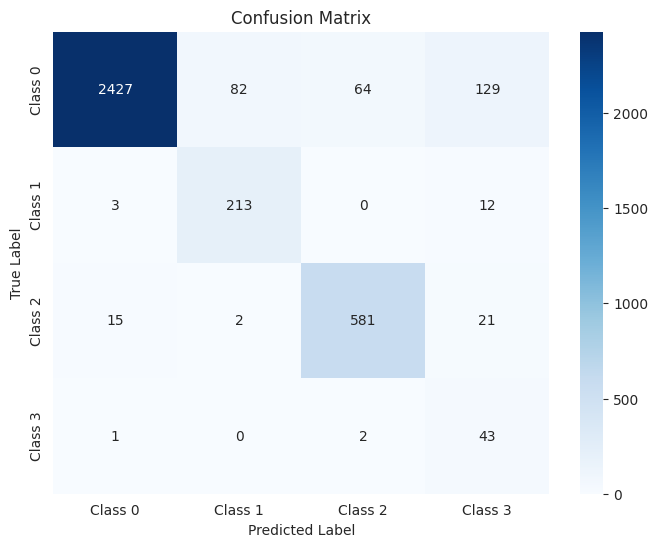

The function took 0.4299 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.71      0.93      0.80       285
     Class 2       0.89      0.94      0.92       774
     Class 3       0.21      0.91      0.34        57

    accuracy                           0.91      4494
   macro avg       0.70      0.92      0.75      4494
weighted avg       0.95      0.91      0.92      4494



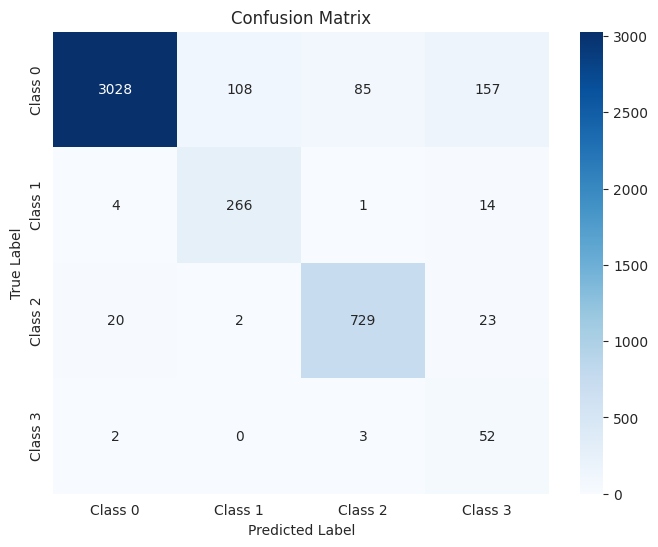

The function took 0.5047 seconds to execute.
[ARCH#160-[32, 16, 16, 8, 8]] done in 34.4s  best-val=0.2732


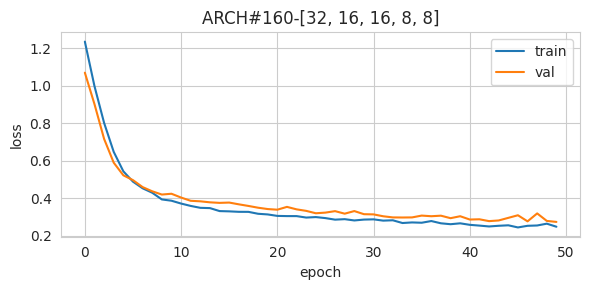


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.19      0.98      0.32       182

    accuracy                           0.91     14379
   macro avg       0.73      0.93      0.76     14379
weighted avg       0.96      0.91      0.93     14379



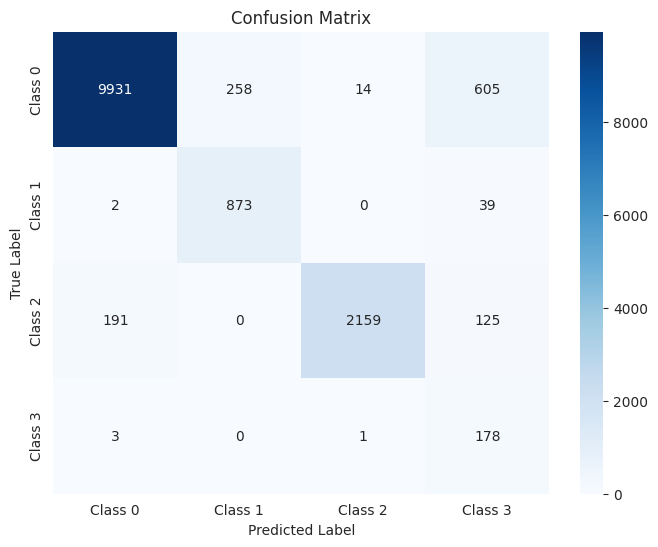

The function took 0.7331 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.17      0.98      0.29        46

    accuracy                           0.91      3595
   macro avg       0.73      0.93      0.76      3595
weighted avg       0.96      0.91      0.93      3595



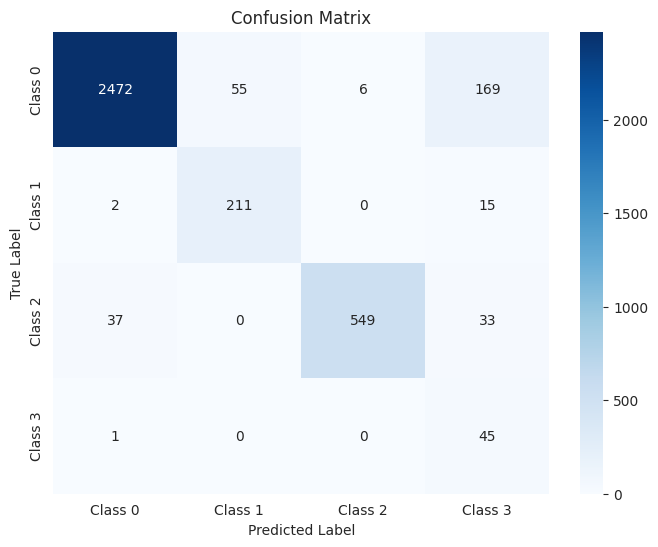

The function took 0.3672 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95      3378
     Class 1       0.78      0.93      0.85       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.20      0.95      0.33        57

    accuracy                           0.91      4494
   macro avg       0.73      0.91      0.76      4494
weighted avg       0.95      0.91      0.93      4494



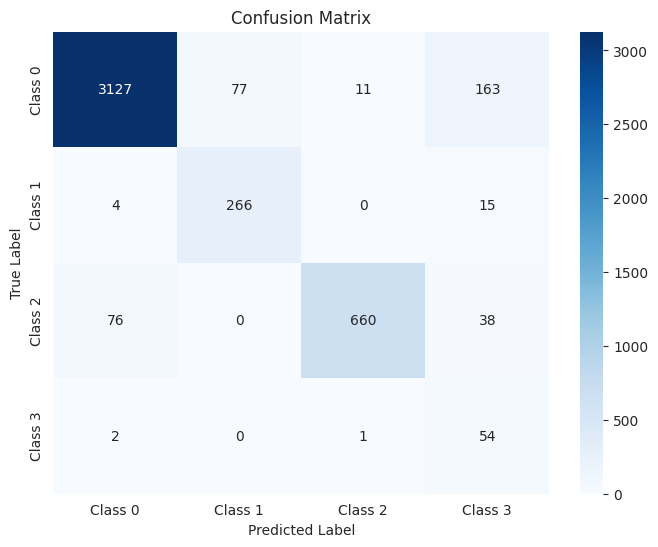

The function took 0.4245 seconds to execute.
[ARCH#161-[32, 16, 16, 8, 4]] done in 34.7s  best-val=0.2375


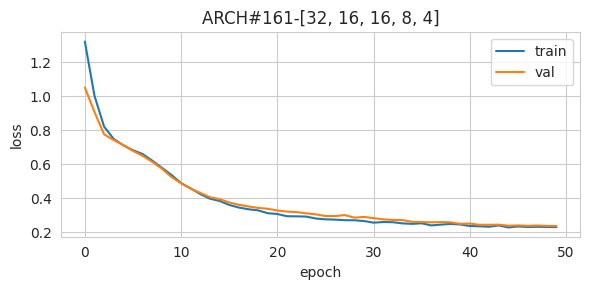


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.76      0.96      0.84       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.20      0.99      0.33       182

    accuracy                           0.92     14379
   macro avg       0.73      0.94      0.77     14379
weighted avg       0.96      0.92      0.94     14379



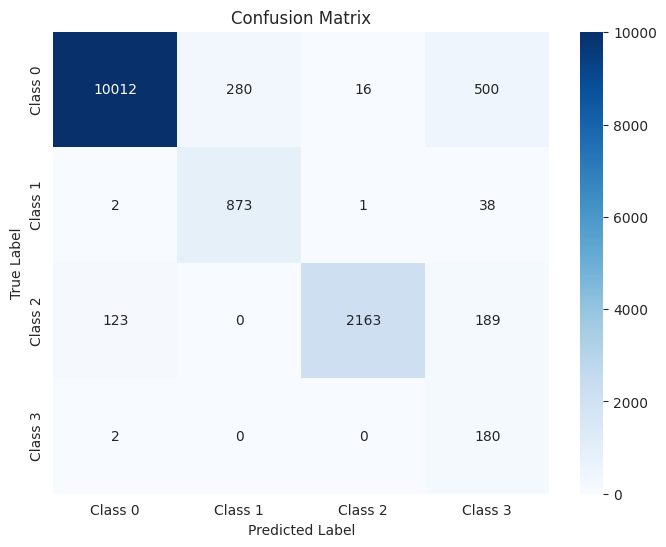

The function took 0.7440 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.20      1.00      0.33        46

    accuracy                           0.92      3595
   macro avg       0.74      0.94      0.77      3595
weighted avg       0.97      0.92      0.94      3595



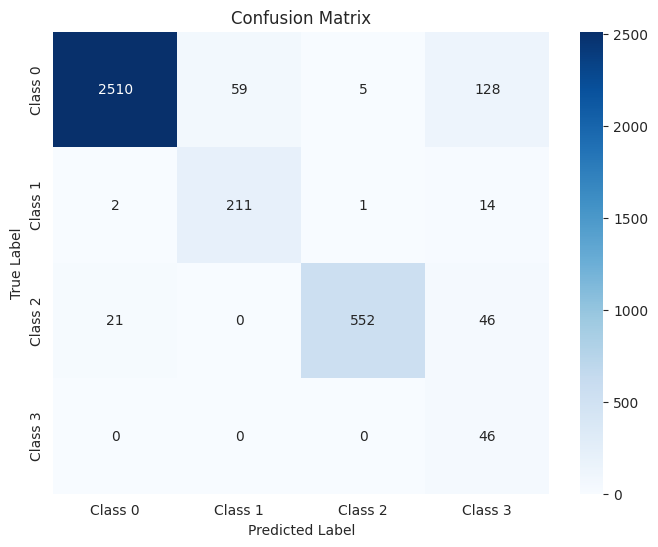

The function took 0.3822 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.20      0.98      0.33        57

    accuracy                           0.92      4494
   macro avg       0.73      0.93      0.76      4494
weighted avg       0.96      0.92      0.93      4494



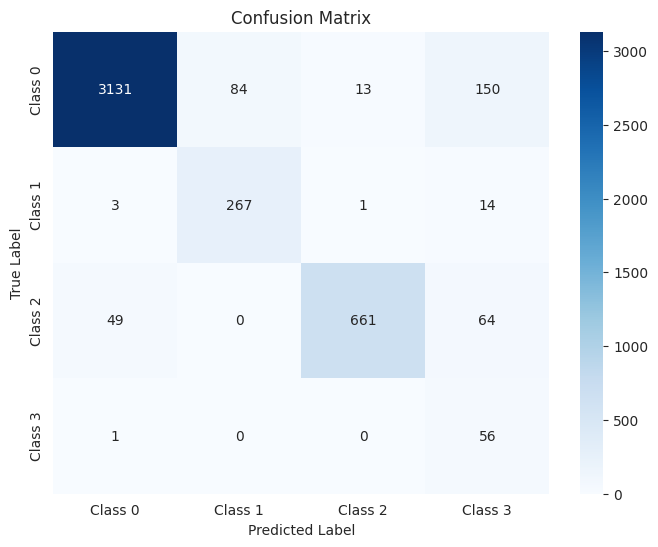

The function took 0.4093 seconds to execute.
[ARCH#162-[32, 16, 16, 8, 2]] done in 33.7s  best-val=0.4962


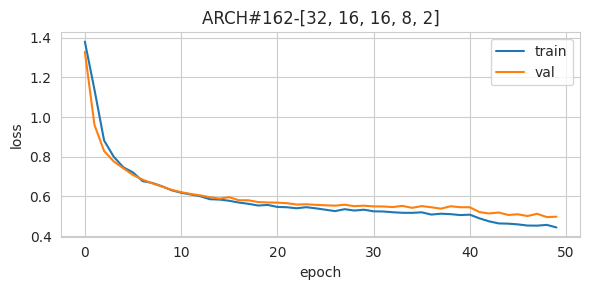


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.94     10808
     Class 1       0.78      0.86      0.82       914
     Class 2       0.76      0.98      0.85      2475
     Class 3       0.40      0.85      0.54       182

    accuracy                           0.90     14379
   macro avg       0.73      0.89      0.79     14379
weighted avg       0.92      0.90      0.91     14379



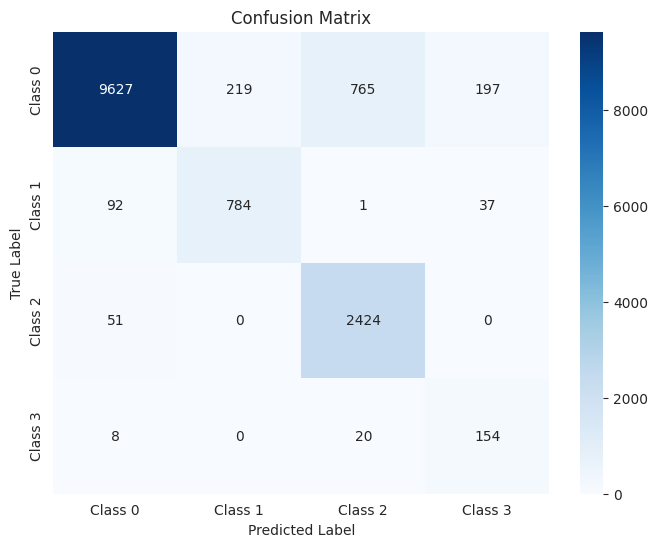

The function took 0.7820 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.93      2702
     Class 1       0.81      0.81      0.81       228
     Class 2       0.75      0.98      0.85       619
     Class 3       0.34      0.74      0.47        46

    accuracy                           0.90      3595
   macro avg       0.72      0.86      0.77      3595
weighted avg       0.92      0.90      0.91      3595



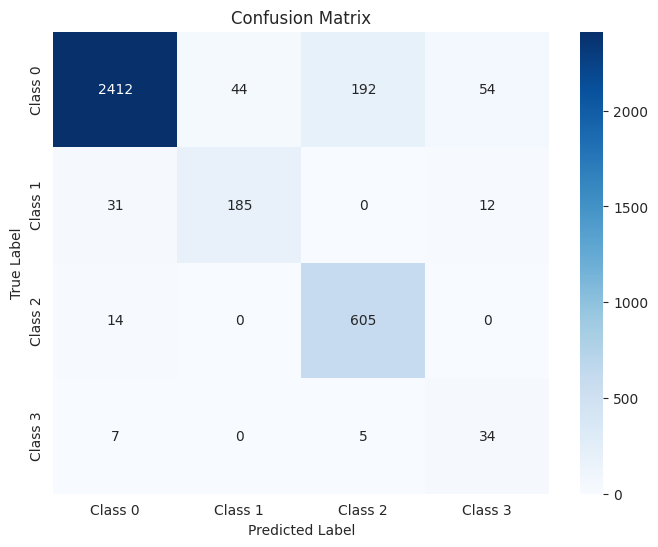

The function took 0.4427 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.90      0.94      3378
     Class 1       0.80      0.84      0.82       285
     Class 2       0.76      0.97      0.85       774
     Class 3       0.38      0.79      0.52        57

    accuracy                           0.90      4494
   macro avg       0.73      0.87      0.78      4494
weighted avg       0.92      0.90      0.91      4494



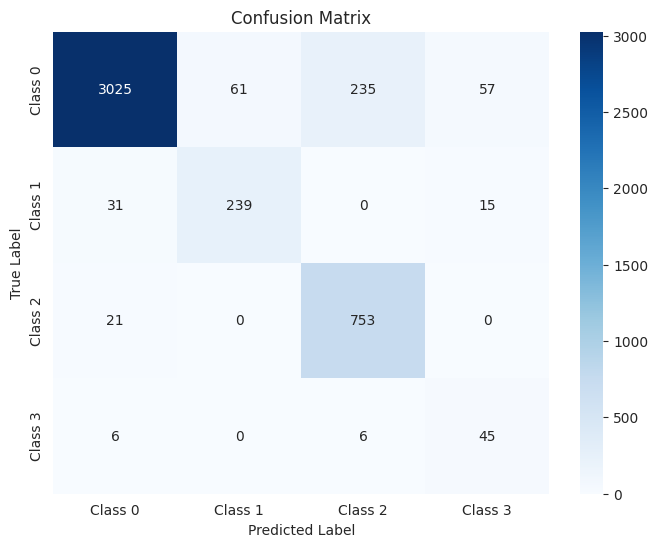

The function took 0.4502 seconds to execute.
[ARCH#163-[32, 16, 16, 4, 4]] done in 34.3s  best-val=0.2823


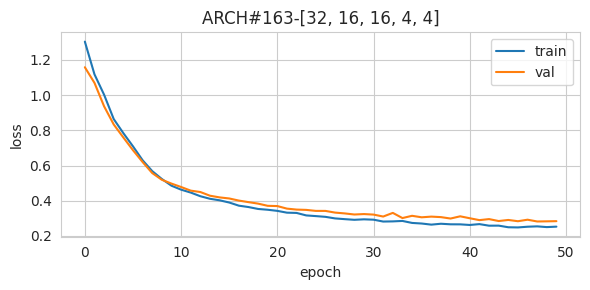


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.74      0.96      0.84       914
     Class 2       0.90      0.91      0.91      2475
     Class 3       0.25      0.90      0.39       182

    accuracy                           0.92     14379
   macro avg       0.72      0.92      0.77     14379
weighted avg       0.95      0.92      0.93     14379



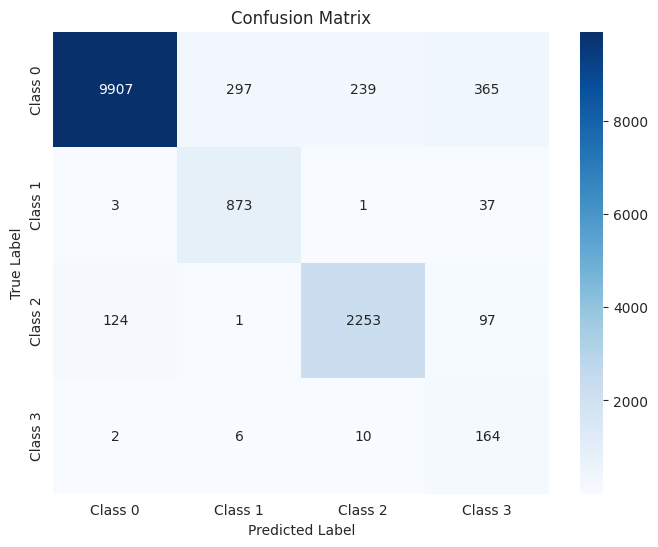

The function took 0.7131 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.78      0.93      0.84       228
     Class 2       0.90      0.93      0.92       619
     Class 3       0.23      0.89      0.37        46

    accuracy                           0.92      3595
   macro avg       0.72      0.92      0.77      3595
weighted avg       0.95      0.92      0.93      3595



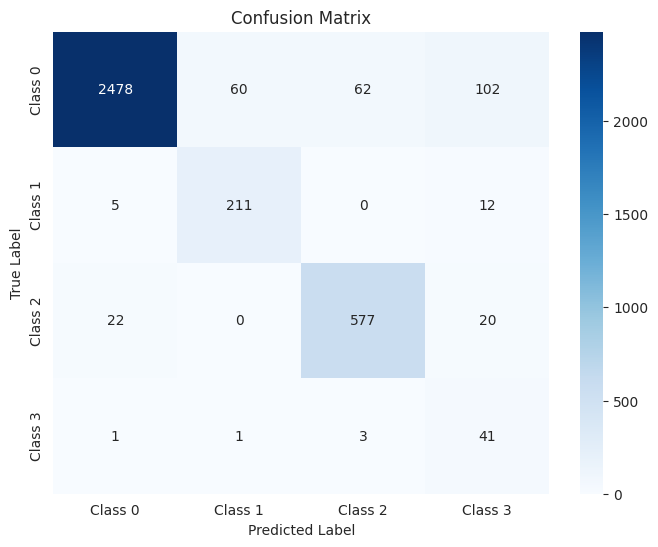

The function took 0.3560 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.74      0.93      0.83       285
     Class 2       0.90      0.90      0.90       774
     Class 3       0.25      0.82      0.38        57

    accuracy                           0.92      4494
   macro avg       0.72      0.89      0.76      4494
weighted avg       0.94      0.92      0.93      4494



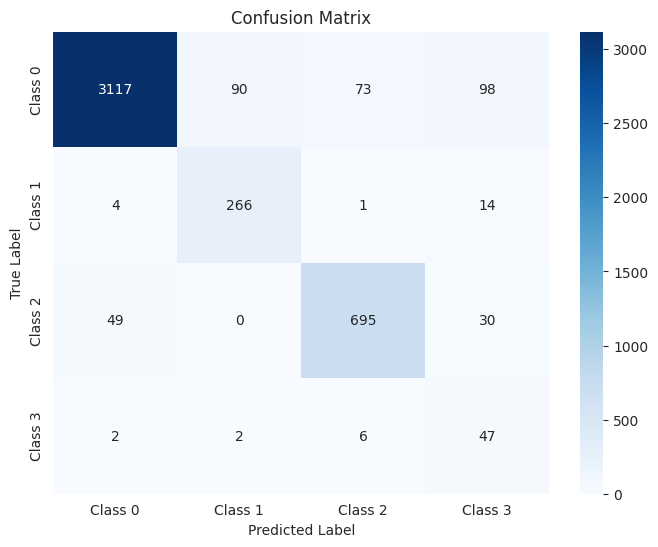

The function took 0.4094 seconds to execute.
[ARCH#164-[32, 16, 16, 4, 2]] done in 34.3s  best-val=0.4579


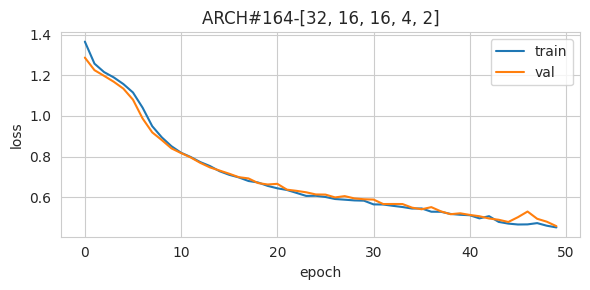


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90     10808
     Class 1       0.66      0.96      0.78       914
     Class 2       0.74      0.99      0.85      2475
     Class 3       0.17      0.82      0.28       182

    accuracy                           0.86     14379
   macro avg       0.64      0.90      0.70     14379
weighted avg       0.92      0.86      0.88     14379



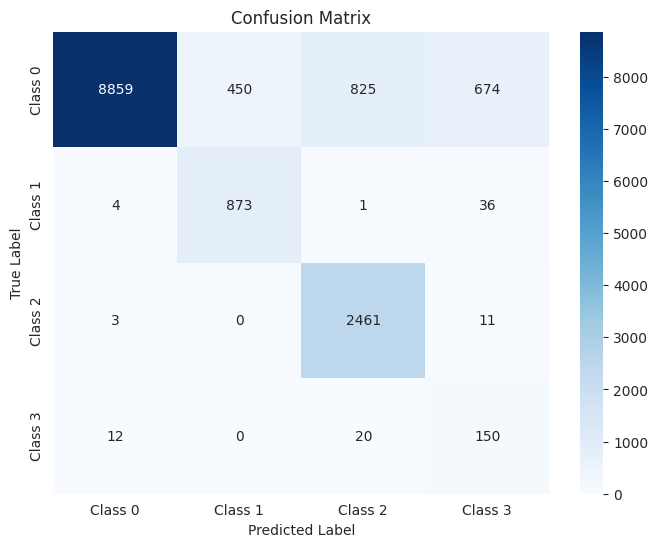

The function took 0.7730 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90      2702
     Class 1       0.68      0.93      0.78       228
     Class 2       0.76      0.99      0.86       619
     Class 3       0.15      0.78      0.24        46

    accuracy                           0.86      3595
   macro avg       0.64      0.88      0.70      3595
weighted avg       0.92      0.86      0.88      3595



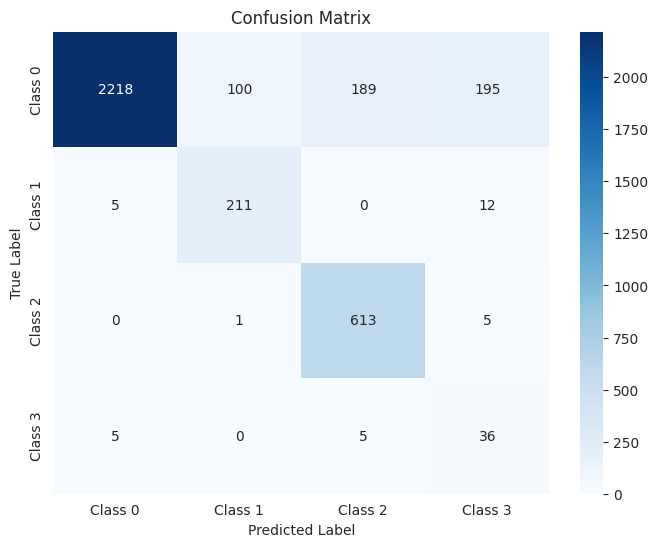

The function took 0.4047 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90      3378
     Class 1       0.65      0.93      0.76       285
     Class 2       0.75      0.99      0.85       774
     Class 3       0.17      0.81      0.28        57

    accuracy                           0.86      4494
   macro avg       0.64      0.89      0.70      4494
weighted avg       0.92      0.86      0.88      4494



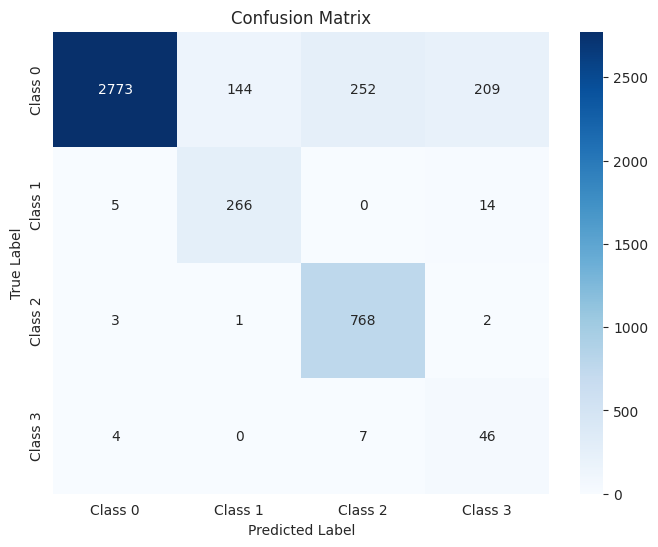

The function took 0.4119 seconds to execute.
[ARCH#165-[32, 16, 16, 2, 2]] done in 33.3s  best-val=0.4792


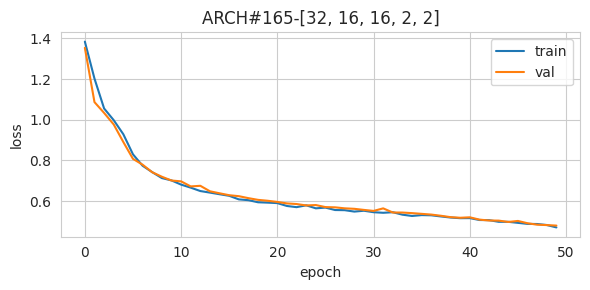


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.87      0.92     10808
     Class 1       0.74      0.91      0.81       914
     Class 2       0.86      0.93      0.89      2475
     Class 3       0.16      0.86      0.27       182

    accuracy                           0.88     14379
   macro avg       0.68      0.89      0.73     14379
weighted avg       0.93      0.88      0.90     14379



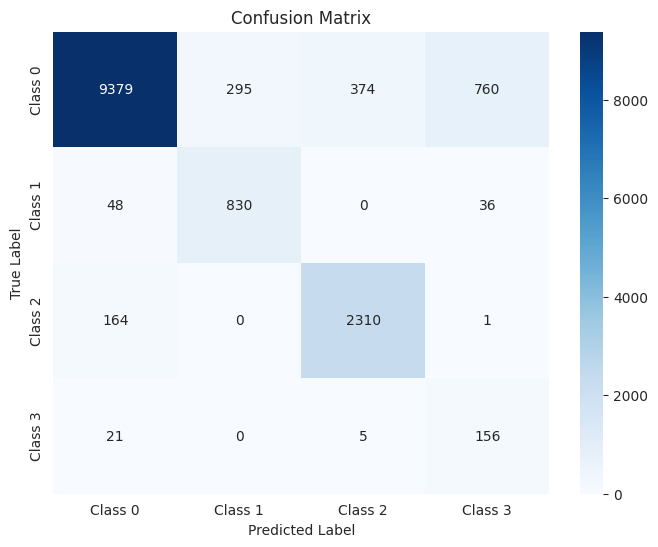

The function took 0.7622 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.86      0.92      2702
     Class 1       0.77      0.87      0.82       228
     Class 2       0.85      0.95      0.89       619
     Class 3       0.16      0.87      0.27        46

    accuracy                           0.88      3595
   macro avg       0.69      0.89      0.72      3595
weighted avg       0.93      0.88      0.90      3595



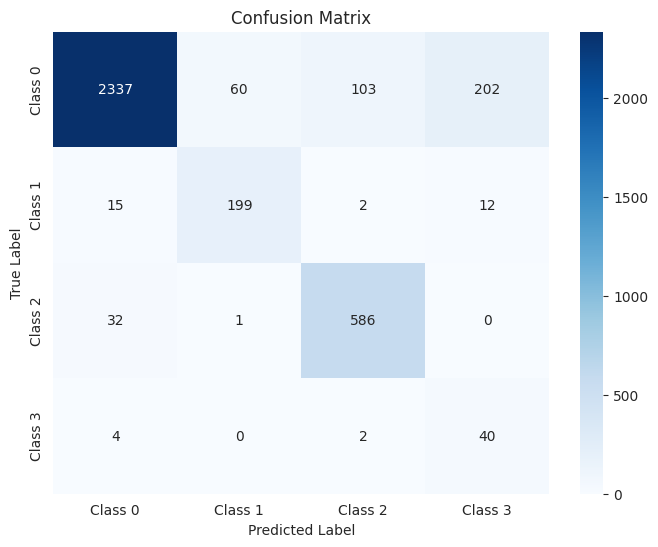

The function took 0.3638 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.86      0.91      3378
     Class 1       0.75      0.89      0.81       285
     Class 2       0.83      0.94      0.88       774
     Class 3       0.15      0.81      0.25        57

    accuracy                           0.87      4494
   macro avg       0.67      0.87      0.71      4494
weighted avg       0.93      0.87      0.89      4494



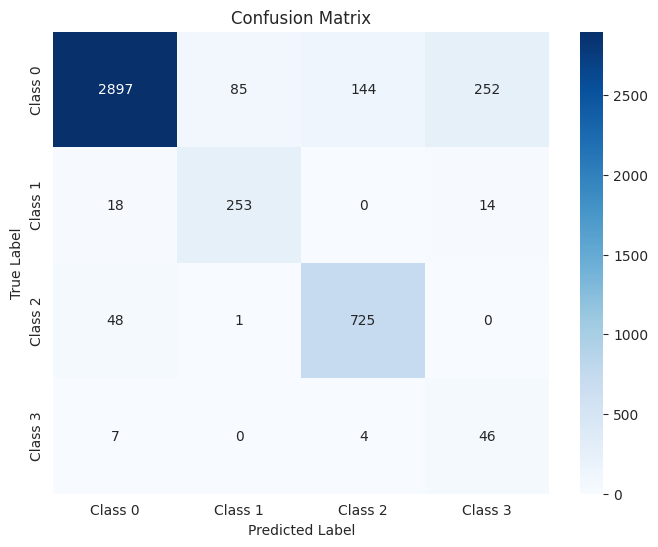

The function took 0.4606 seconds to execute.
[ARCH#166-[32, 16, 8, 8, 8]] done in 34.1s  best-val=0.2824


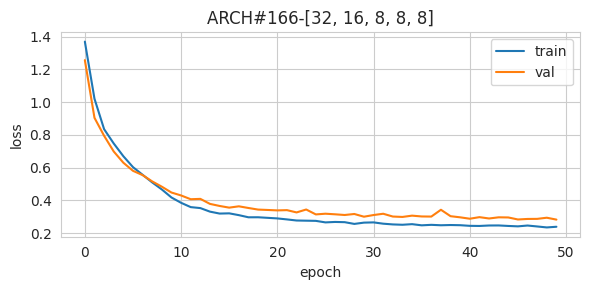


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.98      0.88      0.93      2475
     Class 3       0.35      0.88      0.50       182

    accuracy                           0.94     14379
   macro avg       0.77      0.91      0.81     14379
weighted avg       0.95      0.94      0.94     14379



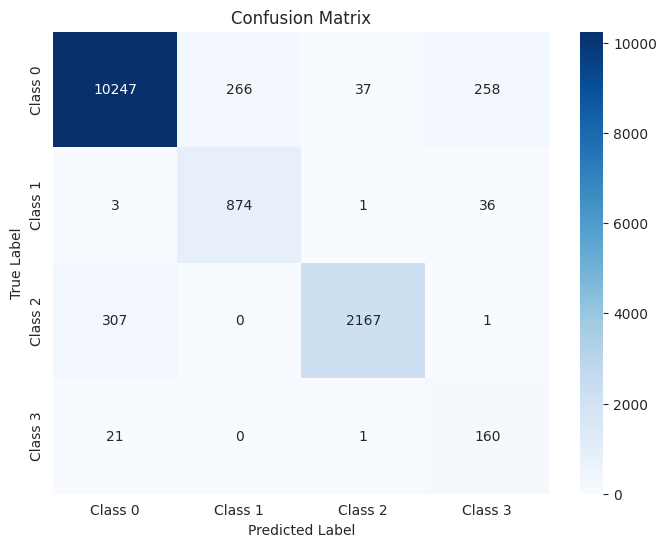

The function took 0.6914 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.31      0.87      0.45        46

    accuracy                           0.93      3595
   macro avg       0.76      0.91      0.80      3595
weighted avg       0.95      0.93      0.94      3595



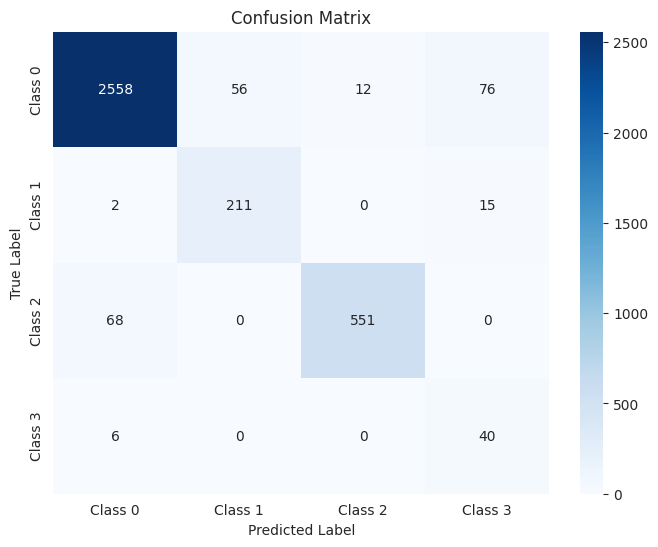

The function took 0.3714 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.95      0.95      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.97      0.86      0.91       774
     Class 3       0.34      0.86      0.49        57

    accuracy                           0.93      4494
   macro avg       0.76      0.90      0.80      4494
weighted avg       0.94      0.93      0.93      4494



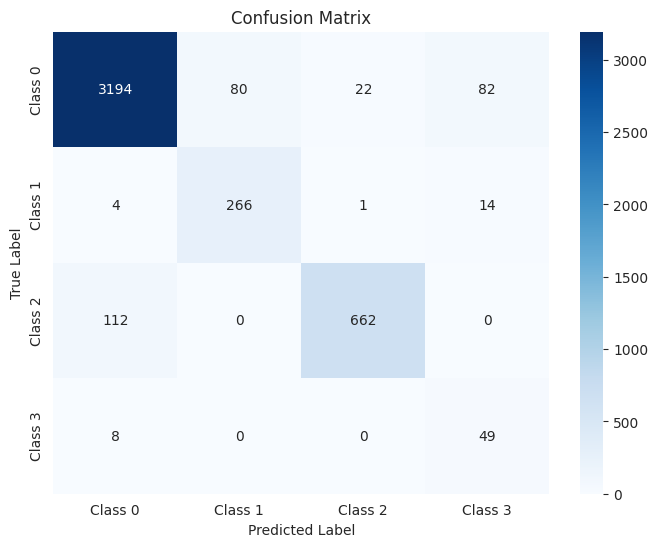

The function took 0.4078 seconds to execute.
[ARCH#167-[32, 16, 8, 8, 4]] done in 34.5s  best-val=0.2711


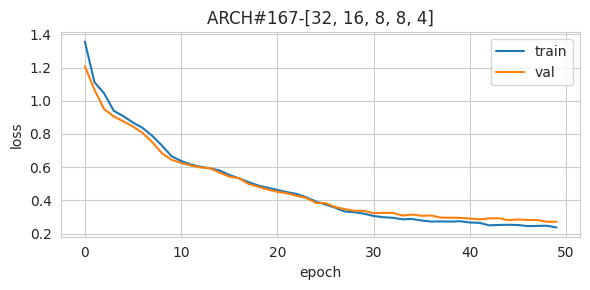


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95     10808
     Class 1       0.77      0.95      0.85       914
     Class 2       1.00      0.87      0.93      2475
     Class 3       0.19      0.98      0.31       182

    accuracy                           0.91     14379
   macro avg       0.73      0.93      0.76     14379
weighted avg       0.96      0.91      0.93     14379



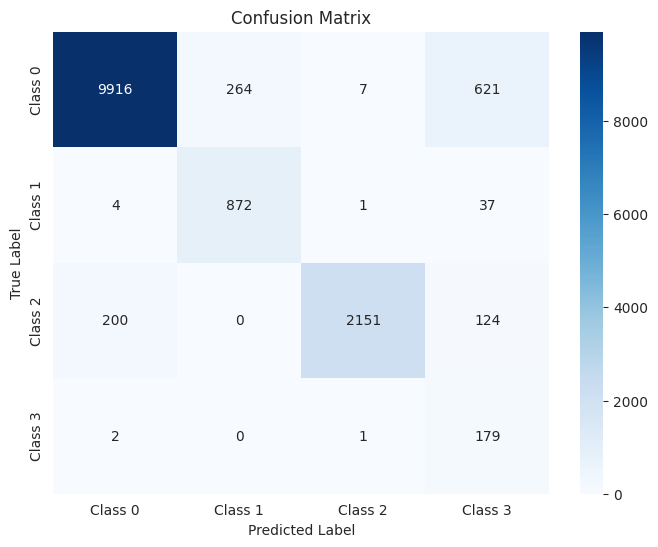

The function took 0.7395 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.17      0.96      0.29        46

    accuracy                           0.91      3595
   macro avg       0.73      0.92      0.76      3595
weighted avg       0.96      0.91      0.93      3595



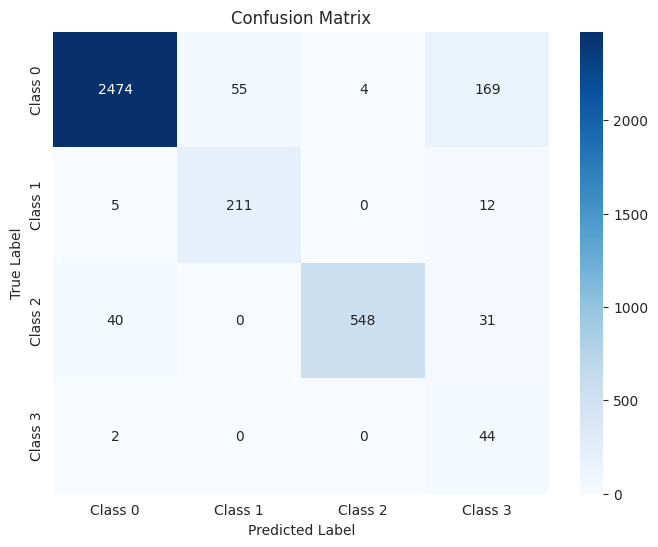

The function took 0.3793 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.92      0.95      3378
     Class 1       0.76      0.93      0.84       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.18      0.88      0.30        57

    accuracy                           0.91      4494
   macro avg       0.72      0.89      0.75      4494
weighted avg       0.95      0.91      0.92      4494



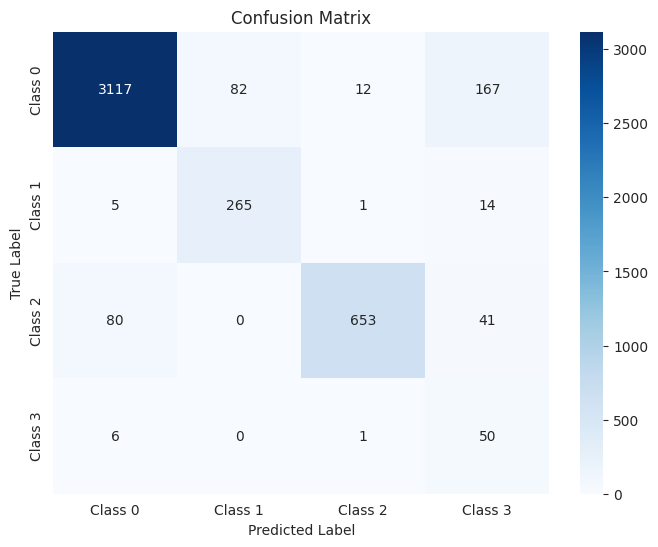

The function took 0.4042 seconds to execute.
[ARCH#168-[32, 16, 8, 8, 2]] done in 33.5s  best-val=1.3794


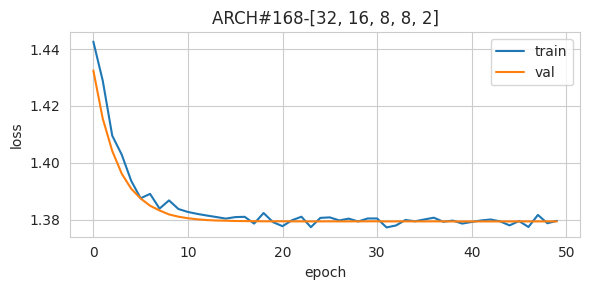


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



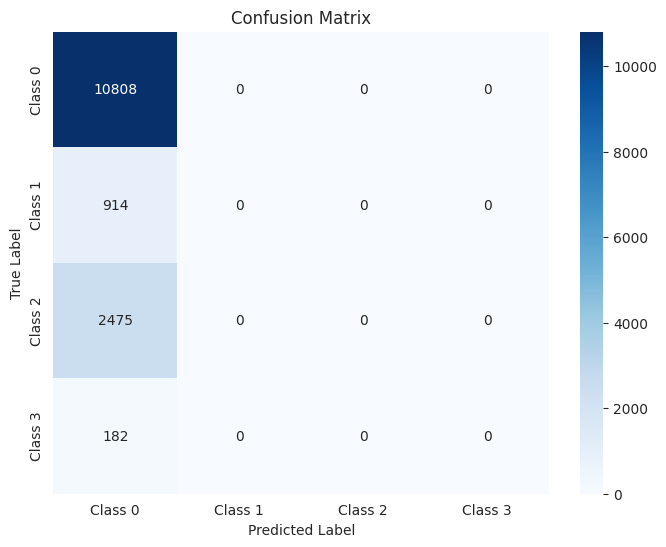

The function took 0.7031 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



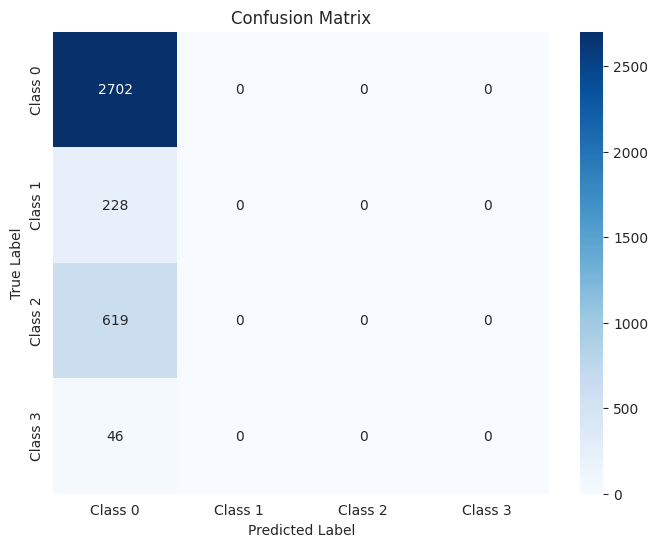

The function took 0.3903 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



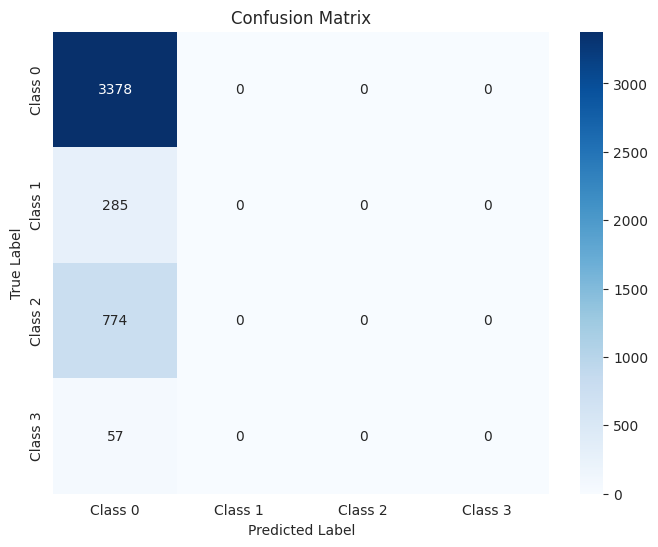

The function took 0.4941 seconds to execute.
[ARCH#169-[32, 16, 8, 4, 4]] done in 34.5s  best-val=0.2798


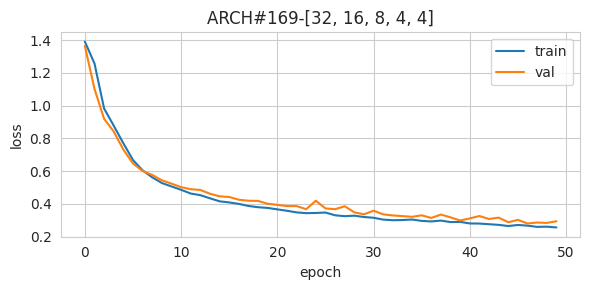


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94     10808
     Class 1       0.73      0.86      0.79       914
     Class 2       0.83      0.95      0.89      2475
     Class 3       0.34      0.88      0.49       182

    accuracy                           0.91     14379
   macro avg       0.72      0.90      0.78     14379
weighted avg       0.93      0.91      0.92     14379



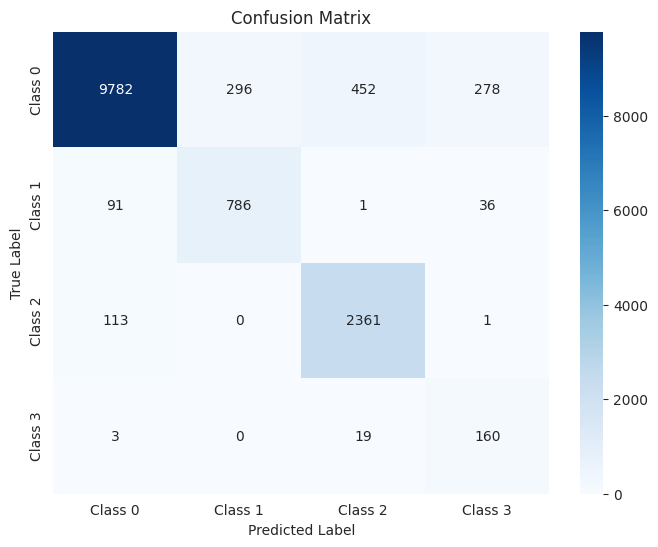

The function took 0.7476 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94      2702
     Class 1       0.74      0.81      0.77       228
     Class 2       0.83      0.97      0.90       619
     Class 3       0.31      0.85      0.46        46

    accuracy                           0.91      3595
   macro avg       0.72      0.88      0.77      3595
weighted avg       0.93      0.91      0.92      3595



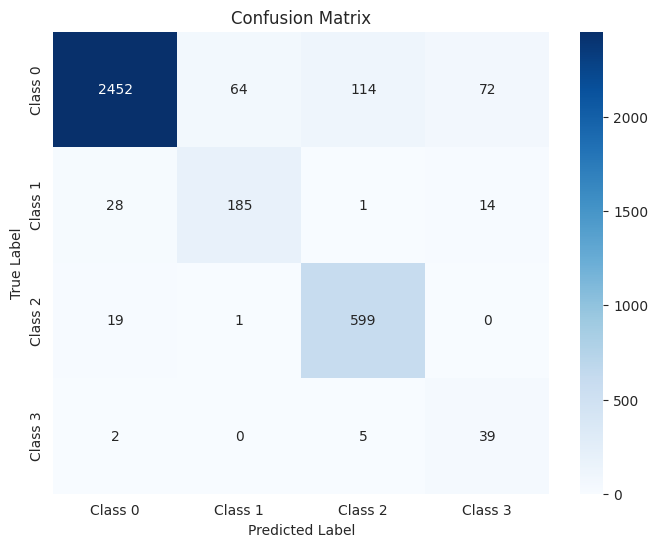

The function took 0.3611 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94      3378
     Class 1       0.73      0.84      0.78       285
     Class 2       0.84      0.94      0.89       774
     Class 3       0.34      0.86      0.49        57

    accuracy                           0.91      4494
   macro avg       0.72      0.89      0.77      4494
weighted avg       0.93      0.91      0.92      4494



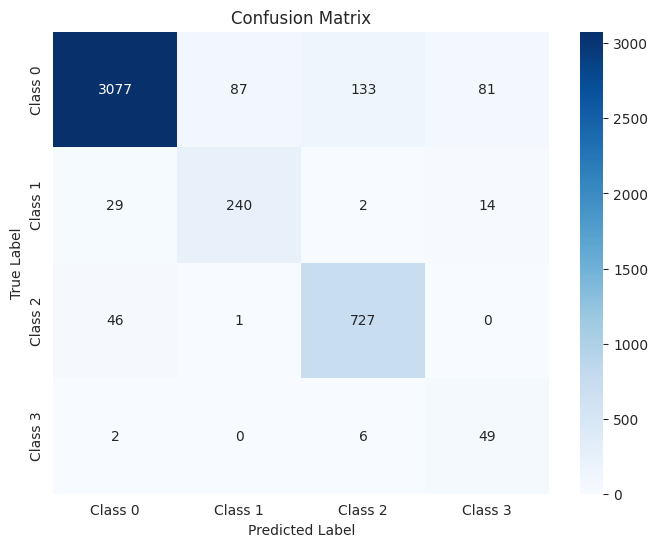

The function took 0.4371 seconds to execute.
[ARCH#170-[32, 16, 8, 4, 2]] done in 35.1s  best-val=0.2654


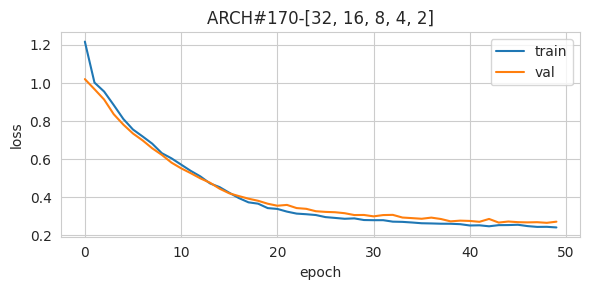


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.92      0.95      0.93      2475
     Class 3       0.34      0.88      0.49       182

    accuracy                           0.94     14379
   macro avg       0.75      0.93      0.81     14379
weighted avg       0.95      0.94      0.94     14379



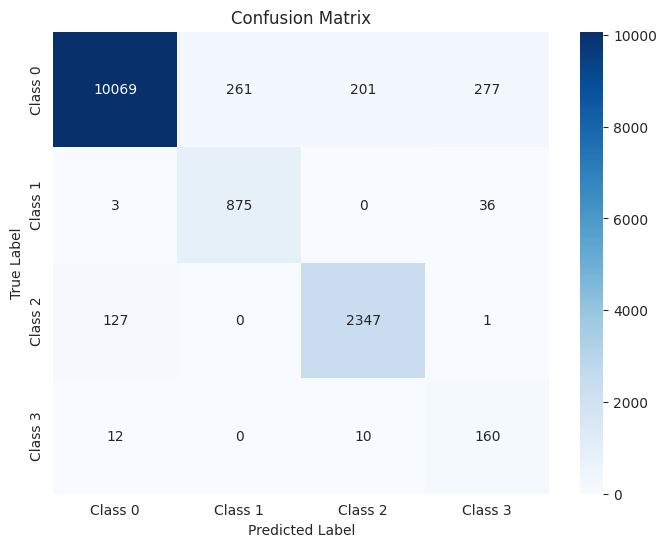

The function took 0.7489 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.90      0.97      0.93       619
     Class 3       0.30      0.87      0.45        46

    accuracy                           0.93      3595
   macro avg       0.74      0.92      0.80      3595
weighted avg       0.95      0.93      0.94      3595



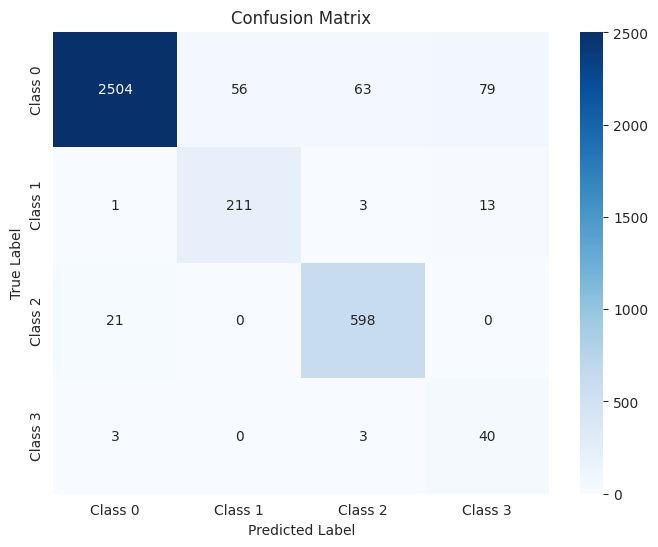

The function took 0.4300 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.77      0.94      0.85       285
     Class 2       0.90      0.94      0.92       774
     Class 3       0.35      0.86      0.49        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.80      4494
weighted avg       0.95      0.93      0.94      4494



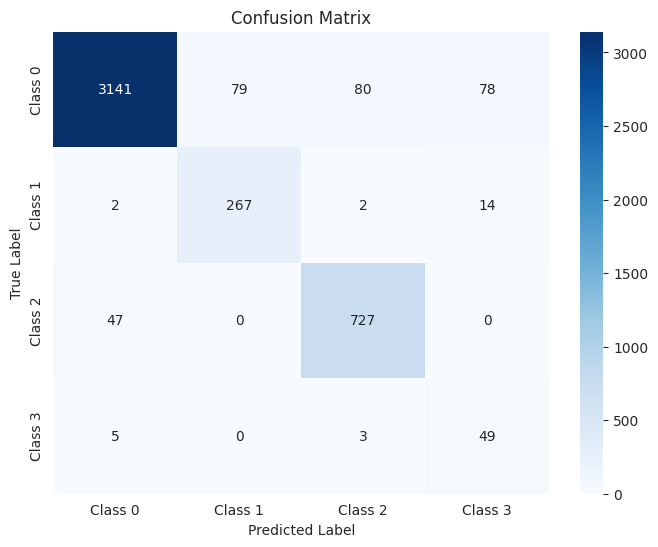

The function took 0.4410 seconds to execute.
[ARCH#171-[32, 16, 8, 2, 2]] done in 34.1s  best-val=0.3616


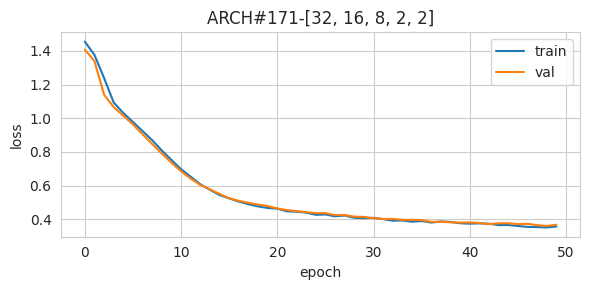


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.53      0.96      0.68       914
     Class 2       1.00      0.87      0.93      2475
     Class 3       0.20      0.88      0.32       182

    accuracy                           0.89     14379
   macro avg       0.68      0.90      0.72     14379
weighted avg       0.95      0.89      0.91     14379



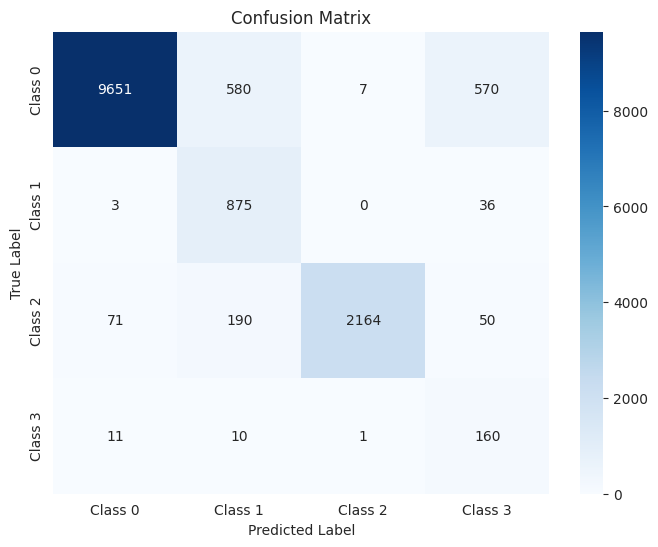

The function took 0.8727 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.53      0.93      0.68       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.20      0.89      0.32        46

    accuracy                           0.90      3595
   macro avg       0.68      0.90      0.72      3595
weighted avg       0.96      0.90      0.92      3595



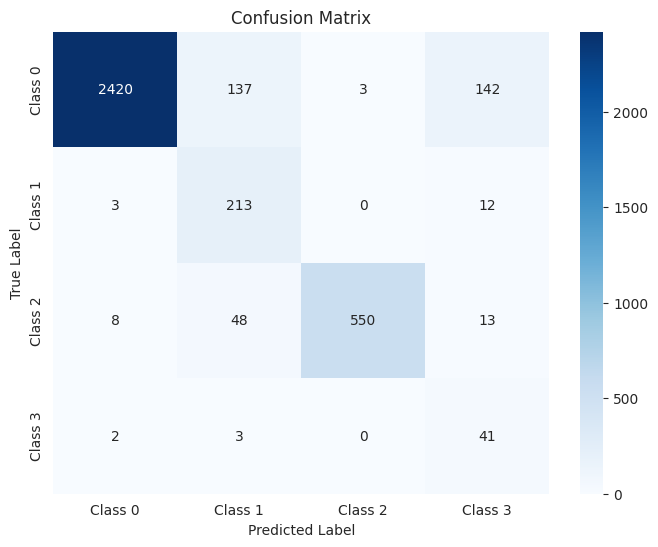

The function took 0.4113 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.52      0.93      0.67       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.19      0.88      0.31        57

    accuracy                           0.89      4494
   macro avg       0.67      0.89      0.71      4494
weighted avg       0.95      0.89      0.91      4494



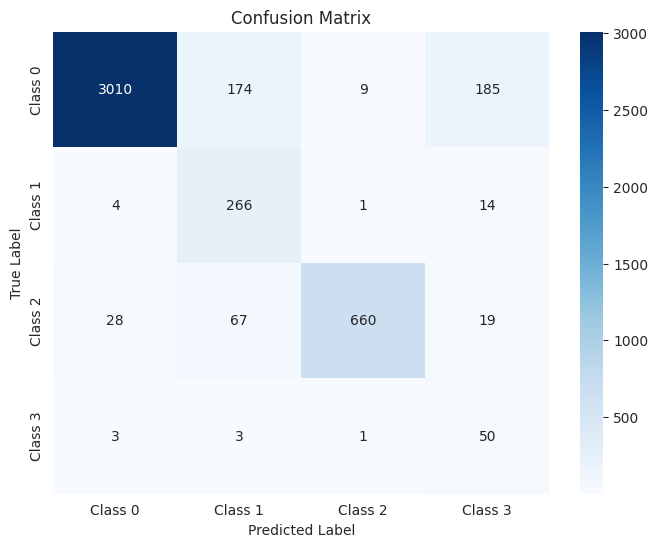

The function took 0.4296 seconds to execute.
[ARCH#172-[32, 16, 4, 4, 4]] done in 34.9s  best-val=0.2689


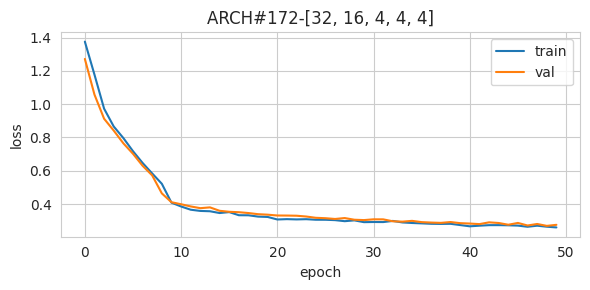


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.71      0.96      0.81       914
     Class 2       0.90      0.95      0.93      2475
     Class 3       0.25      0.88      0.39       182

    accuracy                           0.92     14379
   macro avg       0.71      0.92      0.77     14379
weighted avg       0.95      0.92      0.93     14379



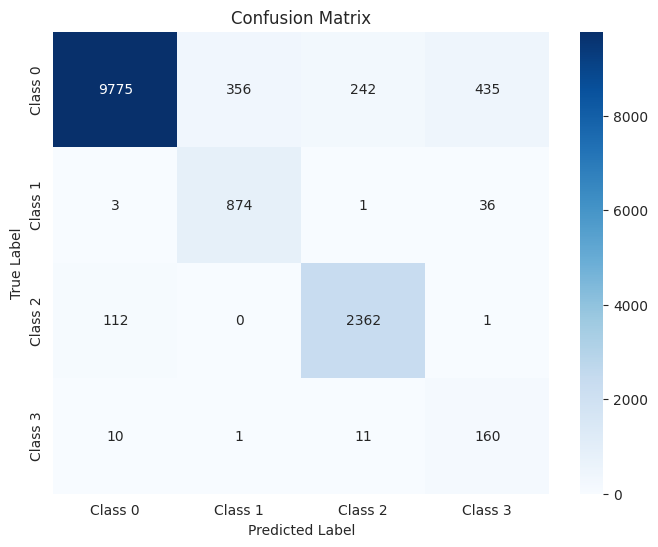

The function took 0.7540 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.72      0.93      0.81       228
     Class 2       0.89      0.97      0.93       619
     Class 3       0.25      0.89      0.39        46

    accuracy                           0.91      3595
   macro avg       0.71      0.92      0.77      3595
weighted avg       0.95      0.91      0.92      3595



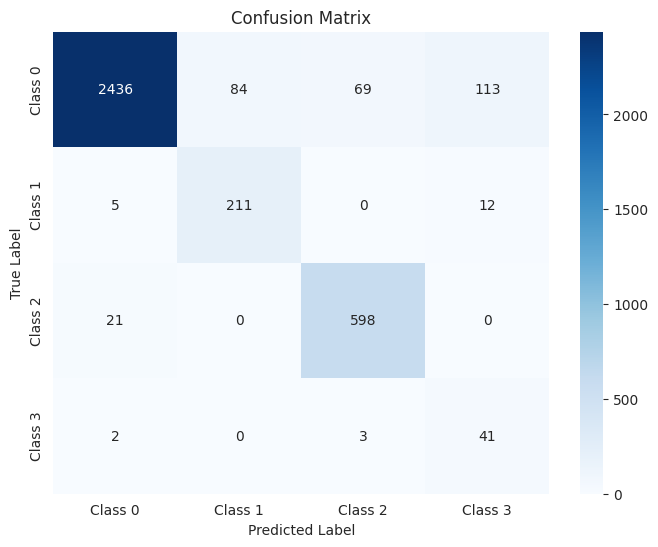

The function took 0.3650 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94      3378
     Class 1       0.70      0.94      0.80       285
     Class 2       0.91      0.94      0.92       774
     Class 3       0.26      0.88      0.40        57

    accuracy                           0.91      4494
   macro avg       0.71      0.92      0.77      4494
weighted avg       0.94      0.91      0.92      4494



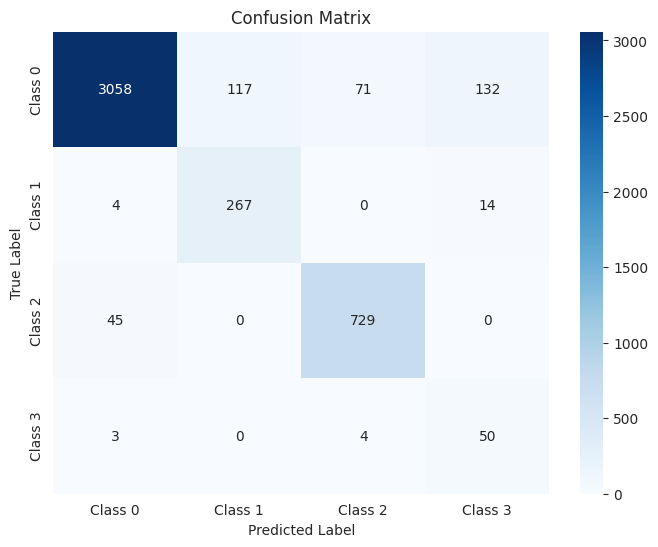

The function took 0.4160 seconds to execute.
[ARCH#173-[32, 16, 4, 4, 2]] done in 34.4s  best-val=0.8376


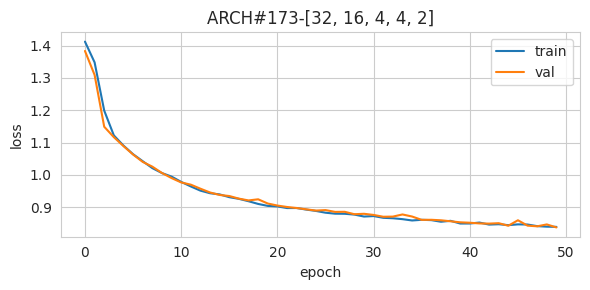


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.63      0.87      0.74      2475
     Class 3       0.22      0.55      0.32       182

    accuracy                           0.86     14379
   macro avg       0.45      0.59      0.50     14379
weighted avg       0.83      0.86      0.84     14379



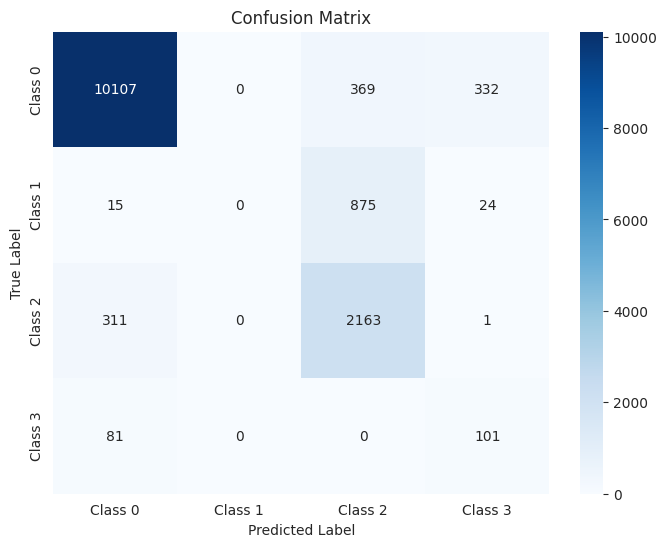

The function took 0.7620 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.65      0.89      0.75       619
     Class 3       0.25      0.65      0.36        46

    accuracy                           0.87      3595
   macro avg       0.47      0.62      0.52      3595
weighted avg       0.84      0.87      0.85      3595



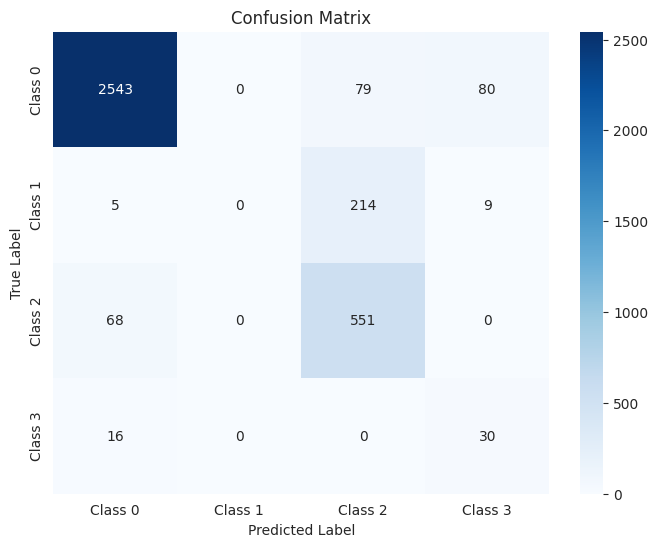

The function took 0.3768 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.94      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.63      0.85      0.73       774
     Class 3       0.21      0.56      0.31        57

    accuracy                           0.86      4494
   macro avg       0.45      0.59      0.49      4494
weighted avg       0.83      0.86      0.84      4494



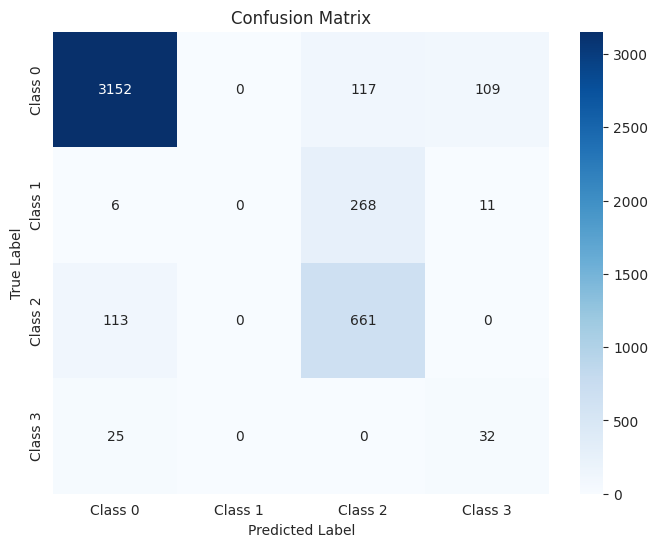

The function took 0.4402 seconds to execute.
[ARCH#174-[32, 16, 4, 2, 2]] done in 33.7s  best-val=1.3794


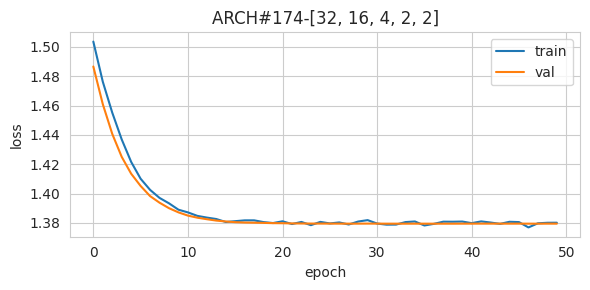


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



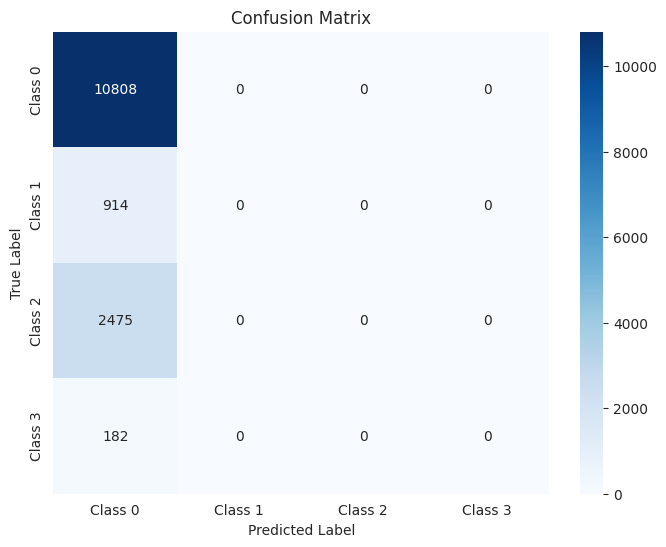

The function took 0.7365 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



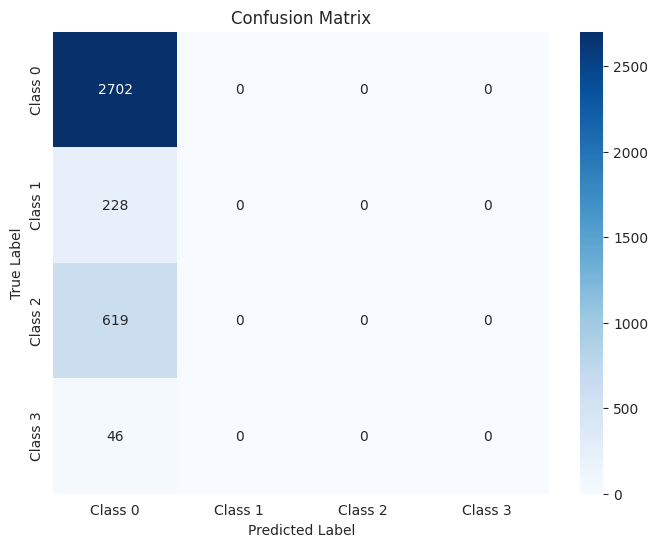

The function took 0.9450 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



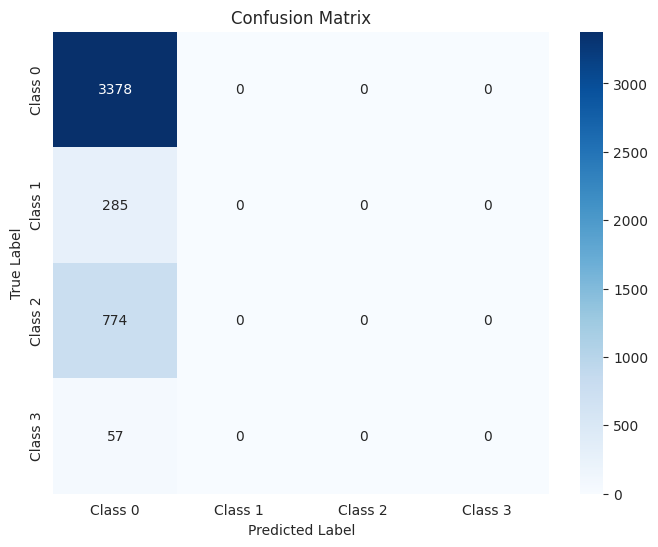

The function took 0.4985 seconds to execute.
[ARCH#175-[32, 16, 2, 2, 2]] done in 35.0s  best-val=0.5415


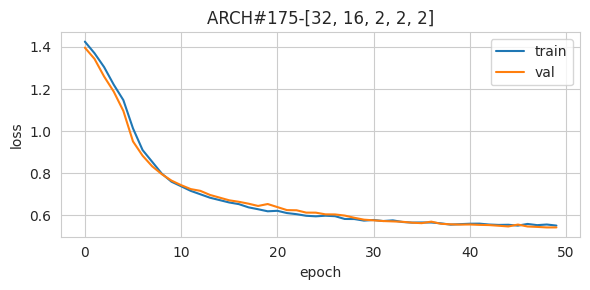


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.93      0.06      0.12     10808
     Class 1       0.09      0.96      0.16       914
     Class 2       0.79      0.98      0.88      2475
     Class 3       0.24      0.88      0.38       182

    accuracy                           0.29     14379
   macro avg       0.51      0.72      0.38     14379
weighted avg       0.85      0.29      0.26     14379



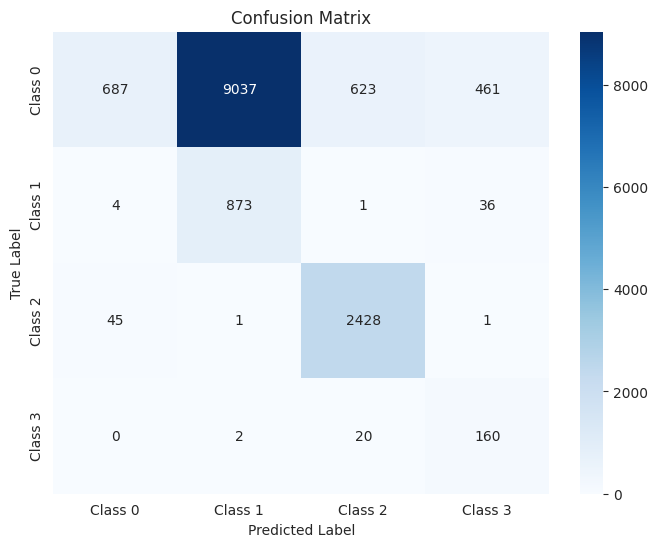

The function took 0.7630 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.07      0.12      2702
     Class 1       0.09      0.94      0.16       228
     Class 2       0.78      0.99      0.88       619
     Class 3       0.24      0.89      0.38        46

    accuracy                           0.29      3595
   macro avg       0.52      0.72      0.38      3595
weighted avg       0.87      0.29      0.26      3595



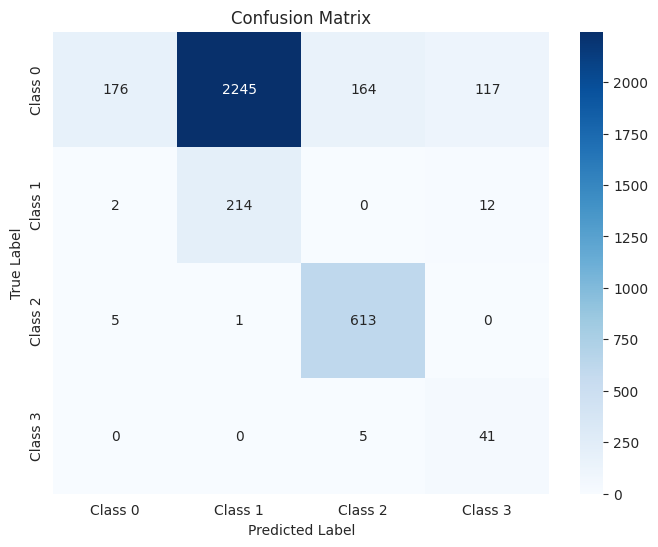

The function took 0.3916 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.07      0.13      3378
     Class 1       0.09      0.95      0.16       285
     Class 2       0.79      0.98      0.87       774
     Class 3       0.24      0.86      0.38        57

    accuracy                           0.29      4494
   macro avg       0.52      0.71      0.39      4494
weighted avg       0.85      0.29      0.26      4494



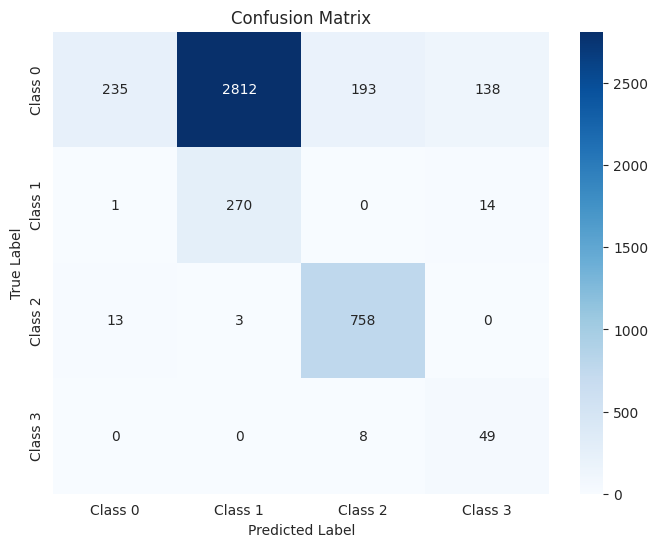

The function took 0.4113 seconds to execute.
[ARCH#176-[32, 8, 8, 8, 8]] done in 34.7s  best-val=0.2741


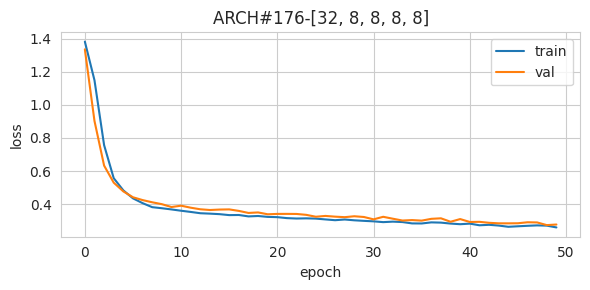


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95     10808
     Class 1       0.76      0.91      0.82       914
     Class 2       0.89      0.96      0.92      2475
     Class 3       0.29      0.88      0.44       182

    accuracy                           0.92     14379
   macro avg       0.73      0.92      0.78     14379
weighted avg       0.94      0.92      0.93     14379



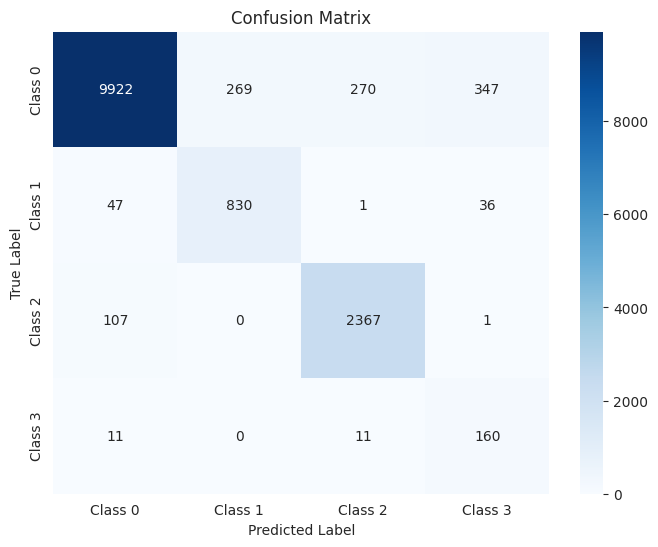

The function took 0.7464 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.77      0.87      0.82       228
     Class 2       0.88      0.97      0.92       619
     Class 3       0.26      0.87      0.41        46

    accuracy                           0.92      3595
   macro avg       0.72      0.91      0.77      3595
weighted avg       0.94      0.92      0.93      3595



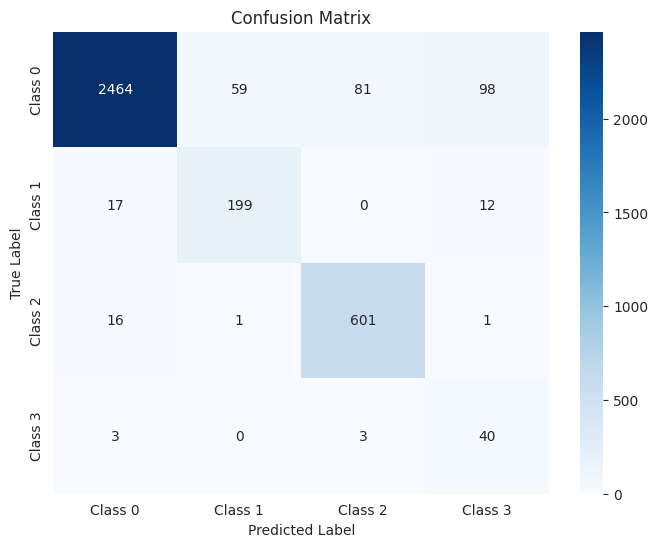

The function took 0.3682 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.76      0.89      0.82       285
     Class 2       0.90      0.94      0.92       774
     Class 3       0.30      0.88      0.44        57

    accuracy                           0.92      4494
   macro avg       0.73      0.91      0.78      4494
weighted avg       0.94      0.92      0.93      4494



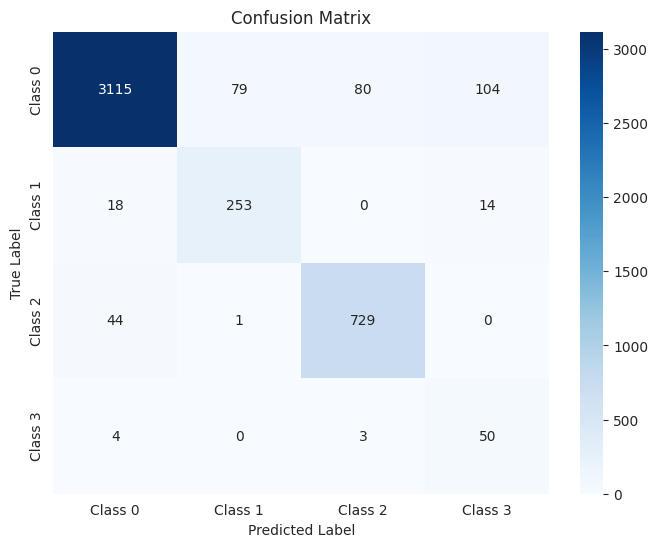

The function took 0.4308 seconds to execute.
[ARCH#177-[32, 8, 8, 8, 4]] done in 33.9s  best-val=0.2782


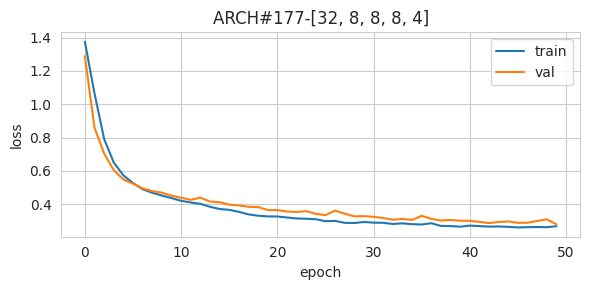


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95     10808
     Class 1       0.78      0.96      0.86       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.25      0.88      0.39       182

    accuracy                           0.92     14379
   macro avg       0.74      0.91      0.78     14379
weighted avg       0.95      0.92      0.93     14379



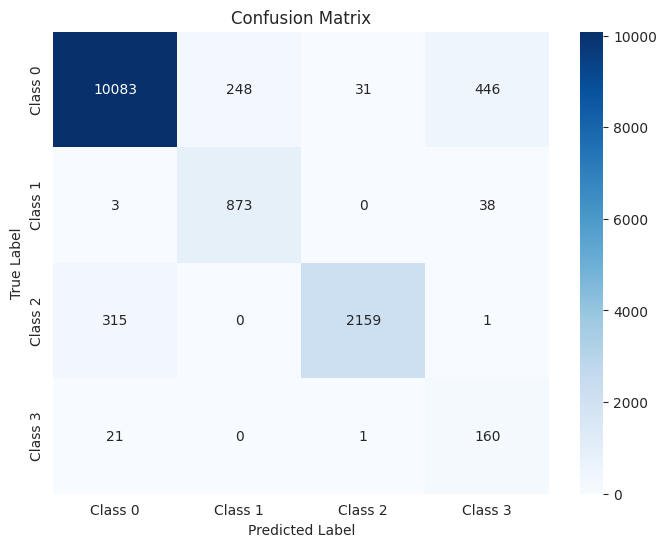

The function took 0.8397 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95      2702
     Class 1       0.80      0.93      0.86       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.23      0.87      0.37        46

    accuracy                           0.92      3595
   macro avg       0.75      0.90      0.78      3595
weighted avg       0.95      0.92      0.94      3595



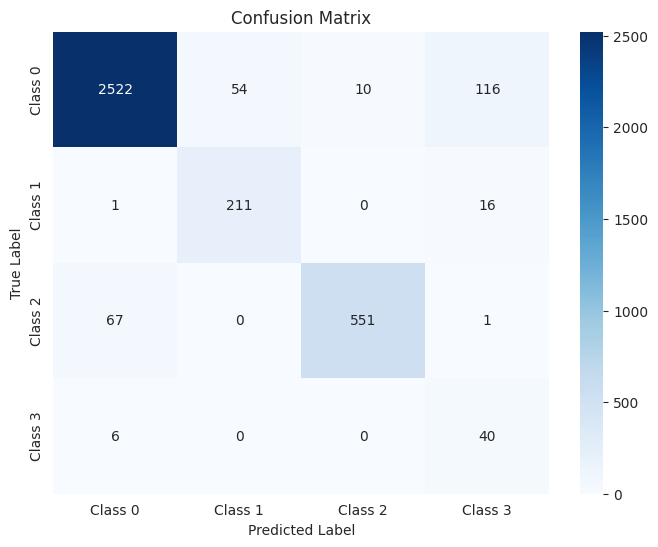

The function took 0.3999 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.95      3378
     Class 1       0.78      0.94      0.85       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.25      0.86      0.39        57

    accuracy                           0.92      4494
   macro avg       0.74      0.90      0.77      4494
weighted avg       0.94      0.92      0.93      4494



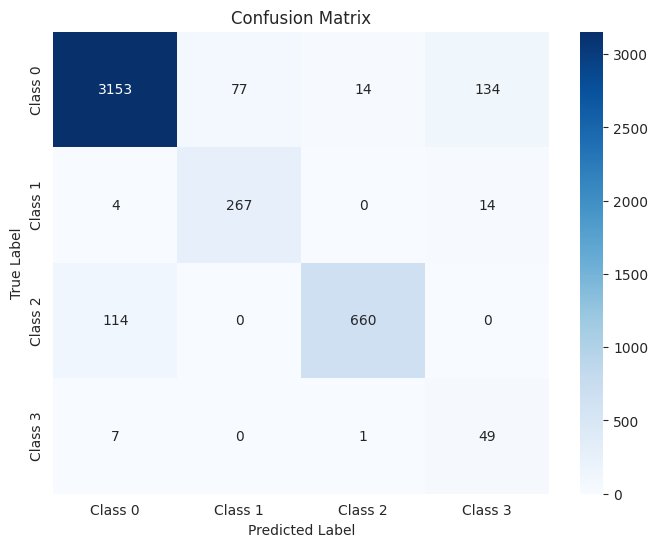

The function took 0.5543 seconds to execute.
[ARCH#178-[32, 8, 8, 8, 2]] done in 34.8s  best-val=0.4125


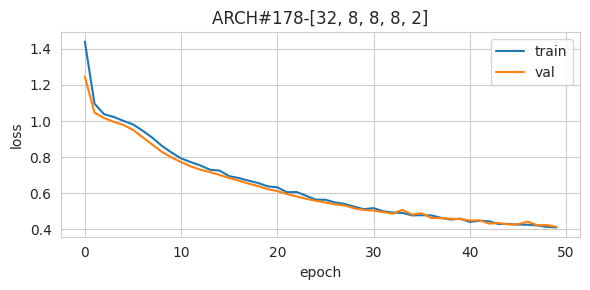


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.95     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.98      0.86      0.92      2475
     Class 3       0.26      0.87      0.41       182

    accuracy                           0.92     14379
   macro avg       0.74      0.91      0.78     14379
weighted avg       0.95      0.92      0.93     14379



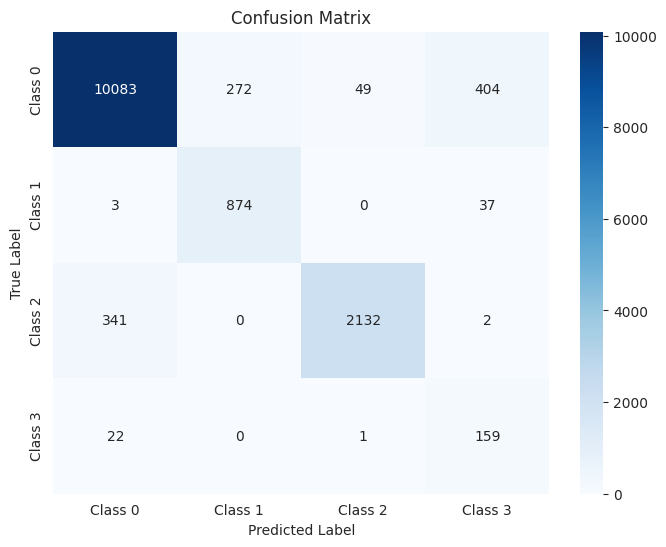

The function took 0.7430 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.97      0.89      0.93       619
     Class 3       0.24      0.85      0.38        46

    accuracy                           0.92      3595
   macro avg       0.74      0.90      0.78      3595
weighted avg       0.95      0.92      0.93      3595



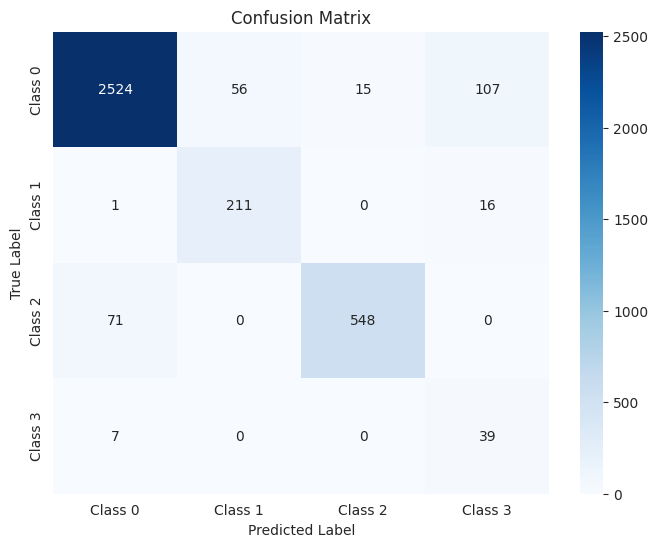

The function took 0.3932 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.95      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.97      0.84      0.90       774
     Class 3       0.24      0.81      0.38        57

    accuracy                           0.92      4494
   macro avg       0.74      0.88      0.77      4494
weighted avg       0.94      0.92      0.92      4494



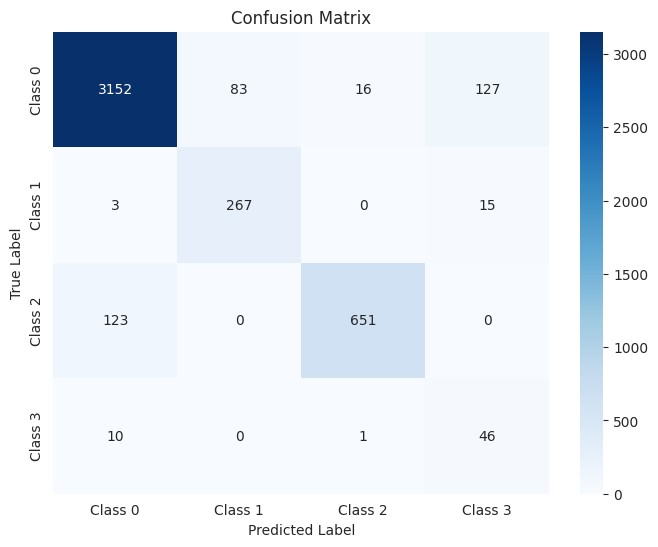

The function took 0.4237 seconds to execute.
[ARCH#179-[32, 8, 8, 4, 4]] done in 34.4s  best-val=0.2769


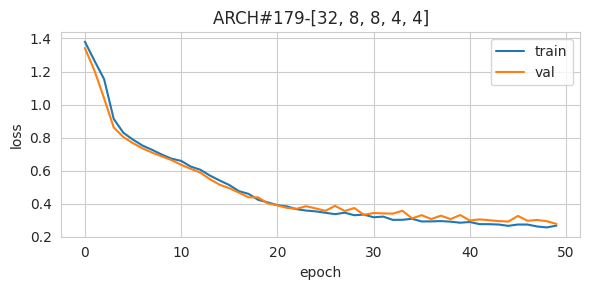


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.15      0.98      0.26       182

    accuracy                           0.90     14379
   macro avg       0.72      0.93      0.74     14379
weighted avg       0.96      0.90      0.93     14379



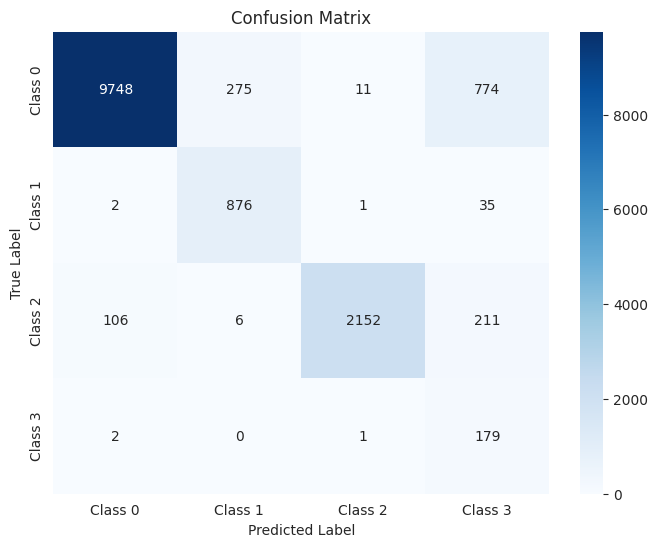

The function took 0.7245 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.13      0.96      0.24        46

    accuracy                           0.90      3595
   macro avg       0.72      0.92      0.74      3595
weighted avg       0.97      0.90      0.92      3595



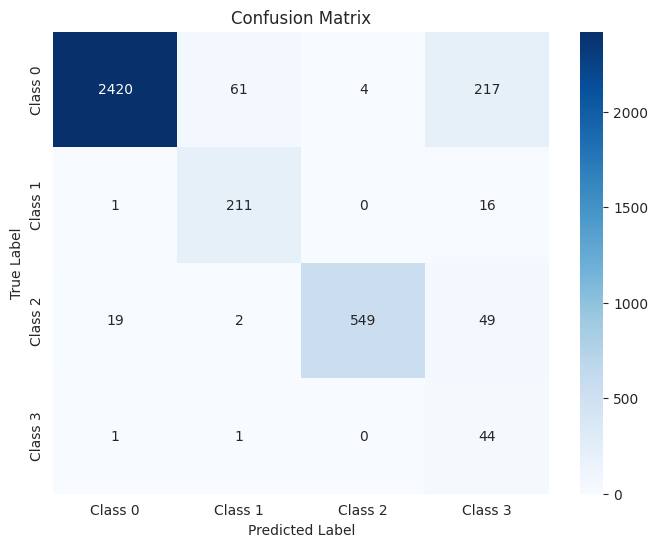

The function took 0.3827 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.99      0.85      0.91       774
     Class 3       0.15      0.95      0.26        57

    accuracy                           0.90      4494
   macro avg       0.72      0.91      0.74      4494
weighted avg       0.96      0.90      0.92      4494



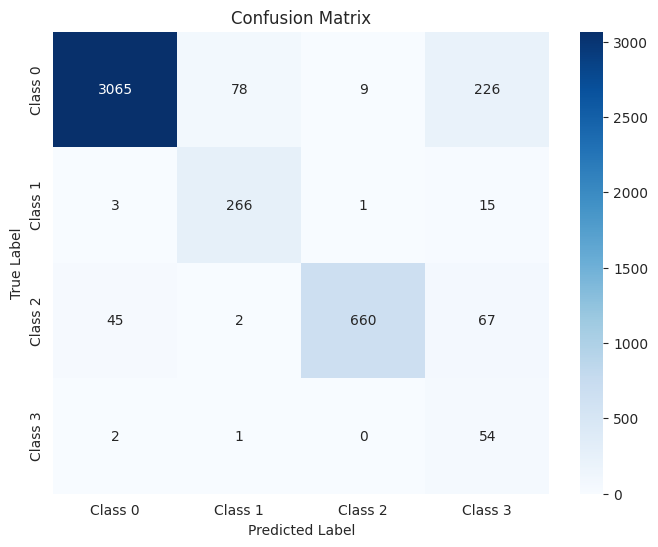

The function took 0.3997 seconds to execute.
[ARCH#180-[32, 8, 8, 4, 2]] done in 33.7s  best-val=0.5123


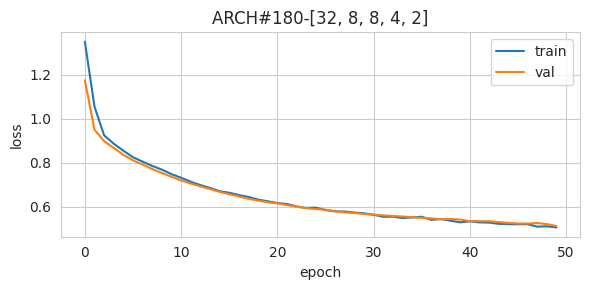


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95     10808
     Class 1       0.70      0.96      0.81       914
     Class 2       1.00      0.87      0.93      2475
     Class 3       0.28      0.84      0.42       182

    accuracy                           0.92     14379
   macro avg       0.74      0.90      0.78     14379
weighted avg       0.95      0.92      0.93     14379



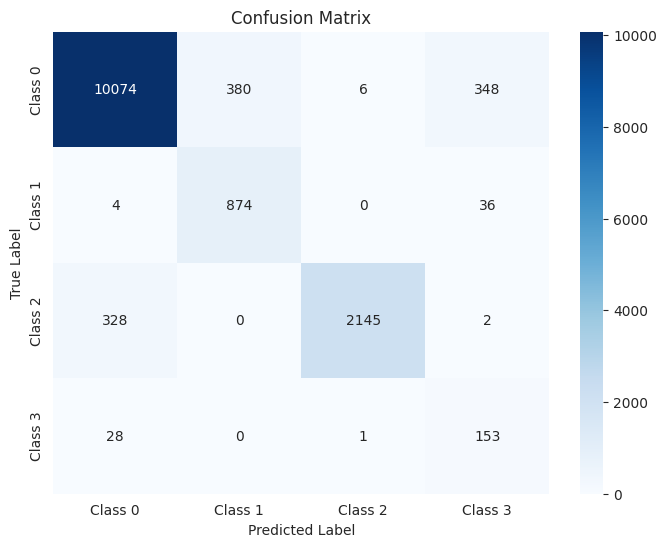

The function took 0.7800 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95      2702
     Class 1       0.71      0.93      0.81       228
     Class 2       1.00      0.89      0.94       619
     Class 3       0.28      0.85      0.42        46

    accuracy                           0.92      3595
   macro avg       0.74      0.90      0.78      3595
weighted avg       0.95      0.92      0.93      3595



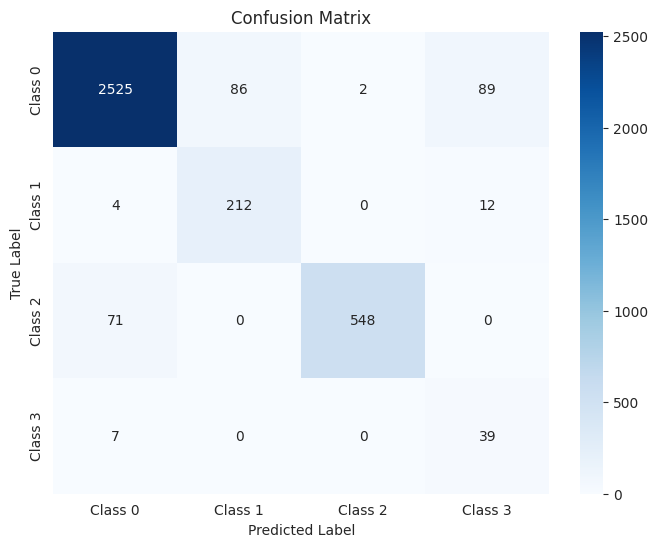

The function took 0.4543 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.94      3378
     Class 1       0.69      0.93      0.79       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.26      0.82      0.39        57

    accuracy                           0.91      4494
   macro avg       0.72      0.88      0.76      4494
weighted avg       0.94      0.91      0.92      4494



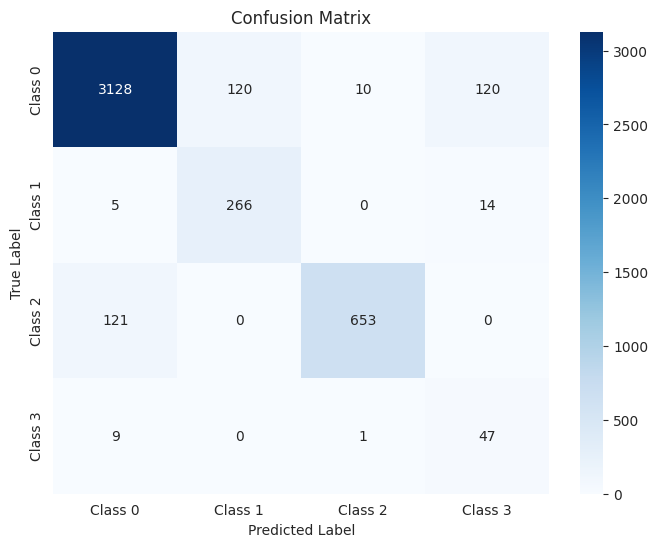

The function took 0.4026 seconds to execute.
[ARCH#181-[32, 8, 8, 2, 2]] early-stop @ epoch 038
[ARCH#181-[32, 8, 8, 2, 2]] done in 26.8s  best-val=1.3794


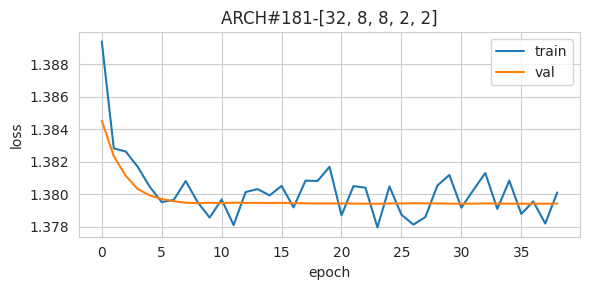


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



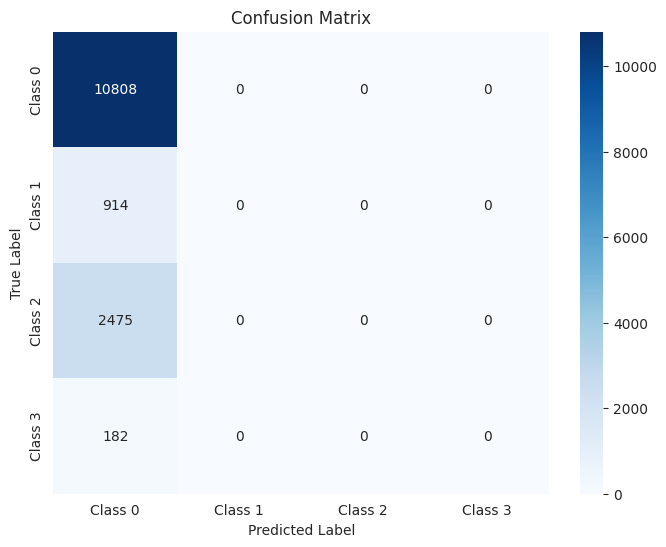

The function took 0.7384 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



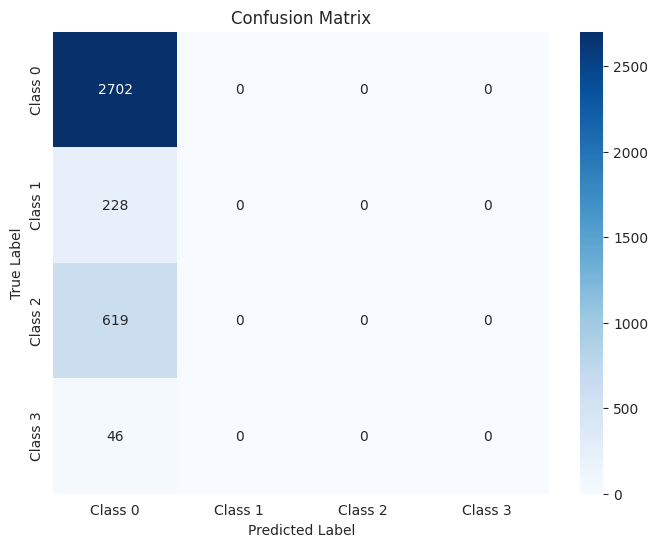

The function took 0.4527 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



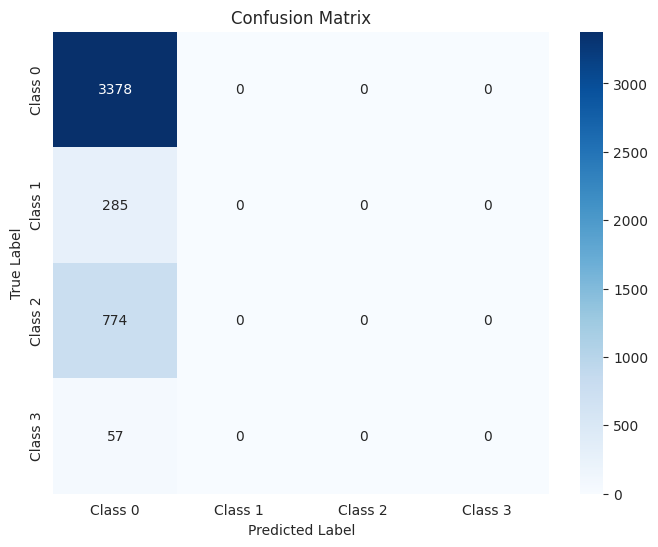

The function took 0.4527 seconds to execute.
[ARCH#182-[32, 8, 4, 4, 4]] done in 34.5s  best-val=0.3672


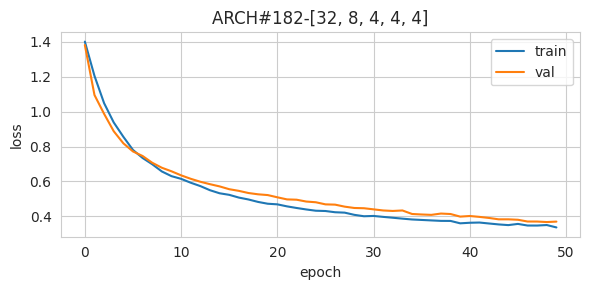


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.84      0.91     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.09      0.98      0.17       182

    accuracy                           0.86     14379
   macro avg       0.71      0.91      0.71     14379
weighted avg       0.97      0.86      0.90     14379



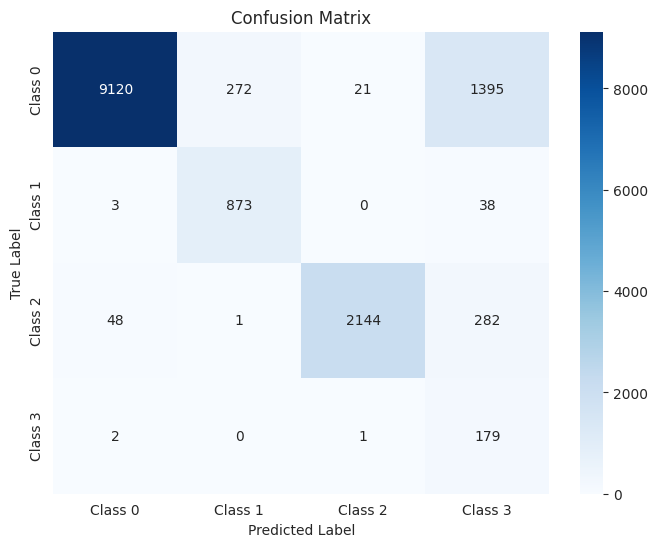

The function took 0.7372 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.84      0.91      2702
     Class 1       0.80      0.93      0.86       228
     Class 2       0.99      0.89      0.93       619
     Class 3       0.09      0.98      0.17        46

    accuracy                           0.86      3595
   macro avg       0.72      0.91      0.72      3595
weighted avg       0.97      0.86      0.90      3595



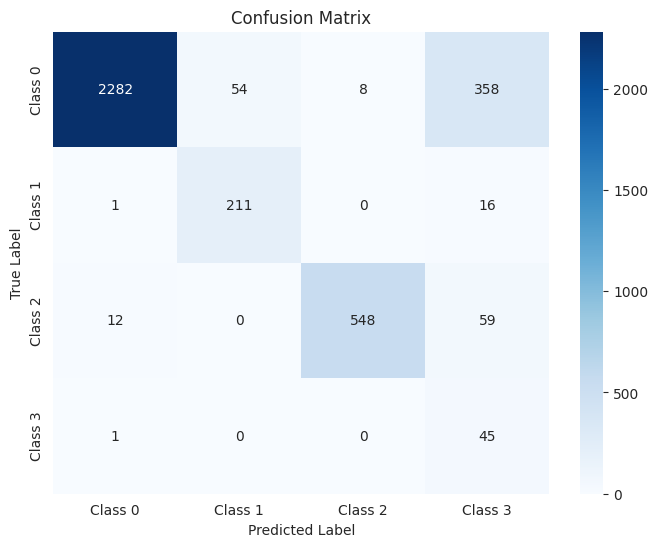

The function took 0.3641 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.84      0.91      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.09      0.96      0.17        57

    accuracy                           0.85      4494
   macro avg       0.71      0.90      0.71      4494
weighted avg       0.96      0.85      0.90      4494



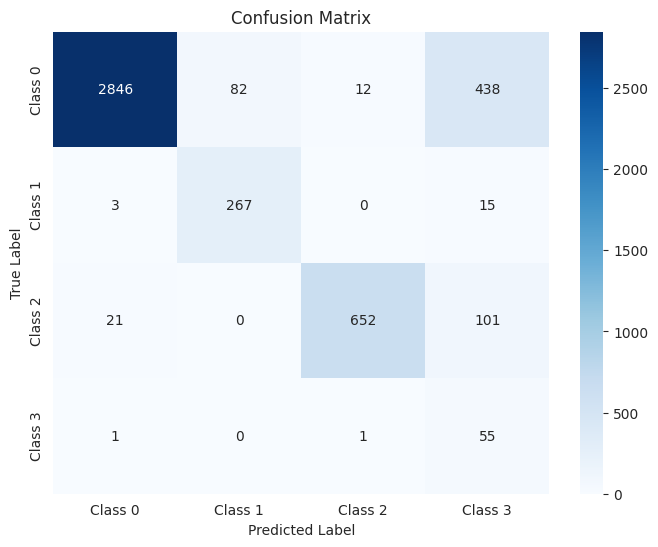

The function took 0.8080 seconds to execute.
[ARCH#183-[32, 8, 4, 4, 2]] done in 34.7s  best-val=0.3084


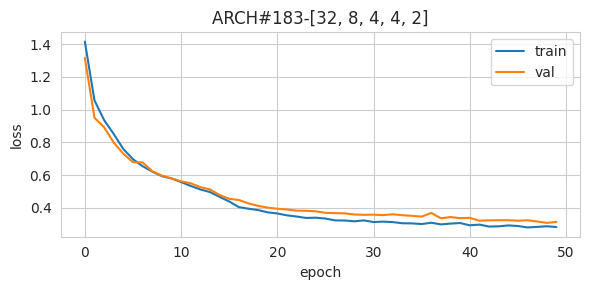


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.15      0.99      0.25       182

    accuracy                           0.90     14379
   macro avg       0.71      0.93      0.74     14379
weighted avg       0.96      0.90      0.92     14379



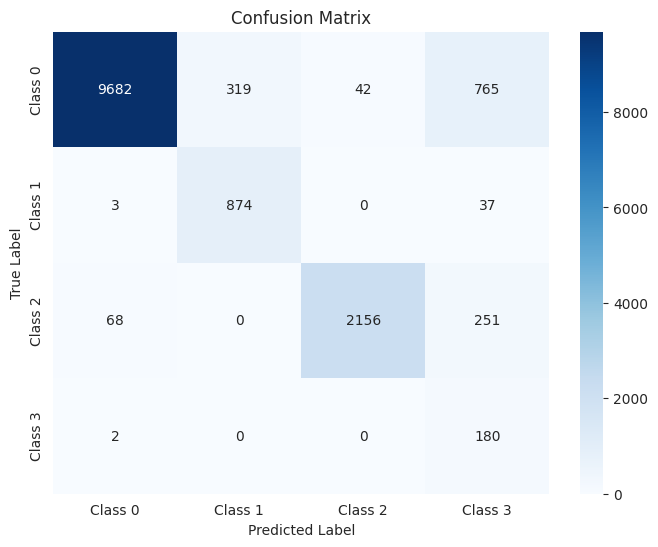

The function took 0.7219 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.16      0.98      0.27        46

    accuracy                           0.90      3595
   macro avg       0.72      0.92      0.74      3595
weighted avg       0.96      0.90      0.93      3595



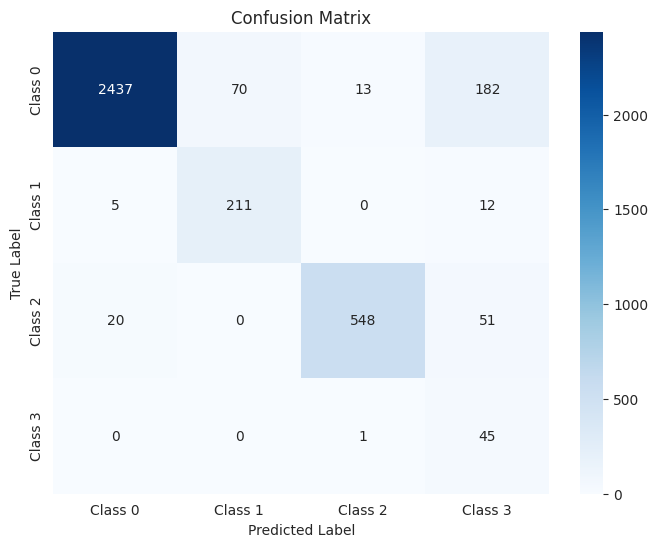

The function took 0.3767 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.72      0.93      0.81       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.14      0.96      0.25        57

    accuracy                           0.89      4494
   macro avg       0.71      0.91      0.73      4494
weighted avg       0.96      0.89      0.92      4494



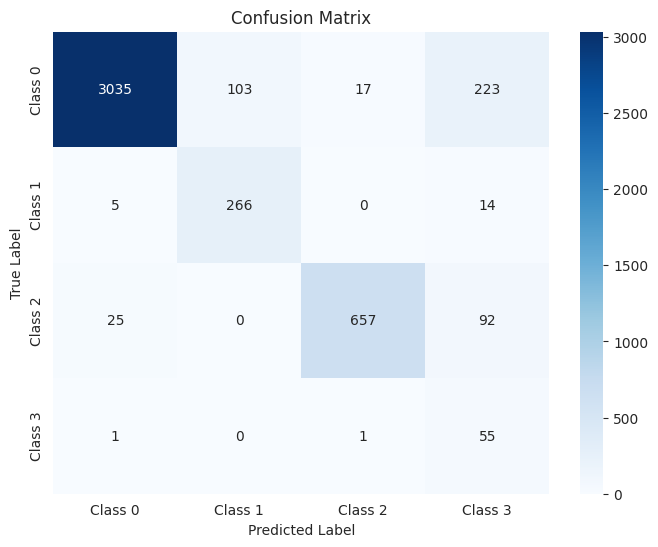

The function took 0.4436 seconds to execute.
[ARCH#184-[32, 8, 4, 2, 2]] early-stop @ epoch 029
[ARCH#184-[32, 8, 4, 2, 2]] done in 20.2s  best-val=1.3794


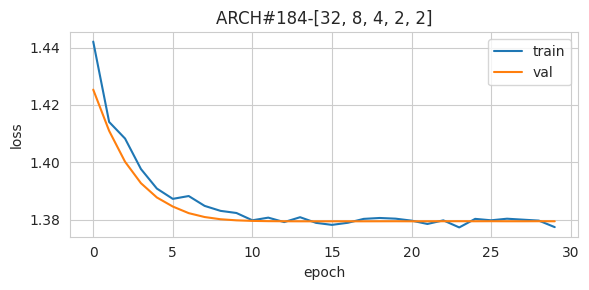


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



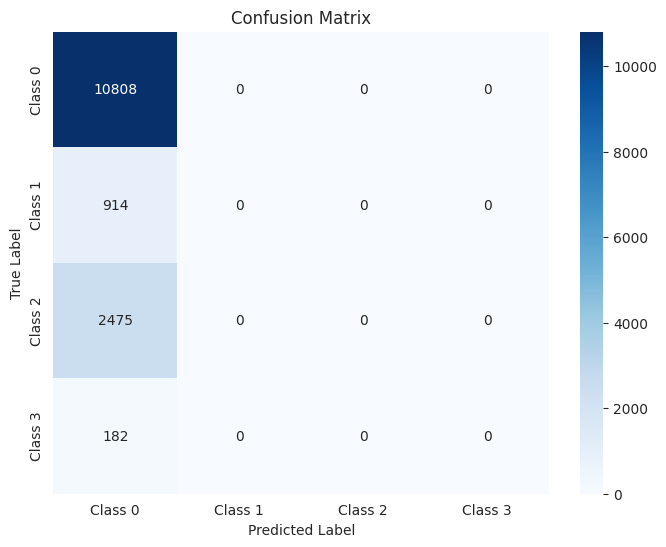

The function took 0.7251 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



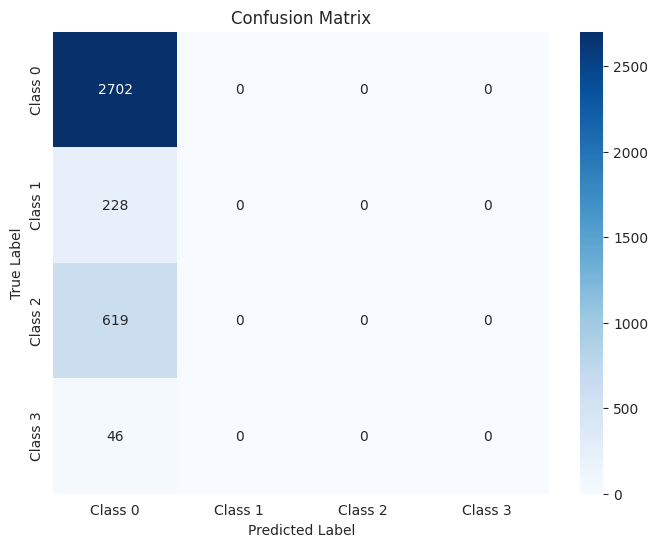

The function took 0.4237 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



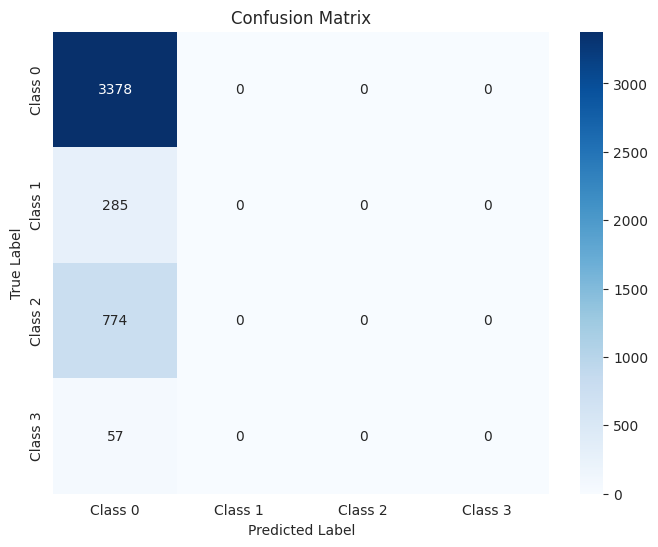

The function took 0.4853 seconds to execute.
[ARCH#185-[32, 8, 2, 2, 2]] done in 34.7s  best-val=1.3794


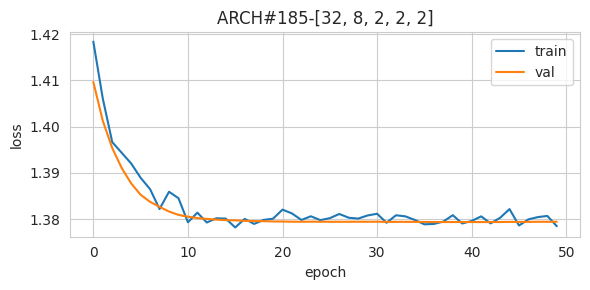


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



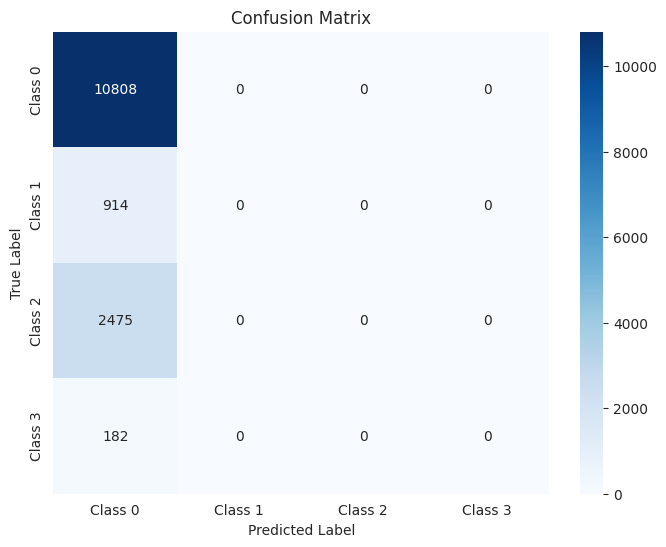

The function took 0.7582 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



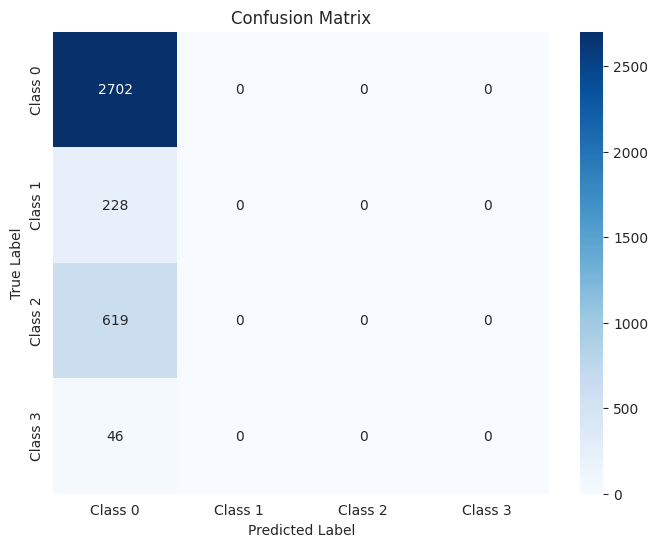

The function took 0.3778 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



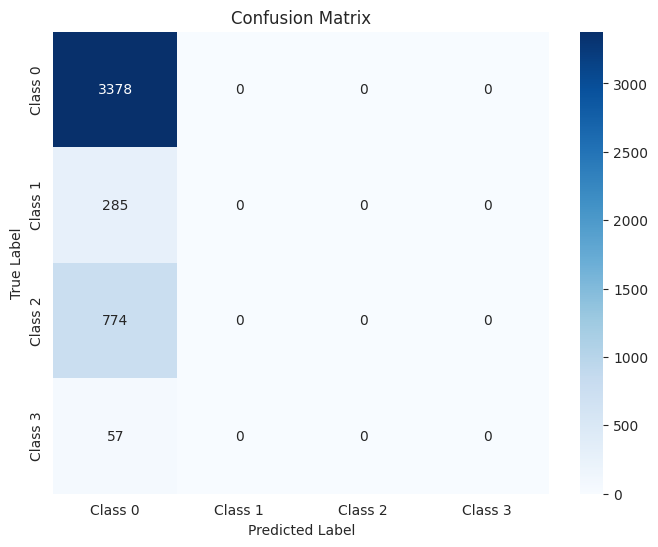

The function took 0.4098 seconds to execute.
[ARCH#186-[32, 4, 4, 4, 4]] done in 34.6s  best-val=0.3503


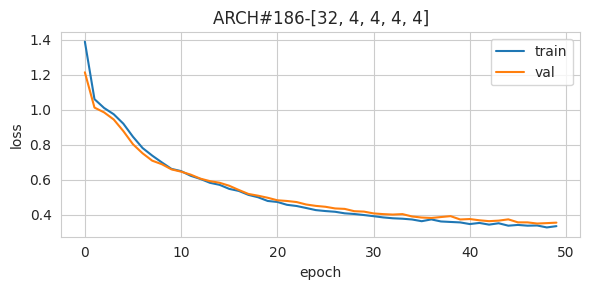


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.85      0.92     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.09      0.98      0.17       182

    accuracy                           0.86     14379
   macro avg       0.71      0.91      0.71     14379
weighted avg       0.97      0.86      0.90     14379



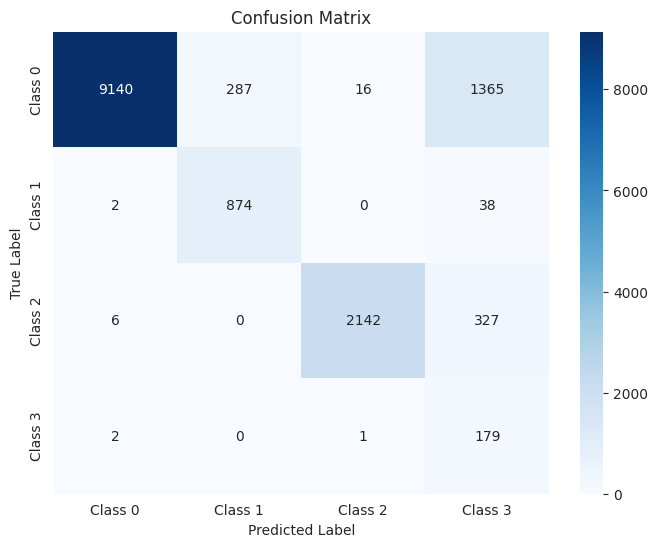

The function took 0.7196 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.86      0.92      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.10      0.98      0.18        46

    accuracy                           0.87      3595
   macro avg       0.71      0.91      0.72      3595
weighted avg       0.97      0.87      0.91      3595



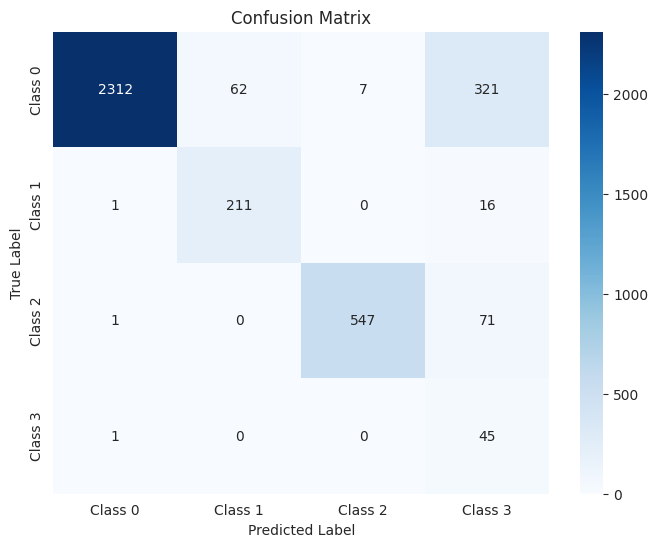

The function took 0.3937 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.85      0.92      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.09      0.96      0.16        57

    accuracy                           0.85      4494
   macro avg       0.71      0.90      0.71      4494
weighted avg       0.97      0.85      0.90      4494



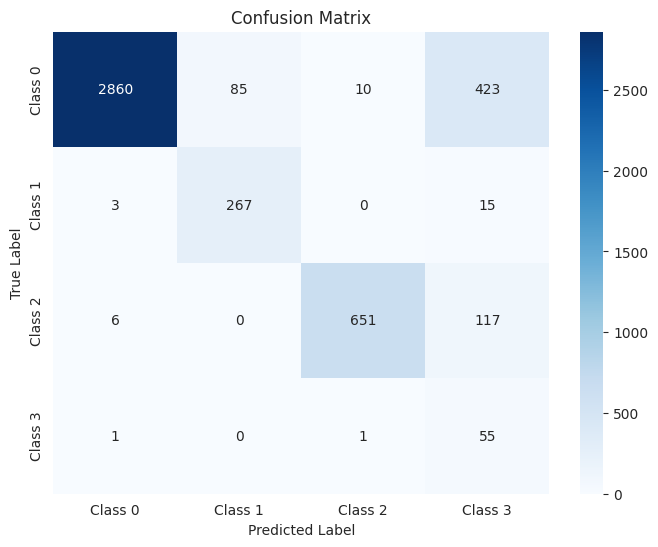

The function took 0.4235 seconds to execute.
[ARCH#187-[32, 4, 4, 4, 2]] done in 33.9s  best-val=0.3636


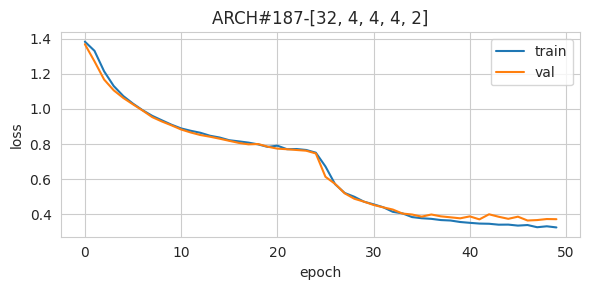


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.90     10808
     Class 1       0.63      0.96      0.76       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.10      0.98      0.17       182

    accuracy                           0.84     14379
   macro avg       0.68      0.91      0.69     14379
weighted avg       0.96      0.84      0.89     14379



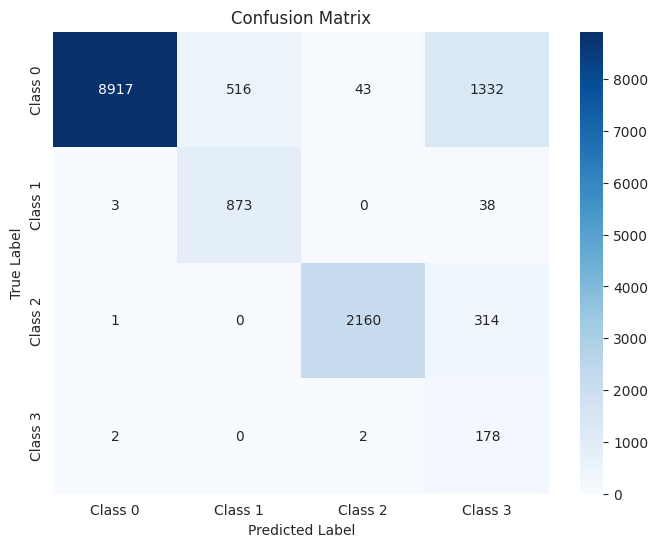

The function took 0.8302 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.91      2702
     Class 1       0.64      0.93      0.76       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.10      0.96      0.17        46

    accuracy                           0.85      3595
   macro avg       0.68      0.90      0.69      3595
weighted avg       0.96      0.85      0.89      3595



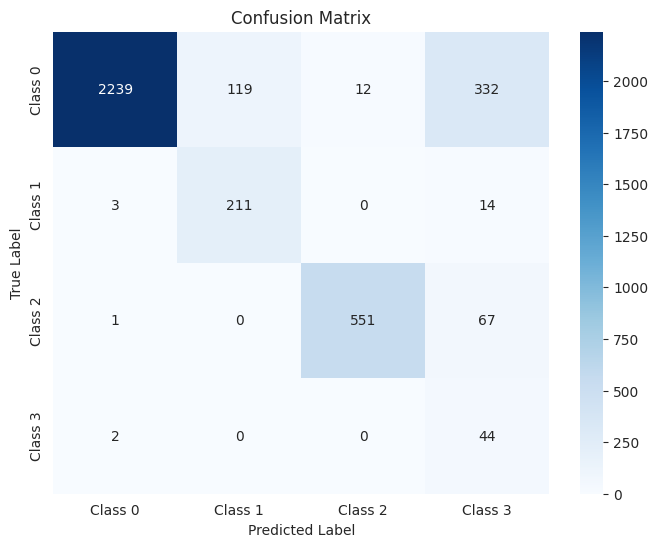

The function took 0.4770 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.90      3378
     Class 1       0.63      0.93      0.75       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.09      0.96      0.17        57

    accuracy                           0.84      4494
   macro avg       0.67      0.89      0.68      4494
weighted avg       0.96      0.84      0.89      4494



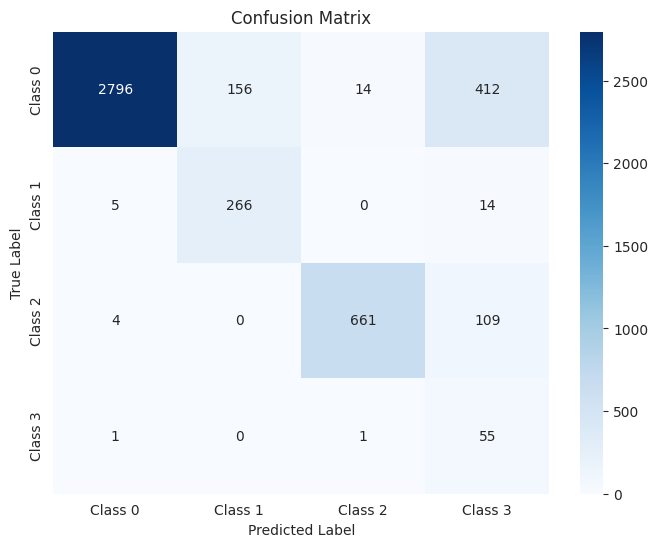

The function took 0.4836 seconds to execute.
[ARCH#188-[32, 4, 4, 2, 2]] done in 34.6s  best-val=0.5837


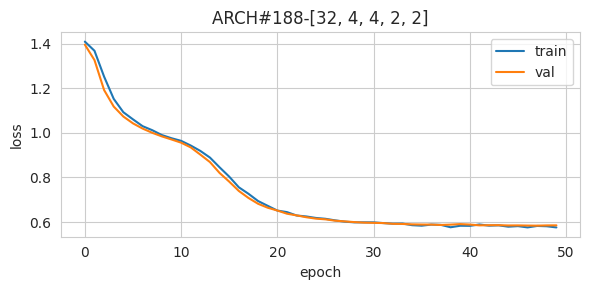


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.98      0.96     10808
     Class 1       0.76      0.91      0.83       914
     Class 2       1.00      0.86      0.93      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.94     14379
   macro avg       0.68      0.69      0.68     14379
weighted avg       0.93      0.94      0.93     14379



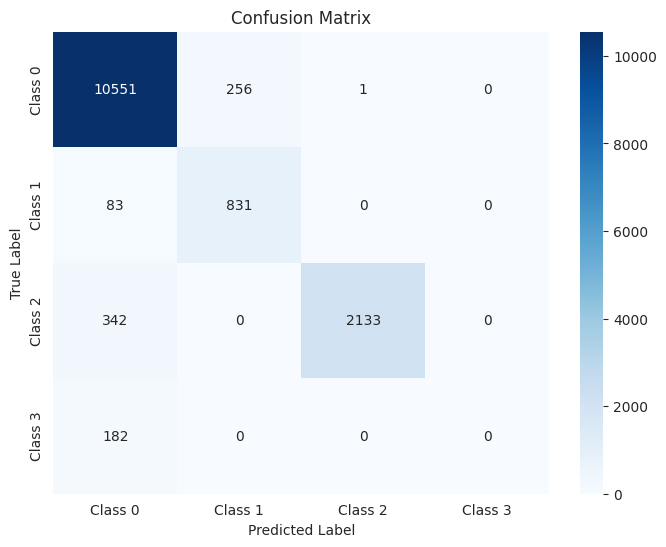

The function took 0.7109 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.98      0.96      2702
     Class 1       0.79      0.88      0.83       228
     Class 2       1.00      0.88      0.93       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.94      3595
   macro avg       0.68      0.68      0.68      3595
weighted avg       0.93      0.94      0.94      3595



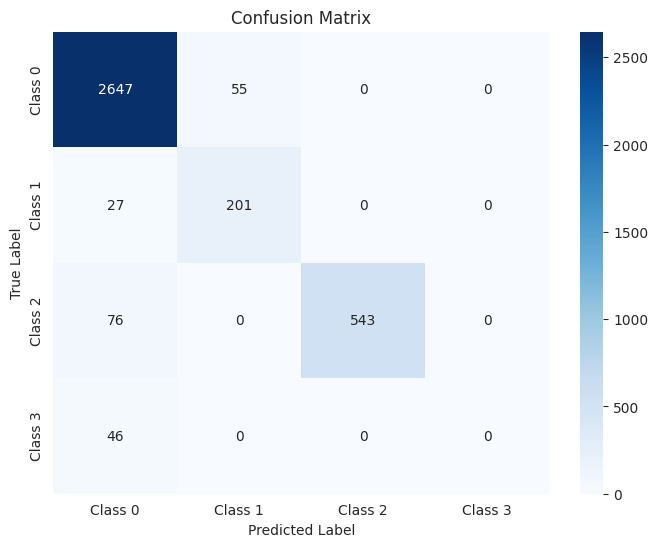

The function took 0.4033 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.98      0.96      3378
     Class 1       0.77      0.89      0.82       285
     Class 2       1.00      0.84      0.91       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.94      4494
   macro avg       0.68      0.68      0.67      4494
weighted avg       0.93      0.94      0.93      4494



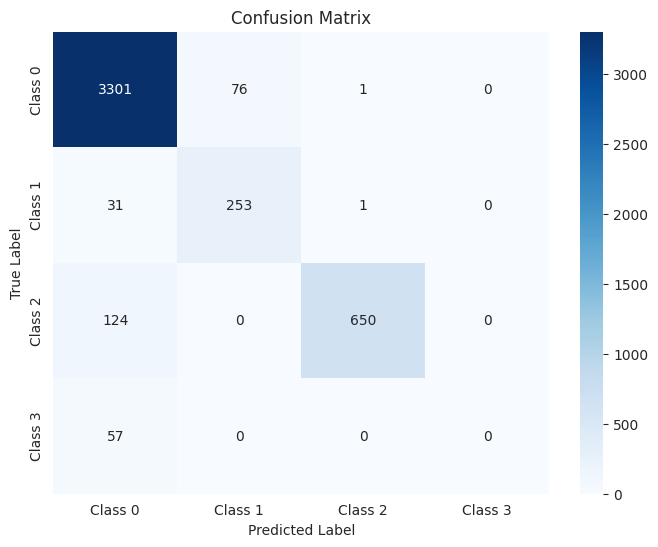

The function took 0.4133 seconds to execute.
[ARCH#189-[32, 4, 2, 2, 2]] done in 34.2s  best-val=0.9271


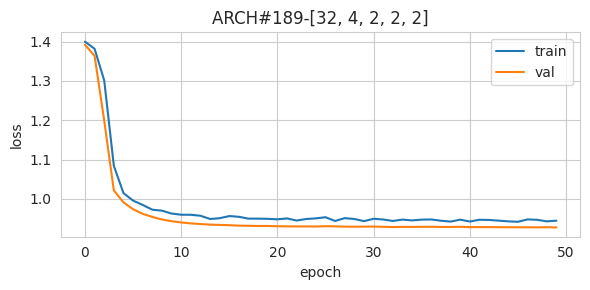


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.88      1.00      0.94     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.90     14379
   macro avg       0.47      0.47      0.47     14379
weighted avg       0.84      0.90      0.86     14379



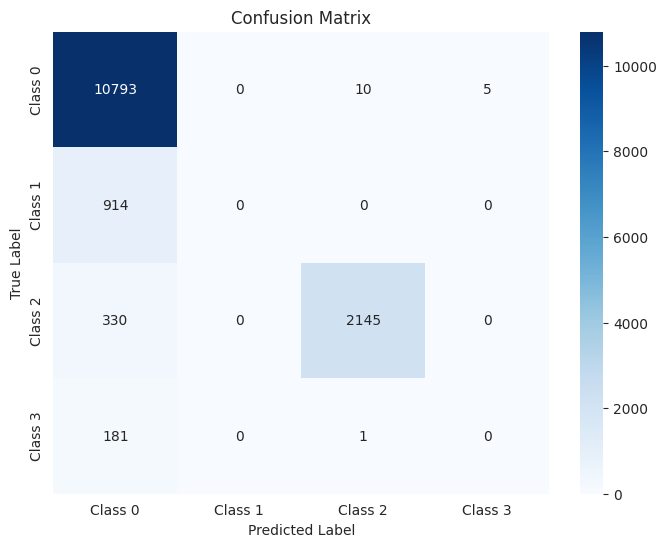

The function took 0.8898 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.89      1.00      0.94      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.90      3595
   macro avg       0.47      0.47      0.47      3595
weighted avg       0.84      0.90      0.87      3595



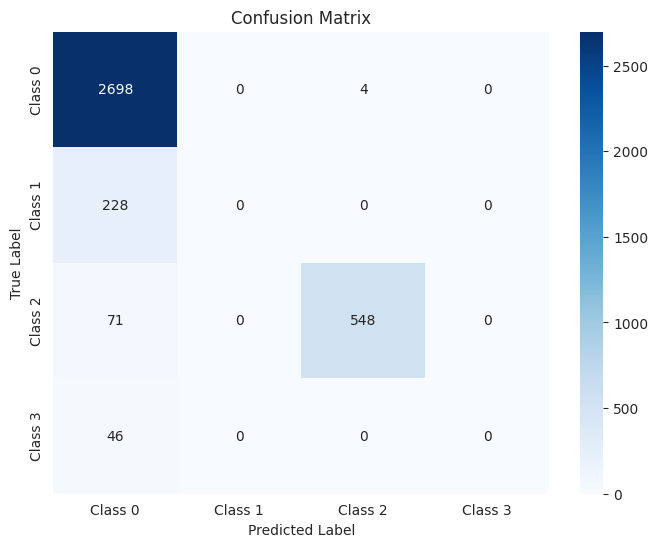

The function took 0.3907 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.88      1.00      0.93      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.99      0.84      0.91       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.89      4494
   macro avg       0.47      0.46      0.46      4494
weighted avg       0.83      0.89      0.86      4494



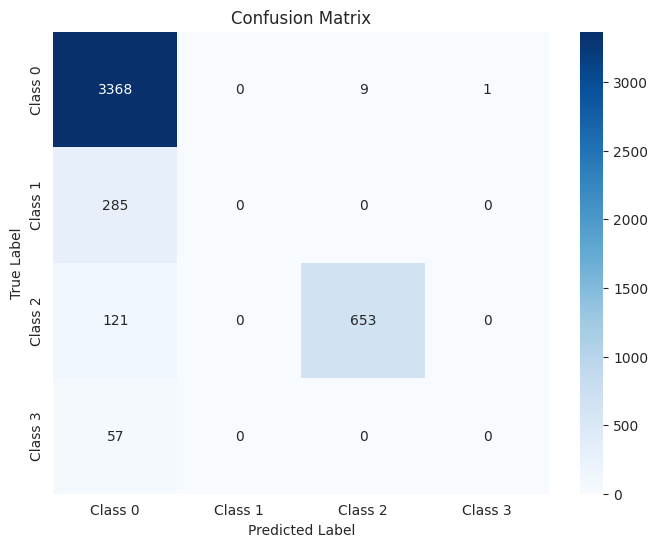

The function took 0.4054 seconds to execute.
[ARCH#190-[32, 2, 2, 2, 2]] done in 33.4s  best-val=0.8299


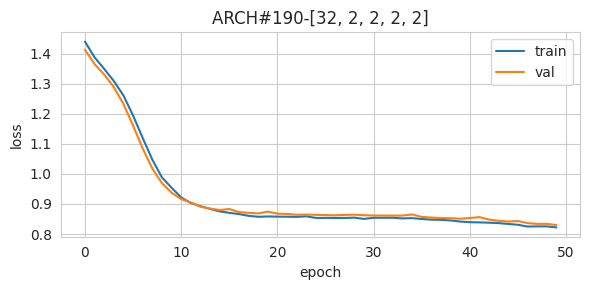


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.76      0.85     10808
     Class 1       0.27      0.90      0.41       914
     Class 2       0.27      0.04      0.06      2475
     Class 3       0.06      0.81      0.11       182

    accuracy                           0.64     14379
   macro avg       0.39      0.63      0.36     14379
weighted avg       0.79      0.64      0.68     14379



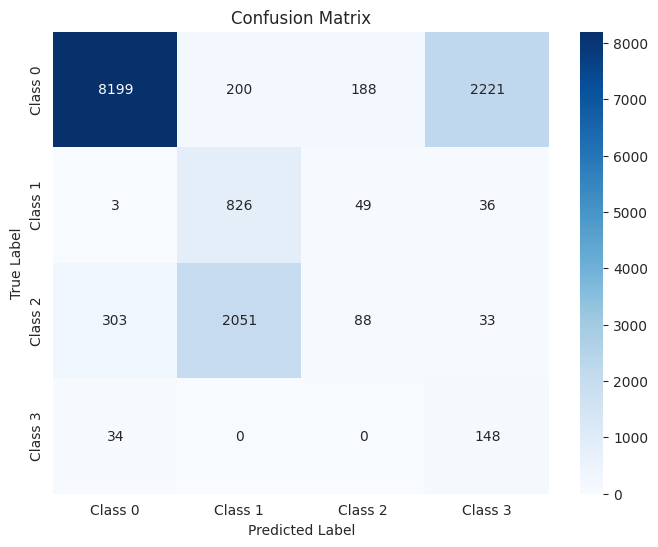

The function took 0.7539 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.77      0.85      2702
     Class 1       0.26      0.87      0.40       228
     Class 2       0.22      0.03      0.05       619
     Class 3       0.06      0.80      0.12        46

    accuracy                           0.65      3595
   macro avg       0.38      0.62      0.36      3595
weighted avg       0.78      0.65      0.68      3595



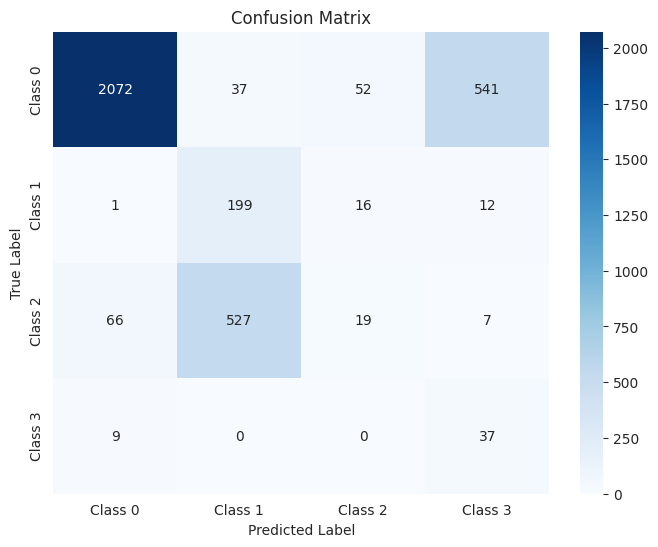

The function took 0.4013 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.76      0.84      3378
     Class 1       0.27      0.88      0.41       285
     Class 2       0.20      0.03      0.05       774
     Class 3       0.06      0.81      0.11        57

    accuracy                           0.64      4494
   macro avg       0.37      0.62      0.35      4494
weighted avg       0.77      0.64      0.67      4494



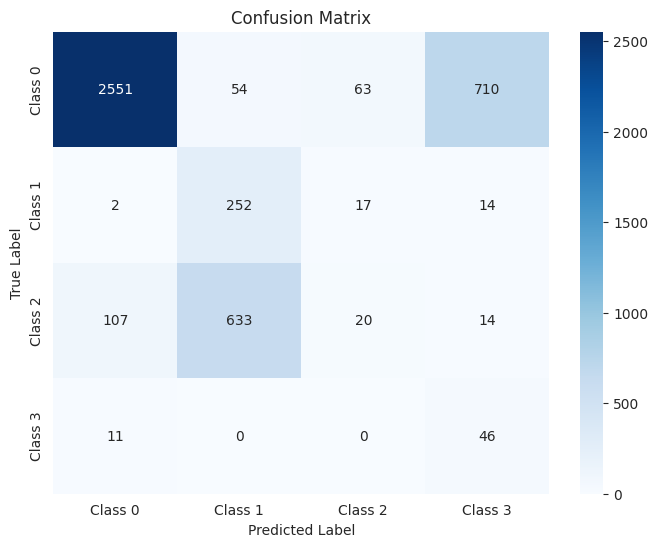

The function took 0.4005 seconds to execute.
[ARCH#191-[16, 16, 16, 16, 16]] done in 34.3s  best-val=0.2264


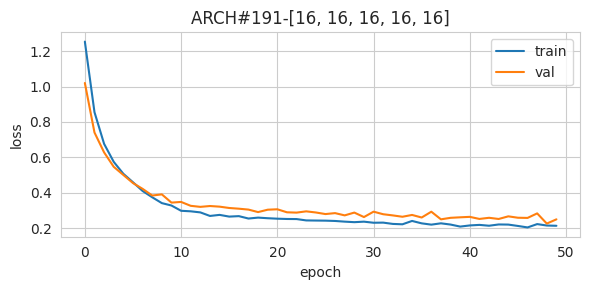


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.81      0.97      0.88      2475
     Class 3       0.25      0.88      0.39       182

    accuracy                           0.90     14379
   macro avg       0.70      0.92      0.76     14379
weighted avg       0.93      0.90      0.91     14379



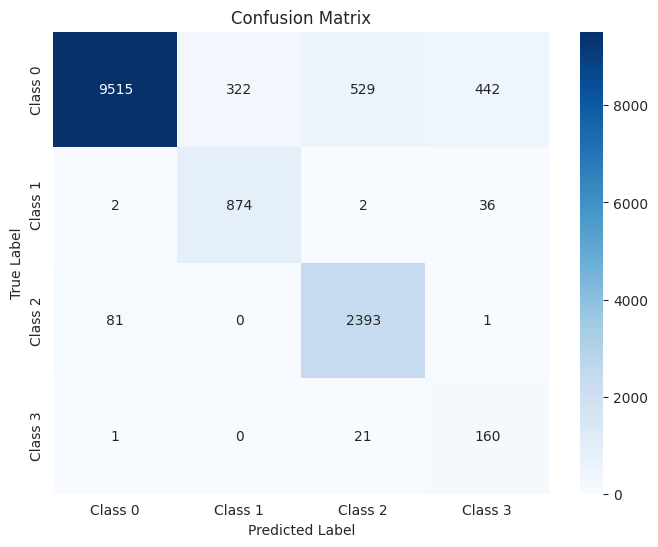

The function took 0.7128 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      2702
     Class 1       0.74      0.93      0.82       228
     Class 2       0.81      0.97      0.88       619
     Class 3       0.24      0.89      0.38        46

    accuracy                           0.90      3595
   macro avg       0.69      0.92      0.75      3595
weighted avg       0.93      0.90      0.91      3595



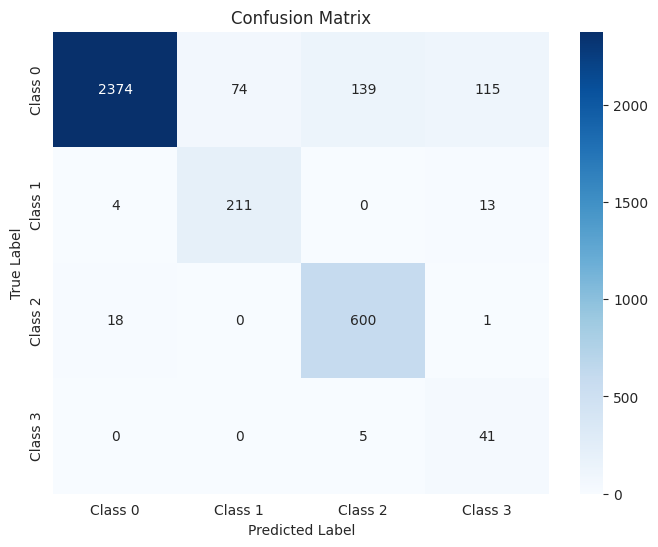

The function took 0.7292 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      3378
     Class 1       0.72      0.93      0.81       285
     Class 2       0.81      0.96      0.88       774
     Class 3       0.25      0.86      0.38        57

    accuracy                           0.90      4494
   macro avg       0.69      0.91      0.75      4494
weighted avg       0.93      0.90      0.91      4494



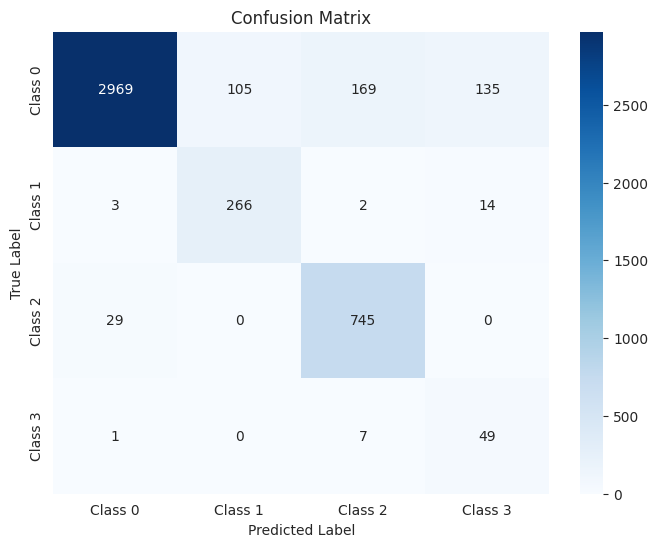

The function took 0.4215 seconds to execute.
[ARCH#192-[16, 16, 16, 16, 8]] done in 34.8s  best-val=0.2538


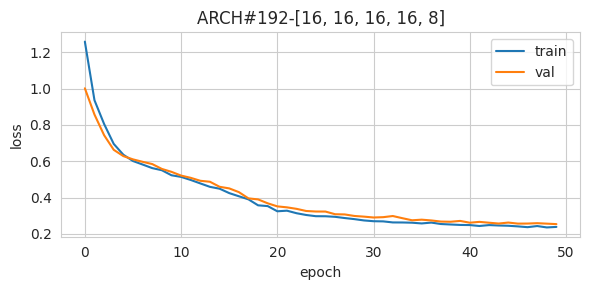


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.85      0.92     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.73      0.98      0.84      2475
     Class 3       0.28      0.88      0.43       182

    accuracy                           0.88     14379
   macro avg       0.68      0.92      0.75     14379
weighted avg       0.92      0.88      0.89     14379



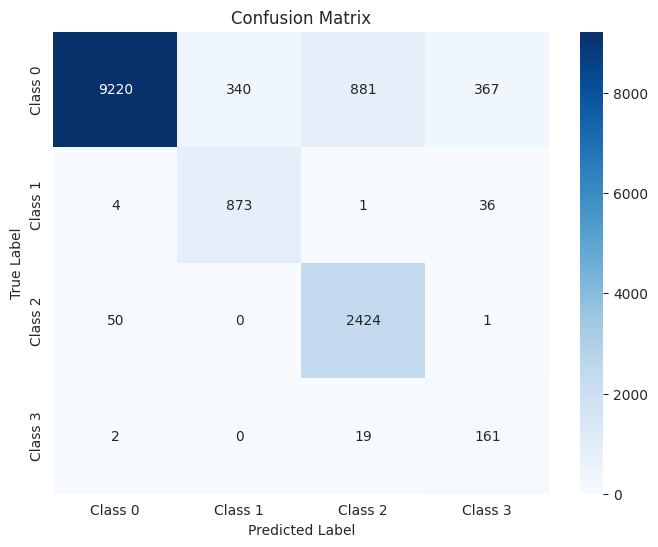

The function took 0.7365 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.86      0.92      2702
     Class 1       0.74      0.93      0.82       228
     Class 2       0.72      0.98      0.83       619
     Class 3       0.28      0.87      0.43        46

    accuracy                           0.88      3595
   macro avg       0.68      0.91      0.75      3595
weighted avg       0.92      0.88      0.89      3595



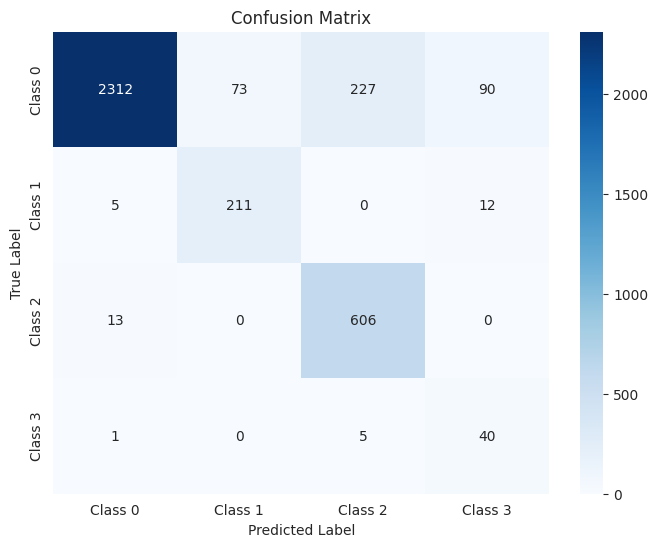

The function took 0.3802 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.86      0.92      3378
     Class 1       0.72      0.94      0.82       285
     Class 2       0.74      0.97      0.84       774
     Class 3       0.29      0.88      0.44        57

    accuracy                           0.88      4494
   macro avg       0.69      0.91      0.75      4494
weighted avg       0.92      0.88      0.89      4494



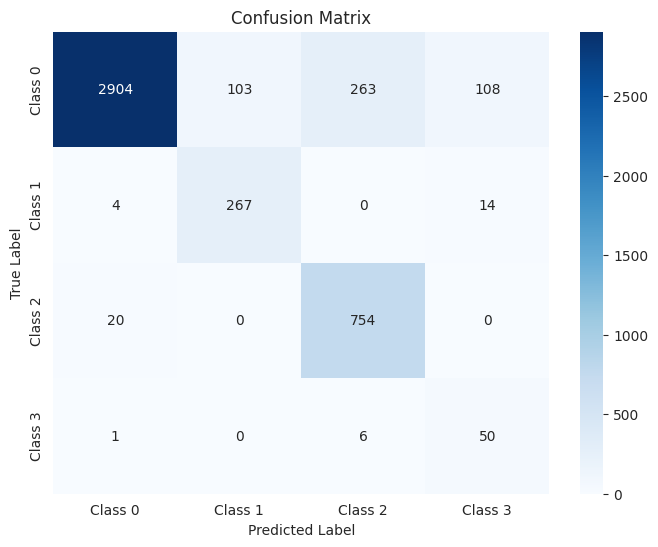

The function took 0.4293 seconds to execute.
[ARCH#193-[16, 16, 16, 16, 4]] done in 33.8s  best-val=0.6158


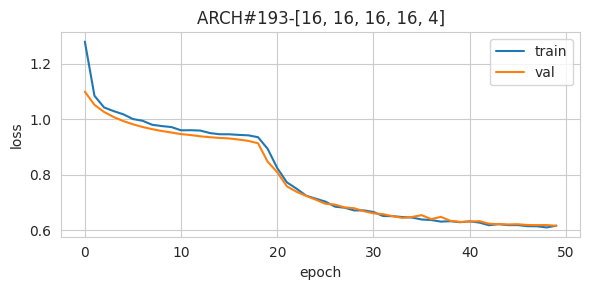


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.91      0.91      0.91     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       1.00      0.87      0.93      2475
     Class 3       0.12      0.96      0.21       182

    accuracy                           0.84     14379
   macro avg       0.51      0.68      0.51     14379
weighted avg       0.86      0.84      0.85     14379



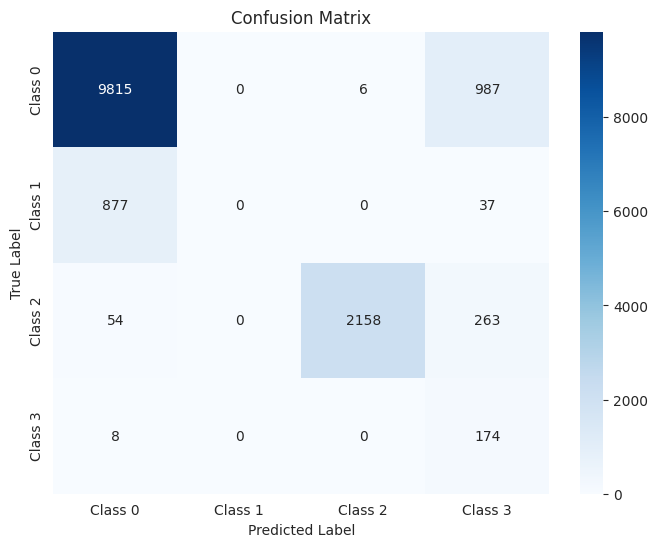

The function took 0.7544 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.91      0.91      0.91      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.99      0.89      0.94       619
     Class 3       0.12      0.96      0.22        46

    accuracy                           0.85      3595
   macro avg       0.51      0.69      0.52      3595
weighted avg       0.86      0.85      0.85      3595



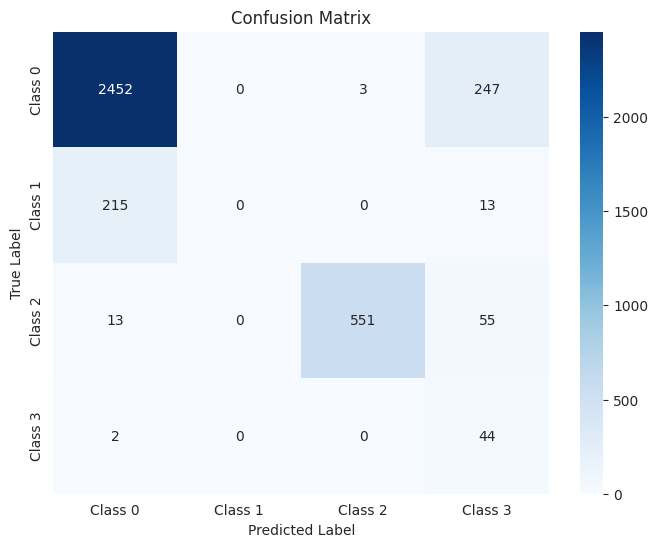

The function took 0.4259 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.91      0.91      0.91      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.99      0.85      0.92       774
     Class 3       0.12      0.93      0.21        57

    accuracy                           0.84      4494
   macro avg       0.50      0.67      0.51      4494
weighted avg       0.86      0.84      0.85      4494



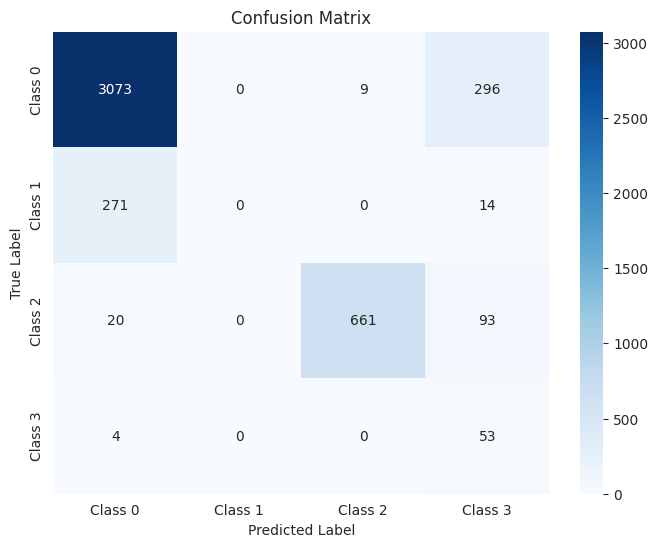

The function took 0.5236 seconds to execute.
[ARCH#194-[16, 16, 16, 16, 2]] done in 34.9s  best-val=0.2688


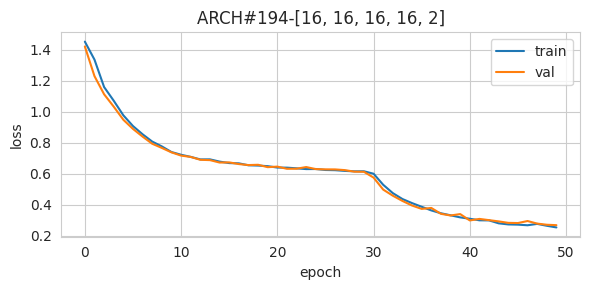


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95     10808
     Class 1       0.71      0.96      0.82       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.22      0.93      0.35       182

    accuracy                           0.92     14379
   macro avg       0.72      0.92      0.76     14379
weighted avg       0.96      0.92      0.93     14379



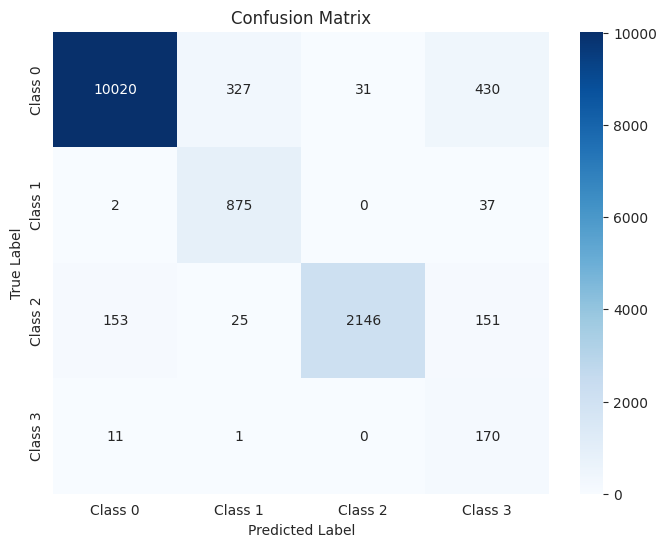

The function took 0.7436 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.73      0.93      0.82       228
     Class 2       0.97      0.88      0.92       619
     Class 3       0.20      0.93      0.33        46

    accuracy                           0.92      3595
   macro avg       0.72      0.92      0.76      3595
weighted avg       0.96      0.92      0.93      3595



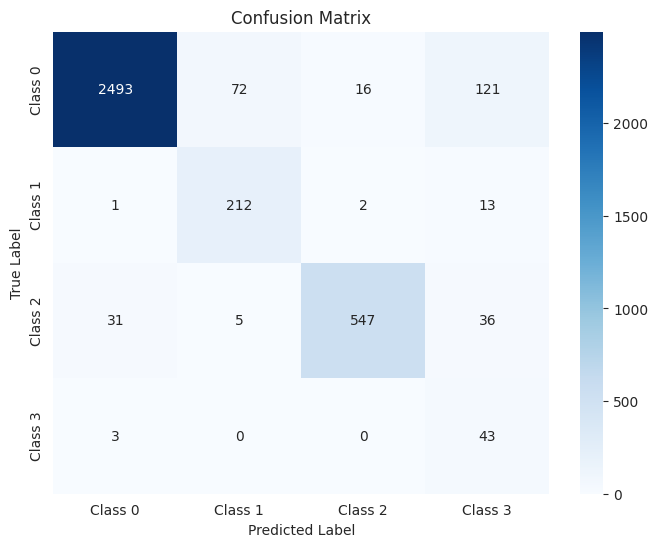

The function took 0.3699 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.70      0.94      0.80       285
     Class 2       0.96      0.84      0.90       774
     Class 3       0.22      0.89      0.35        57

    accuracy                           0.91      4494
   macro avg       0.71      0.90      0.75      4494
weighted avg       0.95      0.91      0.93      4494



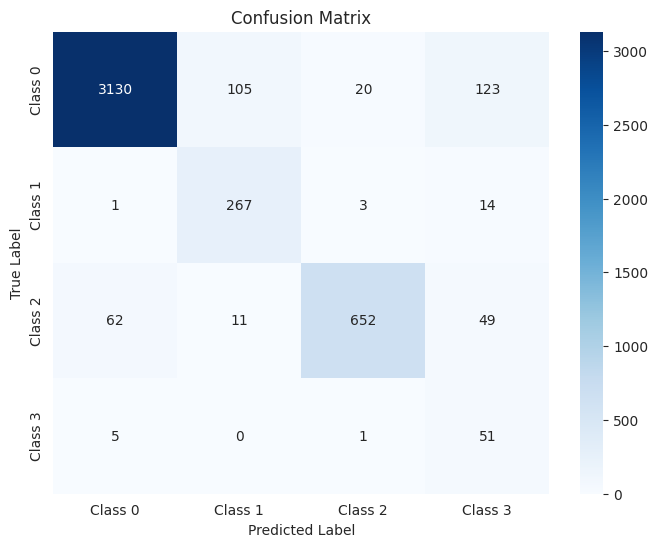

The function took 0.4326 seconds to execute.
[ARCH#195-[16, 16, 16, 8, 8]] done in 34.6s  best-val=0.2442


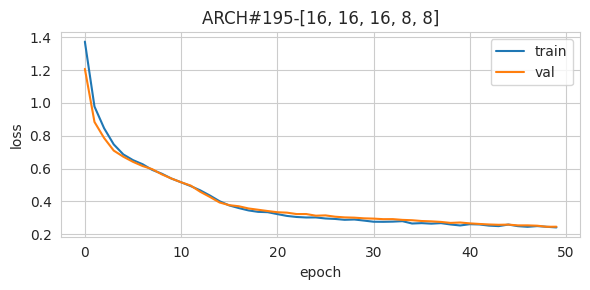


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.74      0.96      0.84       914
     Class 2       0.92      0.93      0.93      2475
     Class 3       0.18      0.91      0.30       182

    accuracy                           0.91     14379
   macro avg       0.71      0.92      0.75     14379
weighted avg       0.95      0.91      0.92     14379



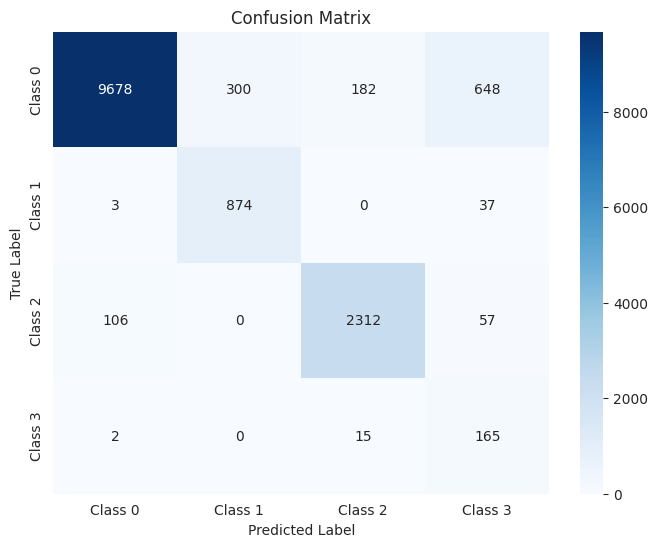

The function took 0.7545 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.76      0.93      0.84       228
     Class 2       0.91      0.95      0.93       619
     Class 3       0.18      0.93      0.30        46

    accuracy                           0.91      3595
   macro avg       0.71      0.93      0.75      3595
weighted avg       0.95      0.91      0.92      3595



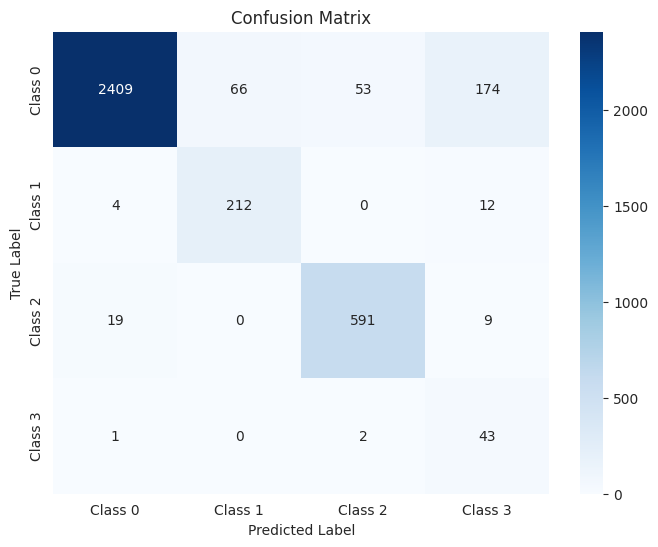

The function took 0.3570 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.90      0.94      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.92      0.93      0.92       774
     Class 3       0.20      0.91      0.33        57

    accuracy                           0.91      4494
   macro avg       0.72      0.92      0.76      4494
weighted avg       0.95      0.91      0.93      4494



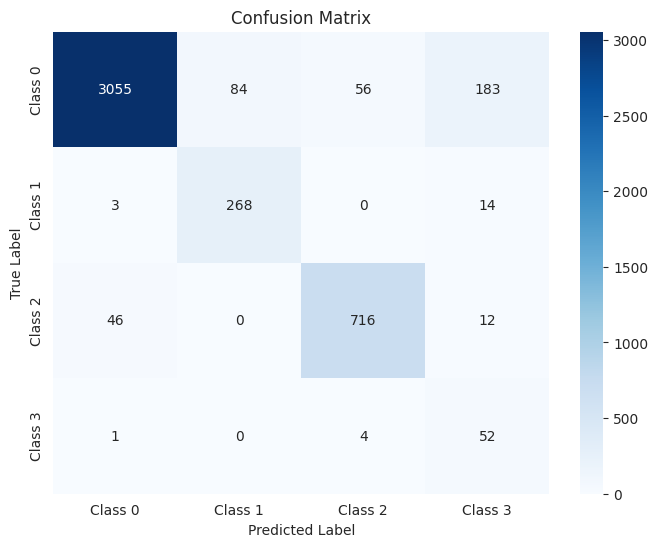

The function took 0.4009 seconds to execute.
[ARCH#196-[16, 16, 16, 8, 4]] done in 35.2s  best-val=0.2675


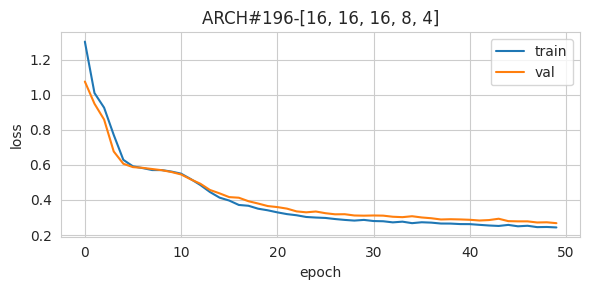


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.94     10808
     Class 1       0.74      0.96      0.84       914
     Class 2       0.93      0.91      0.92      2475
     Class 3       0.25      0.87      0.38       182

    accuracy                           0.92     14379
   macro avg       0.72      0.91      0.77     14379
weighted avg       0.94      0.92      0.93     14379



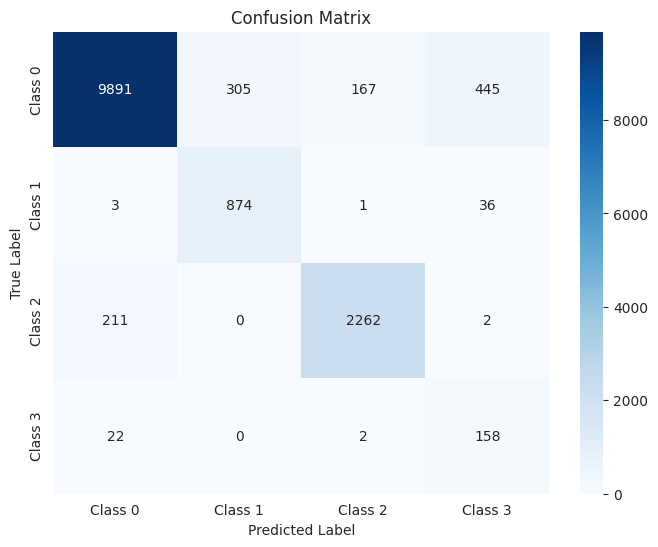

The function took 0.8378 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.92      0.93      0.93       619
     Class 3       0.22      0.85      0.35        46

    accuracy                           0.92      3595
   macro avg       0.72      0.91      0.77      3595
weighted avg       0.95      0.92      0.93      3595



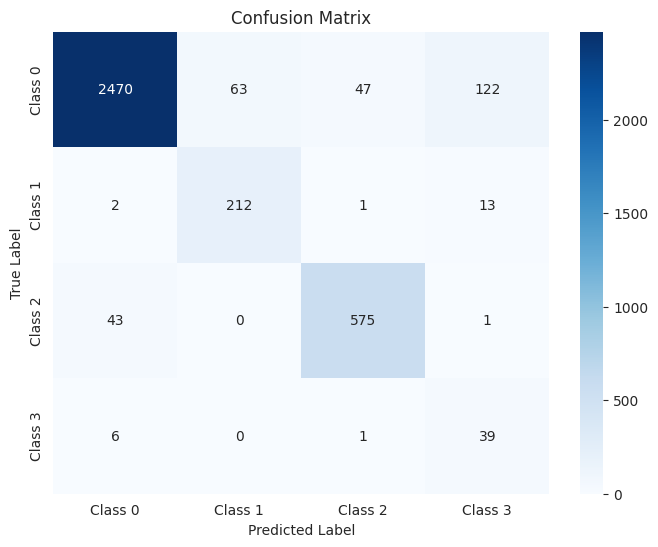

The function took 0.4237 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.92      0.94      3378
     Class 1       0.73      0.93      0.82       285
     Class 2       0.93      0.90      0.91       774
     Class 3       0.24      0.84      0.38        57

    accuracy                           0.91      4494
   macro avg       0.72      0.90      0.76      4494
weighted avg       0.94      0.91      0.92      4494



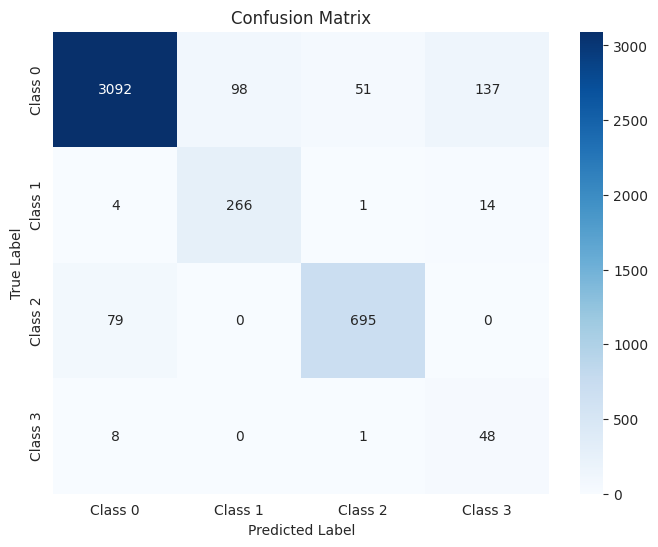

The function took 0.5368 seconds to execute.
[ARCH#197-[16, 16, 16, 8, 2]] done in 34.7s  best-val=0.5060


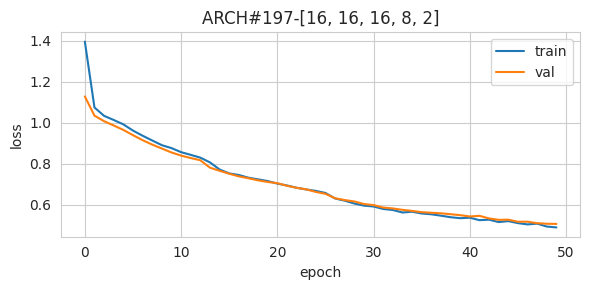


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.95     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.96      0.87      0.91      2475
     Class 3       0.21      0.47      0.29       182

    accuracy                           0.92     14379
   macro avg       0.71      0.81      0.74     14379
weighted avg       0.94      0.92      0.92     14379



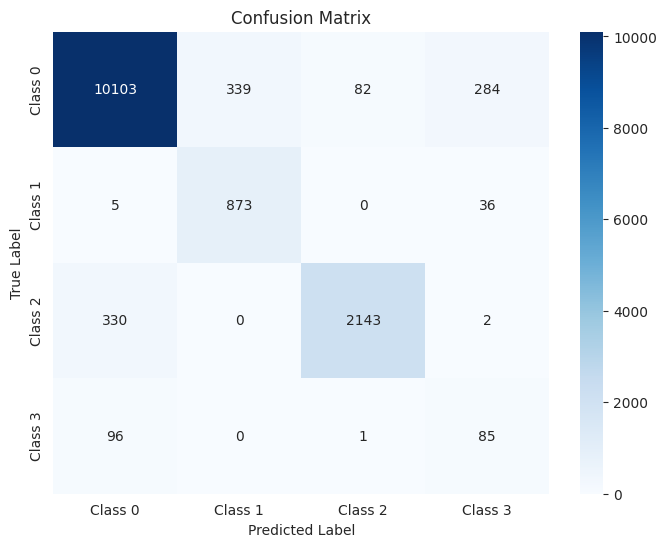

The function took 0.7416 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95      2702
     Class 1       0.74      0.93      0.82       228
     Class 2       0.95      0.89      0.92       619
     Class 3       0.19      0.43      0.26        46

    accuracy                           0.92      3595
   macro avg       0.71      0.80      0.74      3595
weighted avg       0.94      0.92      0.93      3595



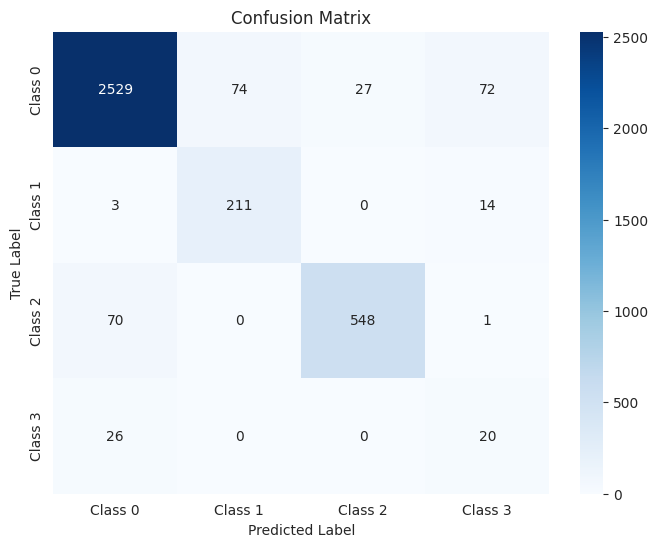

The function took 0.3809 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.93      0.94      3378
     Class 1       0.71      0.94      0.81       285
     Class 2       0.95      0.84      0.89       774
     Class 3       0.20      0.44      0.27        57

    accuracy                           0.91      4494
   macro avg       0.70      0.79      0.73      4494
weighted avg       0.93      0.91      0.92      4494



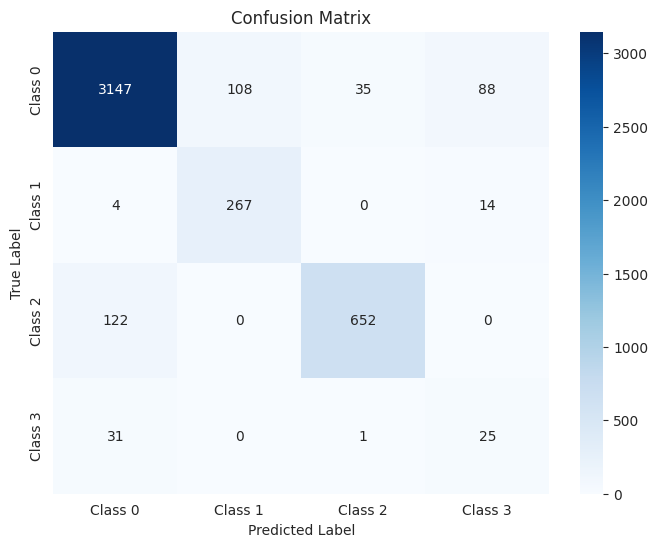

The function took 0.4225 seconds to execute.
[ARCH#198-[16, 16, 16, 4, 4]] done in 34.4s  best-val=0.2782


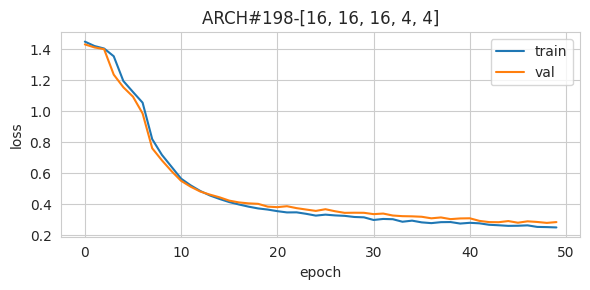


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.85      0.92     10808
     Class 1       0.75      0.95      0.84       914
     Class 2       0.79      0.96      0.87      2475
     Class 3       0.17      0.90      0.29       182

    accuracy                           0.88     14379
   macro avg       0.68      0.92      0.73     14379
weighted avg       0.93      0.88      0.90     14379



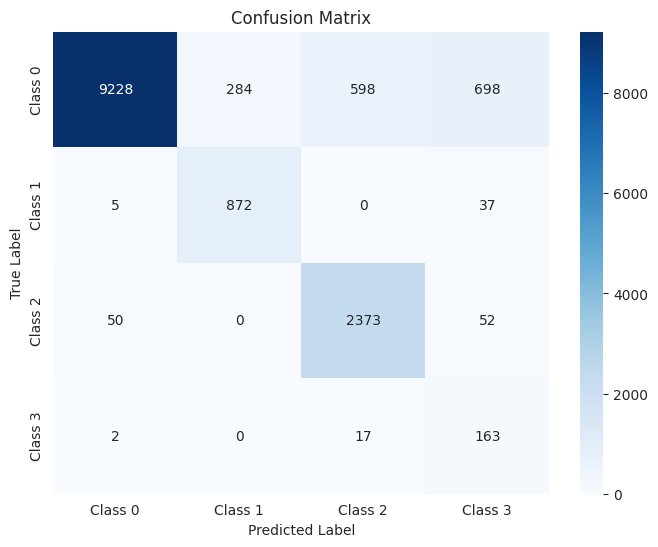

The function took 0.7297 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.86      0.92      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.79      0.96      0.87       619
     Class 3       0.17      0.89      0.28        46

    accuracy                           0.88      3595
   macro avg       0.68      0.91      0.73      3595
weighted avg       0.93      0.88      0.90      3595



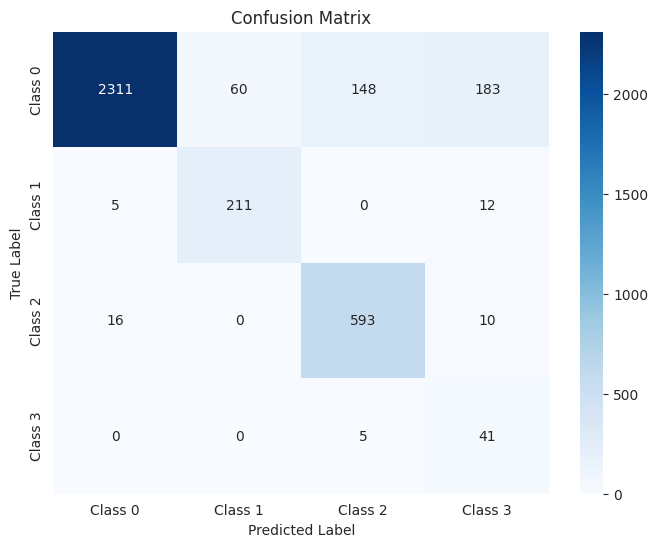

The function took 0.3907 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.86      0.92      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.80      0.96      0.87       774
     Class 3       0.18      0.86      0.29        57

    accuracy                           0.88      4494
   macro avg       0.68      0.90      0.73      4494
weighted avg       0.93      0.88      0.90      4494



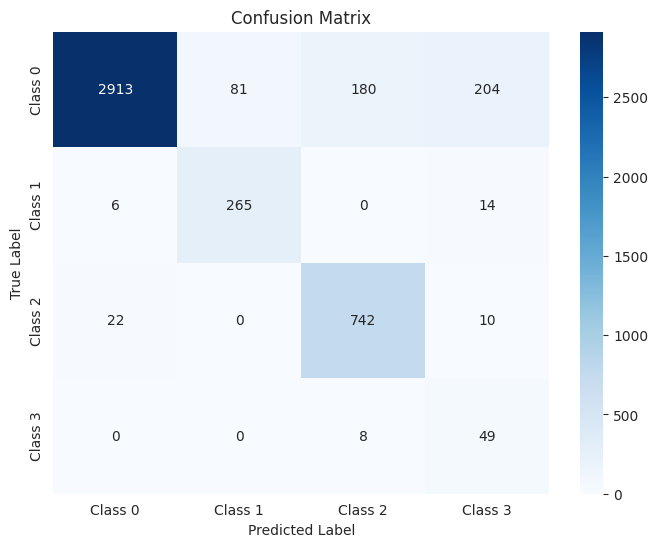

The function took 0.3961 seconds to execute.
[ARCH#199-[16, 16, 16, 4, 2]] done in 33.6s  best-val=0.8277


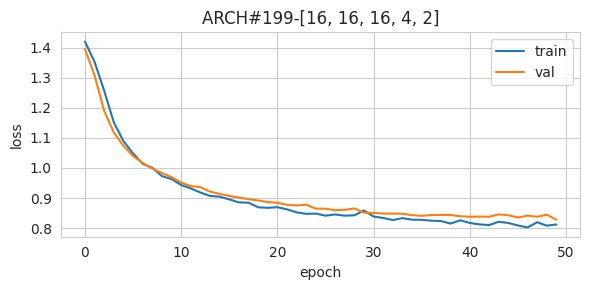


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.01      0.01     10808
     Class 1       0.76      0.86      0.80       914
     Class 2       0.19      1.00      0.32      2475
     Class 3       0.40      0.88      0.55       182

    accuracy                           0.24     14379
   macro avg       0.58      0.69      0.42     14379
weighted avg       0.83      0.24      0.12     14379



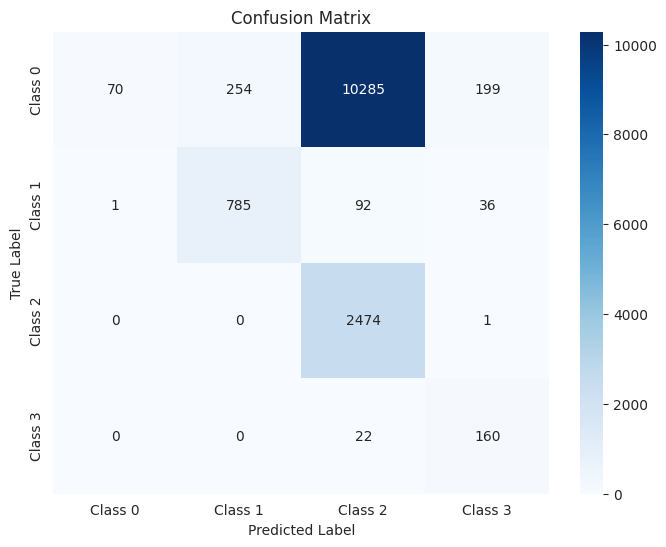

The function took 0.8037 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.01      0.01      2702
     Class 1       0.75      0.81      0.78       228
     Class 2       0.19      1.00      0.32       619
     Class 3       0.38      0.85      0.52        46

    accuracy                           0.24      3595
   macro avg       0.57      0.67      0.41      3595
weighted avg       0.79      0.24      0.12      3595



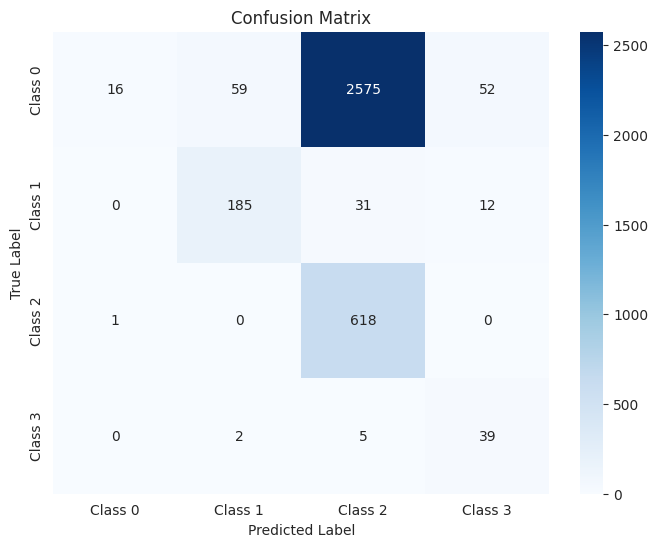

The function took 0.4389 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.01      0.01      3378
     Class 1       0.75      0.84      0.80       285
     Class 2       0.19      1.00      0.32       774
     Class 3       0.40      0.82      0.54        57

    accuracy                           0.24      4494
   macro avg       0.58      0.67      0.42      4494
weighted avg       0.81      0.24      0.12      4494



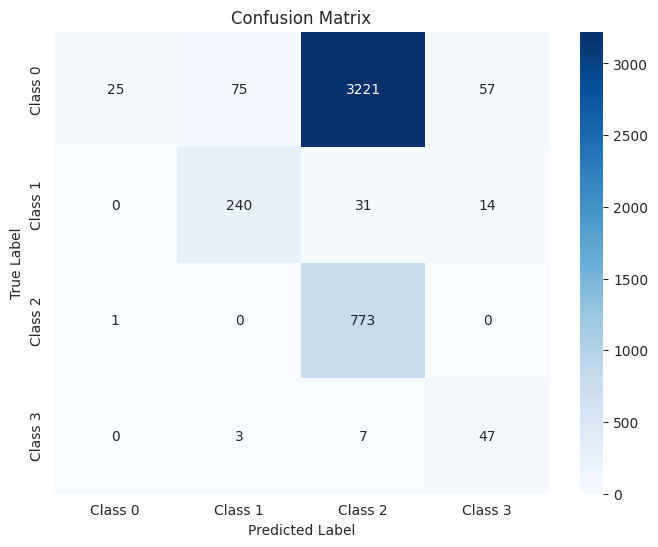

The function took 0.4842 seconds to execute.
[ARCH#200-[16, 16, 16, 2, 2]] done in 34.5s  best-val=0.6355


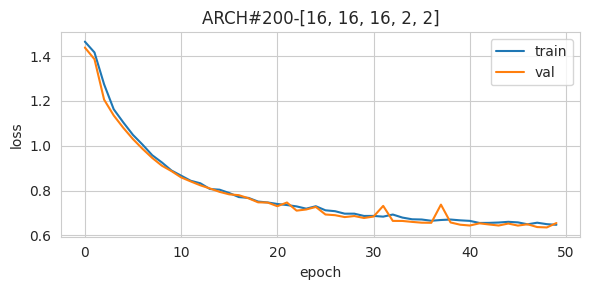


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90     10808
     Class 1       0.26      0.95      0.41       914
     Class 2       0.36      0.02      0.04      2475
     Class 3       0.09      0.98      0.16       182

    accuracy                           0.69     14379
   macro avg       0.43      0.69      0.38     14379
weighted avg       0.83      0.69      0.71     14379



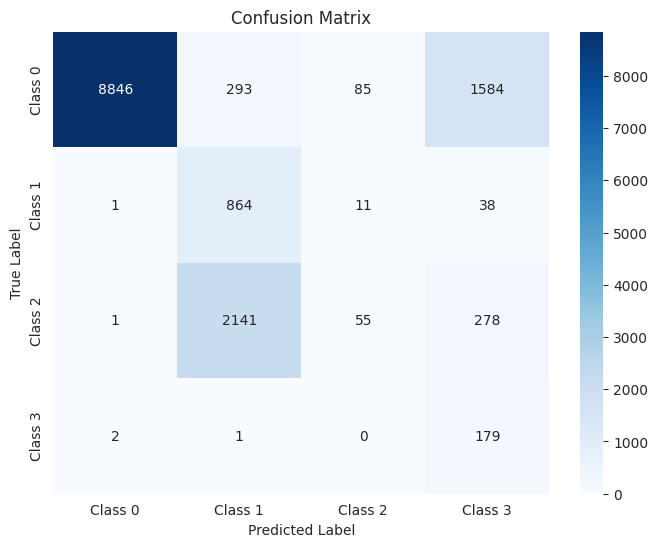

The function took 0.7629 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90      2702
     Class 1       0.26      0.92      0.40       228
     Class 2       0.30      0.02      0.03       619
     Class 3       0.09      0.98      0.16        46

    accuracy                           0.69      3595
   macro avg       0.41      0.68      0.37      3595
weighted avg       0.82      0.69      0.71      3595



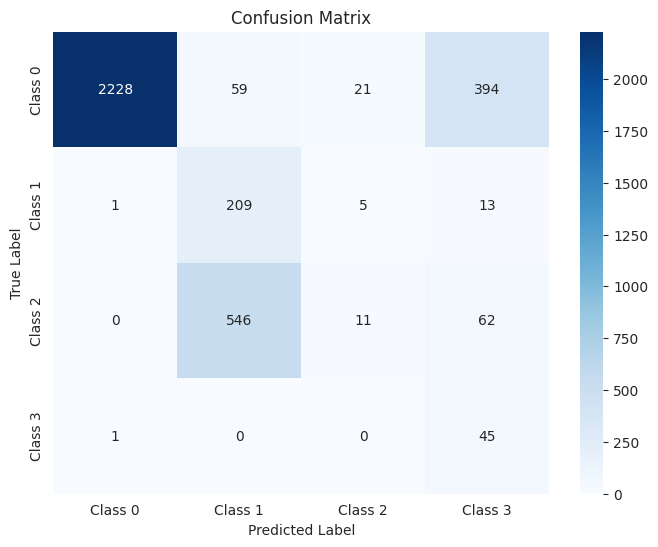

The function took 0.4081 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90      3378
     Class 1       0.26      0.93      0.41       285
     Class 2       0.28      0.02      0.04       774
     Class 3       0.08      0.95      0.15        57

    accuracy                           0.69      4494
   macro avg       0.41      0.68      0.38      4494
weighted avg       0.82      0.69      0.71      4494



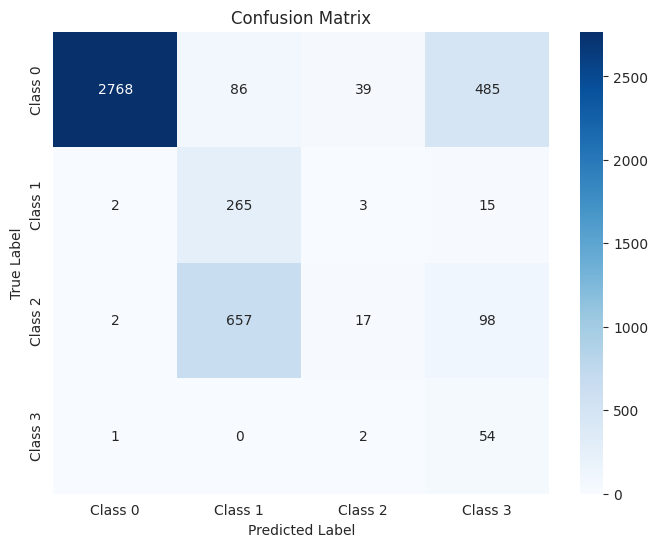

The function took 0.4090 seconds to execute.
[ARCH#201-[16, 16, 8, 8, 8]] done in 34.5s  best-val=0.2605


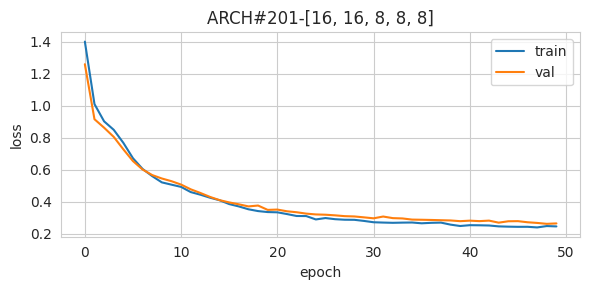


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.74      0.96      0.83       914
     Class 2       0.92      0.91      0.92      2475
     Class 3       0.18      0.97      0.30       182

    accuracy                           0.90     14379
   macro avg       0.71      0.93      0.75     14379
weighted avg       0.95      0.90      0.92     14379



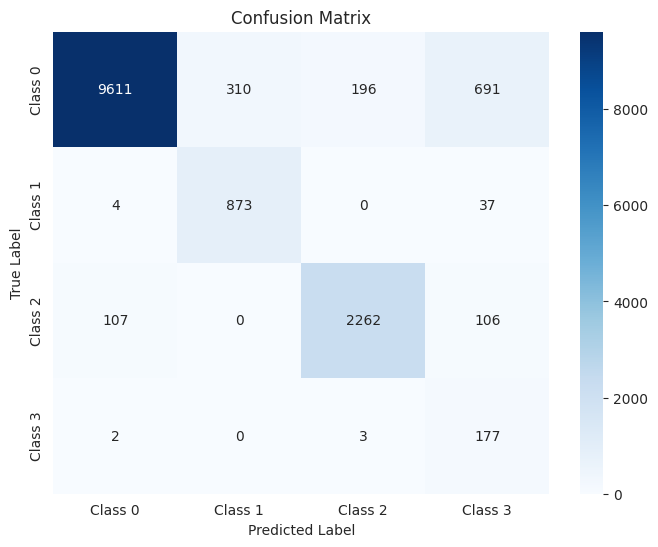

The function took 0.7232 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.76      0.93      0.84       228
     Class 2       0.92      0.93      0.92       619
     Class 3       0.16      0.93      0.27        46

    accuracy                           0.90      3595
   macro avg       0.71      0.92      0.74      3595
weighted avg       0.95      0.90      0.92      3595



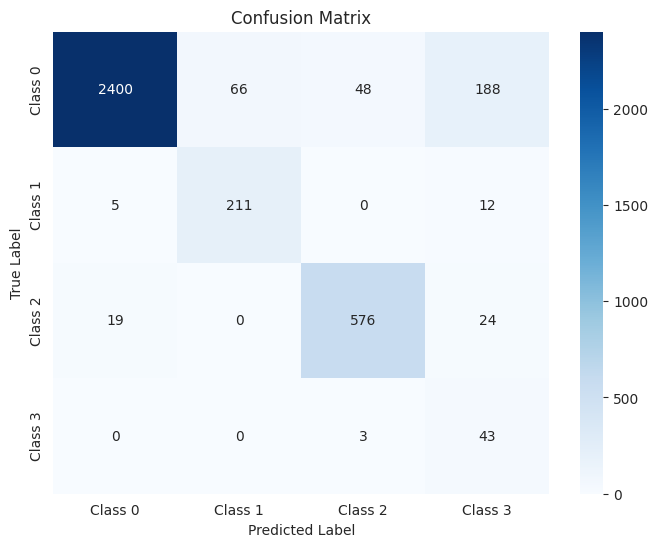

The function took 0.4023 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.90      0.94      3378
     Class 1       0.74      0.94      0.82       285
     Class 2       0.91      0.90      0.90       774
     Class 3       0.18      0.93      0.31        57

    accuracy                           0.90      4494
   macro avg       0.70      0.92      0.74      4494
weighted avg       0.95      0.90      0.92      4494



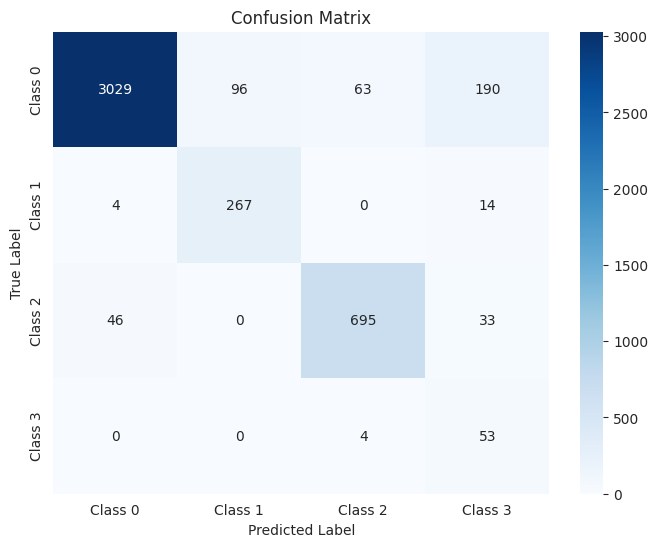

The function took 0.4109 seconds to execute.
[ARCH#202-[16, 16, 8, 8, 4]] done in 33.9s  best-val=0.4279


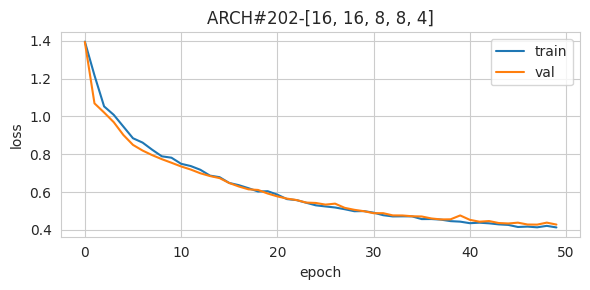


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95     10808
     Class 1       0.78      0.95      0.86       914
     Class 2       0.98      0.86      0.92      2475
     Class 3       0.23      0.87      0.37       182

    accuracy                           0.92     14379
   macro avg       0.74      0.90      0.77     14379
weighted avg       0.95      0.92      0.93     14379



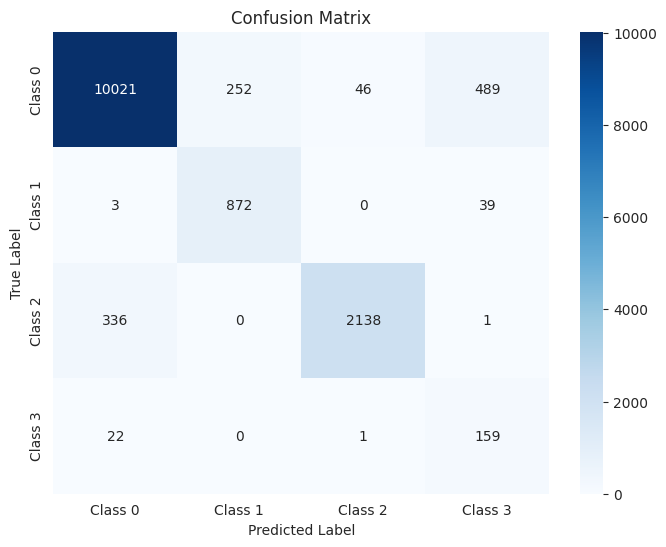

The function took 0.7710 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95      2702
     Class 1       0.80      0.93      0.86       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.23      0.87      0.36        46

    accuracy                           0.92      3595
   macro avg       0.74      0.90      0.77      3595
weighted avg       0.95      0.92      0.93      3595



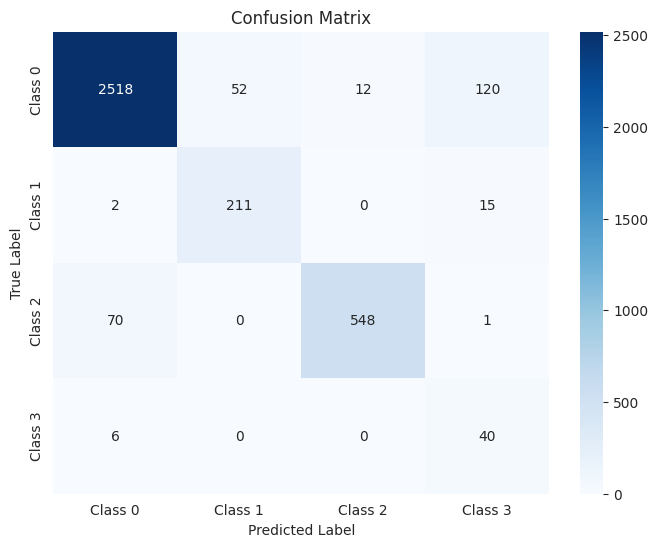

The function took 0.4627 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.94      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.98      0.84      0.90       774
     Class 3       0.22      0.82      0.35        57

    accuracy                           0.91      4494
   macro avg       0.73      0.88      0.76      4494
weighted avg       0.94      0.91      0.92      4494



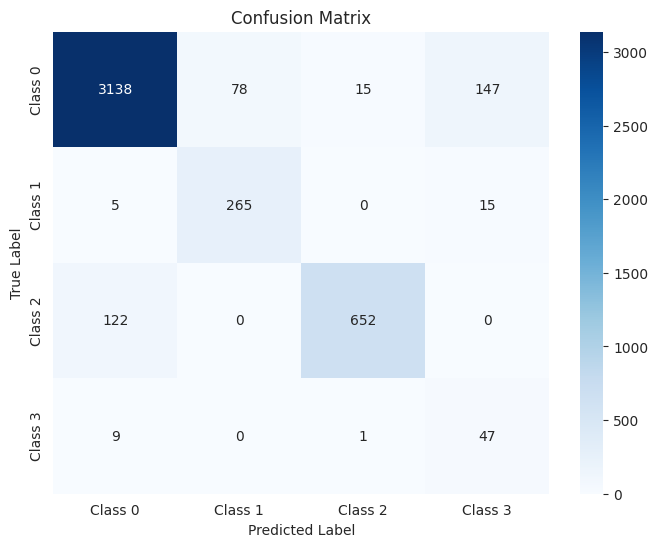

The function took 0.4734 seconds to execute.
[ARCH#203-[16, 16, 8, 8, 2]] early-stop @ epoch 037
[ARCH#203-[16, 16, 8, 8, 2]] done in 26.6s  best-val=1.3794


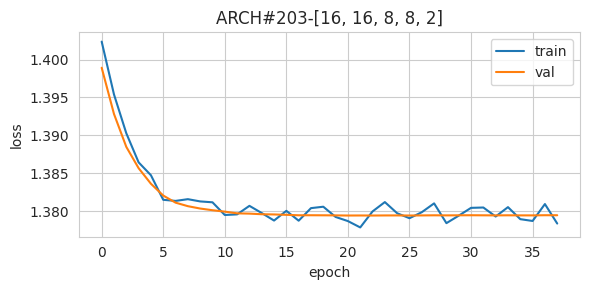


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



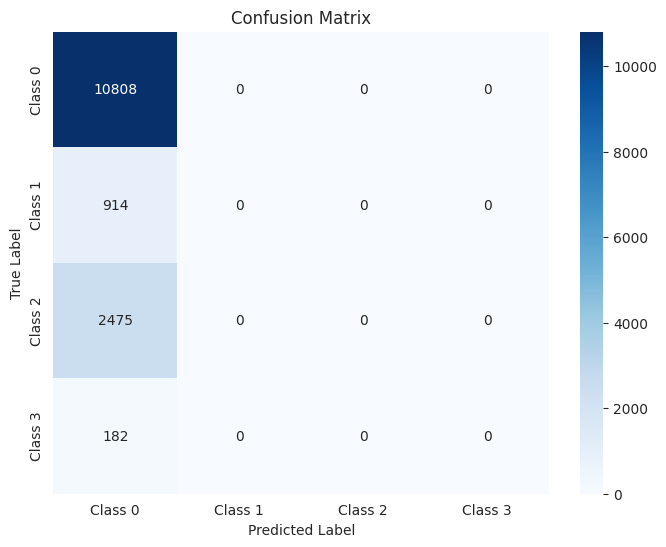

The function took 0.7534 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



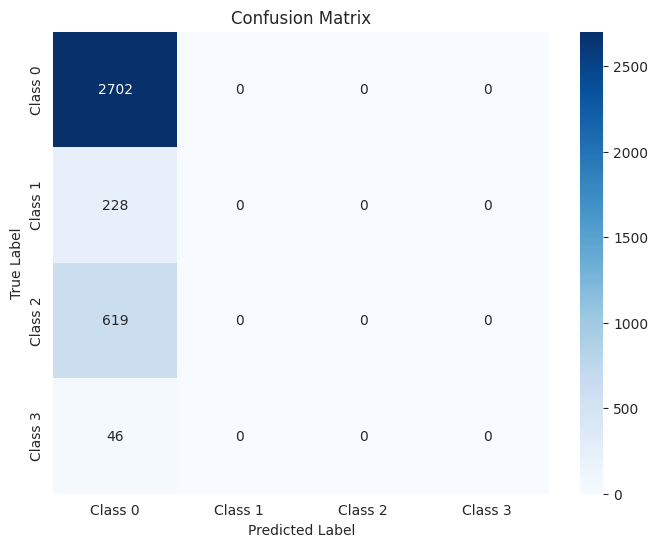

The function took 0.3804 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



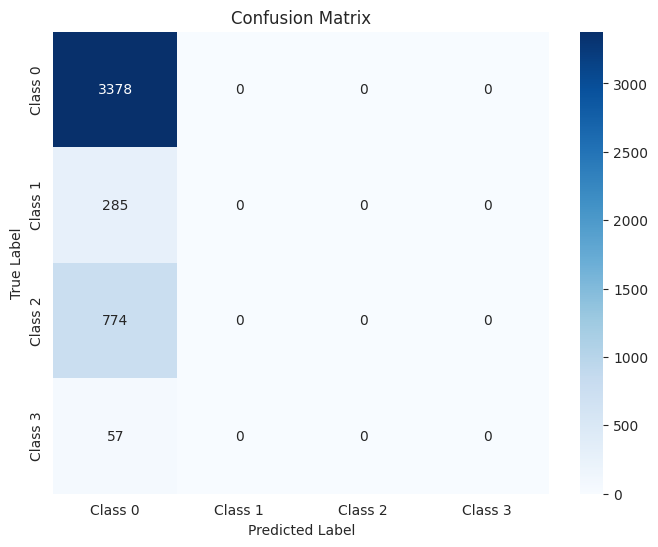

The function took 0.4674 seconds to execute.
[ARCH#204-[16, 16, 8, 4, 4]] done in 34.6s  best-val=0.2623


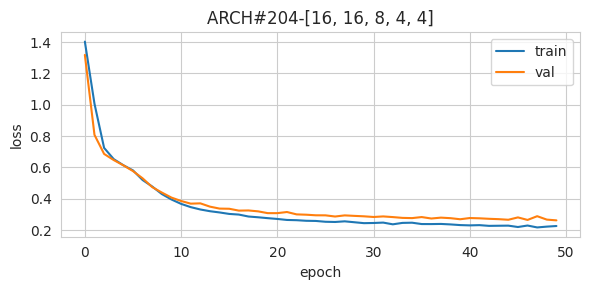


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.74      0.96      0.84       914
     Class 2       0.85      0.93      0.89      2475
     Class 3       0.33      0.92      0.48       182

    accuracy                           0.92     14379
   macro avg       0.73      0.93      0.79     14379
weighted avg       0.94      0.92      0.92     14379



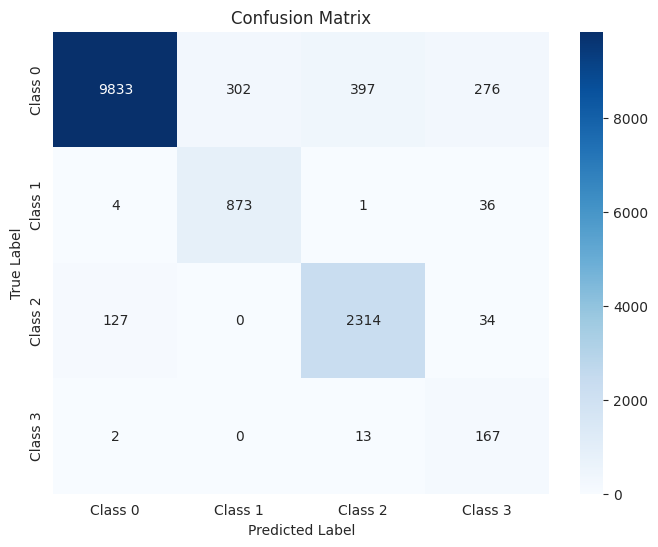

The function took 0.7665 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.85      0.95      0.90       619
     Class 3       0.29      0.89      0.44        46

    accuracy                           0.92      3595
   macro avg       0.73      0.92      0.78      3595
weighted avg       0.94      0.92      0.93      3595



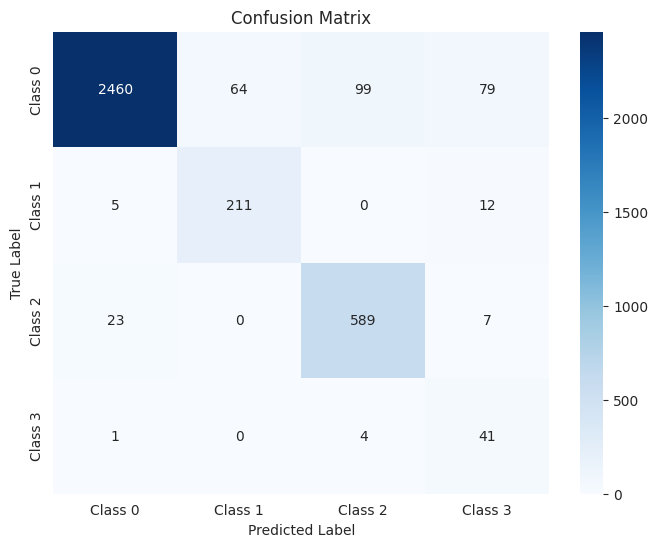

The function took 0.3660 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.74      0.93      0.82       285
     Class 2       0.87      0.92      0.89       774
     Class 3       0.32      0.88      0.47        57

    accuracy                           0.92      4494
   macro avg       0.73      0.91      0.79      4494
weighted avg       0.94      0.92      0.93      4494



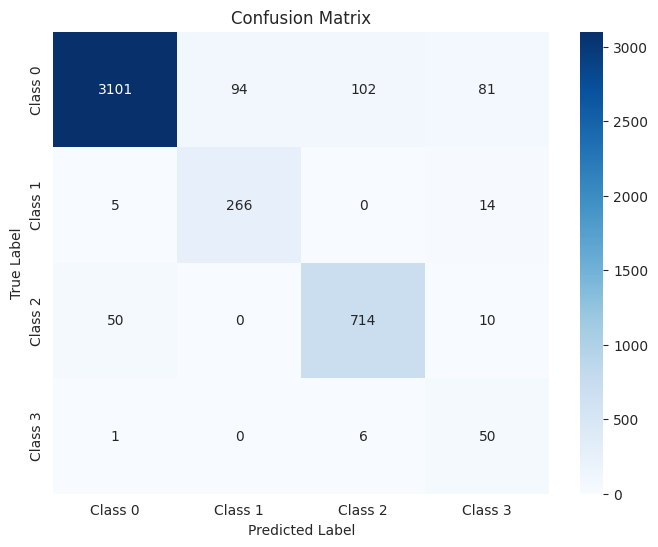

The function took 0.4273 seconds to execute.
[ARCH#205-[16, 16, 8, 4, 2]] done in 34.6s  best-val=0.2801


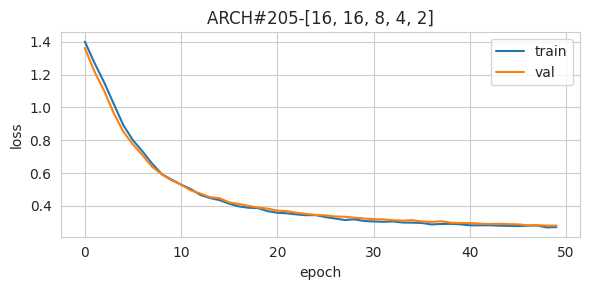


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93     10808
     Class 1       0.74      0.96      0.84       914
     Class 2       0.90      0.94      0.92      2475
     Class 3       0.16      0.91      0.27       182

    accuracy                           0.89     14379
   macro avg       0.70      0.92      0.74     14379
weighted avg       0.95      0.89      0.91     14379



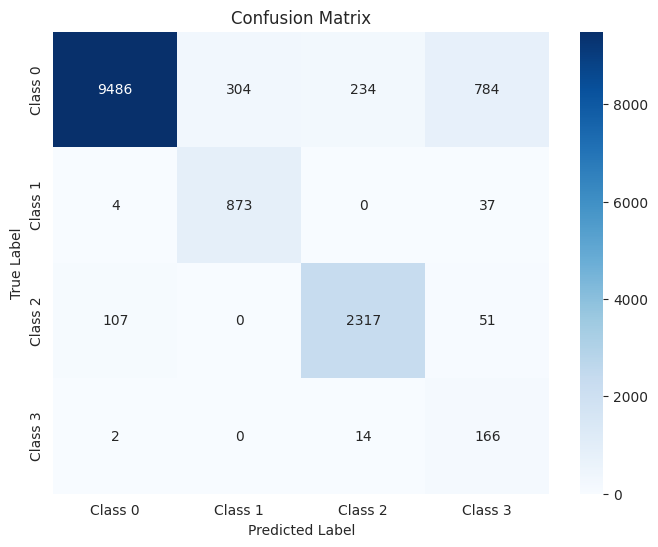

The function took 0.7253 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.87      0.93      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.90      0.96      0.93       619
     Class 3       0.16      0.96      0.27        46

    accuracy                           0.89      3595
   macro avg       0.70      0.93      0.74      3595
weighted avg       0.95      0.89      0.91      3595



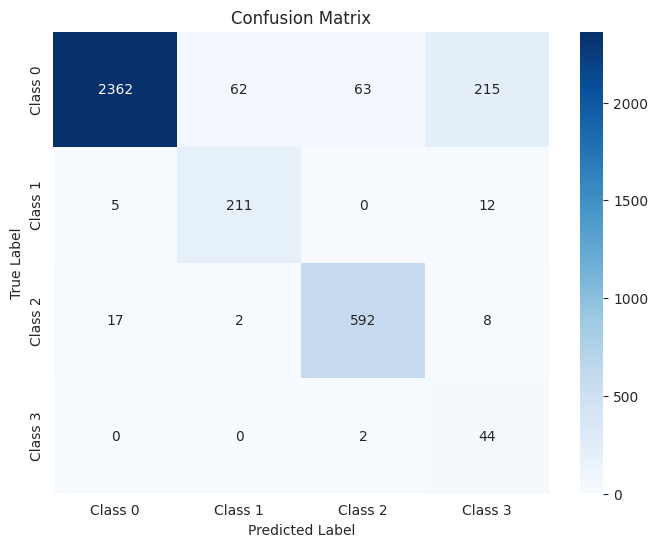

The function took 0.3612 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.88      0.93      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.89      0.93      0.91       774
     Class 3       0.18      0.91      0.30        57

    accuracy                           0.90      4494
   macro avg       0.70      0.92      0.74      4494
weighted avg       0.94      0.90      0.91      4494



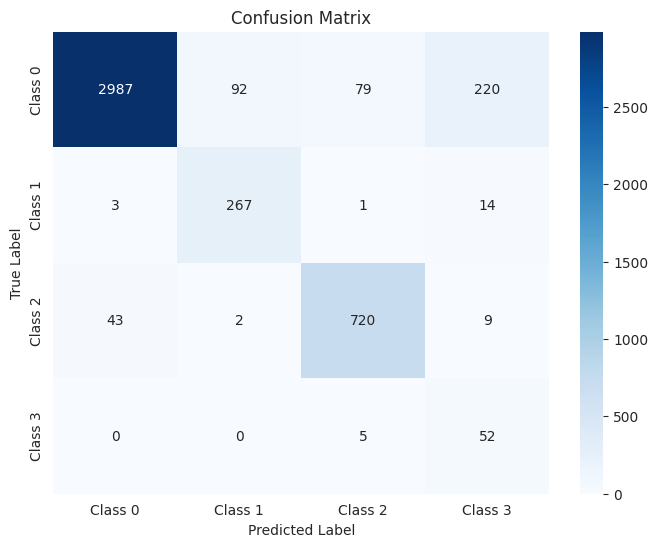

The function took 0.3986 seconds to execute.
[ARCH#206-[16, 16, 8, 2, 2]] done in 33.6s  best-val=1.3794


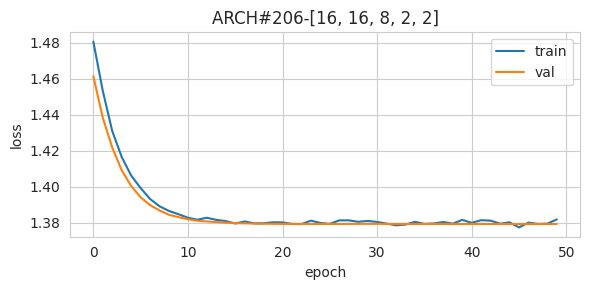


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



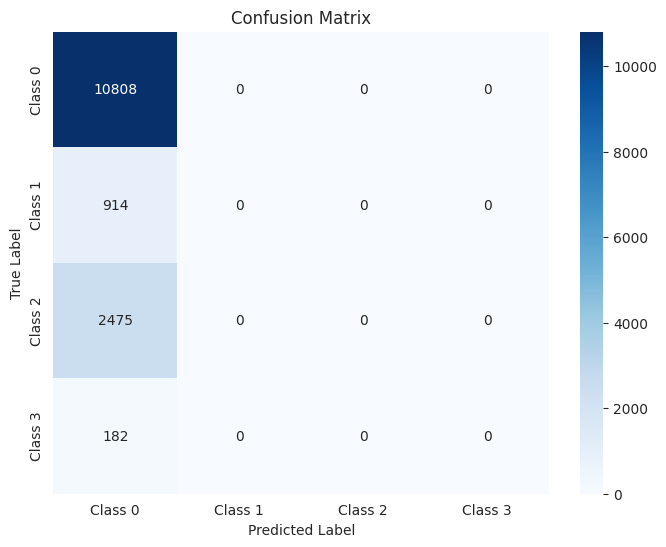

The function took 0.7149 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



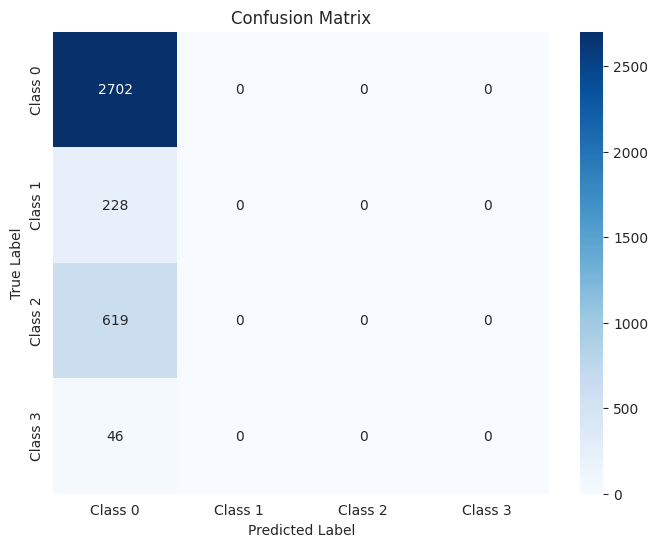

The function took 0.3682 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



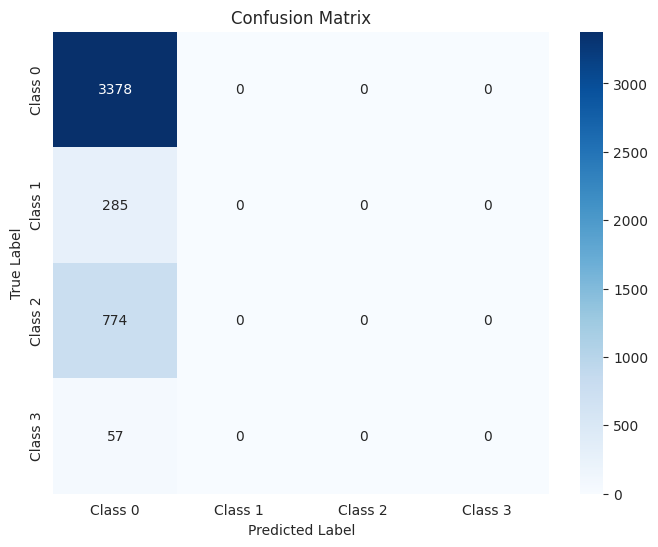

The function took 0.4010 seconds to execute.
[ARCH#207-[16, 16, 4, 4, 4]] done in 34.5s  best-val=0.3537


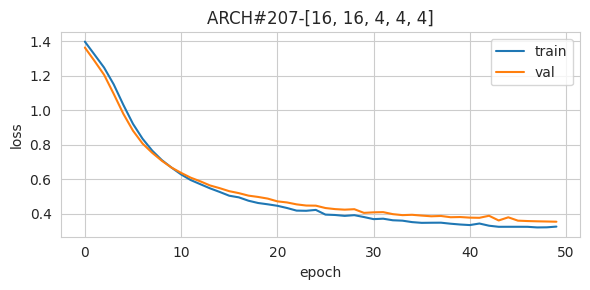


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.84      0.91     10808
     Class 1       0.79      0.95      0.86       914
     Class 2       0.98      0.88      0.93      2475
     Class 3       0.09      0.97      0.16       182

    accuracy                           0.85     14379
   macro avg       0.71      0.91      0.72     14379
weighted avg       0.97      0.85      0.90     14379



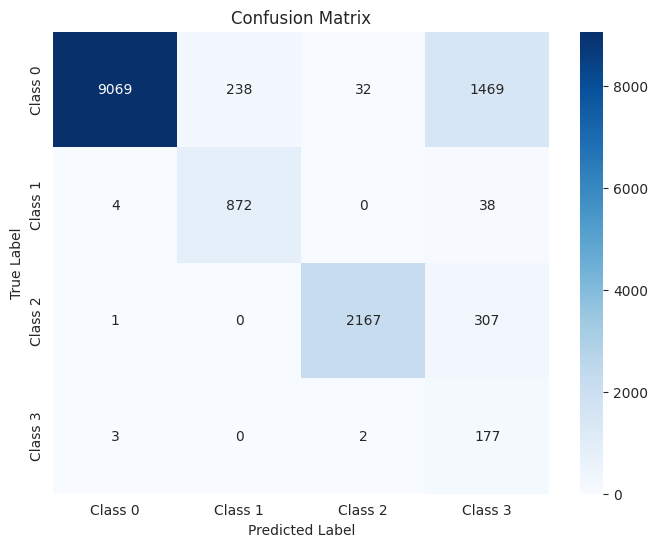

The function took 0.7284 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.84      0.91      2702
     Class 1       0.81      0.93      0.87       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.09      0.98      0.17        46

    accuracy                           0.86      3595
   macro avg       0.72      0.91      0.72      3595
weighted avg       0.97      0.86      0.90      3595



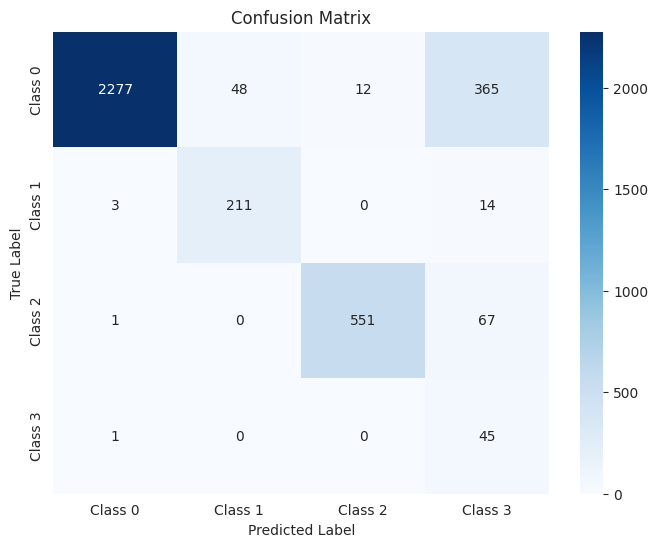

The function took 0.3652 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.84      0.91      3378
     Class 1       0.79      0.93      0.85       285
     Class 2       0.97      0.86      0.91       774
     Class 3       0.09      0.96      0.16        57

    accuracy                           0.85      4494
   macro avg       0.71      0.90      0.71      4494
weighted avg       0.97      0.85      0.90      4494



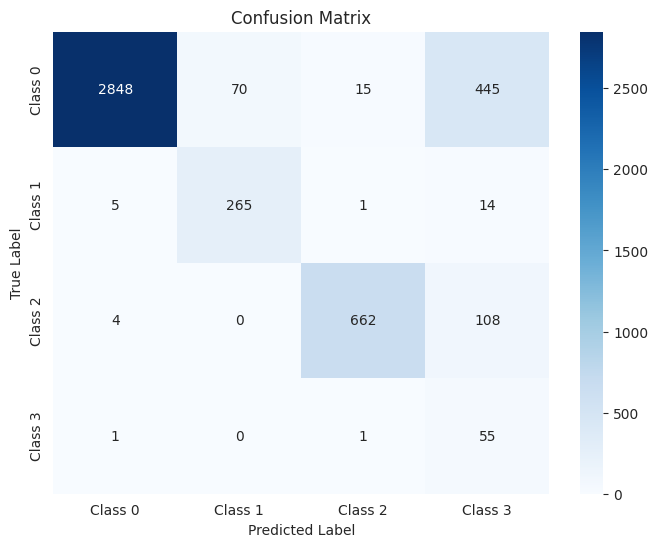

The function took 0.4024 seconds to execute.
[ARCH#208-[16, 16, 4, 4, 2]] done in 34.1s  best-val=0.4177


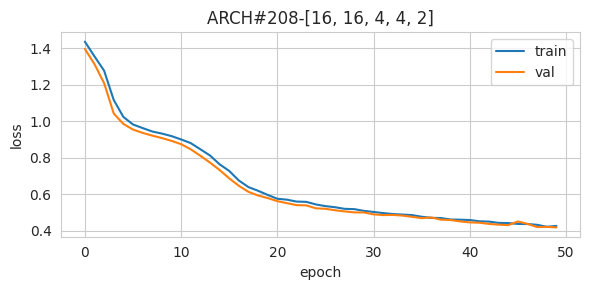


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95     10808
     Class 1       0.76      0.91      0.83       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.24      0.87      0.37       182

    accuracy                           0.92     14379
   macro avg       0.74      0.90      0.77     14379
weighted avg       0.95      0.92      0.93     14379



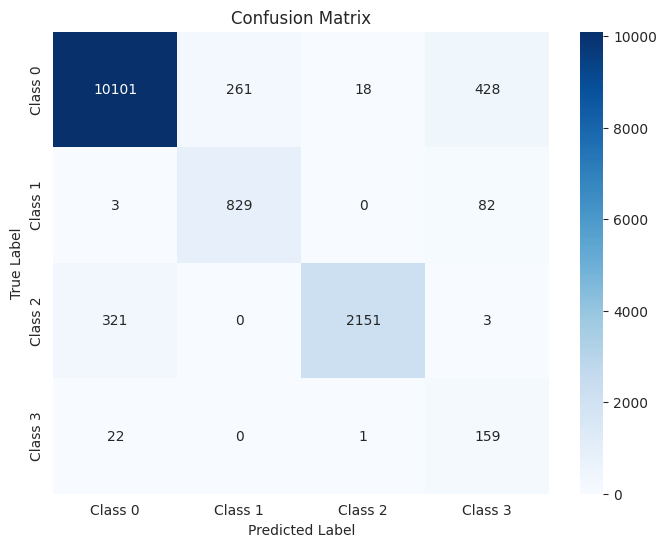

The function took 1.4229 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95      2702
     Class 1       0.79      0.87      0.83       228
     Class 2       0.98      0.88      0.93       619
     Class 3       0.23      0.85      0.36        46

    accuracy                           0.92      3595
   macro avg       0.74      0.89      0.77      3595
weighted avg       0.95      0.92      0.93      3595



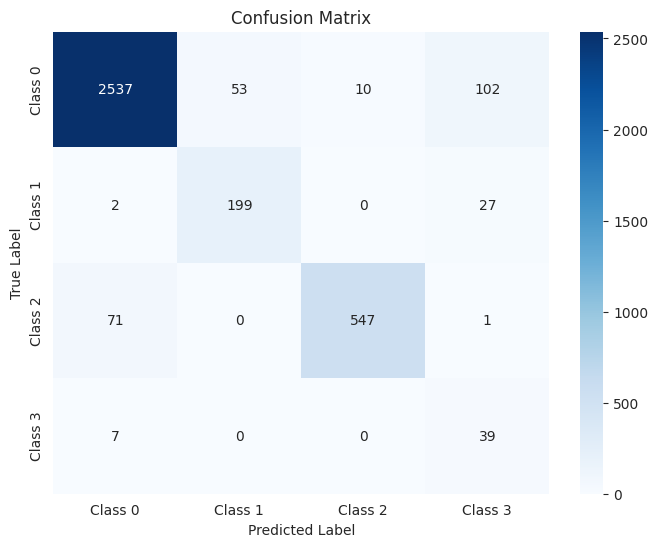

The function took 0.3914 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.95      3378
     Class 1       0.76      0.88      0.82       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.22      0.82      0.35        57

    accuracy                           0.91      4494
   macro avg       0.73      0.87      0.75      4494
weighted avg       0.94      0.91      0.92      4494



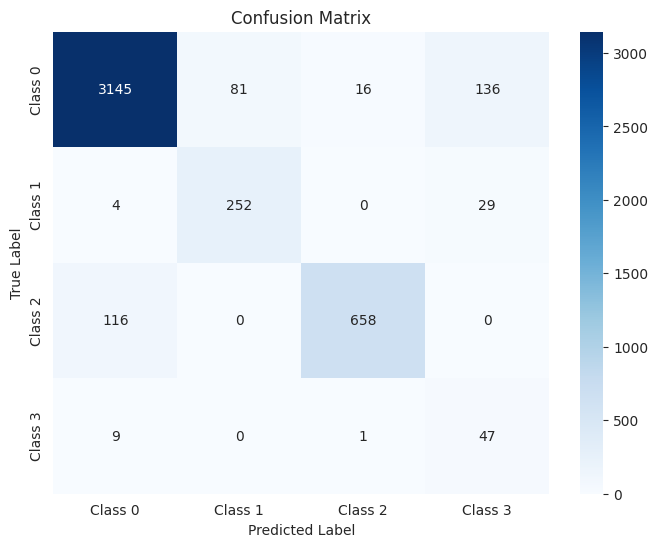

The function took 0.4130 seconds to execute.
[ARCH#209-[16, 16, 4, 2, 2]] done in 33.9s  best-val=0.9805


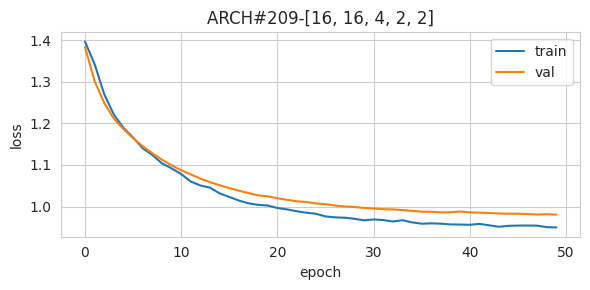


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.79      0.98      0.88     10808
     Class 1       0.77      0.91      0.83       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.79     14379
   macro avg       0.39      0.47      0.43     14379
weighted avg       0.65      0.79      0.71     14379



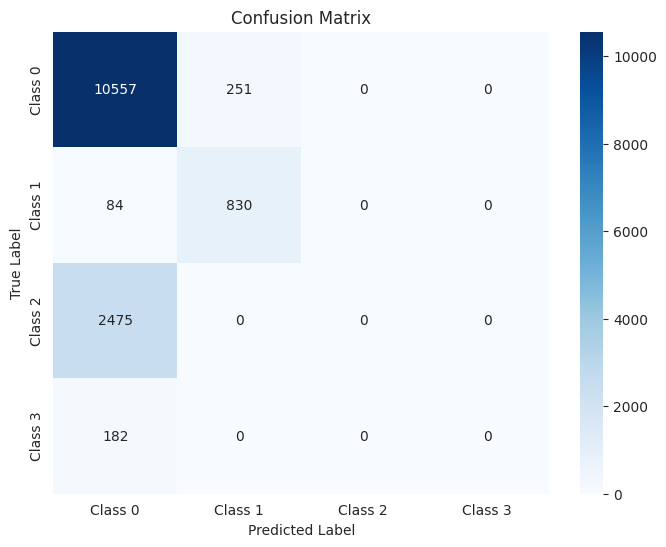

The function took 0.7525 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.79      0.98      0.88      2702
     Class 1       0.79      0.87      0.83       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.79      3595
   macro avg       0.39      0.46      0.43      3595
weighted avg       0.65      0.79      0.71      3595



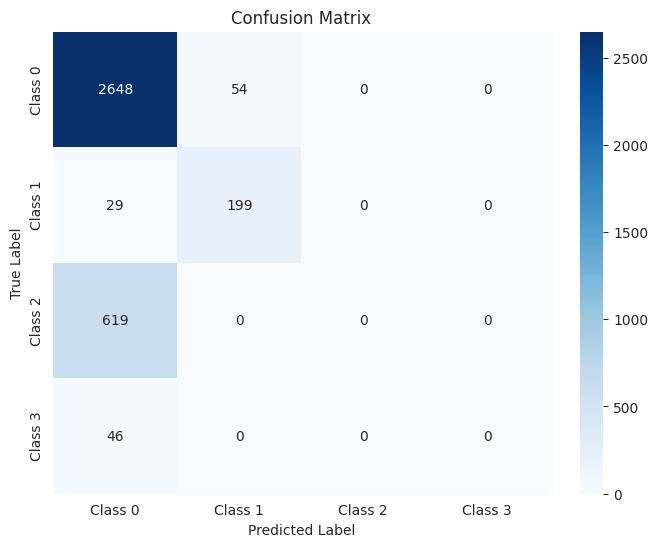

The function took 0.3815 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.79      0.98      0.88      3378
     Class 1       0.77      0.88      0.82       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.79      4494
   macro avg       0.39      0.47      0.42      4494
weighted avg       0.64      0.79      0.71      4494



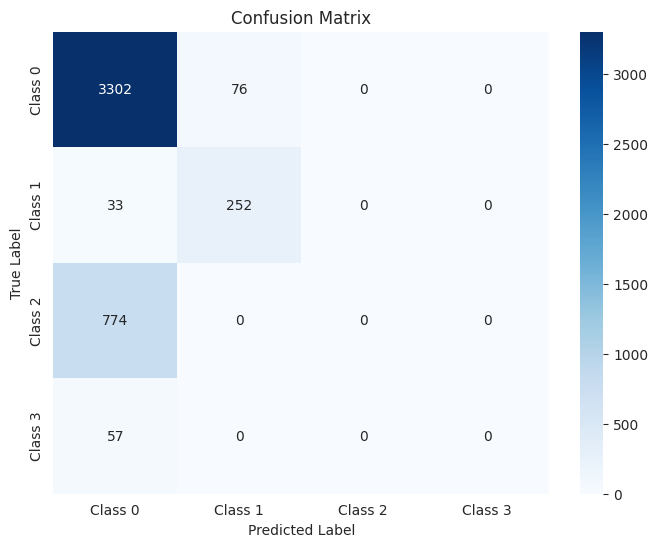

The function took 0.4104 seconds to execute.
[ARCH#210-[16, 16, 2, 2, 2]] done in 34.8s  best-val=1.3794


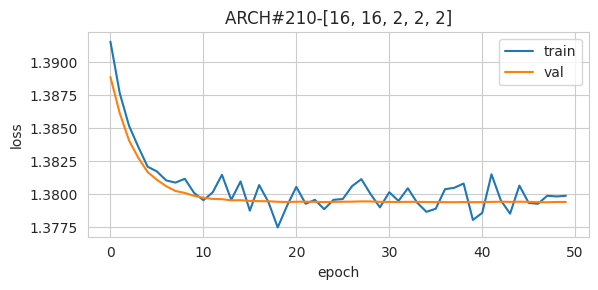


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



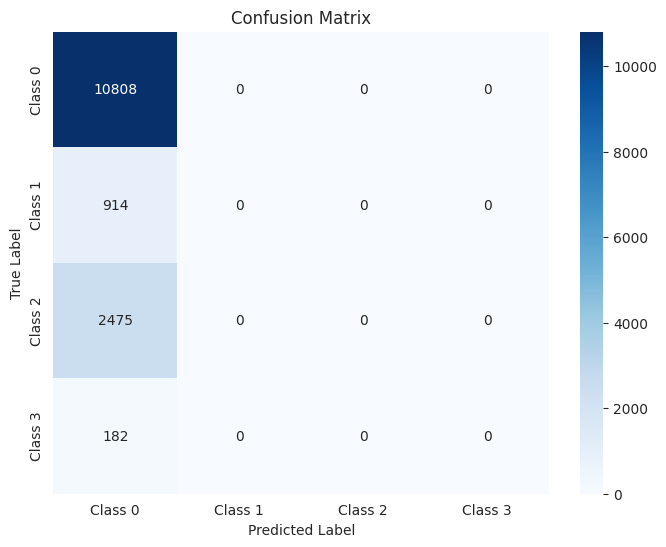

The function took 0.7106 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



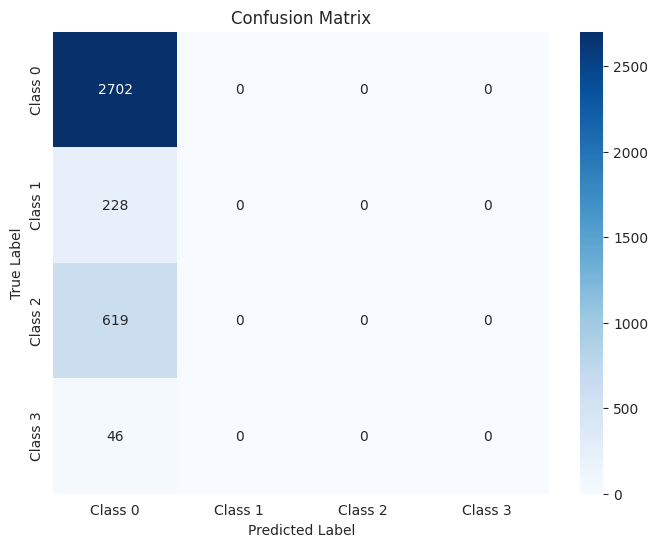

The function took 0.3729 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



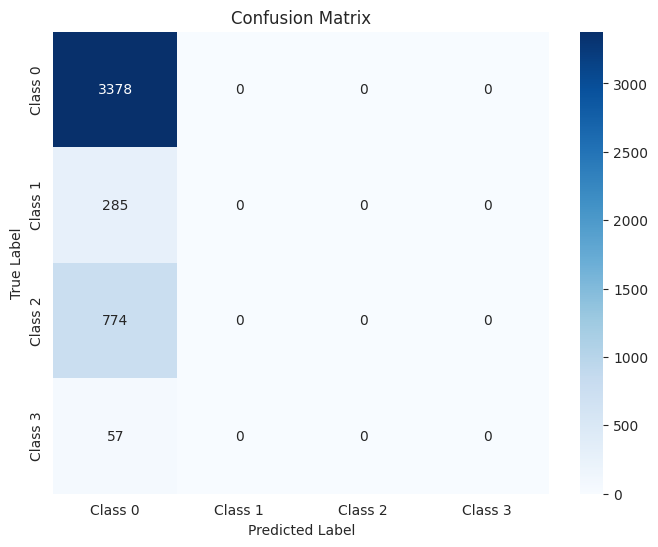

The function took 0.4073 seconds to execute.
[ARCH#211-[16, 8, 8, 8, 8]] done in 34.5s  best-val=0.2310


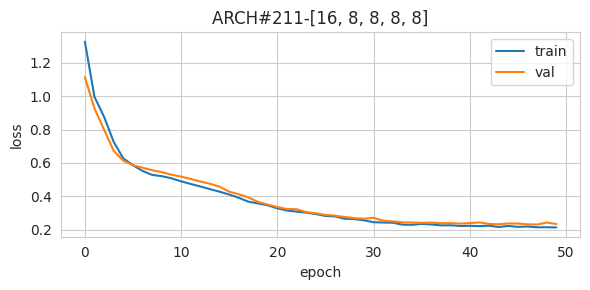


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.85      0.91      0.88      2475
     Class 3       0.26      0.98      0.41       182

    accuracy                           0.91     14379
   macro avg       0.72      0.94      0.77     14379
weighted avg       0.94      0.91      0.92     14379



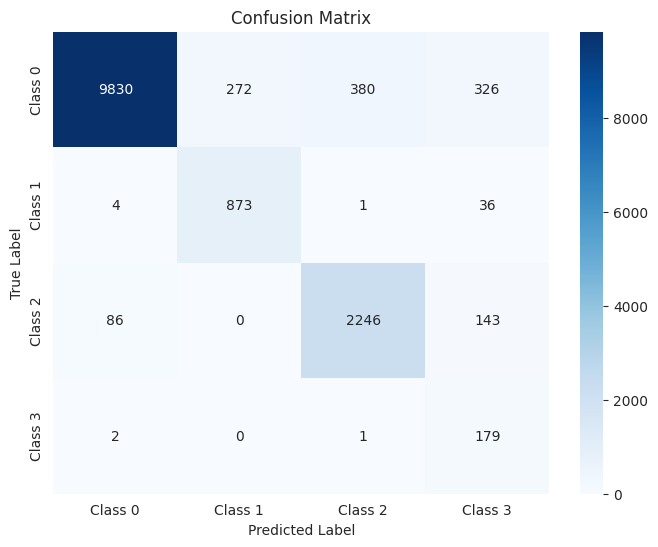

The function took 0.7371 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.87      0.91      0.89       619
     Class 3       0.25      1.00      0.40        46

    accuracy                           0.92      3595
   macro avg       0.72      0.94      0.77      3595
weighted avg       0.95      0.92      0.93      3595



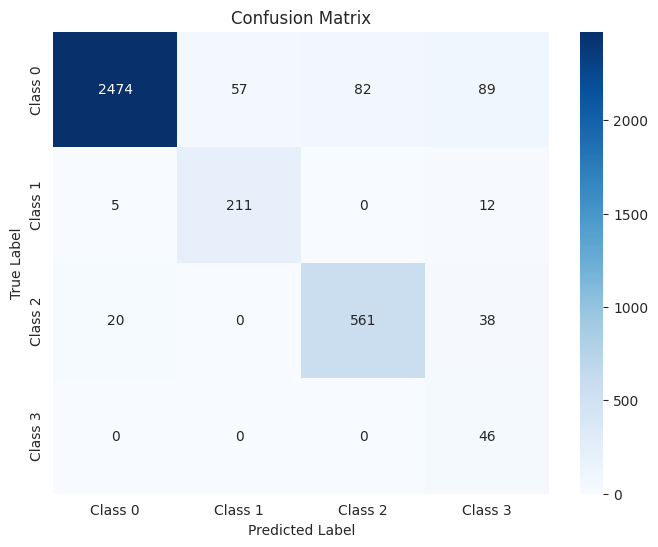

The function took 0.3751 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      3378
     Class 1       0.76      0.93      0.84       285
     Class 2       0.86      0.90      0.88       774
     Class 3       0.25      0.93      0.40        57

    accuracy                           0.91      4494
   macro avg       0.72      0.92      0.77      4494
weighted avg       0.94      0.91      0.92      4494



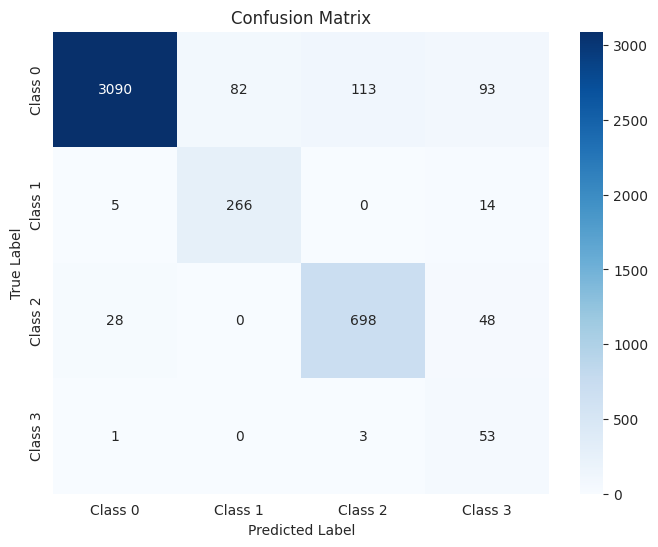

The function took 0.4348 seconds to execute.
[ARCH#212-[16, 8, 8, 8, 4]] done in 33.9s  best-val=0.2307


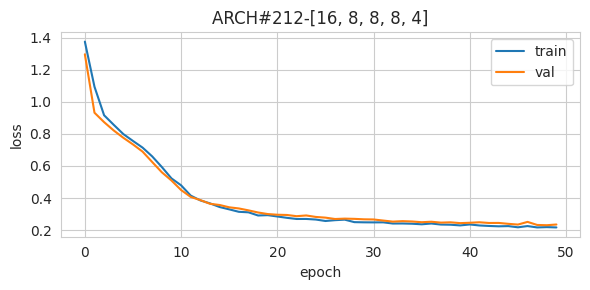


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.76      0.96      0.85      2475
     Class 3       0.33      0.88      0.48       182

    accuracy                           0.90     14379
   macro avg       0.71      0.92      0.78     14379
weighted avg       0.93      0.90      0.91     14379



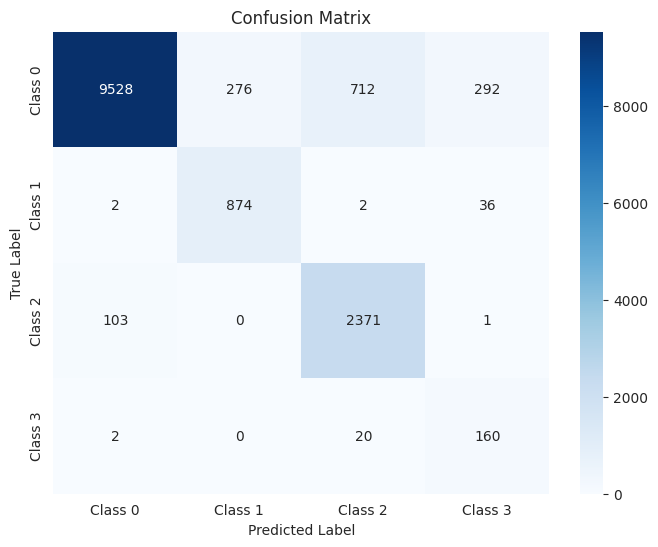

The function took 0.7397 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      2702
     Class 1       0.78      0.92      0.85       228
     Class 2       0.76      0.97      0.85       619
     Class 3       0.31      0.89      0.46        46

    accuracy                           0.90      3595
   macro avg       0.71      0.92      0.77      3595
weighted avg       0.93      0.90      0.91      3595



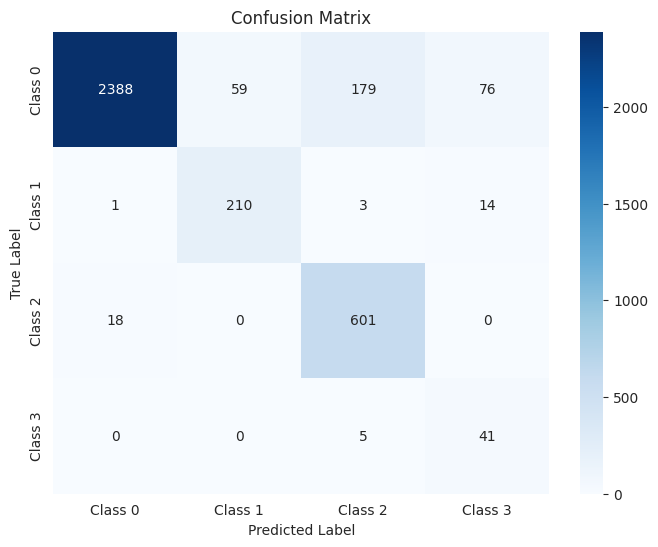

The function took 0.3942 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.93      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.77      0.95      0.85       774
     Class 3       0.33      0.88      0.48        57

    accuracy                           0.90      4494
   macro avg       0.71      0.91      0.78      4494
weighted avg       0.93      0.90      0.91      4494



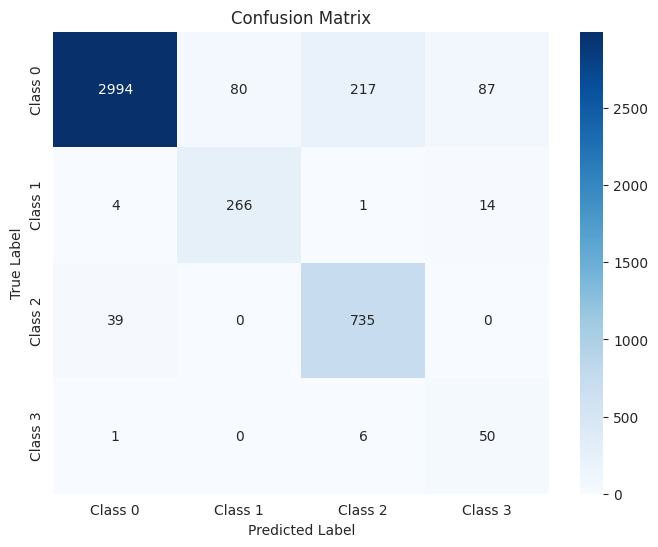

The function took 0.4795 seconds to execute.
[ARCH#213-[16, 8, 8, 8, 2]] done in 34.9s  best-val=0.4800


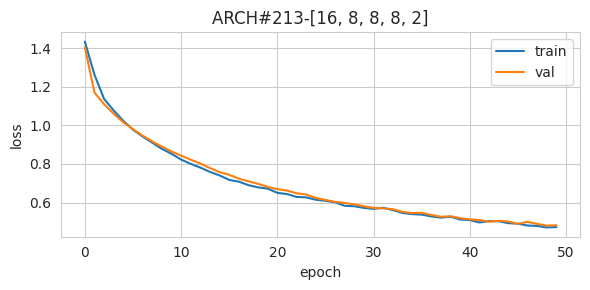


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.97      0.87      0.92      2475
     Class 3       0.34      0.85      0.49       182

    accuracy                           0.93     14379
   macro avg       0.76      0.90      0.80     14379
weighted avg       0.95      0.93      0.93     14379



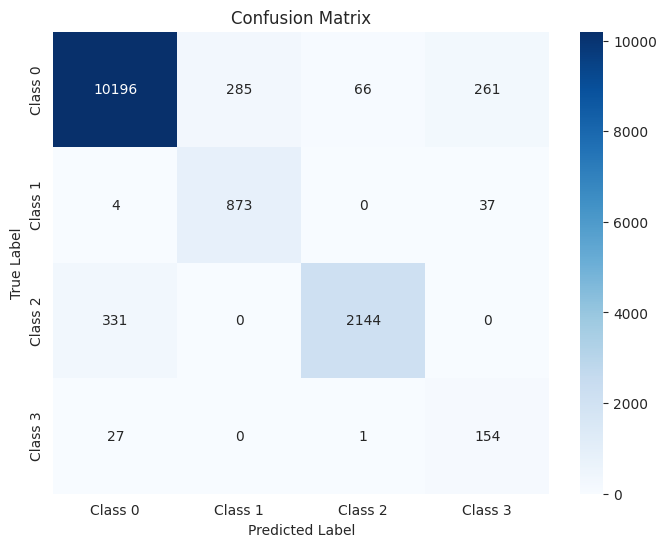

The function took 0.7425 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.97      0.89      0.92       619
     Class 3       0.30      0.80      0.44        46

    accuracy                           0.93      3595
   macro avg       0.76      0.89      0.79      3595
weighted avg       0.95      0.93      0.94      3595



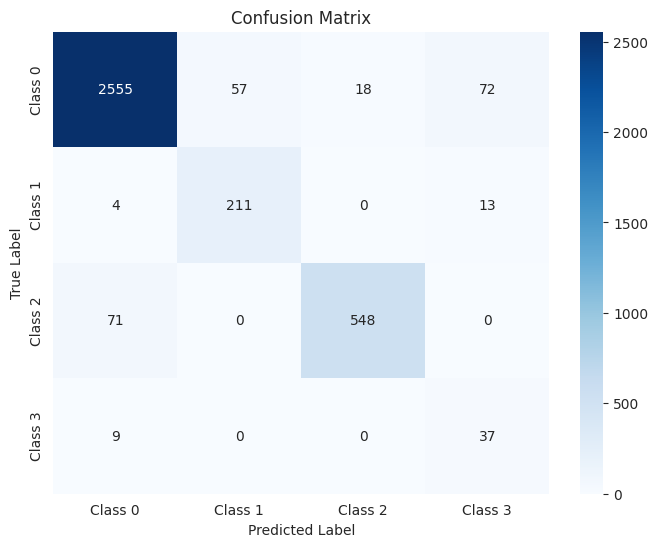

The function took 0.3956 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.94      0.95      3378
     Class 1       0.77      0.93      0.84       285
     Class 2       0.97      0.84      0.90       774
     Class 3       0.30      0.79      0.43        57

    accuracy                           0.92      4494
   macro avg       0.75      0.88      0.78      4494
weighted avg       0.94      0.92      0.93      4494



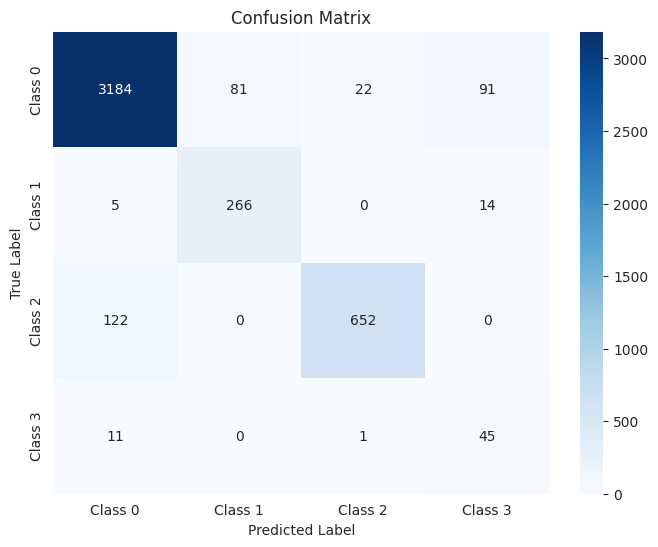

The function took 0.4283 seconds to execute.
[ARCH#214-[16, 8, 8, 4, 4]] done in 34.5s  best-val=0.2874


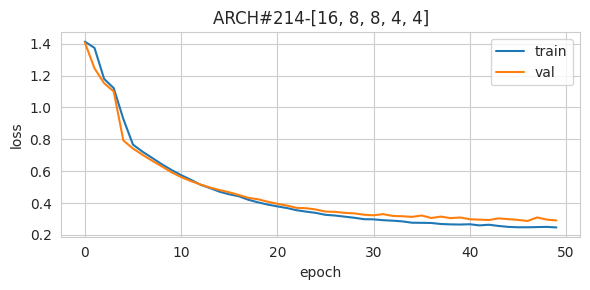


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.90      0.94     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.17      0.91      0.29       182

    accuracy                           0.90     14379
   macro avg       0.71      0.91      0.74     14379
weighted avg       0.95      0.90      0.92     14379



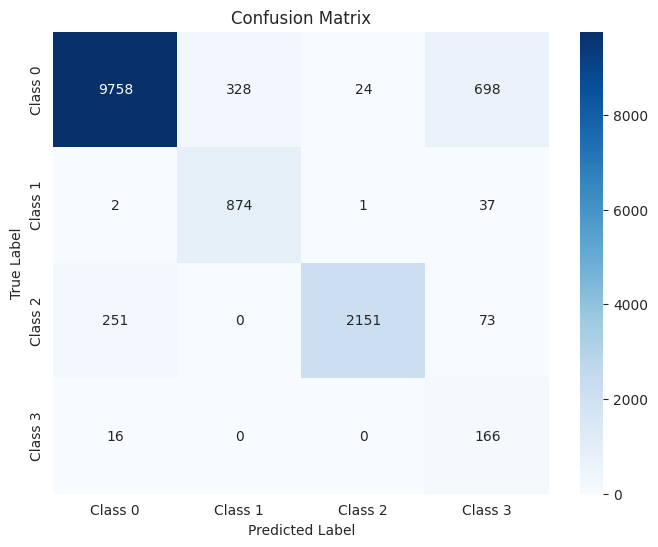

The function took 0.7394 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.90      0.94      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.98      0.88      0.93       619
     Class 3       0.16      0.89      0.27        46

    accuracy                           0.90      3595
   macro avg       0.72      0.90      0.74      3595
weighted avg       0.95      0.90      0.92      3595



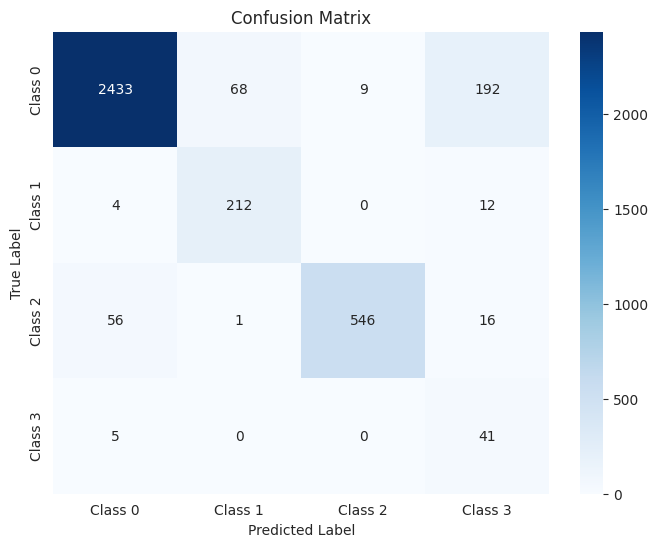

The function took 0.3711 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.91      0.93      3378
     Class 1       0.74      0.94      0.82       285
     Class 2       0.98      0.84      0.90       774
     Class 3       0.17      0.86      0.28        57

    accuracy                           0.90      4494
   macro avg       0.71      0.89      0.74      4494
weighted avg       0.94      0.90      0.91      4494



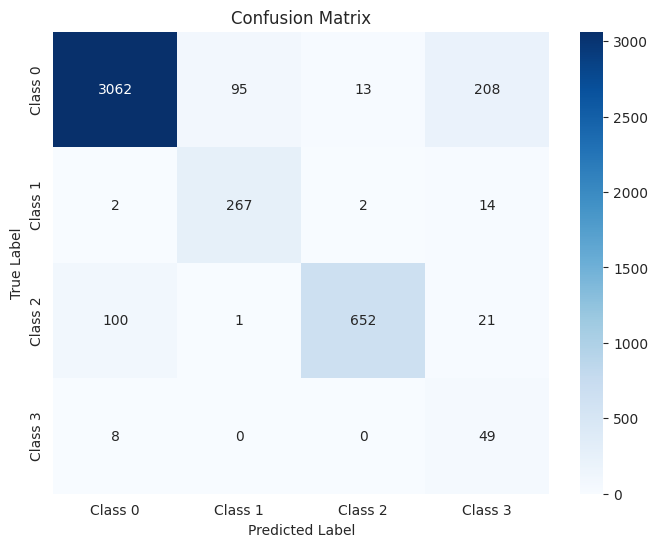

The function took 0.4279 seconds to execute.
[ARCH#215-[16, 8, 8, 4, 2]] done in 33.6s  best-val=0.6912


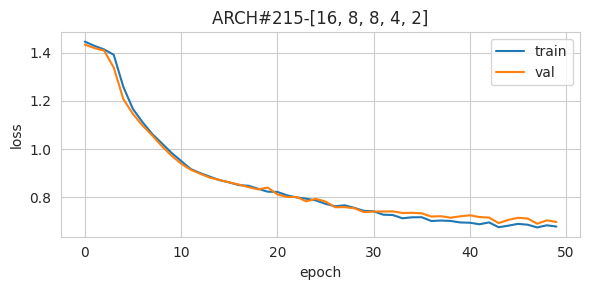


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.90     10808
     Class 1       0.39      0.96      0.55       914
     Class 2       0.82      0.94      0.88      2475
     Class 3       0.07      0.14      0.10       182

    accuracy                           0.85     14379
   macro avg       0.57      0.72      0.61     14379
weighted avg       0.92      0.85      0.87     14379



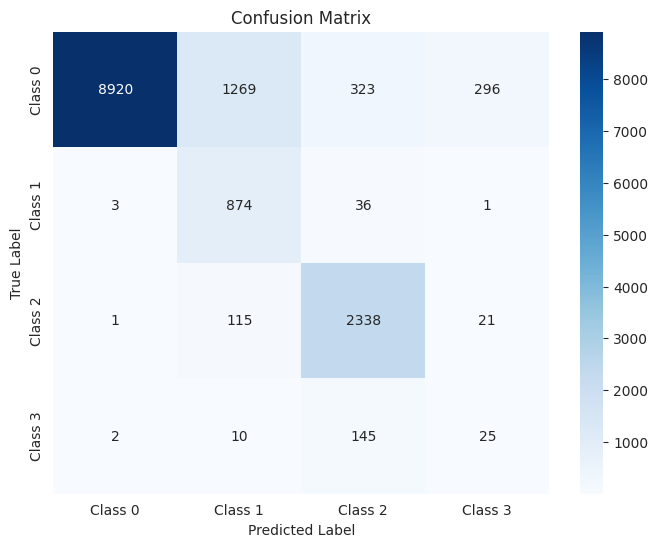

The function took 0.7359 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.91      2702
     Class 1       0.40      0.93      0.56       228
     Class 2       0.81      0.96      0.88       619
     Class 3       0.07      0.13      0.09        46

    accuracy                           0.85      3595
   macro avg       0.57      0.71      0.61      3595
weighted avg       0.92      0.85      0.87      3595



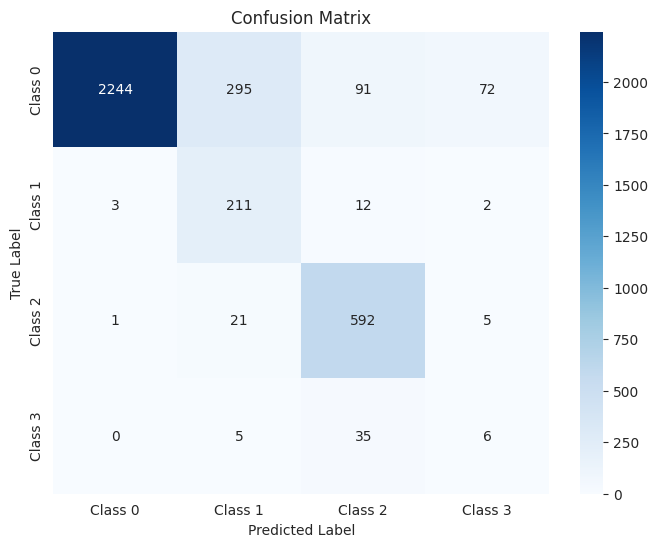

The function took 0.4029 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.91      3378
     Class 1       0.38      0.93      0.54       285
     Class 2       0.82      0.93      0.88       774
     Class 3       0.09      0.16      0.12        57

    accuracy                           0.85      4494
   macro avg       0.57      0.71      0.61      4494
weighted avg       0.92      0.85      0.87      4494



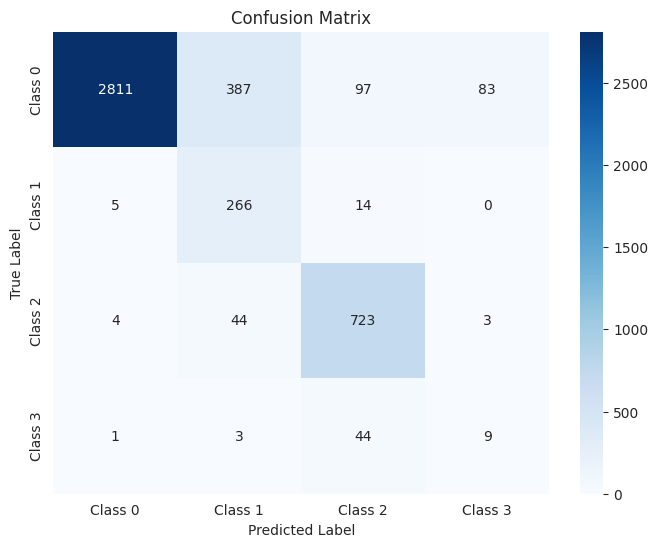

The function took 0.9363 seconds to execute.
[ARCH#216-[16, 8, 8, 2, 2]] done in 34.7s  best-val=0.6955


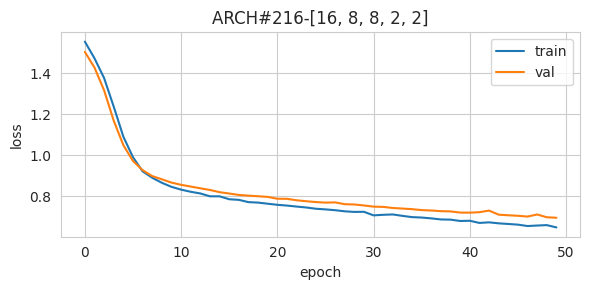


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.63      0.01      0.02     10808
     Class 1       0.74      0.86      0.80       914
     Class 2       0.19      0.93      0.31      2475
     Class 3       0.21      0.99      0.35       182

    accuracy                           0.24     14379
   macro avg       0.44      0.70      0.37     14379
weighted avg       0.56      0.24      0.12     14379



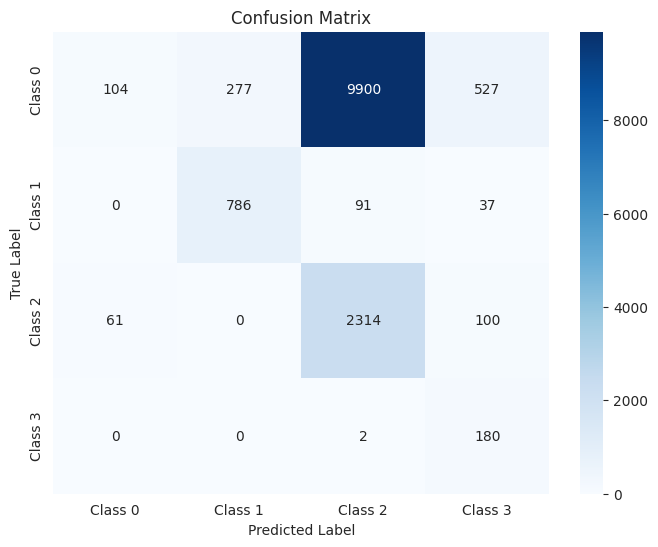

The function took 0.7258 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.70      0.01      0.03      2702
     Class 1       0.76      0.81      0.78       228
     Class 2       0.19      0.94      0.31       619
     Class 3       0.21      0.98      0.34        46

    accuracy                           0.24      3595
   macro avg       0.46      0.68      0.37      3595
weighted avg       0.61      0.24      0.13      3595



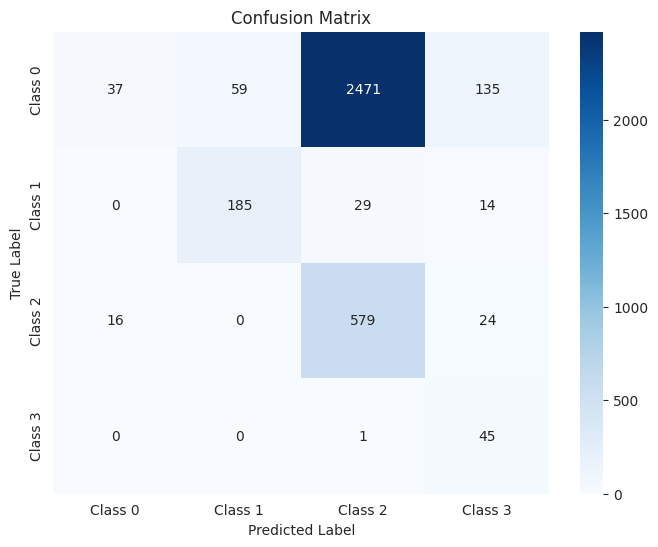

The function took 0.3865 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.60      0.01      0.02      3378
     Class 1       0.74      0.84      0.79       285
     Class 2       0.19      0.94      0.31       774
     Class 3       0.21      0.89      0.34        57

    accuracy                           0.23      4494
   macro avg       0.43      0.67      0.37      4494
weighted avg       0.53      0.23      0.12      4494



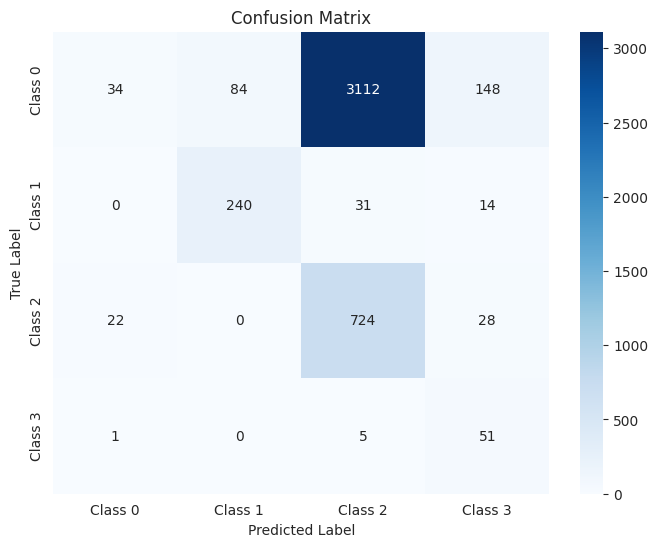

The function took 0.4210 seconds to execute.
[ARCH#217-[16, 8, 4, 4, 4]] done in 34.5s  best-val=0.4149


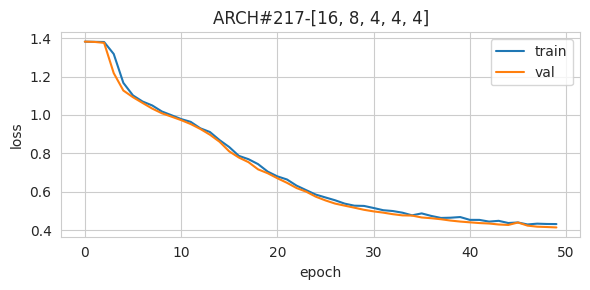


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93     10808
     Class 1       0.38      0.96      0.54       914
     Class 2       0.99      0.86      0.92      2475
     Class 3       0.41      0.87      0.56       182

    accuracy                           0.88     14379
   macro avg       0.69      0.89      0.74     14379
weighted avg       0.95      0.88      0.90     14379



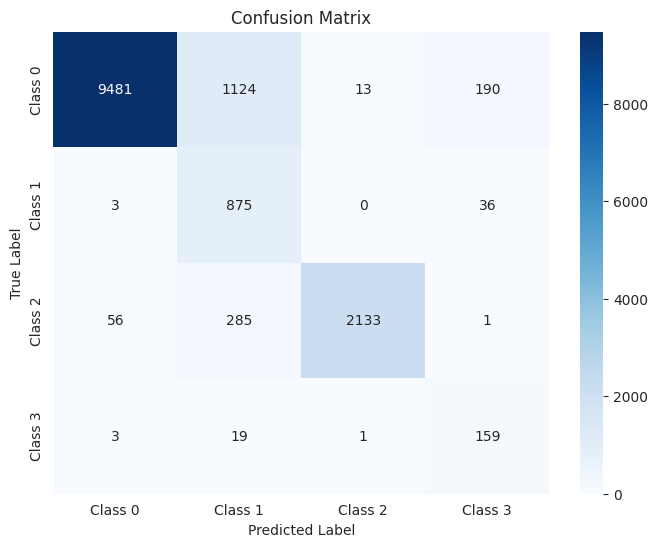

The function took 0.7620 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      2702
     Class 1       0.40      0.94      0.56       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.38      0.87      0.53        46

    accuracy                           0.88      3595
   macro avg       0.69      0.89      0.74      3595
weighted avg       0.95      0.88      0.90      3595



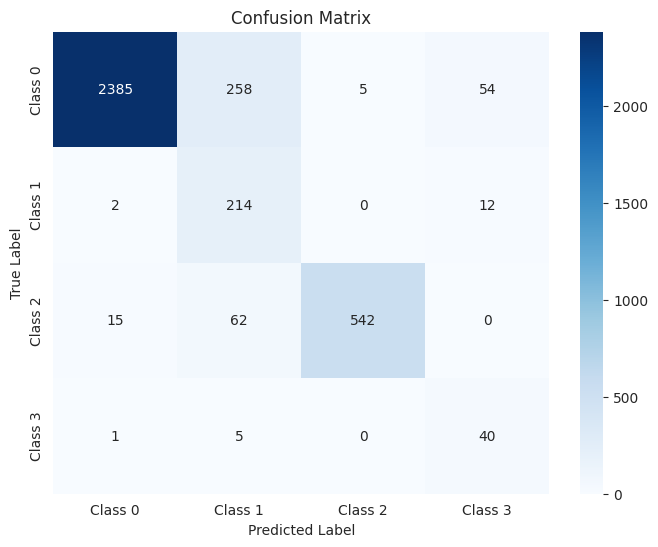

The function took 0.3992 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.87      0.93      3378
     Class 1       0.37      0.94      0.53       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.40      0.82      0.54        57

    accuracy                           0.87      4494
   macro avg       0.69      0.87      0.73      4494
weighted avg       0.94      0.87      0.90      4494



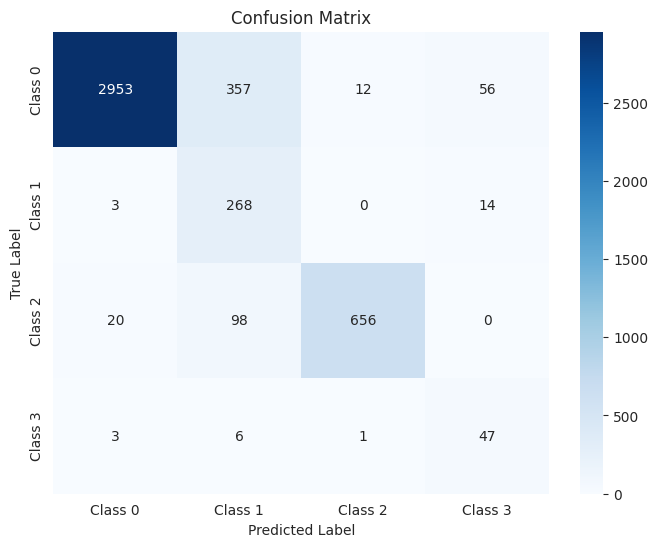

The function took 0.4391 seconds to execute.
[ARCH#218-[16, 8, 4, 4, 2]] done in 34.0s  best-val=0.5770


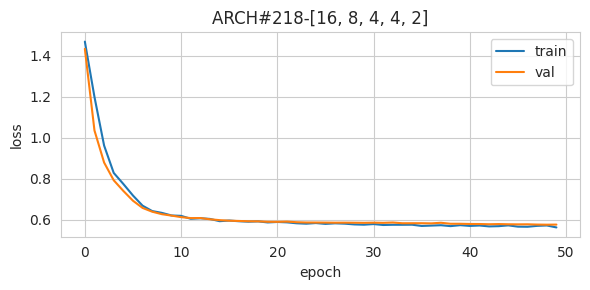


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.97      0.96     10808
     Class 1       0.73      0.91      0.81       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.06      0.01      0.01       182

    accuracy                           0.93     14379
   macro avg       0.68      0.69      0.68     14379
weighted avg       0.93      0.93      0.93     14379



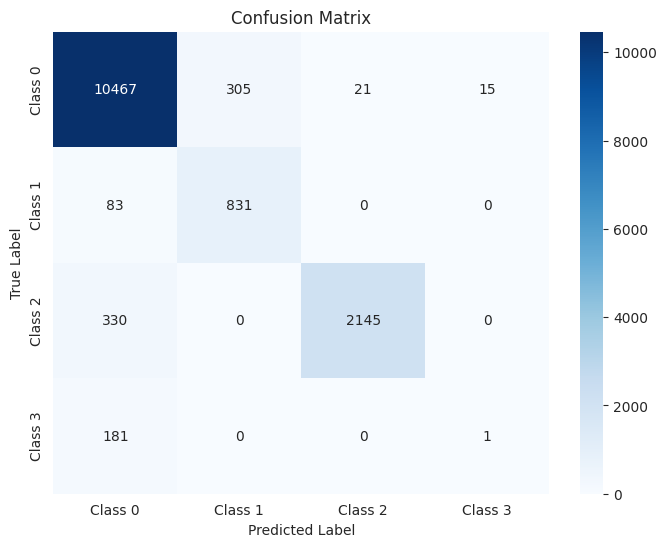

The function took 0.8445 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.97      0.96      2702
     Class 1       0.74      0.88      0.80       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.94      3595
   macro avg       0.67      0.68      0.67      3595
weighted avg       0.93      0.94      0.93      3595



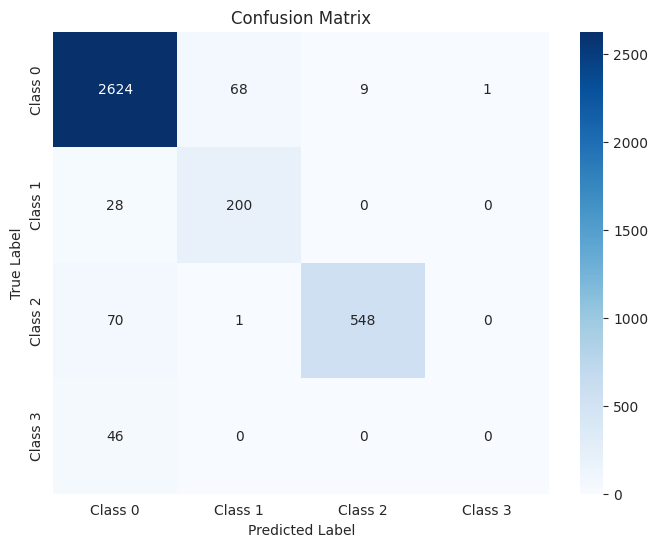

The function took 0.4946 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.97      0.95      3378
     Class 1       0.75      0.90      0.82       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.93      4494
   macro avg       0.67      0.68      0.67      4494
weighted avg       0.92      0.93      0.93      4494



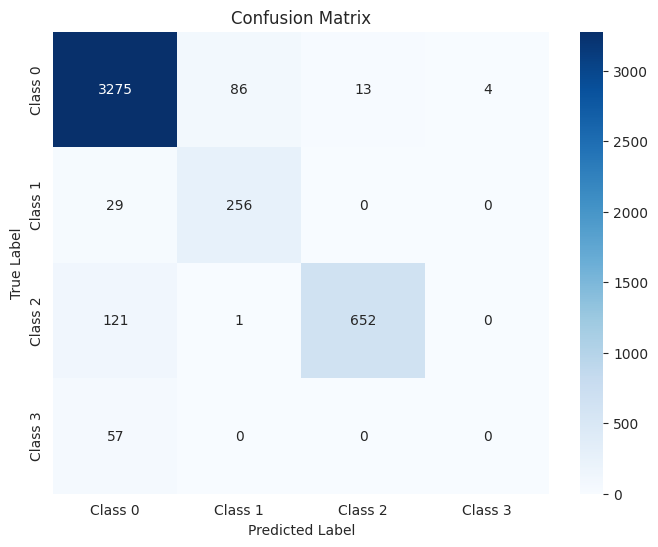

The function took 0.5406 seconds to execute.
[ARCH#219-[16, 8, 4, 2, 2]] done in 34.9s  best-val=0.5685


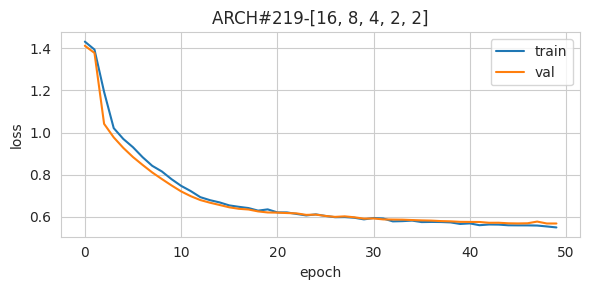


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.97      0.96     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       1.00      0.85      0.92      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.94     14379
   macro avg       0.67      0.69      0.67     14379
weighted avg       0.93      0.94      0.93     14379



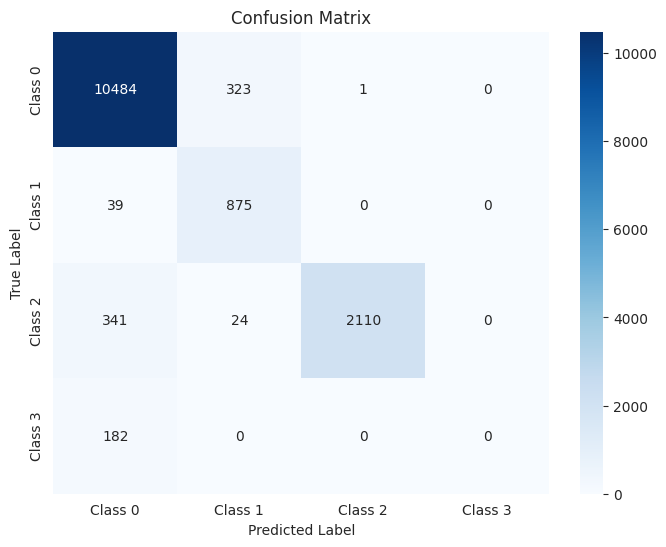

The function took 0.7404 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.97      0.96      2702
     Class 1       0.74      0.94      0.83       228
     Class 2       1.00      0.87      0.93       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.94      3595
   macro avg       0.67      0.69      0.68      3595
weighted avg       0.93      0.94      0.94      3595



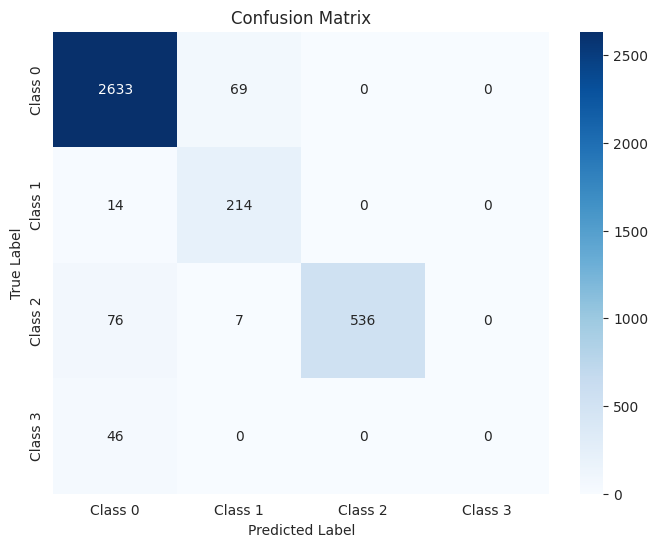

The function took 0.3950 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.97      0.96      3378
     Class 1       0.71      0.94      0.81       285
     Class 2       1.00      0.83      0.91       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.93      4494
   macro avg       0.66      0.68      0.67      4494
weighted avg       0.93      0.93      0.93      4494



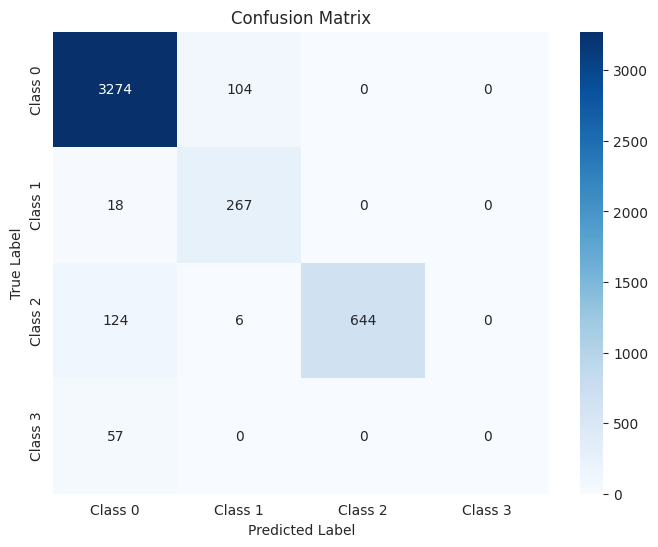

The function took 0.4105 seconds to execute.
[ARCH#220-[16, 8, 2, 2, 2]] done in 34.4s  best-val=0.6482


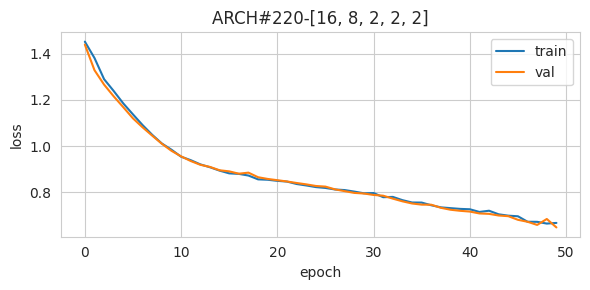


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90     10808
     Class 1       0.50      0.93      0.65       914
     Class 2       0.92      0.95      0.93      2475
     Class 3       0.13      0.87      0.23       182

    accuracy                           0.85     14379
   macro avg       0.64      0.89      0.68     14379
weighted avg       0.94      0.85      0.88     14379



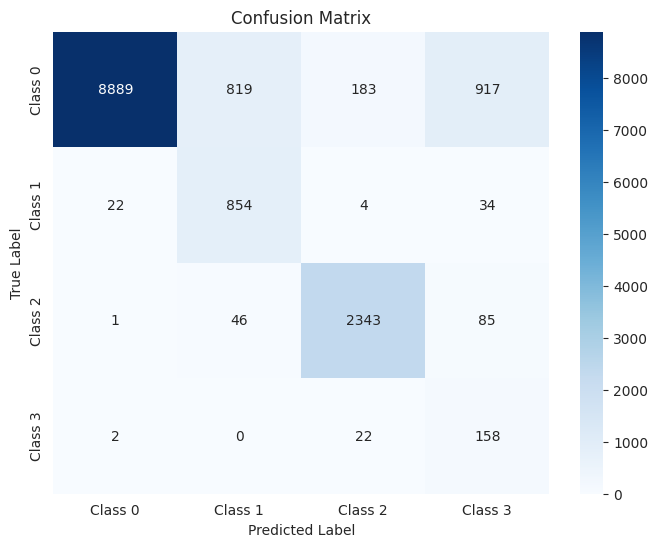

The function took 0.7802 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.90      2702
     Class 1       0.49      0.90      0.64       228
     Class 2       0.90      0.96      0.93       619
     Class 3       0.13      0.78      0.23        46

    accuracy                           0.85      3595
   macro avg       0.63      0.87      0.67      3595
weighted avg       0.94      0.85      0.88      3595



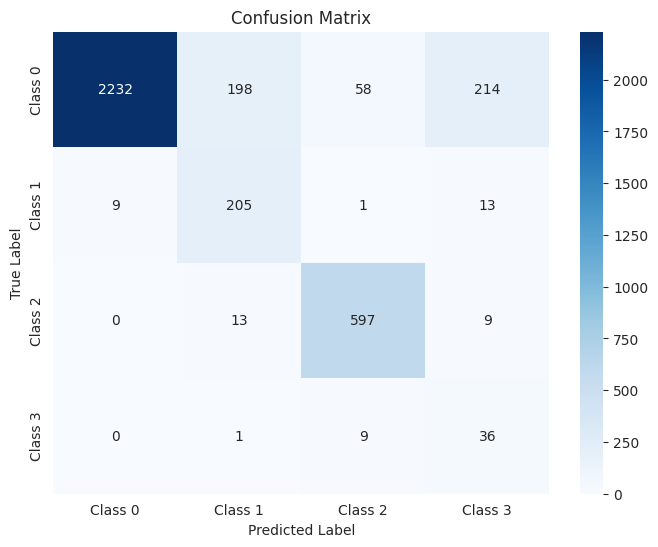

The function took 0.3837 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.82      0.90      3378
     Class 1       0.48      0.91      0.63       285
     Class 2       0.93      0.93      0.93       774
     Class 3       0.12      0.84      0.22        57

    accuracy                           0.85      4494
   macro avg       0.63      0.88      0.67      4494
weighted avg       0.94      0.85      0.88      4494



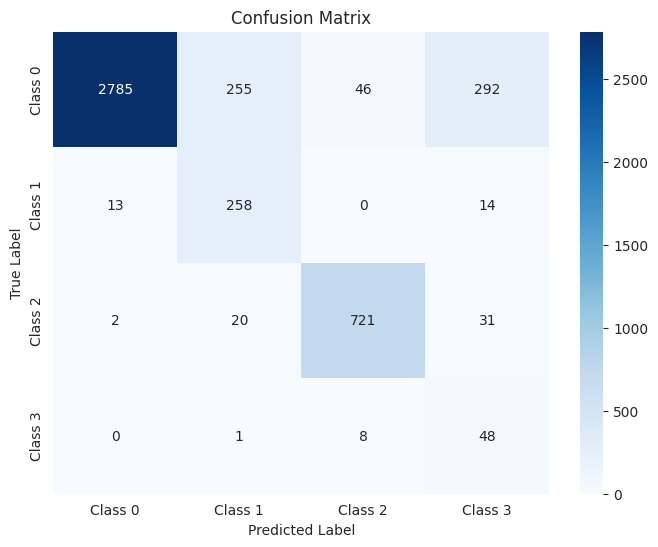

The function took 0.4125 seconds to execute.
[ARCH#221-[16, 4, 4, 4, 4]] done in 33.8s  best-val=0.5347


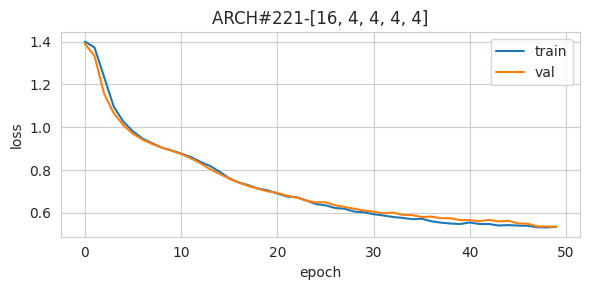


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90     10808
     Class 1       0.48      0.95      0.64       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.11      0.87      0.19       182

    accuracy                           0.84     14379
   macro avg       0.64      0.88      0.66     14379
weighted avg       0.95      0.84      0.88     14379



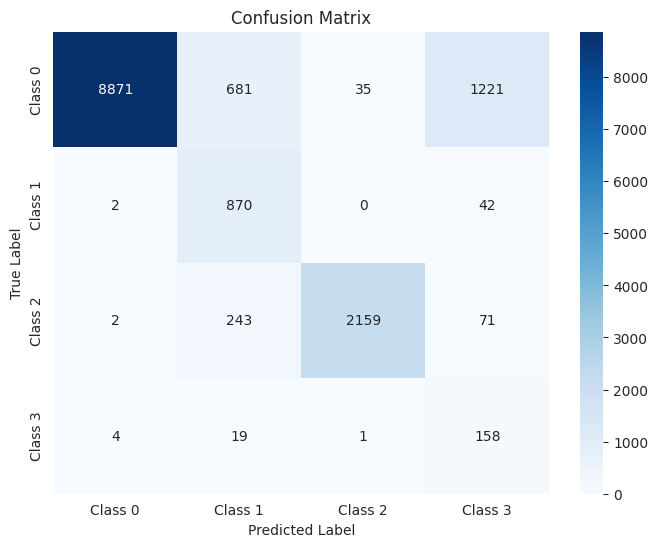

The function took 0.7843 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90      2702
     Class 1       0.48      0.93      0.63       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.10      0.83      0.19        46

    accuracy                           0.84      3595
   macro avg       0.64      0.87      0.66      3595
weighted avg       0.95      0.84      0.88      3595



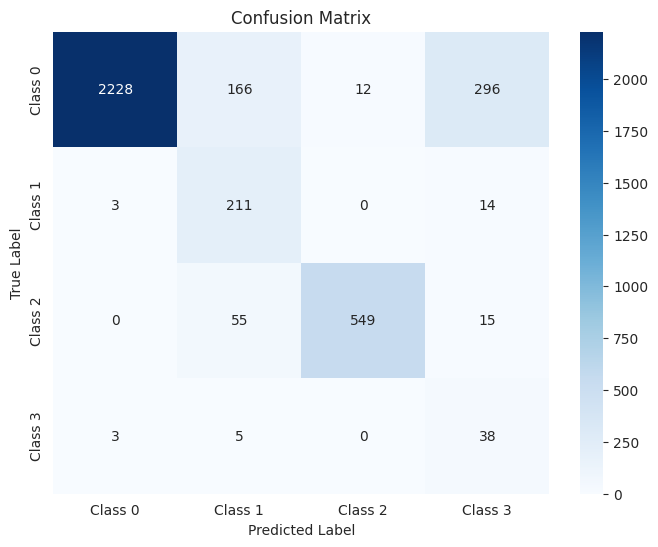

The function took 0.4797 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90      3378
     Class 1       0.48      0.93      0.63       285
     Class 2       0.97      0.85      0.91       774
     Class 3       0.10      0.84      0.18        57

    accuracy                           0.84      4494
   macro avg       0.64      0.86      0.66      4494
weighted avg       0.95      0.84      0.88      4494



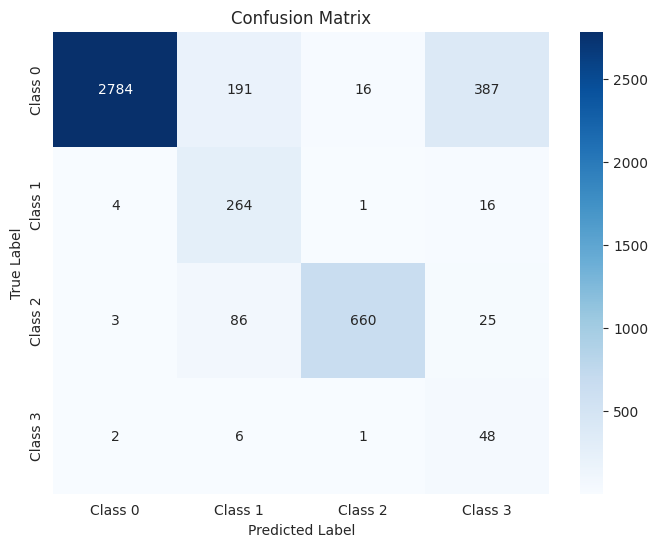

The function took 0.4666 seconds to execute.
[ARCH#222-[16, 4, 4, 4, 2]] done in 34.8s  best-val=1.3794


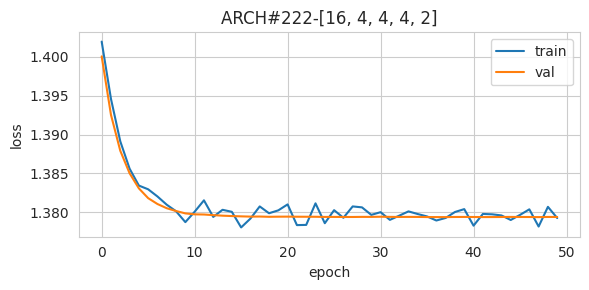


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



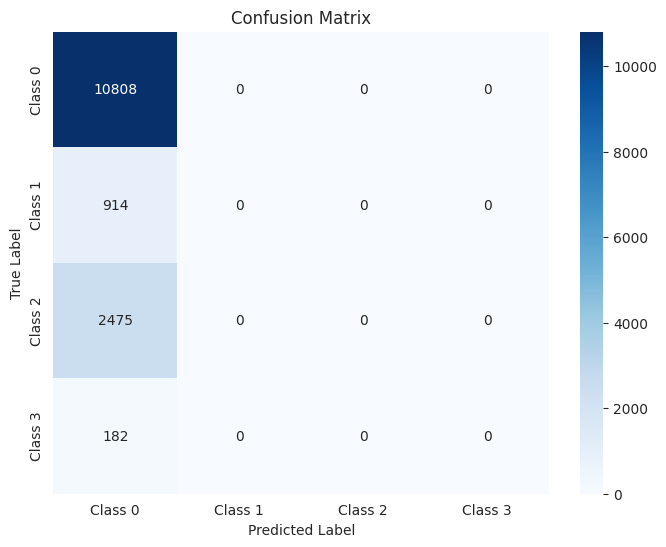

The function took 0.7285 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



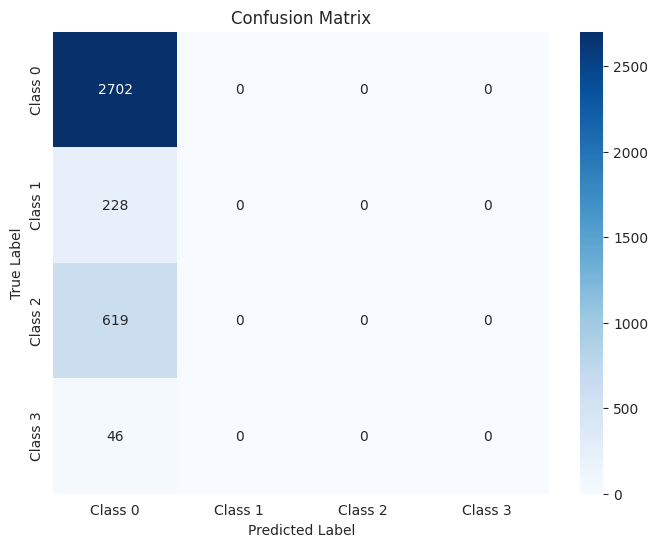

The function took 0.3708 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



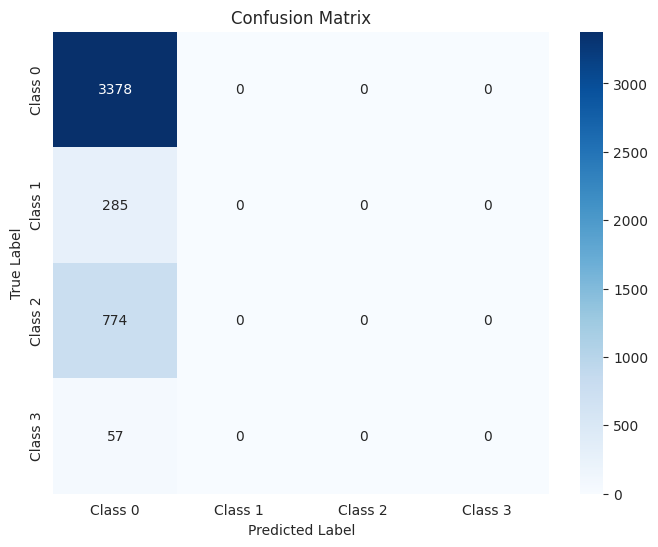

The function took 0.4132 seconds to execute.
[ARCH#223-[16, 4, 4, 2, 2]] done in 34.0s  best-val=0.3130


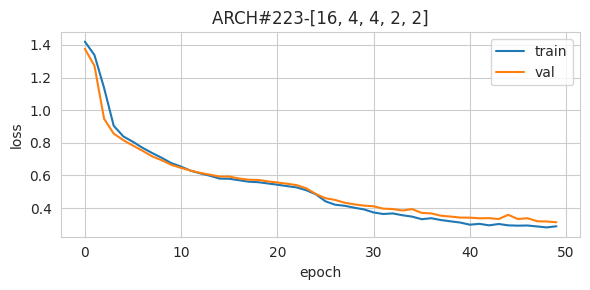


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.69      0.96      0.80       914
     Class 2       0.97      0.87      0.91      2475
     Class 3       0.18      0.97      0.30       182

    accuracy                           0.90     14379
   macro avg       0.71      0.92      0.74     14379
weighted avg       0.95      0.90      0.92     14379



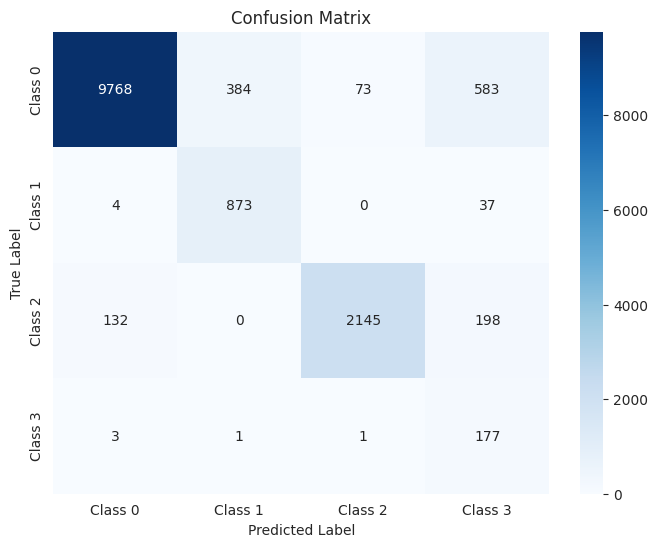

The function took 0.8272 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.72      0.93      0.81       228
     Class 2       0.96      0.88      0.92       619
     Class 3       0.17      0.98      0.29        46

    accuracy                           0.90      3595
   macro avg       0.71      0.92      0.74      3595
weighted avg       0.96      0.90      0.92      3595



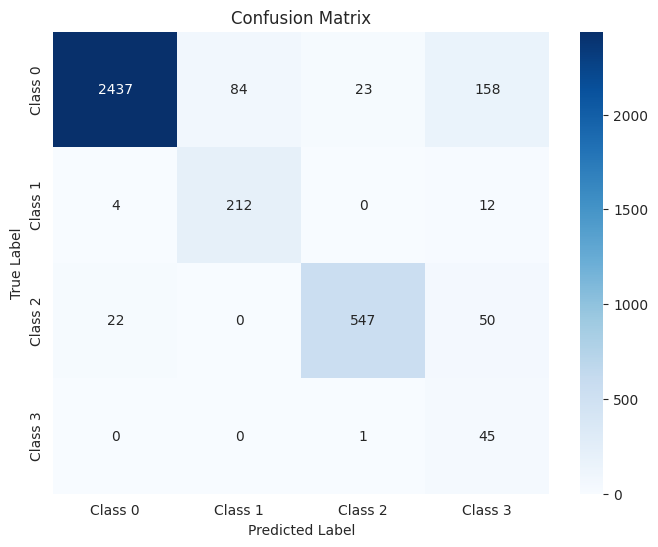

The function took 0.4428 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94      3378
     Class 1       0.68      0.93      0.79       285
     Class 2       0.97      0.84      0.90       774
     Class 3       0.18      0.95      0.30        57

    accuracy                           0.90      4494
   macro avg       0.70      0.91      0.73      4494
weighted avg       0.95      0.90      0.92      4494



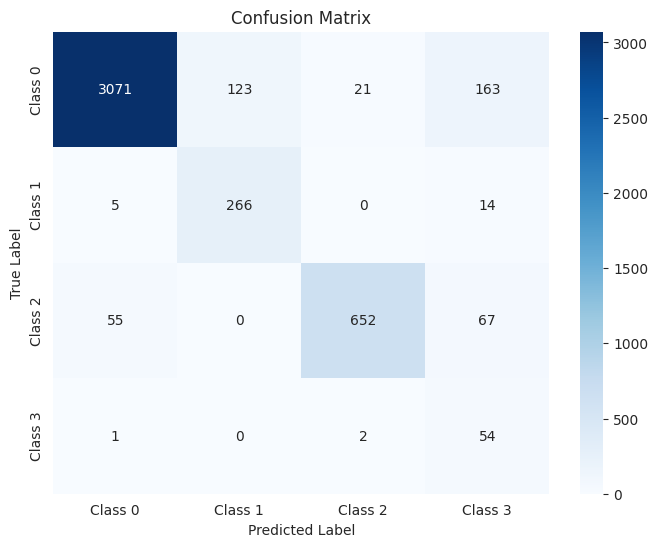

The function took 0.4342 seconds to execute.
[ARCH#224-[16, 4, 2, 2, 2]] done in 33.6s  best-val=1.3794


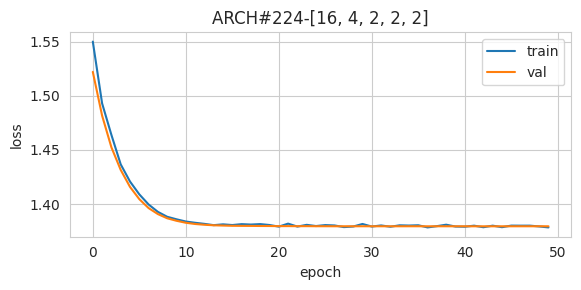


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



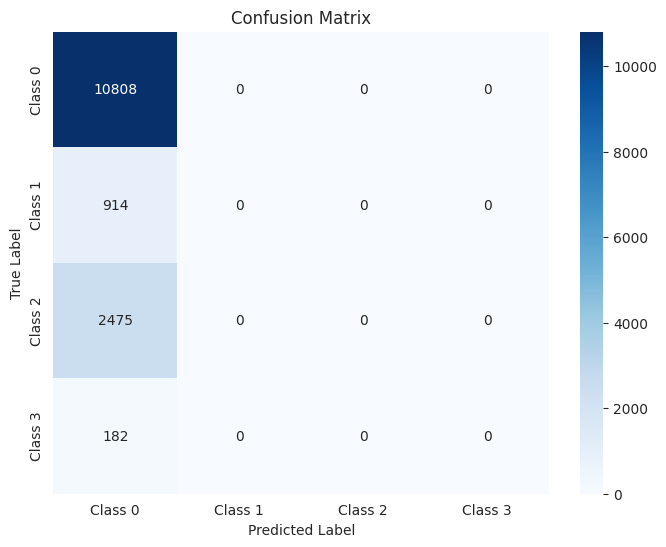

The function took 1.0994 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



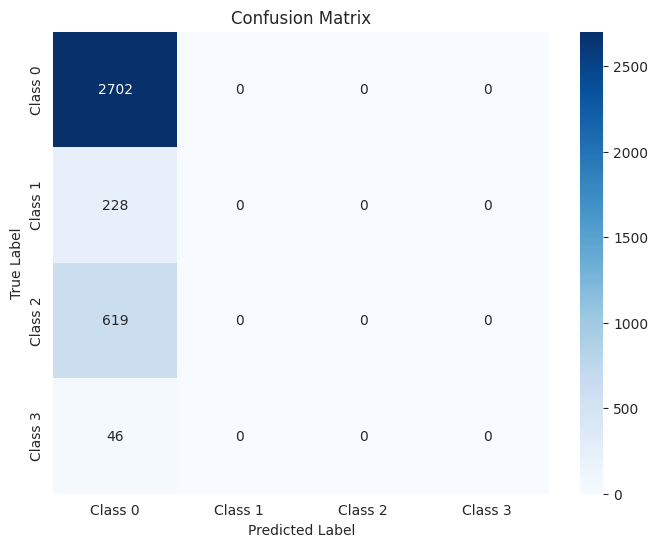

The function took 0.3716 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



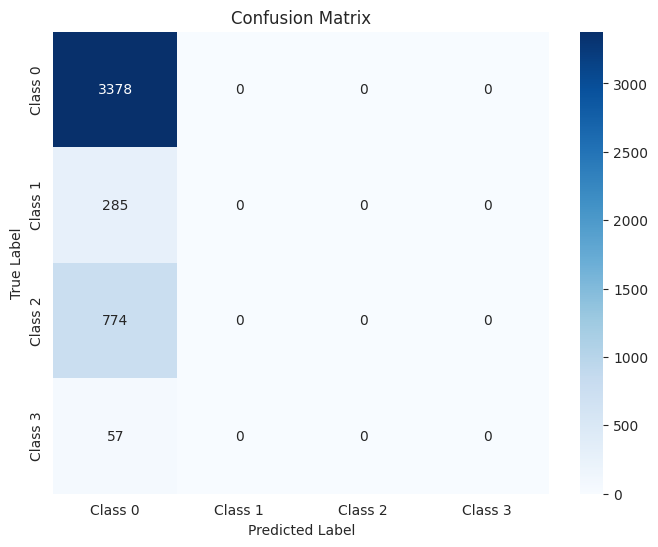

The function took 0.4567 seconds to execute.
[ARCH#225-[16, 2, 2, 2, 2]] done in 34.7s  best-val=0.6323


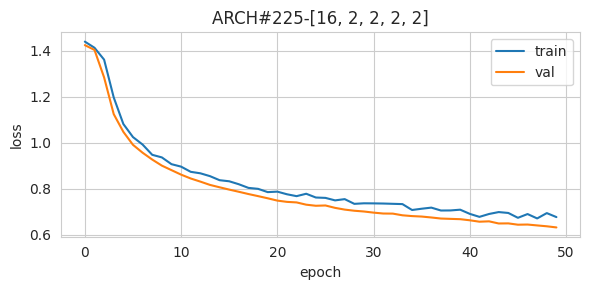


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.81      0.89     10808
     Class 1       0.30      0.86      0.45       914
     Class 2       0.88      0.86      0.87      2475
     Class 3       0.32      0.88      0.47       182

    accuracy                           0.82     14379
   macro avg       0.62      0.85      0.67     14379
weighted avg       0.91      0.82      0.85     14379



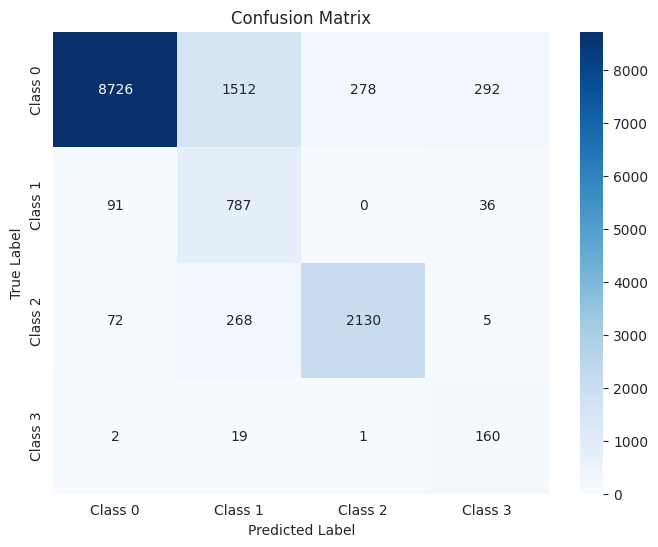

The function took 0.7806 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.80      0.88      2702
     Class 1       0.30      0.82      0.44       228
     Class 2       0.87      0.88      0.88       619
     Class 3       0.31      0.87      0.46        46

    accuracy                           0.82      3595
   macro avg       0.62      0.84      0.66      3595
weighted avg       0.91      0.82      0.85      3595



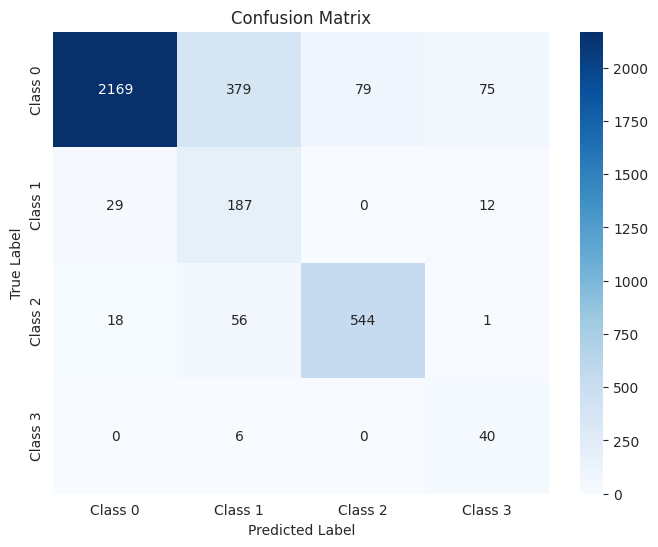

The function took 0.3886 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.81      0.89      3378
     Class 1       0.30      0.84      0.44       285
     Class 2       0.87      0.84      0.86       774
     Class 3       0.32      0.82      0.46        57

    accuracy                           0.82      4494
   macro avg       0.62      0.83      0.66      4494
weighted avg       0.91      0.82      0.85      4494



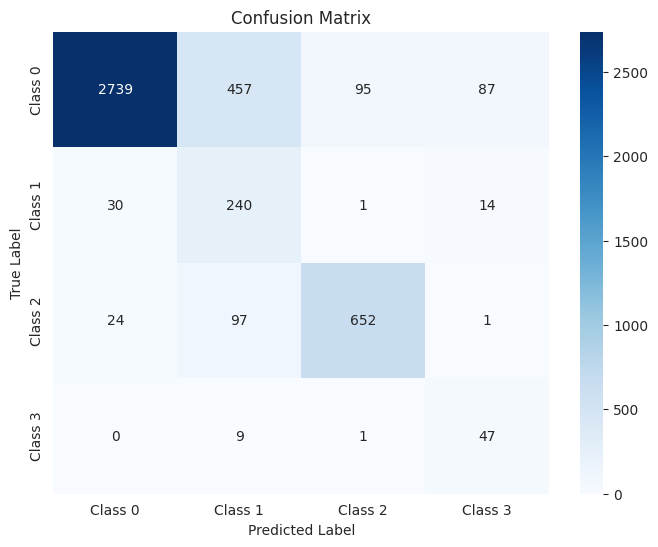

The function took 0.3987 seconds to execute.
[ARCH#226-[8, 8, 8, 8, 8]] done in 34.6s  best-val=0.2888


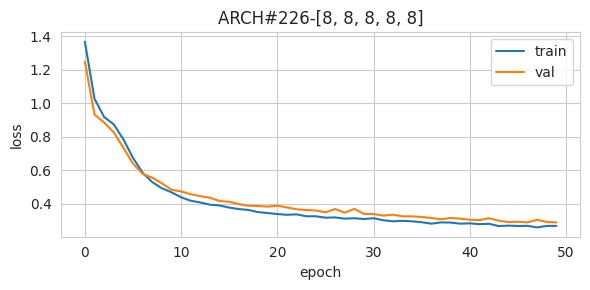


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.98      0.87      0.92      2475
     Class 3       0.13      0.93      0.24       182

    accuracy                           0.89     14379
   macro avg       0.71      0.91      0.73     14379
weighted avg       0.96      0.89      0.92     14379



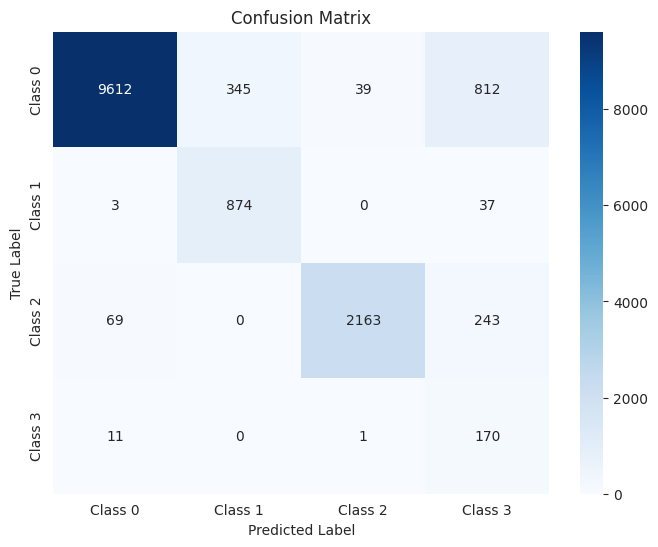

The function took 0.7777 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.74      0.93      0.82       228
     Class 2       0.98      0.89      0.93       619
     Class 3       0.13      0.93      0.23        46

    accuracy                           0.89      3595
   macro avg       0.71      0.91      0.73      3595
weighted avg       0.96      0.89      0.92      3595



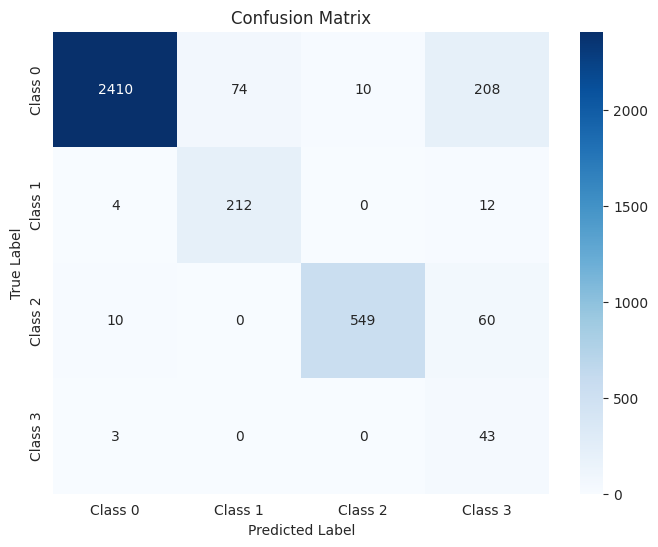

The function took 0.3910 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.72      0.93      0.81       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.13      0.91      0.23        57

    accuracy                           0.89      4494
   macro avg       0.70      0.90      0.72      4494
weighted avg       0.96      0.89      0.92      4494



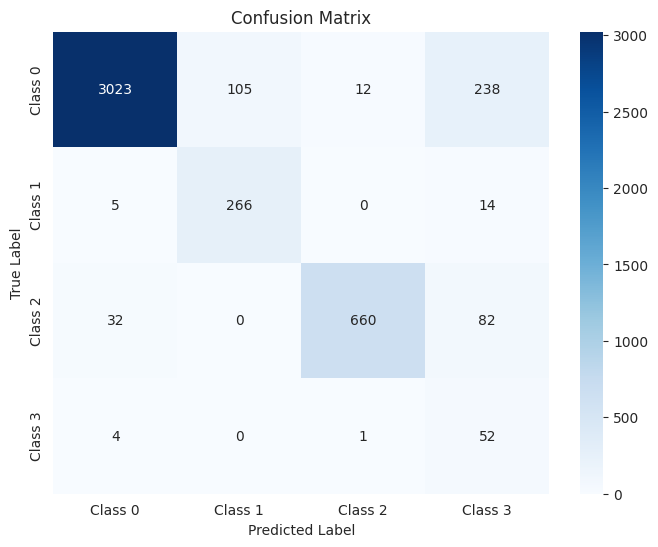

The function took 0.4092 seconds to execute.
[ARCH#227-[8, 8, 8, 8, 4]] done in 33.9s  best-val=0.3392


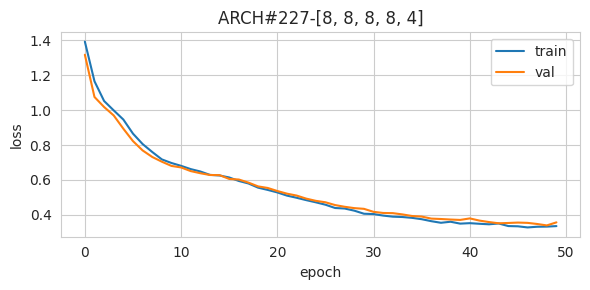


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.86      0.92     10808
     Class 1       0.68      0.91      0.78       914
     Class 2       0.92      0.93      0.93      2475
     Class 3       0.13      0.92      0.22       182

    accuracy                           0.87     14379
   macro avg       0.68      0.90      0.71     14379
weighted avg       0.95      0.87      0.90     14379



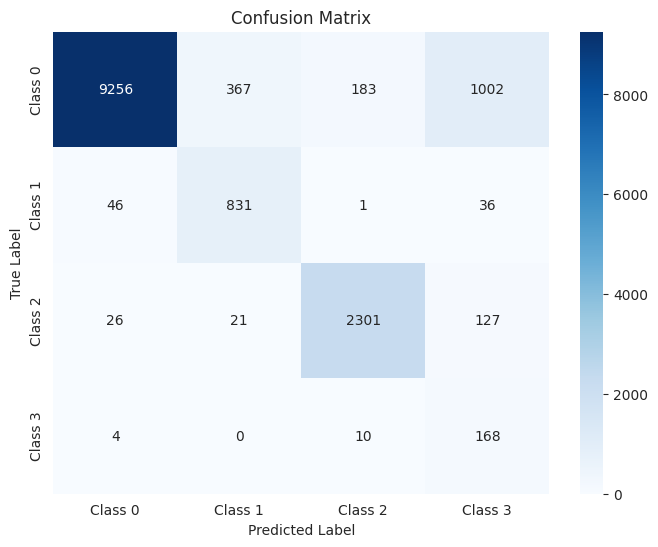

The function took 0.7469 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.86      0.92      2702
     Class 1       0.71      0.88      0.79       228
     Class 2       0.90      0.95      0.92       619
     Class 3       0.13      0.91      0.22        46

    accuracy                           0.87      3595
   macro avg       0.68      0.90      0.71      3595
weighted avg       0.95      0.87      0.90      3595



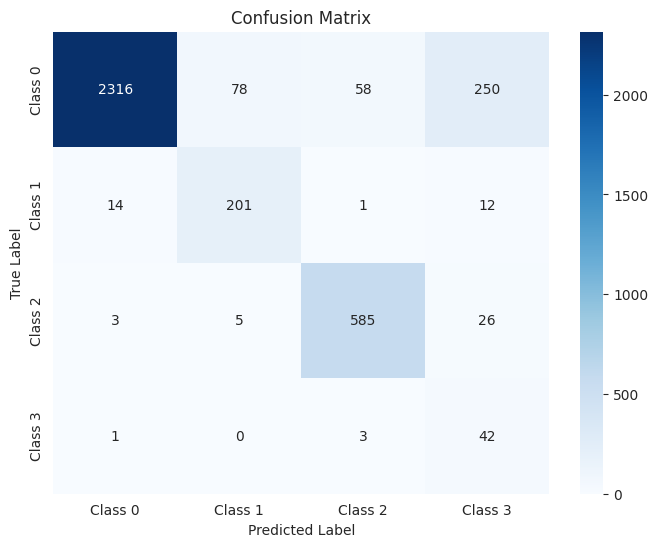

The function took 0.4362 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.86      0.92      3378
     Class 1       0.67      0.89      0.77       285
     Class 2       0.93      0.91      0.92       774
     Class 3       0.12      0.93      0.22        57

    accuracy                           0.87      4494
   macro avg       0.68      0.90      0.71      4494
weighted avg       0.95      0.87      0.90      4494



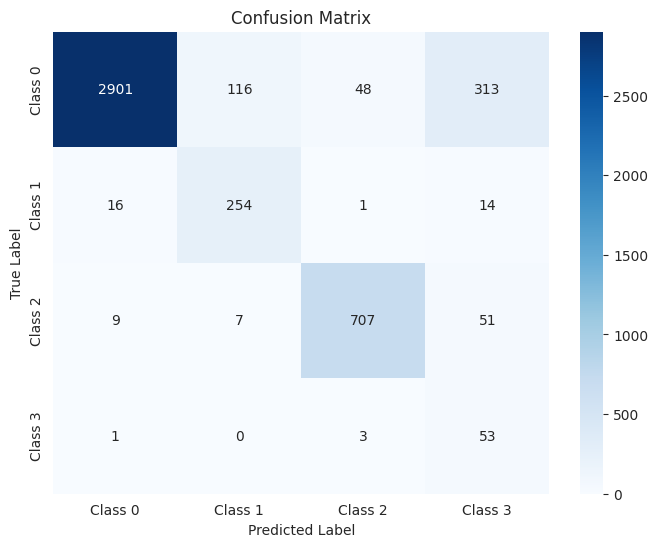

The function took 0.5193 seconds to execute.
[ARCH#228-[8, 8, 8, 8, 2]] done in 35.3s  best-val=0.5307


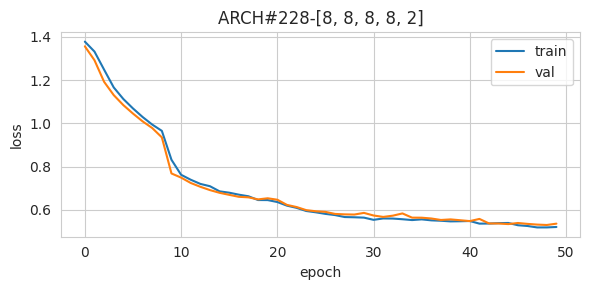


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.58      0.73     10808
     Class 1       0.21      0.91      0.34       914
     Class 2       0.99      0.91      0.95      2475
     Class 3       0.09      0.98      0.17       182

    accuracy                           0.66     14379
   macro avg       0.57      0.84      0.55     14379
weighted avg       0.93      0.66      0.73     14379



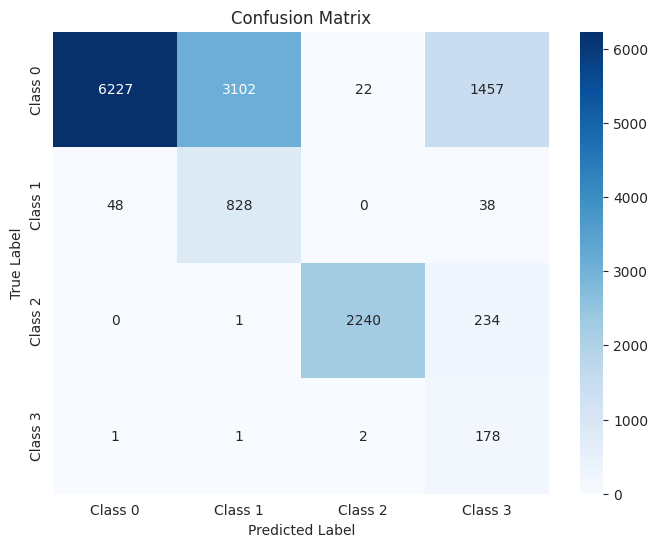

The function took 0.7629 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.58      0.73      2702
     Class 1       0.21      0.87      0.34       228
     Class 2       0.98      0.92      0.95       619
     Class 3       0.10      0.98      0.17        46

    accuracy                           0.67      3595
   macro avg       0.57      0.84      0.55      3595
weighted avg       0.93      0.67      0.74      3595



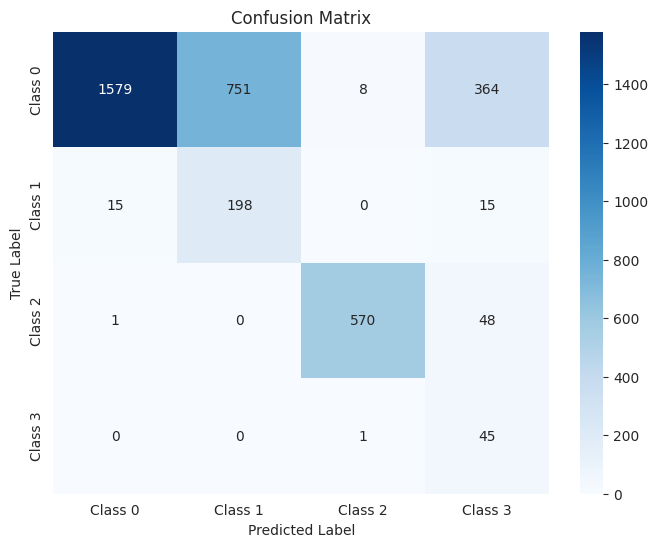

The function took 0.3808 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.58      0.73      3378
     Class 1       0.21      0.88      0.34       285
     Class 2       0.98      0.89      0.93       774
     Class 3       0.09      0.96      0.17        57

    accuracy                           0.66      4494
   macro avg       0.57      0.83      0.54      4494
weighted avg       0.93      0.66      0.73      4494



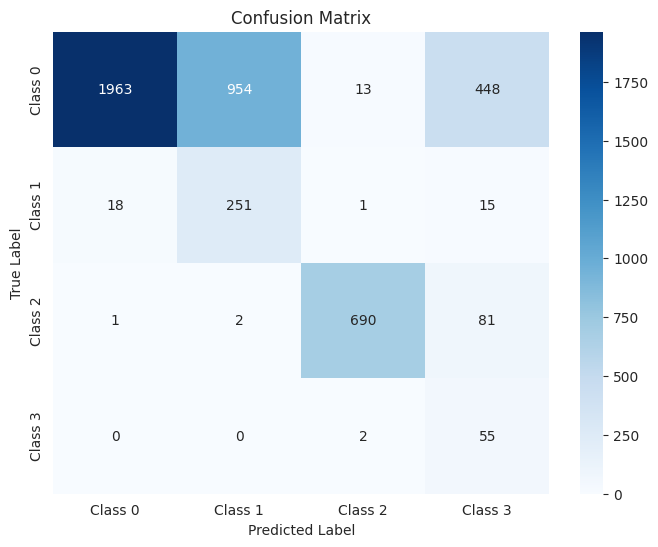

The function took 0.4268 seconds to execute.
[ARCH#229-[8, 8, 8, 4, 4]] done in 34.5s  best-val=1.3388


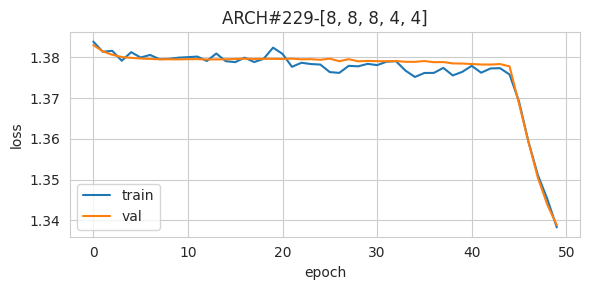


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.90      0.26      0.40     10808
     Class 1       0.08      1.00      0.15       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.26     14379
   macro avg       0.25      0.31      0.14     14379
weighted avg       0.68      0.26      0.31     14379



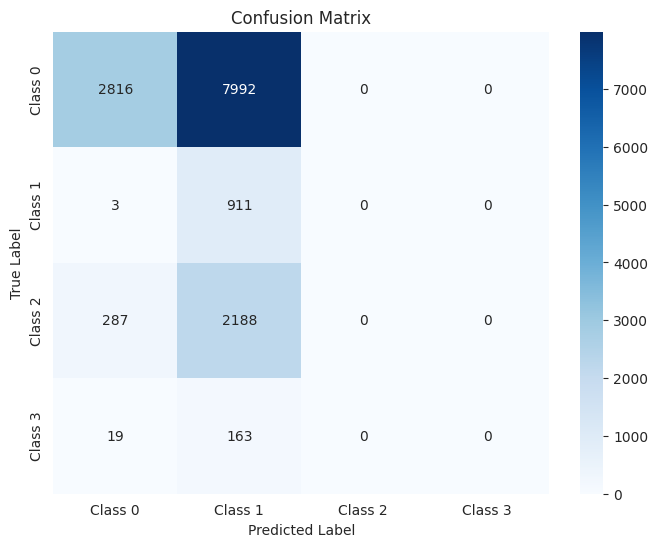

The function took 0.7367 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.91      0.26      0.40      2702
     Class 1       0.08      0.99      0.15       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.26      3595
   macro avg       0.25      0.31      0.14      3595
weighted avg       0.69      0.26      0.31      3595



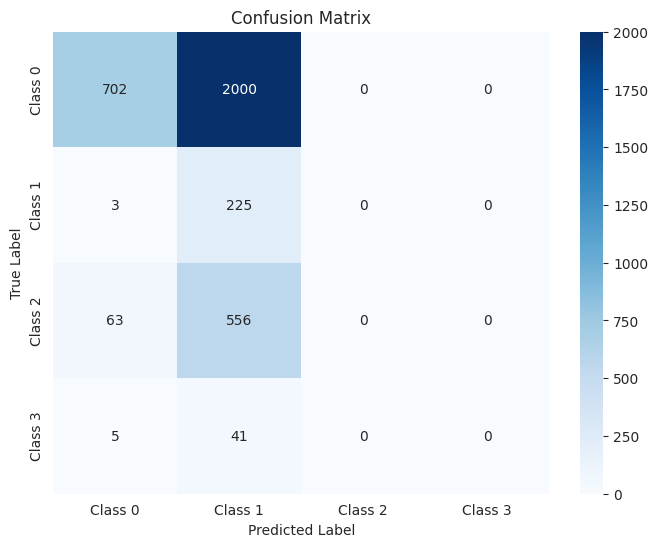

The function took 0.4352 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.88      0.25      0.39      3378
     Class 1       0.08      0.98      0.15       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.25      4494
   macro avg       0.24      0.31      0.14      4494
weighted avg       0.67      0.25      0.31      4494



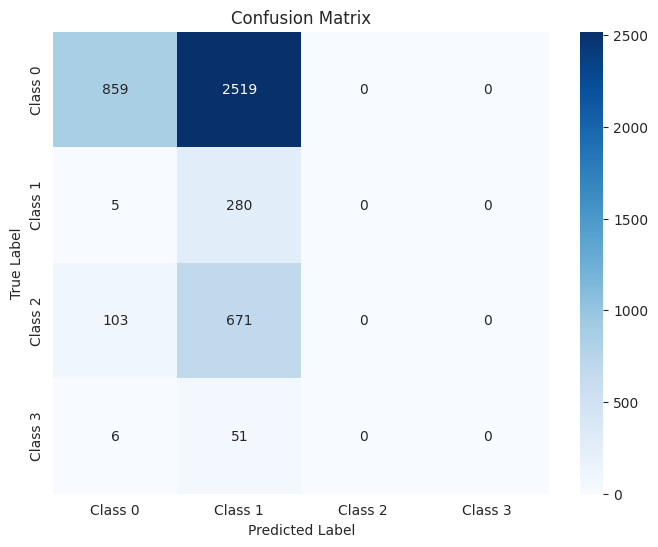

The function took 0.4136 seconds to execute.
[ARCH#230-[8, 8, 8, 4, 2]] done in 33.9s  best-val=0.3552


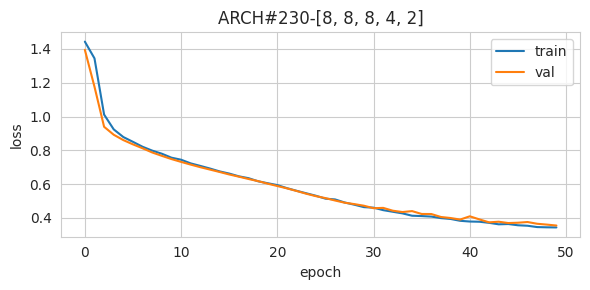


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.85      0.91     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.99      0.87      0.92      2475
     Class 3       0.10      0.97      0.18       182

    accuracy                           0.86     14379
   macro avg       0.70      0.91      0.71     14379
weighted avg       0.96      0.86      0.90     14379



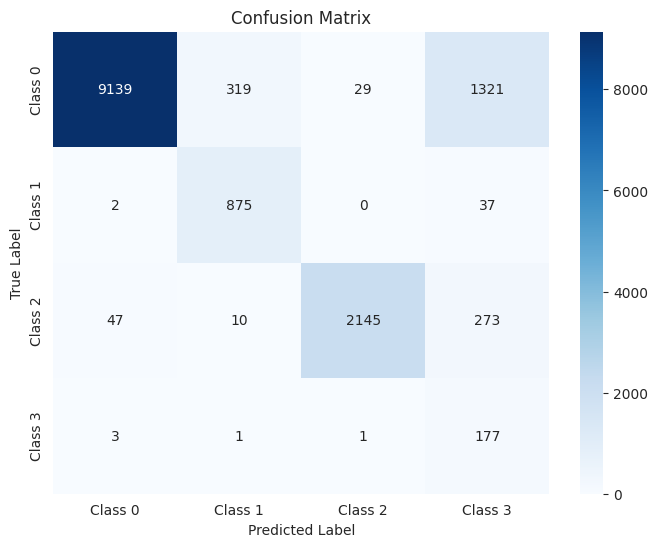

The function took 0.7506 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.85      0.91      2702
     Class 1       0.74      0.93      0.82       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.10      0.96      0.18        46

    accuracy                           0.86      3595
   macro avg       0.70      0.90      0.71      3595
weighted avg       0.96      0.86      0.90      3595



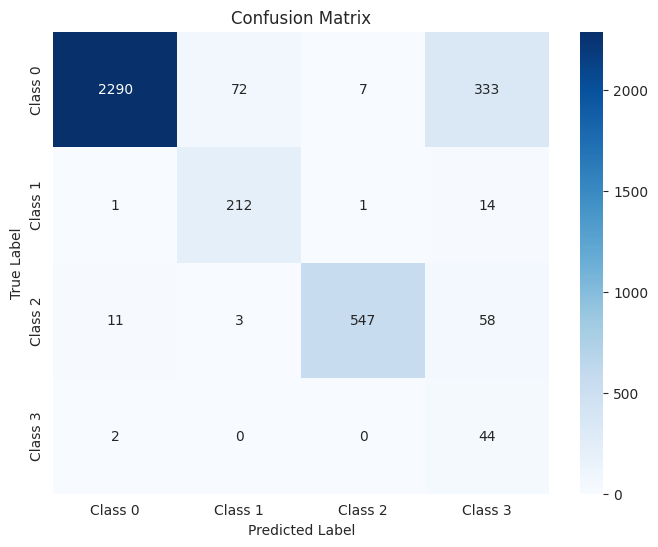

The function took 0.4925 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.85      0.91      3378
     Class 1       0.72      0.94      0.81       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.09      0.93      0.17        57

    accuracy                           0.85      4494
   macro avg       0.70      0.89      0.70      4494
weighted avg       0.96      0.85      0.90      4494



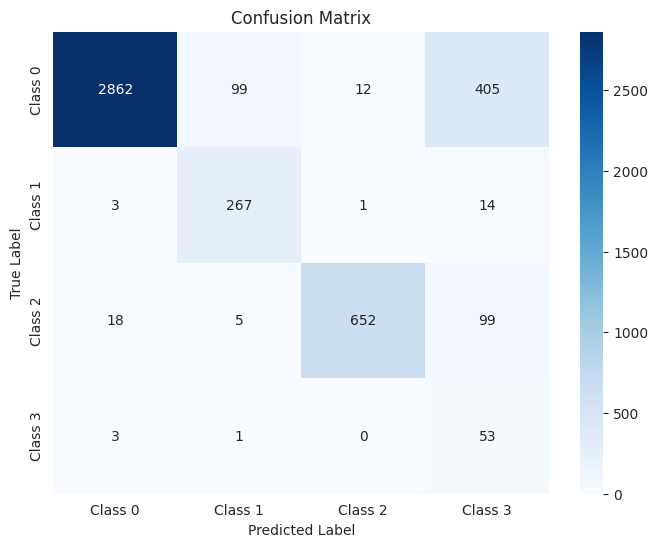

The function took 0.5334 seconds to execute.
[ARCH#231-[8, 8, 8, 2, 2]] done in 35.0s  best-val=0.6093


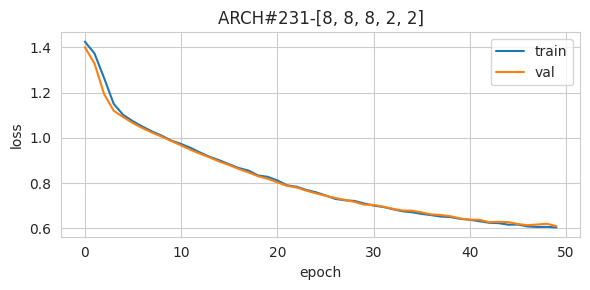


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90     10808
     Class 1       0.38      0.91      0.54       914
     Class 2       0.98      0.89      0.93      2475
     Class 3       0.15      0.86      0.26       182

    accuracy                           0.84     14379
   macro avg       0.63      0.87      0.66     14379
weighted avg       0.95      0.84      0.88     14379



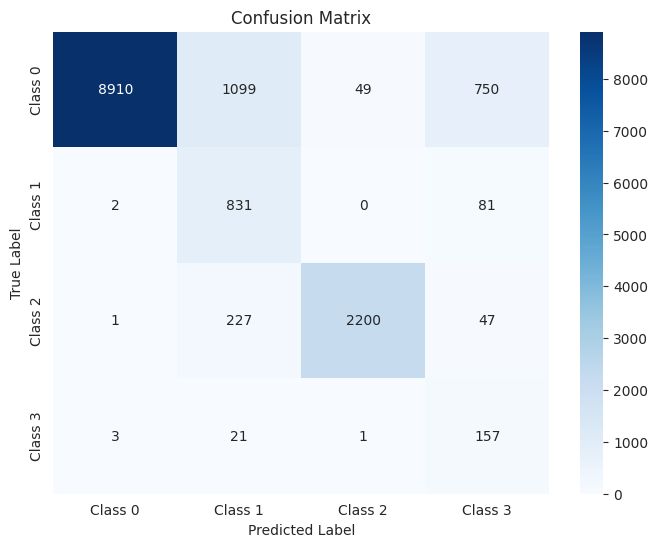

The function took 0.7798 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.91      2702
     Class 1       0.39      0.88      0.54       228
     Class 2       0.97      0.91      0.94       619
     Class 3       0.15      0.85      0.25        46

    accuracy                           0.85      3595
   macro avg       0.63      0.87      0.66      3595
weighted avg       0.94      0.85      0.88      3595



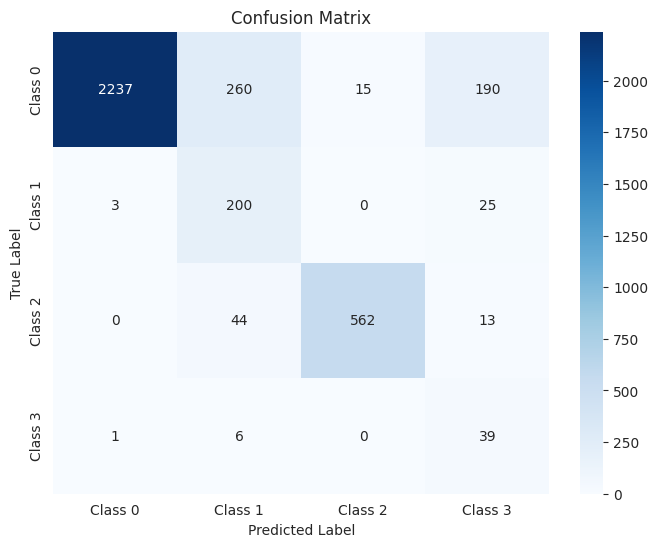

The function took 0.3925 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.90      3378
     Class 1       0.38      0.88      0.53       285
     Class 2       0.97      0.88      0.92       774
     Class 3       0.15      0.84      0.25        57

    accuracy                           0.84      4494
   macro avg       0.62      0.86      0.65      4494
weighted avg       0.94      0.84      0.88      4494



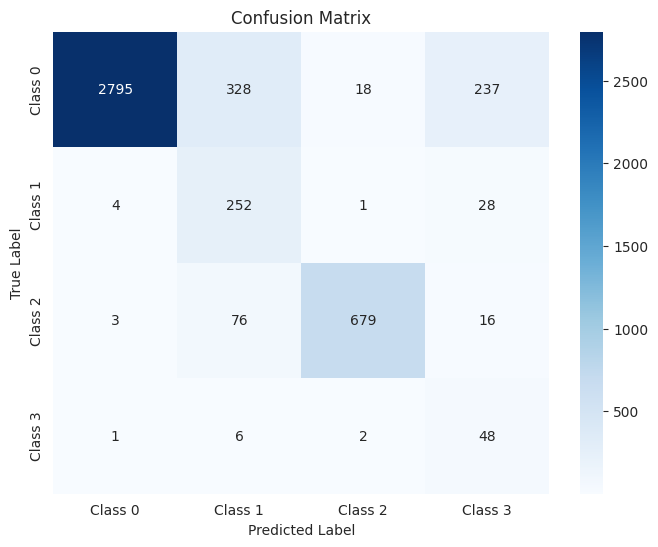

The function took 0.4016 seconds to execute.
[ARCH#232-[8, 8, 4, 4, 4]] done in 34.2s  best-val=0.4413


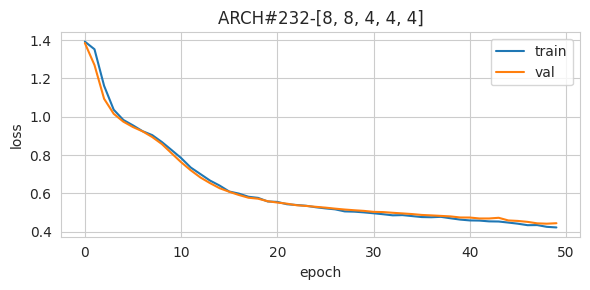


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90     10808
     Class 1       0.72      0.96      0.82       914
     Class 2       0.88      0.96      0.92      2475
     Class 3       0.10      0.81      0.17       182

    accuracy                           0.86     14379
   macro avg       0.67      0.89      0.70     14379
weighted avg       0.95      0.86      0.89     14379



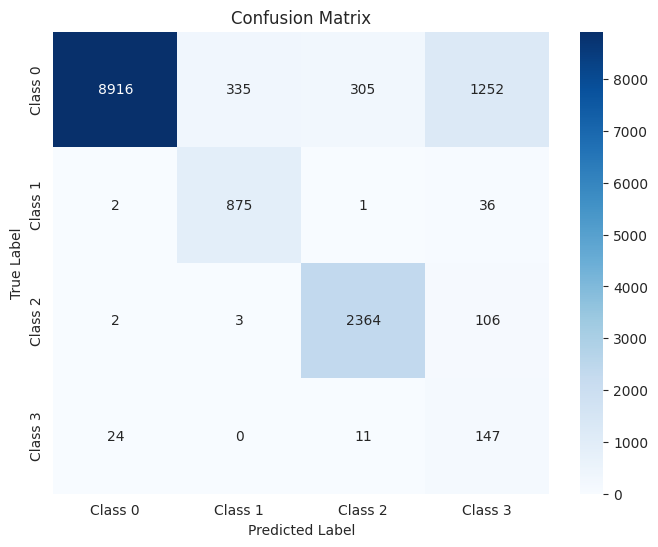

The function took 0.9098 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.83      0.91      2702
     Class 1       0.74      0.93      0.83       228
     Class 2       0.86      0.97      0.91       619
     Class 3       0.10      0.74      0.17        46

    accuracy                           0.86      3595
   macro avg       0.67      0.87      0.70      3595
weighted avg       0.94      0.86      0.89      3595



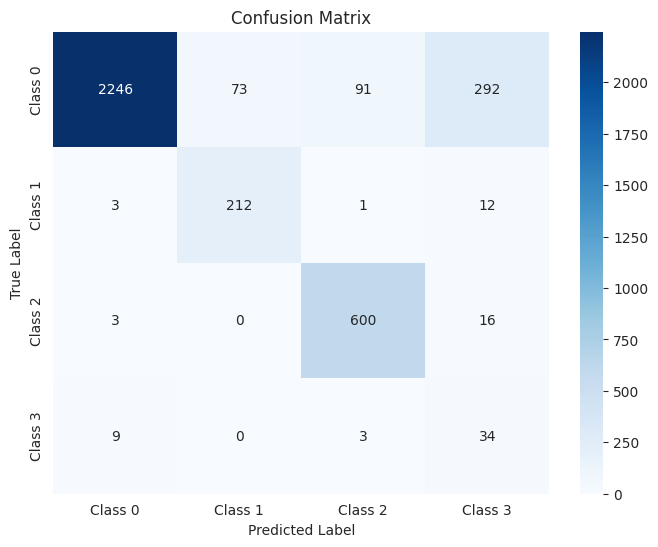

The function took 0.4041 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.90      3378
     Class 1       0.71      0.94      0.81       285
     Class 2       0.88      0.94      0.91       774
     Class 3       0.10      0.82      0.17        57

    accuracy                           0.85      4494
   macro avg       0.67      0.88      0.70      4494
weighted avg       0.95      0.85      0.89      4494



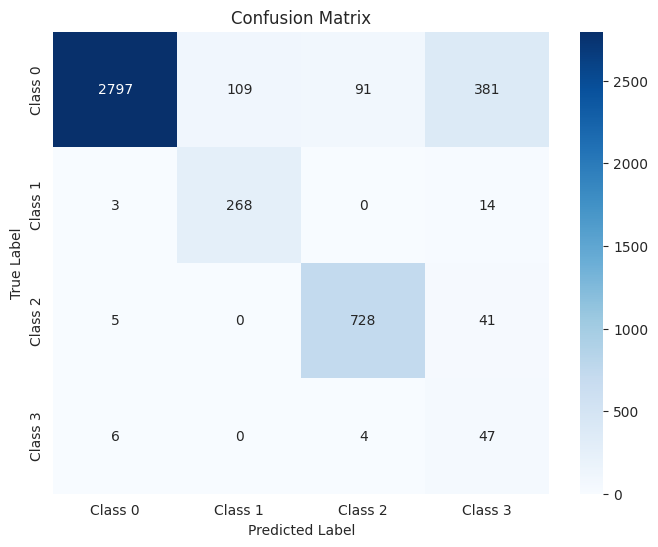

The function took 0.4416 seconds to execute.
[ARCH#233-[8, 8, 4, 4, 2]] done in 33.8s  best-val=0.4053


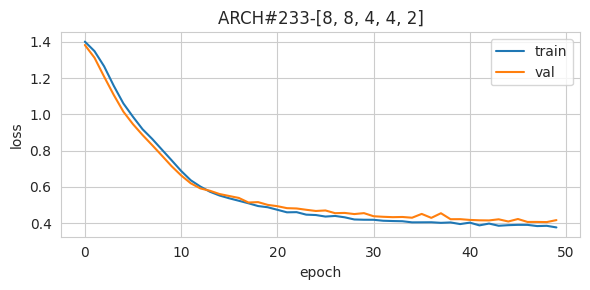


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.90     10808
     Class 1       0.71      0.95      0.82       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.09      0.96      0.16       182

    accuracy                           0.84     14379
   macro avg       0.70      0.90      0.70     14379
weighted avg       0.97      0.84      0.89     14379



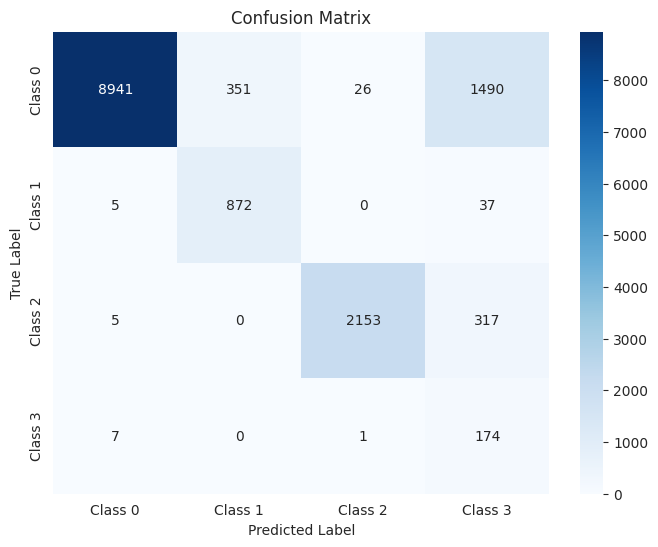

The function took 1.1016 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.90      2702
     Class 1       0.75      0.93      0.83       228
     Class 2       0.98      0.88      0.93       619
     Class 3       0.09      0.98      0.16        46

    accuracy                           0.85      3595
   macro avg       0.70      0.90      0.71      3595
weighted avg       0.97      0.85      0.89      3595



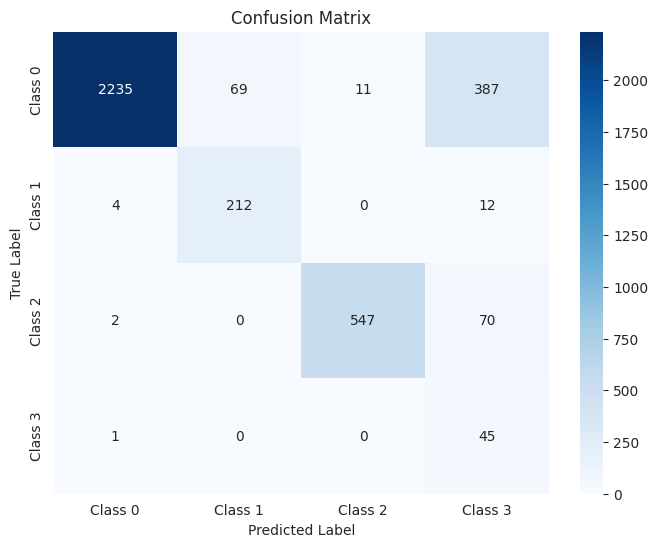

The function took 0.4179 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.91      3378
     Class 1       0.72      0.93      0.81       285
     Class 2       0.99      0.85      0.91       774
     Class 3       0.08      0.95      0.16        57

    accuracy                           0.84      4494
   macro avg       0.70      0.89      0.70      4494
weighted avg       0.97      0.84      0.89      4494



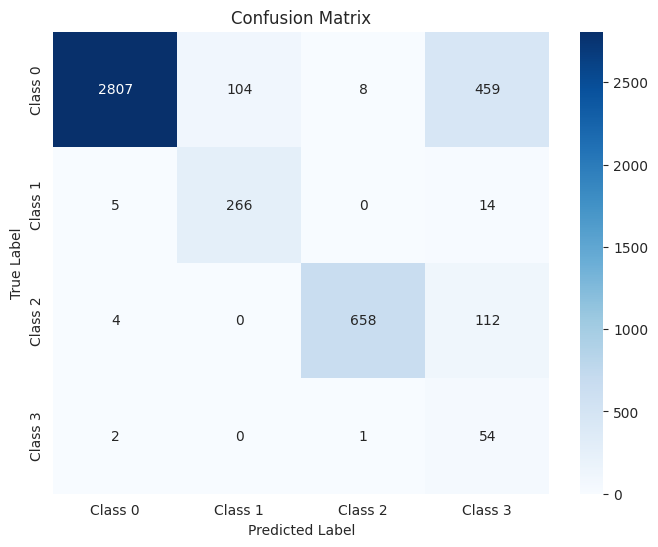

The function took 0.4251 seconds to execute.
[ARCH#234-[8, 8, 4, 2, 2]] done in 34.9s  best-val=1.3794


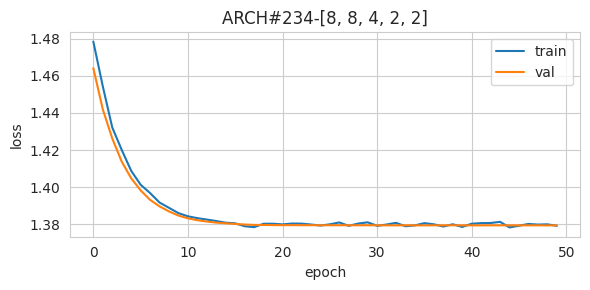


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



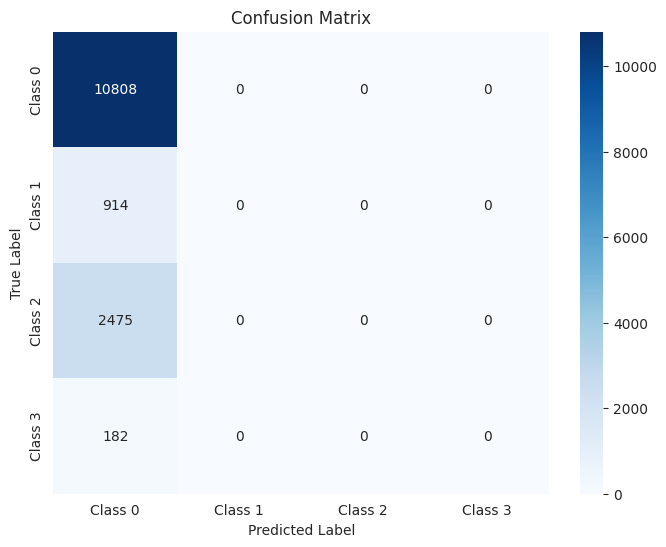

The function took 0.7168 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



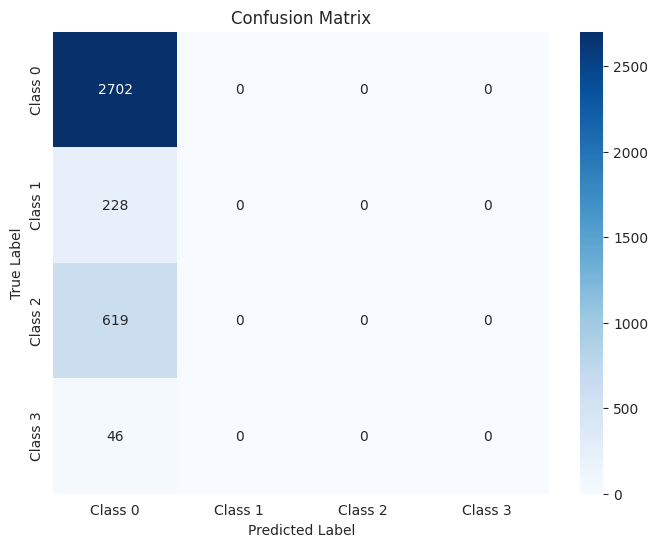

The function took 0.4002 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



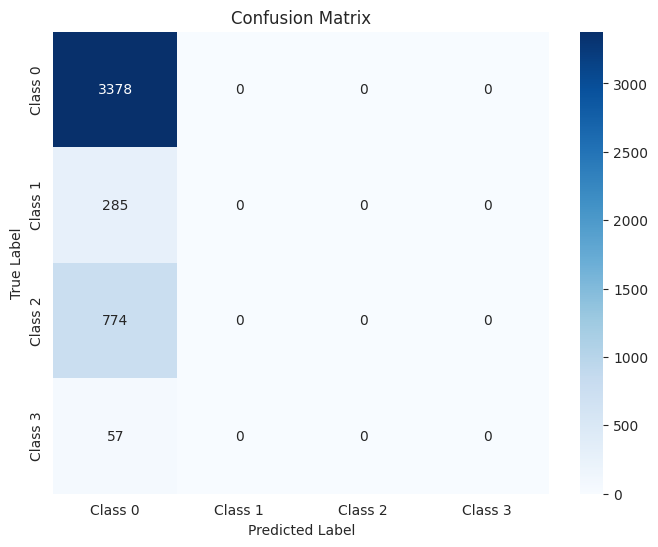

The function took 0.4218 seconds to execute.
[ARCH#235-[8, 8, 2, 2, 2]] done in 34.6s  best-val=0.4499


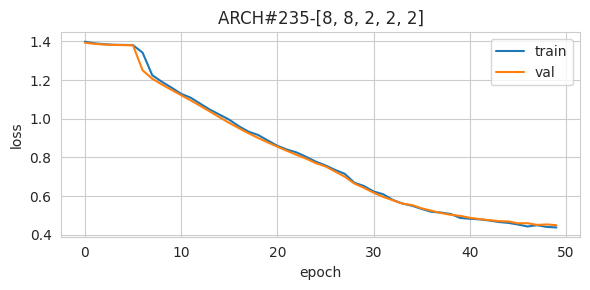


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.79      0.88     10808
     Class 1       0.65      0.96      0.77       914
     Class 2       0.87      0.95      0.91      2475
     Class 3       0.09      0.90      0.17       182

    accuracy                           0.83     14379
   macro avg       0.65      0.90      0.68     14379
weighted avg       0.94      0.83      0.87     14379



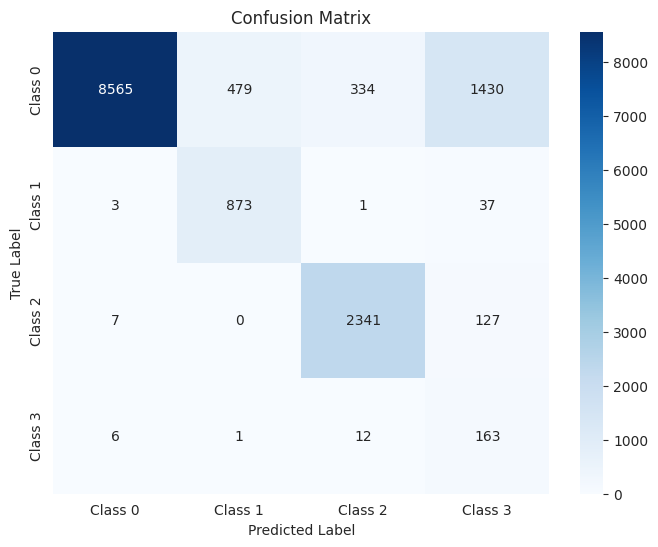

The function took 0.7627 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.80      0.89      2702
     Class 1       0.67      0.93      0.78       228
     Class 2       0.85      0.96      0.90       619
     Class 3       0.10      0.89      0.18        46

    accuracy                           0.83      3595
   macro avg       0.65      0.90      0.69      3595
weighted avg       0.94      0.83      0.87      3595



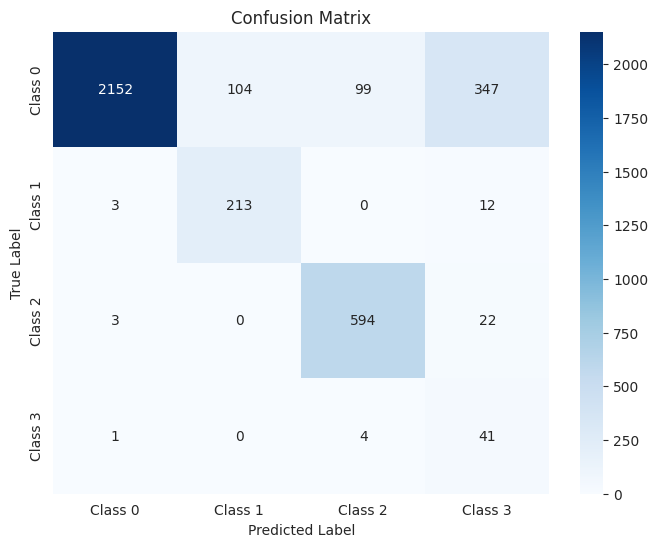

The function took 0.3978 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.79      0.88      3378
     Class 1       0.63      0.94      0.76       285
     Class 2       0.87      0.93      0.90       774
     Class 3       0.09      0.88      0.16        57

    accuracy                           0.83      4494
   macro avg       0.65      0.89      0.68      4494
weighted avg       0.94      0.83      0.87      4494



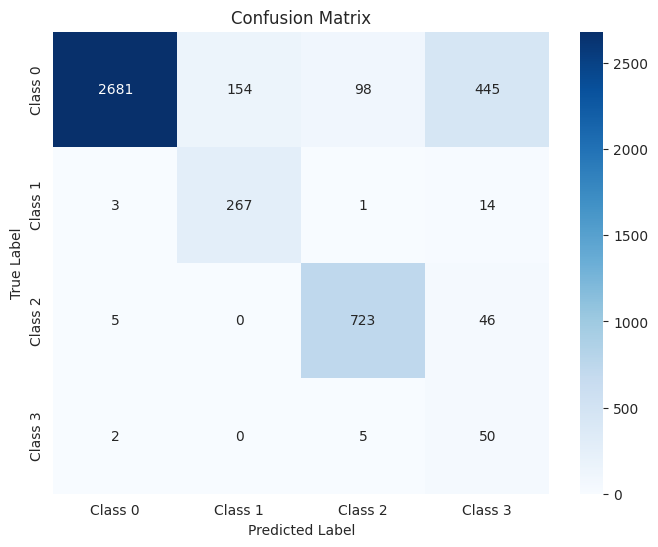

The function took 0.4292 seconds to execute.
[ARCH#236-[8, 4, 4, 4, 4]] done in 33.7s  best-val=0.3956


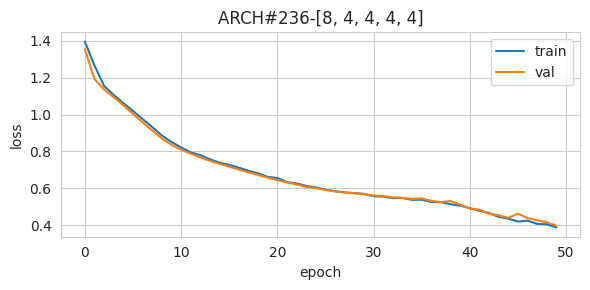


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90     10808
     Class 1       0.71      0.95      0.81       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.08      0.97      0.16       182

    accuracy                           0.84     14379
   macro avg       0.70      0.90      0.70     14379
weighted avg       0.97      0.84      0.89     14379



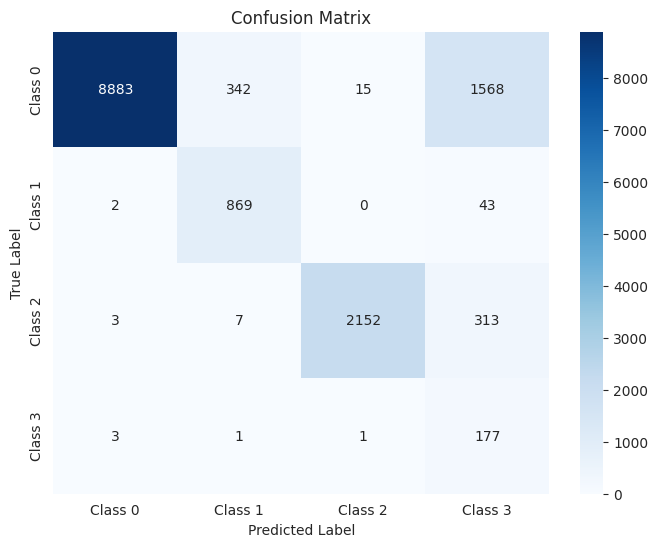

The function took 0.7519 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.91      2702
     Class 1       0.72      0.92      0.81       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.09      0.98      0.17        46

    accuracy                           0.85      3595
   macro avg       0.70      0.90      0.70      3595
weighted avg       0.97      0.85      0.90      3595



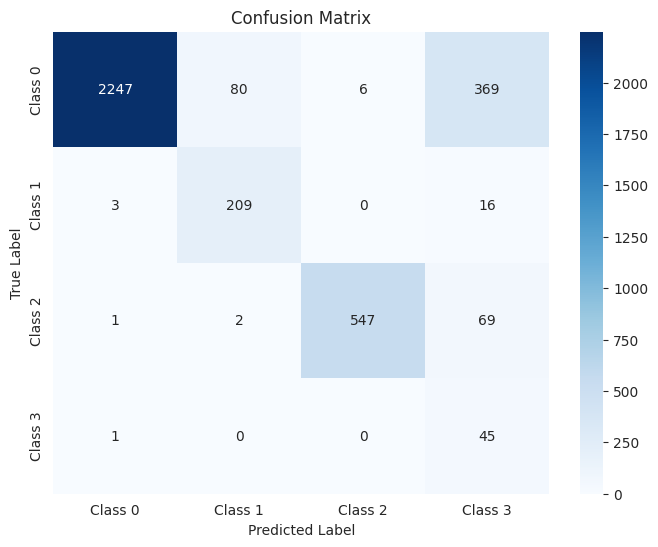

The function took 0.4797 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90      3378
     Class 1       0.71      0.93      0.80       285
     Class 2       0.98      0.85      0.91       774
     Class 3       0.08      0.96      0.15        57

    accuracy                           0.83      4494
   macro avg       0.69      0.89      0.69      4494
weighted avg       0.96      0.83      0.89      4494



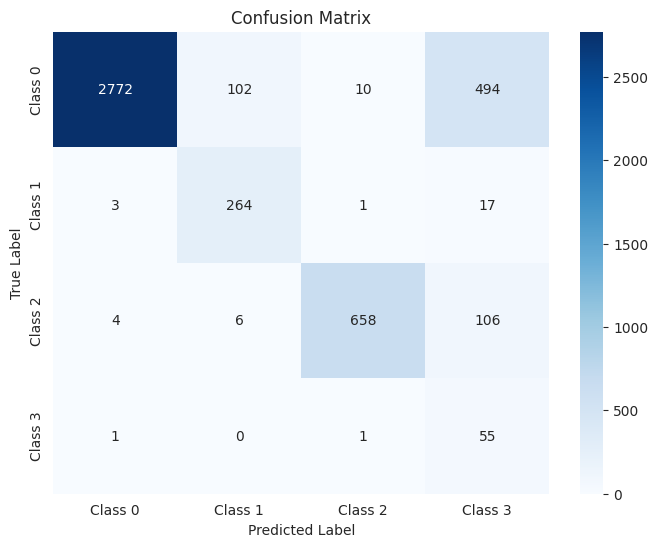

The function took 0.5002 seconds to execute.
[ARCH#237-[8, 4, 4, 4, 2]] early-stop @ epoch 042
[ARCH#237-[8, 4, 4, 4, 2]] done in 30.5s  best-val=1.3794


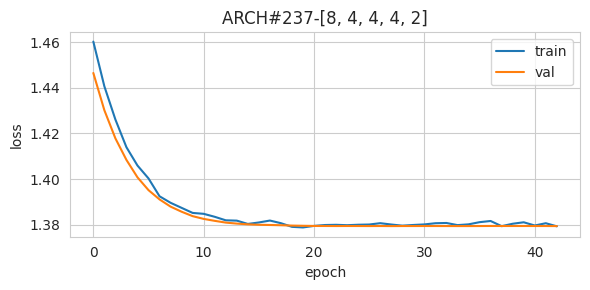


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



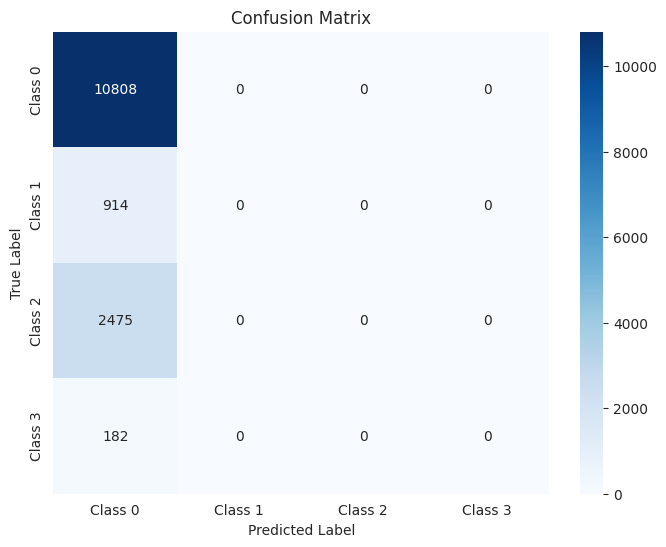

The function took 0.8591 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



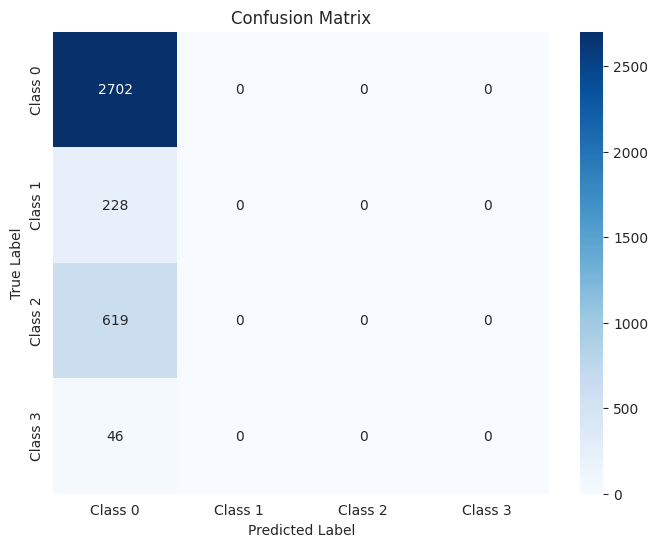

The function took 0.4633 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



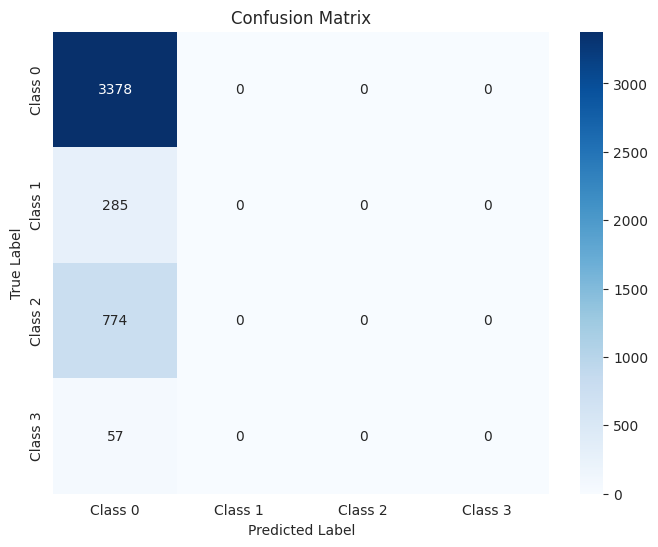

The function took 0.5648 seconds to execute.
[ARCH#238-[8, 4, 4, 2, 2]] done in 34.1s  best-val=0.5649


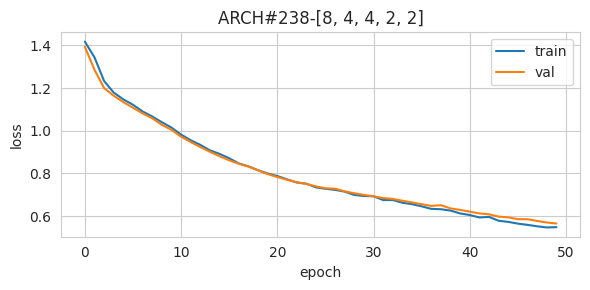


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.78      0.88     10808
     Class 1       0.60      0.96      0.74       914
     Class 2       0.76      0.95      0.85      2475
     Class 3       0.12      0.89      0.21       182

    accuracy                           0.82     14379
   macro avg       0.62      0.90      0.67     14379
weighted avg       0.92      0.82      0.86     14379



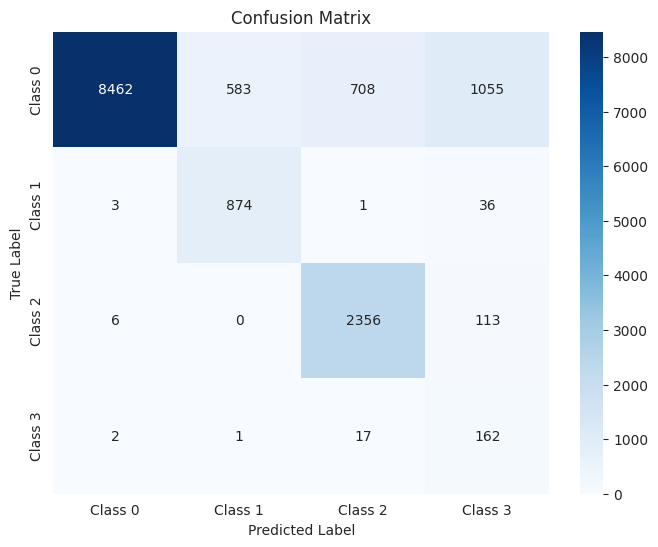

The function took 0.7739 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.79      0.88      2702
     Class 1       0.62      0.93      0.74       228
     Class 2       0.75      0.97      0.85       619
     Class 3       0.12      0.78      0.21        46

    accuracy                           0.83      3595
   macro avg       0.62      0.87      0.67      3595
weighted avg       0.92      0.83      0.86      3595



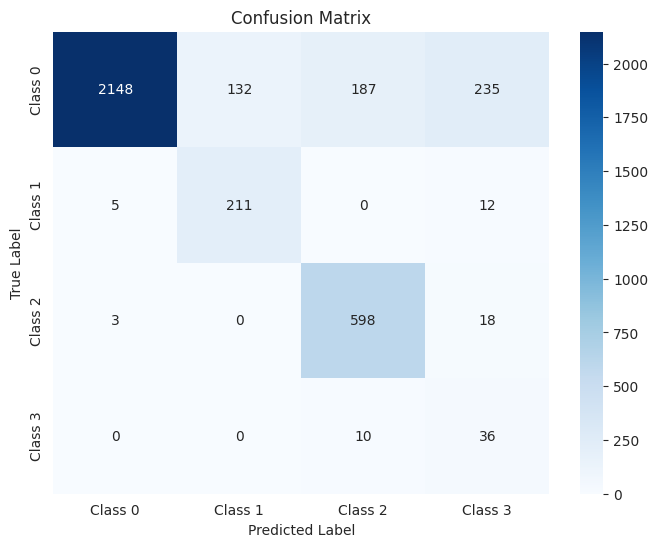

The function took 0.4052 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.79      0.88      3378
     Class 1       0.60      0.94      0.73       285
     Class 2       0.76      0.94      0.84       774
     Class 3       0.11      0.84      0.20        57

    accuracy                           0.82      4494
   macro avg       0.62      0.88      0.66      4494
weighted avg       0.92      0.82      0.85      4494



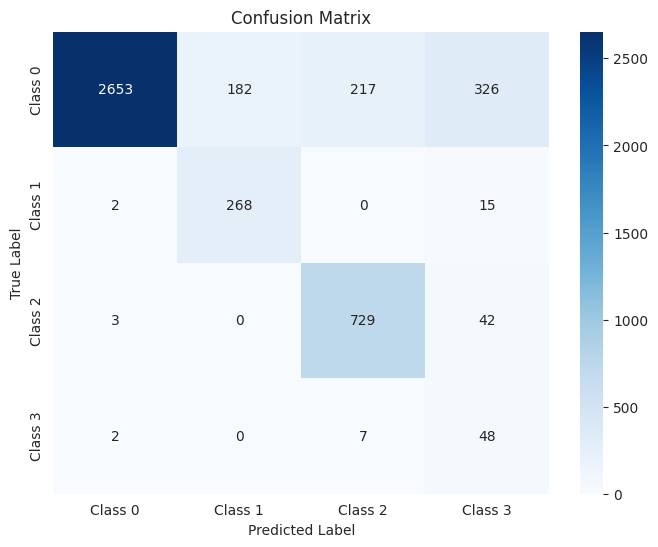

The function took 0.4375 seconds to execute.
[ARCH#239-[8, 4, 2, 2, 2]] early-stop @ epoch 028
[ARCH#239-[8, 4, 2, 2, 2]] done in 20.6s  best-val=1.3794


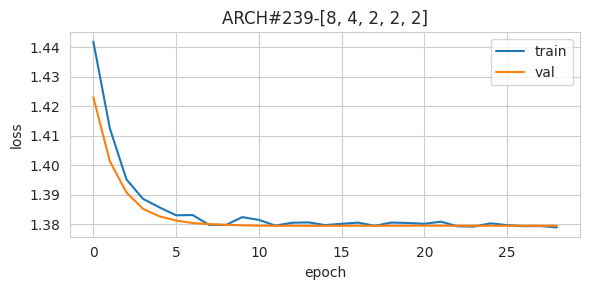


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



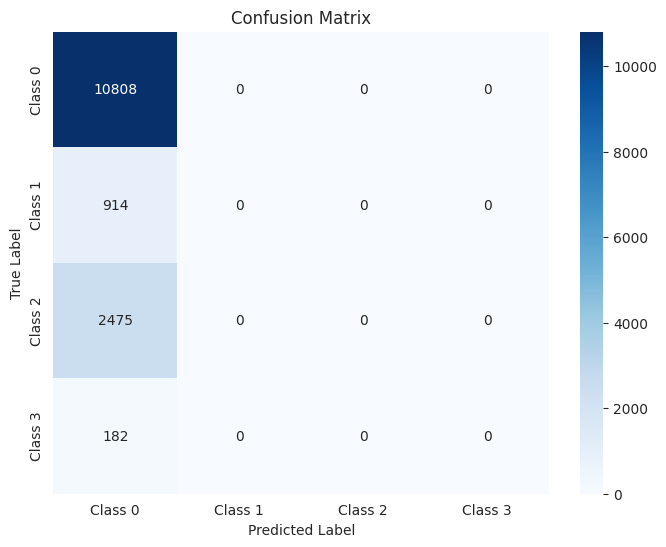

The function took 0.7200 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



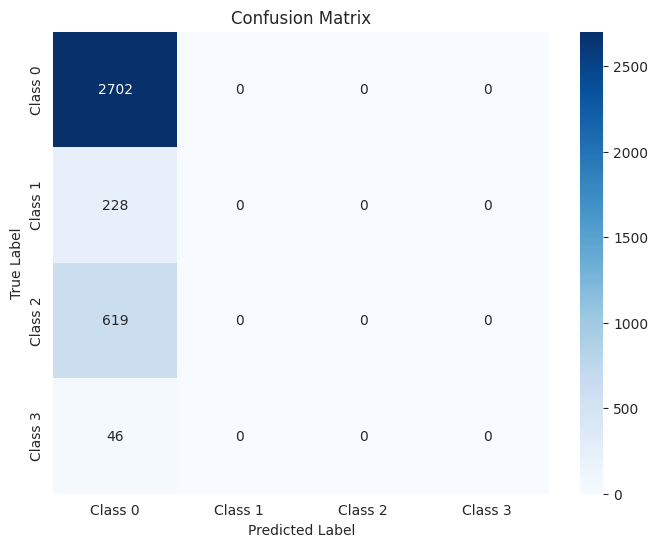

The function took 0.4080 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



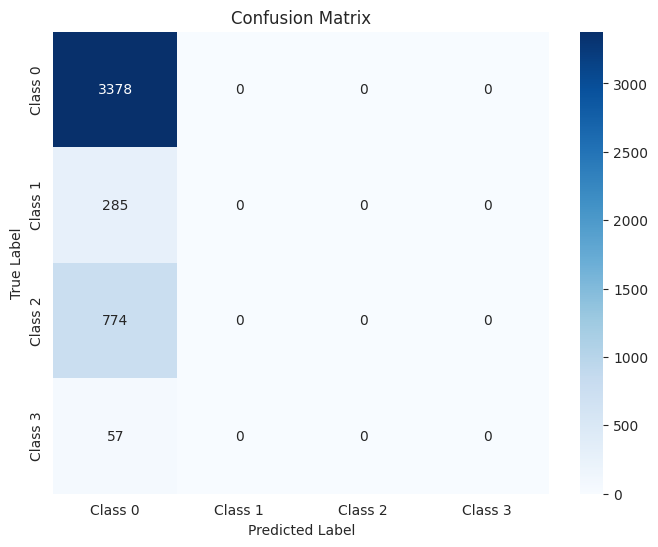

The function took 0.4015 seconds to execute.
[ARCH#240-[8, 2, 2, 2, 2]] early-stop @ epoch 039
[ARCH#240-[8, 2, 2, 2, 2]] done in 27.4s  best-val=1.3794


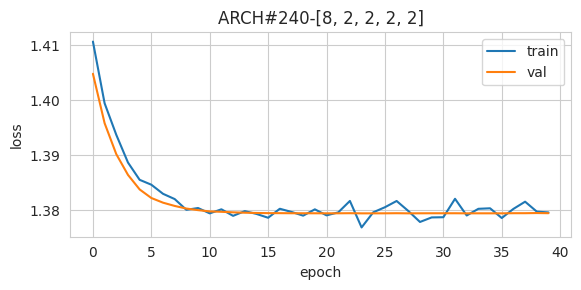


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



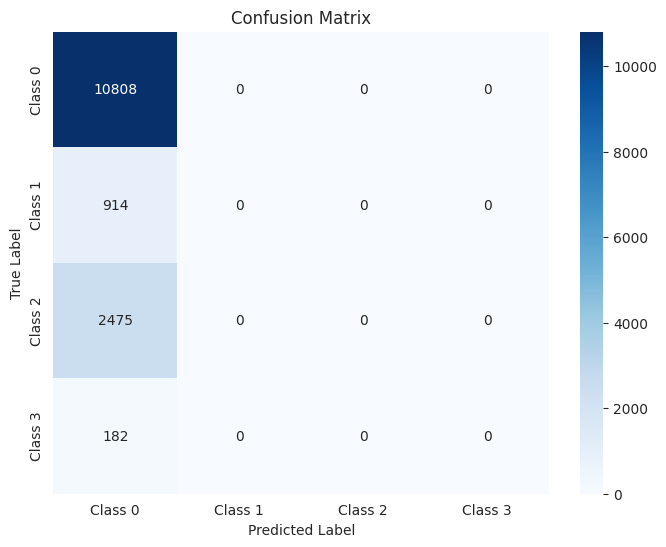

The function took 0.7193 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



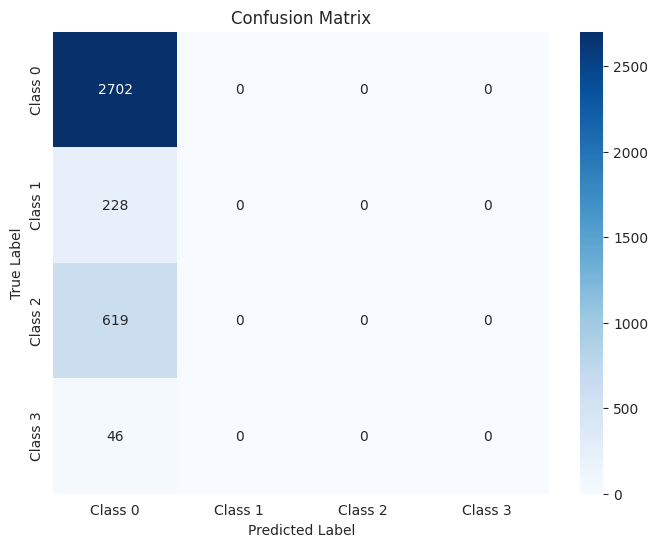

The function took 0.3793 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



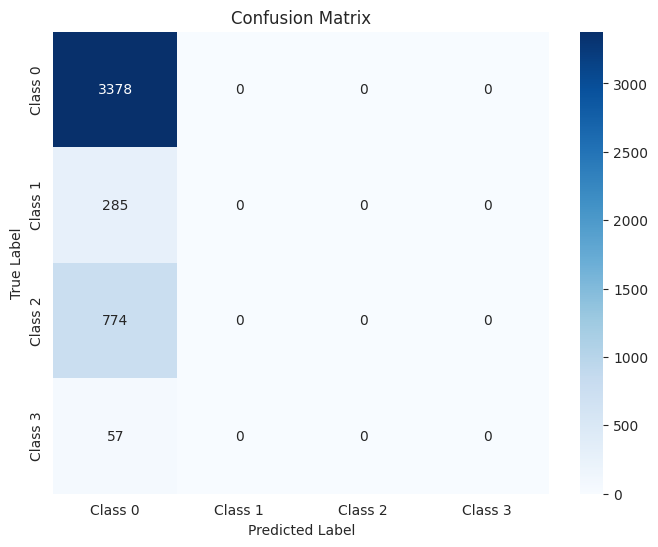

The function took 0.4233 seconds to execute.
[ARCH#241-[4, 4, 4, 4, 4]] done in 34.3s  best-val=0.4645


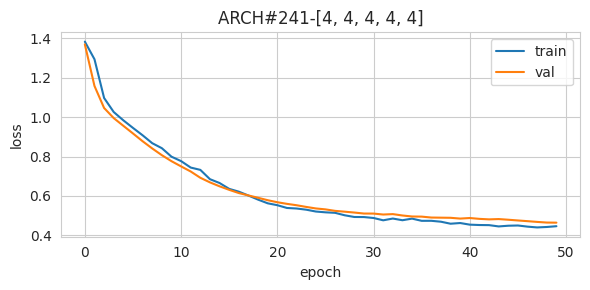


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.88      0.92     10808
     Class 1       0.74      0.91      0.82       914
     Class 2       0.88      0.86      0.87      2475
     Class 3       0.16      0.86      0.27       182

    accuracy                           0.88     14379
   macro avg       0.69      0.88      0.72     14379
weighted avg       0.93      0.88      0.90     14379



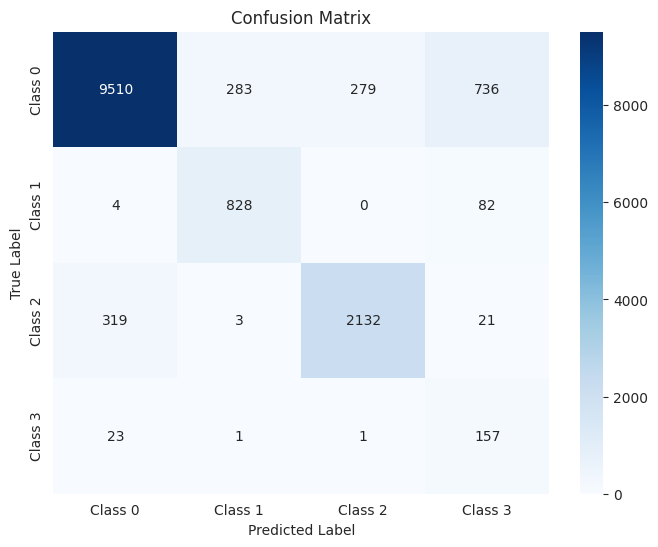

The function took 0.7102 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.89      0.93      2702
     Class 1       0.76      0.87      0.81       228
     Class 2       0.89      0.88      0.88       619
     Class 3       0.15      0.83      0.26        46

    accuracy                           0.88      3595
   macro avg       0.69      0.87      0.72      3595
weighted avg       0.93      0.88      0.90      3595



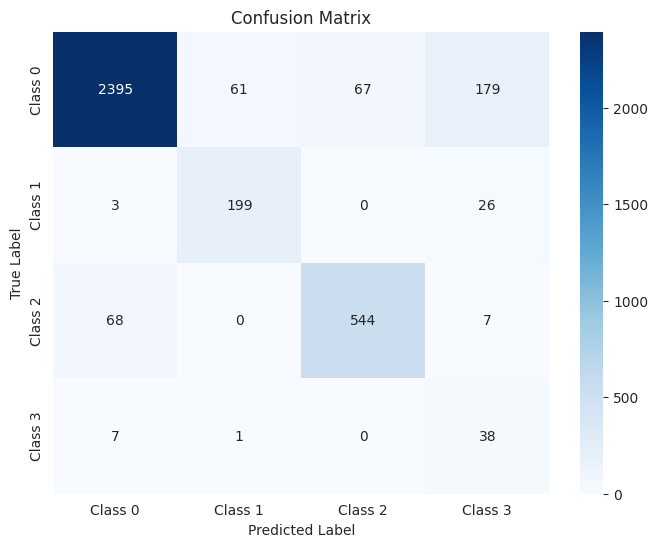

The function took 0.7755 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.88      0.92      3378
     Class 1       0.74      0.88      0.81       285
     Class 2       0.87      0.84      0.86       774
     Class 3       0.14      0.82      0.25        57

    accuracy                           0.87      4494
   macro avg       0.68      0.86      0.71      4494
weighted avg       0.92      0.87      0.89      4494



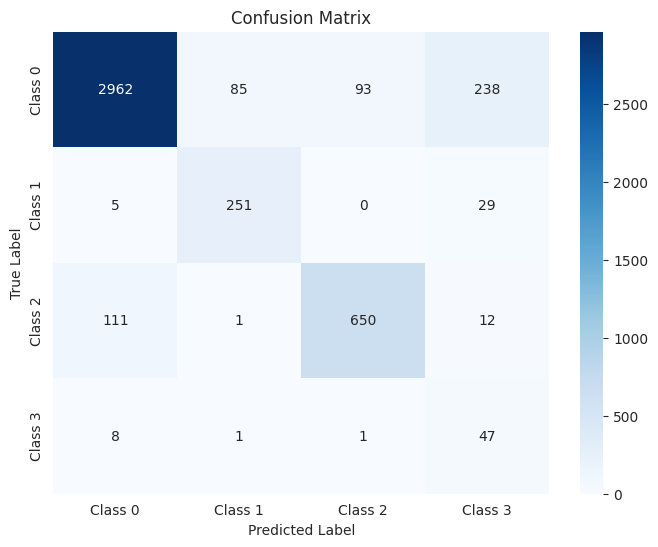

The function took 0.4163 seconds to execute.
[ARCH#242-[4, 4, 4, 4, 2]] done in 33.9s  best-val=0.8983


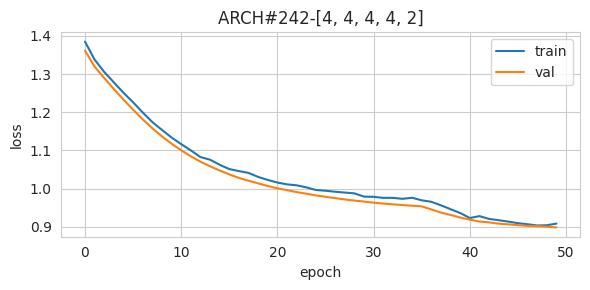


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.89      0.88      0.89     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.75      0.97      0.85      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.83     14379
   macro avg       0.41      0.46      0.43     14379
weighted avg       0.80      0.83      0.81     14379



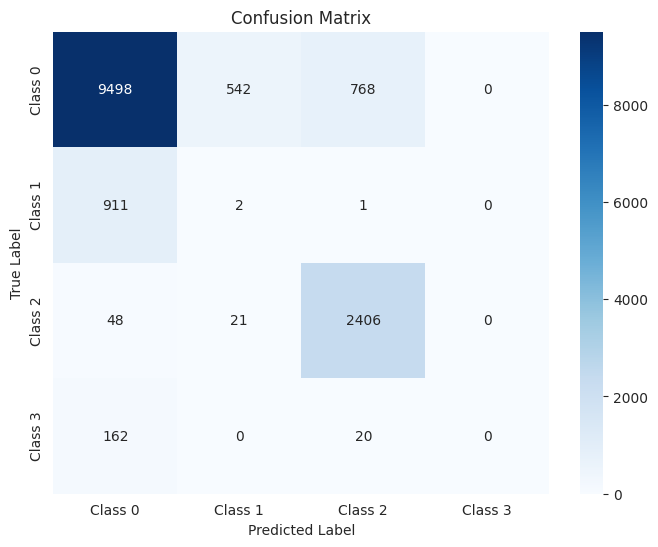

The function took 0.8612 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.89      0.88      0.89      2702
     Class 1       0.01      0.01      0.01       228
     Class 2       0.75      0.98      0.85       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.83      3595
   macro avg       0.41      0.47      0.44      3595
weighted avg       0.80      0.83      0.81      3595



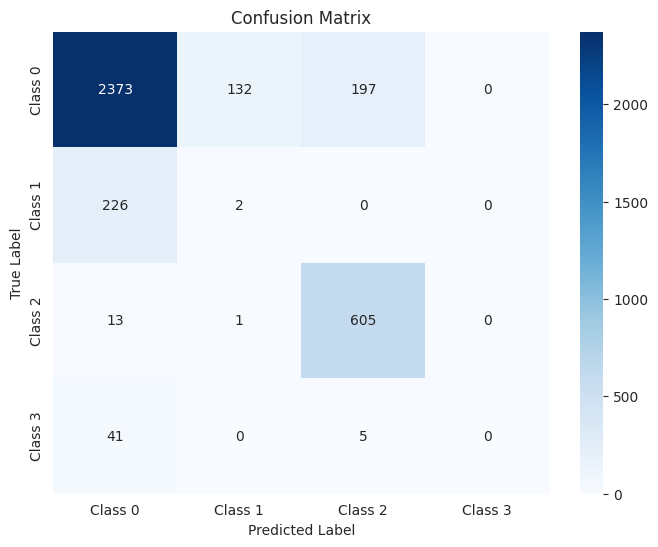

The function took 0.4602 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.89      0.89      0.89      3378
     Class 1       0.01      0.00      0.00       285
     Class 2       0.76      0.97      0.85       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.83      4494
   macro avg       0.41      0.46      0.44      4494
weighted avg       0.80      0.83      0.82      4494



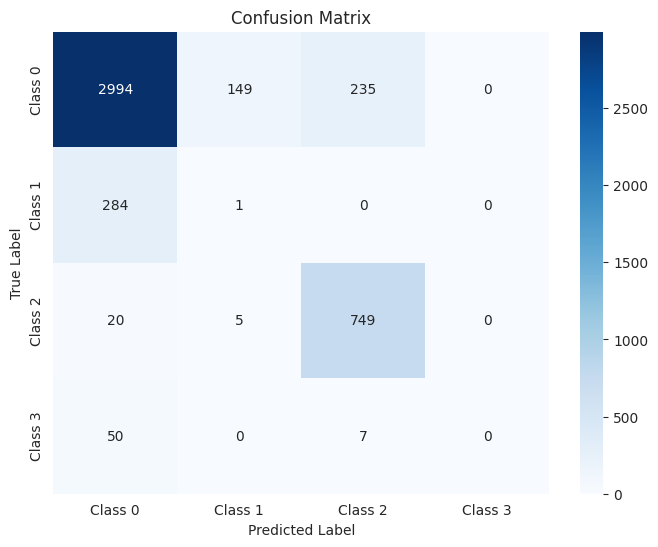

The function took 0.5100 seconds to execute.
[ARCH#243-[4, 4, 4, 2, 2]] done in 34.8s  best-val=0.5707


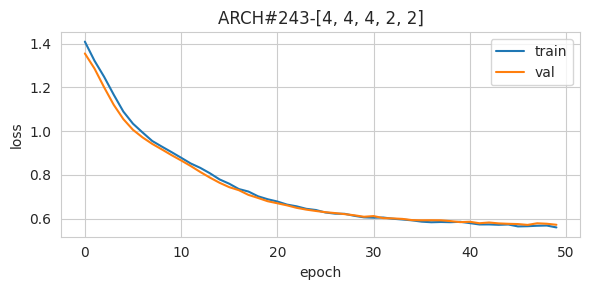


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.26      0.42     10808
     Class 1       0.41      0.96      0.57       914
     Class 2       0.96      0.87      0.91      2475
     Class 3       0.03      0.99      0.05       182

    accuracy                           0.42     14379
   macro avg       0.60      0.77      0.49     14379
weighted avg       0.94      0.42      0.51     14379



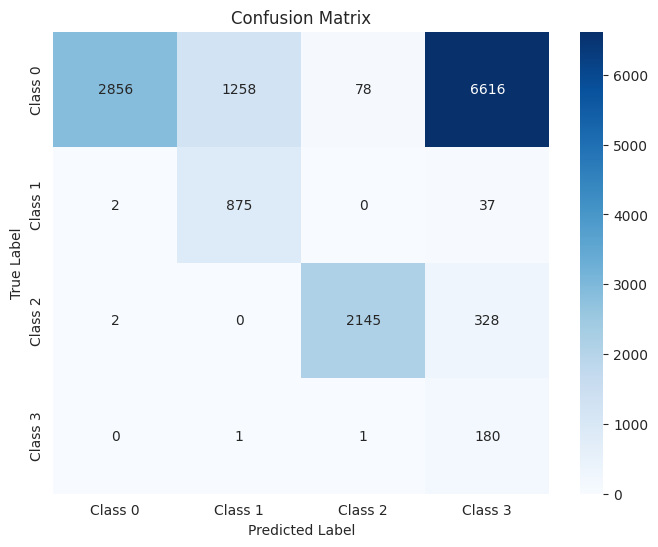

The function took 0.7583 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.25      0.41      2702
     Class 1       0.41      0.93      0.57       228
     Class 2       0.96      0.89      0.92       619
     Class 3       0.02      0.98      0.05        46

    accuracy                           0.42      3595
   macro avg       0.60      0.76      0.49      3595
weighted avg       0.94      0.42      0.50      3595



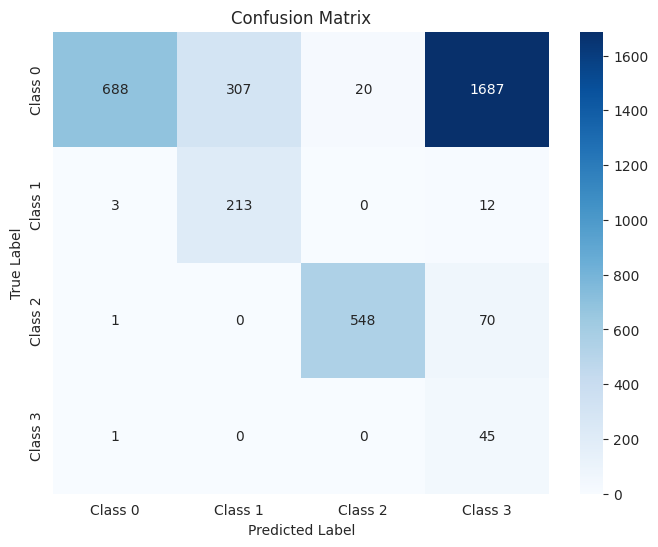

The function took 0.3940 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.26      0.42      3378
     Class 1       0.39      0.94      0.55       285
     Class 2       0.96      0.84      0.90       774
     Class 3       0.02      0.96      0.05        57

    accuracy                           0.41      4494
   macro avg       0.59      0.75      0.48      4494
weighted avg       0.94      0.41      0.50      4494



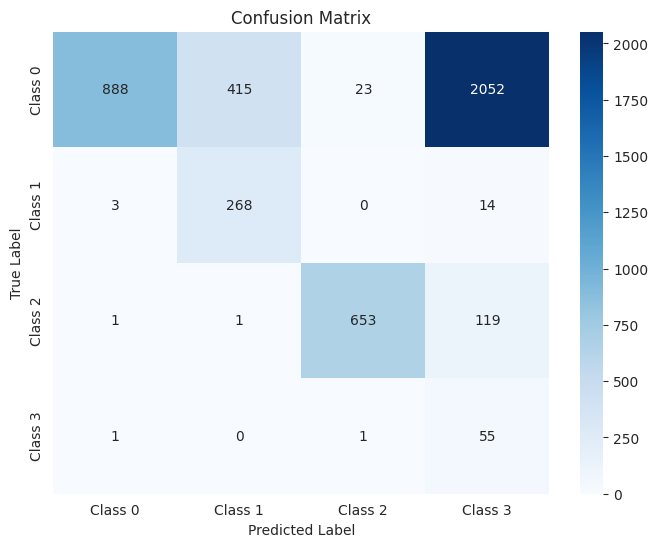

The function took 0.4581 seconds to execute.
[ARCH#244-[4, 4, 2, 2, 2]] early-stop @ epoch 032
[ARCH#244-[4, 4, 2, 2, 2]] done in 23.1s  best-val=1.3794


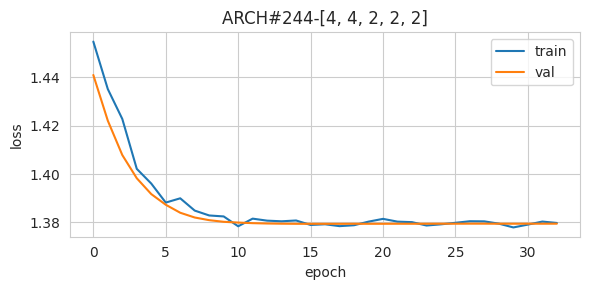


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



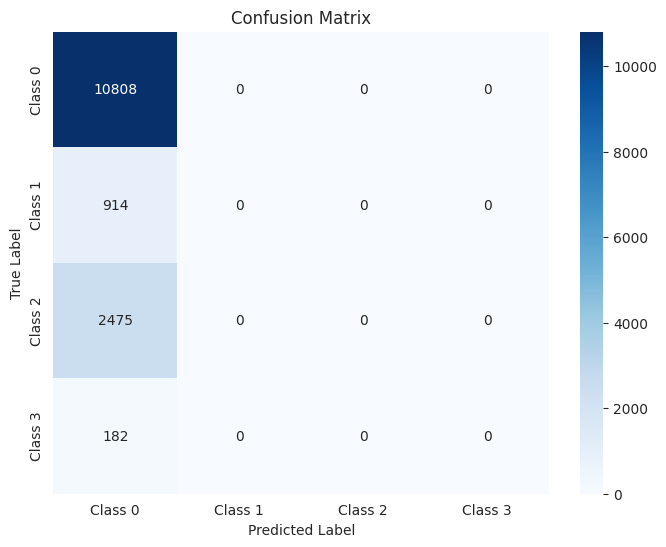

The function took 0.7418 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



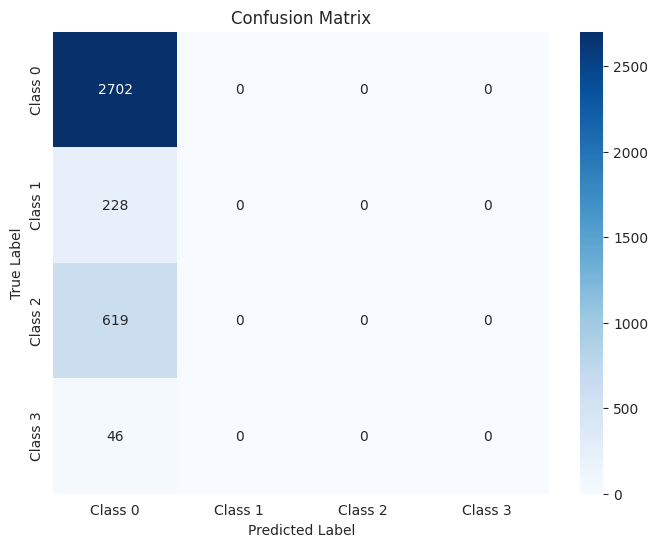

The function took 0.4044 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



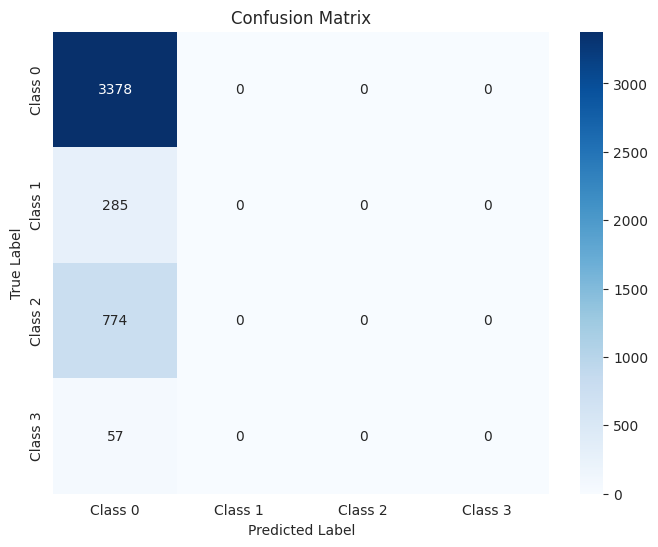

The function took 0.4025 seconds to execute.
[ARCH#245-[4, 2, 2, 2, 2]] early-stop @ epoch 040
[ARCH#245-[4, 2, 2, 2, 2]] done in 28.1s  best-val=1.3794


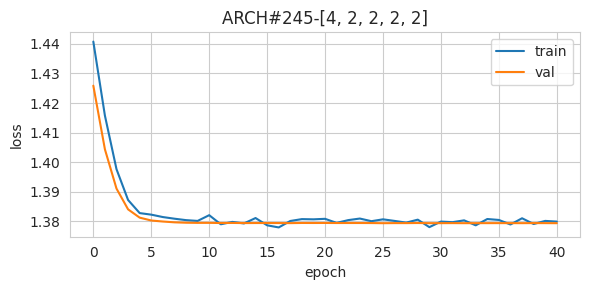


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.50      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.31      0.25      0.21     14379
weighted avg       0.65      0.75      0.65     14379



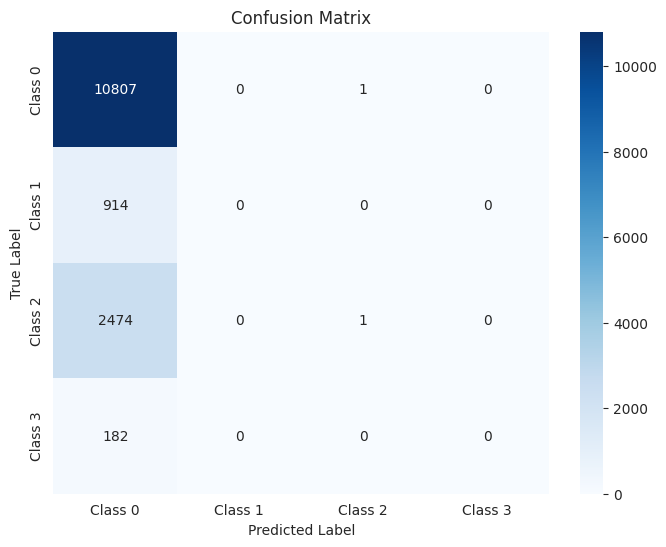

The function took 0.7824 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



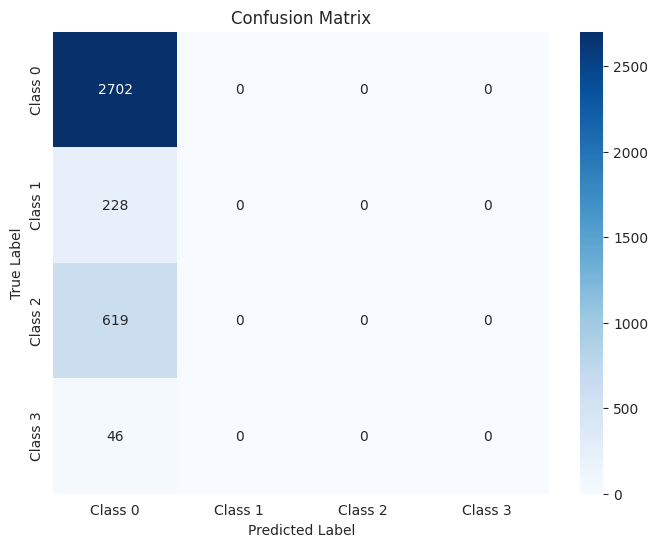

The function took 0.3787 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.56      0.75      0.64      4494



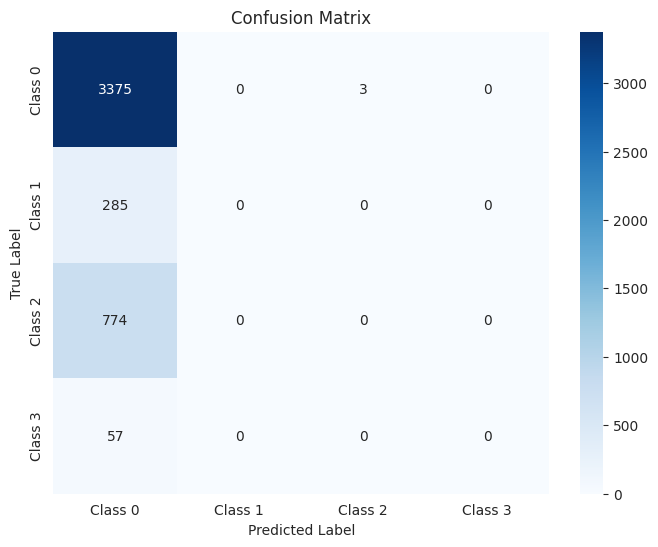

The function took 0.4384 seconds to execute.
[ARCH#246-[2, 2, 2, 2, 2]] early-stop @ epoch 046
[ARCH#246-[2, 2, 2, 2, 2]] done in 32.5s  best-val=1.3794


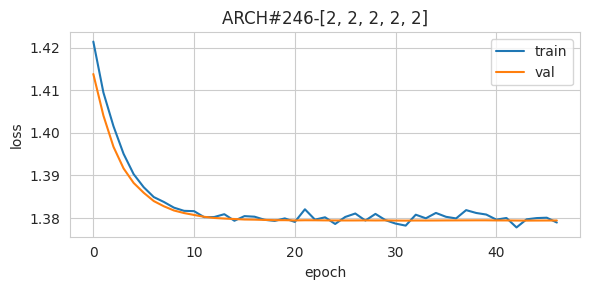


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



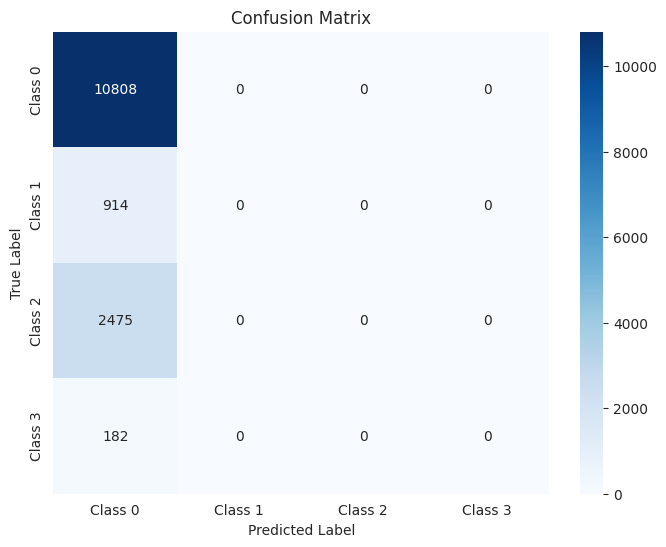

The function took 0.7390 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



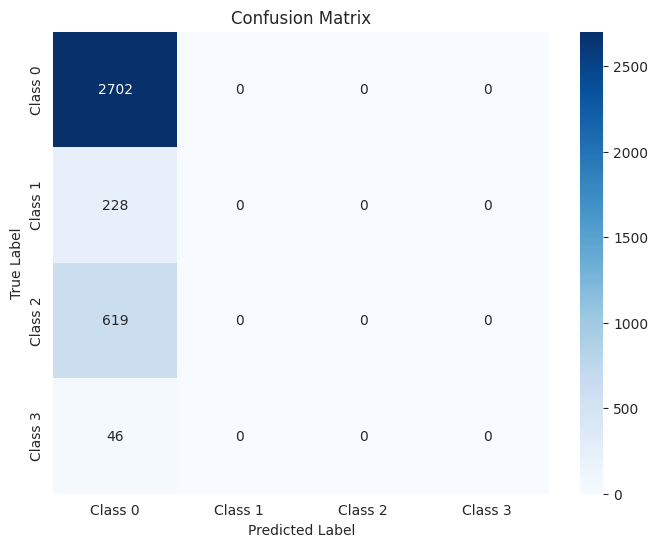

The function took 0.3766 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



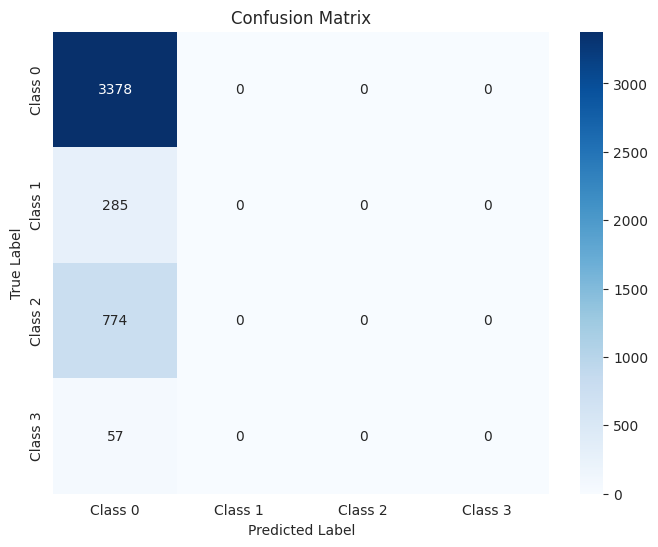

The function took 0.4202 seconds to execute.


,train,val,test
"ARCH#001-[32, 32]","{'accuracy': 93.18450518116698, 'precision': [...","{'accuracy': 92.87899860917942, 'precision': [...","{'accuracy': 93.12416555407209, 'precision': [..."
"ARCH#002-[32, 16]","{'accuracy': 90.88253703317338, 'precision': [...","{'accuracy': 91.04311543810849, 'precision': [...","{'accuracy': 90.96573208722741, 'precision': [..."
"ARCH#003-[32, 8]","{'accuracy': 91.18853884136588, 'precision': [...","{'accuracy': 91.23783031988873, 'precision': [...","{'accuracy': 91.4997774810859, 'precision': [0..."
"ARCH#004-[32, 4]","{'accuracy': 92.00222546769594, 'precision': [...","{'accuracy': 91.84979137691238, 'precision': [...","{'accuracy': 91.90031152647975, 'precision': [..."
"ARCH#005-[32, 2]","{'accuracy': 90.22185131093956, 'precision': [...","{'accuracy': 90.34770514603616, 'precision': [...","{'accuracy': 89.56386292834891, 'precision': [..."
...,...,...,...
"ARCH#242-[4, 4, 4, 4, 2]","{'accuracy': 82.80130746227137, 'precision': [...","{'accuracy': 82.89290681502086, 'precision': [...","{'accuracy': 83.31108144192257, 'precision': [..."
"ARCH#243-[4, 4, 4, 2, 2]","{'accuracy': 42.116976145768135, 'precision': ...","{'accuracy': 41.55771905424201, 'precision': [...","{'accuracy': 41.477525589675125, 'precision': ..."
"ARCH#244-[4, 4, 2, 2, 2]","{'accuracy': 75.16517143055846, 'precision': [...","{'accuracy': 75.15994436717664, 'precision': [...","{'accuracy': 75.16688918558077, 'precision': [..."
"ARCH#245-[4, 2, 2, 2, 2]","{'accuracy': 75.16517143055846, 'precision': [...","{'accuracy': 75.15994436717664, 'precision': [...","{'accuracy': 75.10013351134846, 'precision': [..."


In [ ]:
# ---------------- architecture sweep -------------------------------
# Run a small hyper-parameter sweep over fully connected architectures:
#   1. Build a candidate grid of 2-5 hidden layers whose widths monotonically
#      decrease (e.g. 32 -> 16 -> 8).  Each architecture is encoded as a list like
#      [input_dim, 32, 16, 8, n_classes].
#   2. For every architecture:
#        • Instantiate a PlainFFNN with ReLU activations
#        • Train it with AdamW + Cross-Entropy (class-weighted), early-stopping
#          max 50 epochs / 15 patience via `training_loop`
#        • Record accuracy on train, validation and test sets using
#          `testing_model`
#   3. Collect all results in a dict -> transpose to a DataFrame for comparison.

import itertools, torch.nn as nn, torch.optim as optim, numpy as np

input_dim  = X_train_tensor.shape[1]
n_classes  = len(torch.unique(y_train_tensor))

def PlainFFNN(sizes):
    layers=[]
    for a,b in zip(sizes[:-1], sizes[1:]):
        layers += [nn.Linear(a,b), nn.ReLU()]
    layers.pop()                        # keep last layer linear (logits)
    return nn.Sequential(*layers)

arch_grid = []
for d in range(2,6):                                      # 2 to 5 hidden layer
    for widths in itertools.product([32,16,8,4,2], repeat=d):
        if list(widths)==sorted(widths, reverse=True):  # enforce descending
            arch_grid.append([input_dim,*widths,n_classes])

results_arch = {}   # {cfg_name : {'train':…, 'val':…, 'test':…}}

for idx, arch in enumerate(arch_grid,1):
    cfg = f"ARCH#{idx:03d}-{arch[1:-1]}"
    net = PlainFFNN(arch)
    opt = optim.AdamW(net.parameters(), lr=5e-4)
    hist, net = training_loop(net, train_loader, val_loader,
                              train_dataset, val_dataset, DEVICE,
                              opt, nn.CrossEntropyLoss(weight=class_weights),
                              max_epochs=50, patience=15,
                              verbose_every=0, cfg_name=cfg)

    tr  = testing_model(net, train_loader, DEVICE)
    vl  = testing_model(net,  val_loader, DEVICE)
    tst = testing_model(net,  test_loader, DEVICE)
    results_arch[cfg] = {'train':tr, 'val':vl, 'test':tst}


pd.DataFrame(results_arch).T


### best - batch-size

[BS=1] done in 1376.0s  best-val=0.1102


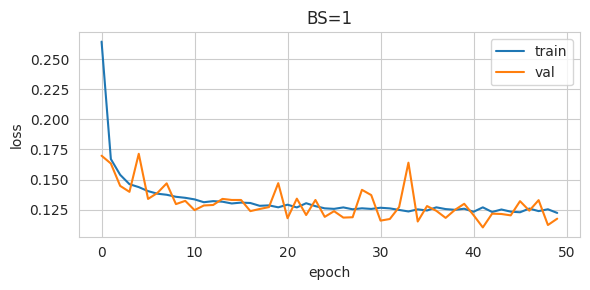


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.98      0.97     10808
     Class 1       0.81      0.95      0.87       914
     Class 2       1.00      0.89      0.94      2475
     Class 3       0.38      0.14      0.21       182

    accuracy                           0.95     14379
   macro avg       0.79      0.74      0.75     14379
weighted avg       0.95      0.95      0.95     14379



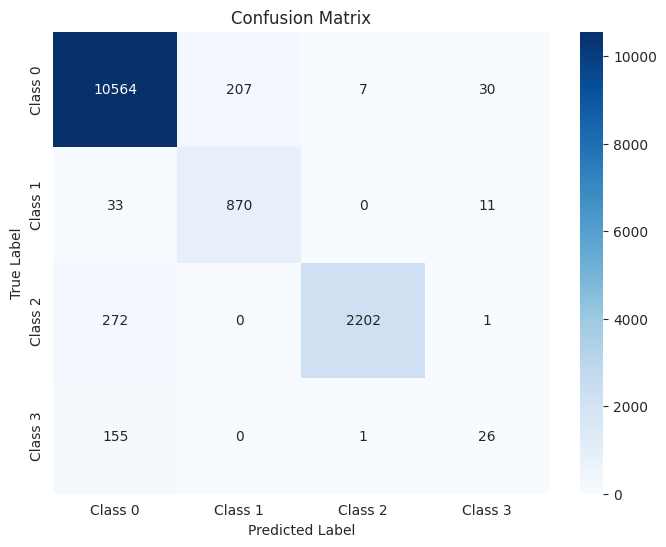

The function took 6.9989 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.98      0.97      2702
     Class 1       0.83      0.93      0.88       228
     Class 2       1.00      0.91      0.95       619
     Class 3       0.36      0.17      0.24        46

    accuracy                           0.95      3595
   macro avg       0.79      0.75      0.76      3595
weighted avg       0.95      0.95      0.95      3595



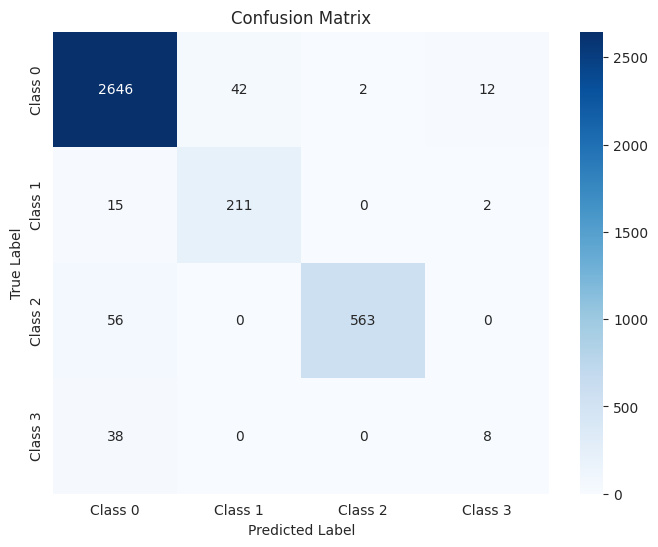

The function took 2.5876 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.98      0.96      3378
     Class 1       0.82      0.93      0.87       285
     Class 2       0.99      0.87      0.93       774
     Class 3       0.32      0.11      0.16        57

    accuracy                           0.95      4494
   macro avg       0.77      0.72      0.73      4494
weighted avg       0.94      0.95      0.94      4494



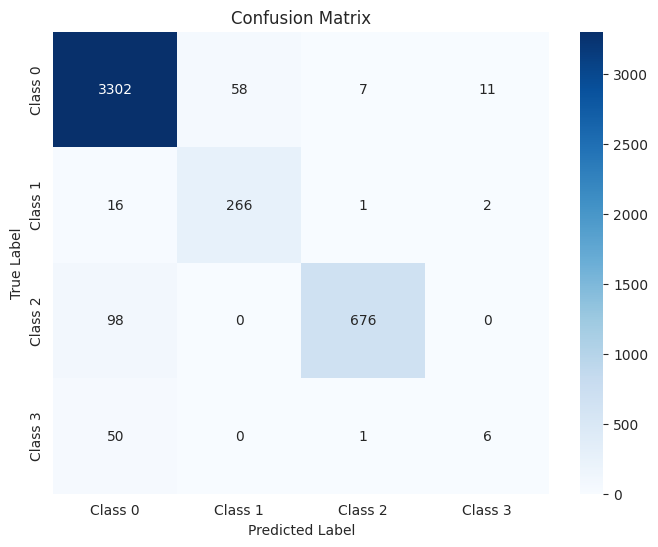

The function took 0.4245 seconds to execute.
[BS=32] done in 49.9s  best-val=0.1861


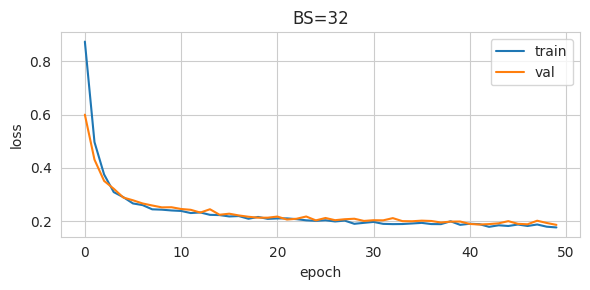


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.95      0.93      0.94      2475
     Class 3       0.35      0.92      0.51       182

    accuracy                           0.94     14379
   macro avg       0.76      0.94      0.82     14379
weighted avg       0.96      0.94      0.95     14379



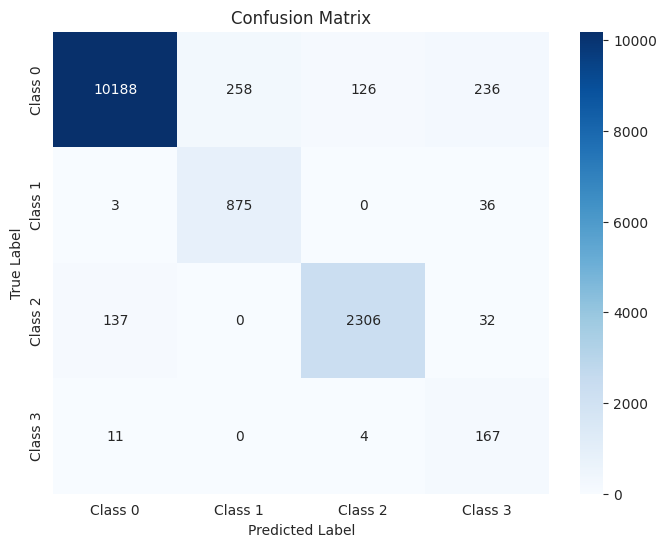

The function took 0.7330 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.93      0.95      0.94       619
     Class 3       0.33      0.91      0.49        46

    accuracy                           0.94      3595
   macro avg       0.76      0.93      0.81      3595
weighted avg       0.96      0.94      0.95      3595



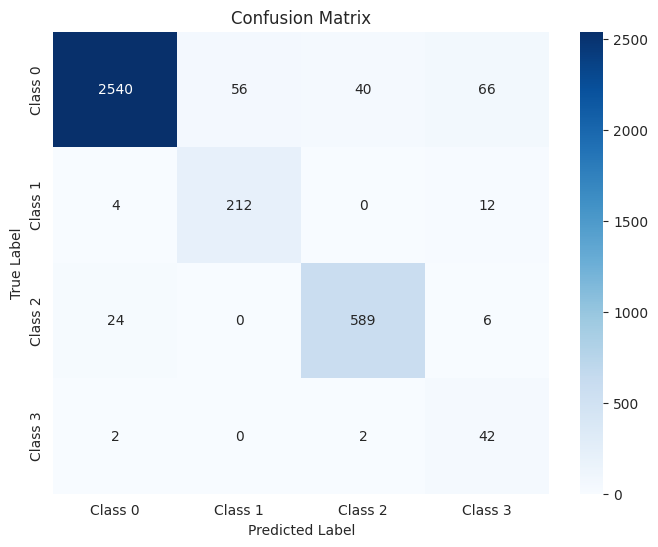

The function took 0.4028 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      3378
     Class 1       0.78      0.94      0.85       285
     Class 2       0.93      0.93      0.93       774
     Class 3       0.35      0.82      0.49        57

    accuracy                           0.94      4494
   macro avg       0.76      0.91      0.81      4494
weighted avg       0.95      0.94      0.94      4494



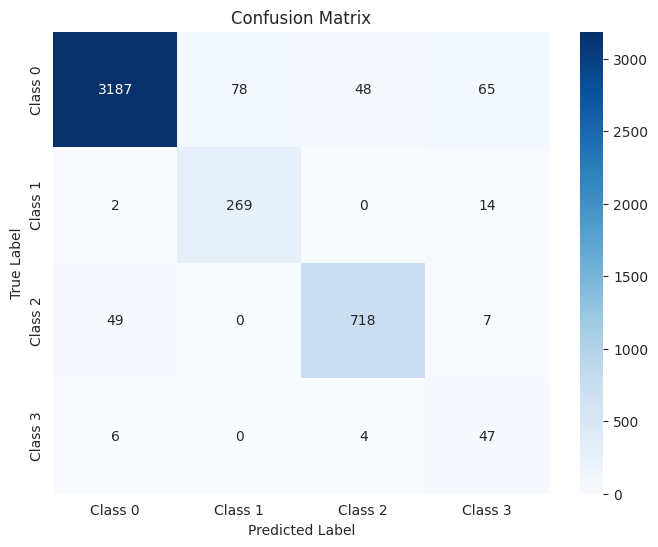

The function took 0.4174 seconds to execute.
[BS=64] done in 29.0s  best-val=0.2073


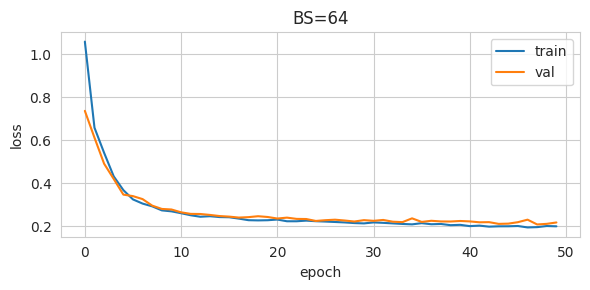


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.80      0.97      0.88      2475
     Class 3       0.31      0.88      0.46       182

    accuracy                           0.91     14379
   macro avg       0.72      0.93      0.78     14379
weighted avg       0.94      0.91      0.92     14379



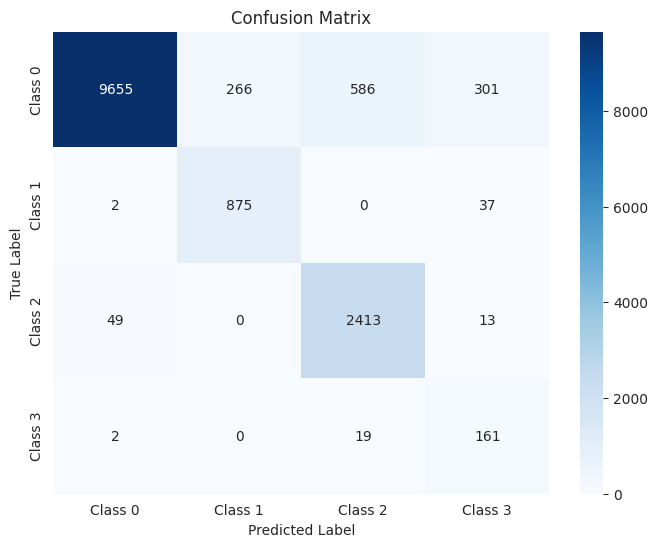

The function took 0.7868 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.80      0.93      0.86       228
     Class 2       0.81      0.97      0.88       619
     Class 3       0.29      0.87      0.43        46

    accuracy                           0.91      3595
   macro avg       0.72      0.92      0.78      3595
weighted avg       0.94      0.91      0.92      3595



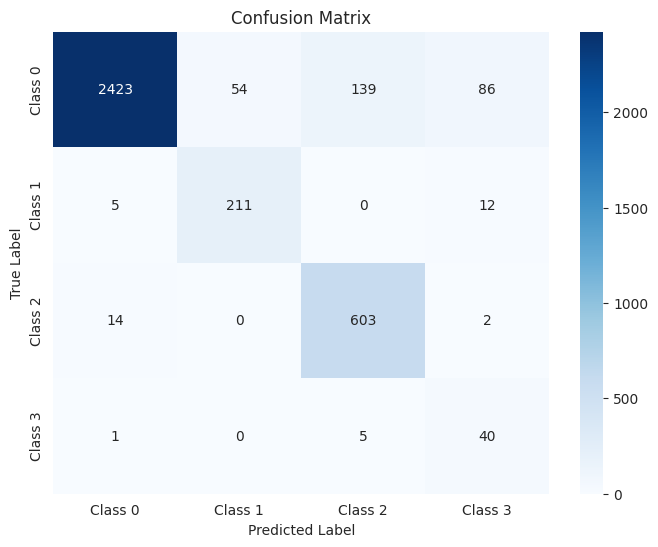

The function took 0.2597 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.79      0.97      0.87       774
     Class 3       0.35      0.88      0.50        57

    accuracy                           0.91      4494
   macro avg       0.73      0.92      0.79      4494
weighted avg       0.94      0.91      0.92      4494



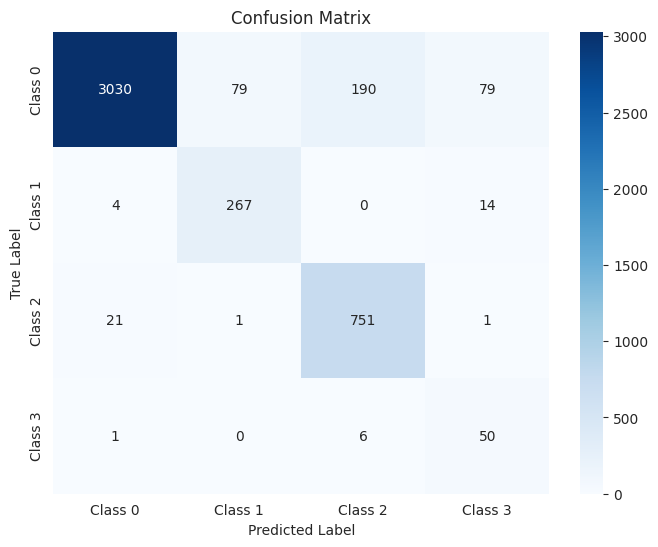

The function took 0.2864 seconds to execute.
[BS=128] done in 17.7s  best-val=0.2082


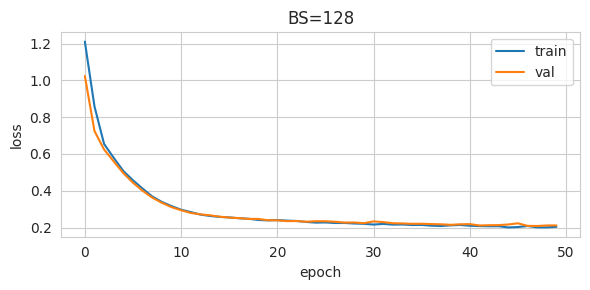


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.82      0.95      0.88      2475
     Class 3       0.32      0.88      0.47       182

    accuracy                           0.91     14379
   macro avg       0.72      0.92      0.78     14379
weighted avg       0.94      0.91      0.92     14379



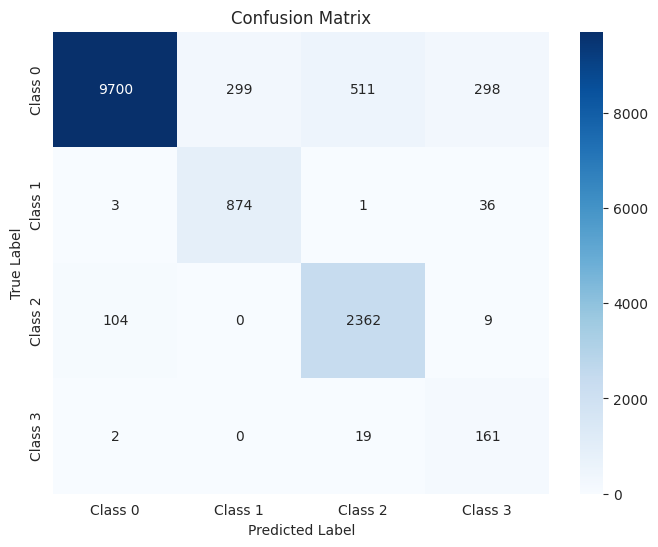

The function took 0.4226 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.76      0.93      0.84       228
     Class 2       0.81      0.97      0.88       619
     Class 3       0.29      0.87      0.43        46

    accuracy                           0.91      3595
   macro avg       0.71      0.92      0.77      3595
weighted avg       0.94      0.91      0.92      3595



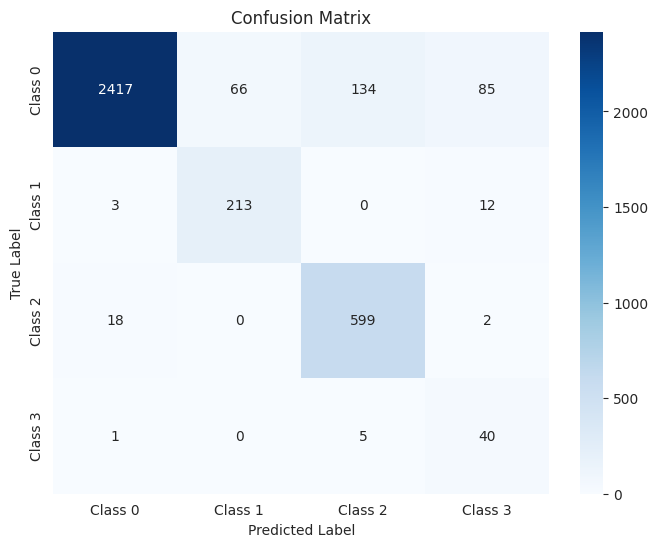

The function took 0.2576 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.82      0.95      0.88       774
     Class 3       0.35      0.86      0.49        57

    accuracy                           0.91      4494
   macro avg       0.72      0.91      0.79      4494
weighted avg       0.93      0.91      0.92      4494



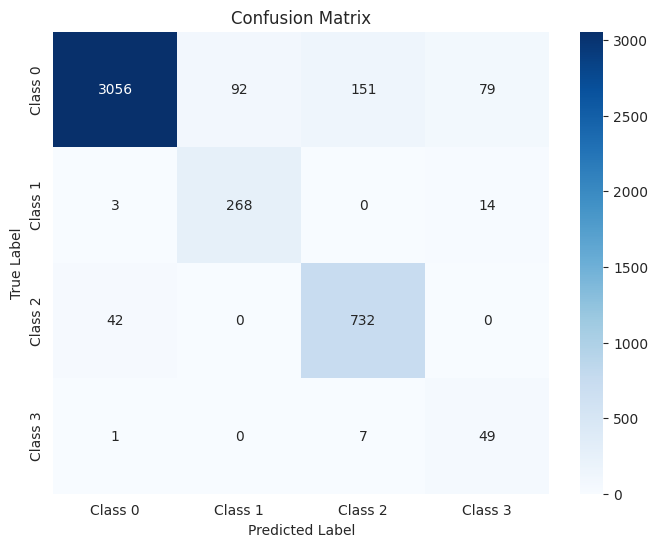

The function took 0.3016 seconds to execute.
[BS=512] done in 10.5s  best-val=0.2402


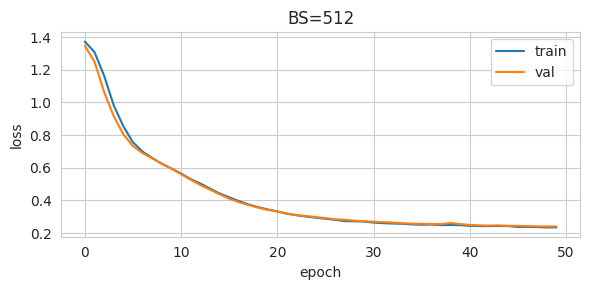


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.85      0.92     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.79      0.92      0.85      2475
     Class 3       0.15      0.93      0.26       182

    accuracy                           0.87     14379
   macro avg       0.67      0.91      0.71     14379
weighted avg       0.93      0.87      0.89     14379



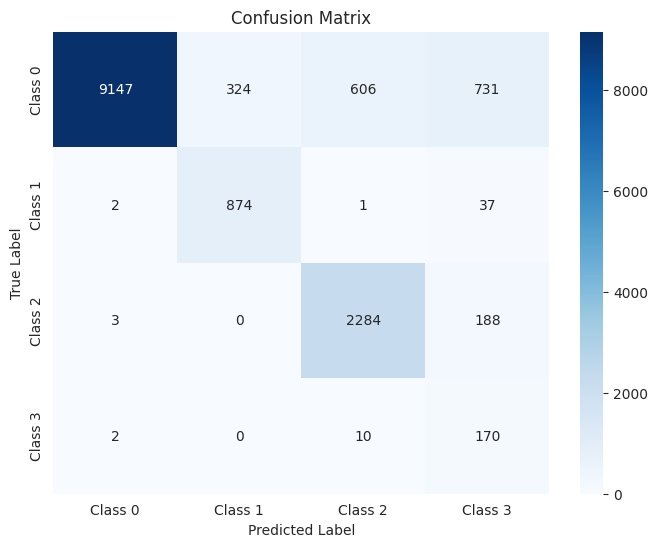

The function took 0.3929 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.85      0.92      2702
     Class 1       0.76      0.93      0.83       228
     Class 2       0.80      0.93      0.86       619
     Class 3       0.15      0.96      0.26        46

    accuracy                           0.87      3595
   macro avg       0.68      0.91      0.72      3595
weighted avg       0.94      0.87      0.89      3595



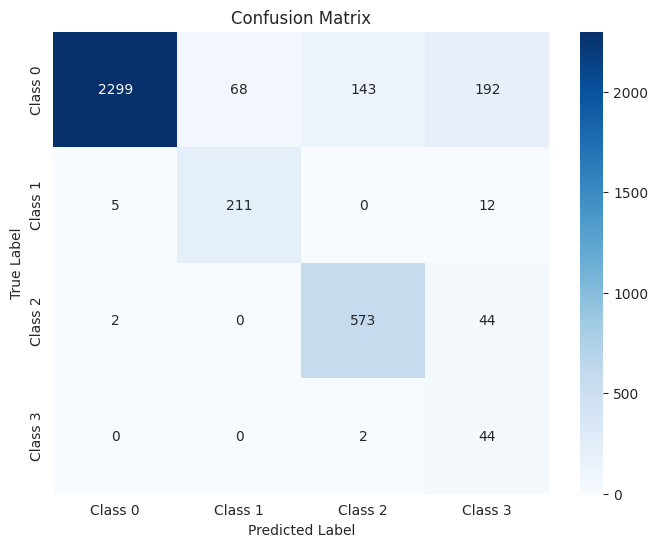

The function took 0.2744 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.85      0.92      3378
     Class 1       0.73      0.93      0.82       285
     Class 2       0.78      0.92      0.84       774
     Class 3       0.15      0.91      0.25        57

    accuracy                           0.87      4494
   macro avg       0.66      0.90      0.71      4494
weighted avg       0.93      0.87      0.89      4494



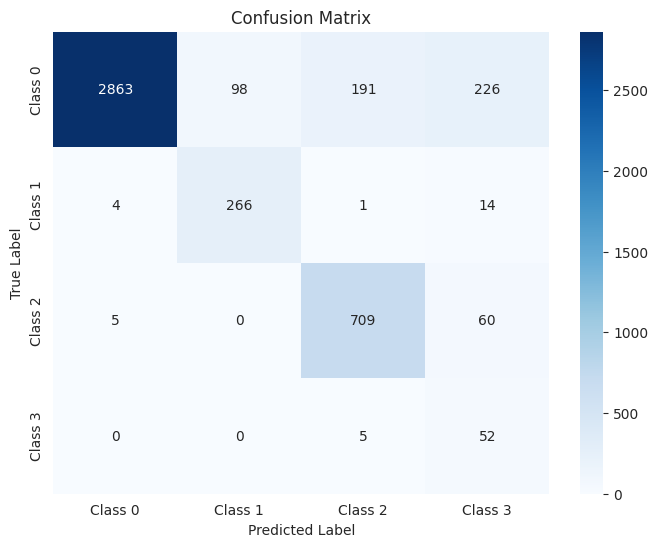

The function took 0.2902 seconds to execute.


,train_acc,val_acc,test_acc
1,"{'accuracy': 95.01356144377216, 'precision': [...","{'accuracy': 95.35465924895689, 'precision': [...","{'accuracy': 94.57053849577214, 'precision': [..."
32,"{'accuracy': 94.13728353849363, 'precision': [...","{'accuracy': 94.1029207232267, 'precision': [0...","{'accuracy': 93.92523364485982, 'precision': [..."
64,"{'accuracy': 91.13290214896725, 'precision': [...","{'accuracy': 91.15438108484005, 'precision': [...","{'accuracy': 91.18825100133512, 'precision': [..."
128,"{'accuracy': 91.08422004311844, 'precision': [...","{'accuracy': 90.93184979137692, 'precision': [...","{'accuracy': 91.3440142412105, 'precision': [0..."
512,"{'accuracy': 86.75846720912442, 'precision': [...","{'accuracy': 86.98191933240612, 'precision': [...","{'accuracy': 86.55985758789497, 'precision': [..."


In [ ]:
class_weights = class_weights.to(DEVICE)
input_dim  = X_train_tensor.shape[1]
n_classes  = len(torch.unique(y_train_tensor))
ref_arch = [input_dim, 32, 32, 32, n_classes]


# ---------------- batch-size sweep ---------------------------------
# Purpose:
#   Evaluate how different mini-batch sizes affect model performance.

batch_grid = [1,32,64,128,512]
bs_scores  = {}

for bs in batch_grid:
    tr_loader = DataLoader(train_dataset,batch_size=bs,shuffle=True)
    vl_loader = DataLoader(val_dataset,  batch_size=bs,shuffle=False)

    net = PlainFFNN(ref_arch)
    opt = optim.AdamW(net.parameters(), lr=5e-4)
    training_loop(net, tr_loader, vl_loader,
                  train_dataset, val_dataset, DEVICE,
                  opt, nn.CrossEntropyLoss(weight=class_weights),
                  max_epochs=50, patience=15,
                  verbose_every=0, cfg_name=f"BS={bs}")

    bs_scores[bs] = {
        'train_acc': testing_model(net, tr_loader, DEVICE),
        'val_acc'  : testing_model(net, vl_loader, DEVICE),
        'test_acc' : testing_model(net, test_loader,DEVICE)
    }

pd.DataFrame(bs_scores).T



### best - activation function

[ACT=linear] done in 48.9s  best-val=0.4296


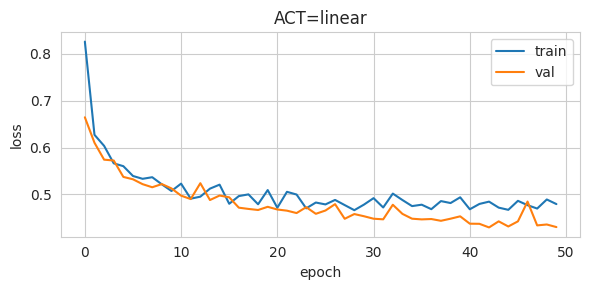


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.79      0.88      3378
     Class 1       0.32      0.89      0.47       285
     Class 2       0.95      0.84      0.89       774
     Class 3       0.16      0.89      0.26        57

    accuracy                           0.81      4494
   macro avg       0.60      0.85      0.63      4494
weighted avg       0.93      0.81      0.85      4494



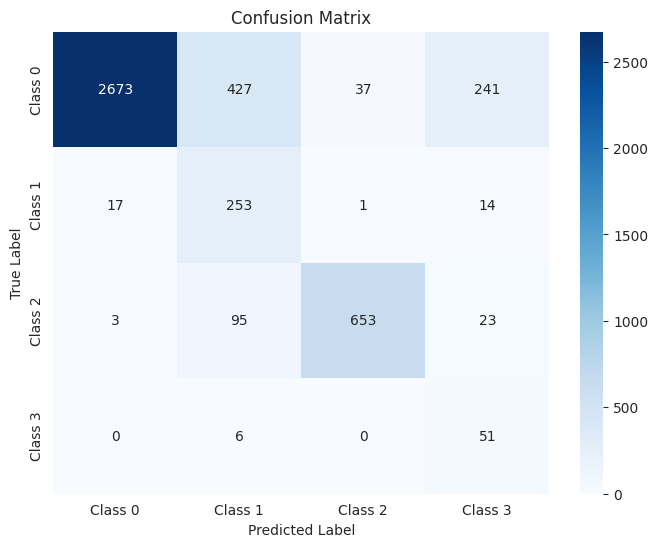

The function took 0.3116 seconds to execute.
[ACT=sigmoid] done in 52.1s  best-val=0.3249


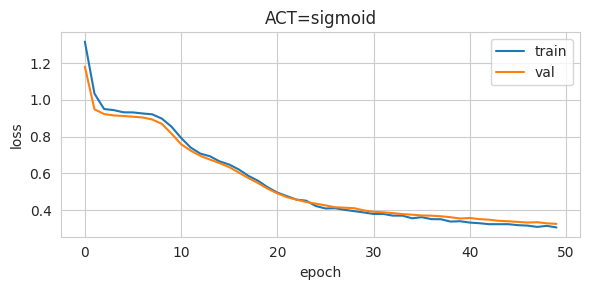


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.91      0.94      3378
     Class 1       0.68      0.88      0.77       285
     Class 2       0.98      0.86      0.91       774
     Class 3       0.20      0.88      0.33        57

    accuracy                           0.90      4494
   macro avg       0.71      0.88      0.74      4494
weighted avg       0.94      0.90      0.91      4494



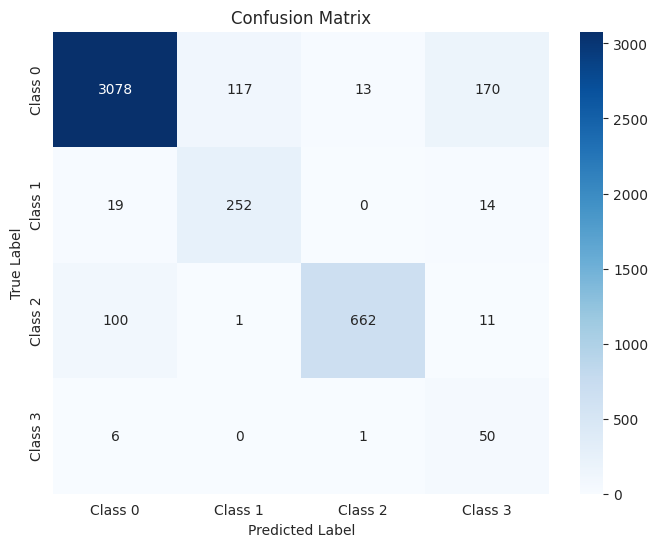

The function took 0.3324 seconds to execute.
[ACT=relu] done in 52.9s  best-val=0.1834


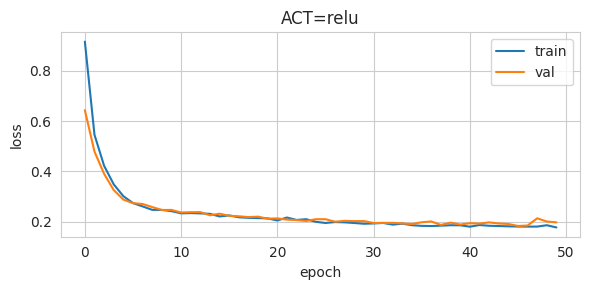


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.95      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.82      0.97      0.89       774
     Class 3       0.36      0.91      0.52        57

    accuracy                           0.92      4494
   macro avg       0.73      0.93      0.80      4494
weighted avg       0.94      0.92      0.92      4494



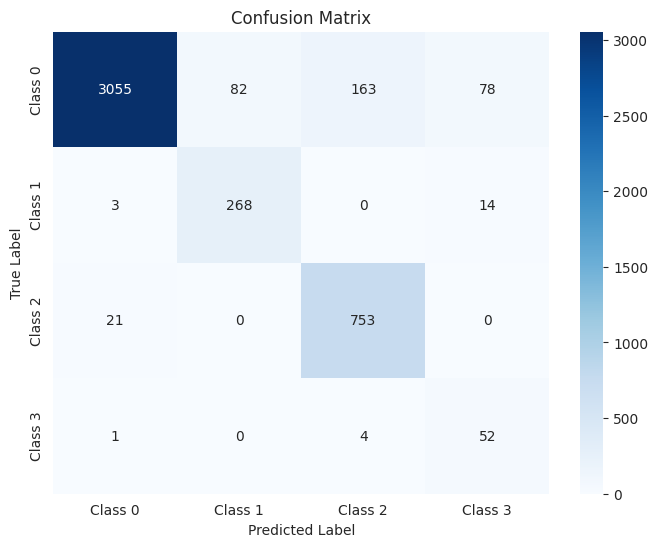

The function took 0.3141 seconds to execute.


,0
linear,"{'accuracy': 80.77436582109479, 'precision': [..."
sigmoid,"{'accuracy': 89.942145082332, 'precision': [0...."
relu,"{'accuracy': 91.85580774365822, 'precision': [..."


In [ ]:
# ---------------- activation sweep ---------------------------------
# Purpose:
#   Compare how different activation functions (Identity = “linear”,
#   Sigmoid, ReLU) influence performance while keeping architecture,
#   optimiser, loss, and batch size fixed (decided by the values obtained before).




BEST_BS = 32

train_loader = DataLoader(train_dataset, batch_size=BEST_BS, shuffle=True)
val_loader   = DataLoader(val_dataset,   batch_size=BEST_BS, shuffle=False)
test_loader  = DataLoader(test_dataset,  batch_size=BEST_BS, shuffle=False)

acts = {
    'linear' : nn.Identity(),
    'sigmoid': nn.Sigmoid(),
    'relu'   : nn.ReLU()
}

act_scores = {}

class ActNet(nn.Module):
    """
    Generic FFNN: the Linear layers are stored in self.layers,
    and the activation function can be selected on the fly via the `act` parameter.

    """
    def __init__(self, sizes, act):
        super().__init__()
        self.act = act

        self.layers = nn.ModuleList(
            [nn.Linear(sizes[i], sizes[i + 1]) for i in range(len(sizes) - 1)]
        )

    def forward(self, x):

        for layer in self.layers[:-1]:
            x = self.act(layer(x))
        return self.layers[-1](x)


criterion = nn.CrossEntropyLoss(weight=class_weights.to(DEVICE))

for name, act in acts.items():
    net = ActNet(ref_arch, act).to(DEVICE)
    opt = optim.AdamW(net.parameters(), lr=5e-4)

    training_loop(net, train_loader, val_loader,
                  train_dataset, val_dataset, DEVICE,
                  opt, criterion,
                  max_epochs=50, patience=15,
                  verbose_every=0, cfg_name=f"ACT={name}")

    act_scores[name] = testing_model(net, test_loader, DEVICE)


(pd.Series({k: v for k, v in act_scores.items()}))


### best - optimizer

[OPT=sgd,m=None] done in 45.8s  best-val=0.2092


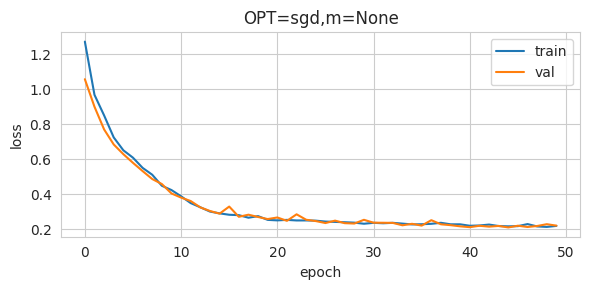


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.93      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.83      0.94      0.88       774
     Class 3       0.25      0.88      0.39        57

    accuracy                           0.90      4494
   macro avg       0.70      0.91      0.76      4494
weighted avg       0.93      0.90      0.91      4494



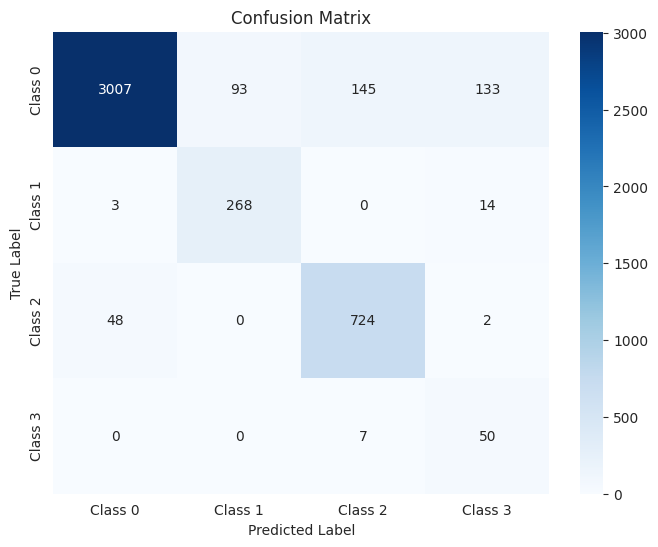

The function took 0.3073 seconds to execute.
[OPT=mom,m=0.1] done in 47.7s  best-val=0.2165


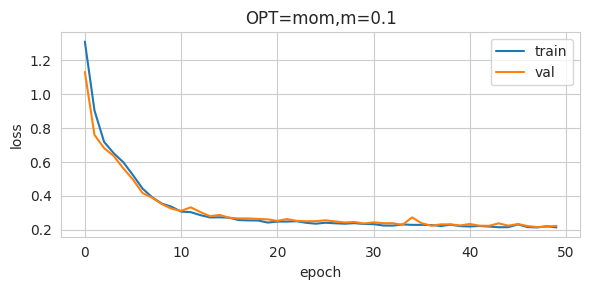


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      3378
     Class 1       0.75      0.94      0.83       285
     Class 2       0.75      0.96      0.84       774
     Class 3       0.36      0.89      0.51        57

    accuracy                           0.90      4494
   macro avg       0.71      0.92      0.78      4494
weighted avg       0.92      0.90      0.90      4494



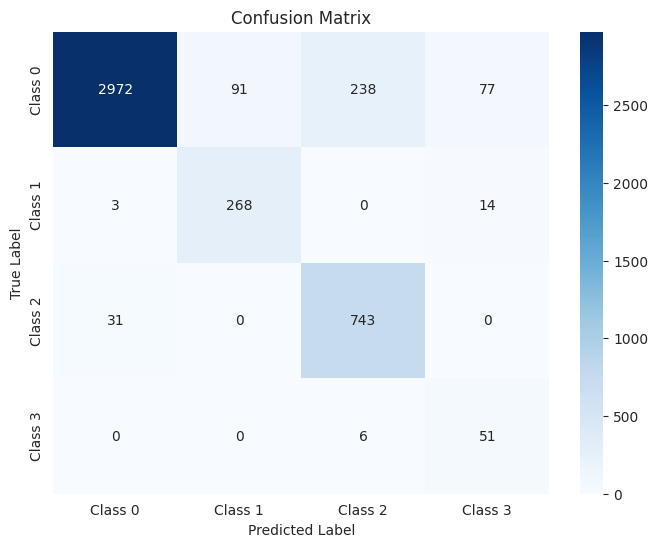

The function took 0.3161 seconds to execute.
[OPT=mom,m=0.5] done in 47.2s  best-val=0.2058


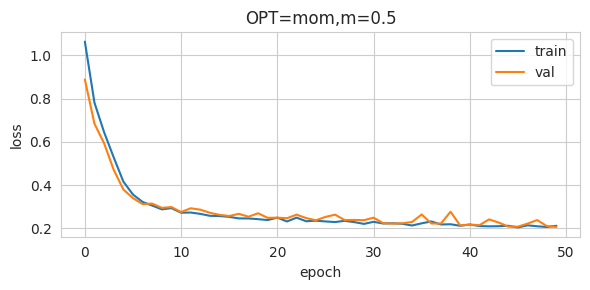


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.96      3378
     Class 1       0.78      0.94      0.85       285
     Class 2       0.94      0.91      0.93       774
     Class 3       0.37      0.86      0.52        57

    accuracy                           0.94      4494
   macro avg       0.77      0.91      0.81      4494
weighted avg       0.95      0.94      0.94      4494



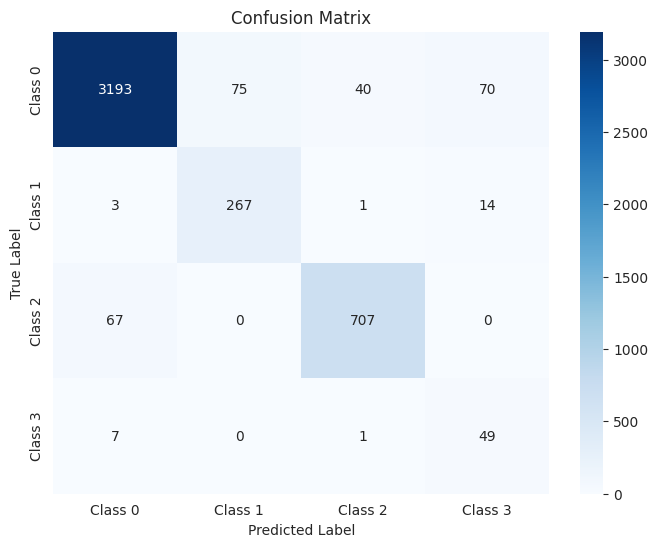

The function took 0.4729 seconds to execute.
[OPT=mom,m=0.9] done in 47.4s  best-val=0.1827


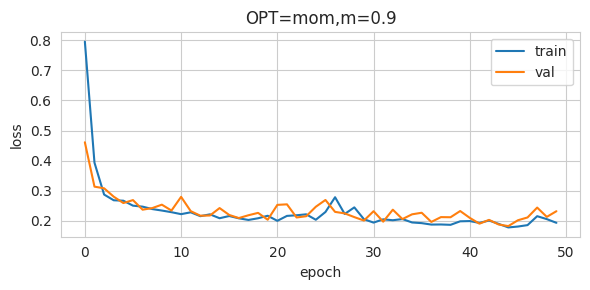


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      3378
     Class 1       0.79      0.94      0.86       285
     Class 2       0.90      0.94      0.92       774
     Class 3       0.38      0.88      0.53        57

    accuracy                           0.94      4494
   macro avg       0.76      0.92      0.82      4494
weighted avg       0.95      0.94      0.94      4494



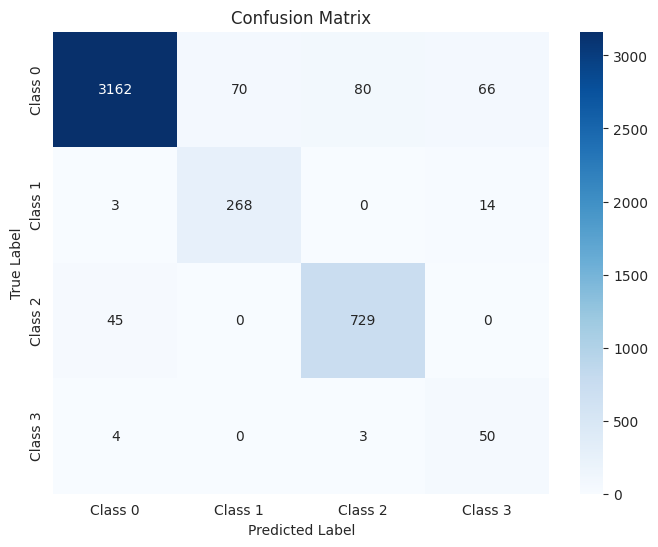

The function took 0.3281 seconds to execute.
[OPT=adamw,m=None] done in 53.1s  best-val=0.1795


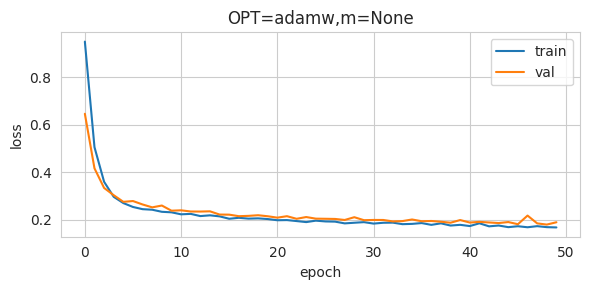


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.93      0.92      0.92       774
     Class 3       0.31      0.89      0.46        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.80      4494
weighted avg       0.95      0.93      0.94      4494



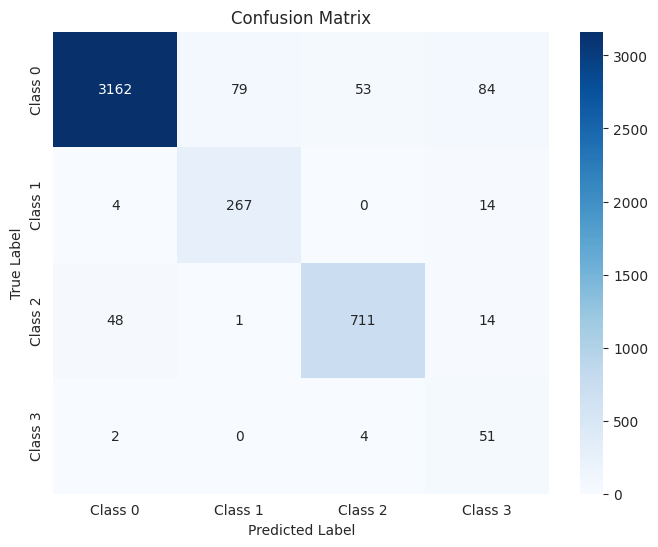

The function took 0.3430 seconds to execute.


sgd    NaN    {'accuracy': 90.09790832220739, 'precision': [...
mom    0.1    {'accuracy': 89.76412995104583, 'precision': [...
       0.5    {'accuracy': 93.81397418780595, 'precision': [...
       0.9    {'accuracy': 93.65821094793057, 'precision': [...
adamw  NaN    {'accuracy': 93.25767690253672, 'precision': [...
dtype: object

In [ ]:
# ----------------  optimiser sweep ----------------------------------
BEST_BS = 32


train_loader = DataLoader(train_dataset, batch_size=BEST_BS, shuffle=True)
val_loader   = DataLoader(val_dataset,   batch_size=BEST_BS, shuffle=False)
test_loader  = DataLoader(test_dataset,  batch_size=BEST_BS, shuffle=False)


def mk_opt(tag, net, lr, mom=None):
    if tag == 'sgd'  : return optim.SGD(net.parameters(), lr=lr)
    if tag == 'mom'  : return optim.SGD(net.parameters(), lr=lr, momentum=mom)
    if tag == 'adamw': return optim.AdamW(net.parameters(), lr=lr)


opt_cfgs = [
    ('sgd',   1e-2,  None),
    ('mom',   1e-2,  0.1),
    ('mom',   1e-2,  0.5),
    ('mom',   1e-2,  0.9),
    ('adamw', 5e-4,  None)
]


act_scores = {}
for tag, lr, m in opt_cfgs:
    net = ActNet(ref_arch, nn.ReLU()).to(DEVICE)
    opt = mk_opt(tag, net, lr, m)

    training_loop(net, train_loader, val_loader,
                  train_dataset, val_dataset, DEVICE,
                  opt, nn.CrossEntropyLoss(weight=class_weights.to(DEVICE)),
                  max_epochs=50, patience=15,
                  verbose_every=0, cfg_name=f"OPT={tag},m={m}")

    act_scores[(tag, m)] = testing_model(net, test_loader, DEVICE)

pd.Series(act_scores)


# Task 5: Overfitting and regularization

[plain  wd=0e+00] ep 010  tr=0.2463  val=0.2872
[plain  wd=0e+00] ep 020  tr=0.2223  val=0.2236
[plain  wd=0e+00] ep 030  tr=0.2030  val=0.2171
[plain  wd=0e+00] ep 040  tr=0.1970  val=0.2095
[plain  wd=0e+00] ep 050  tr=0.1865  val=0.1961
[plain  wd=0e+00] done in 21.0s  best-val=0.1961


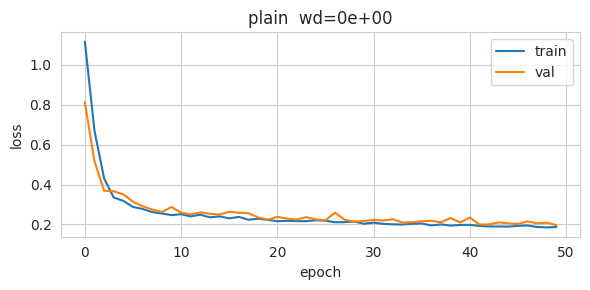


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.96     10808
     Class 1       0.78      0.96      0.86       914
     Class 2       0.86      0.96      0.91      2475
     Class 3       0.40      0.88      0.55       182

    accuracy                           0.93     14379
   macro avg       0.76      0.93      0.82     14379
weighted avg       0.95      0.93      0.94     14379



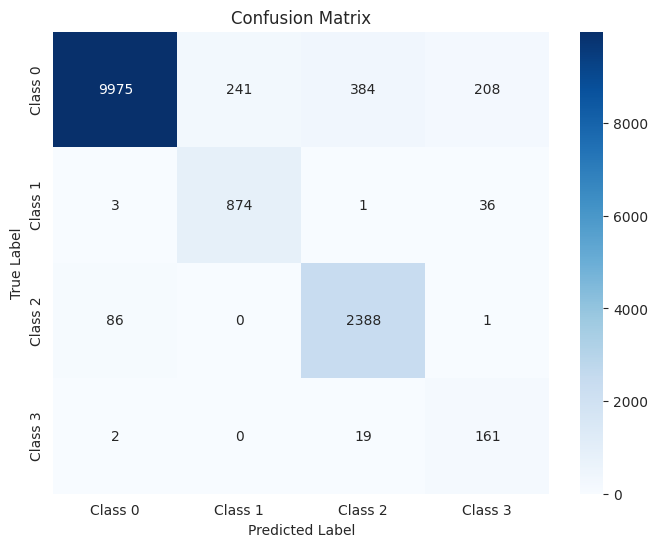

The function took 0.4246 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.81      0.93      0.86       228
     Class 2       0.86      0.97      0.91       619
     Class 3       0.37      0.89      0.53        46

    accuracy                           0.93      3595
   macro avg       0.76      0.93      0.81      3595
weighted avg       0.95      0.93      0.94      3595



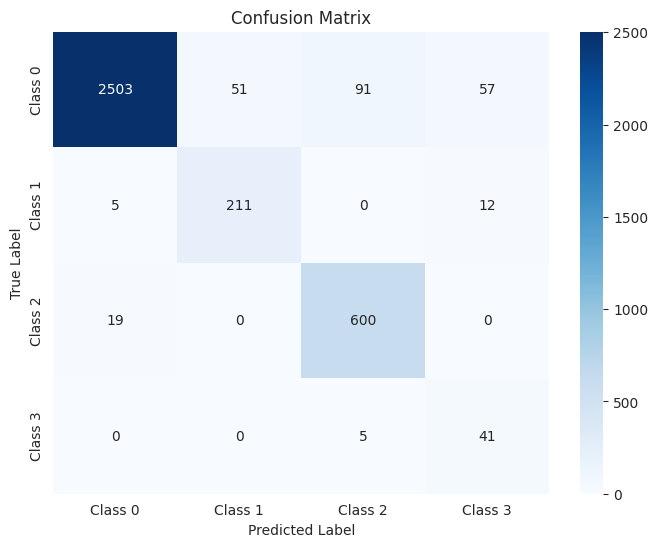

The function took 0.2571 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.96      3378
     Class 1       0.78      0.93      0.85       285
     Class 2       0.85      0.96      0.90       774
     Class 3       0.39      0.84      0.54        57

    accuracy                           0.93      4494
   macro avg       0.75      0.92      0.81      4494
weighted avg       0.94      0.93      0.93      4494



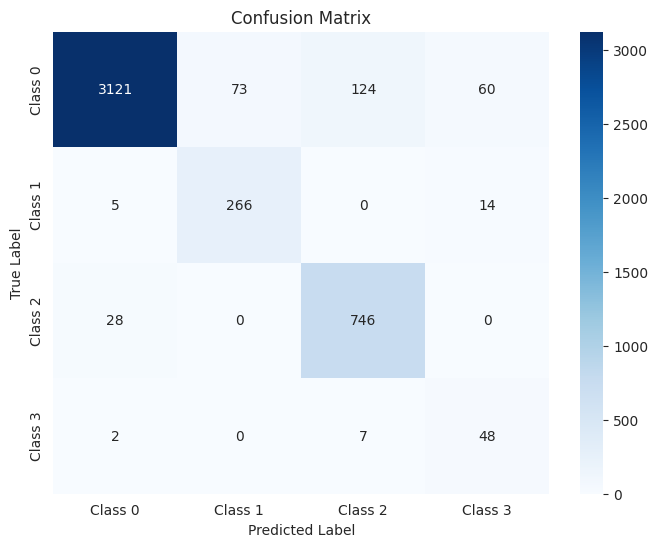

The function took 0.2561 seconds to execute.
[plain  wd=1e-04] ep 010  tr=0.2533  val=0.2698
[plain  wd=1e-04] ep 020  tr=0.2123  val=0.2155
[plain  wd=1e-04] ep 030  tr=0.2019  val=0.2126
[plain  wd=1e-04] ep 040  tr=0.1998  val=0.2048
[plain  wd=1e-04] ep 050  tr=0.1905  val=0.2041
[plain  wd=1e-04] done in 20.4s  best-val=0.1973


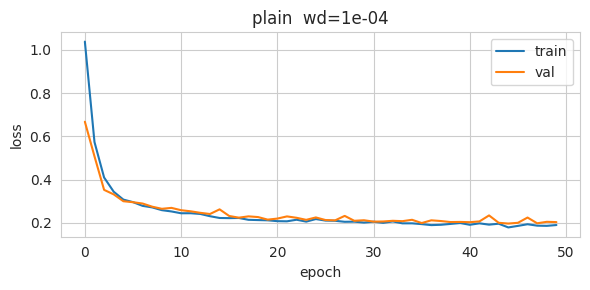


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.77      0.96      0.86       914
     Class 2       0.86      0.91      0.88      2475
     Class 3       0.28      0.96      0.43       182

    accuracy                           0.92     14379
   macro avg       0.72      0.93      0.78     14379
weighted avg       0.94      0.92      0.92     14379



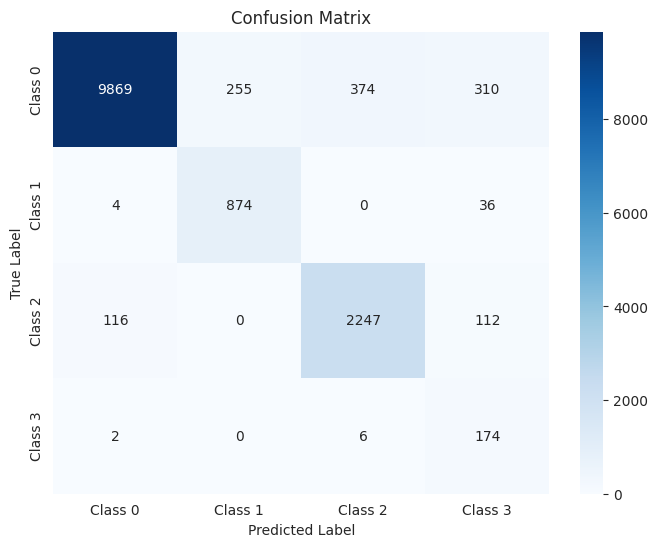

The function took 0.6328 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.79      0.93      0.86       228
     Class 2       0.86      0.91      0.88       619
     Class 3       0.25      0.98      0.39        46

    accuracy                           0.91      3595
   macro avg       0.72      0.93      0.77      3595
weighted avg       0.95      0.91      0.93      3595



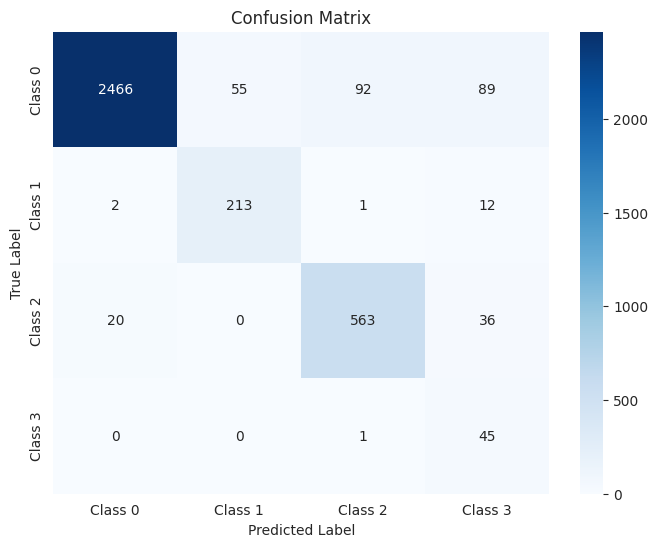

The function took 0.3776 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.77      0.94      0.85       285
     Class 2       0.85      0.89      0.87       774
     Class 3       0.26      0.91      0.41        57

    accuracy                           0.91      4494
   macro avg       0.72      0.91      0.77      4494
weighted avg       0.94      0.91      0.92      4494



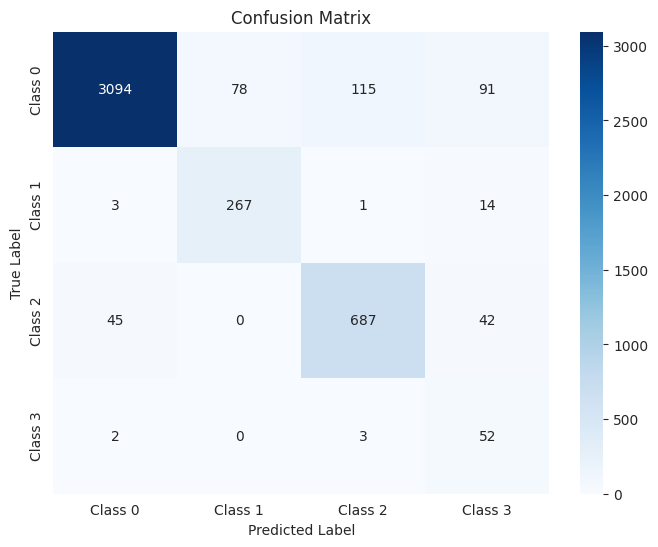

The function took 0.3903 seconds to execute.
[plain  wd=1e-03] ep 010  tr=0.2531  val=0.2488
[plain  wd=1e-03] ep 020  tr=0.2251  val=0.2401
[plain  wd=1e-03] ep 030  tr=0.2084  val=0.2294
[plain  wd=1e-03] ep 040  tr=0.2109  val=0.2266
[plain  wd=1e-03] ep 050  tr=0.1877  val=0.2031
[plain  wd=1e-03] done in 20.8s  best-val=0.1945


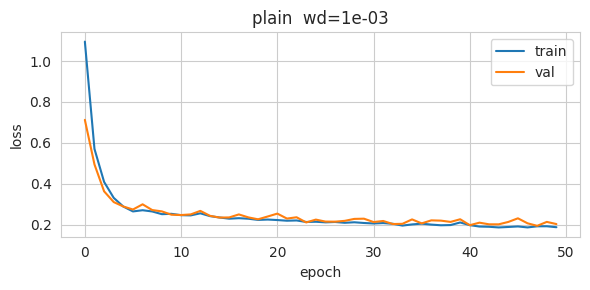


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.81      0.95      0.87      2475
     Class 3       0.29      0.95      0.44       182

    accuracy                           0.91     14379
   macro avg       0.72      0.94      0.78     14379
weighted avg       0.94      0.91      0.92     14379



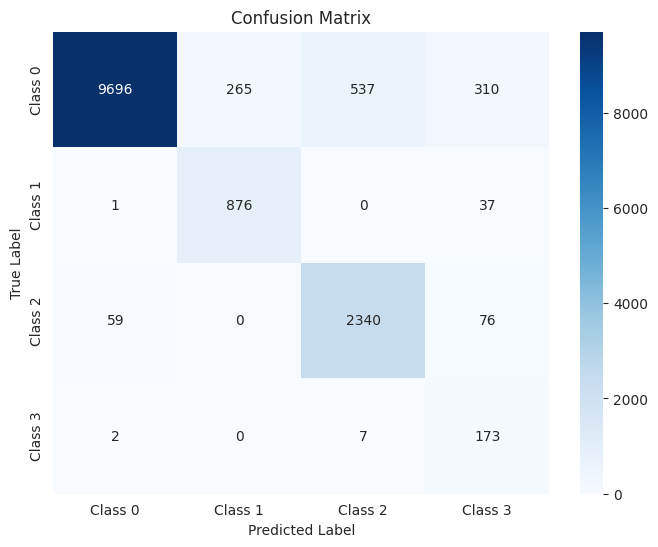

The function took 0.4275 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.82      0.95      0.88       619
     Class 3       0.29      0.96      0.44        46

    accuracy                           0.91      3595
   macro avg       0.72      0.93      0.78      3595
weighted avg       0.94      0.91      0.92      3595



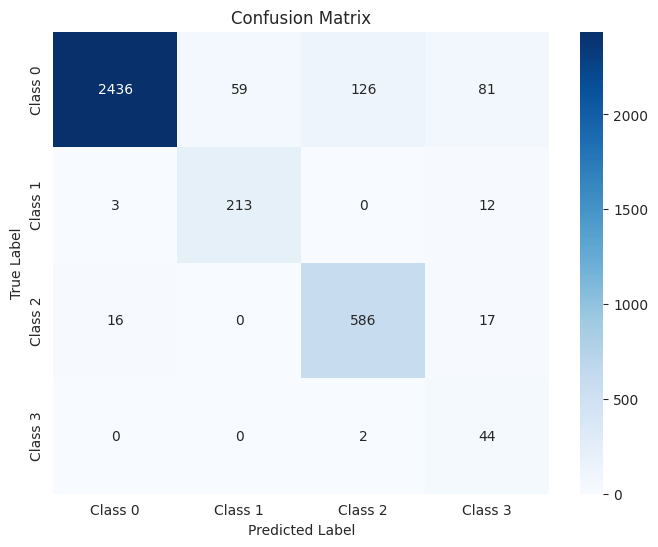

The function took 0.2706 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.80      0.95      0.87       774
     Class 3       0.30      0.89      0.45        57

    accuracy                           0.91      4494
   macro avg       0.71      0.92      0.77      4494
weighted avg       0.94      0.91      0.92      4494



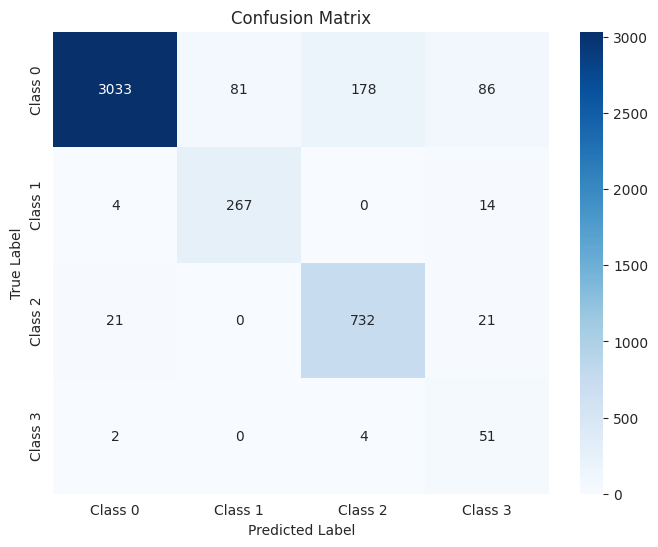

The function took 0.2723 seconds to execute.
[plain  wd=1e-02] ep 010  tr=0.2456  val=0.2448
[plain  wd=1e-02] ep 020  tr=0.2160  val=0.2283
[plain  wd=1e-02] ep 030  tr=0.2004  val=0.2107
[plain  wd=1e-02] ep 040  tr=0.1932  val=0.2003
[plain  wd=1e-02] ep 050  tr=0.1775  val=0.2018
[plain  wd=1e-02] done in 21.0s  best-val=0.1927


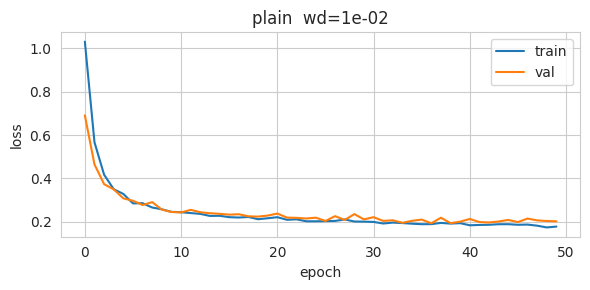


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.86      0.98      0.91      2475
     Class 3       0.30      0.90      0.45       182

    accuracy                           0.92     14379
   macro avg       0.73      0.94      0.79     14379
weighted avg       0.95      0.92      0.93     14379



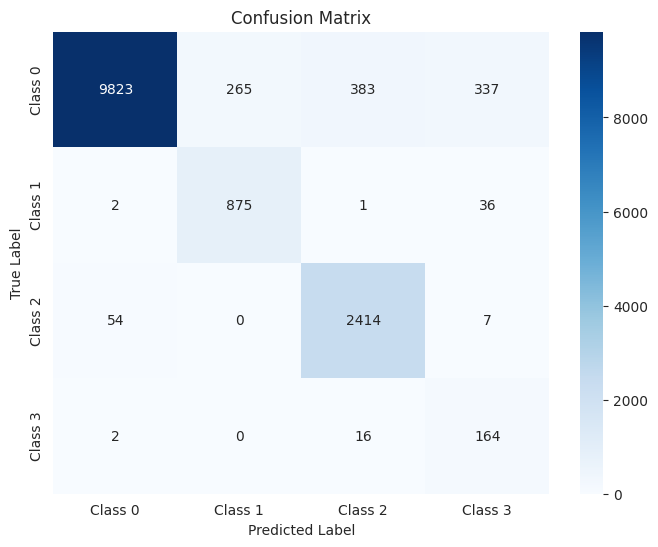

The function took 0.4562 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.85      0.97      0.91       619
     Class 3       0.31      0.93      0.46        46

    accuracy                           0.92      3595
   macro avg       0.73      0.94      0.79      3595
weighted avg       0.95      0.92      0.93      3595



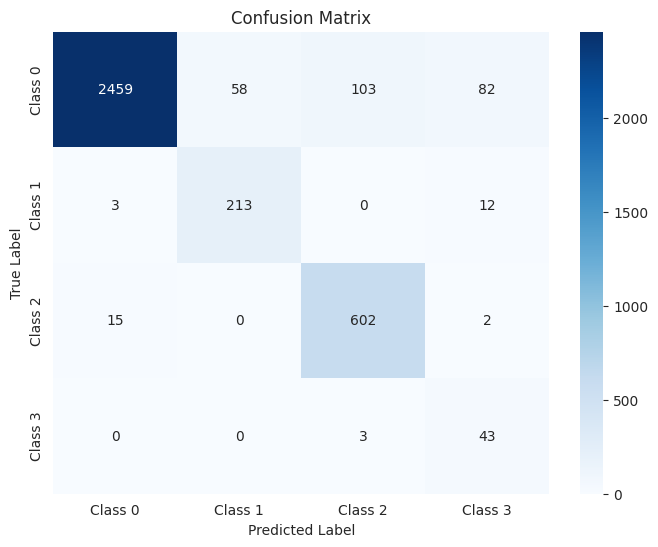

The function took 0.2393 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      3378
     Class 1       0.77      0.94      0.85       285
     Class 2       0.85      0.97      0.90       774
     Class 3       0.33      0.91      0.49        57

    accuracy                           0.92      4494
   macro avg       0.73      0.93      0.80      4494
weighted avg       0.94      0.92      0.93      4494



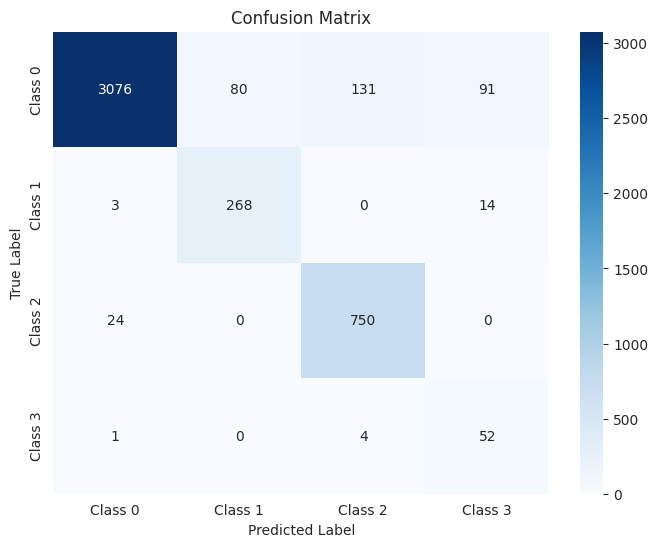

The function took 0.2639 seconds to execute.
[drop  wd=0e+00] ep 010  tr=0.3065  val=0.2759
[drop  wd=0e+00] ep 020  tr=0.2585  val=0.2435
[drop  wd=0e+00] ep 030  tr=0.2519  val=0.2202
[drop  wd=0e+00] ep 040  tr=0.2261  val=0.2385
[drop  wd=0e+00] ep 050  tr=0.2284  val=0.2168
[drop  wd=0e+00] done in 22.1s  best-val=0.2136


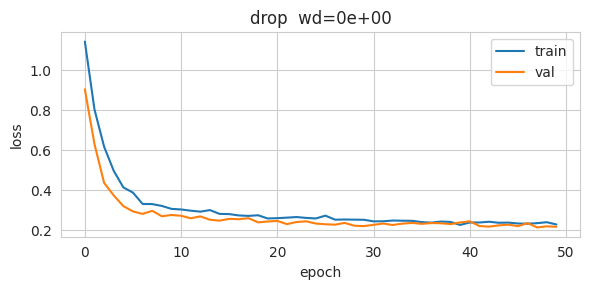


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.76      0.97      0.86      2475
     Class 3       0.33      0.88      0.48       182

    accuracy                           0.90     14379
   macro avg       0.71      0.92      0.78     14379
weighted avg       0.93      0.90      0.91     14379



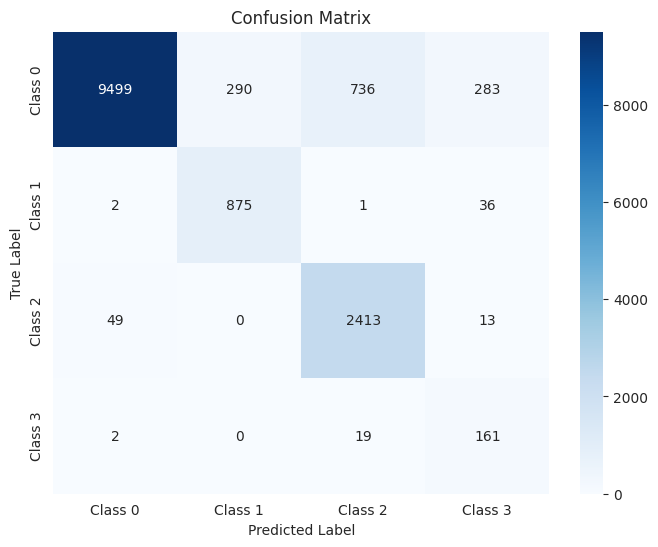

The function took 0.6577 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      2702
     Class 1       0.77      0.93      0.84       228
     Class 2       0.78      0.97      0.87       619
     Class 3       0.29      0.89      0.43        46

    accuracy                           0.90      3595
   macro avg       0.71      0.92      0.77      3595
weighted avg       0.93      0.90      0.91      3595



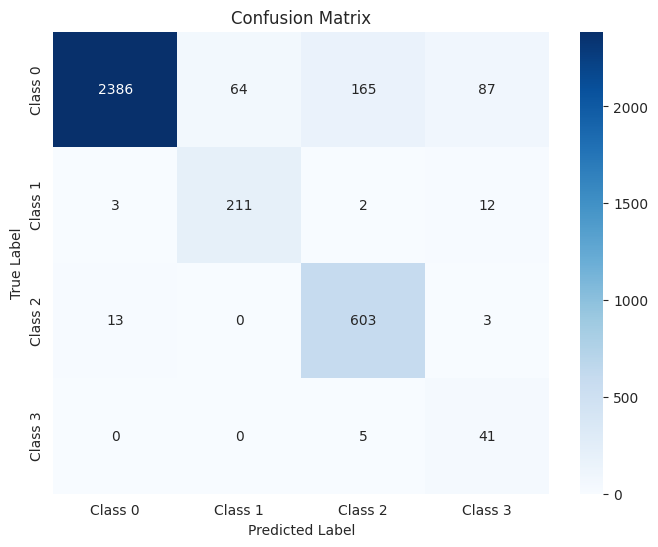

The function took 0.3734 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      3378
     Class 1       0.75      0.94      0.83       285
     Class 2       0.76      0.97      0.85       774
     Class 3       0.35      0.86      0.50        57

    accuracy                           0.90      4494
   macro avg       0.71      0.91      0.78      4494
weighted avg       0.93      0.90      0.91      4494



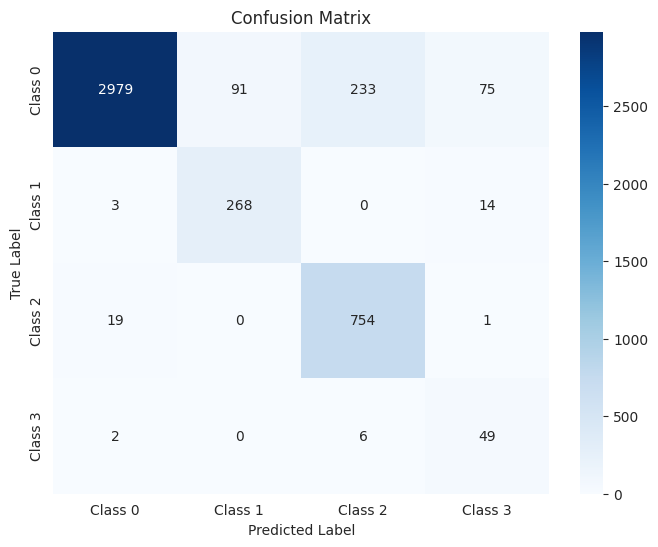

The function took 0.4065 seconds to execute.
[drop  wd=1e-04] ep 010  tr=0.3135  val=0.2647
[drop  wd=1e-04] ep 020  tr=0.2591  val=0.2444
[drop  wd=1e-04] ep 030  tr=0.2624  val=0.2272
[drop  wd=1e-04] ep 040  tr=0.2306  val=0.2248
[drop  wd=1e-04] ep 050  tr=0.2316  val=0.2126
[drop  wd=1e-04] done in 22.0s  best-val=0.2108


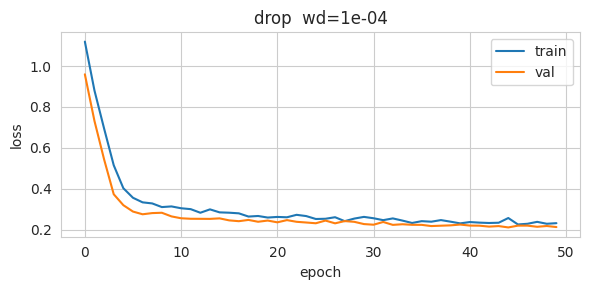


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.76      0.96      0.84       914
     Class 2       0.82      0.90      0.86      2475
     Class 3       0.21      0.98      0.35       182

    accuracy                           0.90     14379
   macro avg       0.70      0.93      0.75     14379
weighted avg       0.94      0.90      0.91     14379



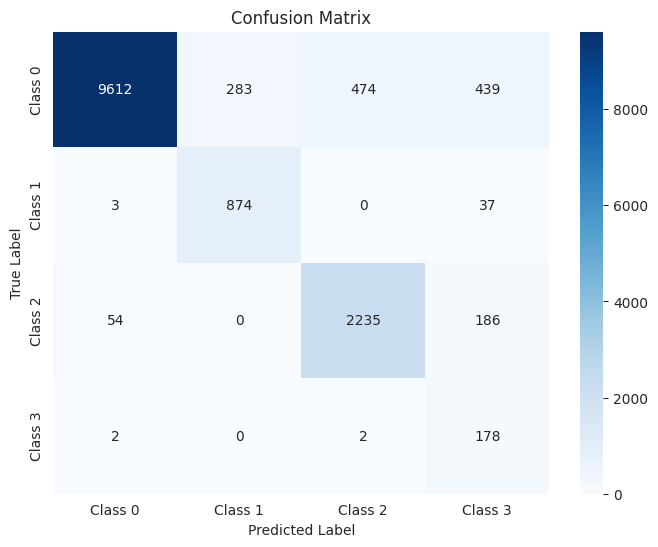

The function took 0.4413 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.84      0.90      0.87       619
     Class 3       0.20      1.00      0.33        46

    accuracy                           0.90      3595
   macro avg       0.70      0.93      0.75      3595
weighted avg       0.94      0.90      0.92      3595



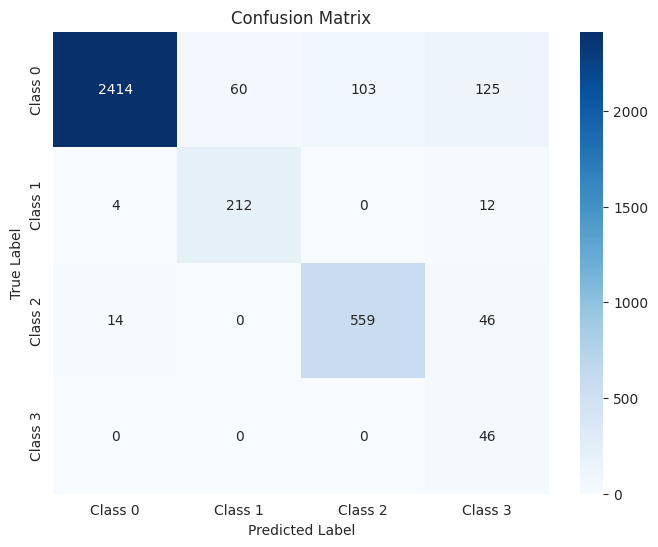

The function took 0.2461 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.76      0.93      0.84       285
     Class 2       0.80      0.89      0.84       774
     Class 3       0.22      0.96      0.36        57

    accuracy                           0.89      4494
   macro avg       0.69      0.92      0.74      4494
weighted avg       0.93      0.89      0.91      4494



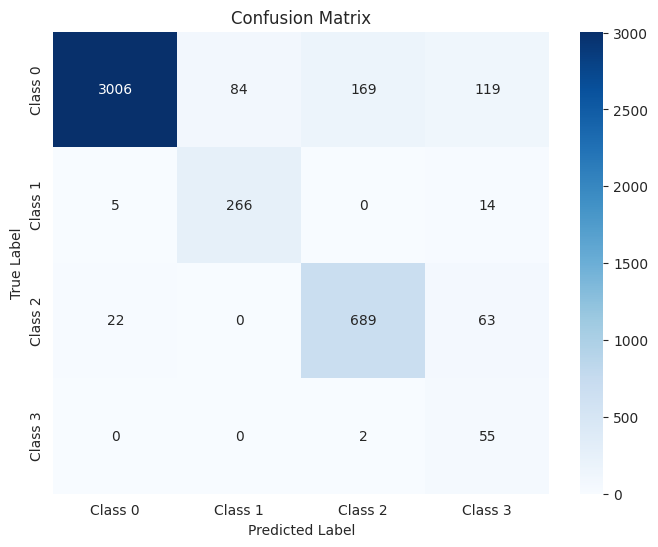

The function took 0.2677 seconds to execute.
[drop  wd=1e-03] ep 010  tr=0.3223  val=0.2635
[drop  wd=1e-03] ep 020  tr=0.2641  val=0.2470
[drop  wd=1e-03] ep 030  tr=0.2645  val=0.2226
[drop  wd=1e-03] ep 040  tr=0.2368  val=0.2172
[drop  wd=1e-03] ep 050  tr=0.2246  val=0.2077
[drop  wd=1e-03] done in 22.6s  best-val=0.2077


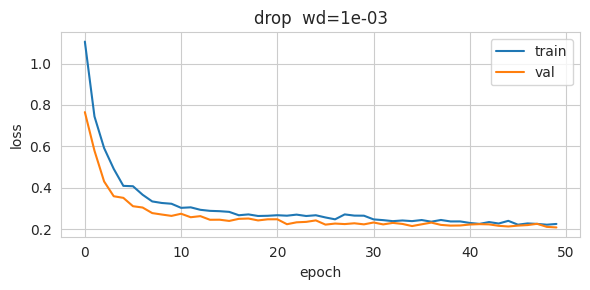


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.80      0.92      0.85      2475
     Class 3       0.24      0.94      0.39       182

    accuracy                           0.90     14379
   macro avg       0.70      0.93      0.76     14379
weighted avg       0.94      0.90      0.91     14379



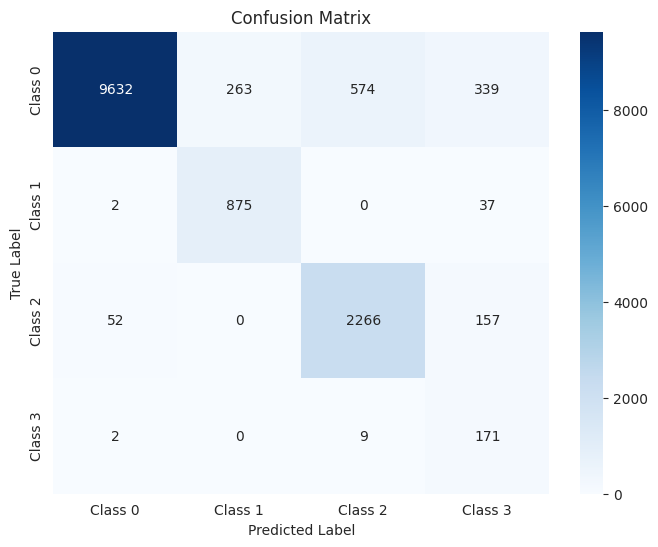

The function took 0.4280 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.79      0.93      0.86       228
     Class 2       0.80      0.91      0.85       619
     Class 3       0.22      0.93      0.36        46

    accuracy                           0.90      3595
   macro avg       0.70      0.92      0.75      3595
weighted avg       0.94      0.90      0.91      3595



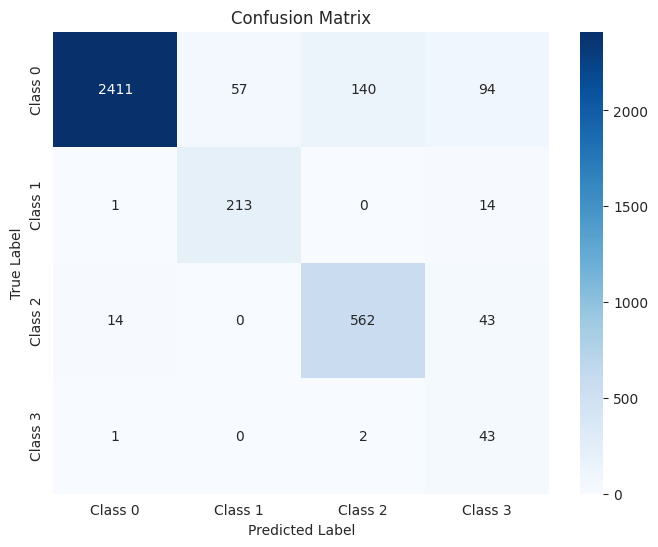

The function took 0.2751 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.77      0.94      0.85       285
     Class 2       0.78      0.91      0.84       774
     Class 3       0.24      0.89      0.38        57

    accuracy                           0.90      4494
   macro avg       0.70      0.91      0.75      4494
weighted avg       0.93      0.90      0.91      4494



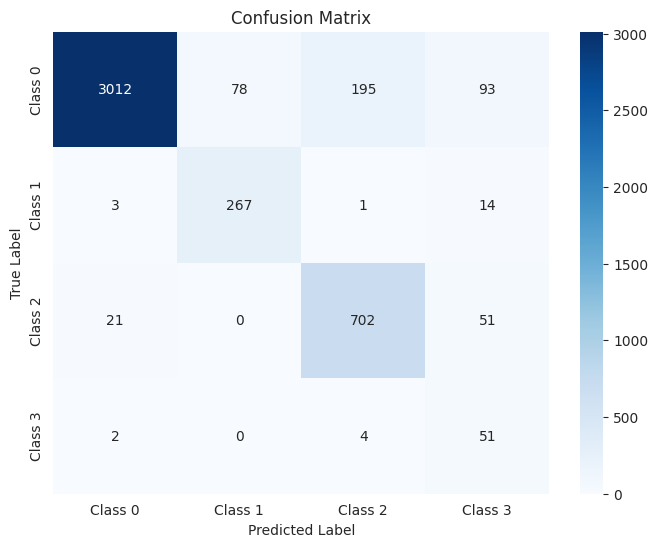

The function took 0.2869 seconds to execute.
[drop  wd=1e-02] ep 010  tr=0.3190  val=0.2552
[drop  wd=1e-02] ep 020  tr=0.2725  val=0.2290
[drop  wd=1e-02] ep 030  tr=0.2595  val=0.2249
[drop  wd=1e-02] ep 040  tr=0.2365  val=0.2327
[drop  wd=1e-02] ep 050  tr=0.2336  val=0.2298
[drop  wd=1e-02] done in 22.6s  best-val=0.2139


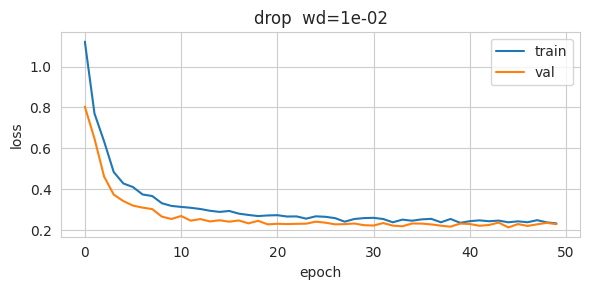


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.74      0.96      0.84       914
     Class 2       0.83      0.95      0.89      2475
     Class 3       0.37      0.88      0.52       182

    accuracy                           0.92     14379
   macro avg       0.73      0.92      0.80     14379
weighted avg       0.94      0.92      0.92     14379



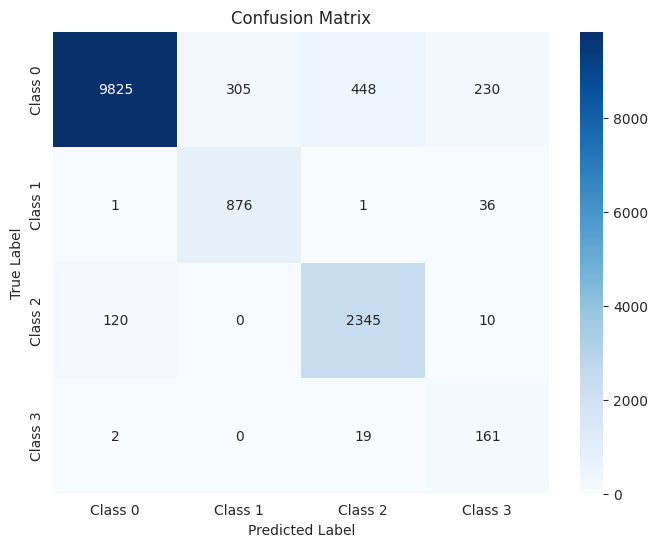

The function took 0.4197 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.76      0.93      0.84       228
     Class 2       0.82      0.96      0.89       619
     Class 3       0.35      0.89      0.50        46

    accuracy                           0.92      3595
   macro avg       0.73      0.92      0.80      3595
weighted avg       0.94      0.92      0.93      3595



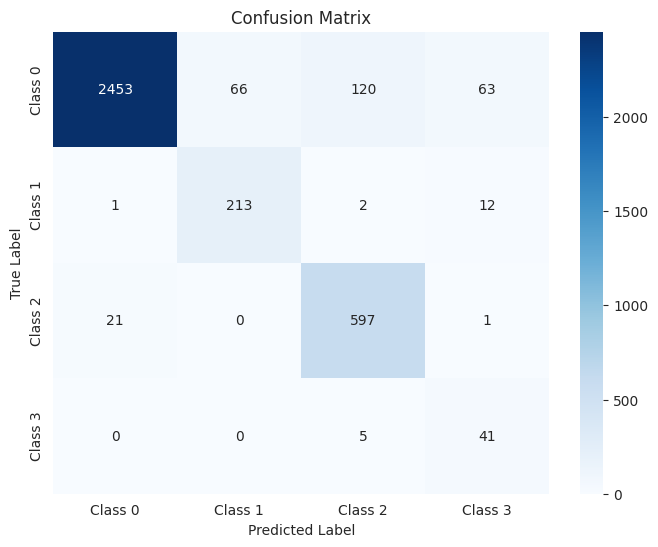

The function took 0.2585 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.75      0.94      0.84       285
     Class 2       0.83      0.93      0.88       774
     Class 3       0.38      0.89      0.53        57

    accuracy                           0.92      4494
   macro avg       0.74      0.92      0.80      4494
weighted avg       0.93      0.92      0.92      4494



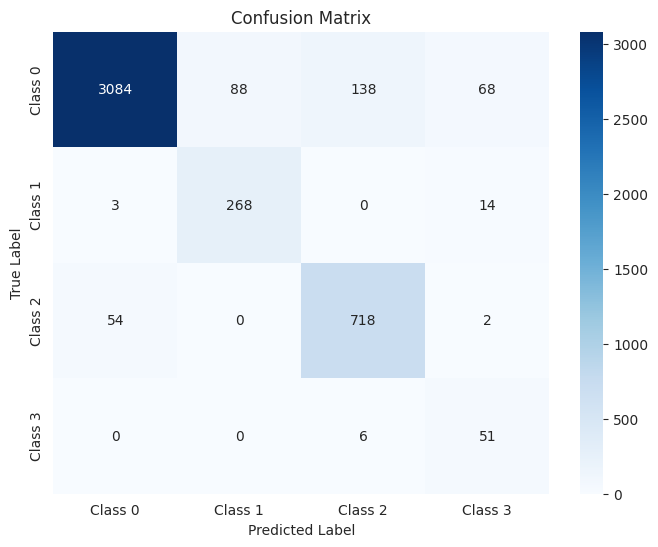

The function took 0.2900 seconds to execute.
[bn  wd=0e+00] ep 010  tr=0.2400  val=0.2758
[bn  wd=0e+00] ep 020  tr=0.2147  val=0.2141
[bn  wd=0e+00] ep 030  tr=0.1938  val=0.5444
[bn  wd=0e+00] ep 040  tr=0.1868  val=0.2509
[bn  wd=0e+00] early-stop @ epoch 041
[bn  wd=0e+00] done in 22.1s  best-val=0.2052


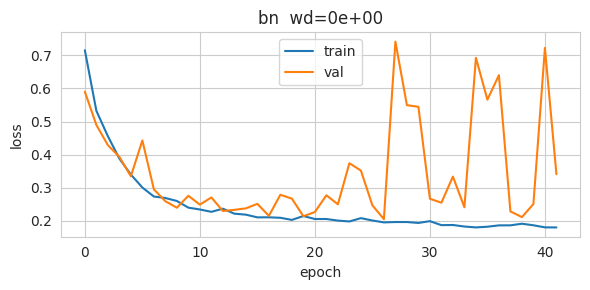


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.77      0.96      0.86       914
     Class 2       0.85      0.96      0.90      2475
     Class 3       0.31      0.94      0.47       182

    accuracy                           0.92     14379
   macro avg       0.73      0.94      0.79     14379
weighted avg       0.95      0.92      0.93     14379



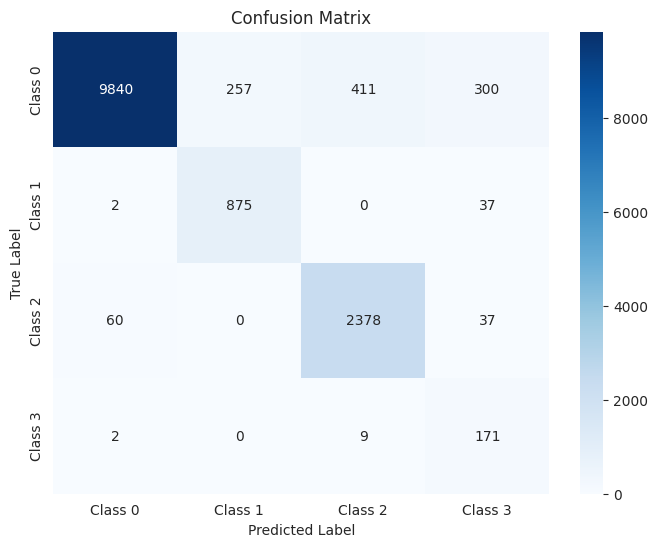

The function took 0.7694 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.79      0.93      0.86       228
     Class 2       0.85      0.97      0.91       619
     Class 3       0.30      0.93      0.46        46

    accuracy                           0.92      3595
   macro avg       0.74      0.94      0.79      3595
weighted avg       0.95      0.92      0.93      3595



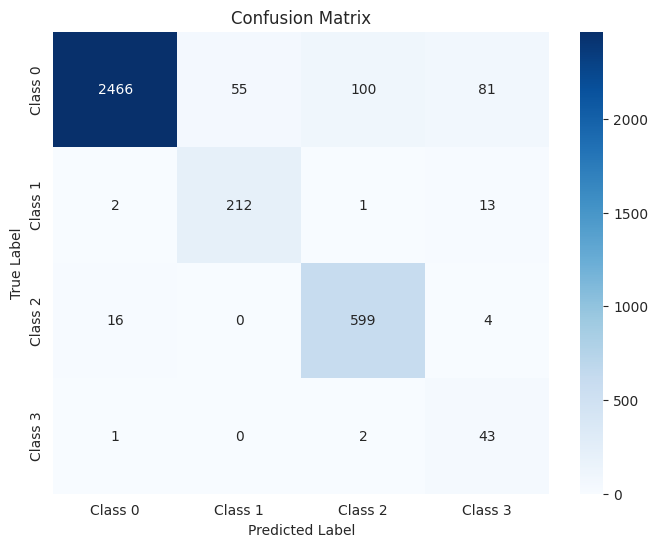

The function took 0.3133 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      3378
     Class 1       0.78      0.94      0.85       285
     Class 2       0.83      0.96      0.89       774
     Class 3       0.32      0.89      0.47        57

    accuracy                           0.92      4494
   macro avg       0.73      0.93      0.79      4494
weighted avg       0.94      0.92      0.93      4494



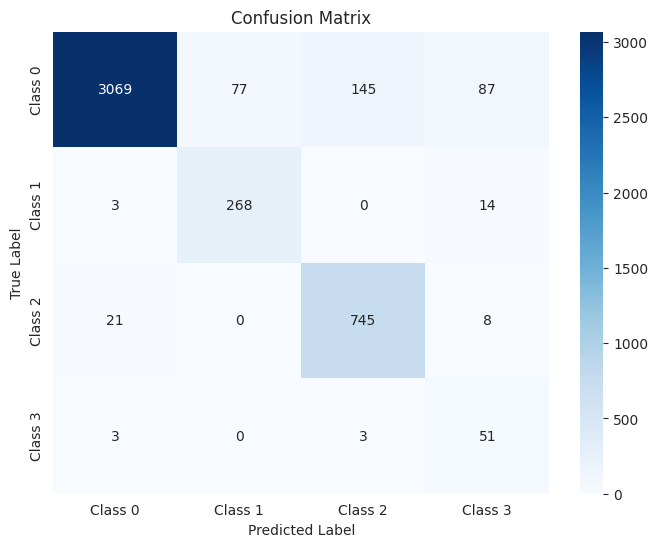

The function took 0.2691 seconds to execute.
[bn  wd=1e-04] ep 010  tr=0.2342  val=0.2285
[bn  wd=1e-04] ep 020  tr=0.2050  val=0.2243
[bn  wd=1e-04] ep 030  tr=0.1883  val=0.2069
[bn  wd=1e-04] ep 040  tr=0.1906  val=0.2125
[bn  wd=1e-04] ep 050  tr=0.1766  val=0.6118
[bn  wd=1e-04] done in 26.3s  best-val=0.2032


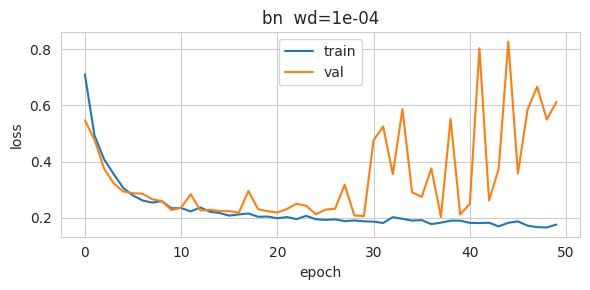


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.77      0.96      0.86       914
     Class 2       0.92      0.93      0.93      2475
     Class 3       0.32      0.90      0.47       182

    accuracy                           0.93     14379
   macro avg       0.75      0.93      0.80     14379
weighted avg       0.95      0.93      0.94     14379



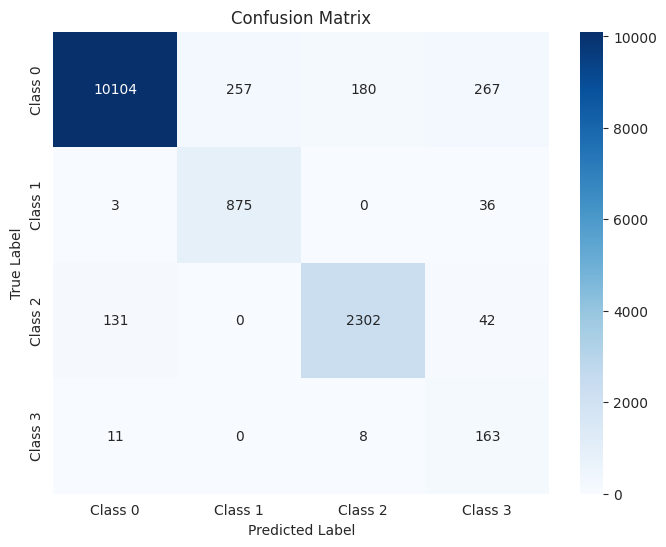

The function took 0.4744 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.91      0.95      0.93       619
     Class 3       0.30      0.91      0.46        46

    accuracy                           0.93      3595
   macro avg       0.75      0.93      0.80      3595
weighted avg       0.95      0.93      0.94      3595



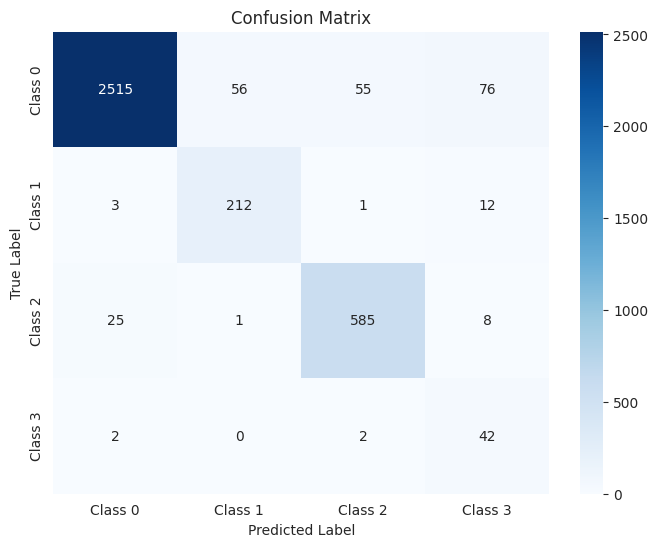

The function took 0.2686 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      3378
     Class 1       0.77      0.94      0.85       285
     Class 2       0.92      0.93      0.92       774
     Class 3       0.32      0.84      0.47        57

    accuracy                           0.93      4494
   macro avg       0.75      0.91      0.80      4494
weighted avg       0.95      0.93      0.94      4494



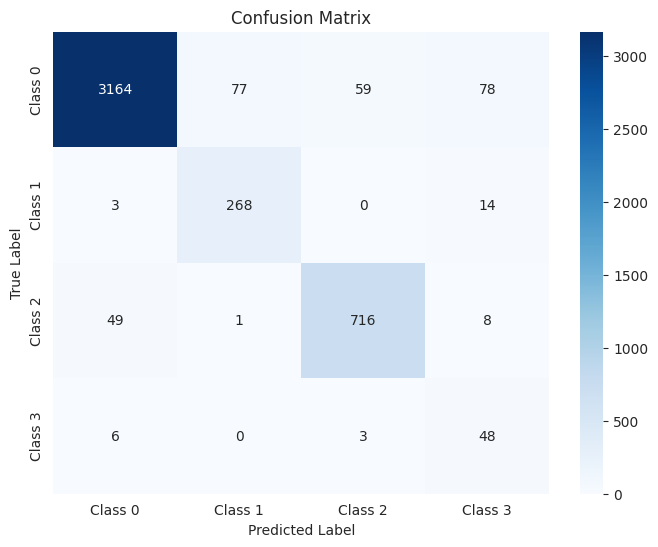

The function took 0.2902 seconds to execute.
[bn  wd=1e-03] ep 010  tr=0.2431  val=0.2543
[bn  wd=1e-03] ep 020  tr=0.2000  val=0.1981
[bn  wd=1e-03] ep 030  tr=0.1944  val=0.2563
[bn  wd=1e-03] early-stop @ epoch 034
[bn  wd=1e-03] done in 18.1s  best-val=0.1981


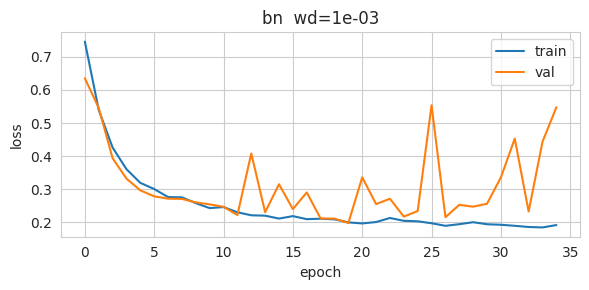


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.78      0.96      0.86       914
     Class 2       0.92      0.93      0.93      2475
     Class 3       0.21      0.95      0.34       182

    accuracy                           0.92     14379
   macro avg       0.72      0.94      0.77     14379
weighted avg       0.96      0.92      0.93     14379



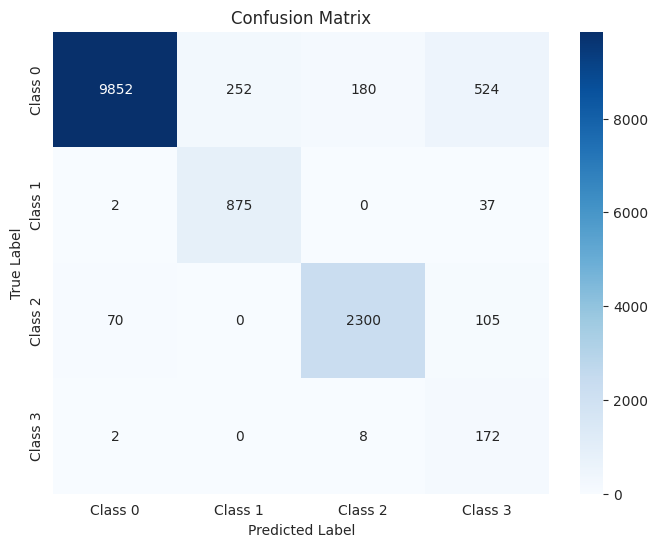

The function took 0.7812 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.79      0.93      0.86       228
     Class 2       0.92      0.95      0.93       619
     Class 3       0.22      0.96      0.36        46

    accuracy                           0.92      3595
   macro avg       0.73      0.94      0.78      3595
weighted avg       0.96      0.92      0.93      3595



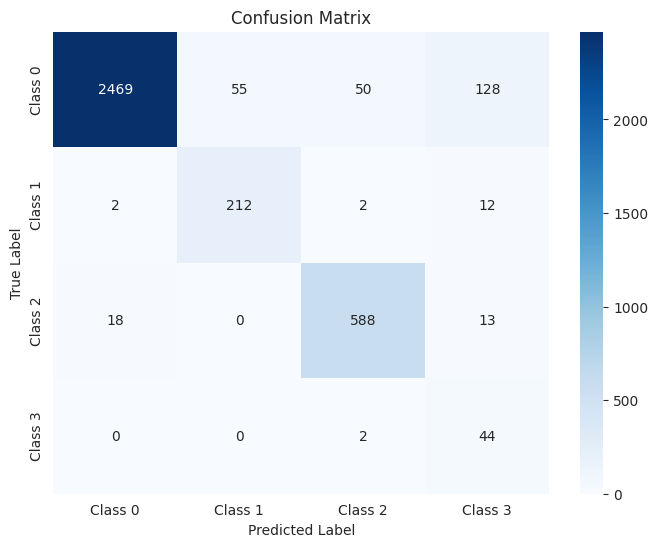

The function took 0.2657 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      3378
     Class 1       0.77      0.94      0.85       285
     Class 2       0.92      0.92      0.92       774
     Class 3       0.19      0.89      0.32        57

    accuracy                           0.91      4494
   macro avg       0.72      0.92      0.76      4494
weighted avg       0.95      0.91      0.93      4494



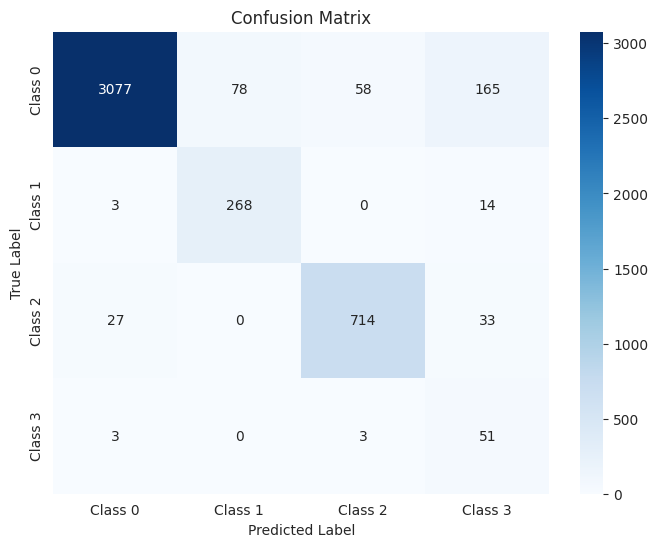

The function took 0.3004 seconds to execute.
[bn  wd=1e-02] ep 010  tr=0.2263  val=0.2480
[bn  wd=1e-02] ep 020  tr=0.2075  val=0.2691
[bn  wd=1e-02] early-stop @ epoch 025
[bn  wd=1e-02] done in 14.0s  best-val=0.2241


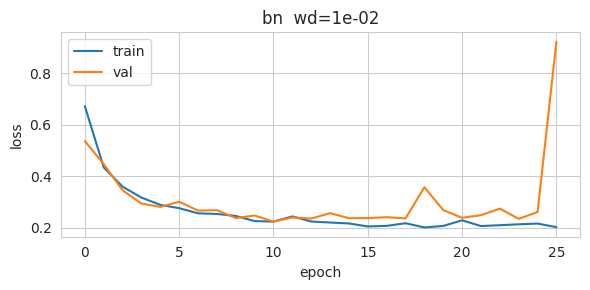


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.76      0.96      0.85       914
     Class 2       0.92      0.95      0.93      2475
     Class 3       0.37      0.88      0.52       182

    accuracy                           0.94     14379
   macro avg       0.76      0.93      0.82     14379
weighted avg       0.95      0.94      0.94     14379



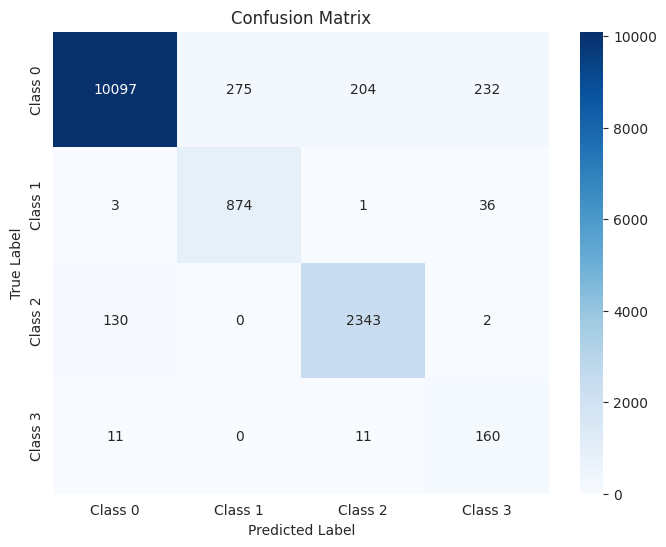

The function took 0.4704 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.79      0.93      0.85       228
     Class 2       0.90      0.96      0.93       619
     Class 3       0.34      0.87      0.49        46

    accuracy                           0.94      3595
   macro avg       0.75      0.92      0.81      3595
weighted avg       0.95      0.94      0.94      3595



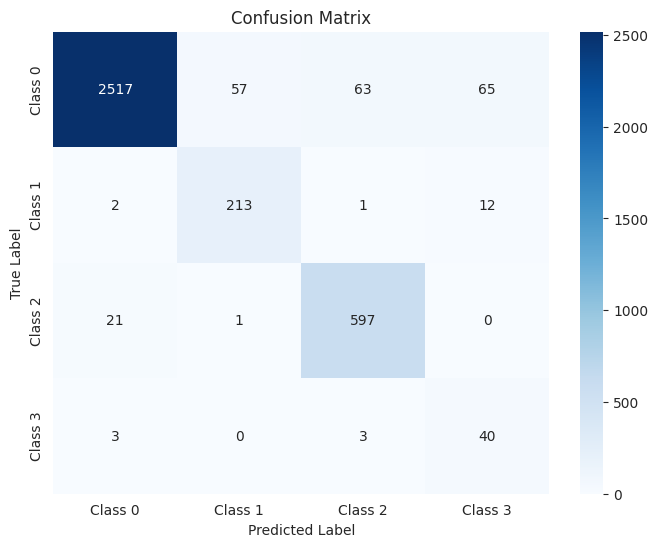

The function took 0.2963 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.75      0.93      0.83       285
     Class 2       0.91      0.94      0.92       774
     Class 3       0.38      0.88      0.53        57

    accuracy                           0.93      4494
   macro avg       0.76      0.92      0.81      4494
weighted avg       0.95      0.93      0.94      4494



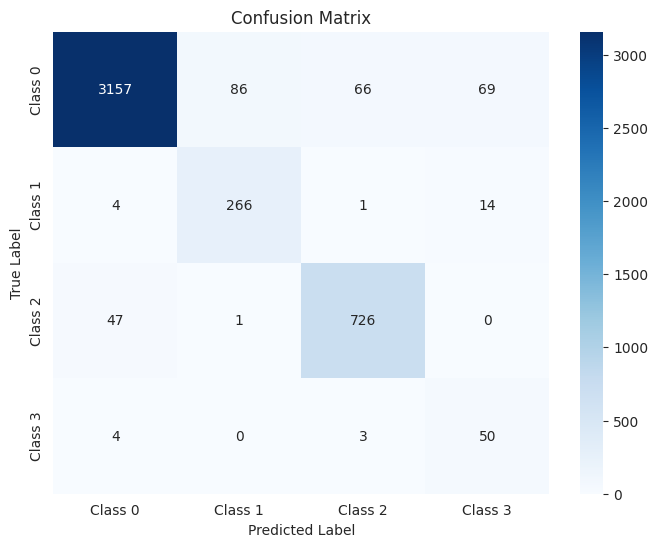

The function took 0.3000 seconds to execute.
[bn+drop  wd=0e+00] ep 010  tr=0.3465  val=0.2773
[bn+drop  wd=0e+00] ep 020  tr=0.3051  val=0.2497
[bn+drop  wd=0e+00] ep 030  tr=0.2876  val=0.2306
[bn+drop  wd=0e+00] ep 040  tr=0.2649  val=0.2265
[bn+drop  wd=0e+00] ep 050  tr=0.2550  val=0.2507
[bn+drop  wd=0e+00] done in 29.5s  best-val=0.2182


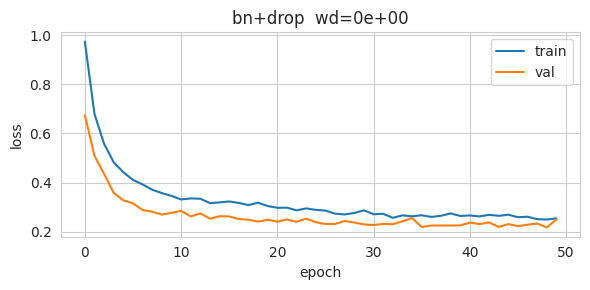


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.82      0.97      0.89      2475
     Class 3       0.28      0.88      0.43       182

    accuracy                           0.91     14379
   macro avg       0.71      0.93      0.77     14379
weighted avg       0.94      0.91      0.92     14379



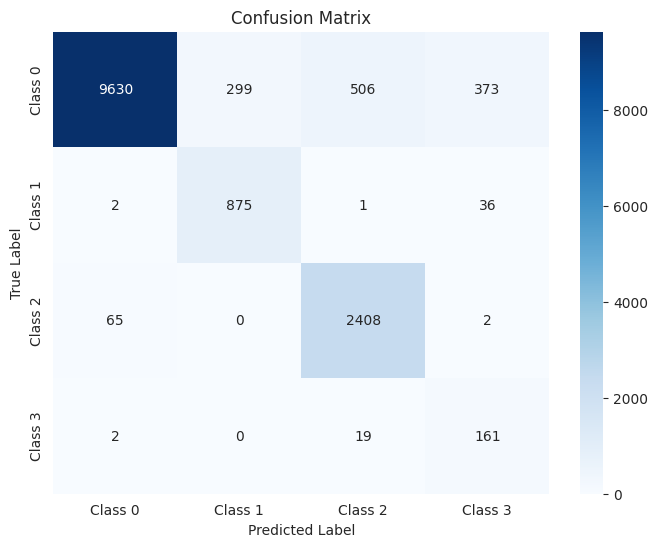

The function took 0.6400 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.77      0.93      0.85       228
     Class 2       0.82      0.97      0.89       619
     Class 3       0.26      0.89      0.41        46

    accuracy                           0.91      3595
   macro avg       0.71      0.92      0.77      3595
weighted avg       0.94      0.91      0.92      3595



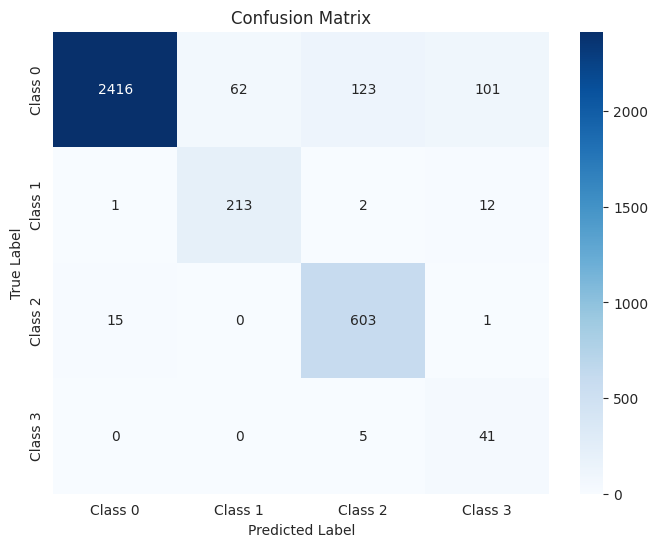

The function took 0.2773 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.75      0.94      0.83       285
     Class 2       0.81      0.97      0.88       774
     Class 3       0.29      0.89      0.44        57

    accuracy                           0.91      4494
   macro avg       0.71      0.92      0.77      4494
weighted avg       0.94      0.91      0.92      4494



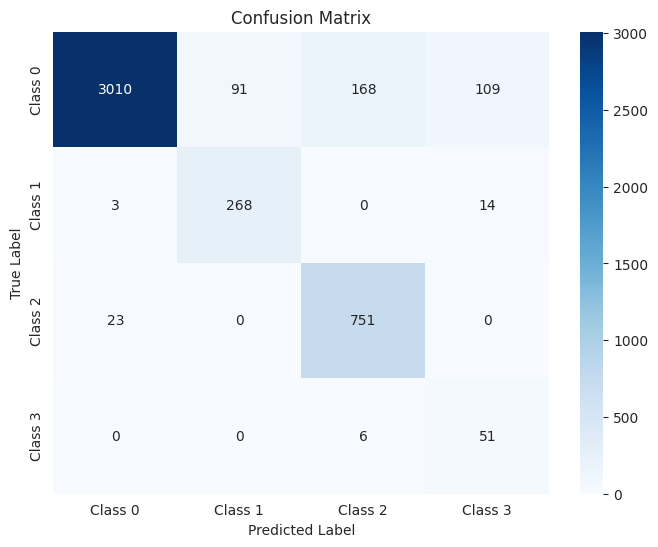

The function took 0.3193 seconds to execute.
[bn+drop  wd=1e-04] ep 010  tr=0.3459  val=0.2666
[bn+drop  wd=1e-04] ep 020  tr=0.2944  val=0.2458
[bn+drop  wd=1e-04] ep 030  tr=0.2773  val=0.2253
[bn+drop  wd=1e-04] ep 040  tr=0.2662  val=0.2279
[bn+drop  wd=1e-04] ep 050  tr=0.2450  val=0.2351
[bn+drop  wd=1e-04] done in 28.6s  best-val=0.2240


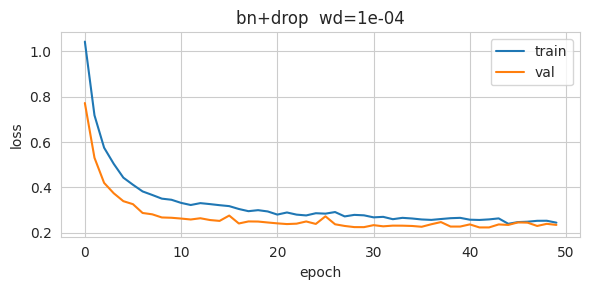


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.87      0.93     10808
     Class 1       0.73      0.96      0.83       914
     Class 2       0.82      0.97      0.89      2475
     Class 3       0.19      0.88      0.32       182

    accuracy                           0.89     14379
   macro avg       0.69      0.92      0.74     14379
weighted avg       0.94      0.89      0.91     14379



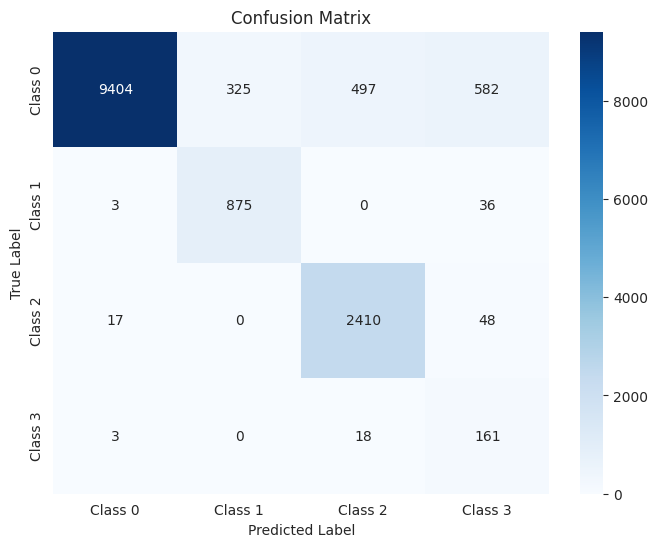

The function took 0.4896 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.87      0.93      2702
     Class 1       0.76      0.93      0.84       228
     Class 2       0.82      0.97      0.89       619
     Class 3       0.19      0.89      0.32        46

    accuracy                           0.90      3595
   macro avg       0.69      0.92      0.74      3595
weighted avg       0.94      0.90      0.91      3595



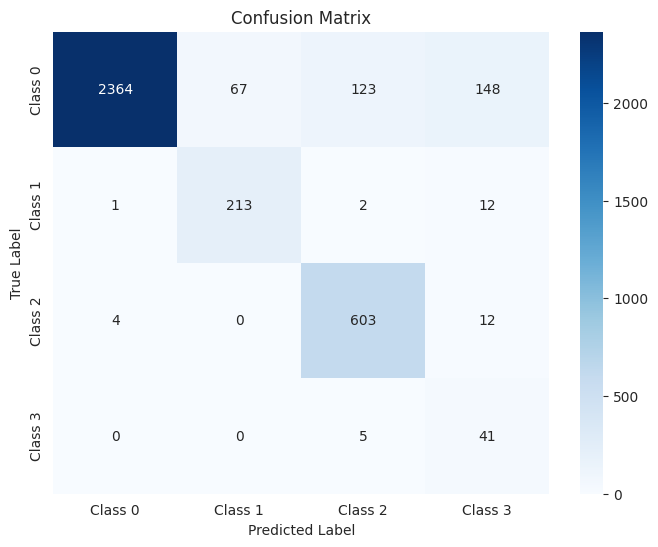

The function took 0.2736 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.87      0.93      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.81      0.97      0.88       774
     Class 3       0.19      0.89      0.32        57

    accuracy                           0.89      4494
   macro avg       0.69      0.92      0.74      4494
weighted avg       0.94      0.89      0.91      4494



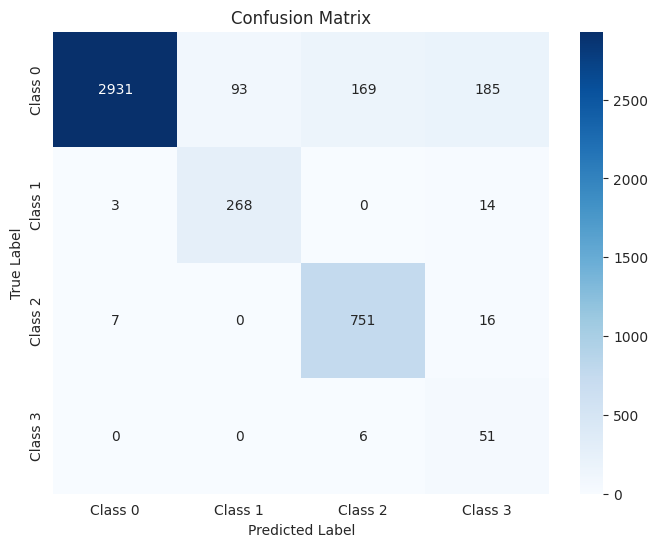

The function took 0.3025 seconds to execute.
[bn+drop  wd=1e-03] ep 010  tr=0.3621  val=0.2791
[bn+drop  wd=1e-03] ep 020  tr=0.2915  val=0.2405
[bn+drop  wd=1e-03] ep 030  tr=0.2697  val=0.2448
[bn+drop  wd=1e-03] ep 040  tr=0.2726  val=0.2322
[bn+drop  wd=1e-03] ep 050  tr=0.2625  val=0.2251
[bn+drop  wd=1e-03] done in 28.6s  best-val=0.2145


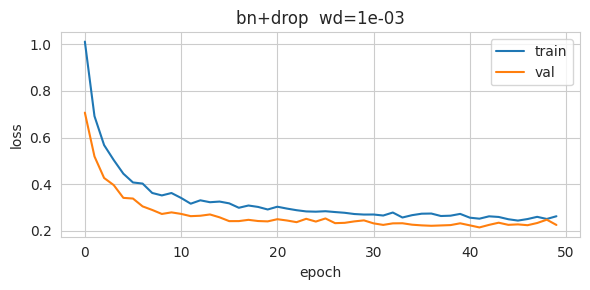


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.95     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.82      0.97      0.89      2475
     Class 3       0.35      0.88      0.50       182

    accuracy                           0.92     14379
   macro avg       0.73      0.93      0.80     14379
weighted avg       0.94      0.92      0.92     14379



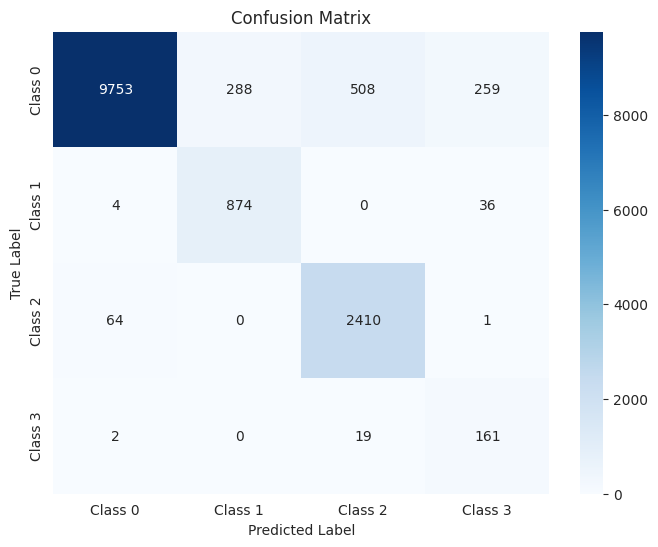

The function took 0.4775 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.82      0.97      0.89       619
     Class 3       0.33      0.89      0.48        46

    accuracy                           0.92      3595
   macro avg       0.73      0.93      0.79      3595
weighted avg       0.94      0.92      0.93      3595



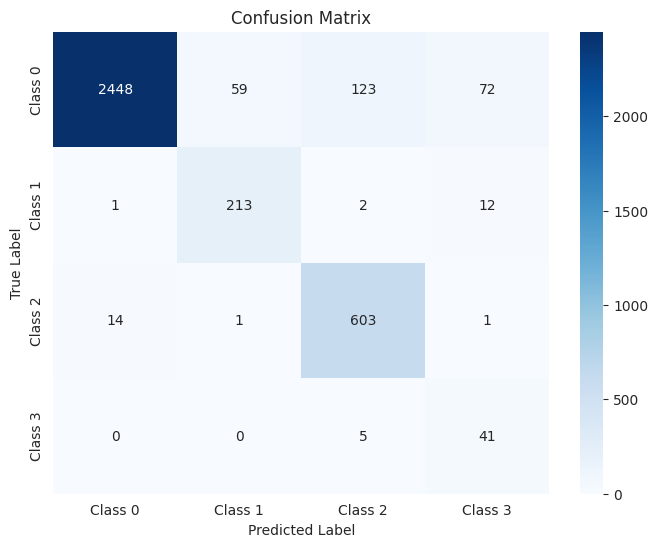

The function took 0.2958 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.76      0.94      0.84       285
     Class 2       0.81      0.97      0.88       774
     Class 3       0.36      0.88      0.51        57

    accuracy                           0.92      4494
   macro avg       0.73      0.92      0.79      4494
weighted avg       0.94      0.92      0.92      4494



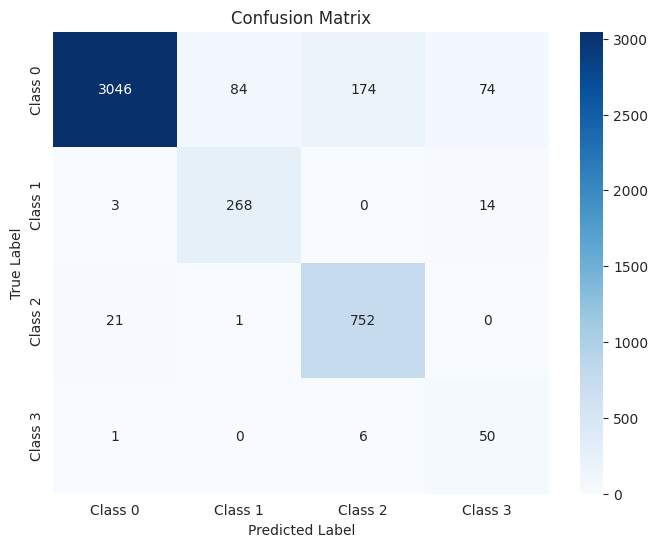

The function took 0.3105 seconds to execute.
[bn+drop  wd=1e-02] ep 010  tr=0.3361  val=0.2748
[bn+drop  wd=1e-02] ep 020  tr=0.3068  val=0.2504
[bn+drop  wd=1e-02] ep 030  tr=0.2713  val=0.2373
[bn+drop  wd=1e-02] ep 040  tr=0.2624  val=0.2236
[bn+drop  wd=1e-02] ep 050  tr=0.2558  val=0.2220
[bn+drop  wd=1e-02] done in 28.6s  best-val=0.2199


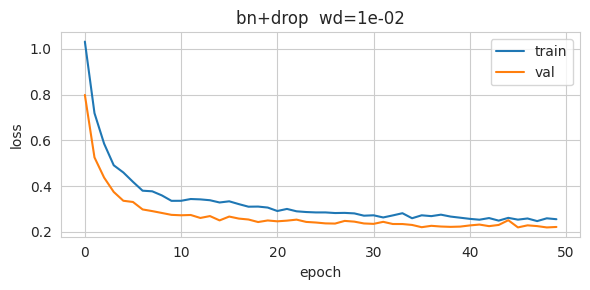


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.95     10808
     Class 1       0.75      0.96      0.84       914
     Class 2       0.83      0.97      0.90      2475
     Class 3       0.34      0.88      0.49       182

    accuracy                           0.92     14379
   macro avg       0.73      0.93      0.79     14379
weighted avg       0.94      0.92      0.93     14379



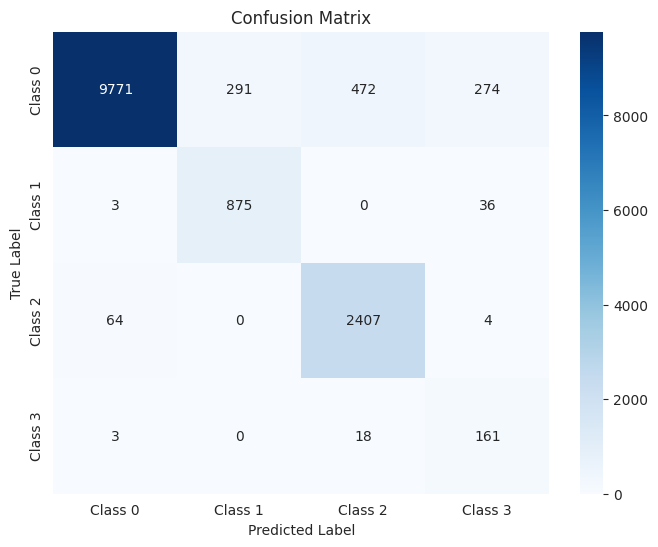

The function took 0.5433 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.78      0.93      0.85       228
     Class 2       0.83      0.97      0.89       619
     Class 3       0.33      0.89      0.48        46

    accuracy                           0.92      3595
   macro avg       0.73      0.93      0.79      3595
weighted avg       0.94      0.92      0.93      3595



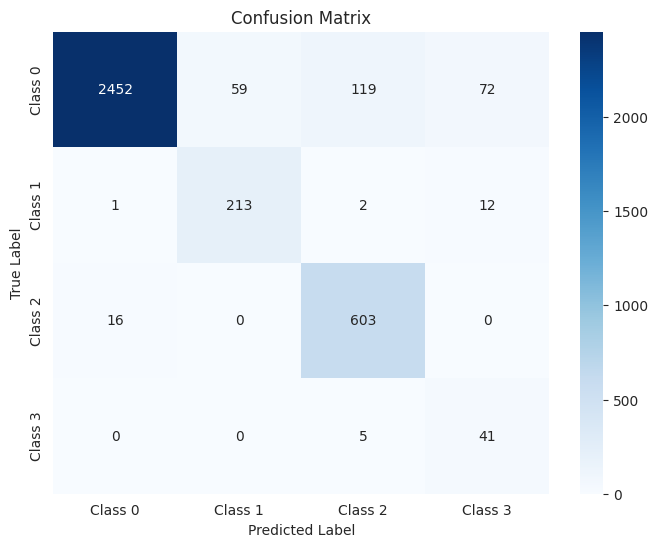

The function took 0.4024 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.82      0.97      0.89       774
     Class 3       0.34      0.89      0.49        57

    accuracy                           0.91      4494
   macro avg       0.72      0.93      0.79      4494
weighted avg       0.94      0.91      0.92      4494



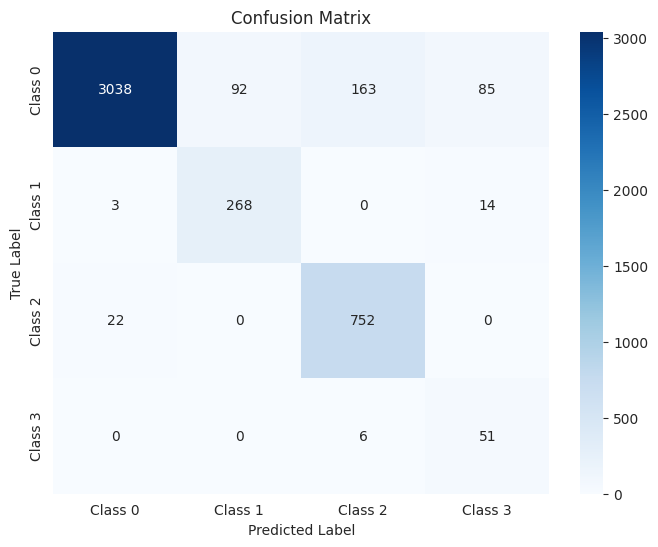

The function took 0.4235 seconds to execute.


,train_acc,val_acc,test_acc
plain wd=0e+00,"{'accuracy': 93.17755059461716, 'precision': [...","{'accuracy': 93.3240611961057, 'precision': [0...","{'accuracy': 93.03515798842902, 'precision': [..."
plain wd=1e-04,"{'accuracy': 91.55017734195702, 'precision': [...","{'accuracy': 91.43254520166899, 'precision': [...","{'accuracy': 91.23275478415665, 'precision': [..."
plain wd=1e-03,"{'accuracy': 91.00076500452047, 'precision': [...","{'accuracy': 91.21001390820584, 'precision': [...","{'accuracy': 90.85447263017356, 'precision': [..."
plain wd=1e-02,"{'accuracy': 92.32909103553794, 'precision': [...","{'accuracy': 92.26703755215577, 'precision': [...","{'accuracy': 92.25634178905207, 'precision': [..."
drop wd=0e+00,"{'accuracy': 90.04798664719382, 'precision': [...","{'accuracy': 90.1529902642559, 'precision': [0...","{'accuracy': 90.12016021361816, 'precision': [..."
drop wd=1e-04,"{'accuracy': 89.70721190625217, 'precision': [...","{'accuracy': 89.87482614742697, 'precision': [...","{'accuracy': 89.36359590565198, 'precision': [..."
drop wd=1e-03,"{'accuracy': 90.02016830099451, 'precision': [...","{'accuracy': 89.8191933240612, 'precision': [0...","{'accuracy': 89.7196261682243, 'precision': [0..."
drop wd=1e-02,"{'accuracy': 91.84922456359969, 'precision': [...","{'accuracy': 91.90542420027816, 'precision': [...","{'accuracy': 91.70004450378282, 'precision': [..."
bn wd=0e+00,"{'accuracy': 92.24563599693998, 'precision': [...","{'accuracy': 92.35048678720446, 'precision': [...","{'accuracy': 91.96706720071207, 'precision': [..."
bn wd=1e-04,"{'accuracy': 93.49746157590931, 'precision': [...","{'accuracy': 93.29624478442281, 'precision': [...","{'accuracy': 93.36893635959056, 'precision': [..."


In [ ]:
# ---------------- Task-5 · deep 6-layer grid ------------------------
# Purpose:
#   Sweep a 6-layer MLP across architecture variants and weight-decay values.
#   Variants: plain, dropout (“drop”), batch-normalisation (“bn”),
#             and batch-normalisation + dropout (“bn+drop”).
#   Weight-decay grid: 0, 1e-4, 1e-3, 1e-2.
# Procedure:
#   1. Build DataLoaders with batch size 128.
#   2. Define `DeepNet`, which can insert BatchNorm and/or Dropout after each
#      hidden Linear layer.
#   3. Helper `deep_variant` returns the requested model plus an AdamW optimiser.
#   4. For every (variant × weight-decay) pair:
#        • Train ≤50 epochs with early-stopping (patience 15) via `training_loop`.
#        • Save loss curves and accuracies (train / val / test).
#   5. Collect results into a DataFrame for quick comparison.
import itertools
import torch.nn as nn
from torch.utils.data import DataLoader


BS_DEEP = 128
train_loader128 = DataLoader(train_dataset, batch_size=BS_DEEP, shuffle=True)
val_loader128   = DataLoader(val_dataset,   batch_size=BS_DEEP, shuffle=False)
test_loader128  = DataLoader(test_dataset,  batch_size=BS_DEEP, shuffle=False)


deep_arch = [input_dim, 256, 128, 64, 32, 16, n_classes]

class DeepNet(nn.Module):
    """Deep MLP: 6 hidden layers, optional BatchNorm and/or Dropout."""
    def __init__(self, sizes, use_bn=False, use_do=False, p_drop=0.2):
        super().__init__()
        layers = []
        for i in range(len(sizes)-2):
            layers.append(nn.Linear(sizes[i], sizes[i+1]))
            if use_bn:
                layers.append(nn.BatchNorm1d(sizes[i+1]))
            layers.append(nn.ReLU())
            if use_do:
                layers.append(nn.Dropout(p_drop))
        layers.append(nn.Linear(sizes[-2], sizes[-1]))
        self.net = nn.Sequential(*layers)

    def forward(self, x):
        return self.net(x)

def deep_variant(kind:str, weight_decay:float=0.0):
     """Factory: build DeepNet variant + AdamW optimiser with given weight-decay."""
    if   kind == 'plain':
        model = DeepNet(deep_arch, use_bn=False, use_do=False)
    elif kind == 'drop':
        model = DeepNet(deep_arch, use_bn=False, use_do=True)
    elif kind == 'bn':
        model = DeepNet(deep_arch, use_bn=True,  use_do=False)
    elif kind == 'bn+drop':
        model = DeepNet(deep_arch, use_bn=True,  use_do=True)
    else:
        raise ValueError(f"kind '{kind}' ")

    model = model.to(DEVICE)
    optimizer = optim.AdamW(model.parameters(), lr=5e-4, weight_decay=weight_decay)
    return model, optimizer

kind_grid = ['plain', 'drop', 'bn', 'bn+drop']
wd_grid   = [0.0, 1e-4, 1e-3, 1e-2]

criterion = nn.CrossEntropyLoss(weight=class_weights.to(DEVICE))

deep_scores, deep_curves = {}, {}
for kd, wd in itertools.product(kind_grid, wd_grid):
    tag = f"{kd}  wd={wd:.0e}"
    model, optimizer = deep_variant(kd, weight_decay=wd)

    hist, model = training_loop(model,
                                train_loader128, val_loader128,
                                train_dataset,  val_dataset,
                                DEVICE, optimizer, criterion,
                                max_epochs=50, patience=15,
                                verbose_every=10, cfg_name=tag)

    deep_curves[tag] = hist
    deep_scores[tag] = {
        'train_acc': testing_model(model, train_loader128, DEVICE),
        'val_acc'  : testing_model(model, val_loader128,   DEVICE),
        'test_acc' : testing_model(model, test_loader128,     DEVICE)
    }

pd.DataFrame(deep_scores).T



| Configuration                    | Best Val Loss | Val Macro-F1 | Test Macro-F1 |
| -------------------------------- | ------------: | -----------: | ------------: |
| **Plain, wd=0**                  |        0.1961 |         0.82 |          0.81 |
| **Plain, wd=1e-4**               |        0.1973 |         0.78 |          0.77 |
| **Plain, wd=1e-3**               |        0.1945 |         0.78 |          0.77 |
| **Plain, wd=1e-2**               |        0.1927 |         0.79 |          0.80 |
| **Dropout, wd=0**                |        0.2136 |         0.78 |          0.79 |
| **Dropout, wd=1e-4**             |        0.2108 |         0.75 |          0.74 |
| **Dropout, wd=1e-3**             |        0.2077 |         0.76 |          0.75 |
| **Dropout, wd=1e-2**             |        0.2139 |         0.80 |          0.80 |
| **BatchNorm, wd=0**              |        0.2052 |         0.79 |          0.79 |
| **BatchNorm, wd=1e-4**           |        0.2032 |         0.80 |          0.80 |
| **BatchNorm, wd=1e-3**           |        0.1981 |         0.77 |          0.76 |
| **BatchNorm, wd=1e-2**           |        0.2241 |         0.82 |          0.81 |
| **BatchNorm + Dropout, wd=0**    |        0.2182 |         0.77 |          0.77 |
| **BatchNorm + Dropout, wd=1e-4** |        0.2240 |         0.74 |          0.74 |
| **BatchNorm + Dropout, wd=1e-3** |        0.2145 |         0.80 |          0.79 |
| **BatchNorm + Dropout, wd=1e-2** |        0.2199 |         0.79 |          0.79 |
